In [1]:
import os
import sys
import pickle
import numpy as np
import matplotlib.pyplot as plt

from tqdm import tqdm
from scipy.linalg import block_diag

module_path = os.path.abspath(os.path.join('../../src'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = os.path.abspath(os.path.join('../../data'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
from dynamics import Dynamics
from utils import get_form_initial_conditions
from gauss_newton import GaussNewton

In [2]:
# Position estimation error
def position_estimation_error(X_est, X_true):
    return np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).flatten(), np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).flatten(), np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).flatten(), np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).flatten()

In [3]:
# Simulation parameters
dt = 60.0  # Time step [s]
K = 395  # Duration [min]
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6 
n_p = 3  
n = N * n_x
o = 3 + 3 + 2 + 1 
H = 20 # Window size [min]
invalid_rmse = 1e20 # [m]
grad_norm_order_mag = True
grad_norm_tol = 1e-6
max_iterations = 20
dyn = Dynamics()

In [4]:
# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P_0 = np.diag(np.concatenate([p_pos_initial * np.ones(3), p_vel_initial * np.ones(3)])) ** 2
P_0 = block_diag(P_0, P_0, P_0, P_0)

In [5]:
def plots(k, algorithm_class):
    iterations = np.arange(0, algorithm_class.iterations + 1)

    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    # Plot 1
    axs[0].semilogy(iterations, 1 / H * np.array(algorithm_class.cost_values), '.-')
    axs[0].set_xlabel(r'$n$')
    axs[0].set_ylabel(r'$\frac{1}{H}J(x_n)$')
    axs[0].set_title('Normalized Cost Function') 
    axs[0].grid()

    # Plot 2
    axs[1].semilogy(iterations, 1 / H * np.array(algorithm_class.gradient_norm_values), '.-')
    axs[1].set_xlabel(r'$n$')
    axs[1].set_ylabel(r'$\frac{1}{H}||\nabla J(x_n)||_2$')
    axs[1].set_title('Normalized Gradient Norm')
    axs[1].grid()
    
    fig.suptitle(f'Solving MHE problem J(k) with k = {k}', fontsize=14)

    plt.tight_layout()
    plt.show()

In [6]:
# Seed for reproducibility
np.random.seed(42)

# Initial conditions for the state vector and true state vectors
X_initial = get_form_initial_conditions(formation)
with open(f"../../data/tudatpy_form{formation}.pkl", "rb") as file:
    X_true = pickle.load(file)[:, :, :K]

# Initial position estimation error
X_est = np.zeros_like(X_true)
X_est[:, :, 0] = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))
for k in range(K - 1):
    X_est[:, :, k + 1] = dyn.f(dt, X_est[:, :, k])
position_estimation_error_1_initial, position_estimation_error_2_initial, position_estimation_error_3_initial, position_estimation_error_4_initial = position_estimation_error(X_est, X_true)

# Algorithm class to use
centralized_newton = GaussNewton(H, K, o, R, grad_norm_order_mag, grad_norm_tol, max_iterations)

# Observations
Y = np.zeros((o, 1, K))
for k in range(K):
    Y[:, :, k] = centralized_newton.h(X_true[:, :, k]) + np.random.multivariate_normal(np.zeros(o), R).reshape((o, 1))

Windows:   0%|          | 0/376 [00:00<?, ?it/s]

[Gauss-Newton] Before applying the algorithm
Cost function: 97739953.30327976
Gradient norm: 415933710.54448134
Global estimation error: 429.50490519551005
Initial conditions estimation errors: 272.4697073631671 m, 173.20827048054102 m, 227.7797328342984 m, 168.37460816595575 m
Position estimation errors: 401.3591415482376 m, 610.2967026846796 m, 310.44935021554664 m, 210.76633522346162 m

[Gauss-Newton] Iteration 1
Cost function: 278119.0334159078 (-99.72%)
Gradient norm: 2923706.0697375294 (-99.30%)
Global estimation error: 246.3088554946179 (-42.65%)
Initial conditions estimation errors: 20.19852712025742 m, 205.13203690548497 m, 128.94058201594717 m, 39.410803527882834 m
Position estimation errors: 15.291663654223015 m, 64.27745781976316 m, 839.2776031169087 m, 905.613630832138 m

[Gauss-Newton] Iteration 2
Cost function: 96690.37577969817 (-65.23%)
Gradient norm: 475438.30193889886 (-83.74%)
Global estimation error: 74.70687842122182 (-69.67%)
Initial conditions estimation errors:

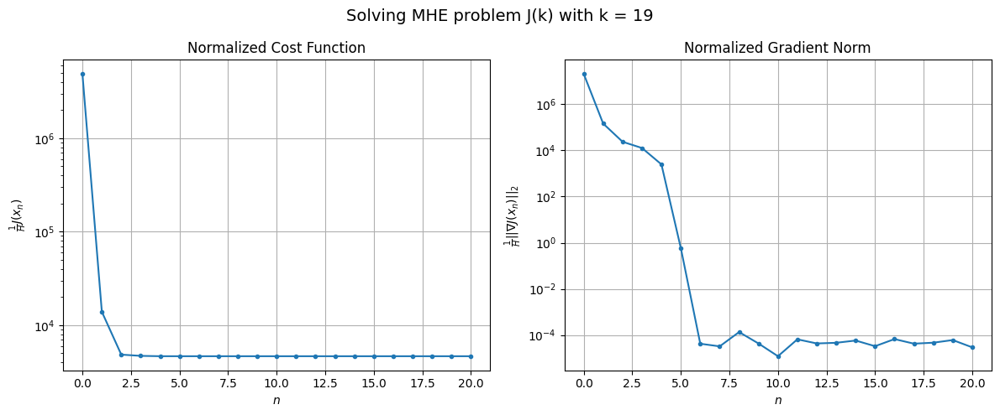

Windows:   0%|          | 1/376 [00:10<1:03:16, 10.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 92887.01212066098
Gradient norm: 2884067.1601773826
Global estimation error: 25.870206167445932
Initial conditions estimation errors: 12.668731672379742 m, 12.360794528486974 m, 13.104827503836479 m, 13.571376581186382 m
Position estimation errors: 20.047346280814864 m, 21.514758770612936 m, 23.46688904995569 m, 15.146710403648624 m

[Gauss-Newton] Iteration 1
Cost function: 80656.07485813605 (-13.17%)
Gradient norm: 105.48153754867539 (-100.00%)
Global estimation error: 39.529823827260266 (52.80%)
Initial conditions estimation errors: 18.588702638562953 m, 18.724583238832203 m, 18.172854050909127 m, 23.154445792257615 m
Position estimation errors: 14.545996717213795 m, 15.582414787889244 m, 19.670675335159654 m, 7.739266977215545 m

[Gauss-Newton] Iteration 2
Cost function: 80656.070124924 (-0.00%)
Gradient norm: 0.08914405480998272 (-99.92%)
Global estimation error: 39.575833191323376 (0.12%)
Initial conditions estimation er

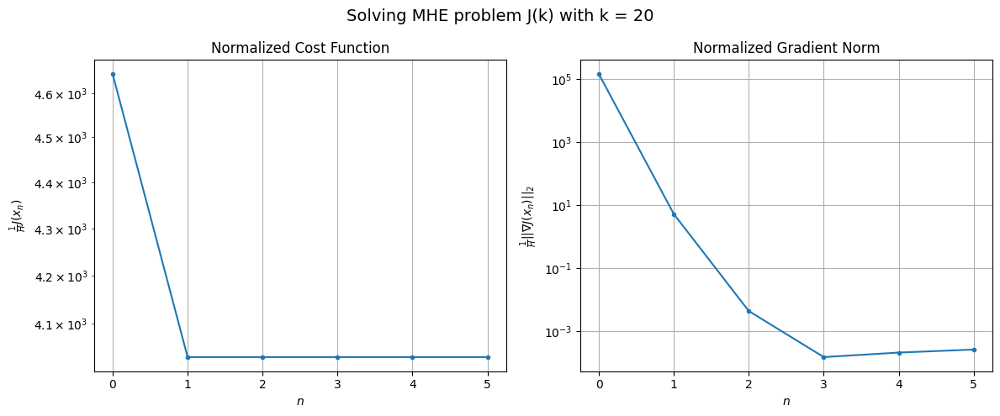

Windows:   1%|          | 2/376 [00:14<41:24,  6.64s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 80863.56593979102
Gradient norm: 2480845.790564826
Global estimation error: 25.883780460756967
Initial conditions estimation errors: 11.680380027774351 m, 11.502384543142517 m, 12.19998151434212 m, 15.885236849453973 m
Position estimation errors: 18.989356736022476 m, 20.203316527228218 m, 23.1229503918629 m, 8.327981946550732 m

[Gauss-Newton] Iteration 1
Cost function: 70582.38293907381 (-12.71%)
Gradient norm: 868.9376965018059 (-99.96%)
Global estimation error: 38.1497689209218 (47.39%)
Initial conditions estimation errors: 17.073065846353238 m, 18.585497116570163 m, 17.11584603771082 m, 22.92333758624769 m
Position estimation errors: 14.008392813848703 m, 14.320995177880663 m, 16.891810604311644 m, 17.020110290596865 m

[Gauss-Newton] Iteration 2
Cost function: 70582.37066207197 (-0.00%)
Gradient norm: 0.015209928453887146 (-100.00%)
Global estimation error: 38.15129663874429 (0.00%)
Initial conditions estimation errors: 

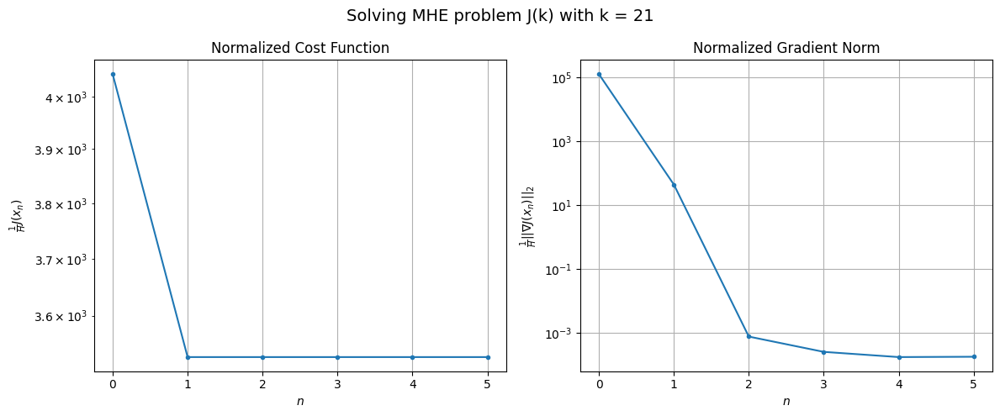

Windows:   1%|          | 3/376 [00:18<33:56,  5.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 72123.77026292363
Gradient norm: 2153554.1786386673
Global estimation error: 25.194334258480165
Initial conditions estimation errors: 10.837854611034434 m, 12.316026938519812 m, 10.86913372772126 m, 15.729904278659522 m
Position estimation errors: 18.147059136999435 m, 18.42963447455702 m, 21.216185068109866 m, 21.67188998241086 m

[Gauss-Newton] Iteration 1
Cost function: 63214.77154014606 (-12.35%)
Gradient norm: 595.9153939051472 (-99.97%)
Global estimation error: 36.53828409909128 (45.03%)
Initial conditions estimation errors: 15.784930564953944 m, 16.455773086854904 m, 21.04214049053239 m, 19.294270112980687 m
Position estimation errors: 13.526525673634206 m, 14.521029690736926 m, 23.97786645439446 m, 31.135853556098137 m

[Gauss-Newton] Iteration 2
Cost function: 63214.760759793055 (-0.00%)
Gradient norm: 0.06580516302768738 (-99.99%)
Global estimation error: 36.47327095454765 (-0.18%)
Initial conditions estimation error

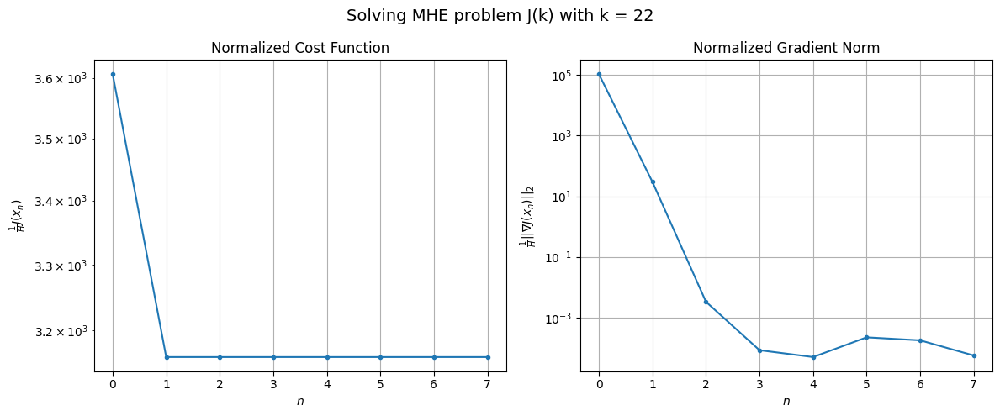

Windows:   1%|          | 4/376 [00:23<32:35,  5.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 65938.52812771878
Gradient norm: 1869194.3266877036
Global estimation error: 25.89540826727192
Initial conditions estimation errors: 10.22408362036646 m, 10.734336950674269 m, 15.421326871562284 m, 14.59328749816459 m
Position estimation errors: 17.376854639079227 m, 18.414758340038524 m, 27.696125290182707 m, 35.726694189912926 m

[Gauss-Newton] Iteration 1
Cost function: 58239.55518997761 (-11.68%)
Gradient norm: 203.4220053963238 (-99.99%)
Global estimation error: 43.066884112416055 (66.31%)
Initial conditions estimation errors: 14.749099504551511 m, 15.304811631465071 m, 26.01478801910133 m, 26.947657226894044 m
Position estimation errors: 13.112754405529714 m, 14.394007180774965 m, 26.585924786312614 m, 35.410500899577016 m

[Gauss-Newton] Iteration 2
Cost function: 58239.54951072917 (-0.00%)
Gradient norm: 0.0633442637829246 (-99.97%)
Global estimation error: 42.91190263929152 (-0.36%)
Initial conditions estimation error

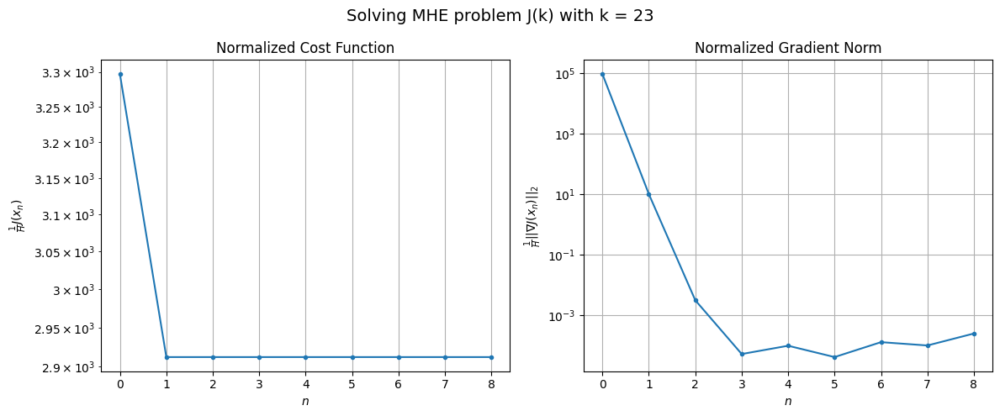

Windows:   1%|▏         | 5/376 [00:29<33:40,  5.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 61686.84595506333
Gradient norm: 1633812.9153756464
Global estimation error: 35.729502169551424
Initial conditions estimation errors: 9.79067552667847 m, 10.306891345809813 m, 22.003793993919196 m, 24.29640471811975 m
Position estimation errors: 16.754210017320283 m, 17.9629757215152 m, 29.592200029607174 m, 39.03363278043894 m

[Gauss-Newton] Iteration 1
Cost function: 54981.90169774983 (-10.87%)
Gradient norm: 237.00464700902756 (-99.99%)
Global estimation error: 38.3223854765956 (7.26%)
Initial conditions estimation errors: 13.943171512607341 m, 11.758081725612294 m, 25.89224928107012 m, 21.575525226743082 m
Position estimation errors: 12.806258055593362 m, 15.43898842435 m, 23.711577587623122 m, 29.769821891246067 m

[Gauss-Newton] Iteration 2
Cost function: 54981.88816968376 (-0.00%)
Gradient norm: 0.2981735160442875 (-99.87%)
Global estimation error: 37.65262620698488 (-1.75%)
Initial conditions estimation errors: 13.943

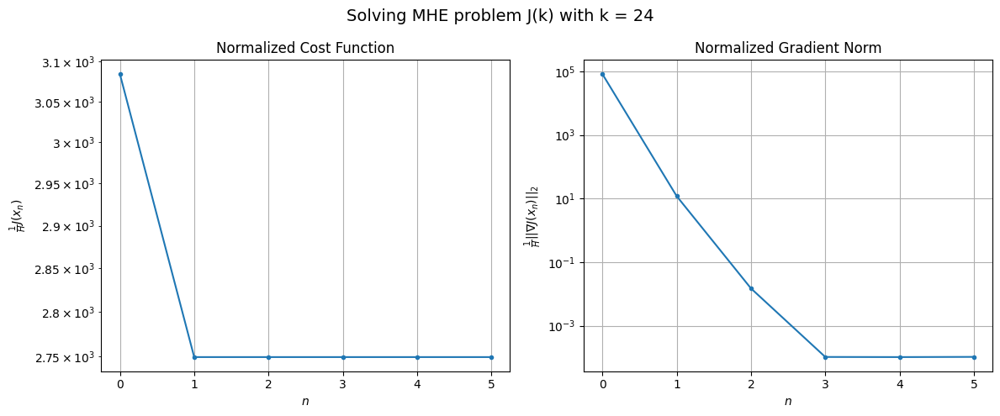

Windows:   2%|▏         | 6/376 [00:33<30:23,  4.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 58501.168788451425
Gradient norm: 1494238.2596199964
Global estimation error: 31.22414419897346
Initial conditions estimation errors: 9.490049169565495 m, 7.202260886801419 m, 20.857131798615338 m, 19.949277499859775 m
Position estimation errors: 16.34027956404401 m, 19.19734325583454 m, 27.117368981781727 m, 33.30785668754031 m

[Gauss-Newton] Iteration 1
Cost function: 52598.032766438504 (-10.09%)
Gradient norm: 173.83530141610038 (-99.99%)
Global estimation error: 44.731118257026594 (43.26%)
Initial conditions estimation errors: 13.324816053165058 m, 9.71112684715128 m, 31.616909011938574 m, 27.006691121868872 m
Position estimation errors: 12.646323487174438 m, 17.480768683240502 m, 18.57623647798396 m, 19.718720469312156 m

[Gauss-Newton] Iteration 2
Cost function: 52598.030629641755 (-0.00%)
Gradient norm: 0.39195199715743795 (-99.77%)
Global estimation error: 43.86936650202022 (-1.93%)
Initial conditions estimation error

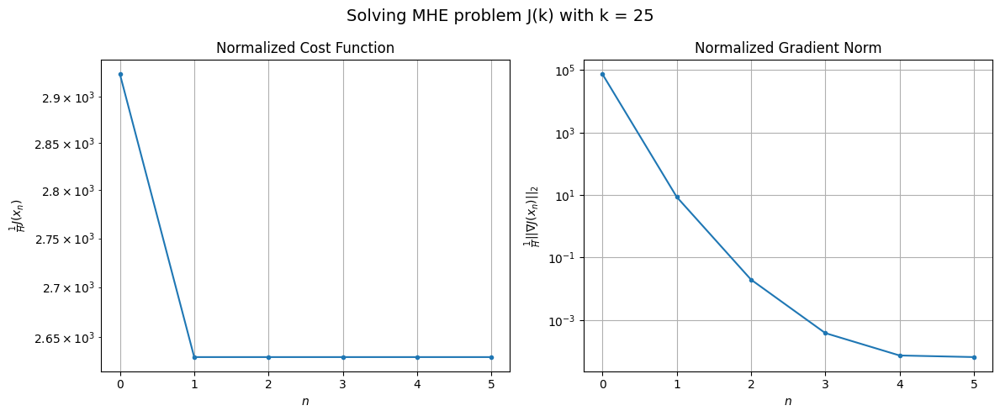

Windows:   2%|▏         | 7/376 [00:36<28:04,  4.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 56791.42785838668
Gradient norm: 1523677.2266510779
Global estimation error: 37.04535810328205
Initial conditions estimation errors: 9.290723473870683 m, 5.758370312499374 m, 26.021072150923967 m, 23.99515112586105 m
Position estimation errors: 16.13677575310223 m, 21.30922825143895 m, 21.746704995629184 m, 22.54878677703276 m

[Gauss-Newton] Iteration 1
Cost function: 51166.76467594614 (-9.90%)
Gradient norm: 208.7635903411737 (-99.99%)
Global estimation error: 31.043075855681604 (-16.20%)
Initial conditions estimation errors: 12.951230106855448 m, 10.472723998271283 m, 19.548119394062816 m, 17.438829906060008 m
Position estimation errors: 12.500643323495126 m, 15.612333045011736 m, 25.35315224535161 m, 30.74482396494008 m

[Gauss-Newton] Iteration 2
Cost function: 51166.76215576932 (-0.00%)
Gradient norm: 0.03519906800174767 (-99.98%)
Global estimation error: 30.919660835504523 (-0.40%)
Initial conditions estimation errors: 

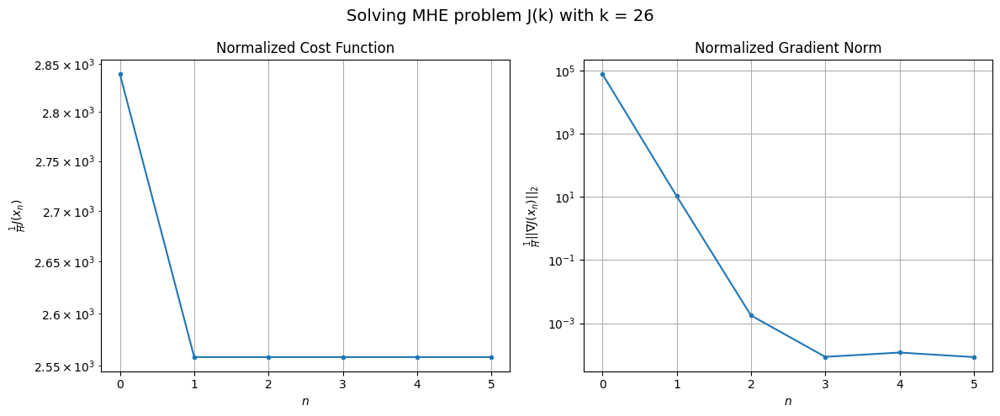

Windows:   2%|▏         | 8/376 [00:40<26:49,  4.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 55703.72574255473
Gradient norm: 1616693.9127993702
Global estimation error: 25.02885574130669
Initial conditions estimation errors: 9.233679730724667 m, 6.884679459494543 m, 15.720521620842911 m, 15.704629912384126 m
Position estimation errors: 15.963148546950535 m, 18.8706671508698 m, 29.11438027405596 m, 33.78452636399779 m

[Gauss-Newton] Iteration 1
Cost function: 50412.55384725224 (-9.50%)
Gradient norm: 929.0370372265985 (-99.94%)
Global estimation error: 21.927793790365964 (-12.39%)
Initial conditions estimation errors: 12.692510869627597 m, 11.753422687381185 m, 11.219790852665275 m, 7.462163328780615 m
Position estimation errors: 12.368143129016989 m, 16.385118422285355 m, 12.959601675029123 m, 12.135358510071523 m

[Gauss-Newton] Iteration 2
Cost function: 50412.52988472009 (-0.00%)
Gradient norm: 0.005689978139904878 (-100.00%)
Global estimation error: 21.927563095970843 (-0.00%)
Initial conditions estimation error

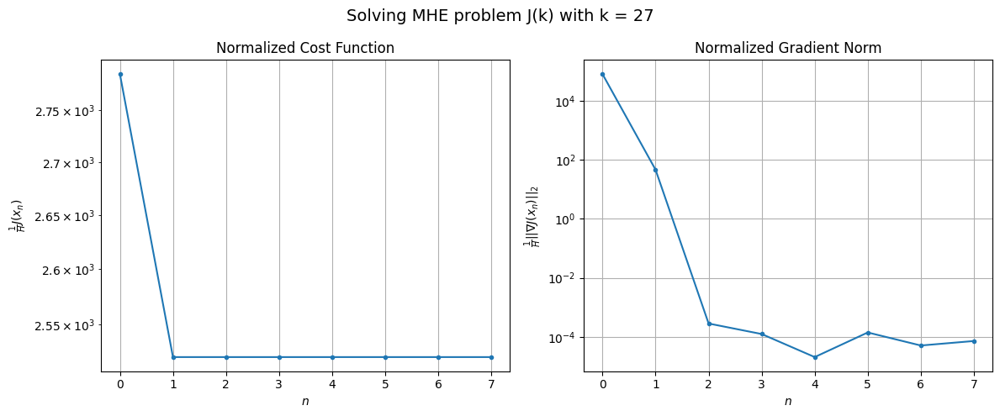

Windows:   2%|▏         | 9/376 [00:45<27:56,  4.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 54594.84000185746
Gradient norm: 1674563.22232441
Global estimation error: 15.51920982921875
Initial conditions estimation errors: 9.178037282120101 m, 8.489269582691465 m, 8.307119921236369 m, 3.939402434837113 m
Position estimation errors: 15.744133586620224 m, 19.617897733820598 m, 16.88144563473322 m, 15.398448698641744 m

[Gauss-Newton] Iteration 1
Cost function: 49478.76709548742 (-9.37%)
Gradient norm: 490.6777781147598 (-99.97%)
Global estimation error: 42.22867897589451 (172.11%)
Initial conditions estimation errors: 12.532136142397817 m, 10.501959231158258 m, 24.95790167660855 m, 29.883026973096367 m
Position estimation errors: 12.17239977080276 m, 17.13917637494332 m, 14.615361513423059 m, 12.782475816381522 m

[Gauss-Newton] Iteration 2
Cost function: 49478.73923015482 (-0.00%)
Gradient norm: 1.8183080283894129 (-99.63%)
Global estimation error: 40.34637895224196 (-4.46%)
Initial conditions estimation errors: 12.53

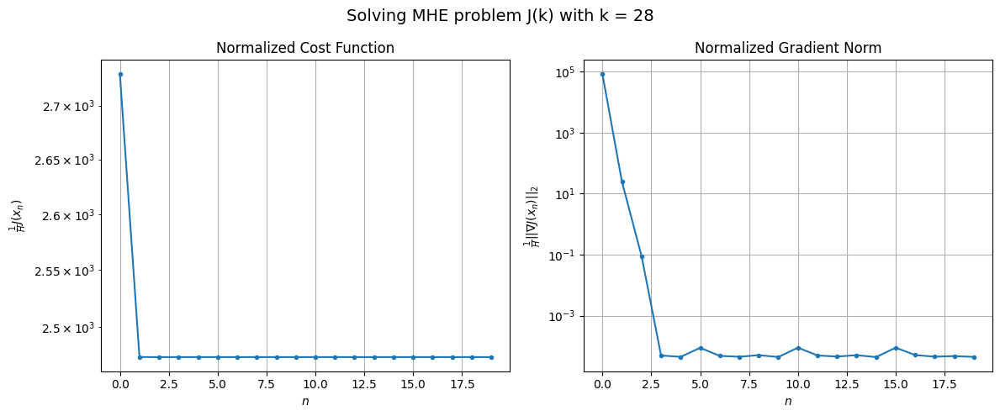

Windows:   3%|▎         | 10/376 [00:56<39:28,  6.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 53354.74125194771
Gradient norm: 1729049.1764880915
Global estimation error: 32.40983872794828
Initial conditions estimation errors: 9.105560101075675 m, 7.61016081548742 m, 19.078908535647397 m, 23.3569167047618 m
Position estimation errors: 15.361432680776494 m, 20.311492685141967 m, 13.639613512087779 m, 13.512855225688929 m

[Gauss-Newton] Iteration 1
Cost function: 48427.64781722893 (-9.23%)
Gradient norm: 2568.306105497305 (-99.85%)
Global estimation error: 80.6058292991555 (148.71%)
Initial conditions estimation errors: 12.359387922801124 m, 10.380829846105105 m, 49.82161405604223 m, 61.27454183304584 m
Position estimation errors: 11.817211812299487 m, 12.30514991694317 m, 13.644304250124156 m, 15.936799433459377 m

[Gauss-Newton] Iteration 2
Cost function: 48427.38647901249 (-0.00%)
Gradient norm: 2.977839755236098 (-99.88%)
Global estimation error: 78.35380436369203 (-2.79%)
Initial conditions estimation errors: 12.35

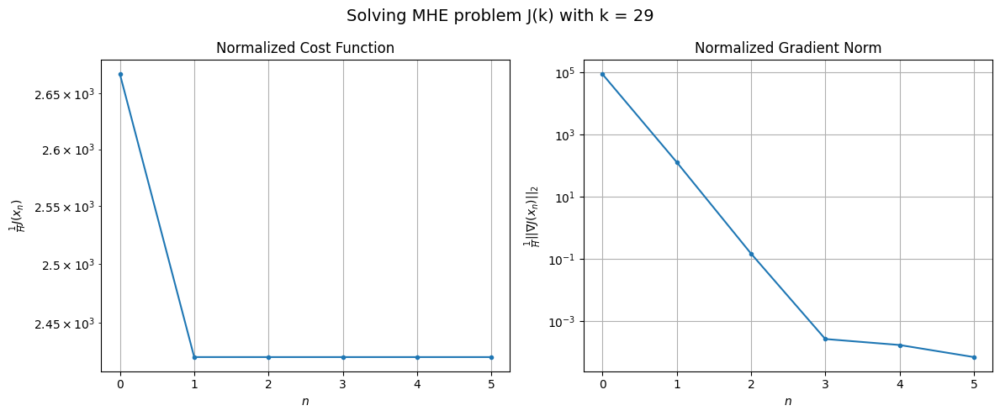

Windows:   3%|▎         | 11/376 [01:00<34:18,  5.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 51538.52485063732
Gradient norm: 1662601.5283779309
Global estimation error: 71.81061863987316
Initial conditions estimation errors: 8.95356444221061 m, 7.308009498380644 m, 44.71218315508695 m, 54.99084559588756 m
Position estimation errors: 14.702935644769026 m, 15.000495568287029 m, 13.579496118371607 m, 16.224442166885627 m

[Gauss-Newton] Iteration 1
Cost function: 46874.55872058068 (-9.05%)
Gradient norm: 2168.721452396311 (-99.87%)
Global estimation error: 33.467554044015 (-53.39%)
Initial conditions estimation errors: 12.123054351007342 m, 11.526101664624054 m, 18.606062616346602 m, 22.227185207831184 m
Position estimation errors: 11.245170829270547 m, 15.690325158691033 m, 13.130347474579708 m, 14.963496399311483 m

[Gauss-Newton] Iteration 2
Cost function: 46874.33014136519 (-0.00%)
Gradient norm: 2.2805695624128837 (-99.89%)
Global estimation error: 34.71053462599475 (3.71%)
Initial conditions estimation errors: 12.

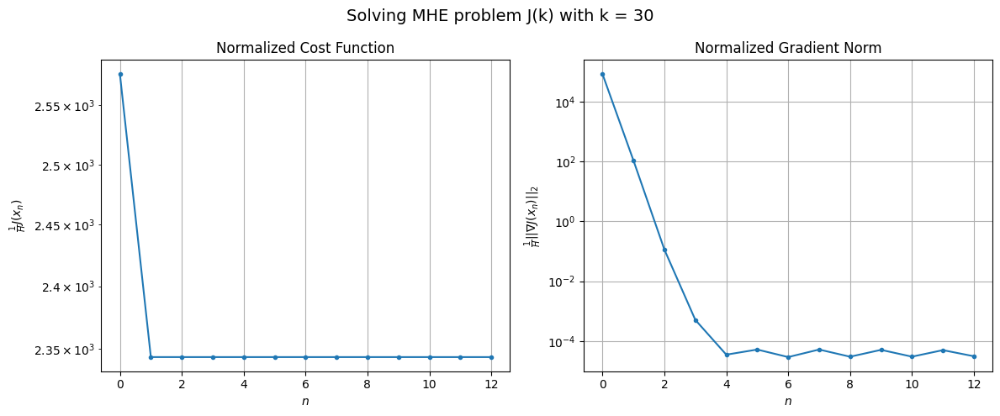

Windows:   3%|▎         | 12/376 [01:08<38:35,  6.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 48710.253396307955
Gradient norm: 1493640.225166208
Global estimation error: 25.99222386769012
Initial conditions estimation errors: 8.720056179011843 m, 8.745701005350615 m, 14.294633805675927 m, 17.852477436747368 m
Position estimation errors: 13.738138438329768 m, 17.930055906828024 m, 10.483734300312504 m, 15.111109402805463 m

[Gauss-Newton] Iteration 1
Cost function: 44419.359542121456 (-8.81%)
Gradient norm: 4166.835406443164 (-99.72%)
Global estimation error: 61.96358430540152 (138.39%)
Initial conditions estimation errors: 11.821258968329314 m, 14.34096802600966 m, 42.81566989339436 m, 40.75378664317307 m
Position estimation errors: 10.473287074440131 m, 20.690532980917165 m, 34.37813656253841 m, 40.87147654964642 m

[Gauss-Newton] Iteration 2
Cost function: 44418.19827312782 (-0.00%)
Gradient norm: 13.743969802479691 (-99.67%)
Global estimation error: 66.85701436785895 (7.90%)
Initial conditions estimation errors: 11

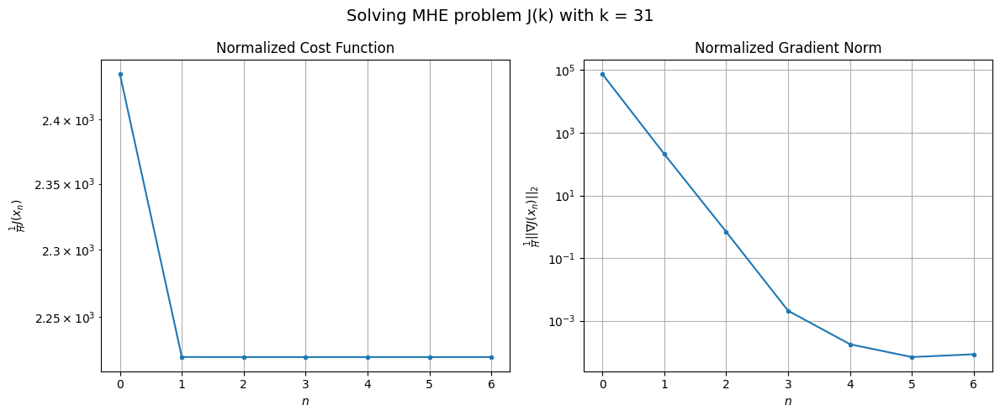

Windows:   3%|▎         | 13/376 [01:12<34:56,  5.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 45275.10903755614
Gradient norm: 1282939.02094946
Global estimation error: 71.30671331930532
Initial conditions estimation errors: 8.432346147996727 m, 12.179697939161384 m, 48.63710679700452 m, 49.996073192720345 m
Position estimation errors: 12.566623522587172 m, 22.95090767224416 m, 30.18359415273257 m, 37.745635497421794 m

[Gauss-Newton] Iteration 1
Cost function: 41482.216720598684 (-8.38%)
Gradient norm: 69.10247966395987 (-99.99%)
Global estimation error: 63.38637673763061 (-11.11%)
Initial conditions estimation errors: 11.408243599506015 m, 14.551104537406774 m, 43.51089153271905 m, 42.22238167235049 m
Position estimation errors: 9.574273619044419 m, 18.572616656716665 m, 28.98911415477102 m, 34.9524953049063 m

[Gauss-Newton] Iteration 2
Cost function: 41482.21658416562 (-0.00%)
Gradient norm: 0.021876039697719497 (-99.97%)
Global estimation error: 63.26948694264961 (-0.18%)
Initial conditions estimation errors: 11.4

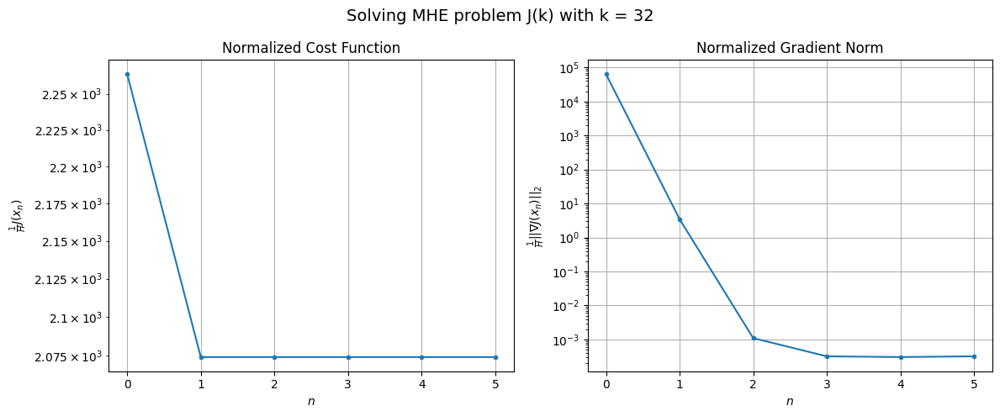

Windows:   4%|▎         | 14/376 [01:16<31:59,  5.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 41378.17659254509
Gradient norm: 1064311.0504186403
Global estimation error: 67.35566221069485
Initial conditions estimation errors: 8.067784174907377 m, 11.895537566994301 m, 45.95803630272363 m, 47.09599620515809 m
Position estimation errors: 11.349446627839358 m, 20.336748247717093 m, 24.648770109121426 m, 31.105044716611953 m

[Gauss-Newton] Iteration 1
Cost function: 38174.81001793403 (-7.74%)
Gradient norm: 847.2350264894515 (-99.92%)
Global estimation error: 100.35860820316617 (49.00%)
Initial conditions estimation errors: 10.871666354653513 m, 19.31069433042792 m, 63.11914114652794 m, 74.81113494684989 m
Position estimation errors: 8.735395646531936 m, 18.809266318609225 m, 35.58633075928814 m, 45.65984852017072 m

[Gauss-Newton] Iteration 2
Cost function: 38174.74348587863 (-0.00%)
Gradient norm: 6.721891262302688 (-99.21%)
Global estimation error: 103.34547398423292 (2.98%)
Initial conditions estimation errors: 10.87

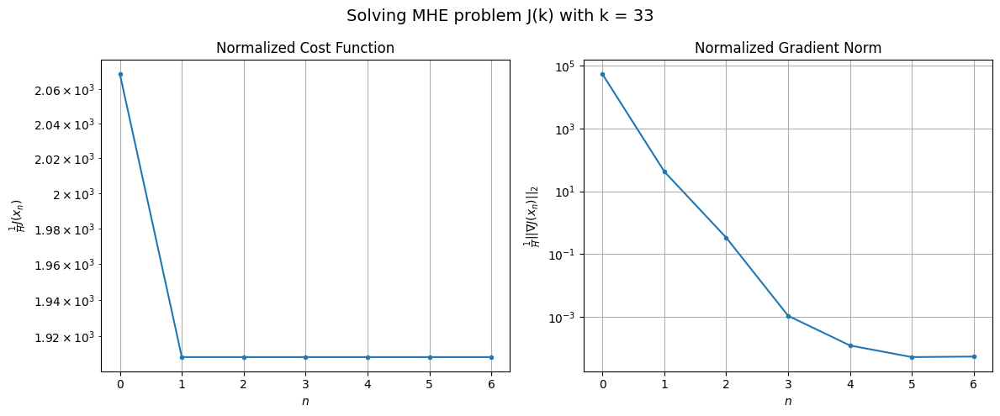

Windows:   4%|▍         | 15/376 [01:21<30:51,  5.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 37624.23845571131
Gradient norm: 946521.5788373497
Global estimation error: 108.09229054888961
Initial conditions estimation errors: 7.639046861090945 m, 17.024689644596027 m, 68.42974911069594 m, 81.56653999735735 m
Position estimation errors: 10.332604875731583 m, 20.230903099565264 m, 31.45614632141036 m, 41.816772270149606 m

[Gauss-Newton] Iteration 1
Cost function: 34903.181887748855 (-7.23%)
Gradient norm: 340.4003946648844 (-99.96%)
Global estimation error: 90.5865661951346 (-16.20%)
Initial conditions estimation errors: 10.252228288139905 m, 18.828761555207446 m, 56.12321370012375 m, 67.79722672803284 m
Position estimation errors: 8.049041726284523 m, 15.460500871838518 m, 23.38162828952222 m, 31.9378442502284 m

[Gauss-Newton] Iteration 2
Cost function: 34903.17908276355 (-0.00%)
Gradient norm: 0.08837520979622993 (-99.97%)
Global estimation error: 90.83137226765894 (0.27%)
Initial conditions estimation errors: 10.25

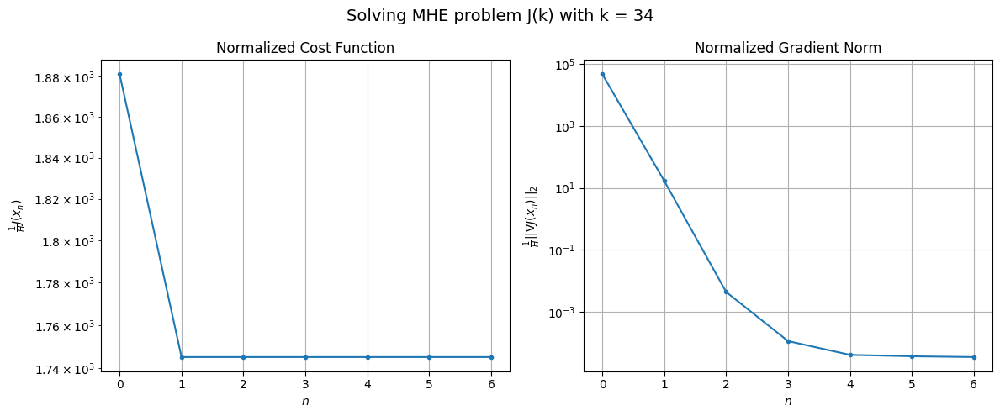

Windows:   4%|▍         | 16/376 [01:26<29:29,  4.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 34539.09165675676
Gradient norm: 949044.4457716296
Global estimation error: 94.23574336382855
Initial conditions estimation errors: 7.203633608087559 m, 16.174694304675587 m, 58.97696809389959 m, 71.33419438367173 m
Position estimation errors: 9.618275824940577 m, 16.524504222939736 m, 19.716706438505188 m, 28.10014075776318 m

[Gauss-Newton] Iteration 1
Cost function: 32281.638162728592 (-6.54%)
Gradient norm: 603.6983196378095 (-99.94%)
Global estimation error: 126.10480302681587 (33.82%)
Initial conditions estimation errors: 9.549036625369412 m, 19.810188628910286 m, 79.7347680817433 m, 95.19005526705547 m
Position estimation errors: 7.628235323026332 m, 17.08373355097807 m, 27.549351623258215 m, 38.866166093474526 m

[Gauss-Newton] Iteration 2
Cost function: 32281.605509956335 (-0.00%)
Gradient norm: 24.38663099972199 (-95.96%)
Global estimation error: 132.2904195002823 (4.91%)
Initial conditions estimation errors: 9.54903

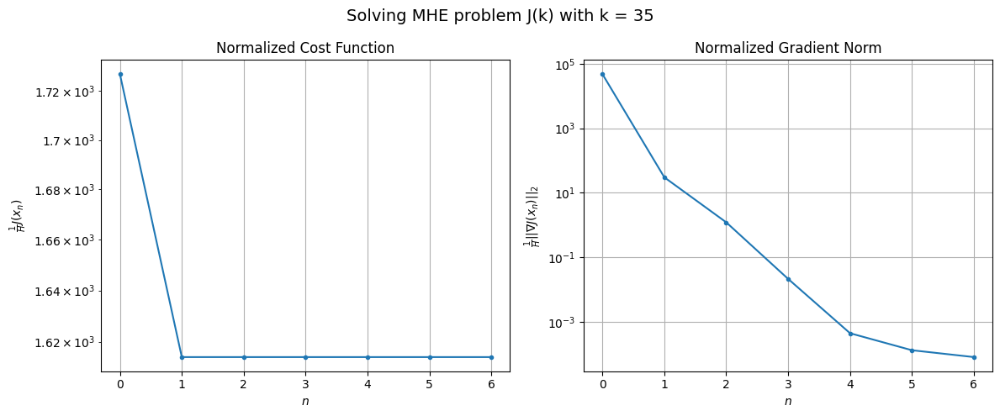

Windows:   5%|▍         | 17/376 [01:30<28:04,  4.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 32183.78325802707
Gradient norm: 1052217.0024236622
Global estimation error: 136.63960567324432
Initial conditions estimation errors: 6.74203486615801 m, 18.003936582035923 m, 86.80955688668698 m, 103.75391779938236 m
Position estimation errors: 9.318881805021121 m, 18.14335542814881 m, 24.687063637853452 m, 36.447579666879825 m

[Gauss-Newton] Iteration 1
Cost function: 30277.00604538963 (-5.92%)
Gradient norm: 925.3704374959101 (-99.91%)
Global estimation error: 161.71644882380158 (18.35%)
Initial conditions estimation errors: 8.836206316828898 m, 19.898644036613256 m, 97.15975834732343 m, 127.42893693165618 m
Position estimation errors: 7.535739113337923 m, 18.601665541649922 m, 34.045979355189694 m, 48.54780177204119 m

[Gauss-Newton] Iteration 2
Cost function: 30276.8941647802 (-0.00%)
Gradient norm: 7.5288211803789045 (-99.19%)
Global estimation error: 164.10336206188032 (1.48%)
Initial conditions estimation errors: 8.83

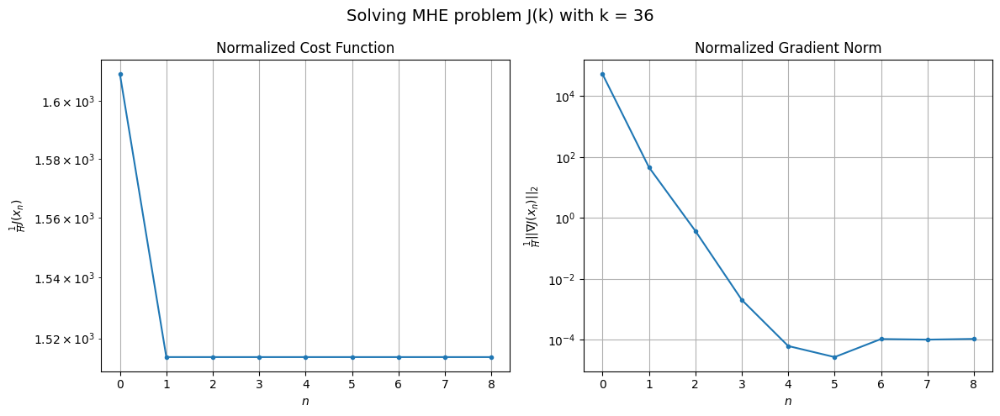

Windows:   5%|▍         | 18/376 [01:35<29:16,  4.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30824.85632011633
Gradient norm: 1194588.1873391818
Global estimation error: 164.97994518972746
Initial conditions estimation errors: 6.321502377321314 m, 18.317772668886377 m, 99.8793910460503 m, 129.87289050646194 m
Position estimation errors: 9.459493207417838 m, 19.0551905136423 m, 30.767116119373245 m, 44.24011843525114 m

[Gauss-Newton] Iteration 1
Cost function: 29425.444230020872 (-4.54%)
Gradient norm: 75668.89993107956 (-93.67%)
Global estimation error: 202.60958513526313 (22.81%)
Initial conditions estimation errors: 8.16938903017364 m, 10.62986669800236 m, 132.59553012876563 m, 152.60841419454948 m
Position estimation errors: 7.739391516767552 m, 12.68075446833597 m, 90.79102995295123 m, 114.47307374341506 m

[Gauss-Newton] Iteration 2
Cost function: 29153.26347930804 (-0.92%)
Gradient norm: 297.9157981072193 (-99.61%)
Global estimation error: 229.0525354024846 (13.05%)
Initial conditions estimation errors: 8.16938

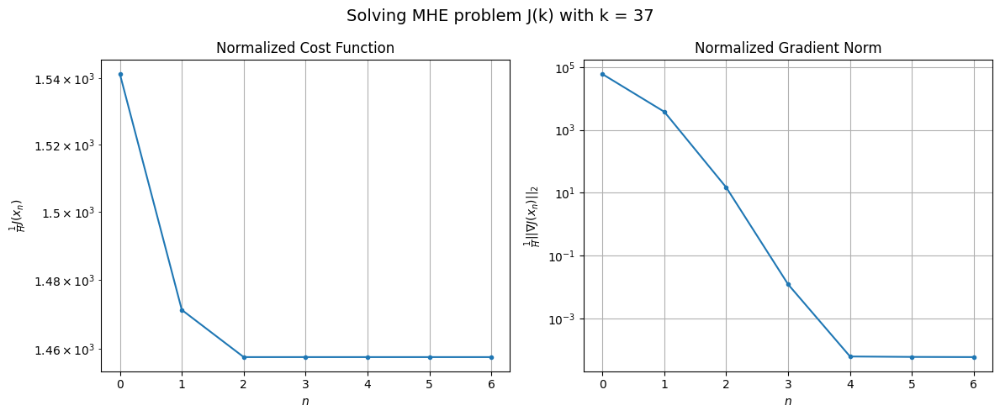

Windows:   5%|▌         | 19/376 [01:40<28:25,  4.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30910.853324743908
Gradient norm: 1400760.0218173303
Global estimation error: 231.4710343165309
Initial conditions estimation errors: 6.00448250156558 m, 15.03433213144387 m, 151.28245490752565 m, 174.44301632745268 m
Position estimation errors: 9.942483895400322 m, 14.927757500848791 m, 88.99697722779293 m, 111.95983610072803 m

[Gauss-Newton] Iteration 1
Cost function: 29266.143281853983 (-5.32%)
Gradient norm: 3893.057835335411 (-99.72%)
Global estimation error: 288.2440669765153 (24.53%)
Initial conditions estimation errors: 7.690399086045161 m, 17.61562863061758 m, 187.42321139572084 m, 218.14608812887522 m
Position estimation errors: 8.095408943983262 m, 22.979565717461607 m, 124.87704625927789 m, 159.3357556538144 m

[Gauss-Newton] Iteration 2
Cost function: 29265.807078803336 (-0.00%)
Gradient norm: 0.06074618789860791 (-100.00%)
Global estimation error: 288.5537511538632 (0.11%)
Initial conditions estimation errors: 7

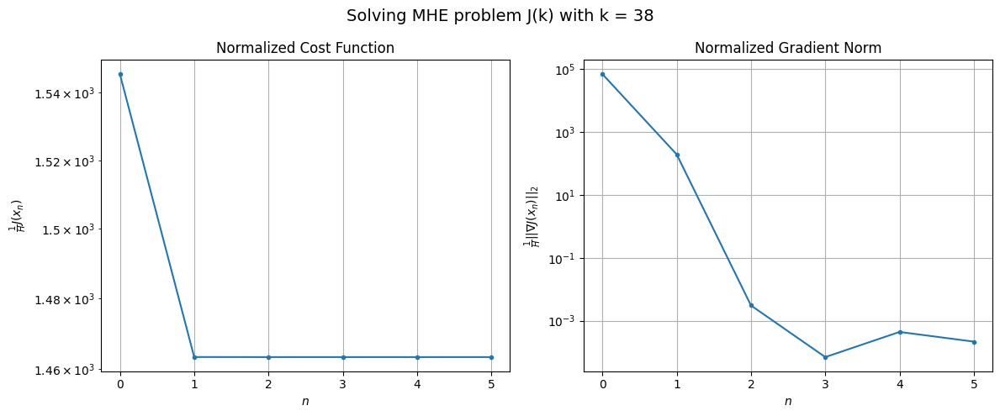

Windows:   5%|▌         | 20/376 [01:44<26:47,  4.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31852.422284141365
Gradient norm: 1520333.5833753638
Global estimation error: 292.53843938918095
Initial conditions estimation errors: 5.906550795709708 m, 20.784918539558475 m, 189.36903943785225 m, 221.92609975066603 m
Position estimation errors: 10.529098812267799 m, 23.44547287300351 m, 114.86842731952736 m, 147.76087269845047 m

[Gauss-Newton] Iteration 1
Cost function: 30205.014847514973 (-5.17%)
Gradient norm: 23712.90476056491 (-98.44%)
Global estimation error: 447.2068707781328 (52.87%)
Initial conditions estimation errors: 7.528268538509638 m, 35.800752242430555 m, 288.87739894602794 m, 339.41924254018954 m
Position estimation errors: 8.54998889087828 m, 37.6726145194205 m, 204.42574023665918 m, 264.0699000583986 m

[Gauss-Newton] Iteration 2
Cost function: 30190.266028066424 (-0.05%)
Gradient norm: 0.19470312401508358 (-100.00%)
Global estimation error: 447.2644394630648 (0.01%)
Initial conditions estimation errors:

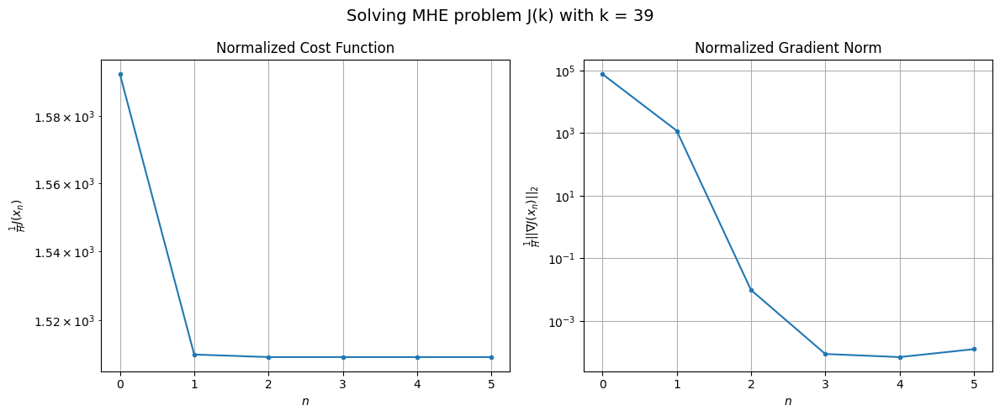

Windows:   6%|▌         | 21/376 [01:47<25:38,  4.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 33366.07586688448
Gradient norm: 1645518.8090009717
Global estimation error: 456.8819854579138
Initial conditions estimation errors: 6.049740016951845 m, 39.23713944505792 m, 293.81848158843854 m, 347.6142426732725 m
Position estimation errors: 11.099538758005673 m, 36.96605761456855 m, 188.77561871245504 m, 246.0726582215269 m

[Gauss-Newton] Iteration 1
Cost function: 31564.826508633978 (-5.40%)
Gradient norm: 27182.10527396893 (-98.35%)
Global estimation error: 246.92912999650525 (-45.95%)
Initial conditions estimation errors: 7.76493195482363 m, 22.402707581632367 m, 154.56312861221207 m, 191.10738036288137 m
Position estimation errors: 8.899911868792751 m, 22.055887080607945 m, 113.82511473206822 m, 149.90078707988565 m

[Gauss-Newton] Iteration 2
Cost function: 31530.40835205818 (-0.11%)
Gradient norm: 19.079562460868395 (-99.93%)
Global estimation error: 255.29529826524717 (3.39%)
Initial conditions estimation errors: 7

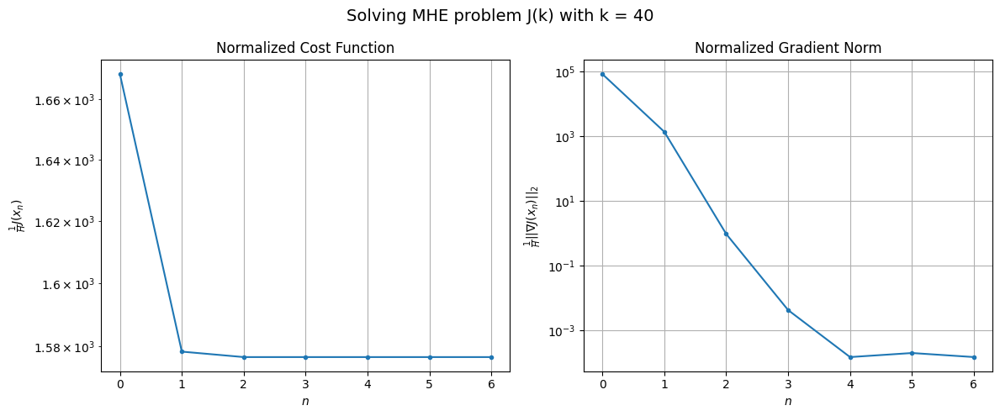

Windows:   6%|▌         | 22/376 [01:52<25:22,  4.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 35096.9844306925
Gradient norm: 1762315.3769410397
Global estimation error: 258.06050015822706
Initial conditions estimation errors: 6.387607706549353 m, 24.89546356126 m, 162.0471111844391 m, 199.18671466251823 m
Position estimation errors: 11.432988295192736 m, 23.003084258395543 m, 105.78699389482529 m, 140.47942992565166 m

[Gauss-Newton] Iteration 1
Cost function: 32981.76700307983 (-6.03%)
Gradient norm: 1300.222270994214 (-99.93%)
Global estimation error: 220.37841123147027 (-14.60%)
Initial conditions estimation errors: 8.319259174826357 m, 19.802396882799435 m, 140.1085324193355 m, 168.74503234053822 m
Position estimation errors: 9.01368787350199 m, 20.958024741898733 m, 82.18567144340437 m, 112.29385178747778 m

[Gauss-Newton] Iteration 2
Cost function: 32981.71755629735 (-0.00%)
Gradient norm: 1.3526791073201598 (-99.90%)
Global estimation error: 218.9480444319556 (-0.65%)
Initial conditions estimation errors: 8.319

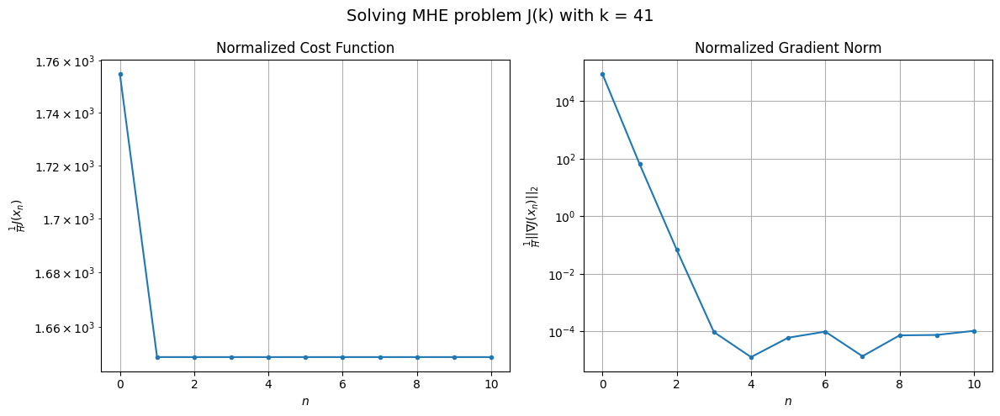

Windows:   6%|▌         | 23/376 [01:59<29:45,  5.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 36275.11538346535
Gradient norm: 1848473.091021977
Global estimation error: 221.06011571755727
Initial conditions estimation errors: 6.785087196300168 m, 20.86802079907722 m, 139.6745183296564 m, 169.93257886546897 m
Position estimation errors: 11.463400614448137 m, 21.778401465514914 m, 74.02169490105342 m, 102.71371175833316 m

[Gauss-Newton] Iteration 1
Cost function: 34038.95454403201 (-6.16%)
Gradient norm: 73116.45444577096 (-96.04%)
Global estimation error: 175.75244669782603 (-20.50%)
Initial conditions estimation errors: 9.01688965138396 m, 23.37240587753946 m, 110.10271673469357 m, 134.68008344509803 m
Position estimation errors: 8.81136217254186 m, 13.446006958300659 m, 51.10095373244271 m, 66.57576536389556 m

[Gauss-Newton] Iteration 2
Cost function: 33801.128534831936 (-0.70%)
Gradient norm: 79.68746857799005 (-99.89%)
Global estimation error: 161.5723126501698 (-8.07%)
Initial conditions estimation errors: 9.016

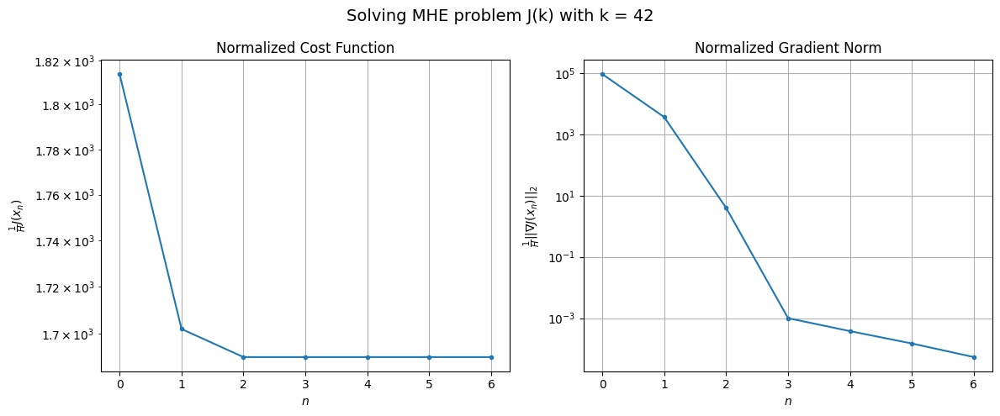

Windows:   6%|▋         | 24/376 [02:03<28:54,  4.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 35931.79855836704
Gradient norm: 1860883.8274176565
Global estimation error: 162.51130605915085
Initial conditions estimation errors: 7.152692725421632 m, 20.827683300940418 m, 102.83509503450954 m, 123.8947178914138 m
Position estimation errors: 11.187412101305885 m, 14.110294254157452 m, 41.79734209461344 m, 56.04871839684908 m

[Gauss-Newton] Iteration 1
Cost function: 33138.94193350666 (-7.77%)
Gradient norm: 6309.025701298797 (-99.66%)
Global estimation error: 246.76894290600387 (51.85%)
Initial conditions estimation errors: 9.708917003782318 m, 30.024478416766875 m, 155.45972179142137 m, 189.02759845906147 m
Position estimation errors: 8.40876934335713 m, 18.88702397922815 m, 86.7820587531868 m, 119.45108226272674 m

[Gauss-Newton] Iteration 2
Cost function: 33137.89094050566 (-0.00%)
Gradient norm: 14.325363531626214 (-99.77%)
Global estimation error: 241.27697526536593 (-2.23%)
Initial conditions estimation errors: 9.7

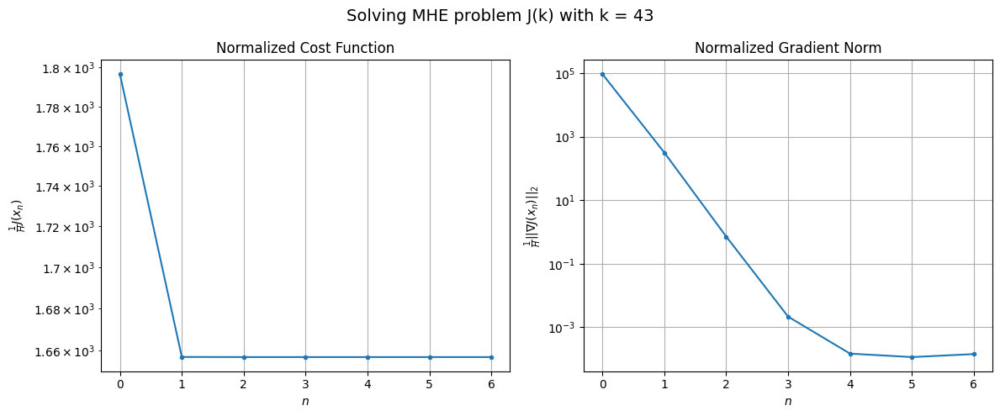

Windows:   7%|▋         | 25/376 [02:08<27:56,  4.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 34265.1270165712
Gradient norm: 1893216.259167434
Global estimation error: 245.3163412324431
Initial conditions estimation errors: 7.402257236420158 m, 28.73346563287802 m, 155.10645171215305 m, 187.72765724831467 m
Position estimation errors: 10.801296454361866 m, 19.008918052236982 m, 75.97490195377574 m, 106.82152263879034 m

[Gauss-Newton] Iteration 1
Cost function: 31180.384333387283 (-9.00%)
Gradient norm: 3063.595818363131 (-99.84%)
Global estimation error: 147.1331089275359 (-40.02%)
Initial conditions estimation errors: 10.221233955980484 m, 20.36283657087128 m, 91.09616978742238 m, 113.27182106383961 m
Position estimation errors: 7.919270993443939 m, 13.95358200929487 m, 57.980375730676165 m, 80.62145892349638 m

[Gauss-Newton] Iteration 2
Cost function: 31179.74363355134 (-0.00%)
Gradient norm: 2.4604717818737556 (-99.92%)
Global estimation error: 149.10917211815246 (1.34%)
Initial conditions estimation errors: 10.2

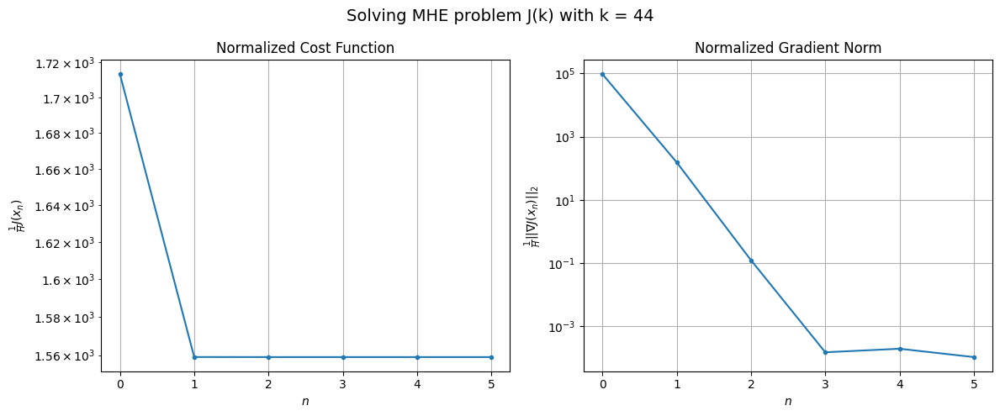

Windows:   7%|▋         | 26/376 [02:11<26:10,  4.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31337.790544171603
Gradient norm: 1827357.6984126915
Global estimation error: 151.58615057974998
Initial conditions estimation errors: 7.428500939613251 m, 19.44995952964019 m, 94.61820324138691 m, 116.58584515362065 m
Position estimation errors: 10.43026930938722 m, 15.492946405879373 m, 52.8174816690815 m, 74.9535470718861 m

[Gauss-Newton] Iteration 1
Cost function: 28306.81954832959 (-9.67%)
Gradient norm: 40417.84184472718 (-97.79%)
Global estimation error: 362.8113146496741 (139.34%)
Initial conditions estimation errors: 10.334222750005438 m, 37.56443050087761 m, 225.80055240245161 m, 281.2973633009414 m
Position estimation errors: 7.62524710752835 m, 36.79565799591164 m, 176.35009785956785 m, 247.21610549907376 m

[Gauss-Newton] Iteration 2
Cost function: 28268.077628693463 (-0.14%)
Gradient norm: 0.7823090144448441 (-100.00%)
Global estimation error: 363.77205529267223 (0.26%)
Initial conditions estimation errors: 10.3

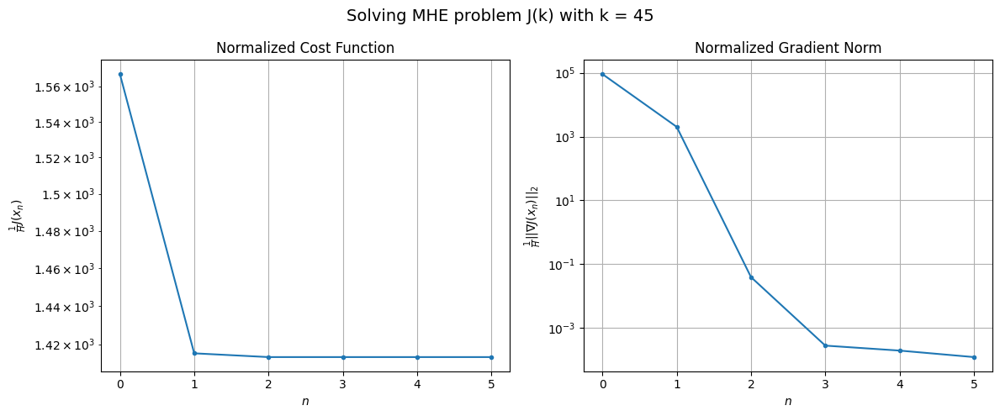

Windows:   7%|▋         | 27/376 [02:15<24:57,  4.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28221.958691261152
Gradient norm: 1852627.4664316939
Global estimation error: 374.9992321889268
Initial conditions estimation errors: 7.101678707179736 m, 38.615400708316365 m, 233.2252245655006 m, 291.01336217954145 m
Position estimation errors: 10.339340730956902 m, 36.48130759584174 m, 163.89372040836994 m, 233.00088170712831 m

[Gauss-Newton] Iteration 1
Cost function: 24979.499241012127 (-11.49%)
Gradient norm: 230.4707683206527 (-99.99%)
Global estimation error: 404.1216779219905 (7.77%)
Initial conditions estimation errors: 10.119849528707942 m, 43.363256225203145 m, 253.62963283289912 m, 311.45385973777746 m
Position estimation errors: 7.5050247754771515 m, 31.470455061834304 m, 148.08609082264596 m, 211.52063183632544 m

[Gauss-Newton] Iteration 2
Cost function: 24979.495422704942 (-0.00%)
Gradient norm: 0.7119313688598556 (-99.69%)
Global estimation error: 402.72644017554336 (-0.35%)
Initial conditions estimation err

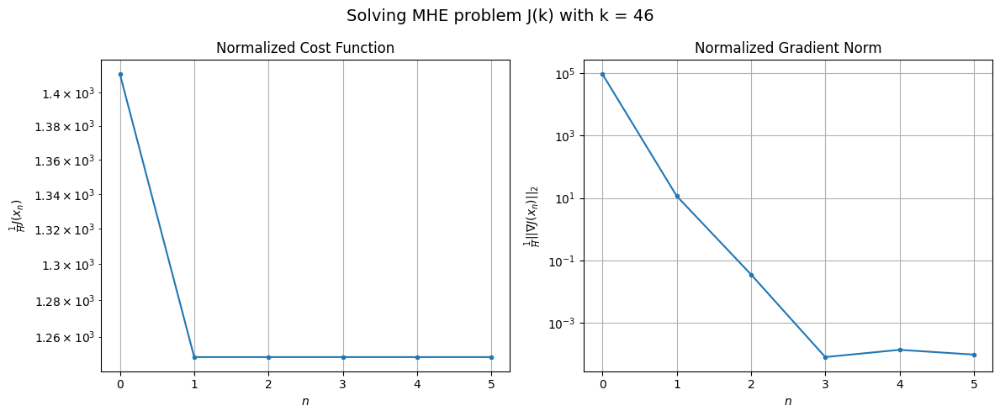

Windows:   7%|▋         | 28/376 [02:19<23:52,  4.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25198.31240155864
Gradient norm: 1781139.431515005
Global estimation error: 409.45158672916875
Initial conditions estimation errors: 6.564757571009324 m, 43.64615389509802 m, 256.37111716527596 m, 316.19033885044854 m
Position estimation errors: 10.418874436950857 m, 31.01682243304837 m, 132.1929763660059 m, 193.4289846361652 m

[Gauss-Newton] Iteration 1
Cost function: 22213.389807410585 (-11.85%)
Gradient norm: 49345.56890943486 (-97.23%)
Global estimation error: 78.95743478408309 (-80.72%)
Initial conditions estimation errors: 9.505252988756265 m, 13.538747058133952 m, 47.47340935159348 m, 60.884145653763724 m
Position estimation errors: 7.6909881760379335 m, 10.890496859339775 m, 28.315242692015005 m, 42.83454711780894 m

[Gauss-Newton] Iteration 2
Cost function: 22114.258246268644 (-0.45%)
Gradient norm: 19.318448338360433 (-99.96%)
Global estimation error: 73.06806289262174 (-7.46%)
Initial conditions estimation errors: 

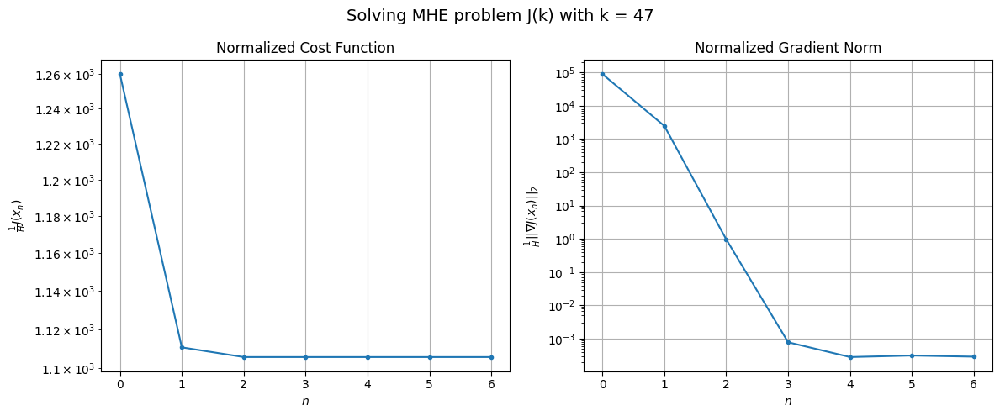

Windows:   8%|▊         | 29/376 [02:24<25:20,  4.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23322.122820456047
Gradient norm: 1766676.0845630364
Global estimation error: 70.69715401394697
Initial conditions estimation errors: 5.843237650744013 m, 10.577490550452021 m, 42.52608207166627 m, 55.168581328391674 m
Position estimation errors: 10.7384324222765 m, 12.888809034415246 m, 24.642825455114135 m, 38.077302726224666 m

[Gauss-Newton] Iteration 1
Cost function: 20329.823860105123 (-12.83%)
Gradient norm: 414.916679740364 (-99.98%)
Global estimation error: 46.224637558658266 (-34.62%)
Initial conditions estimation errors: 8.686678109103926 m, 9.763248959826804 m, 9.614787862310319 m, 43.28350559977591 m
Position estimation errors: 8.027087314464493 m, 8.32540191150766 m, 33.66436109255065 m, 50.682932600804946 m

[Gauss-Newton] Iteration 2
Cost function: 20329.77721119343 (-0.00%)
Gradient norm: 0.532877079890501 (-99.87%)
Global estimation error: 46.25396948805872 (0.06%)
Initial conditions estimation errors: 8.6866

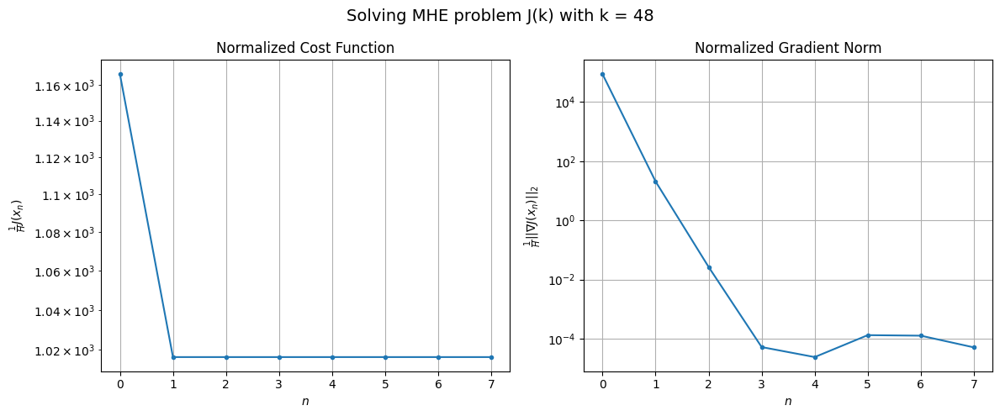

Windows:   8%|▊         | 30/376 [02:29<26:45,  4.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22953.71580515948
Gradient norm: 1757813.489252814
Global estimation error: 39.37991667928065
Initial conditions estimation errors: 5.16503265913277 m, 6.7672732620162535 m, 7.115753065032542 m, 37.78420340504131 m
Position estimation errors: 11.0946096882327 m, 11.173490496577287 m, 35.0040143529497 m, 51.505420151375716 m

[Gauss-Newton] Iteration 1
Cost function: 20038.19963732995 (-12.70%)
Gradient norm: 3172.6601333465383 (-99.82%)
Global estimation error: 41.41261238744106 (5.16%)
Initial conditions estimation errors: 7.8931266870839085 m, 6.27458040406543 m, 22.31146382882893 m, 33.39927606158672 m
Position estimation errors: 8.332133782886817 m, 6.9038349023879535 m, 17.43934576473131 m, 18.212448075344724 m

[Gauss-Newton] Iteration 2
Cost function: 20038.021051006777 (-0.00%)
Gradient norm: 0.06704644738726502 (-100.00%)
Global estimation error: 41.680779237691404 (0.65%)
Initial conditions estimation errors: 7.89312

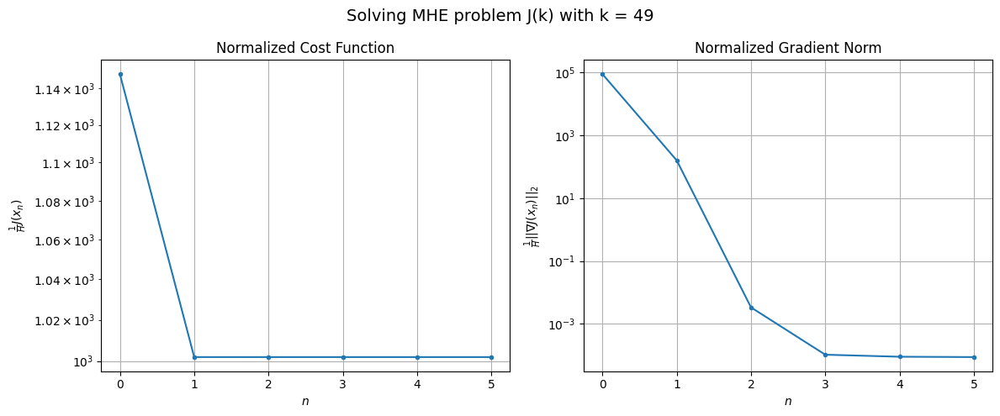

Windows:   8%|▊         | 31/376 [02:33<25:34,  4.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23306.393365385098
Gradient norm: 1632345.1106070129
Global estimation error: 38.55386669669819
Initial conditions estimation errors: 4.7608537831121085 m, 3.4627806264814955 m, 22.103476562912125 m, 31.03493906950849 m
Position estimation errors: 11.294873032854431 m, 9.602258843702185 m, 20.11123276177829 m, 20.539612269654647 m

[Gauss-Newton] Iteration 1
Cost function: 20618.634653461217 (-11.53%)
Gradient norm: 4253.2249680346 (-99.74%)
Global estimation error: 168.27987772782117 (336.48%)
Initial conditions estimation errors: 7.339123050641659 m, 12.764085255942355 m, 104.78982700258267 m, 130.8449776040677 m
Position estimation errors: 8.57244041494936 m, 7.192443999234787 m, 34.53856683178654 m, 38.35504838858129 m

[Gauss-Newton] Iteration 2
Cost function: 20617.315343726048 (-0.01%)
Gradient norm: 1.2173795474990394 (-99.97%)
Global estimation error: 167.26245526031926 (-0.60%)
Initial conditions estimation errors: 7

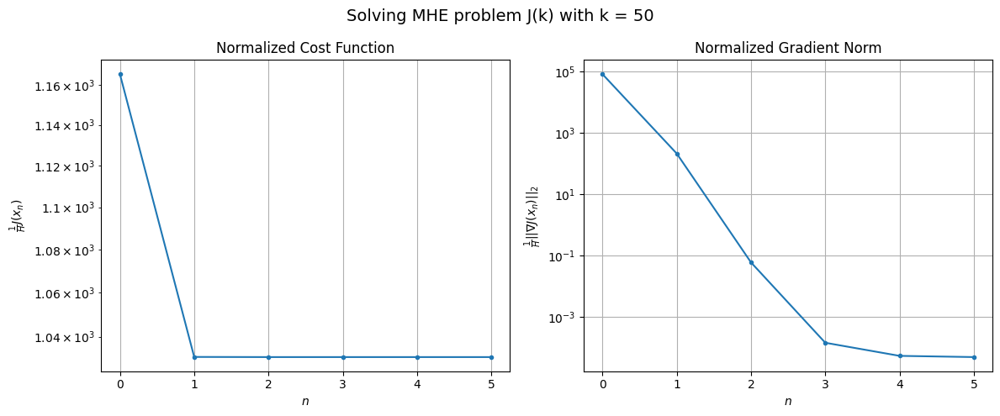

Windows:   9%|▊         | 32/376 [02:37<24:37,  4.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 24211.646969905465
Gradient norm: 1549550.8653828846
Global estimation error: 165.68928725491293
Initial conditions estimation errors: 4.738947700766954 m, 12.044601545999237 m, 104.01610761777506 m, 128.32009939109938 m
Position estimation errors: 11.341922851704211 m, 8.343026968275938 m, 31.178266274805523 m, 31.45117691156936 m

[Gauss-Newton] Iteration 1
Cost function: 21681.033969345393 (-10.45%)
Gradient norm: 11842.680235337837 (-99.24%)
Global estimation error: 36.70851756830843 (-77.84%)
Initial conditions estimation errors: 7.202067943408676 m, 10.229898469556918 m, 15.360110913171635 m, 30.90387274277936 m
Position estimation errors: 8.650206264729572 m, 11.488393940118193 m, 18.859466886095007 m, 35.8342072297561 m

[Gauss-Newton] Iteration 2
Cost function: 21673.935827715348 (-0.03%)
Gradient norm: 2.805334282282602 (-99.98%)
Global estimation error: 34.95520021968155 (-4.78%)
Initial conditions estimation errors

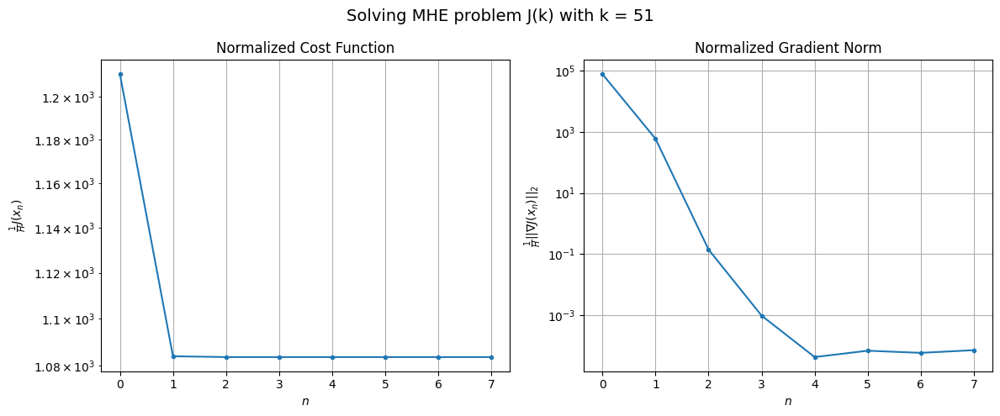

Windows:   9%|▉         | 33/376 [02:42<25:31,  4.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25492.932545227777
Gradient norm: 1489345.0382489904
Global estimation error: 34.17139339790097
Initial conditions estimation errors: 5.062754835833374 m, 9.603519161106453 m, 14.430820198870151 m, 29.009796066802682 m
Position estimation errors: 11.18249013952965 m, 13.098715588462749 m, 17.781224165130634 m, 33.53881129881493 m

[Gauss-Newton] Iteration 1
Cost function: 22980.080570313265 (-9.86%)
Gradient norm: 14021.203170778022 (-99.06%)
Global estimation error: 182.01469725829148 (432.65%)
Initial conditions estimation errors: 7.479166351201083 m, 28.146388032919898 m, 105.03926490214475 m, 145.76665871269927 m
Position estimation errors: 8.453627896956755 m, 12.775078976879229 m, 86.38119776122029 m, 139.79123852749666 m

[Gauss-Newton] Iteration 2
Cost function: 22974.570894955144 (-0.02%)
Gradient norm: 57.45367992228682 (-99.59%)
Global estimation error: 173.38822831168483 (-4.74%)
Initial conditions estimation error

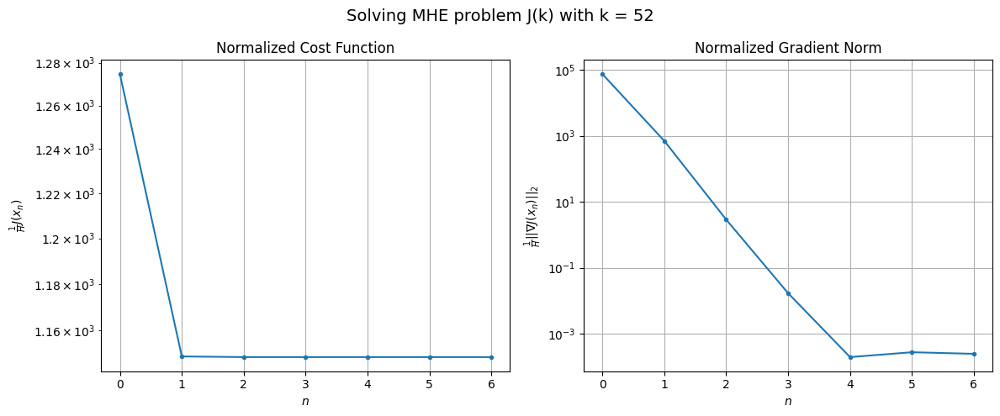

Windows:   9%|▉         | 34/376 [02:47<25:47,  4.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 26093.214111852958
Gradient norm: 1373786.4428474372
Global estimation error: 180.79077635529094
Initial conditions estimation errors: 5.580021069951815 m, 26.62996682145262 m, 103.98395450465438 m, 145.36963042321017 m
Position estimation errors: 10.726715856088589 m, 12.957288652136107 m, 75.10519168168885 m, 125.03416683048101 m

[Gauss-Newton] Iteration 1
Cost function: 23652.296513252433 (-9.35%)
Gradient norm: 703.5474914709665 (-99.95%)
Global estimation error: 221.92560388945196 (22.75%)
Initial conditions estimation errors: 7.979507347880752 m, 35.1053580323231 m, 128.7508864114668 m, 177.13864322839007 m
Position estimation errors: 8.051678591047276 m, 8.673039661012568 m, 93.53184608747507 m, 143.04249823200558 m

[Gauss-Newton] Iteration 2
Cost function: 23652.27427197934 (-0.00%)
Gradient norm: 0.15446588795639854 (-99.98%)
Global estimation error: 221.71610342900664 (-0.09%)
Initial conditions estimation errors: 

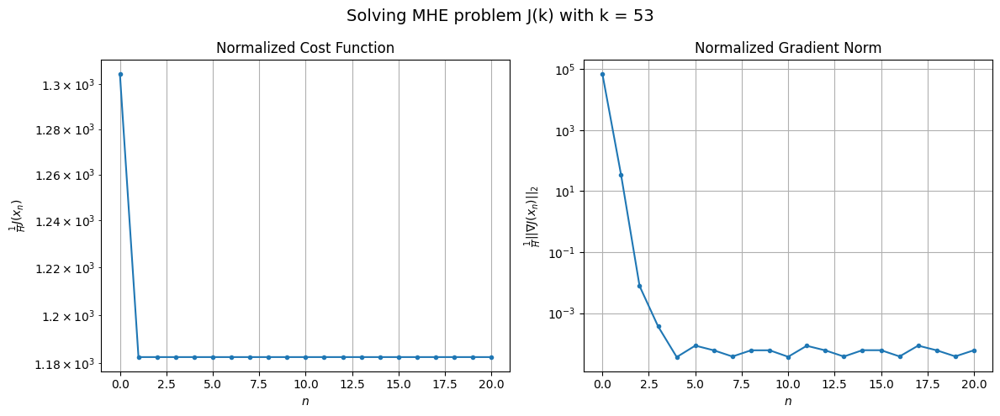

Windows:   9%|▉         | 35/376 [02:59<39:00,  6.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25515.256279027017
Gradient norm: 1252303.3332950016
Global estimation error: 229.01695154469115
Initial conditions estimation errors: 6.069275766068024 m, 33.62329573298662 m, 132.76639615592993 m, 183.45153192297724 m
Position estimation errors: 10.076898742135752 m, 8.836935760127611 m, 84.71361563793354 m, 132.1464736358144 m

[Gauss-Newton] Iteration 1
Cost function: 23082.4294856157 (-9.53%)
Gradient norm: 636.6192327080845 (-99.95%)
Global estimation error: 225.90897138116867 (-1.36%)
Initial conditions estimation errors: 8.53414804697781 m, 34.15360821098038 m, 128.6467074398562 m, 182.33362707985037 m
Position estimation errors: 7.4599307354910565 m, 15.220668132580467 m, 103.59288045578771 m, 163.35780171719347 m

[Gauss-Newton] Iteration 2
Cost function: 23082.422131121322 (-0.00%)
Gradient norm: 11.856270318940942 (-98.14%)
Global estimation error: 221.6332148376676 (-1.89%)
Initial conditions estimation errors: 8.

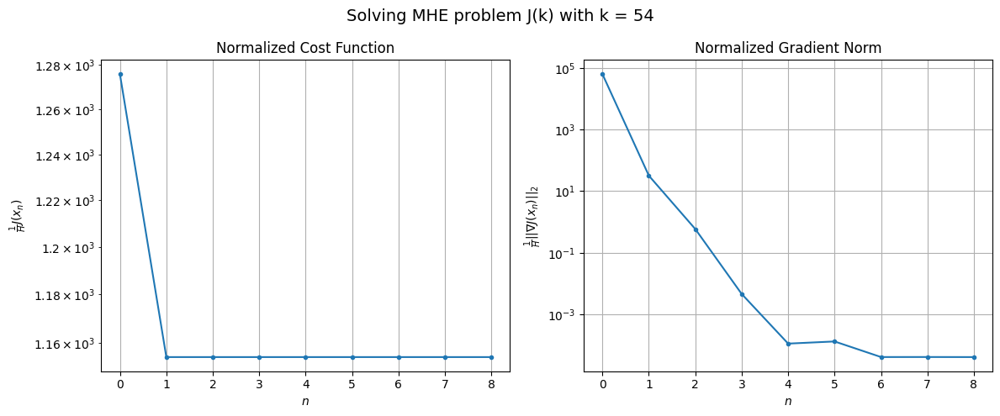

Windows:  10%|▉         | 36/376 [03:04<36:02,  6.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23854.98496668739
Gradient norm: 1182697.9021753315
Global estimation error: 230.94021328439183
Initial conditions estimation errors: 6.428824715279285 m, 32.35756917858899 m, 131.4078616286968 m, 187.0213440395993 m
Position estimation errors: 9.272286048089597 m, 14.992643253082566 m, 93.45163309362107 m, 150.11870106216708 m

[Gauss-Newton] Iteration 1
Cost function: 21575.283499338566 (-9.56%)
Gradient norm: 79822.10391658894 (-93.25%)
Global estimation error: 112.03778772423928 (-51.49%)
Initial conditions estimation errors: 8.939486421853681 m, 6.503113790056054 m, 64.73945779540581 m, 90.76920816192626 m
Position estimation errors: 6.69001054786817 m, 11.88927212938444 m, 72.37182445794025 m, 117.48180469113919 m

[Gauss-Newton] Iteration 2
Cost function: 21420.956840646842 (-0.72%)
Gradient norm: 40.16966610850484 (-99.95%)
Global estimation error: 104.28248613032115 (-6.92%)
Initial conditions estimation errors: 8.939

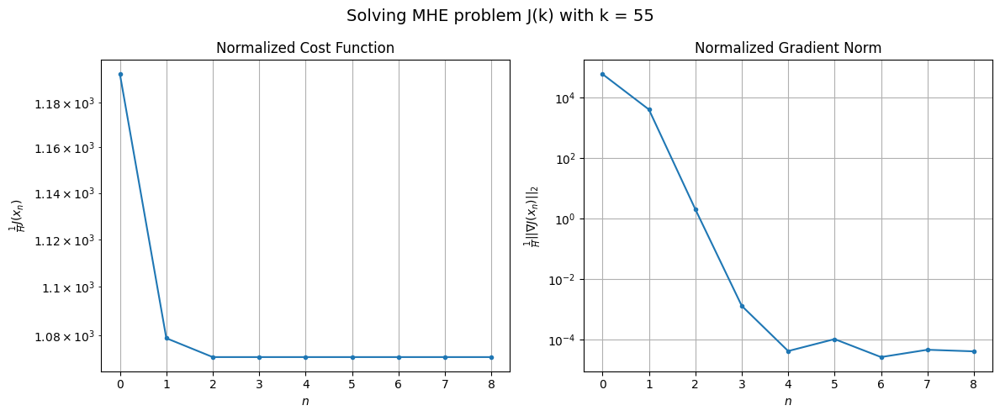

Windows:  10%|▉         | 37/376 [03:09<34:13,  6.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20895.552897870133
Gradient norm: 1057796.2285631842
Global estimation error: 107.99305331520442
Initial conditions estimation errors: 6.556107151399501 m, 4.31157205481873 m, 61.716942217918906 m, 88.27193584715913 m
Position estimation errors: 8.334510248828778 m, 10.80903945603295 m, 67.61323131000134 m, 109.70617713587806 m

[Gauss-Newton] Iteration 1
Cost function: 18636.110777794882 (-10.81%)
Gradient norm: 7106.073698192793 (-99.33%)
Global estimation error: 199.74140638367936 (84.96%)
Initial conditions estimation errors: 9.035977671425636 m, 7.903638294609841 m, 113.24885628969587 m, 164.09502624812268 m
Position estimation errors: 5.902507752126721 m, 14.941297408627452 m, 119.20032104062493 m, 195.79318266571883 m

[Gauss-Newton] Iteration 2
Cost function: 18635.01791751759 (-0.01%)
Gradient norm: 2.8421841334985607 (-99.96%)
Global estimation error: 197.81516612120097 (-0.96%)
Initial conditions estimation errors: 

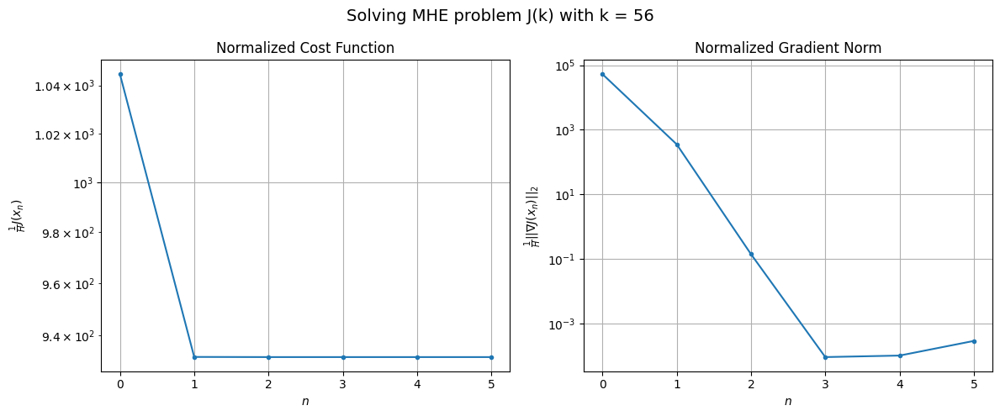

Windows:  10%|█         | 38/376 [03:13<30:19,  5.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 17477.16367064233
Gradient norm: 953896.2390963304
Global estimation error: 205.65622102126088
Initial conditions estimation errors: 6.379419220927345 m, 9.474023375409965 m, 115.41270825258185 m, 169.83494211011288 m
Position estimation errors: 7.4338590496566415 m, 13.62008445937021 m, 114.4462418302086 m, 188.32375573946658 m

[Gauss-Newton] Iteration 1
Cost function: 15425.083436413264 (-11.74%)
Gradient norm: 4522.093127999931 (-99.53%)
Global estimation error: 142.67256553599057 (-30.63%)
Initial conditions estimation errors: 8.774149939517788 m, 5.34487141332674 m, 81.24753564003457 m, 116.8277931276814 m
Position estimation errors: 5.144065764244754 m, 6.8804342784655415 m, 71.58086297957375 m, 116.8782819113112 m

[Gauss-Newton] Iteration 2
Cost function: 15424.671213505468 (-0.00%)
Gradient norm: 13.759517369957763 (-99.70%)
Global estimation error: 146.64893611609511 (2.79%)
Initial conditions estimation errors: 8.7

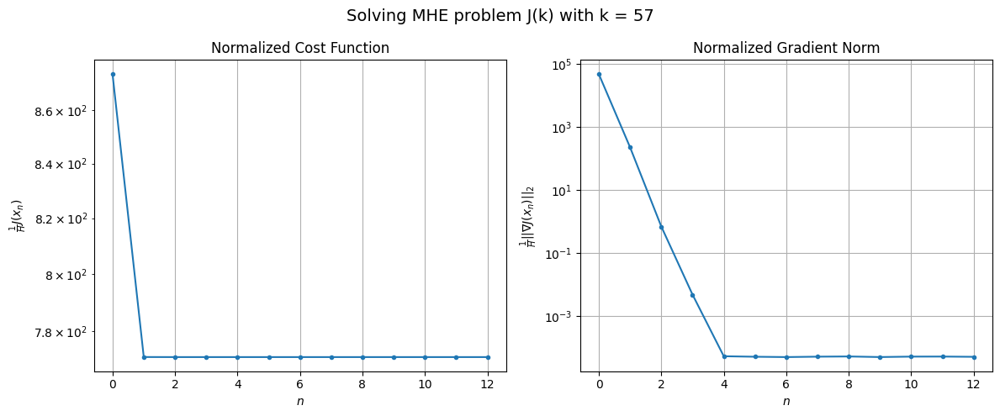

Windows:  10%|█         | 39/376 [03:21<33:40,  6.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13895.368740241309
Gradient norm: 878621.3891383503
Global estimation error: 149.1526096069657
Initial conditions estimation errors: 5.927523788753793 m, 5.879883407969433 m, 83.9743556027364 m, 122.98410146542822 m
Position estimation errors: 6.614187454790901 m, 6.551995708810906 m, 70.90544229721532 m, 115.92286490327052 m

[Gauss-Newton] Iteration 1
Cost function: 12175.240384309856 (-12.38%)
Gradient norm: 6035.285487414506 (-99.31%)
Global estimation error: 238.84097476362476 (60.13%)
Initial conditions estimation errors: 8.139484515081618 m, 8.100162172322726 m, 133.7054647856094 m, 197.57522574480672 m
Position estimation errors: 4.534970043972686 m, 10.25398808210578 m, 114.27360147618664 m, 195.50139373079833 m

[Gauss-Newton] Iteration 2
Cost function: 12174.444115035329 (-0.01%)
Gradient norm: 1.7719026308728625 (-99.97%)
Global estimation error: 240.25775026198224 (0.59%)
Initial conditions estimation errors: 8.13

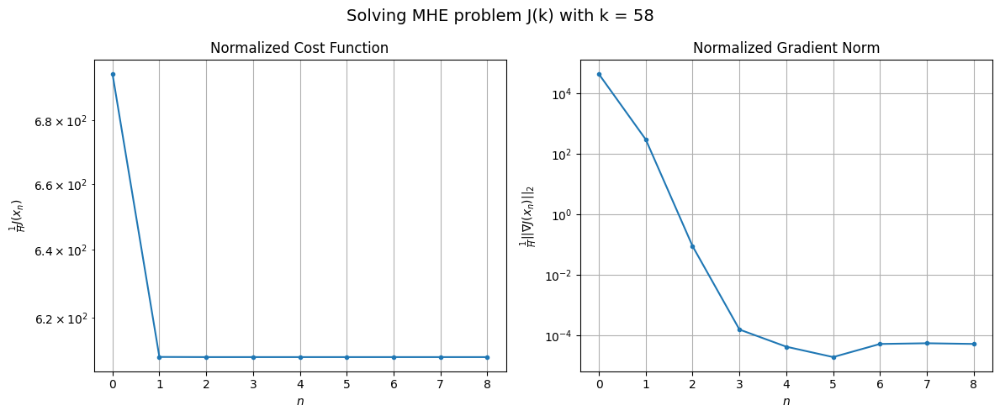

Windows:  11%|█         | 40/376 [03:26<32:50,  5.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10384.022310941928
Gradient norm: 831088.0617565316
Global estimation error: 246.85944101866124
Initial conditions estimation errors: 5.236093807818521 m, 9.983675101396388 m, 136.8107661872807 m, 205.1713565840816 m
Position estimation errors: 5.990041340381283 m, 9.46825892963275 m, 109.46162311226347 m, 188.36953469455804 m

[Gauss-Newton] Iteration 1
Cost function: 8858.043322207124 (-14.70%)
Gradient norm: 21557.109276590214 (-97.41%)
Global estimation error: 381.23404937911755 (54.43%)
Initial conditions estimation errors: 7.3434306301599594 m, 21.796358700930046 m, 206.78389147023995 m, 319.4537880230392 m
Position estimation errors: 4.046154259779785 m, 11.078748643672697 m, 194.62496512205544 m, 355.6583233250236 m

[Gauss-Newton] Iteration 2
Cost function: 8849.122753943982 (-0.10%)
Gradient norm: 2.9905920980365157 (-99.99%)
Global estimation error: 383.08399500726927 (0.49%)
Initial conditions estimation errors: 7.

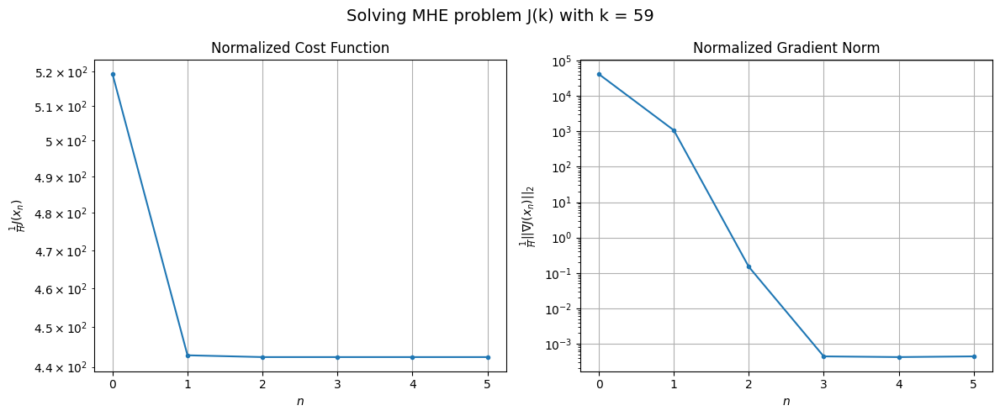

Windows:  11%|█         | 41/376 [03:30<29:57,  5.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7562.747923738268
Gradient norm: 833561.4163570945
Global estimation error: 398.6155133471395
Initial conditions estimation errors: 4.521085058007373 m, 23.971237115048726 m, 213.93861586187333 m, 335.4541036803228 m
Position estimation errors: 5.515001957046767 m, 9.521952376047725 m, 186.3572371420862 m, 343.78084190670154 m

[Gauss-Newton] Iteration 1
Cost function: 6369.652007334167 (-15.78%)
Gradient norm: 53381.07904463391 (-93.60%)
Global estimation error: 112.65875993274625 (-71.74%)
Initial conditions estimation errors: 6.406742604177861 m, 15.904661977814715 m, 59.10516814104116 m, 94.36397437456984 m
Position estimation errors: 3.729149453134023 m, 4.260103124385771 m, 61.60518774026589 m, 116.00216013332599 m

[Gauss-Newton] Iteration 2
Cost function: 6301.50220216647 (-1.07%)
Gradient norm: 8.708100109481306 (-99.98%)
Global estimation error: 109.31107596323571 (-2.97%)
Initial conditions estimation errors: 6.4067

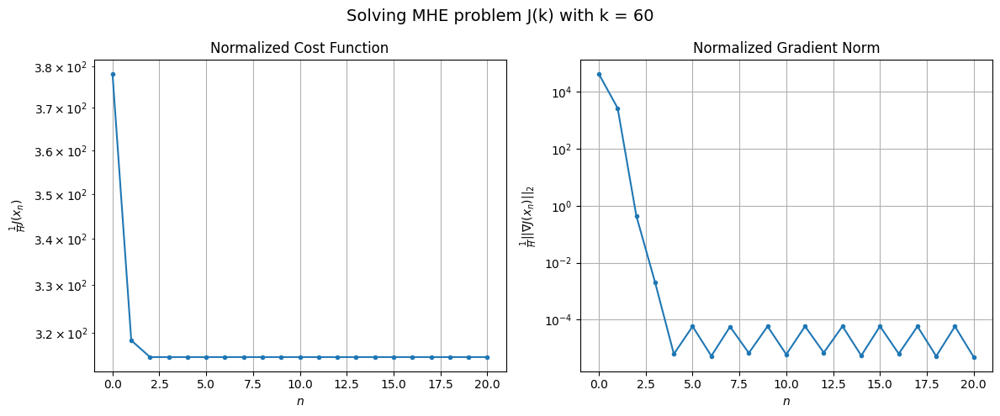

Windows:  11%|█         | 42/376 [03:42<40:46,  7.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5523.20670204078
Gradient norm: 811430.4324580927
Global estimation error: 112.37361173552848
Initial conditions estimation errors: 3.776093149436664 m, 16.426098756579886 m, 57.95561537670345 m, 94.78866321327394 m
Position estimation errors: 5.215447912109695 m, 6.799589489247802 m, 58.027934754687436 m, 109.7813657655684 m

[Gauss-Newton] Iteration 1
Cost function: 4506.153702141987 (-18.41%)
Gradient norm: 595.3103652575011 (-99.93%)
Global estimation error: 123.99762294477837 (10.34%)
Initial conditions estimation errors: 5.444763222183777 m, 12.38811098988493 m, 66.20164768470067 m, 103.96939424354483 m
Position estimation errors: 3.588750512140977 m, 2.329944172285013 m, 45.668487818553785 m, 71.24673808212411 m

[Gauss-Newton] Iteration 2
Cost function: 4506.147964380947 (-0.00%)
Gradient norm: 3.7154053550332002 (-99.38%)
Global estimation error: 121.95072897682131 (-1.65%)
Initial conditions estimation errors: 5.4447

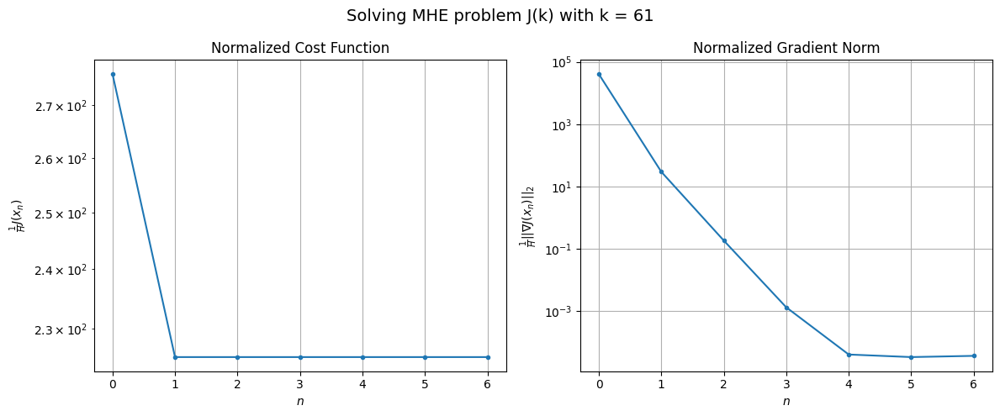

Windows:  11%|█▏        | 43/376 [03:47<35:57,  6.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4357.998335996184
Gradient norm: 820989.903064108
Global estimation error: 121.95065042895456
Initial conditions estimation errors: 3.0759243962142913 m, 13.28589489308963 m, 64.67271688060475 m, 102.48619333002821 m
Position estimation errors: 5.111624790896448 m, 3.867716148200841 m, 42.454686469281775 m, 64.24933231768402 m

[Gauss-Newton] Iteration 1
Cost function: 3539.488036725331 (-18.78%)
Gradient norm: 457.85036922659225 (-99.94%)
Global estimation error: 136.9977646061135 (12.34%)
Initial conditions estimation errors: 4.523023848396793 m, 15.477098284065985 m, 71.6858747238186 m, 115.62663094417417 m
Position estimation errors: 3.6057523092401405 m, 2.852083144722806 m, 52.784622492687376 m, 90.00377287643585 m

[Gauss-Newton] Iteration 2
Cost function: 3539.4843741555997 (-0.00%)
Gradient norm: 0.0044392223030081035 (-100.00%)
Global estimation error: 137.04516837153108 (0.03%)
Initial conditions estimation errors: 

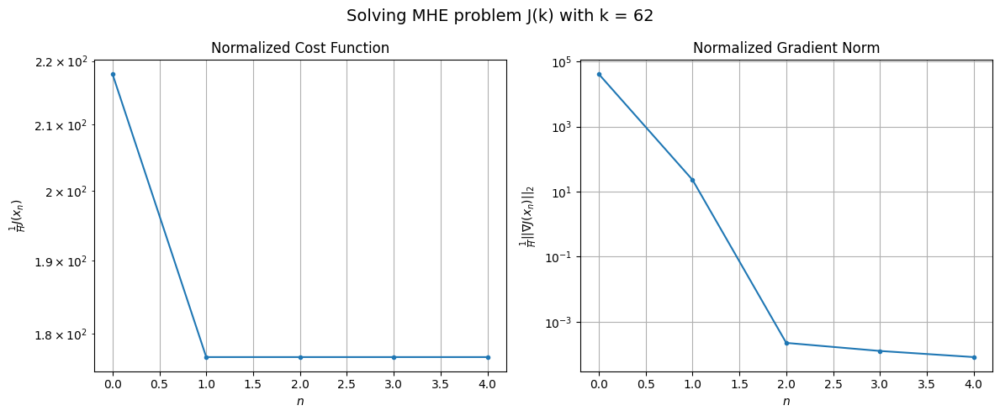

Windows:  12%|█▏        | 44/376 [03:50<30:13,  5.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3966.2102764431465
Gradient norm: 876555.071591804
Global estimation error: 138.8225555374071
Initial conditions estimation errors: 2.453039731026325 m, 16.1237815001683 m, 72.0646803677978 m, 117.52610418833683 m
Position estimation errors: 5.222610847139831 m, 5.060520754403506 m, 50.29986870310456 m, 84.7763252552429 m

[Gauss-Newton] Iteration 1
Cost function: 3258.5763297965873 (-17.84%)
Gradient norm: 8526.961135340393 (-99.03%)
Global estimation error: 30.95217868841661 (-77.70%)
Initial conditions estimation errors: 3.7313134056081245 m, 10.680467425957316 m, 17.782092680512083 m, 22.667902558922496 m
Position estimation errors: 3.7654867957408946 m, 6.910455984033047 m, 5.423036055053916 m, 9.222811759087126 m

[Gauss-Newton] Iteration 2
Cost function: 3256.8504499342307 (-0.05%)
Gradient norm: 19.24663931749092 (-99.77%)
Global estimation error: 26.50432535020904 (-14.37%)
Initial conditions estimation errors: 3.7313

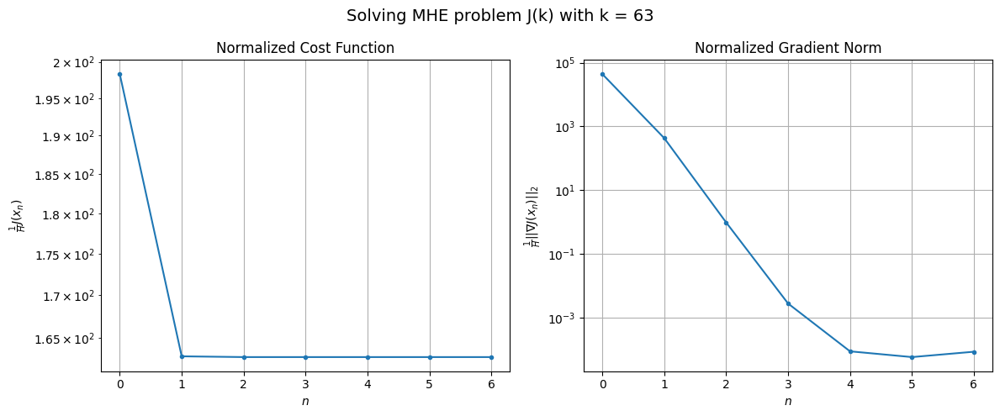

Windows:  12%|█▏        | 45/376 [03:54<28:17,  5.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4227.2688366720095
Gradient norm: 943889.4067714603
Global estimation error: 23.489118836419348
Initial conditions estimation errors: 1.98588538281588 m, 10.508934377691325 m, 13.291119604343608 m, 16.146182151358 m
Position estimation errors: 5.574249833957185 m, 9.035862722883172 m, 7.661096870639027 m, 12.93163276407564 m

[Gauss-Newton] Iteration 1
Cost function: 3556.983554554254 (-15.86%)
Gradient norm: 23081.54276753733 (-97.55%)
Global estimation error: 126.04191570134698 (436.60%)
Initial conditions estimation errors: 3.1766603798784514 m, 6.338238516607781 m, 61.614866759718595 m, 109.72630164957815 m
Position estimation errors: 4.099788263268073 m, 4.973616600607485 m, 88.77921348817777 m, 182.01155662364613 m

[Gauss-Newton] Iteration 2
Cost function: 3546.1963472224315 (-0.30%)
Gradient norm: 153.5678503794519 (-99.33%)
Global estimation error: 113.12963817817342 (-10.24%)
Initial conditions estimation errors: 3.1

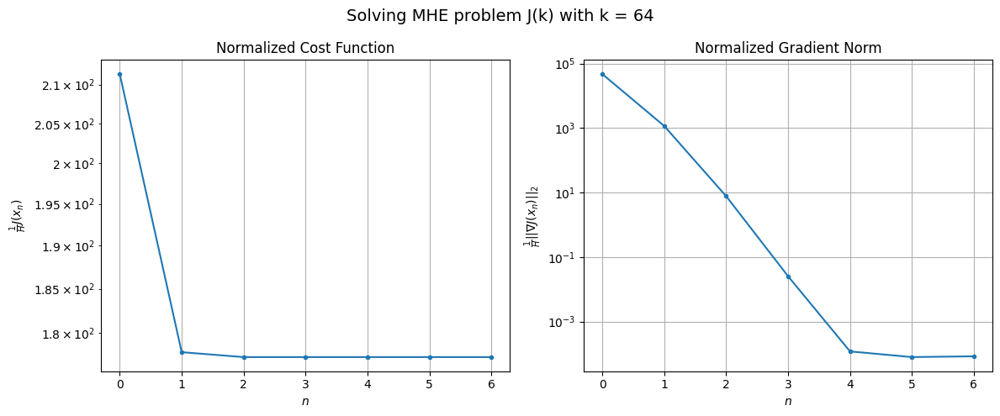

Windows:  12%|█▏        | 46/376 [03:59<26:57,  4.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4947.8580451428625
Gradient norm: 1010868.559762544
Global estimation error: 125.02079763106077
Initial conditions estimation errors: 1.7649636348823334 m, 4.1089433061540195 m, 60.370038307660806 m, 109.3874952549365 m
Position estimation errors: 6.200819167560998 m, 6.872709615812364 m, 80.78673334391114 m, 165.0494878070283 m

[Gauss-Newton] Iteration 1
Cost function: 4326.544844639563 (-12.56%)
Gradient norm: 46426.23519082996 (-95.41%)
Global estimation error: 346.9426118518623 (177.51%)
Initial conditions estimation errors: 2.897681006474 m, 14.405109067458548 m, 174.3454420257427 m, 299.59434880244294 m
Position estimation errors: 4.697055095619268 m, 7.697116262089521 m, 175.88395253835915 m, 401.9184284404682 m

[Gauss-Newton] Iteration 2
Cost function: 4282.287486922947 (-1.02%)
Gradient norm: 612.6501493013469 (-98.68%)
Global estimation error: 320.47662224189565 (-7.63%)
Initial conditions estimation errors: 2.8976

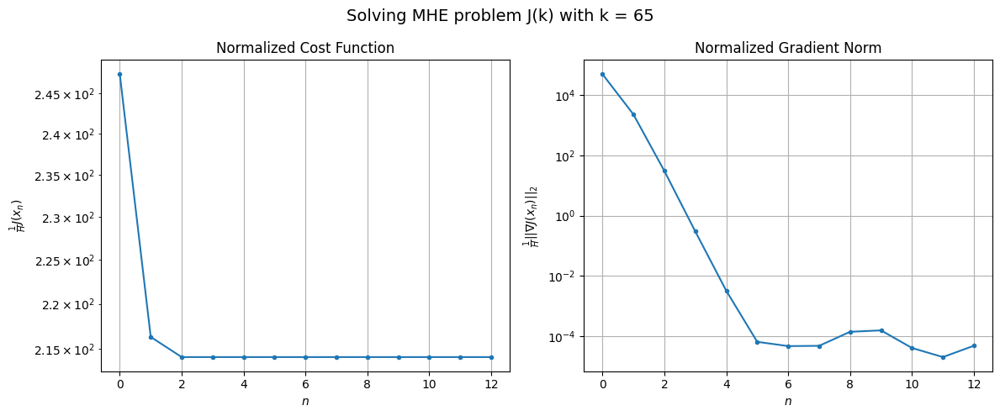

Windows:  12%|█▎        | 47/376 [04:06<31:07,  5.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6363.916014507769
Gradient norm: 1165910.1887952194
Global estimation error: 344.09491223124957
Initial conditions estimation errors: 1.7945375132971895 m, 11.399462070648198 m, 170.13198969025265 m, 298.86973778039214 m
Position estimation errors: 7.178944609962262 m, 8.512138019456284 m, 157.50856650512466 m, 364.84425686120176 m

[Gauss-Newton] Iteration 1
Cost function: 5739.123008054339 (-9.82%)
Gradient norm: 93079.41745441146 (-92.02%)
Global estimation error: 26.308088634528854 (-92.35%)
Initial conditions estimation errors: 2.9945344172139006 m, 7.535165370831094 m, 6.9365257545176835 m, 24.04681834102663 m
Position estimation errors: 5.491976757923942 m, 10.832858001024876 m, 27.69949544330479 m, 40.075178906880495 m

[Gauss-Newton] Iteration 2
Cost function: 5555.843523314404 (-3.19%)
Gradient norm: 23.354418774213514 (-99.97%)
Global estimation error: 28.553152099231397 (8.53%)
Initial conditions estimation errors:

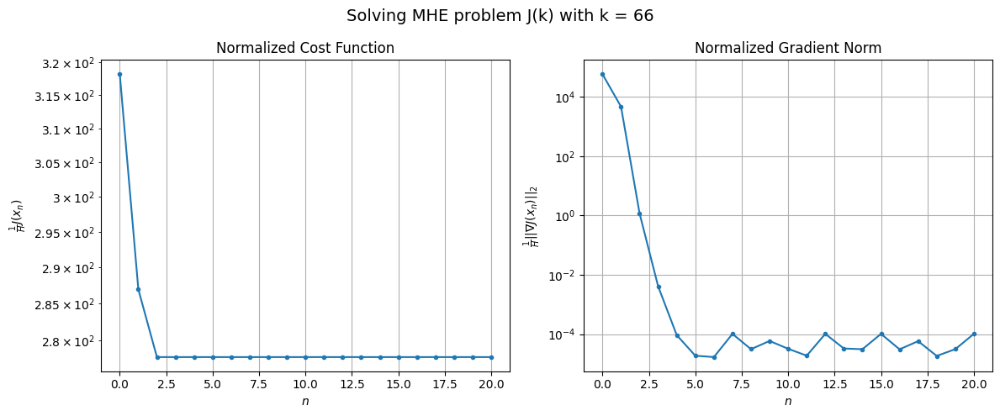

Windows:  13%|█▎        | 48/376 [04:17<40:12,  7.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8766.956979254002
Gradient norm: 1408418.9632965613
Global estimation error: 31.047700394461963
Initial conditions estimation errors: 2.102745859573358 m, 6.761018098541301 m, 9.155002274358527 m, 28.809868491002568 m
Position estimation errors: 8.414749809036993 m, 13.210248018331951 m, 28.20746577846884 m, 43.15291569171388 m

[Gauss-Newton] Iteration 1
Cost function: 7682.608899569323 (-12.37%)
Gradient norm: 5537.103255467664 (-99.61%)
Global estimation error: 124.46337414574977 (300.88%)
Initial conditions estimation errors: 3.423120421884253 m, 2.3546050595461536 m, 55.99635741494056 m, 111.07774260239502 m
Position estimation errors: 6.4240105311617 m, 6.292687944387211 m, 48.49533896626867 m, 109.96318484185021 m

[Gauss-Newton] Iteration 2
Cost function: 7681.815430946303 (-0.01%)
Gradient norm: 0.26965685401248707 (-100.00%)
Global estimation error: 123.97100901858748 (-0.40%)
Initial conditions estimation errors: 3.

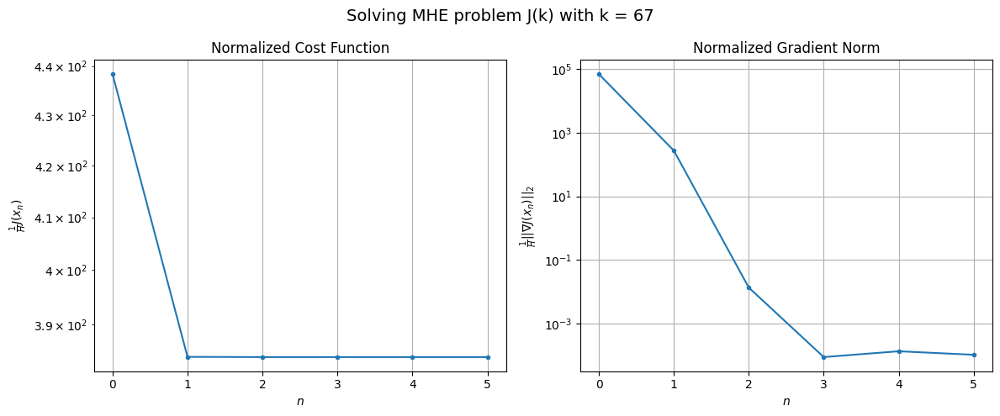

Windows:  13%|█▎        | 49/376 [04:21<34:31,  6.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11968.26248638679
Gradient norm: 1621279.7182700643
Global estimation error: 129.98272125588187
Initial conditions estimation errors: 2.5807061557200393 m, 1.9210278833101362 m, 58.20500217327354 m, 116.17798950209726 m
Position estimation errors: 9.810555678432593 m, 9.527771746479969 m, 44.434266605210965 m, 102.49060644669528 m

[Gauss-Newton] Iteration 1
Cost function: 10518.618778076378 (-12.11%)
Gradient norm: 218.9195955626791 (-99.99%)
Global estimation error: 145.4287730293229 (11.88%)
Initial conditions estimation errors: 4.1142924456514125 m, 3.6707787665935427 m, 67.10157113555725 m, 128.90497207807974 m
Position estimation errors: 7.503923675871918 m, 7.314687279360498 m, 48.930051606192734 m, 118.41942776510588 m

[Gauss-Newton] Iteration 2
Cost function: 10518.617806558117 (-0.00%)
Gradient norm: 0.3412999091674255 (-99.84%)
Global estimation error: 146.03425339101474 (0.42%)
Initial conditions estimation errors

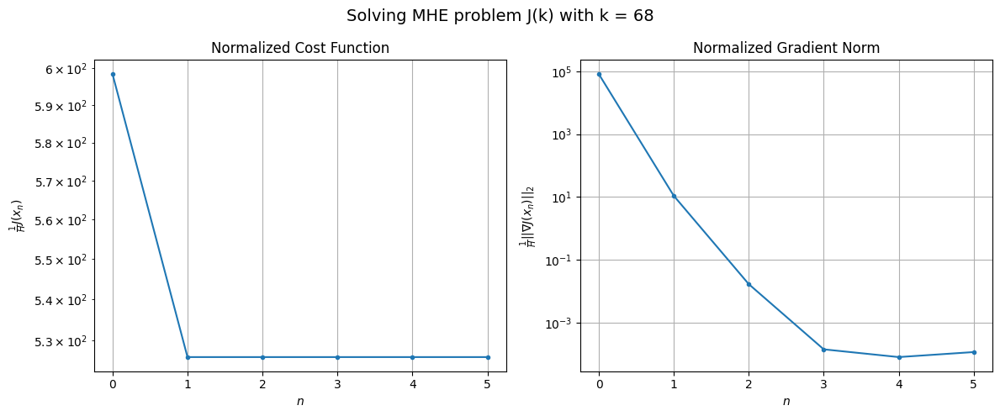

Windows:  13%|█▎        | 50/376 [04:25<29:36,  5.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15985.374657558765
Gradient norm: 1870889.882233062
Global estimation error: 152.13946326542003
Initial conditions estimation errors: 3.1640270582505 m, 3.2924263153461886 m, 69.64188158984572 m, 135.18713925857827 m
Position estimation errors: 11.339551689234943 m, 11.131022039338117 m, 44.40733581121142 m, 111.16307321185617 m

[Gauss-Newton] Iteration 1
Cost function: 14158.899873919925 (-11.43%)
Gradient norm: 84486.60861490943 (-95.48%)
Global estimation error: 119.28103814851146 (-21.60%)
Initial conditions estimation errors: 4.9781655992703175 m, 15.600239544205603 m, 69.9422624546476 m, 95.22525799249142 m
Position estimation errors: 8.663355246698211 m, 33.84770868948168 m, 63.37718261822086 m, 217.746775352802 m

[Gauss-Newton] Iteration 2
Cost function: 14020.607342170271 (-0.98%)
Gradient norm: 864.2119161424564 (-98.98%)
Global estimation error: 148.3903537100069 (24.40%)
Initial conditions estimation errors: 4.97

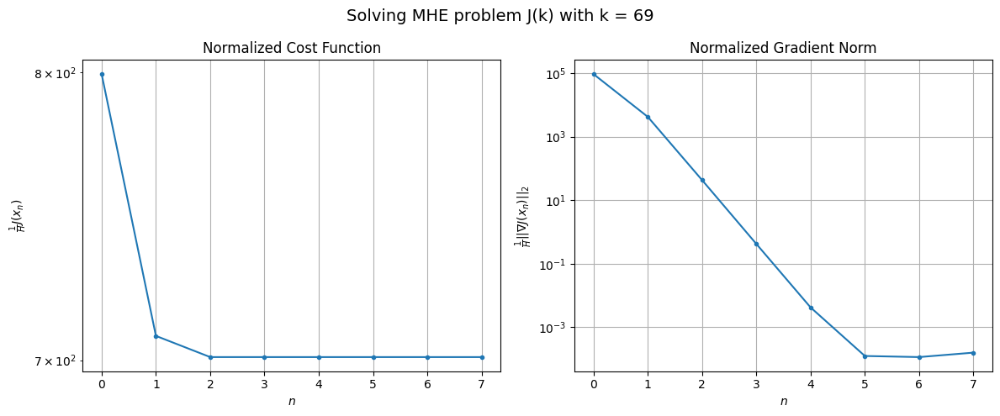

Windows:  14%|█▎        | 51/376 [04:30<28:24,  5.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 21124.8430042865
Gradient norm: 2126072.297193215
Global estimation error: 163.60158833018008
Initial conditions estimation errors: 3.800290334451812 m, 14.695817912907428 m, 87.97873759583356 m, 137.09396353386424 m
Position estimation errors: 12.886747408089448 m, 41.47697941293726 m, 72.87012868504236 m, 252.1148702803459 m

[Gauss-Newton] Iteration 1
Cost function: 18525.735020784756 (-12.30%)
Gradient norm: 14605.507457941061 (-99.31%)
Global estimation error: 79.51382202097173 (-51.40%)
Initial conditions estimation errors: 5.902040044550347 m, 5.477031159606599 m, 39.85357781886677 m, 68.33227286537605 m
Position estimation errors: 9.81080794108118 m, 20.032114291442277 m, 29.95502151986839 m, 103.05793661988467 m

[Gauss-Newton] Iteration 2
Cost function: 18521.928367172528 (-0.02%)
Gradient norm: 245.64048469791598 (-98.32%)
Global estimation error: 66.38937625309899 (-16.51%)
Initial conditions estimation errors: 5.9

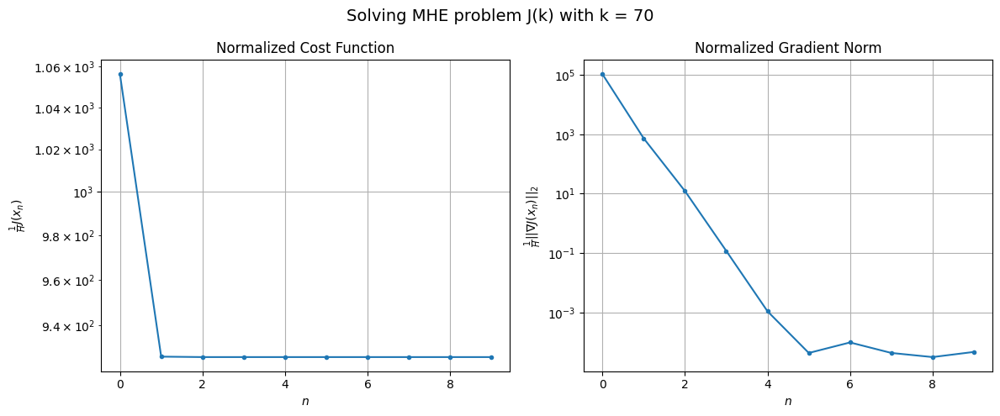

Windows:  14%|█▍        | 52/376 [04:35<29:14,  5.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27228.61037261947
Gradient norm: 2360831.4555014926
Global estimation error: 67.67850639542564
Initial conditions estimation errors: 4.431926814829799 m, 3.7864280403719377 m, 32.13799688790977 m, 59.275160255958816 m
Position estimation errors: 14.348309404309205 m, 22.30811418731959 m, 24.78875589170698 m, 83.2884798151279 m

[Gauss-Newton] Iteration 1
Cost function: 23994.092026561386 (-11.88%)
Gradient norm: 6382.619163640035 (-99.73%)
Global estimation error: 107.69756296776391 (59.13%)
Initial conditions estimation errors: 6.7826741577486125 m, 5.9761675076831 m, 55.46745341567145 m, 91.87152388798587 m
Position estimation errors: 10.921310575740167 m, 25.28748409082298 m, 58.45041432697546 m, 183.6995014661248 m

[Gauss-Newton] Iteration 2
Cost function: 23993.380036462917 (-0.00%)
Gradient norm: 28.60801892686716 (-99.55%)
Global estimation error: 113.4087891330605 (5.30%)
Initial conditions estimation errors: 6.782674

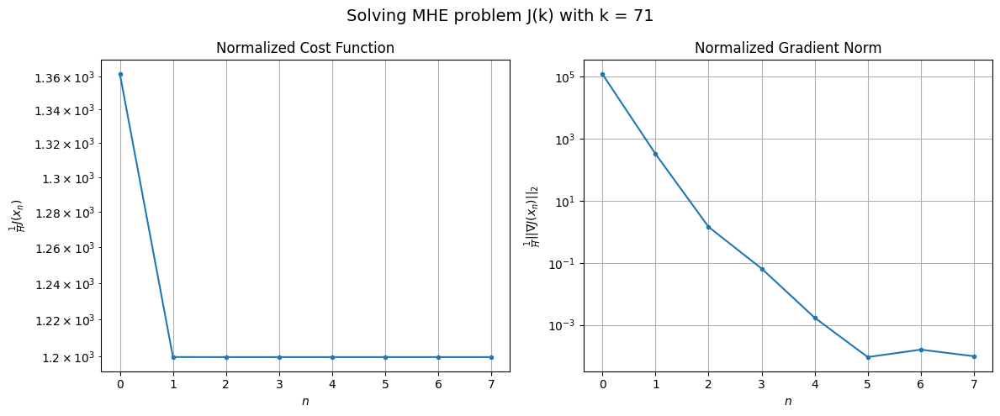

Windows:  14%|█▍        | 53/376 [04:40<28:38,  5.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 33727.22085902354
Gradient norm: 2497600.3693933818
Global estimation error: 123.49544521646428
Initial conditions estimation errors: 5.00221143717408 m, 4.253004043955227 m, 60.234886429298314 m, 107.60921405282849 m
Position estimation errors: 15.695983964255005 m, 30.74584041290011 m, 61.65673185143422 m, 190.71425504524004 m

[Gauss-Newton] Iteration 1
Cost function: 29786.673228149808 (-11.68%)
Gradient norm: 1654.9605720528418 (-99.93%)
Global estimation error: 88.1666705016446 (-28.61%)
Initial conditions estimation errors: 7.691771495471898 m, 6.8065211095735325 m, 42.2218471063786 m, 76.71483702568503 m
Position estimation errors: 11.960099556690897 m, 25.296768572879262 m, 47.247627244552646 m, 144.7852931265149 m

[Gauss-Newton] Iteration 2
Cost function: 29786.619120228694 (-0.00%)
Gradient norm: 25.99705155578625 (-98.43%)
Global estimation error: 84.46905602361171 (-4.19%)
Initial conditions estimation errors: 7.

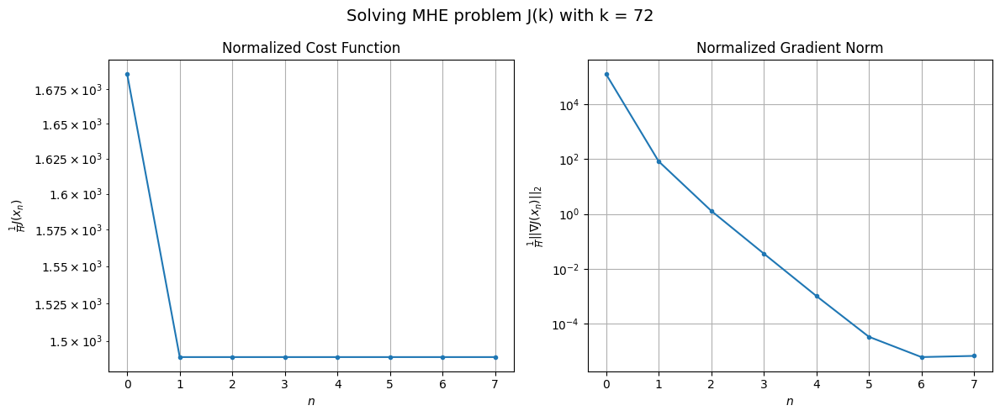

Windows:  14%|█▍        | 54/376 [04:45<28:04,  5.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 40896.521607594164
Gradient norm: 2639092.393607492
Global estimation error: 89.44498936702543
Initial conditions estimation errors: 5.600506443965773 m, 5.235216743752766 m, 40.57786842794918 m, 79.34137244298043 m
Position estimation errors: 16.87928202071688 m, 29.49142725118143 m, 48.28771041917672 m, 138.6721711826037 m

[Gauss-Newton] Iteration 1
Cost function: 36170.75622252165 (-11.56%)
Gradient norm: 4885.404561237479 (-99.81%)
Global estimation error: 31.319940241954104 (-64.98%)
Initial conditions estimation errors: 8.604861763206545 m, 10.587111270998136 m, 11.107680222702115 m, 25.911776235275727 m
Position estimation errors: 12.830415708407003 m, 17.590507319346017 m, 28.933287345238163 m, 63.25193601916132 m

[Gauss-Newton] Iteration 2
Cost function: 36170.27987880643 (-0.00%)
Gradient norm: 38.01896897524472 (-99.22%)
Global estimation error: 28.199835925130163 (-9.96%)
Initial conditions estimation errors: 8.6

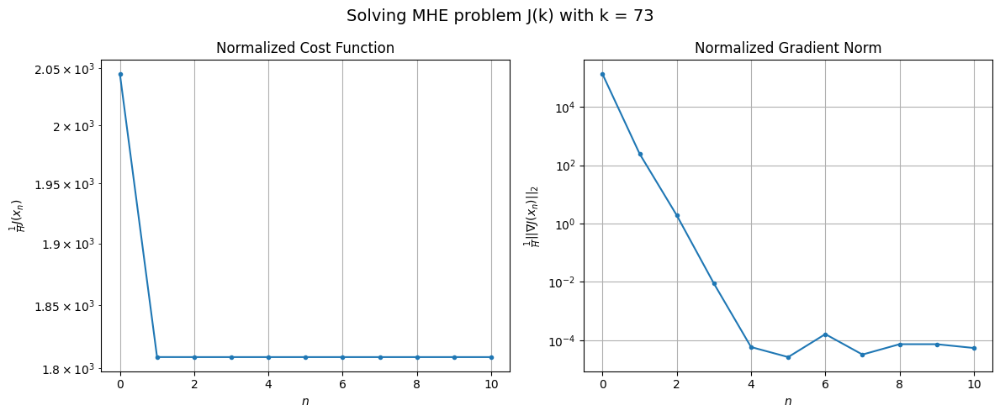

Windows:  15%|█▍        | 55/376 [04:52<29:43,  5.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 48201.31951826882
Gradient norm: 2665801.909625174
Global estimation error: 27.062955483738754
Initial conditions estimation errors: 6.228093794671418 m, 8.910952742781438 m, 8.322590296585682 m, 23.343898686500754 m
Position estimation errors: 17.760490078176197 m, 22.007433811509134 m, 32.7027502509693 m, 60.23485042061219 m

[Gauss-Newton] Iteration 1
Cost function: 42868.56208502997 (-11.06%)
Gradient norm: 1698.7173150616184 (-99.94%)
Global estimation error: 83.41390734362778 (208.22%)
Initial conditions estimation errors: 9.466817562929478 m, 12.797658564524433 m, 30.63178421236065 m, 75.93525930483786 m
Position estimation errors: 13.507780073064074 m, 21.495099989364025 m, 38.15587613727481 m, 89.43246282346898 m

[Gauss-Newton] Iteration 2
Cost function: 42868.479641583064 (-0.00%)
Gradient norm: 0.3914997360677177 (-99.98%)
Global estimation error: 83.90213498224772 (0.59%)
Initial conditions estimation errors: 9.46

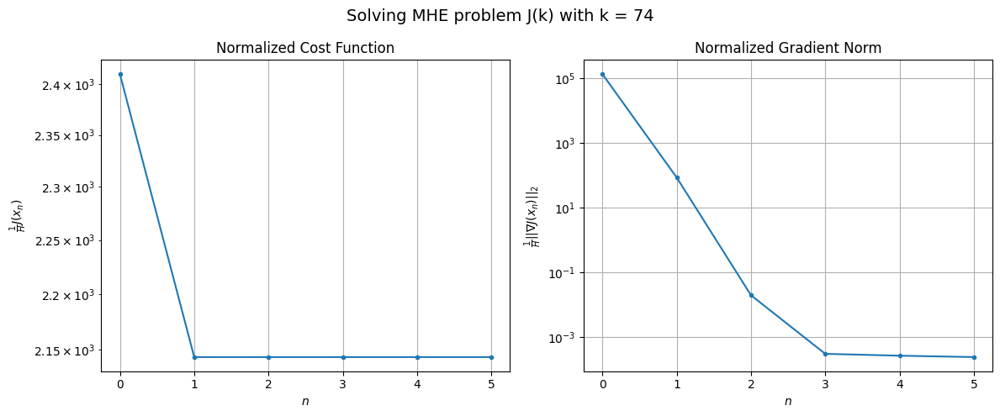

Windows:  15%|█▍        | 56/376 [04:56<27:03,  5.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 54871.4324498082
Gradient norm: 2603562.565038909
Global estimation error: 85.66491977623264
Initial conditions estimation errors: 6.853513363074072 m, 11.00732674165167 m, 31.00494529267077 m, 78.7974110198012 m
Position estimation errors: 18.321162885107004 m, 26.53805298711272 m, 42.66918369568446 m, 90.77690293602004 m

[Gauss-Newton] Iteration 1
Cost function: 49028.649737414 (-10.65%)
Gradient norm: 25686.902674731864 (-99.01%)
Global estimation error: 50.33594309729688 (-41.24%)
Initial conditions estimation errors: 10.341331356208478 m, 19.610088091173594 m, 27.878907125630214 m, 35.566093708750074 m
Position estimation errors: 13.958927315455165 m, 16.27007046125555 m, 22.949290777140106 m, 96.46188022710183 m

[Gauss-Newton] Iteration 2
Cost function: 49016.2179341554 (-0.03%)
Gradient norm: 26.52960445894596 (-99.90%)
Global estimation error: 48.196084670521124 (-4.25%)
Initial conditions estimation errors: 10.34133

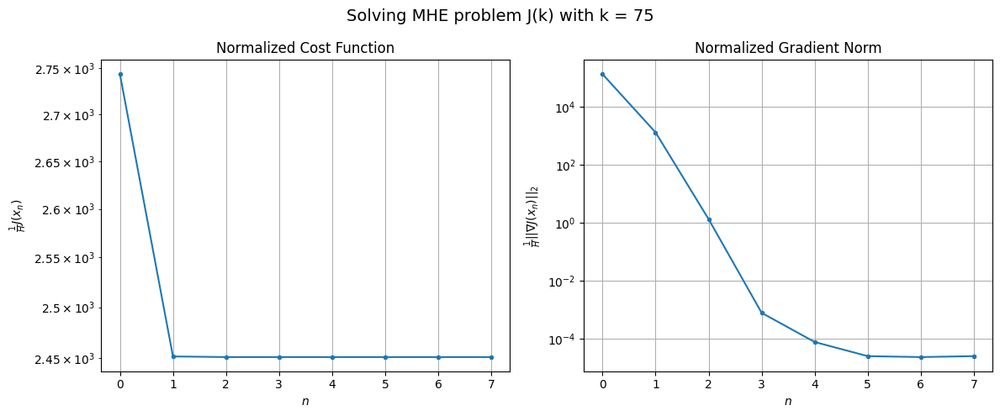

Windows:  15%|█▌        | 57/376 [05:01<26:47,  5.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 60709.51592245219
Gradient norm: 2506456.8832862577
Global estimation error: 50.337011586754166
Initial conditions estimation errors: 7.522737246503673 m, 15.872867127632855 m, 27.791797455493246 m, 38.116498155140945 m
Position estimation errors: 18.587557877229234 m, 17.65303981773039 m, 23.195103282294994 m, 88.71786294240103 m

[Gauss-Newton] Iteration 1
Cost function: 54495.79639133317 (-10.24%)
Gradient norm: 12017.414733865784 (-99.52%)
Global estimation error: 31.333890368313824 (-37.75%)
Initial conditions estimation errors: 11.188647314981422 m, 13.223694117035725 m, 13.065507364462285 m, 22.60627387176135 m
Position estimation errors: 14.188779941791012 m, 19.058105742865397 m, 28.72344003926541 m, 50.039153271889106 m

[Gauss-Newton] Iteration 2
Cost function: 54493.202618216084 (-0.00%)
Gradient norm: 3.472904675325512 (-99.97%)
Global estimation error: 30.683783184357992 (-2.07%)
Initial conditions estimation err

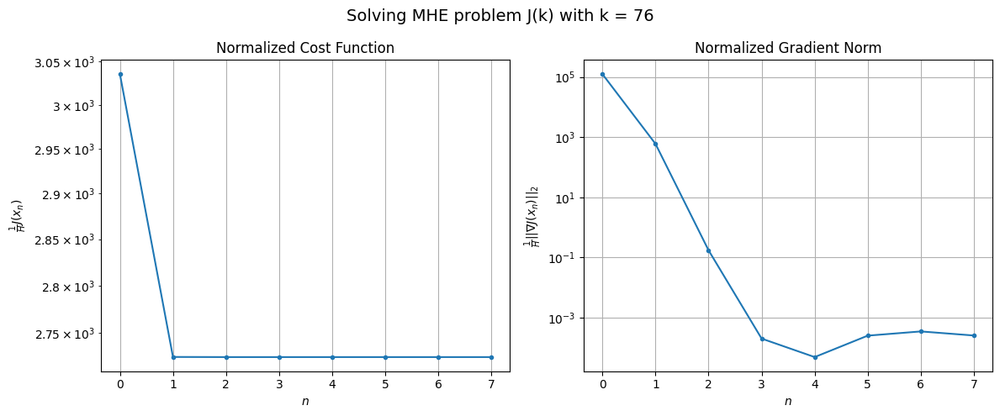

Windows:  15%|█▌        | 58/376 [05:06<26:23,  4.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 65463.94428007738
Gradient norm: 2324864.8658903353
Global estimation error: 27.32143099647094
Initial conditions estimation errors: 8.179414884911596 m, 10.715467795643807 m, 10.68798049853675 m, 21.224880936452966 m
Position estimation errors: 18.629872890129658 m, 23.362397042425084 m, 33.16203995770392 m, 52.648427360257145 m

[Gauss-Newton] Iteration 1
Cost function: 58933.79626551833 (-9.98%)
Gradient norm: 5274.678603354548 (-99.77%)
Global estimation error: 28.60896528816886 (4.71%)
Initial conditions estimation errors: 12.01108645304845 m, 18.01559129730717 m, 9.555441693725397 m, 16.072265104314393 m
Position estimation errors: 14.22445608595926 m, 11.820644919825238 m, 15.566288017460817 m, 51.26098089035575 m

[Gauss-Newton] Iteration 2
Cost function: 58933.29460891252 (-0.00%)
Gradient norm: 1.4427649617048235 (-99.97%)
Global estimation error: 28.378985598207223 (-0.80%)
Initial conditions estimation errors: 12.0

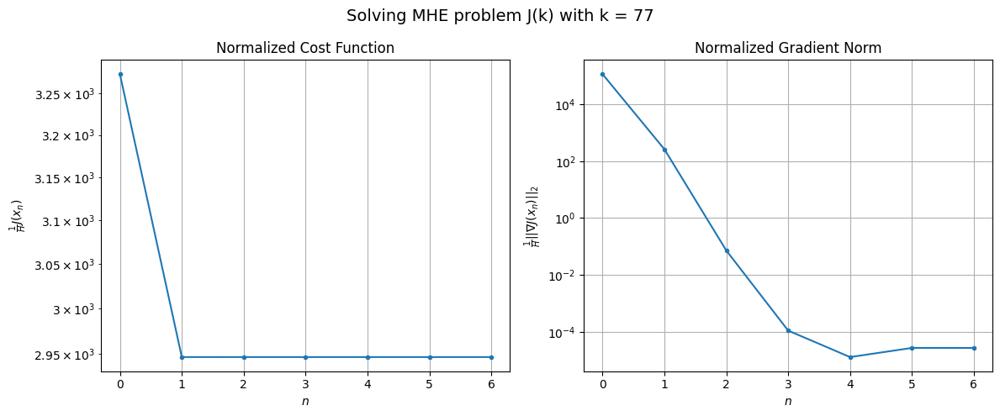

Windows:  16%|█▌        | 59/376 [05:10<25:00,  4.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 69055.27053022655
Gradient norm: 2105564.9986095587
Global estimation error: 24.284752846488246
Initial conditions estimation errors: 8.820645429887692 m, 14.47226692295162 m, 9.947248293047526 m, 14.266471653510234 m
Position estimation errors: 18.49428460621853 m, 14.18007967601816 m, 18.560844375367385 m, 49.4694482333779 m

[Gauss-Newton] Iteration 1
Cost function: 62443.24831323989 (-9.57%)
Gradient norm: 2049.2841599433514 (-99.90%)
Global estimation error: 23.112162472273635 (-4.83%)
Initial conditions estimation errors: 12.74280522301669 m, 14.169249876072291 m, 10.574629804646 m, 7.693475879806654 m
Position estimation errors: 14.173918300313238 m, 13.654706273529312 m, 18.77791370411978 m, 18.093316550763685 m

[Gauss-Newton] Iteration 2
Cost function: 62443.17228597935 (-0.00%)
Gradient norm: 0.014022516780214538 (-100.00%)
Global estimation error: 23.06669934793916 (-0.20%)
Initial conditions estimation errors: 12.

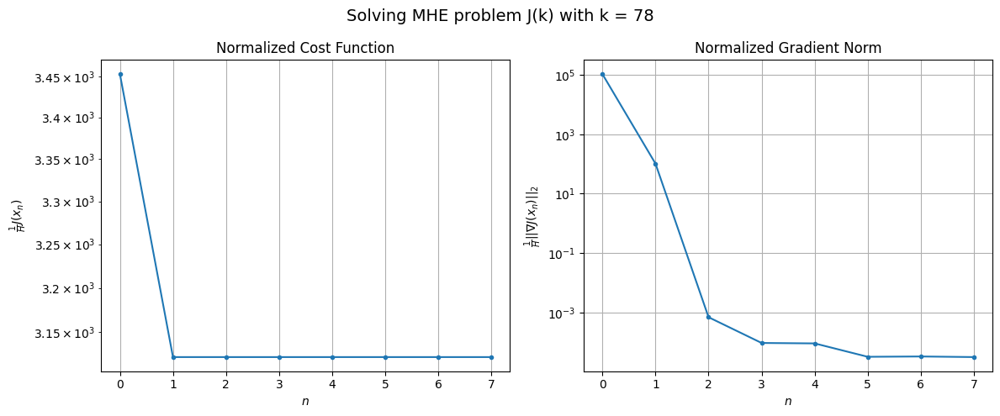

Windows:  16%|█▌        | 60/376 [05:15<25:03,  4.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 71147.50078957914
Gradient norm: 1914081.9699609012
Global estimation error: 17.046085054076215
Initial conditions estimation errors: 9.377743561269284 m, 10.847050867467896 m, 7.530554166397719 m, 5.314860701214692 m
Position estimation errors: 18.293668154627586 m, 17.476573657691716 m, 23.011335038986353 m, 22.421017308775287 m

[Gauss-Newton] Iteration 1
Cost function: 64442.374603233766 (-9.42%)
Gradient norm: 2648.7250158199236 (-99.86%)
Global estimation error: 32.42028675347786 (90.19%)
Initial conditions estimation errors: 13.394205048654799 m, 9.963473682357748 m, 20.02589949685929 m, 19.270384162340058 m
Position estimation errors: 14.062069811799336 m, 21.439815144174812 m, 34.8187121179062 m, 84.61682934163821 m

[Gauss-Newton] Iteration 2
Cost function: 64442.22801291652 (-0.00%)
Gradient norm: 5.288663589863217 (-99.80%)
Global estimation error: 32.45929644999625 (0.12%)
Initial conditions estimation errors: 13.

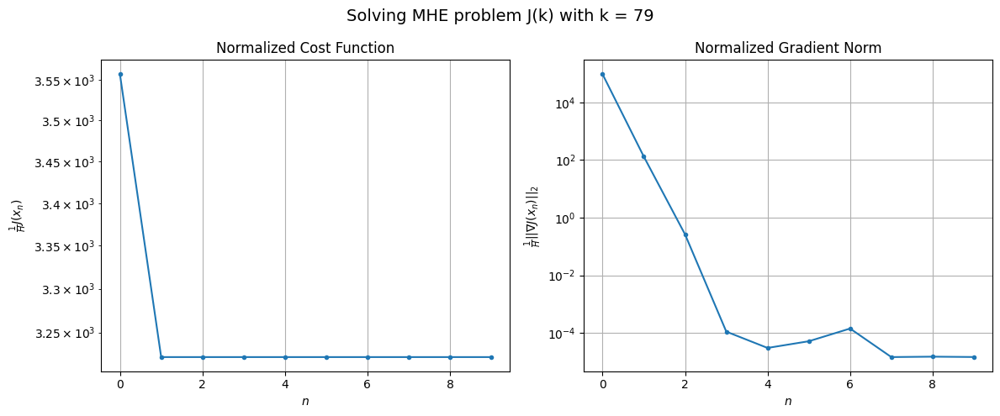

Windows:  16%|█▌        | 61/376 [05:21<27:08,  5.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 72158.49581346895
Gradient norm: 1751442.0870205797
Global estimation error: 26.523979373206664
Initial conditions estimation errors: 9.85911743368324 m, 6.8848973912846185 m, 17.27785304122647 m, 16.136257036836405 m
Position estimation errors: 18.053896361261312 m, 26.533112297370124 m, 39.65867844152722 m, 94.42161627760794 m

[Gauss-Newton] Iteration 1
Cost function: 65406.3376488243 (-9.36%)
Gradient norm: 8303.860872807474 (-99.53%)
Global estimation error: 80.64802549515231 (204.06%)
Initial conditions estimation errors: 13.919944119274549 m, 9.161261936035809 m, 17.774891157318297 m, 76.8794381316342 m
Position estimation errors: 13.905832941276 m, 6.868065775781159 m, 22.89838278461348 m, 7.48572663635479 m

[Gauss-Newton] Iteration 2
Cost function: 65404.981315659934 (-0.00%)
Gradient norm: 0.13984413934963522 (-100.00%)
Global estimation error: 80.56211905059484 (-0.11%)
Initial conditions estimation errors: 13.9199

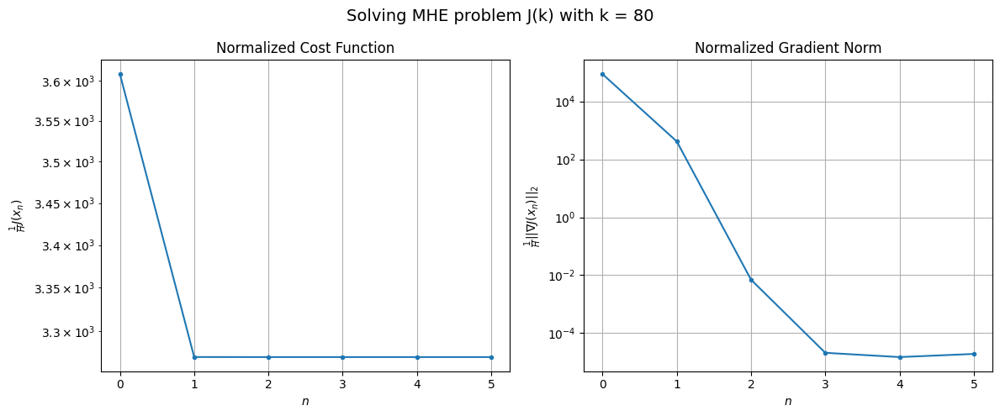

Windows:  16%|█▋        | 62/376 [05:24<24:53,  4.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 71694.22551955818
Gradient norm: 1635358.3687476614
Global estimation error: 80.62784386985554
Initial conditions estimation errors: 10.21452632799747 m, 6.5187418808023745 m, 15.805818311798571 m, 78.12925583666856 m
Position estimation errors: 17.809100520067744 m, 9.65175343752588 m, 27.923689751432583 m, 12.007833160327824 m

[Gauss-Newton] Iteration 1
Cost function: 64915.39800731342 (-9.46%)
Gradient norm: 649.6223929040366 (-99.96%)
Global estimation error: 76.85170013139364 (-4.68%)
Initial conditions estimation errors: 14.299425954360343 m, 9.315390230354629 m, 19.702221561725 m, 72.29618761818195 m
Position estimation errors: 13.724997462291187 m, 10.001680224913274 m, 25.455092626765097 m, 35.40445160232051 m

[Gauss-Newton] Iteration 2
Cost function: 64915.39007351066 (-0.00%)
Gradient norm: 0.09507380191062095 (-99.99%)
Global estimation error: 76.76623373888451 (-0.11%)
Initial conditions estimation errors: 14.29

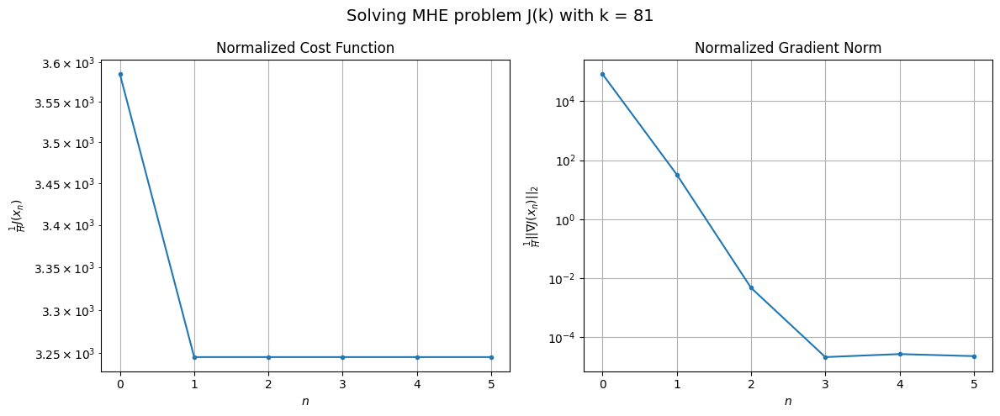

Windows:  17%|█▋        | 63/376 [05:28<22:57,  4.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 69738.91694723524
Gradient norm: 1594538.2312703608
Global estimation error: 74.20213219583883
Initial conditions estimation errors: 10.437622977111129 m, 7.676842032932298 m, 15.783151596996072 m, 71.33690809184898 m
Position estimation errors: 17.593655034602225 m, 14.517770018574607 m, 30.163705424781607 m, 45.695387644209056 m

[Gauss-Newton] Iteration 1
Cost function: 63085.400863004645 (-9.54%)
Gradient norm: 333.2227848945607 (-99.98%)
Global estimation error: 45.25962982195863 (-39.00%)
Initial conditions estimation errors: 14.473811195371919 m, 10.516041967776657 m, 25.521386632043523 m, 32.8175717445567 m
Position estimation errors: 13.59236787269396 m, 14.200448730472324 m, 19.743239142424358 m, 42.170433238261445 m

[Gauss-Newton] Iteration 2
Cost function: 63085.39328721177 (-0.00%)
Gradient norm: 0.21953972322049742 (-99.93%)
Global estimation error: 44.953244017644586 (-0.68%)
Initial conditions estimation error

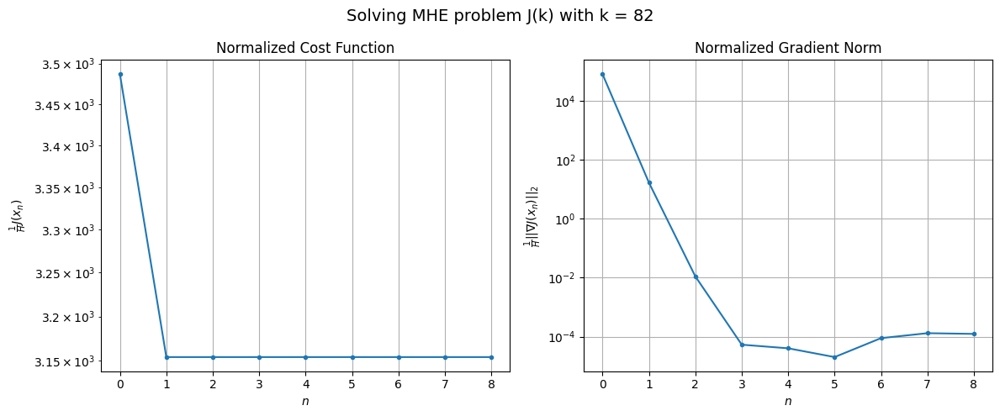

Windows:  17%|█▋        | 64/376 [05:33<24:15,  4.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 67929.16432108018
Gradient norm: 1679705.612354804
Global estimation error: 40.14395585872571
Initial conditions estimation errors: 10.487825094644164 m, 7.4895941441415035 m, 20.39088515454996 m, 32.088015510677295 m
Position estimation errors: 17.481230654292798 m, 18.985689145231596 m, 23.209318014208666 m, 49.149981477472956 m

[Gauss-Newton] Iteration 1
Cost function: 61293.65593857028 (-9.77%)
Gradient norm: 300.8416887072525 (-99.98%)
Global estimation error: 34.78787989135215 (-13.34%)
Initial conditions estimation errors: 14.449391191753493 m, 14.403558281472186 m, 24.773634284286338 m, 13.423485627107846 m
Position estimation errors: 13.46056741743316 m, 12.590832884082488 m, 13.15449914049446 m, 20.96817478786151 m

[Gauss-Newton] Iteration 2
Cost function: 61293.64947403221 (-0.00%)
Gradient norm: 0.1076941124742985 (-99.96%)
Global estimation error: 35.03551328899106 (0.71%)
Initial conditions estimation errors: 1

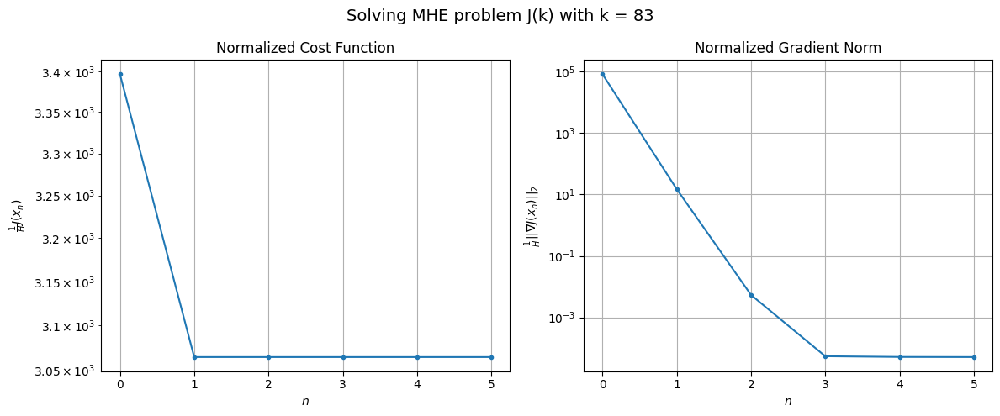

Windows:  17%|█▋        | 65/376 [05:37<22:48,  4.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 65717.86882371825
Gradient norm: 1804158.4537178746
Global estimation error: 26.447922872852295
Initial conditions estimation errors: 10.3906461532659 m, 10.223840058754691 m, 19.754729805484658 m, 9.83499215643679 m
Position estimation errors: 17.404829586827137 m, 17.065952063735626 m, 16.37503123696035 m, 25.448656114331108 m

[Gauss-Newton] Iteration 1
Cost function: 59119.96658006551 (-10.04%)
Gradient norm: 30.706117024445245 (-100.00%)
Global estimation error: 37.192861221335114 (40.63%)
Initial conditions estimation errors: 14.287069638338604 m, 13.606469067022996 m, 27.363709225005653 m, 15.660561830403728 m
Position estimation errors: 13.361430907016898 m, 14.183198004797335 m, 13.299298752258675 m, 26.582652909790834 m

[Gauss-Newton] Iteration 2
Cost function: 59119.9665553886 (-0.00%)
Gradient norm: 0.001429826977339333 (-100.00%)
Global estimation error: 37.20009227603567 (0.02%)
Initial conditions estimation err

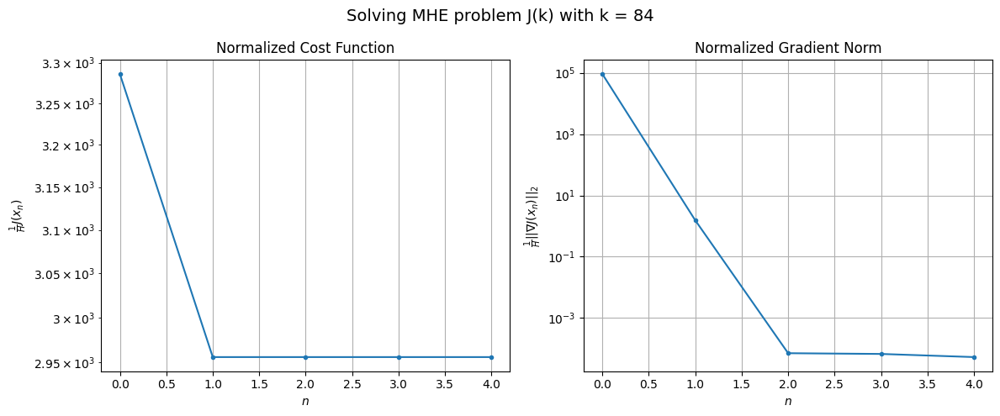

Windows:  18%|█▊        | 66/376 [05:40<21:04,  4.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 64145.911426474224
Gradient norm: 1967131.0937432302
Global estimation error: 28.789334302425797
Initial conditions estimation errors: 10.219345214455435 m, 9.374653100967867 m, 22.178622623153867 m, 12.024635735440663 m
Position estimation errors: 17.38567690648433 m, 18.812788884883823 m, 16.159451534821 m, 31.530980103926527 m

[Gauss-Newton] Iteration 1
Cost function: 57663.46429859672 (-10.11%)
Gradient norm: 958.8753998778616 (-99.95%)
Global estimation error: 34.584621811397966 (20.13%)
Initial conditions estimation errors: 13.996930124653016 m, 16.98999925746509 m, 16.07219560298619 m, 21.287890985798768 m
Position estimation errors: 13.277421043698364 m, 8.803798318755046 m, 11.823858233290418 m, 14.823687126225757 m

[Gauss-Newton] Iteration 2
Cost function: 57663.44536290335 (-0.00%)
Gradient norm: 0.19387236680074355 (-99.98%)
Global estimation error: 34.61543281819154 (0.09%)
Initial conditions estimation errors: 

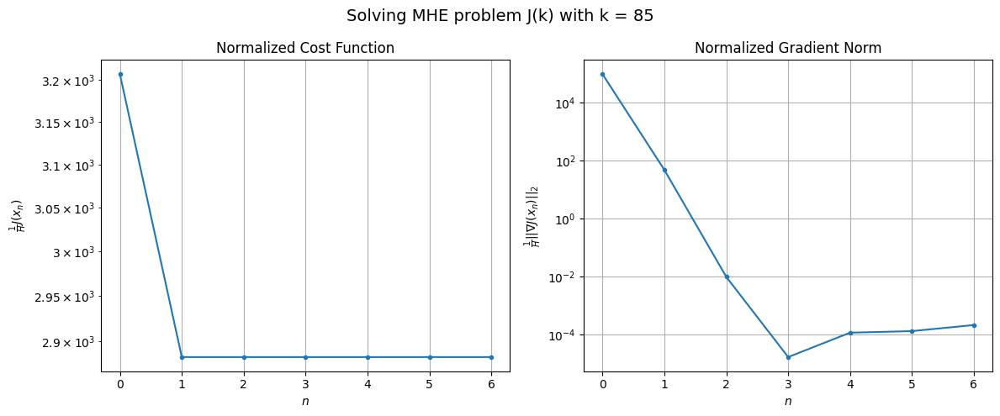

Windows:  18%|█▊        | 67/376 [05:44<20:58,  4.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 62853.73295307276
Gradient norm: 2115989.7245024713
Global estimation error: 24.862853575598866
Initial conditions estimation errors: 9.999848455163304 m, 12.22711999853368 m, 11.637730663651347 m, 15.270804415525854 m
Position estimation errors: 17.378208228151234 m, 12.694415992827414 m, 16.150230708845484 m, 13.772014617421117 m

[Gauss-Newton] Iteration 1
Cost function: 56397.205834250475 (-10.27%)
Gradient norm: 871.5313890997015 (-99.96%)
Global estimation error: 53.7614258805543 (116.23%)
Initial conditions estimation errors: 13.727133006130785 m, 20.57623835564049 m, 19.428754674694968 m, 43.600124444767985 m
Position estimation errors: 13.199590030273603 m, 13.824359901693125 m, 10.219241556031218 m, 11.486875619999493 m

[Gauss-Newton] Iteration 2
Cost function: 56397.18896920068 (-0.00%)
Gradient norm: 0.012363109574397894 (-100.00%)
Global estimation error: 53.646776730426176 (-0.21%)
Initial conditions estimation 

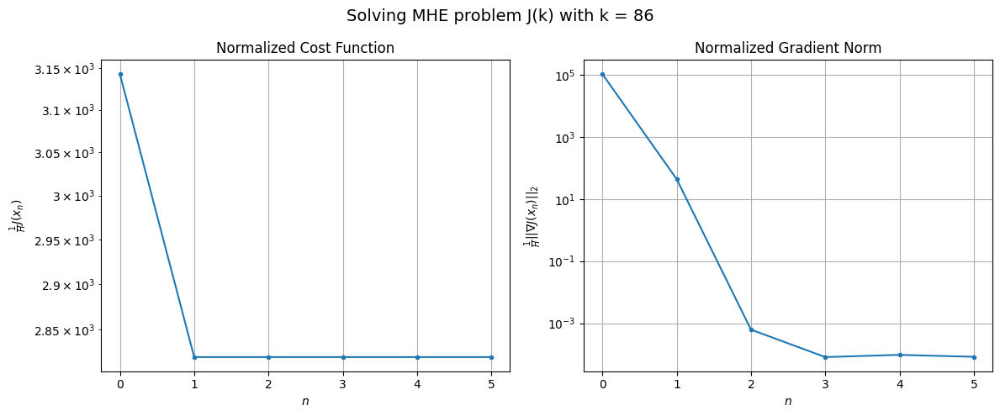

Windows:  18%|█▊        | 68/376 [05:48<19:59,  3.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 61628.65880587901
Gradient norm: 2200331.5632671635
Global estimation error: 45.69929251139423
Initial conditions estimation errors: 9.822777848877584 m, 16.308075436503696 m, 14.945526842942964 m, 38.76328771235701 m
Position estimation errors: 17.342415617987506 m, 17.782781845672066 m, 13.873288933427244 m, 13.74753191980015 m

[Gauss-Newton] Iteration 1
Cost function: 55293.819072734186 (-10.28%)
Gradient norm: 2025.9613391687988 (-99.91%)
Global estimation error: 100.7147591442602 (120.39%)
Initial conditions estimation errors: 13.501912652643286 m, 25.75579236228103 m, 30.563390008820118 m, 91.45301381220385 m
Position estimation errors: 13.135023305540452 m, 25.69526003203323 m, 13.22211309848106 m, 36.26684523776602 m

[Gauss-Newton] Iteration 2
Cost function: 55293.70919702932 (-0.00%)
Gradient norm: 0.08064810062159317 (-100.00%)
Global estimation error: 100.15699093037291 (-0.55%)
Initial conditions estimation error

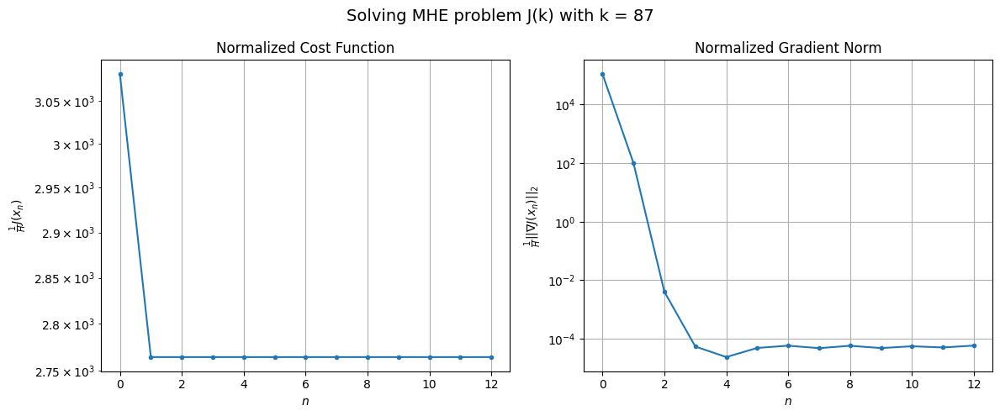

Windows:  18%|█▊        | 69/376 [05:55<25:20,  4.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 60798.041677028355
Gradient norm: 2285471.834070799
Global estimation error: 93.84528336842732
Initial conditions estimation errors: 9.664738701416606 m, 22.14487765327711 m, 24.978239679045693 m, 87.17338840447879 m
Position estimation errors: 17.261645010985706 m, 29.28968475948633 m, 13.792028273498122 m, 35.581598091733944 m

[Gauss-Newton] Iteration 1
Cost function: 54383.376338254784 (-10.55%)
Gradient norm: 904.3855365956448 (-99.96%)
Global estimation error: 135.58701139954275 (44.48%)
Initial conditions estimation errors: 13.39552215081112 m, 31.93057941148726 m, 32.47348502930236 m, 127.0050543942933 m
Position estimation errors: 12.981843441118759 m, 32.507747022672675 m, 17.347993477482728 m, 46.50140301842151 m

[Gauss-Newton] Iteration 2
Cost function: 54383.347567100755 (-0.00%)
Gradient norm: 0.01798545317883348 (-100.00%)
Global estimation error: 135.43282142287768 (-0.11%)
Initial conditions estimation errors

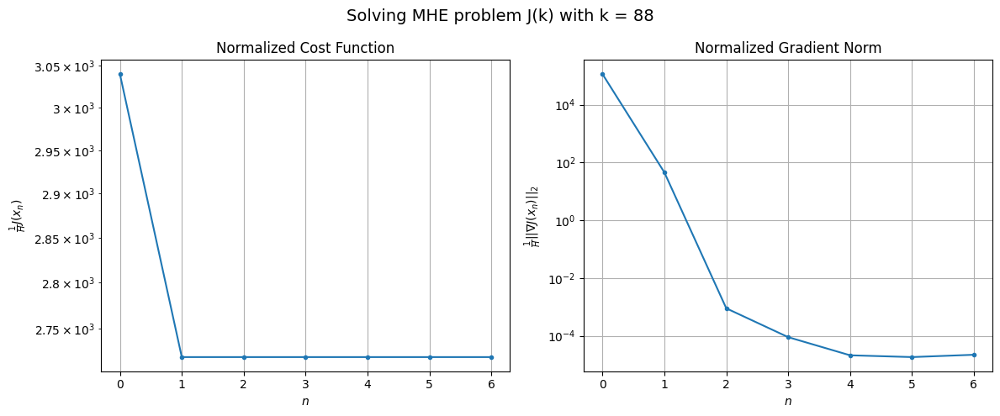

Windows:  19%|█▊        | 70/376 [06:00<24:03,  4.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 60062.12953842902
Gradient norm: 2330518.6872960865
Global estimation error: 129.68181125490383
Initial conditions estimation errors: 9.56732452636472 m, 28.912100642763317 m, 26.703714900479337 m, 123.19422980021712 m
Position estimation errors: 17.038553066842454 m, 35.3744646188306 m, 16.972693687664627 m, 42.933392783149586 m

[Gauss-Newton] Iteration 1
Cost function: 53682.376967980585 (-10.62%)
Gradient norm: 1528.781210213757 (-99.93%)
Global estimation error: 97.50284633238442 (-24.81%)
Initial conditions estimation errors: 13.316457909143264 m, 27.811455933995685 m, 22.853874113377636 m, 89.63075819986709 m
Position estimation errors: 12.735774092627732 m, 21.777928854772036 m, 13.289327397625478 m, 12.564201130076789 m

[Gauss-Newton] Iteration 2
Cost function: 53682.3220489213 (-0.00%)
Gradient norm: 0.028834186243617783 (-100.00%)
Global estimation error: 97.22838376115982 (-0.28%)
Initial conditions estimation err

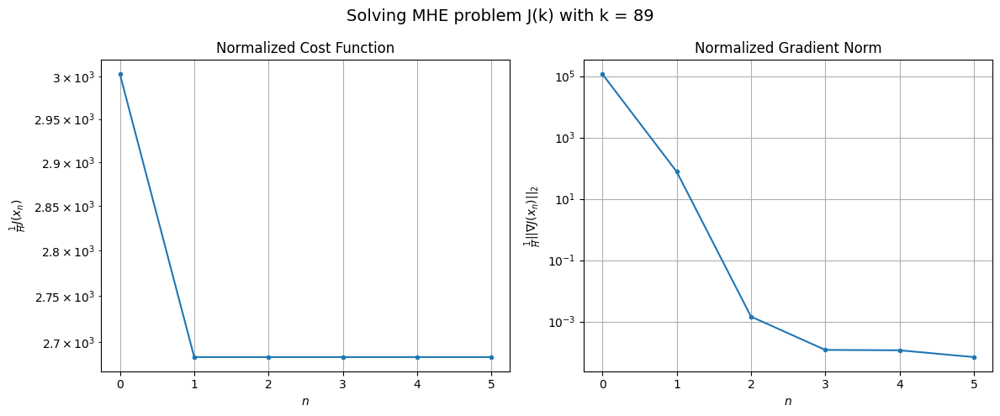

Windows:  19%|█▉        | 71/376 [06:03<22:10,  4.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 58537.84612019985
Gradient norm: 2269440.4757281
Global estimation error: 89.95284782145393
Initial conditions estimation errors: 9.4434826520133 m, 24.072876958810724 m, 17.68485824072271 m, 84.32112758623546 m
Position estimation errors: 16.68467409090636 m, 25.041052388580567 m, 14.751016087499403 m, 11.510690718732784 m

[Gauss-Newton] Iteration 1
Cost function: 52279.71588062319 (-10.69%)
Gradient norm: 264.8903073256012 (-99.99%)
Global estimation error: 61.763034920556144 (-31.34%)
Initial conditions estimation errors: 13.24563605226457 m, 22.016704490451087 m, 16.472971235763946 m, 53.694576538653635 m
Position estimation errors: 12.449501543717588 m, 16.908973087938516 m, 9.023434154821935 m, 15.232569588117455 m

[Gauss-Newton] Iteration 2
Cost function: 52279.70883577025 (-0.00%)
Gradient norm: 0.43457431953749975 (-99.84%)
Global estimation error: 62.72610349853759 (1.56%)
Initial conditions estimation errors: 13.2

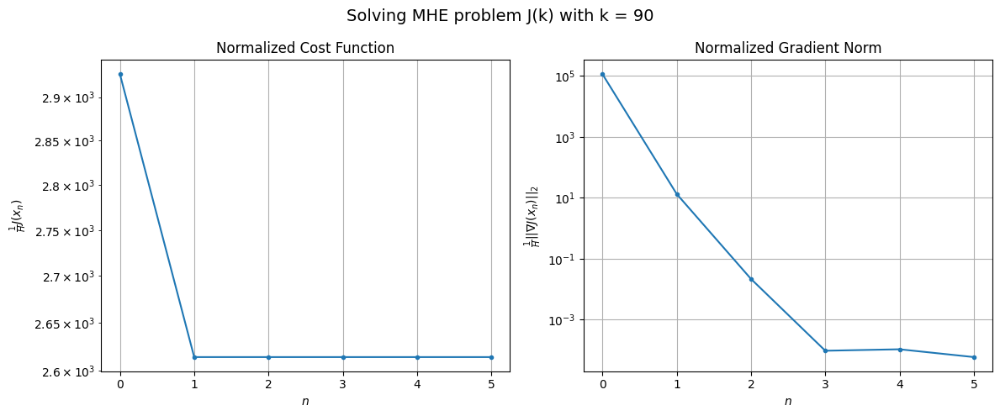

Windows:  19%|█▉        | 72/376 [06:07<21:08,  4.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 57160.57039354228
Gradient norm: 2190500.8941617473
Global estimation error: 56.00177630594332
Initial conditions estimation errors: 9.30730937891464 m, 18.415400353175407 m, 11.875312843655234 m, 50.68926195932962 m
Position estimation errors: 16.28037523594842 m, 20.34784661568925 m, 11.789371647855871 m, 16.172886128656277 m

[Gauss-Newton] Iteration 1
Cost function: 51091.202514342636 (-10.62%)
Gradient norm: 2885.4349494581797 (-99.87%)
Global estimation error: 104.65019828913344 (86.87%)
Initial conditions estimation errors: 13.097769575286767 m, 32.22627550932628 m, 20.217047573126806 m, 96.606562381994 m
Position estimation errors: 12.134962942053606 m, 27.13146856807107 m, 15.264032812297557 m, 48.5174114453846 m

[Gauss-Newton] Iteration 2
Cost function: 51091.02207833015 (-0.00%)
Gradient norm: 0.044903823642087726 (-100.00%)
Global estimation error: 104.85250836605759 (0.19%)
Initial conditions estimation errors: 1

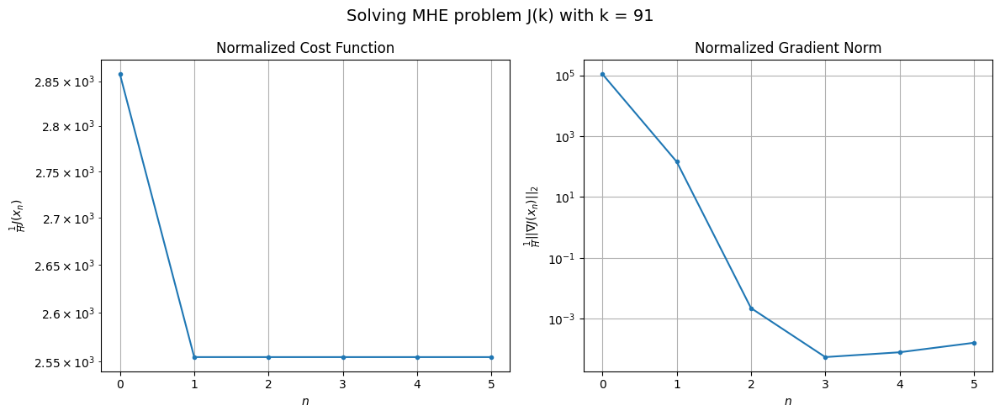

Windows:  19%|█▉        | 73/376 [06:10<20:20,  4.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 55193.740973990876
Gradient norm: 2047595.2350540194
Global estimation error: 100.37570469630553
Initial conditions estimation errors: 9.101104110766652 m, 29.24588351251843 m, 15.102718226526793 m, 94.38759346397882 m
Position estimation errors: 15.853385709095035 m, 29.43988287909289 m, 14.397271000457415 m, 46.92441690806399 m

[Gauss-Newton] Iteration 1
Cost function: 49315.85930163204 (-10.65%)
Gradient norm: 1918.3340298302385 (-99.91%)
Global estimation error: 68.11849654172597 (-32.14%)
Initial conditions estimation errors: 12.912365365096505 m, 25.211968870568054 m, 13.887257285058686 m, 60.37280505309176 m
Position estimation errors: 11.857544647016825 m, 15.455891111118682 m, 10.595340907223253 m, 14.915448503458048 m

[Gauss-Newton] Iteration 2
Cost function: 49315.77751232787 (-0.00%)
Gradient norm: 0.41450876854064606 (-99.98%)
Global estimation error: 69.21545130496946 (1.61%)
Initial conditions estimation error

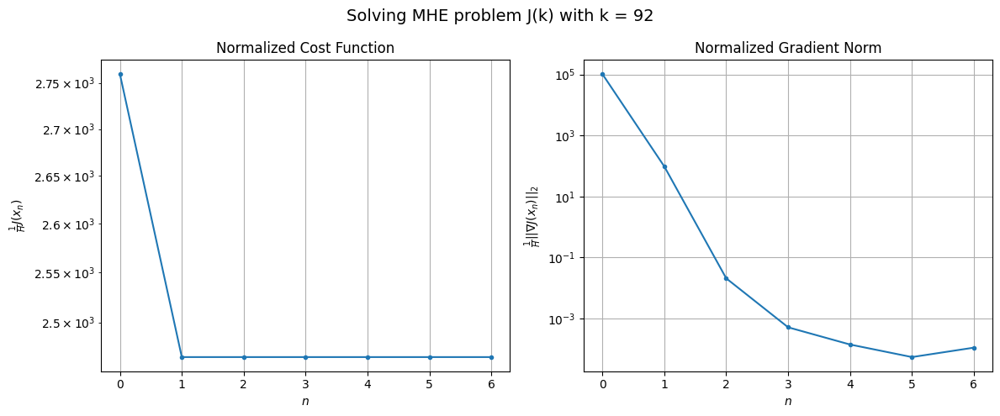

Windows:  20%|█▉        | 74/376 [06:15<20:41,  4.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 52861.614581592235
Gradient norm: 1866893.0270389146
Global estimation error: 63.01042210810981
Initial conditions estimation errors: 8.897012240155567 m, 21.705194176395306 m, 9.786471884533603 m, 57.65625401933939 m
Position estimation errors: 15.490249139348991 m, 18.305669892066533 m, 13.150198760726493 m, 14.498953854970823 m

[Gauss-Newton] Iteration 1
Cost function: 47223.72929308731 (-10.67%)
Gradient norm: 7237.779227172653 (-99.61%)
Global estimation error: 48.503536458221284 (-23.02%)
Initial conditions estimation errors: 12.680128434605432 m, 12.805751437305119 m, 19.617108319024535 m, 40.53350278848808 m
Position estimation errors: 11.664840334659454 m, 11.785927412306181 m, 29.126355353486915 m, 15.760880353271682 m

[Gauss-Newton] Iteration 2
Cost function: 47221.81124924416 (-0.00%)
Gradient norm: 2.005175793264877 (-99.97%)
Global estimation error: 50.5839535984747 (4.29%)
Initial conditions estimation errors:

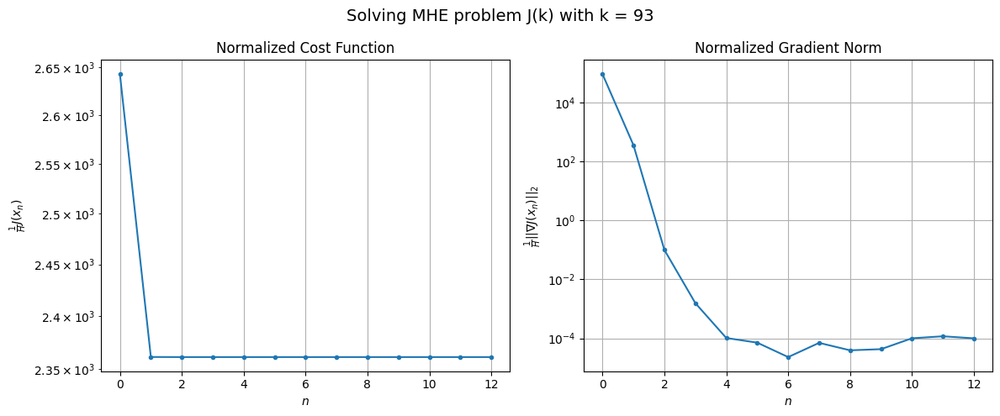

Windows:  20%|█▉        | 75/376 [06:22<25:39,  5.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 50698.95550757597
Gradient norm: 1680171.817283392
Global estimation error: 51.36059070011601
Initial conditions estimation errors: 8.713750795957298 m, 14.178869370073896 m, 18.150763202731127 m, 45.07184133889774 m
Position estimation errors: 15.247361940212924 m, 11.405703418833841 m, 32.84501044198417 m, 12.708983327530595 m

[Gauss-Newton] Iteration 1
Cost function: 45265.95140524483 (-10.72%)
Gradient norm: 2175.138044493904 (-99.87%)
Global estimation error: 27.35972678932052 (-46.73%)
Initial conditions estimation errors: 12.433167843982217 m, 12.596269812303934 m, 12.50029193594818 m, 16.703995737168405 m
Position estimation errors: 11.560934705244028 m, 9.304480259125512 m, 13.591504016019435 m, 5.413971898495274 m

[Gauss-Newton] Iteration 2
Cost function: 45265.77323376115 (-0.00%)
Gradient norm: 2.236206863345546 (-99.90%)
Global estimation error: 28.703432587008464 (4.91%)
Initial conditions estimation errors: 12

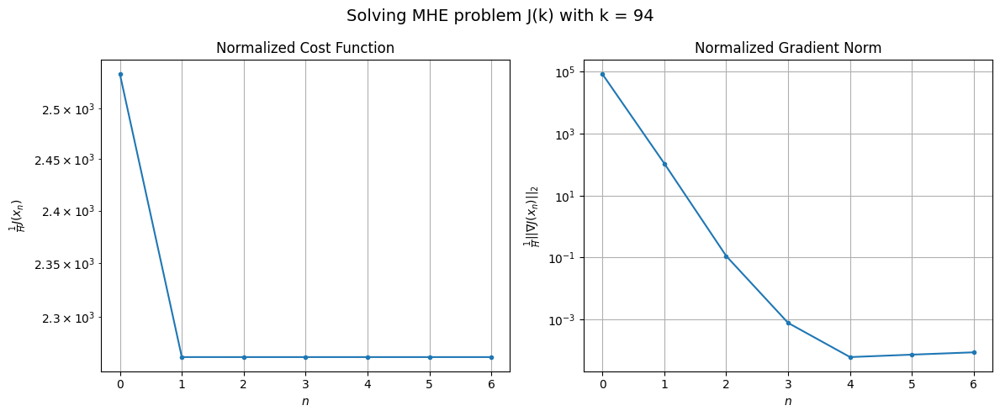

Windows:  20%|██        | 76/376 [06:26<24:11,  4.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 48638.39391110311
Gradient norm: 1489485.7746074884
Global estimation error: 20.699813945294867
Initial conditions estimation errors: 8.586764015678472 m, 8.966270249319795 m, 8.377275796546416 m, 14.288361884651852 m
Position estimation errors: 15.107573575414175 m, 12.802450215959075 m, 16.76753028248347 m, 6.7846245954519535 m

[Gauss-Newton] Iteration 1
Cost function: 43546.81034687045 (-10.47%)
Gradient norm: 7746.868153247038 (-99.48%)
Global estimation error: 90.89777233714445 (339.12%)
Initial conditions estimation errors: 12.177512001907637 m, 26.078331069962132 m, 31.131661732864014 m, 80.4041665764195 m
Position estimation errors: 11.6012855454119 m, 21.044305699741635 m, 40.93081905903983 m, 32.94720947282935 m

[Gauss-Newton] Iteration 2
Cost function: 43544.732459021194 (-0.00%)
Gradient norm: 1.963958135555196 (-99.97%)
Global estimation error: 92.21899363475654 (1.45%)
Initial conditions estimation errors: 12.1

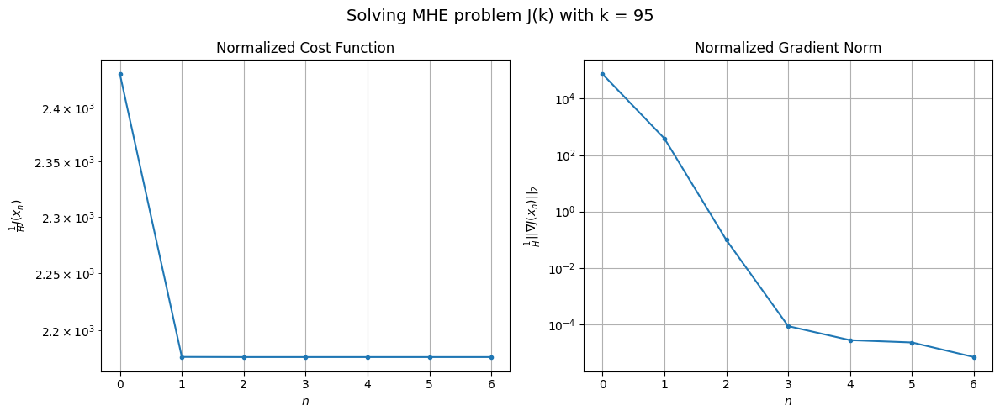

Windows:  20%|██        | 77/376 [06:31<23:03,  4.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 47498.493392059885
Gradient norm: 1399576.5137562682
Global estimation error: 94.53879433035915
Initial conditions estimation errors: 8.49655491261653 m, 29.016600456654608 m, 29.91629961932415 m, 84.43000673000515 m
Position estimation errors: 15.113533771256717 m, 18.439178883108443 m, 44.08407042033871 m, 26.99925394816111 m

[Gauss-Newton] Iteration 1
Cost function: 42661.26164906287 (-10.18%)
Gradient norm: 7831.80675571541 (-99.44%)
Global estimation error: 209.19415839723698 (121.28%)
Initial conditions estimation errors: 11.941346417447134 m, 69.54053902664069 m, 63.92330538670173 m, 186.27266059427876 m
Position estimation errors: 11.703221541828693 m, 33.08154537597745 m, 77.13739910494851 m, 41.271435169795474 m

[Gauss-Newton] Iteration 2
Cost function: 42658.426494678366 (-0.01%)
Gradient norm: 6.240936639083331 (-99.92%)
Global estimation error: 205.88366824025962 (-1.58%)
Initial conditions estimation errors: 11

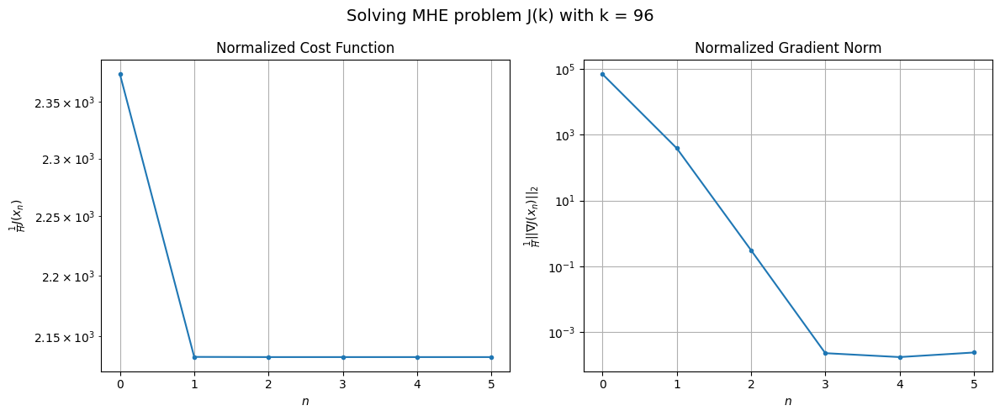

Windows:  21%|██        | 78/376 [06:34<21:35,  4.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 47095.00942227394
Gradient norm: 1396089.6409359078
Global estimation error: 207.12860343952832
Initial conditions estimation errors: 8.438998957374697 m, 71.51082549269081 m, 62.459349836221776 m, 183.8914275219552 m
Position estimation errors: 15.203649928268968 m, 26.10885441608427 m, 78.05307989996484 m, 32.28835932998761 m

[Gauss-Newton] Iteration 1
Cost function: 42385.320848275864 (-10.00%)
Gradient norm: 6006.01942930069 (-99.57%)
Global estimation error: 260.45920656108086 (25.75%)
Initial conditions estimation errors: 11.770952985142221 m, 89.4406575726697 m, 82.41422589921655 m, 230.018873369893 m
Position estimation errors: 11.826317642407929 m, 52.10154474991264 m, 101.80282334303514 m, 69.11690265070341 m

[Gauss-Newton] Iteration 2
Cost function: 42384.56883248943 (-0.00%)
Gradient norm: 28.893347522391487 (-99.52%)
Global estimation error: 253.71416858068184 (-2.59%)
Initial conditions estimation errors: 11.77

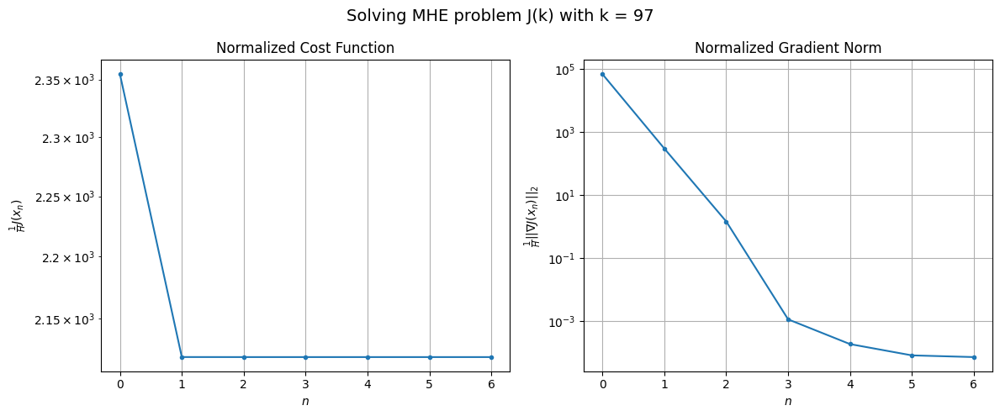

Windows:  21%|██        | 79/376 [06:39<21:37,  4.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 47060.238625664446
Gradient norm: 1464899.145114796
Global estimation error: 256.4297297048116
Initial conditions estimation errors: 8.415607477824645 m, 91.15252628065724 m, 80.92441356452598 m, 225.45026206336632 m
Position estimation errors: 15.38405243041002 m, 42.429280309116606 m, 101.09985301907706 m, 53.79534577835401 m

[Gauss-Newton] Iteration 1
Cost function: 42381.49718905882 (-9.94%)
Gradient norm: 7939.778062394428 (-99.46%)
Global estimation error: 346.91237959525256 (35.29%)
Initial conditions estimation errors: 11.67559525808056 m, 122.92875663548462 m, 109.69437984296549 m, 305.06968746235145 m
Position estimation errors: 11.993807395025378 m, 67.48069553749254 m, 138.45462949056292 m, 76.55678681362504 m

[Gauss-Newton] Iteration 2
Cost function: 42379.57546718637 (-0.00%)
Gradient norm: 14.693570023113487 (-99.81%)
Global estimation error: 342.77097106966886 (-1.19%)
Initial conditions estimation errors: 11

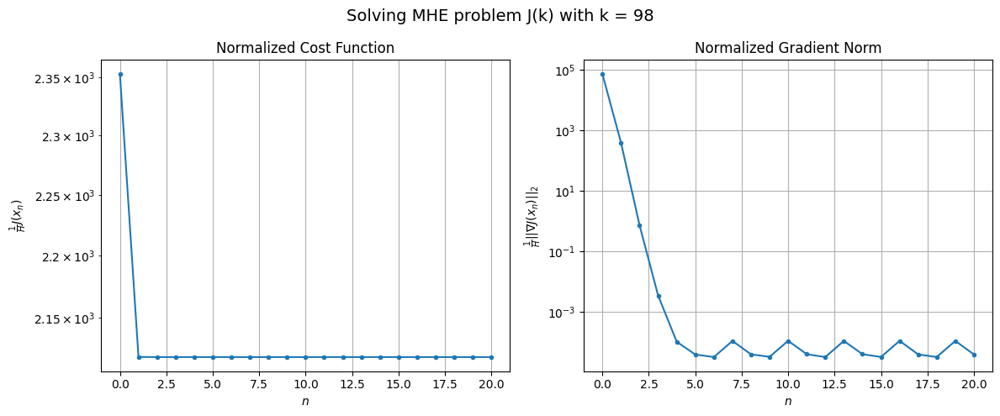

Windows:  21%|██▏       | 80/376 [06:50<32:18,  6.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 47812.20184670286
Gradient norm: 1588684.3533018434
Global estimation error: 345.2152278372136
Initial conditions estimation errors: 8.411779450557095 m, 125.95881391212984 m, 110.1378999576506 m, 301.8390156586728 m
Position estimation errors: 15.716880778147926 m, 55.747510460632554 m, 137.97421845790922 m, 58.71977469900682 m

[Gauss-Newton] Iteration 1
Cost function: 43027.97163280673 (-10.01%)
Gradient norm: 28474.25525238662 (-98.21%)
Global estimation error: 165.2190141581119 (-52.14%)
Initial conditions estimation errors: 11.650940843575922 m, 57.44572394673563 m, 58.376152818389514 m, 143.01670786670482 m
Position estimation errors: 12.225460881503157 m, 16.197000593220412 m, 68.29191892673126 m, 20.87459676791028 m

[Gauss-Newton] Iteration 2
Cost function: 43001.08576540393 (-0.06%)
Gradient norm: 303.33880323750844 (-98.93%)
Global estimation error: 182.54699841694008 (10.49%)
Initial conditions estimation errors: 

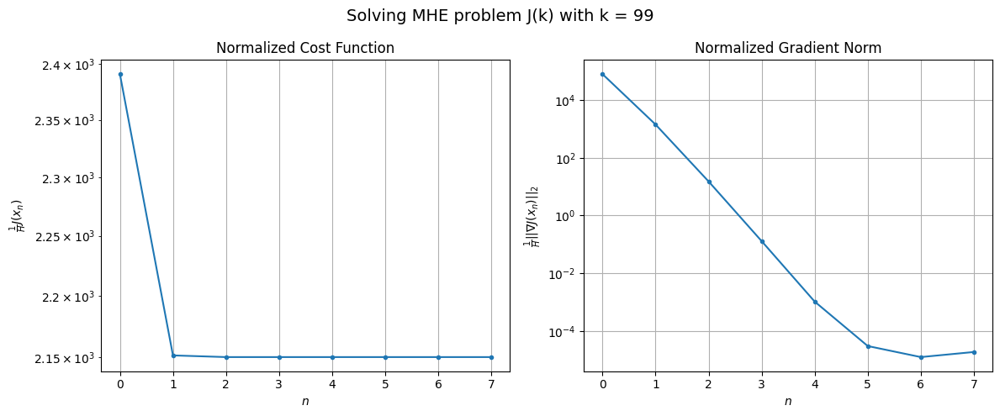

Windows:  22%|██▏       | 81/376 [06:55<29:33,  6.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 49013.34738962371
Gradient norm: 1737826.4325795334
Global estimation error: 181.08964194957537
Initial conditions estimation errors: 8.427908343009603 m, 65.87284134354432 m, 62.630607606312786 m, 156.3988262948241 m
Position estimation errors: 16.208094158084794 m, 13.725986343366804 m, 76.42878217213486 m, 26.491145706027083 m

[Gauss-Newton] Iteration 1
Cost function: 44153.37592513944 (-9.92%)
Gradient norm: 60596.58037324098 (-96.51%)
Global estimation error: 83.09957004400962 (-54.11%)
Initial conditions estimation errors: 11.670125224467254 m, 34.49963573732736 m, 22.721594287262956 m, 71.1536145628045 m
Position estimation errors: 12.585413289453065 m, 57.318050279078996 m, 18.970136128120025 m, 79.59561253092873 m

[Gauss-Newton] Iteration 2
Cost function: 44028.74412954707 (-0.28%)
Gradient norm: 211.05282684793275 (-99.65%)
Global estimation error: 70.89832536933841 (-14.68%)
Initial conditions estimation errors: 1

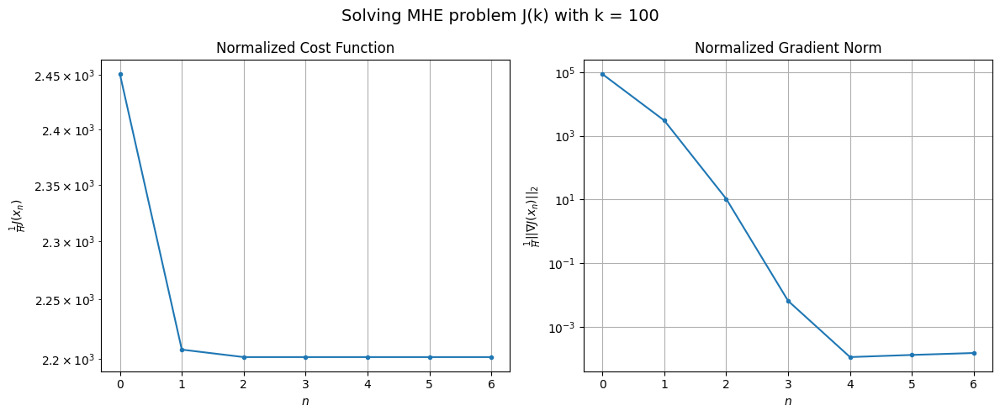

Windows:  22%|██▏       | 82/376 [06:59<26:49,  5.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 51497.393945405915
Gradient norm: 1892786.1740673254
Global estimation error: 71.15080232733058
Initial conditions estimation errors: 8.45848332730631 m, 29.524206158011985 m, 21.226412360606652 m, 60.569296665041904 m
Position estimation errors: 16.85959394885366 m, 56.5074674058146 m, 12.399628394001546 m, 76.08186913350286 m

[Gauss-Newton] Iteration 1
Cost function: 46241.44307157826 (-10.21%)
Gradient norm: 14774.834831193191 (-99.22%)
Global estimation error: 203.2732728510887 (185.69%)
Initial conditions estimation errors: 11.724382770256252 m, 86.38153327762726 m, 60.675280824031475 m, 173.3184336369998 m
Position estimation errors: 13.049036048210558 m, 72.6919125085636 m, 62.69582614094313 m, 105.79988611812517 m

[Gauss-Newton] Iteration 2
Cost function: 46233.73049611096 (-0.02%)
Gradient norm: 57.66073459804502 (-99.61%)
Global estimation error: 211.89258123612726 (4.24%)
Initial conditions estimation errors: 11.7

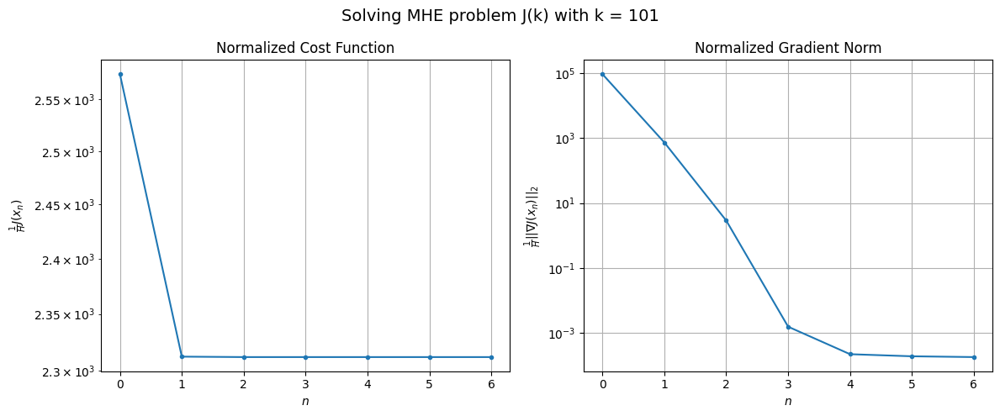

Windows:  22%|██▏       | 83/376 [07:04<25:14,  5.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 54957.41968488634
Gradient norm: 2039791.941645472
Global estimation error: 212.48931168410297
Initial conditions estimation errors: 8.50916714960295 m, 89.51252815649211 m, 69.57740296231734 m, 179.51538080820978 m
Position estimation errors: 17.567071946315362 m, 74.83965286298181 m, 58.97750167012762 m, 103.84952360272533 m

[Gauss-Newton] Iteration 1
Cost function: 49651.747259797325 (-9.65%)
Gradient norm: 84939.9940928516 (-95.84%)
Global estimation error: 71.95920274485421 (-66.14%)
Initial conditions estimation errors: 11.828169523185002 m, 20.54479654403835 m, 45.873741851995106 m, 50.11703678418301 m
Position estimation errors: 13.596337366582425 m, 16.906190405429342 m, 45.441914508631754 m, 10.100270995243282 m

[Gauss-Newton] Iteration 2
Cost function: 49424.222937964776 (-0.46%)
Gradient norm: 3.3133397486091365 (-100.00%)
Global estimation error: 68.7502066855701 (-4.46%)
Initial conditions estimation errors: 11

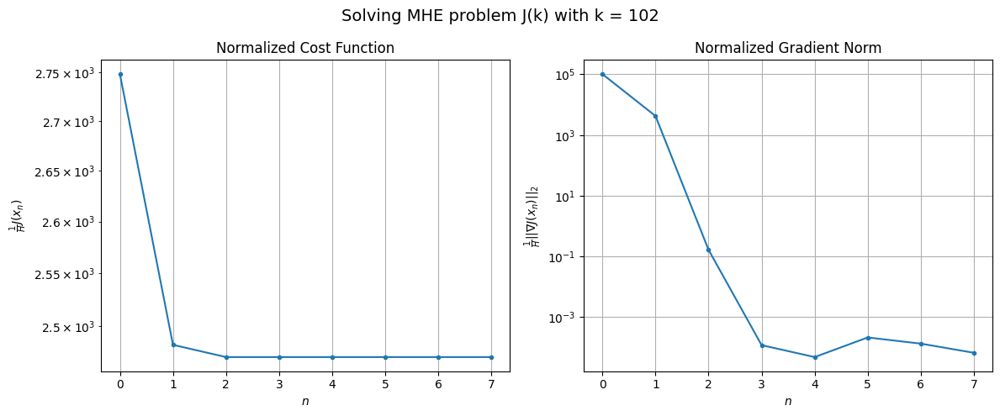

Windows:  22%|██▏       | 84/376 [07:09<24:42,  5.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 59113.585383807615
Gradient norm: 2166369.7834228473
Global estimation error: 69.6806138057454
Initial conditions estimation errors: 8.603494912006552 m, 22.561367257715357 m, 42.83153118534823 m, 49.37407773909914 m
Position estimation errors: 18.2776761267146 m, 16.086170616690328 m, 48.358067385424086 m, 10.903836977903346 m

[Gauss-Newton] Iteration 1
Cost function: 53121.41757236638 (-10.14%)
Gradient norm: 503.2643429894621 (-99.98%)
Global estimation error: 103.58453767070496 (48.66%)
Initial conditions estimation errors: 12.06239203094693 m, 34.50434564474849 m, 59.77561697974899 m, 76.2926449898406 m
Position estimation errors: 14.0975931754874 m, 16.255667019228508 m, 54.80059026530596 m, 12.810158020509746 m

[Gauss-Newton] Iteration 2
Cost function: 53121.39537649513 (-0.00%)
Gradient norm: 16.909925290306088 (-96.64%)
Global estimation error: 106.97029283942032 (3.27%)
Initial conditions estimation errors: 12.0623

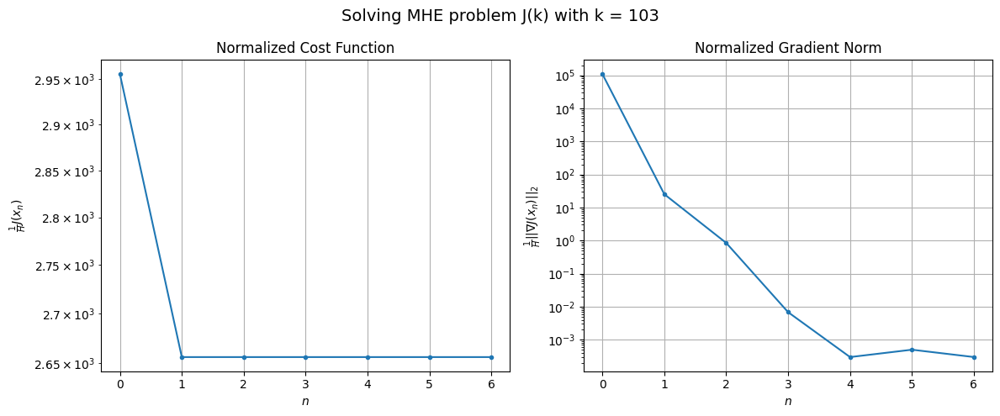

Windows:  23%|██▎       | 85/376 [07:14<25:09,  5.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 63298.28300247629
Gradient norm: 2221889.5773758697
Global estimation error: 107.66119048182746
Initial conditions estimation errors: 8.818781301623954 m, 38.8399698881128 m, 59.44650553986674 m, 80.44078157252848 m
Position estimation errors: 18.853855136048566 m, 16.435415814278116 m, 59.27935469311505 m, 19.276348707545043 m

[Gauss-Newton] Iteration 1
Cost function: 56989.46324879403 (-9.97%)
Gradient norm: 46388.02282304877 (-97.91%)
Global estimation error: 119.27884978883655 (10.79%)
Initial conditions estimation errors: 12.438678048142291 m, 59.06335173672859 m, 30.35805034557615 m, 98.29860779500085 m
Position estimation errors: 14.529400780351649 m, 47.15719483295286 m, 28.15339085787837 m, 73.51781750810444 m

[Gauss-Newton] Iteration 2
Cost function: 56913.61960820071 (-0.13%)
Gradient norm: 34.93939014384691 (-99.92%)
Global estimation error: 116.22874744866266 (-2.56%)
Initial conditions estimation errors: 12.438

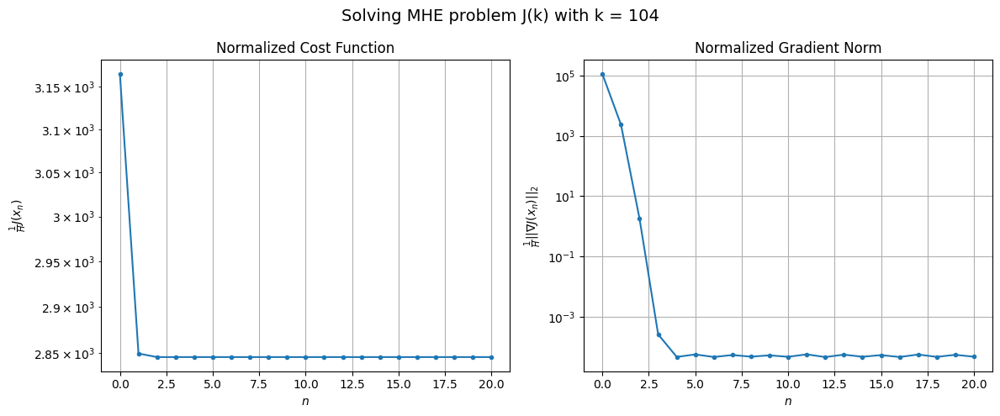

Windows:  23%|██▎       | 86/376 [07:26<35:21,  7.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 67790.24205907593
Gradient norm: 2252142.667704802
Global estimation error: 114.86373638336642
Initial conditions estimation errors: 9.146551687725264 m, 55.75028544893266 m, 32.781500705042404 m, 94.48429977094189 m
Position estimation errors: 19.337964951991726 m, 47.31795067057606 m, 20.94787507939127 m, 70.76407038157362 m

[Gauss-Newton] Iteration 1
Cost function: 60883.88037160055 (-10.19%)
Gradient norm: 32719.52075565013 (-98.55%)
Global estimation error: 259.7365383310038 (126.13%)
Initial conditions estimation errors: 12.985927896187619 m, 121.21132059427694 m, 95.29275803705657 m, 208.61808905632947 m
Position estimation errors: 14.837636537251184 m, 93.01160784994619 m, 84.57110729998038 m, 160.75716446357927 m

[Gauss-Newton] Iteration 2
Cost function: 60856.521689012356 (-0.04%)
Gradient norm: 24.563021860071803 (-99.92%)
Global estimation error: 257.18622103124636 (-0.98%)
Initial conditions estimation errors: 1

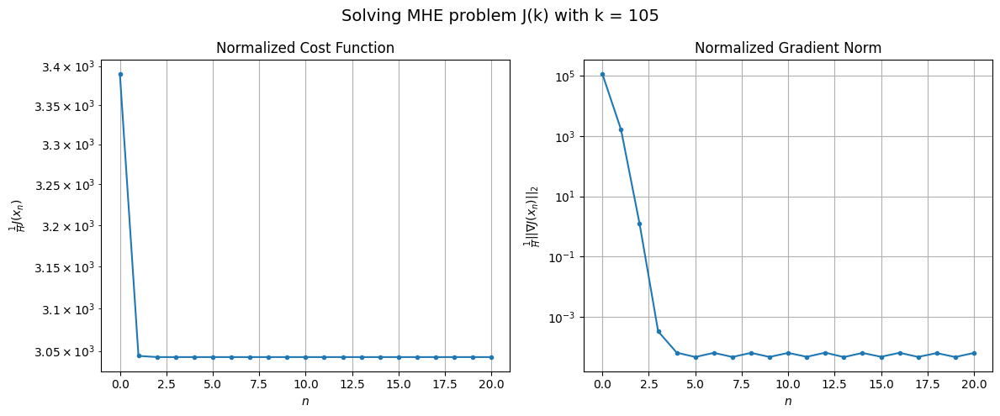

Windows:  23%|██▎       | 87/376 [07:38<41:38,  8.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 72145.49397304023
Gradient norm: 2276871.9180644965
Global estimation error: 260.0663699591936
Initial conditions estimation errors: 9.581550507186561 m, 119.8427952745001 m, 100.43161816550916 m, 207.59064479655243 m
Position estimation errors: 19.74119804531131 m, 90.22408910640306 m, 74.08825402442925 m, 153.73709427736117 m

[Gauss-Newton] Iteration 1
Cost function: 64678.54035474711 (-10.35%)
Gradient norm: 35534.935608943444 (-98.44%)
Global estimation error: 135.77933119173179 (-47.79%)
Initial conditions estimation errors: 13.628798036331808 m, 64.72314634404997 m, 24.58097622531828 m, 116.00409595942486 m
Position estimation errors: 15.062020224294681 m, 31.079621879121273 m, 11.85532144125851 m, 52.786936892505814 m

[Gauss-Newton] Iteration 2
Cost function: 64648.51462111583 (-0.05%)
Gradient norm: 1.0705923155806805 (-100.00%)
Global estimation error: 136.33610892962184 (0.41%)
Initial conditions estimation errors:

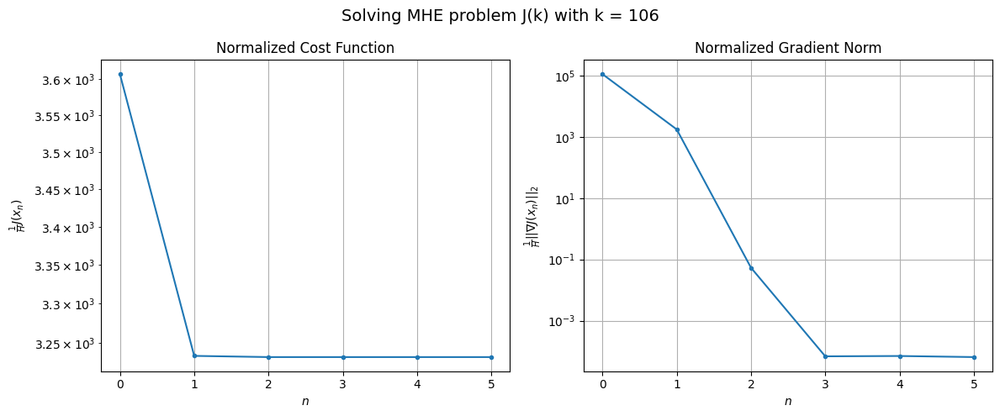

Windows:  23%|██▎       | 88/376 [07:42<34:29,  7.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 75761.87819278828
Gradient norm: 2237815.937560802
Global estimation error: 131.49443601128655
Initial conditions estimation errors: 10.044781415562435 m, 61.25953772703156 m, 27.271410377239057 m, 112.6650194780641 m
Position estimation errors: 20.1204171181953 m, 33.11352928910991 m, 6.172080816084194 m, 52.845169328231506 m

[Gauss-Newton] Iteration 1
Cost function: 67801.0301689533 (-10.51%)
Gradient norm: 48783.83033185544 (-97.82%)
Global estimation error: 65.63718720996933 (-50.08%)
Initial conditions estimation errors: 14.31514560693002 m, 11.147728976401563 m, 59.218804900128575 m, 21.728296803777855 m
Position estimation errors: 15.328068944409686 m, 37.2977816236488 m, 59.88333874481946 m, 101.75359231267026 m

[Gauss-Newton] Iteration 2
Cost function: 67749.75366843583 (-0.08%)
Gradient norm: 191.84443074537612 (-99.61%)
Global estimation error: 62.46981562033767 (-4.83%)
Initial conditions estimation errors: 14.31

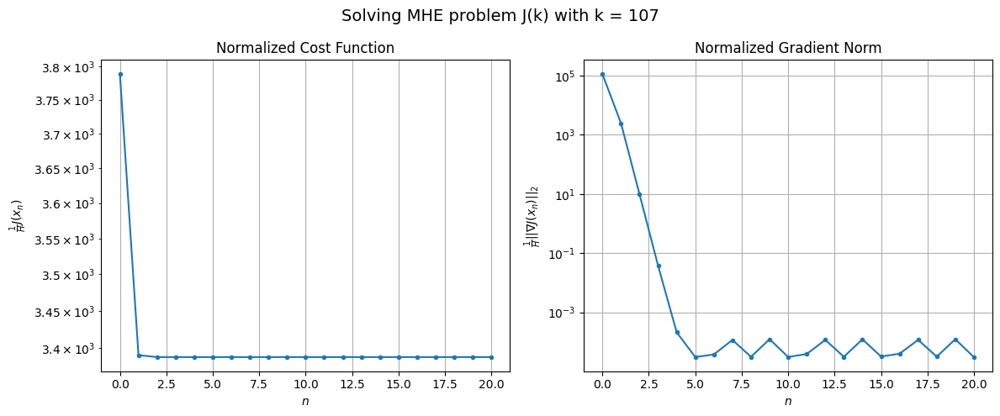

Windows:  24%|██▎       | 89/376 [07:53<40:42,  8.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 78573.90991827706
Gradient norm: 2224488.272715224
Global estimation error: 56.59074877525397
Initial conditions estimation errors: 10.489893692152188 m, 11.431807129784 m, 51.83713261404409 m, 16.57247716450055 m
Position estimation errors: 20.559506677664388 m, 29.68954634388153 m, 59.08250818843798 m, 92.38583206718768 m

[Gauss-Newton] Iteration 1
Cost function: 69869.63037832346 (-11.08%)
Gradient norm: 29460.827815612873 (-98.68%)
Global estimation error: 130.00769029417322 (129.73%)
Initial conditions estimation errors: 15.011542764295786 m, 48.78258326845357 m, 110.68244475151698 m, 45.23456344264395 m
Position estimation errors: 15.600730827097808 m, 79.58314247494889 m, 102.91483596170535 m, 227.3965970635751 m

[Gauss-Newton] Iteration 2
Cost function: 69854.5167864757 (-0.02%)
Gradient norm: 264.04140163175265 (-99.10%)
Global estimation error: 122.1774698544135 (-6.02%)
Initial conditions estimation errors: 15.011

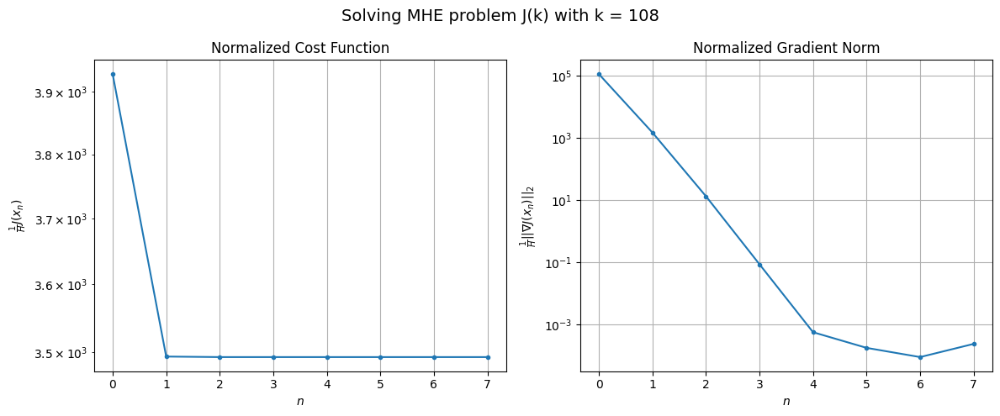

Windows:  24%|██▍       | 90/376 [07:58<34:41,  7.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 79995.22499816565
Gradient norm: 2168583.949918412
Global estimation error: 127.8872201750138
Initial conditions estimation errors: 10.919668226072835 m, 53.05804233684693 m, 103.97939578479732 m, 51.077424390270934 m
Position estimation errors: 20.929392587619088 m, 67.85209434251567 m, 99.63651855426882 m, 214.73343597422374 m

[Gauss-Newton] Iteration 1
Cost function: 70922.31323235492 (-11.34%)
Gradient norm: 12461.174244473292 (-99.43%)
Global estimation error: 79.68921585420259 (-37.69%)
Initial conditions estimation errors: 15.571218345564619 m, 24.80343454638319 m, 68.70985464672394 m, 27.77733419721781 m
Position estimation errors: 15.900867564903102 m, 38.27004041370817 m, 61.42958895847548 m, 130.389388859515 m

[Gauss-Newton] Iteration 2
Cost function: 70919.6574249615 (-0.00%)
Gradient norm: 6.260753553054949 (-99.95%)
Global estimation error: 80.89443316413934 (1.51%)
Initial conditions estimation errors: 15.5712

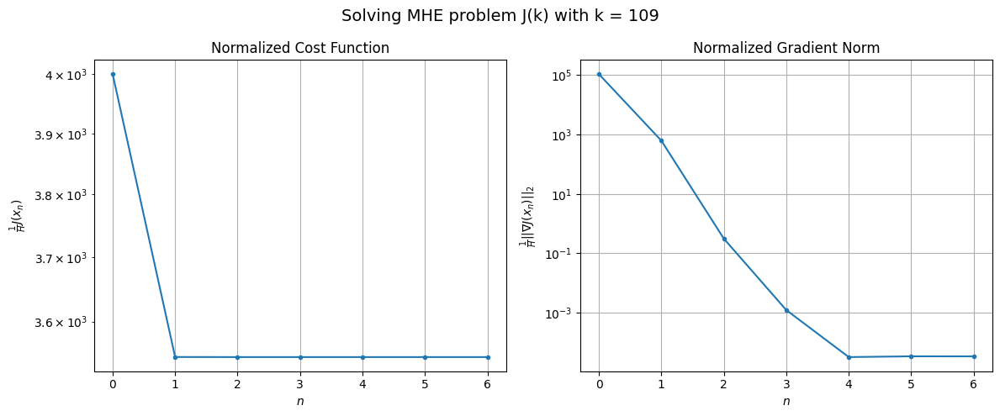

Windows:  24%|██▍       | 91/376 [08:02<30:15,  6.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 81521.60878747821
Gradient norm: 2152843.24052136
Global estimation error: 84.0538714788581
Initial conditions estimation errors: 11.226772014735417 m, 31.622609586015606 m, 66.75775130790073 m, 38.501385502120584 m
Position estimation errors: 21.207250632627776 m, 32.53540552740304 m, 64.96111476313754 m, 127.83145934865483 m

[Gauss-Newton] Iteration 1
Cost function: 71954.63538454325 (-11.74%)
Gradient norm: 118.99061744263506 (-99.99%)
Global estimation error: 80.24339739366329 (-4.53%)
Initial conditions estimation errors: 16.006434936495666 m, 26.123297333623263 m, 69.09983625513962 m, 26.935261764956902 m
Position estimation errors: 16.062034567895076 m, 33.698745874975316 m, 57.67644736183616 m, 126.3094087178089 m

[Gauss-Newton] Iteration 2
Cost function: 71954.6348095664 (-0.00%)
Gradient norm: 0.9798289694945866 (-99.18%)
Global estimation error: 79.88293505752324 (-0.45%)
Initial conditions estimation errors: 16.0

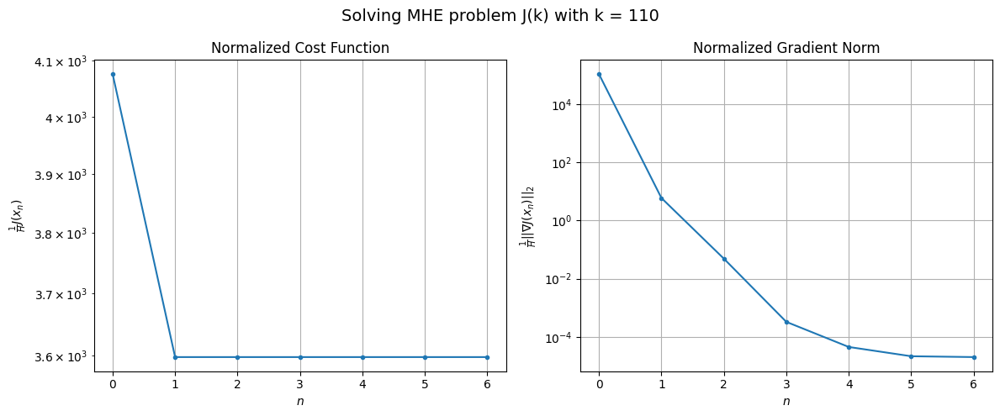

Windows:  24%|██▍       | 92/376 [08:06<27:00,  5.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 81612.51834964953
Gradient norm: 2069520.31183646
Global estimation error: 82.5827074525544
Initial conditions estimation errors: 11.446333643457233 m, 31.67755633937835 m, 65.69040233404407 m, 37.01513455941906 m
Position estimation errors: 21.236403435603894 m, 27.019389313512598 m, 60.13783977416238 m, 121.12482472661071 m

[Gauss-Newton] Iteration 1
Cost function: 71843.39912123812 (-11.97%)
Gradient norm: 304.6969625380356 (-99.99%)
Global estimation error: 84.24141634361227 (2.01%)
Initial conditions estimation errors: 16.29609458282533 m, 24.155681508414787 m, 76.51429161511658 m, 19.824933830080187 m
Position estimation errors: 16.068072724609692 m, 39.92675350044195 m, 63.66538690476415 m, 142.93438863833623 m

[Gauss-Newton] Iteration 2
Cost function: 71843.39457415466 (-0.00%)
Gradient norm: 20.302766595478737 (-93.34%)
Global estimation error: 82.48571320094499 (-2.08%)
Initial conditions estimation errors: 16.2960

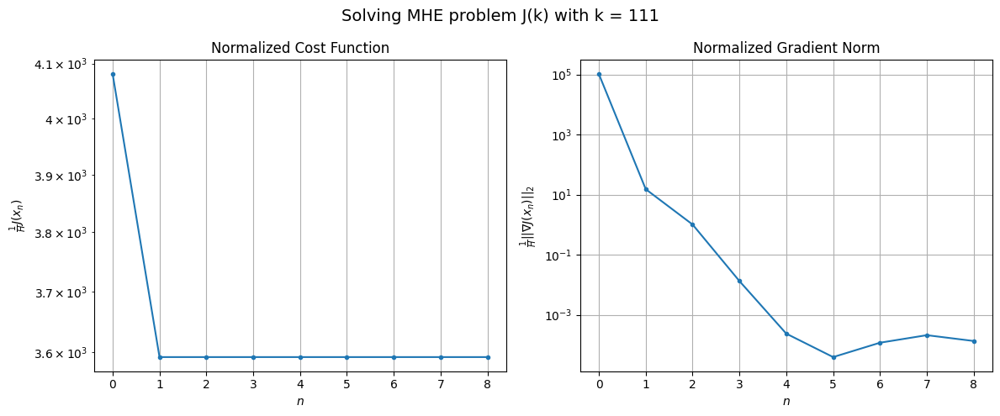

Windows:  25%|██▍       | 93/376 [08:12<26:25,  5.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 80724.28502346529
Gradient norm: 2005941.6444377007
Global estimation error: 83.30779340710208
Initial conditions estimation errors: 11.582633088367505 m, 29.043773038434434 m, 71.79804072951504 m, 28.415649559640936 m
Position estimation errors: 21.057517644443887 m, 32.89596338610964 m, 65.10774543743089 m, 136.08790485677127 m

[Gauss-Newton] Iteration 1
Cost function: 71041.21555232466 (-12.00%)
Gradient norm: 45659.6801175621 (-97.72%)
Global estimation error: 47.72750455373399 (-42.71%)
Initial conditions estimation errors: 16.422879581600384 m, 25.64997773641966 m, 7.812761950195377 m, 35.905615611133385 m
Position estimation errors: 15.925230658268136 m, 25.380689895598753 m, 6.445875391914555 m, 34.02699478956031 m

[Gauss-Newton] Iteration 2
Cost function: 71004.82261033257 (-0.05%)
Gradient norm: 22.18393616505845 (-99.95%)
Global estimation error: 47.26268202108089 (-0.97%)
Initial conditions estimation errors: 16.

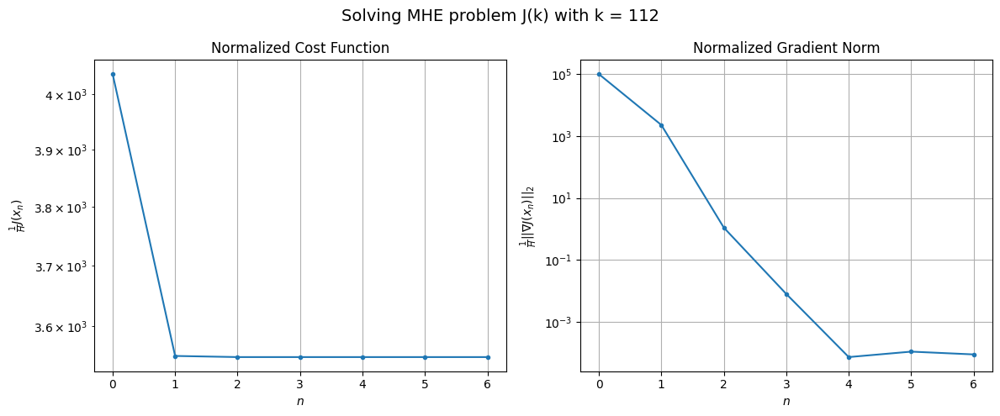

Windows:  25%|██▌       | 94/376 [08:16<24:25,  5.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 78825.87495525433
Gradient norm: 1917797.027569797
Global estimation error: 39.60067056098919
Initial conditions estimation errors: 11.614849467552412 m, 20.34020314659841 m, 5.170757113514472 m, 31.509075661750035 m
Position estimation errors: 20.750786128925423 m, 28.448850695017867 m, 12.363695107758232 m, 33.947740079259034 m

[Gauss-Newton] Iteration 1
Cost function: 69252.4732296559 (-12.14%)
Gradient norm: 2436.1349395397433 (-99.87%)
Global estimation error: 36.81790146828025 (-7.03%)
Initial conditions estimation errors: 16.426520950293593 m, 13.37816443099283 m, 26.645973366297817 m, 14.025299383552698 m
Position estimation errors: 15.682235402324388 m, 10.83644725759779 m, 22.651741681352558 m, 2.8673612837125217 m

[Gauss-Newton] Iteration 2
Cost function: 69252.32643464817 (-0.00%)
Gradient norm: 9.537303530432974 (-99.61%)
Global estimation error: 36.38110597875073 (-1.19%)
Initial conditions estimation errors: 1

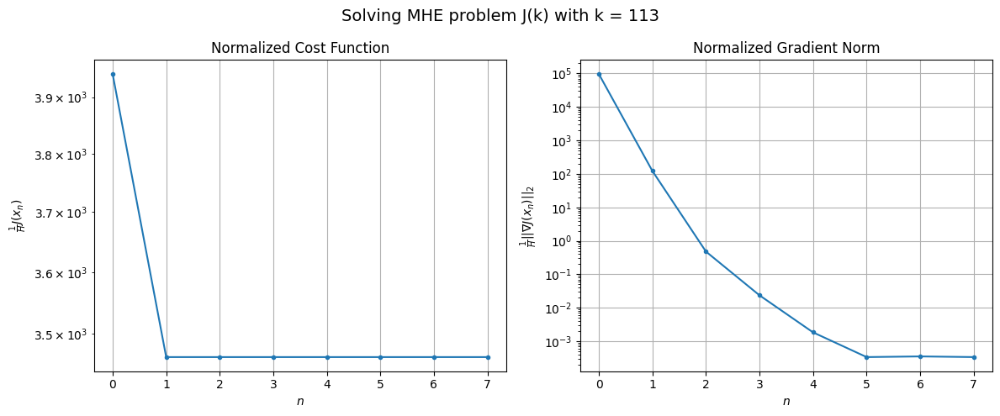

Windows:  25%|██▌       | 95/376 [08:21<24:13,  5.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 76439.18725231971
Gradient norm: 1861173.4567159861
Global estimation error: 27.263640485621195
Initial conditions estimation errors: 11.562078328212307 m, 8.602583369927908 m, 21.455968828456573 m, 8.673645159037957 m
Position estimation errors: 20.41757223916218 m, 16.323034944923407 m, 26.29759553341018 m, 7.772375647598095 m

[Gauss-Newton] Iteration 1
Cost function: 67095.87805117779 (-12.22%)
Gradient norm: 253.12395280476136 (-99.99%)
Global estimation error: 40.845628766763745 (49.82%)
Initial conditions estimation errors: 16.306516152157435 m, 10.383255558063192 m, 33.1458508019236 m, 13.998943446524622 m
Position estimation errors: 15.416442351977222 m, 10.68799508713 m, 25.128802411644987 m, 2.3070991748800025 m

[Gauss-Newton] Iteration 2
Cost function: 67095.87206335863 (-0.00%)
Gradient norm: 1.2662981582184087 (-99.50%)
Global estimation error: 41.13709221966923 (0.71%)
Initial conditions estimation errors: 16.3

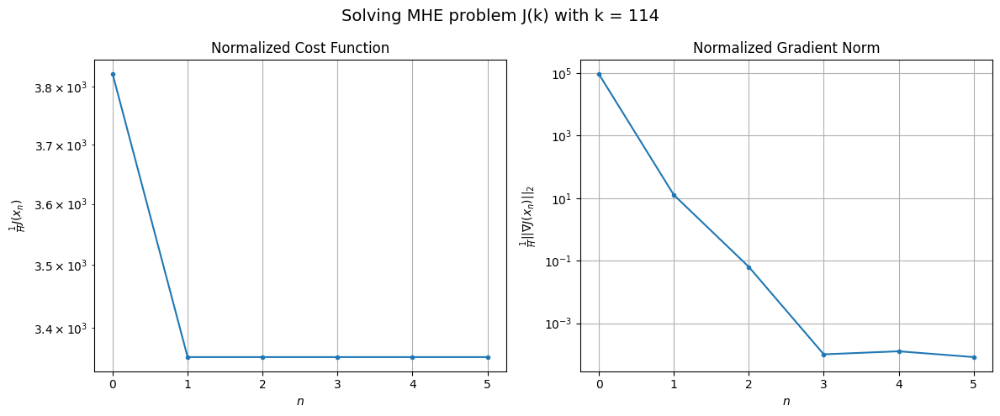

Windows:  26%|██▌       | 96/376 [08:25<21:55,  4.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 74529.1654115078
Gradient norm: 1859113.331885676
Global estimation error: 36.604123583973845
Initial conditions estimation errors: 11.420585771786449 m, 9.610313232406462 m, 29.399526654500406 m, 15.8969966313707 m
Position estimation errors: 20.155882975211156 m, 15.738836971604652 m, 29.103415207345996 m, 6.319911838680517 m

[Gauss-Newton] Iteration 1
Cost function: 65314.93221786279 (-12.36%)
Gradient norm: 19581.172875031752 (-98.95%)
Global estimation error: 47.78663147874844 (30.55%)
Initial conditions estimation errors: 16.109040007554498 m, 33.483948149469605 m, 21.510824298072105 m, 20.97955912073321 m
Position estimation errors: 15.183259461656867 m, 45.642644897122686 m, 16.421132195521068 m, 124.33842771771147 m

[Gauss-Newton] Iteration 2
Cost function: 65308.32186883877 (-0.01%)
Gradient norm: 6.849710295584031 (-99.97%)
Global estimation error: 47.049786487216956 (-1.54%)
Initial conditions estimation errors: 

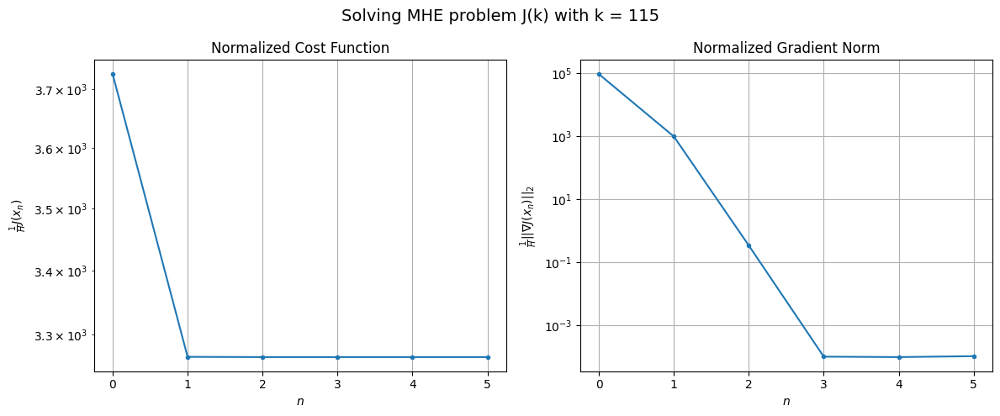

Windows:  26%|██▌       | 97/376 [08:28<20:12,  4.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 72462.30135814281
Gradient norm: 1867342.9371444096
Global estimation error: 44.80934469965618
Initial conditions estimation errors: 11.24337784676024 m, 29.914827336867422 m, 23.90863954161638 m, 20.369593896232384 m
Position estimation errors: 19.997073159953533 m, 48.91560603247511 m, 15.296197131092315 m, 128.89977025206878 m

[Gauss-Newton] Iteration 1
Cost function: 63546.82959292595 (-12.30%)
Gradient norm: 5338.9128706551 (-99.71%)
Global estimation error: 27.38561222160539 (-38.88%)
Initial conditions estimation errors: 15.837447592925283 m, 17.585481911550456 m, 11.370881428520718 m, 7.783179384316307 m
Position estimation errors: 15.099691811183785 m, 25.944458033487916 m, 10.393202325704245 m, 59.31267961152995 m

[Gauss-Newton] Iteration 2
Cost function: 63546.34895118565 (-0.00%)
Gradient norm: 5.357926959375126 (-99.90%)
Global estimation error: 27.57858971260431 (0.70%)
Initial conditions estimation errors: 15.

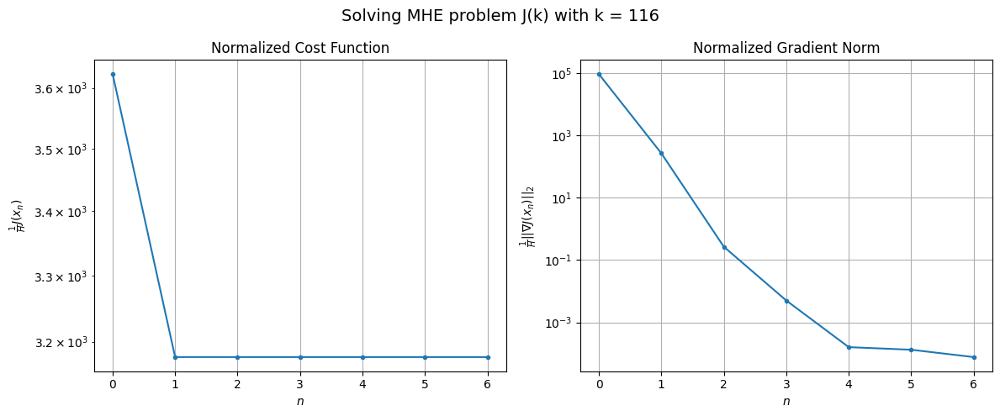

Windows:  26%|██▌       | 98/376 [08:33<20:56,  4.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 70828.89822402137
Gradient norm: 1930137.1150811375
Global estimation error: 20.64921770783001
Initial conditions estimation errors: 11.053116979539336 m, 13.823971052612064 m, 8.994255654207931 m, 5.67470069350163 m
Position estimation errors: 20.007734539711887 m, 31.285153967349963 m, 15.329042993860668 m, 68.21262153209854 m

[Gauss-Newton] Iteration 1
Cost function: 62108.56567707643 (-12.31%)
Gradient norm: 4060.949014588253 (-99.79%)
Global estimation error: 37.11657090246328 (79.75%)
Initial conditions estimation errors: 15.572052044758017 m, 7.865326371732498 m, 24.34800115941198 m, 21.918814588092744 m
Position estimation errors: 15.149510228000134 m, 12.226492952831498 m, 16.228390332659185 m, 6.652765053435861 m

[Gauss-Newton] Iteration 2
Cost function: 62108.28290000691 (-0.00%)
Gradient norm: 0.04304642287267705 (-100.00%)
Global estimation error: 37.049305477531455 (-0.18%)
Initial conditions estimation errors:

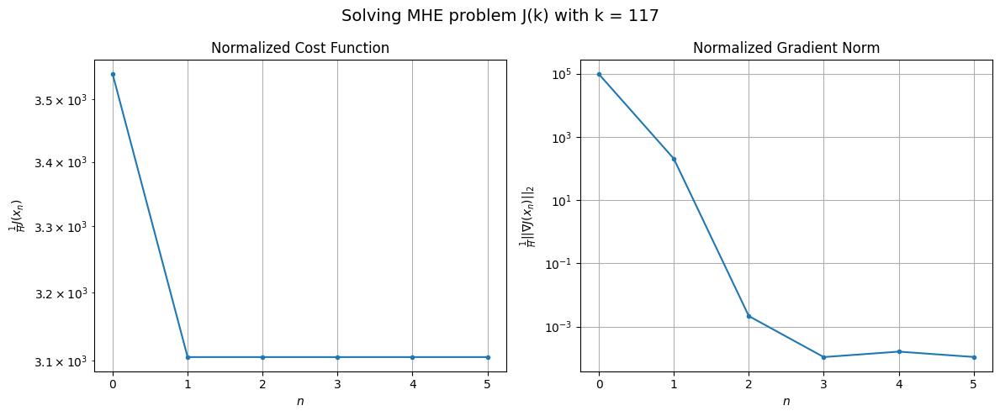

Windows:  26%|██▋       | 99/376 [08:37<19:34,  4.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 70387.09721465774
Gradient norm: 2074125.6516149954
Global estimation error: 34.50910897295555
Initial conditions estimation errors: 10.909066417022162 m, 4.893906669083647 m, 19.860433024410533 m, 25.562896926530662 m
Position estimation errors: 20.128274185351597 m, 17.64541496845571 m, 20.48965477784253 m, 14.075915376515352 m

[Gauss-Newton] Iteration 1
Cost function: 61778.566952832094 (-12.23%)
Gradient norm: 1122.3675442993183 (-99.95%)
Global estimation error: 39.99599166407449 (15.90%)
Initial conditions estimation errors: 15.346823730234087 m, 5.218087013206986 m, 32.666387996944636 m, 16.425481153237772 m
Position estimation errors: 15.253250789602015 m, 7.983609508151392 m, 19.155539143381194 m, 32.00466574001932 m

[Gauss-Newton] Iteration 2
Cost function: 61778.54969272884 (-0.00%)
Gradient norm: 0.24178015633461783 (-99.98%)
Global estimation error: 40.16612330693634 (0.43%)
Initial conditions estimation errors:

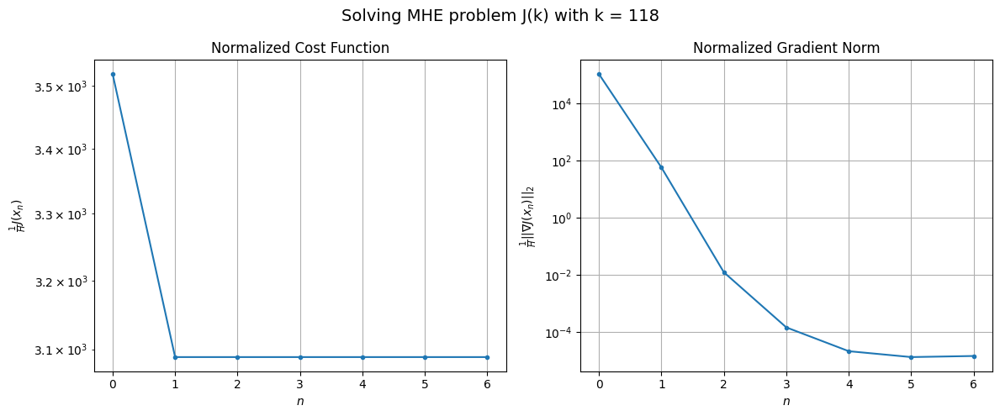

Windows:  27%|██▋       | 100/376 [08:41<19:24,  4.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 70418.50278167076
Gradient norm: 2260309.1315294025
Global estimation error: 38.42598499147931
Initial conditions estimation errors: 10.805334091939741 m, 5.981714892855713 m, 27.86032566123538 m, 23.404966895972386 m
Position estimation errors: 20.243469515894617 m, 13.101784634019275 m, 22.571760944272498 m, 27.237360961033183 m

[Gauss-Newton] Iteration 1
Cost function: 61762.87251200233 (-12.29%)
Gradient norm: 238.36436551873197 (-99.99%)
Global estimation error: 32.47270012117912 (-15.49%)
Initial conditions estimation errors: 15.217226091673599 m, 9.266312628654873 m, 25.25122802656654 m, 9.969432728743234 m
Position estimation errors: 15.304285983566576 m, 11.145706820435338 m, 14.974860391538218 m, 23.859229072733385 m

[Gauss-Newton] Iteration 2
Cost function: 61762.87064335401 (-0.00%)
Gradient norm: 0.0830783597717718 (-99.97%)
Global estimation error: 32.51210757869115 (0.12%)
Initial conditions estimation errors:

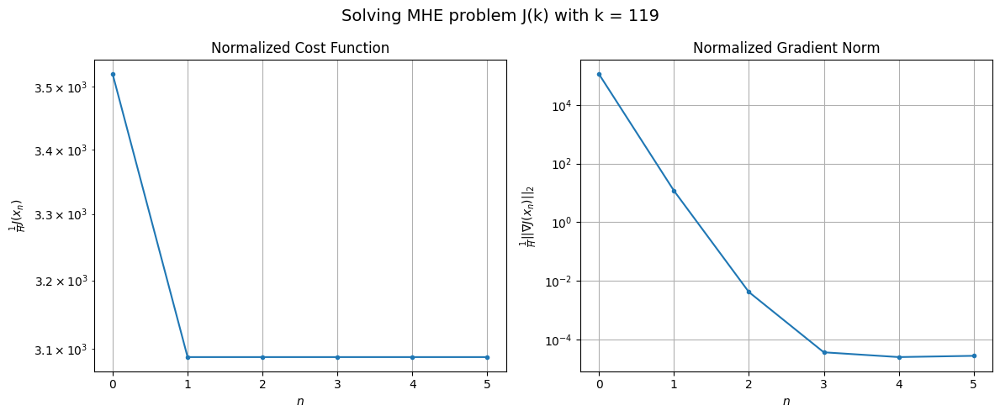

Windows:  27%|██▋       | 101/376 [08:44<18:32,  4.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 70774.82485441123
Gradient norm: 2375048.9453924666
Global estimation error: 28.630451154687925
Initial conditions estimation errors: 10.745939360277132 m, 5.874838575909729 m, 20.469275628043675 m, 15.833325334508071 m
Position estimation errors: 20.215692926592062 m, 16.37199145291703 m, 19.250172273485923 m, 22.107850251008536 m

[Gauss-Newton] Iteration 1
Cost function: 62210.7187774157 (-12.10%)
Gradient norm: 71.3481741667013 (-100.00%)
Global estimation error: 38.669365086882586 (35.06%)
Initial conditions estimation errors: 15.11031188408928 m, 7.306338339705012 m, 27.58581656860494 m, 21.27451849706528 m
Position estimation errors: 15.258658969067168 m, 11.59970323068141 m, 14.900653224563147 m, 29.551604372733554 m

[Gauss-Newton] Iteration 2
Cost function: 62210.71851192109 (-0.00%)
Gradient norm: 0.0062111293489105655 (-99.99%)
Global estimation error: 38.63135784160531 (-0.10%)
Initial conditions estimation errors

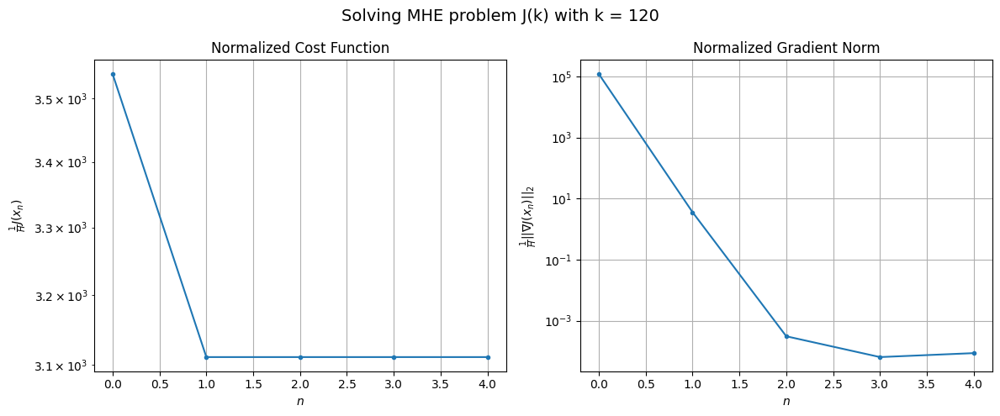

Windows:  27%|██▋       | 102/376 [08:48<17:13,  3.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 70174.03825125727
Gradient norm: 2468691.2687303177
Global estimation error: 37.55191972360518
Initial conditions estimation errors: 10.624311116685615 m, 6.727642386149901 m, 22.614779467071617 m, 27.213099750093136 m
Position estimation errors: 19.976083352660893 m, 16.772156862676944 m, 18.563569874222505 m, 28.242381486305653 m

[Gauss-Newton] Iteration 1
Cost function: 61669.25056108403 (-12.12%)
Gradient norm: 3784.307190344347 (-99.85%)
Global estimation error: 36.78203566744355 (-2.05%)
Initial conditions estimation errors: 14.985190567454719 m, 19.514184920496902 m, 11.007318411458188 m, 25.027454919973234 m
Position estimation errors: 15.02138560446275 m, 19.331992381207264 m, 15.458046001757621 m, 30.131528636744612 m

[Gauss-Newton] Iteration 2
Cost function: 61668.893297353745 (-0.00%)
Gradient norm: 0.23189061165218175 (-99.99%)
Global estimation error: 36.89660009831755 (0.31%)
Initial conditions estimation erro

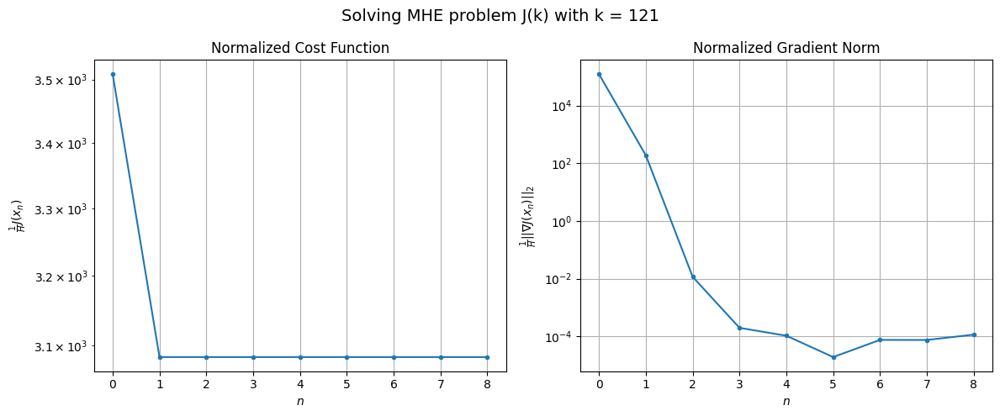

Windows:  27%|██▋       | 103/376 [08:53<19:12,  4.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 69181.39946097141
Gradient norm: 2521322.871732361
Global estimation error: 28.806666420317818
Initial conditions estimation errors: 10.421543489725723 m, 15.128964532293946 m, 6.389438640854626 m, 21.248157707536844 m
Position estimation errors: 19.38658068768163 m, 23.75288570095694 m, 20.775985944476282 m, 34.882425917756656 m

[Gauss-Newton] Iteration 1
Cost function: 60957.74139349852 (-11.89%)
Gradient norm: 830.2791698603088 (-99.97%)
Global estimation error: 29.319993852540406 (1.78%)
Initial conditions estimation errors: 14.69871709799032 m, 10.196143801293147 m, 18.960333990597718 m, 13.421202878722925 m
Position estimation errors: 14.480514902512773 m, 16.954581212252563 m, 13.974140321665041 m, 16.736229957691567 m

[Gauss-Newton] Iteration 2
Cost function: 60957.700637197195 (-0.00%)
Gradient norm: 0.005191116565338955 (-100.00%)
Global estimation error: 29.36185821223084 (0.14%)
Initial conditions estimation erro

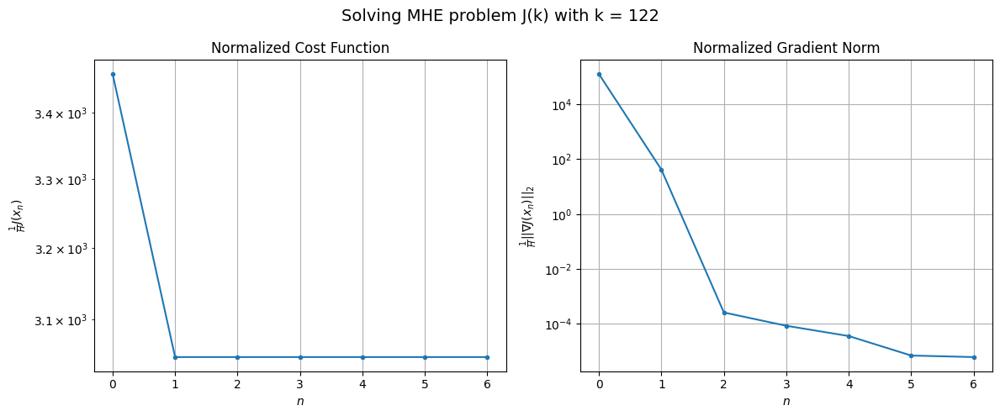

Windows:  28%|██▊       | 104/376 [08:57<18:54,  4.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 66919.19652508697
Gradient norm: 2464438.7582972413
Global estimation error: 25.15709547242979
Initial conditions estimation errors: 10.082809383663545 m, 6.561182405463217 m, 14.088190559163971 m, 17.019669798198013 m
Position estimation errors: 18.314952506602836 m, 21.211946513107044 m, 18.22683741625428 m, 22.313655968089112 m

[Gauss-Newton] Iteration 1
Cost function: 59348.477294292185 (-11.31%)
Gradient norm: 61.53764402810047 (-100.00%)
Global estimation error: 27.023773307457503 (7.42%)
Initial conditions estimation errors: 14.208692220772695 m, 12.703619840342833 m, 15.958215274451275 m, 10.598243821634426 m
Position estimation errors: 13.613122551052502 m, 14.328568444712177 m, 13.466576918551587 m, 14.707536528671252 m

[Gauss-Newton] Iteration 2
Cost function: 59348.476121299434 (-0.00%)
Gradient norm: 0.011988359199695958 (-99.98%)
Global estimation error: 27.01225089502858 (-0.04%)
Initial conditions estimation 

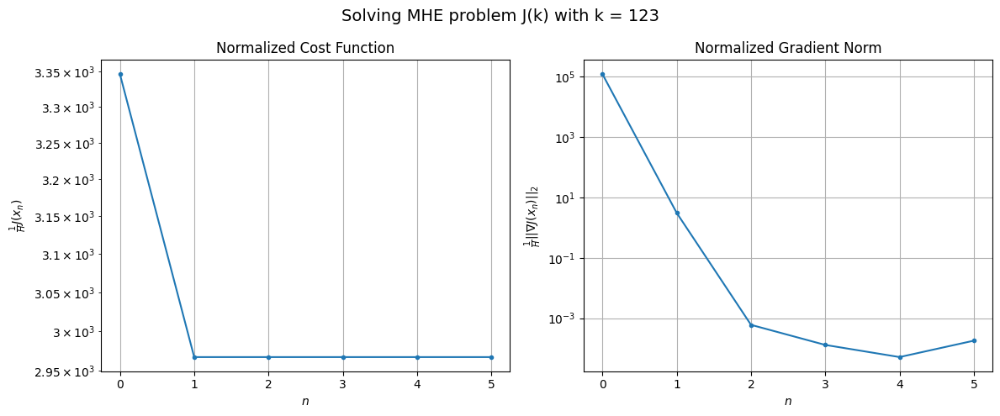

Windows:  28%|██▊       | 105/376 [09:01<18:43,  4.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 63456.797713279455
Gradient norm: 2294967.495668353
Global estimation error: 18.532638175761946
Initial conditions estimation errors: 9.657633116051827 m, 8.378365449769545 m, 11.279154396636606 m, 7.262920742615862 m
Position estimation errors: 16.776303054890278 m, 17.668826162357675 m, 16.873651993514038 m, 18.522861960211 m

[Gauss-Newton] Iteration 1
Cost function: 56780.947700525525 (-10.52%)
Gradient norm: 2756.9756394134133 (-99.88%)
Global estimation error: 49.14009587435594 (165.15%)
Initial conditions estimation errors: 13.57886517228322 m, 22.150081797700587 m, 7.663571395548959 m, 40.999847511491545 m
Position estimation errors: 12.405452324995299 m, 17.420753031331007 m, 18.970071538062168 m, 53.90473872615599 m

[Gauss-Newton] Iteration 2
Cost function: 56780.80066919079 (-0.00%)
Gradient norm: 0.011276863741016118 (-100.00%)
Global estimation error: 49.26117828556801 (0.25%)
Initial conditions estimation errors

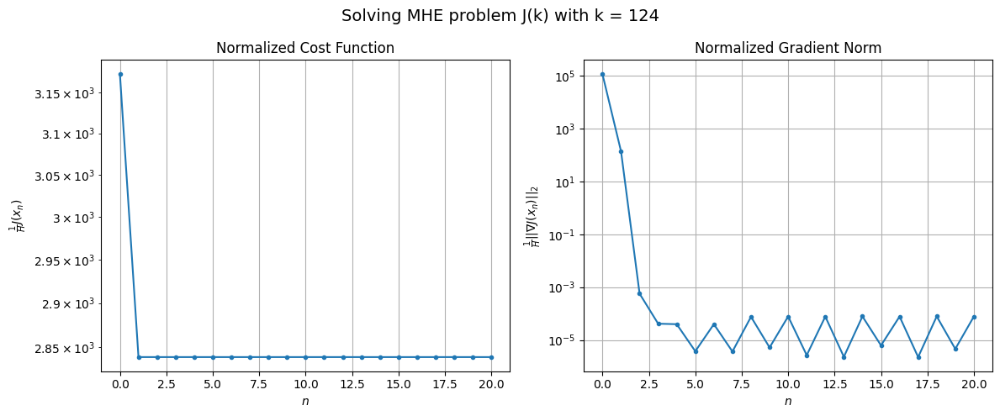

Windows:  28%|██▊       | 106/376 [09:13<29:08,  6.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 58086.29546309904
Gradient norm: 2049744.501753096
Global estimation error: 44.112953450036656
Initial conditions estimation errors: 9.240195282865418 m, 17.9068803333239 m, 5.729630373565013 m, 38.821022441850246 m
Position estimation errors: 14.837219038322347 m, 19.246604870512694 m, 22.132670637921876 m, 54.39179486885318 m

[Gauss-Newton] Iteration 1
Cost function: 52408.04022082038 (-9.78%)
Gradient norm: 653.7991153521891 (-99.97%)
Global estimation error: 44.202518283381245 (0.20%)
Initial conditions estimation errors: 12.949224954311669 m, 22.755272994294746 m, 8.514228584047412 m, 34.58134758343716 m
Position estimation errors: 10.906605250187985 m, 18.56276861761301 m, 23.050082610286037 m, 84.68762619360324 m

[Gauss-Newton] Iteration 2
Cost function: 52408.03465576029 (-0.00%)
Gradient norm: 0.19409147447807626 (-99.97%)
Global estimation error: 44.14294077577439 (-0.13%)
Initial conditions estimation errors: 12.9

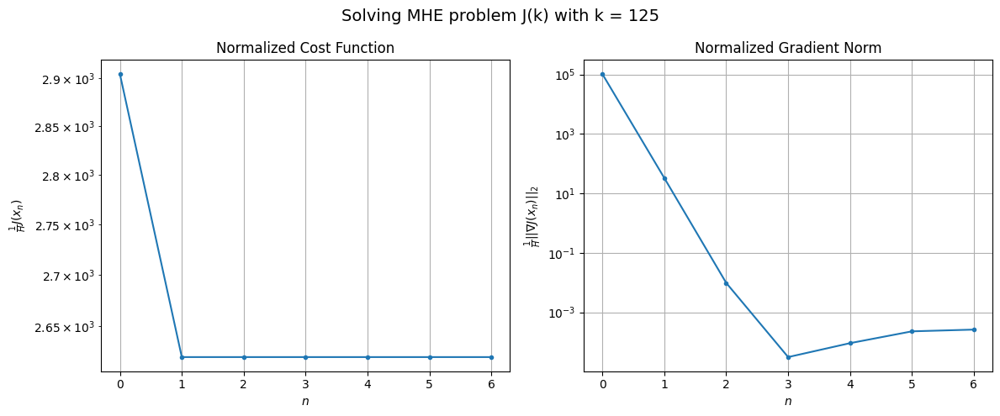

Windows:  28%|██▊       | 107/376 [09:17<25:51,  5.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 51788.24286569159
Gradient norm: 1786303.1701404736
Global estimation error: 41.43274581180929
Initial conditions estimation errors: 8.908331770028571 m, 18.90073780576346 m, 7.468679056696106 m, 34.98974690863632 m
Position estimation errors: 12.664341622623285 m, 19.501351204650906 m, 25.68833716570764 m, 84.37554499709886 m

[Gauss-Newton] Iteration 1
Cost function: 47344.851756358534 (-8.58%)
Gradient norm: 627.2883563269365 (-99.96%)
Global estimation error: 64.57839263085026 (55.86%)
Initial conditions estimation errors: 12.259920713296188 m, 26.36476177488634 m, 9.246355030494431 m, 56.91618983723492 m
Position estimation errors: 9.298039838491325 m, 19.429937910449247 m, 27.672990589290322 m, 105.12621208811422 m

[Gauss-Newton] Iteration 2
Cost function: 47344.84304791197 (-0.00%)
Gradient norm: 0.01682785676127699 (-100.00%)
Global estimation error: 64.52193974977843 (-0.09%)
Initial conditions estimation errors: 12.

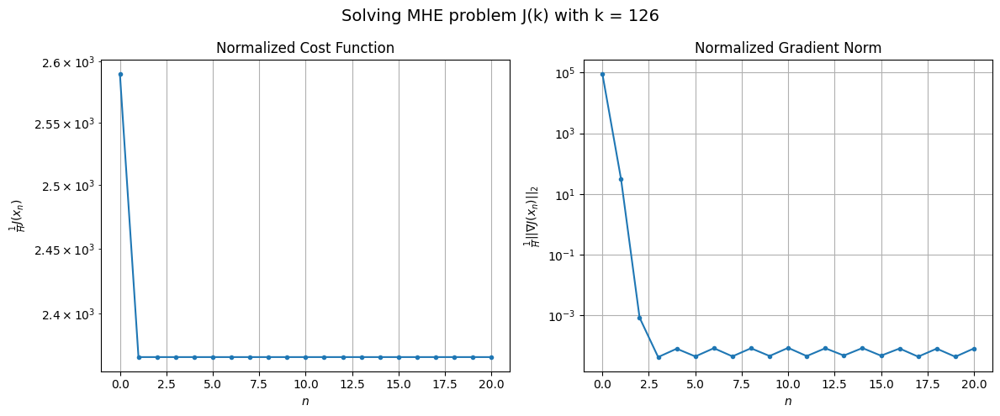

Windows:  29%|██▊       | 108/376 [09:28<33:12,  7.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 45370.79340617634
Gradient norm: 1534206.7860271102
Global estimation error: 64.69036064538516
Initial conditions estimation errors: 8.502269601879288 m, 23.15525736338662 m, 9.328283430882383 m, 59.070794251767296 m
Position estimation errors: 10.600902565778311 m, 19.30668868136639 m, 29.99999254524102 m, 103.11472501038615 m

[Gauss-Newton] Iteration 1
Cost function: 41759.09448475101 (-7.96%)
Gradient norm: 2210.515882156436 (-99.86%)
Global estimation error: 40.843965750473785 (-36.86%)
Initial conditions estimation errors: 11.622840703941698 m, 17.691775544776622 m, 10.291997020118284 m, 33.37966377792977 m
Position estimation errors: 7.773775175359952 m, 12.08781666980923 m, 18.578726994409507 m, 50.42033420140942 m

[Gauss-Newton] Iteration 2
Cost function: 41759.0116747802 (-0.00%)
Gradient norm: 0.032883676517641236 (-100.00%)
Global estimation error: 41.00520574995173 (0.39%)
Initial conditions estimation errors: 11

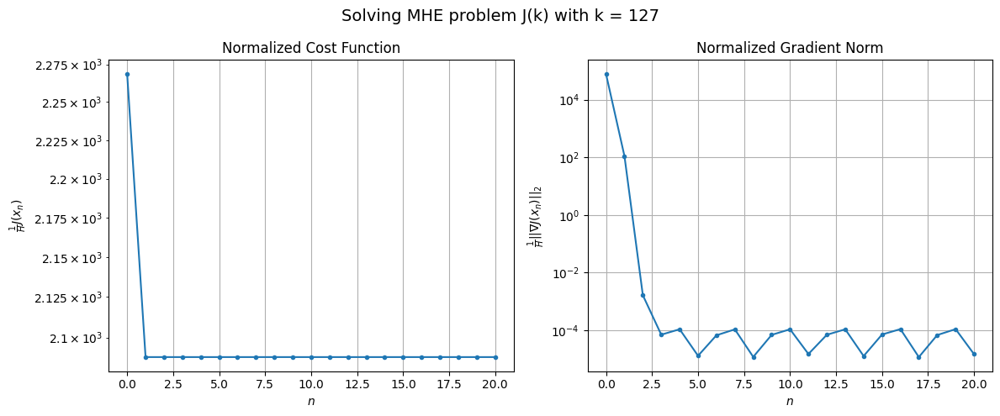

Windows:  29%|██▉       | 109/376 [09:40<38:28,  8.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 39211.89634988105
Gradient norm: 1277799.8216769386
Global estimation error: 37.98551490766805
Initial conditions estimation errors: 8.069222266431588 m, 14.579304493447689 m, 7.922655260072244 m, 33.20318502264621 m
Position estimation errors: 8.996974593379262 m, 12.243965819376093 m, 20.508187326449477 m, 48.61315494659052 m

[Gauss-Newton] Iteration 1
Cost function: 36388.123867622766 (-7.20%)
Gradient norm: 117.72861343306535 (-99.99%)
Global estimation error: 41.7740654396229 (9.97%)
Initial conditions estimation errors: 10.896132541584644 m, 16.525581147619178 m, 10.538641527876022 m, 35.244511637305926 m
Position estimation errors: 6.751526220145948 m, 8.40426463852165 m, 13.91204275600732 m, 42.84096332750962 m

[Gauss-Newton] Iteration 2
Cost function: 36388.12357390521 (-0.00%)
Gradient norm: 0.011543560822350649 (-99.99%)
Global estimation error: 41.65752315940624 (-0.28%)
Initial conditions estimation errors: 10.8

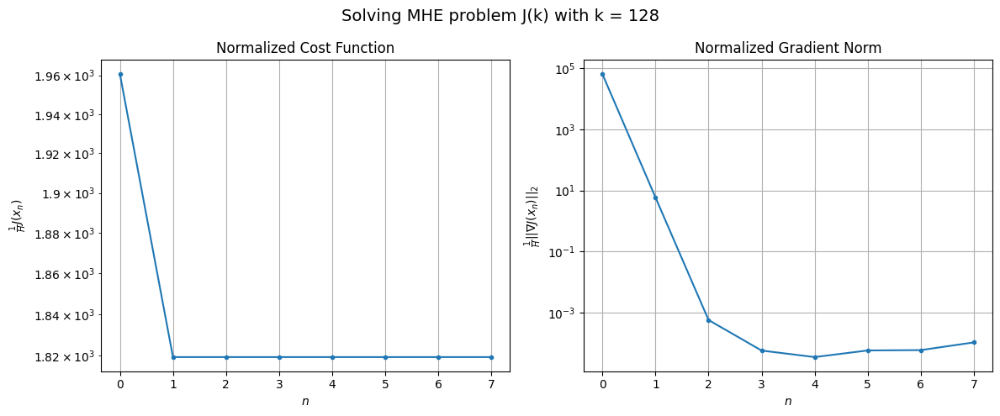

Windows:  29%|██▉       | 110/376 [09:45<33:23,  7.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 33823.3226528272
Gradient norm: 1031621.8191610111
Global estimation error: 38.291984204181794
Initial conditions estimation errors: 7.5128182587747405 m, 13.183529705308887 m, 8.540114640035702 m, 34.10400374076203 m
Position estimation errors: 8.273014907692543 m, 9.397177406290758 m, 14.745663663989797 m, 40.3272042008627 m

[Gauss-Newton] Iteration 1
Cost function: 31615.737887470714 (-6.53%)
Gradient norm: 571.238116192743 (-99.94%)
Global estimation error: 30.20251346768623 (-21.13%)
Initial conditions estimation errors: 10.061628767792595 m, 11.551367030006999 m, 10.676933629830641 m, 23.738370064164943 m
Position estimation errors: 6.55929597241705 m, 7.259371672572589 m, 7.576014797131134 m, 12.346384657603727 m

[Gauss-Newton] Iteration 2
Cost function: 31615.732742295924 (-0.00%)
Gradient norm: 0.005021316321847369 (-100.00%)
Global estimation error: 30.29983808231295 (0.32%)
Initial conditions estimation errors: 10

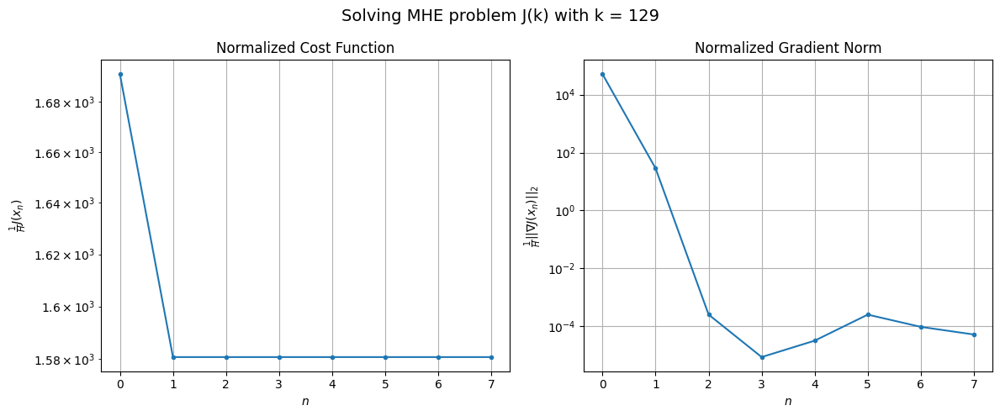

Windows:  30%|██▉       | 111/376 [09:50<29:55,  6.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30125.69814073099
Gradient norm: 905685.9641320289
Global estimation error: 25.25335865945252
Initial conditions estimation errors: 6.8915391886633115 m, 8.383767793838627 m, 7.962317257141892 m, 21.366812715009008 m
Position estimation errors: 8.497364653724592 m, 9.25063850186247 m, 9.10386958964123 m, 10.353290657736114 m

[Gauss-Newton] Iteration 1
Cost function: 28229.652836695117 (-6.29%)
Gradient norm: 315.99024511843703 (-99.97%)
Global estimation error: 20.65777669183663 (-18.20%)
Initial conditions estimation errors: 9.211529663261267 m, 9.165326149960462 m, 10.167696821384729 m, 12.429452835225806 m
Position estimation errors: 6.997262337541894 m, 8.67929230552298 m, 6.99307417938144 m, 7.478122305384784 m

[Gauss-Newton] Iteration 2
Cost function: 28229.647992924038 (-0.00%)
Gradient norm: 0.0017982318103048807 (-100.00%)
Global estimation error: 20.66341579267328 (0.03%)
Initial conditions estimation errors: 9.211

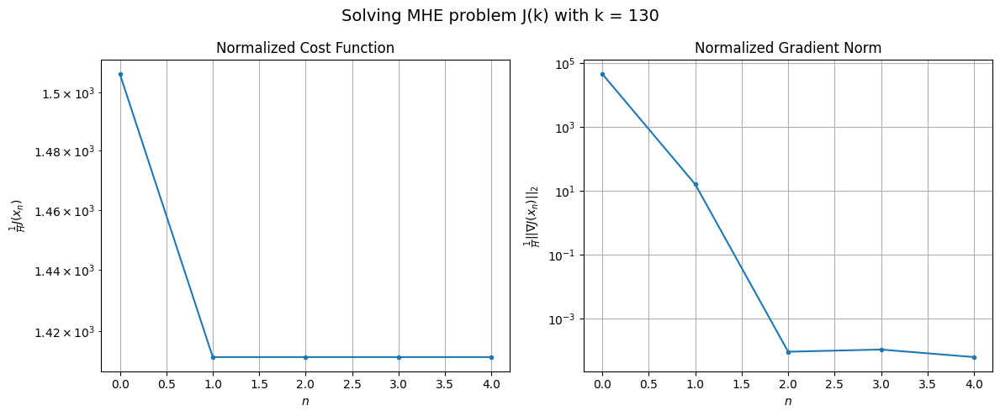

Windows:  30%|██▉       | 112/376 [09:53<24:56,  5.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28197.865016935968
Gradient norm: 869641.6307441116
Global estimation error: 15.73830638189418
Initial conditions estimation errors: 6.351620382532607 m, 6.146039773836988 m, 7.329639768232966 m, 10.76295681405402 m
Position estimation errors: 9.230720737400606 m, 10.936900671188402 m, 9.161352348356314 m, 9.200730085156609 m

[Gauss-Newton] Iteration 1
Cost function: 26424.577070779334 (-6.29%)
Gradient norm: 27.596584404094177 (-100.00%)
Global estimation error: 27.714545894608662 (76.10%)
Initial conditions estimation errors: 8.511325905304997 m, 9.4133831165515 m, 10.563779226310402 m, 22.25833678117254 m
Position estimation errors: 7.727173918092447 m, 9.068700389432697 m, 6.800348140914718 m, 8.357183079242654 m

[Gauss-Newton] Iteration 2
Cost function: 26424.576984754494 (-0.00%)
Gradient norm: 0.004595820058340166 (-99.98%)
Global estimation error: 27.705236870966825 (-0.03%)
Initial conditions estimation errors: 8.51

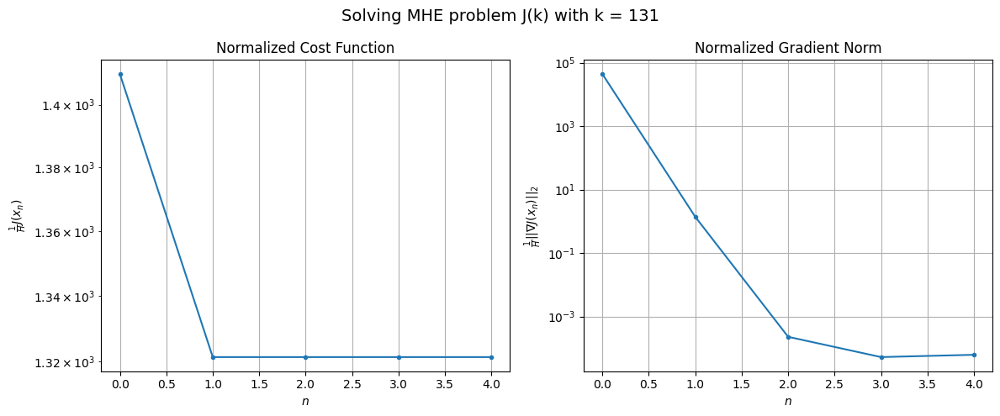

Windows:  30%|███       | 113/376 [09:56<21:35,  4.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28097.810084083234
Gradient norm: 913793.1024966665
Global estimation error: 24.46394625202728
Initial conditions estimation errors: 6.045308220996352 m, 7.0206330132351376 m, 8.079347245550759 m, 21.150917116571947 m
Position estimation errors: 10.140118903129904 m, 11.394435222305093 m, 9.317555737995113 m, 9.889472618024627 m

[Gauss-Newton] Iteration 1
Cost function: 26389.57186992868 (-6.08%)
Gradient norm: 356.1985598244433 (-99.96%)
Global estimation error: 21.455122303507935 (-12.30%)
Initial conditions estimation errors: 8.025105564941894 m, 8.98485963725139 m, 11.702747102298174 m, 13.350113195887811 m
Position estimation errors: 8.45416778438926 m, 7.999508463034501 m, 7.7932230866537004 m, 16.414374820957118 m

[Gauss-Newton] Iteration 2
Cost function: 26389.56907882089 (-0.00%)
Gradient norm: 0.04926413597440657 (-99.99%)
Global estimation error: 21.469903058320075 (0.07%)
Initial conditions estimation errors: 8.0

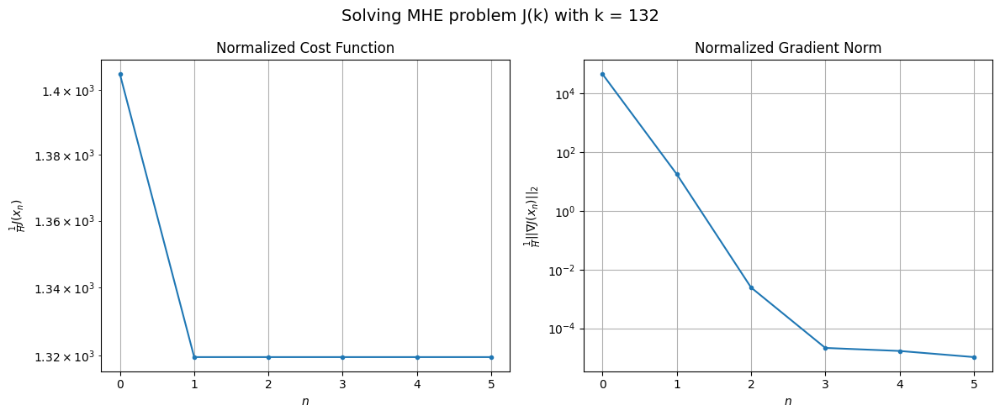

Windows:  30%|███       | 114/376 [10:00<19:45,  4.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29592.35876155848
Gradient norm: 1094755.5464932113
Global estimation error: 16.541781634676674
Initial conditions estimation errors: 6.000479544799473 m, 6.385669138919833 m, 9.71358513709339 m, 10.123405064926057 m
Position estimation errors: 11.020934363593309 m, 10.504538239299482 m, 9.80180077809884 m, 16.276341579918814 m

[Gauss-Newton] Iteration 1
Cost function: 27744.642476660094 (-6.24%)
Gradient norm: 170.41043802793078 (-99.98%)
Global estimation error: 26.893577980431843 (62.58%)
Initial conditions estimation errors: 7.925233859787044 m, 8.981658062170021 m, 11.151947406419275 m, 21.340244368282757 m
Position estimation errors: 9.060056156786391 m, 10.130067970206383 m, 7.744126366281951 m, 9.80436811107895 m

[Gauss-Newton] Iteration 2
Cost function: 27744.641939340887 (-0.00%)
Gradient norm: 0.0118539208634198 (-99.99%)
Global estimation error: 26.933452702403816 (0.15%)
Initial conditions estimation errors: 7.9

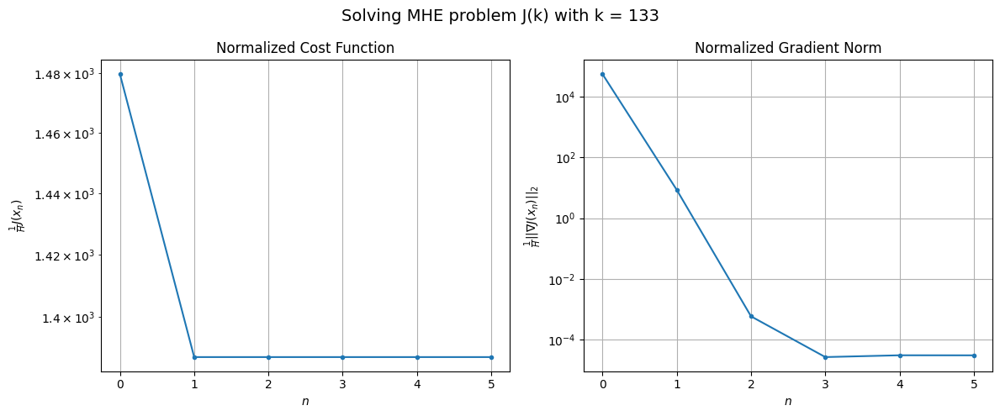

Windows:  31%|███       | 115/376 [10:03<18:27,  4.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31700.047195865645
Gradient norm: 1295822.0448987768
Global estimation error: 22.12484858958616
Initial conditions estimation errors: 6.235318639609043 m, 6.82611182204824 m, 9.047732767582144 m, 17.94885113330669 m
Position estimation errors: 11.827757936187826 m, 12.700181844949771 m, 10.737077278019262 m, 11.03977081920889 m

[Gauss-Newton] Iteration 1
Cost function: 29547.213131738354 (-6.79%)
Gradient norm: 4769.550214844247 (-99.63%)
Global estimation error: 84.10532231579799 (280.14%)
Initial conditions estimation errors: 8.263945248841566 m, 17.02636108678532 m, 13.602383341724636 m, 80.81136301781207 m
Position estimation errors: 9.578986664048434 m, 12.669932461014302 m, 23.977549977922077 m, 71.40312539925563 m

[Gauss-Newton] Iteration 2
Cost function: 29546.677306804144 (-0.00%)
Gradient norm: 0.47286297768699553 (-99.99%)
Global estimation error: 84.95904299747204 (1.02%)
Initial conditions estimation errors: 8.2

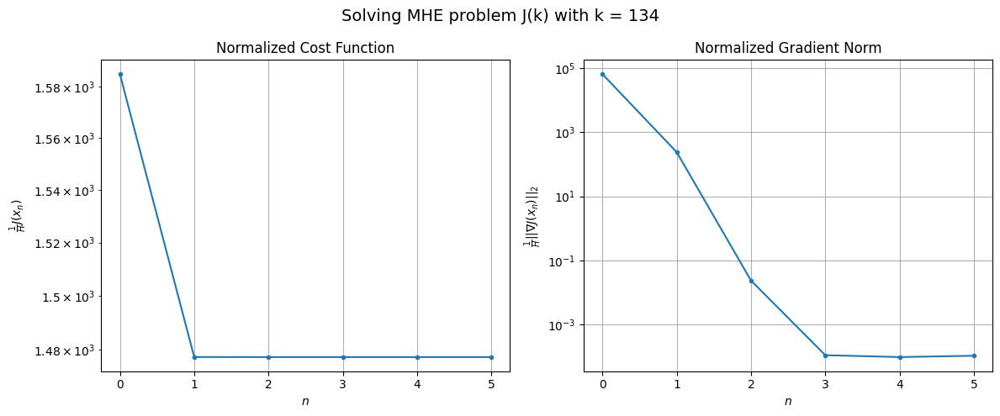

Windows:  31%|███       | 116/376 [10:07<17:45,  4.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 34135.571933785104
Gradient norm: 1557428.0949836469
Global estimation error: 86.75478133014823
Initial conditions estimation errors: 6.673458829275959 m, 16.407612529357284 m, 14.11595562717626 m, 83.74590096287558 m
Position estimation errors: 12.634003641540806 m, 14.680574410192506 m, 26.11683570157468 m, 69.83556987413336 m

[Gauss-Newton] Iteration 1
Cost function: 31679.651069651176 (-7.19%)
Gradient norm: 5967.026844600963 (-99.62%)
Global estimation error: 67.3652999560949 (-22.35%)
Initial conditions estimation errors: 8.787877526226797 m, 10.778567313536541 m, 20.15506155883766 m, 62.756953052378904 m
Position estimation errors: 10.086122399728653 m, 9.008514655000699 m, 11.45011087063865 m, 39.77479536948105 m

[Gauss-Newton] Iteration 2
Cost function: 31679.16179679031 (-0.00%)
Gradient norm: 0.38386385820397506 (-99.99%)
Global estimation error: 66.93562909291208 (-0.64%)
Initial conditions estimation errors: 8.7

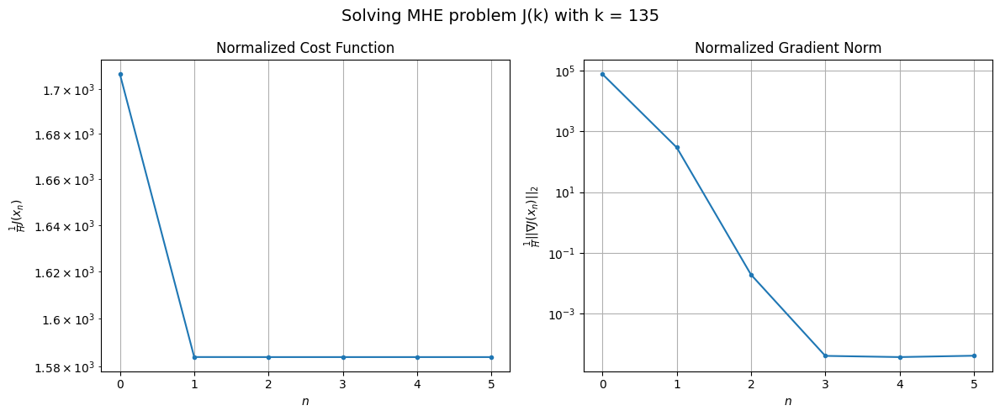

Windows:  31%|███       | 117/376 [10:11<17:12,  3.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 36994.2164166824
Gradient norm: 1857862.900332801
Global estimation error: 60.201227777745515
Initial conditions estimation errors: 7.086458727625756 m, 8.982137965137667 m, 17.522765477693245 m, 56.44666721152151 m
Position estimation errors: 13.462870682940457 m, 11.331801053106481 m, 12.776023569398955 m, 42.16618719862312 m

[Gauss-Newton] Iteration 1
Cost function: 33962.29345936228 (-8.20%)
Gradient norm: 755.9675679338624 (-99.96%)
Global estimation error: 102.29935641885758 (69.93%)
Initial conditions estimation errors: 9.441044116287795 m, 15.263377790352296 m, 26.724422865777672 m, 97.10223117251165 m
Position estimation errors: 10.542284548911582 m, 8.45215762227596 m, 12.088664186502578 m, 22.632002110803036 m

[Gauss-Newton] Iteration 2
Cost function: 33962.2695830241 (-0.00%)
Gradient norm: 0.1462209436524059 (-99.98%)
Global estimation error: 102.66206617076737 (0.35%)
Initial conditions estimation errors: 9.441

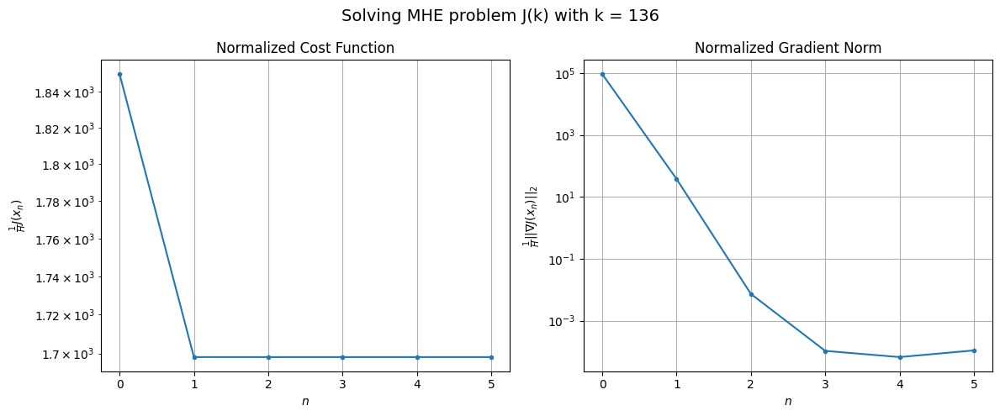

Windows:  31%|███▏      | 118/376 [10:14<16:34,  3.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 39318.342448009585
Gradient norm: 2086138.233665031
Global estimation error: 96.34008755288524
Initial conditions estimation errors: 7.45548924476611 m, 13.42932004616014 m, 24.817528369462565 m, 91.81260473409088 m
Position estimation errors: 14.23929368708614 m, 10.849451690603729 m, 13.062332848385028 m, 28.28505909105315 m

[Gauss-Newton] Iteration 1
Cost function: 35734.10025029228 (-9.12%)
Gradient norm: 5378.139729028347 (-99.74%)
Global estimation error: 118.97938104027729 (23.50%)
Initial conditions estimation errors: 10.070577183565161 m, 21.520783137155625 m, 24.51469341011075 m, 113.97610992004665 m
Position estimation errors: 10.997083712728388 m, 11.224095155297462 m, 28.65281318303446 m, 77.65147948856097 m

[Gauss-Newton] Iteration 2
Cost function: 35733.7034193775 (-0.00%)
Gradient norm: 0.08484273507109782 (-100.00%)
Global estimation error: 118.96195446699758 (-0.01%)
Initial conditions estimation errors: 10

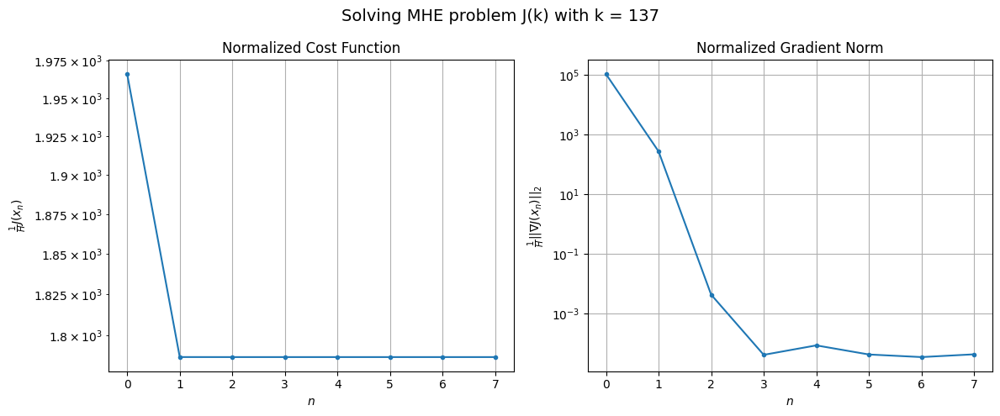

Windows:  32%|███▏      | 119/376 [10:19<17:37,  4.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 41956.65078106627
Gradient norm: 2351068.207574321
Global estimation error: 118.911591952058
Initial conditions estimation errors: 7.709341725653524 m, 19.51033037455598 m, 24.98625468737582 m, 114.34840781428838 m
Position estimation errors: 14.95680394984016 m, 14.066077214035072 m, 30.410063759803617 m, 73.57221488772679 m

[Gauss-Newton] Iteration 1
Cost function: 37708.80113679514 (-10.12%)
Gradient norm: 5917.027395758917 (-99.75%)
Global estimation error: 160.29543742147004 (34.80%)
Initial conditions estimation errors: 10.590515664313758 m, 28.938721379407248 m, 32.880646505514115 m, 153.83060777661157 m
Position estimation errors: 11.35088181739411 m, 15.682594850936797 m, 56.41003276159417 m, 176.89462425968702 m

[Gauss-Newton] Iteration 2
Cost function: 37708.291661126175 (-0.00%)
Gradient norm: 1.6500333164940137 (-99.97%)
Global estimation error: 158.96756352383525 (-0.83%)
Initial conditions estimation errors: 1

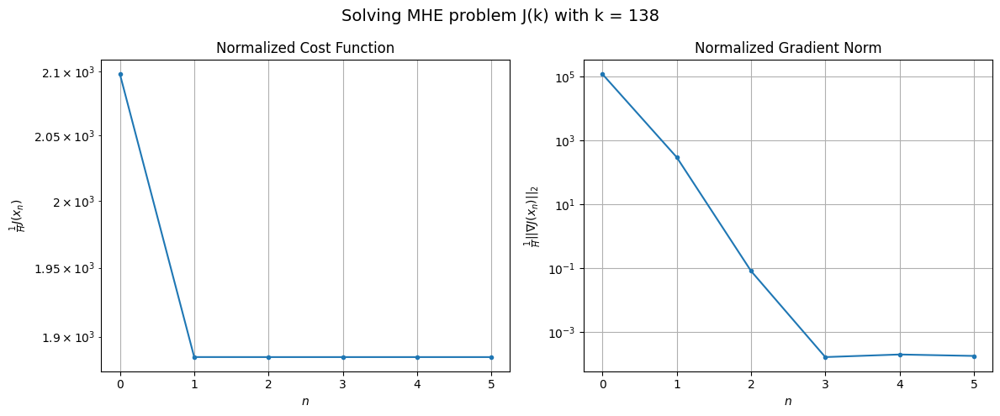

Windows:  32%|███▏      | 120/376 [10:23<17:05,  4.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 44216.88532448928
Gradient norm: 2499068.9871177063
Global estimation error: 163.97857366529237
Initial conditions estimation errors: 7.807638387780089 m, 26.380769671786005 m, 34.41803633350745 m, 157.94759970197478 m
Position estimation errors: 15.475082715632492 m, 18.586539716553723 m, 58.33715173238222 m, 171.0888403408761 m

[Gauss-Newton] Iteration 1
Cost function: 39452.23950931109 (-10.78%)
Gradient norm: 37048.79823273563 (-98.52%)
Global estimation error: 61.401583335620906 (-62.56%)
Initial conditions estimation errors: 10.947617982262472 m, 10.592496030852228 m, 21.116911825301152 m, 55.607195962940935 m
Position estimation errors: 11.60720261317711 m, 10.370872560620718 m, 14.040651163479263 m, 42.945003036977525 m

[Gauss-Newton] Iteration 2
Cost function: 39419.22032162621 (-0.08%)
Gradient norm: 89.70339927637058 (-99.76%)
Global estimation error: 53.56260776096483 (-12.77%)
Initial conditions estimation error

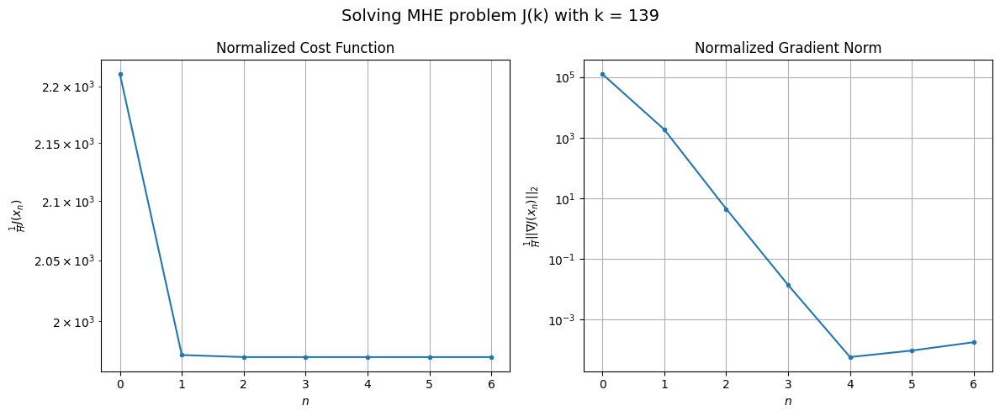

Windows:  32%|███▏      | 121/376 [10:27<17:13,  4.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 45898.25051493641
Gradient norm: 2576030.1236561723
Global estimation error: 55.13755896672884
Initial conditions estimation errors: 7.757193543733636 m, 7.911103072882876 m, 18.338533615937717 m, 50.80424769096444 m
Position estimation errors: 15.777512751745183 m, 14.411006042578201 m, 17.303465796046456 m, 29.7040405625424 m

[Gauss-Newton] Iteration 1
Cost function: 40707.558726525465 (-11.31%)
Gradient norm: 12777.0741865334 (-99.50%)
Global estimation error: 84.68585402199088 (53.59%)
Initial conditions estimation errors: 11.112078438879328 m, 18.532919902917005 m, 22.490878791981896 m, 78.7330068854802 m
Position estimation errors: 11.750972709064795 m, 15.457875579607084 m, 37.22182745867678 m, 102.02396463686026 m

[Gauss-Newton] Iteration 2
Cost function: 40703.847951024734 (-0.01%)
Gradient norm: 215.349440586696 (-98.31%)
Global estimation error: 70.20157371229477 (-17.10%)
Initial conditions estimation errors: 11.

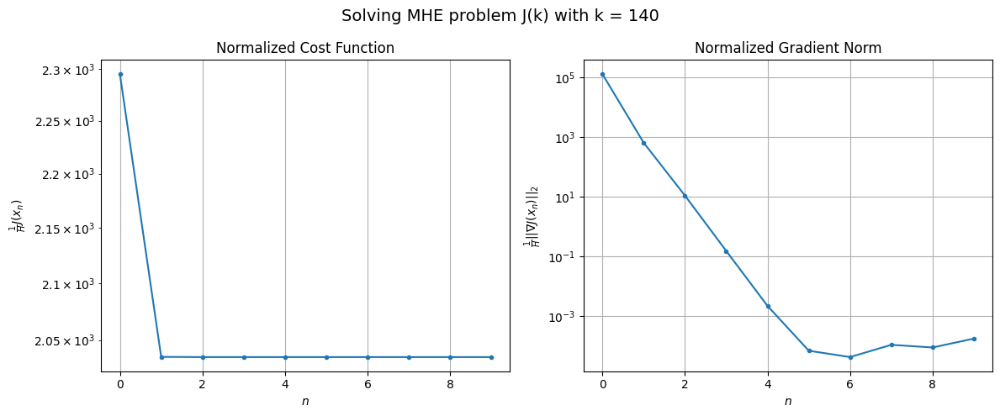

Windows:  32%|███▏      | 122/376 [10:32<19:08,  4.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 46958.49111105494
Gradient norm: 2600451.492190232
Global estimation error: 69.66132777855537
Initial conditions estimation errors: 7.58922676253637 m, 13.705522704748097 m, 18.588396227185424 m, 65.28182740200005 m
Position estimation errors: 15.856161621910784 m, 19.155158070138263 m, 36.929895642739645 m, 88.57436930779613 m

[Gauss-Newton] Iteration 1
Cost function: 41606.577035136674 (-11.40%)
Gradient norm: 49817.05334145805 (-98.08%)
Global estimation error: 174.08097457450114 (149.90%)
Initial conditions estimation errors: 11.07890966833653 m, 11.579389488136467 m, 39.5648003694688 m, 168.76589644383444 m
Position estimation errors: 11.743525411142956 m, 14.476960562210918 m, 46.51969147902309 m, 178.39808244390272 m

[Gauss-Newton] Iteration 2
Cost function: 41552.63923098046 (-0.13%)
Gradient norm: 0.24067999083999767 (-100.00%)
Global estimation error: 174.92307170729623 (0.48%)
Initial conditions estimation errors:

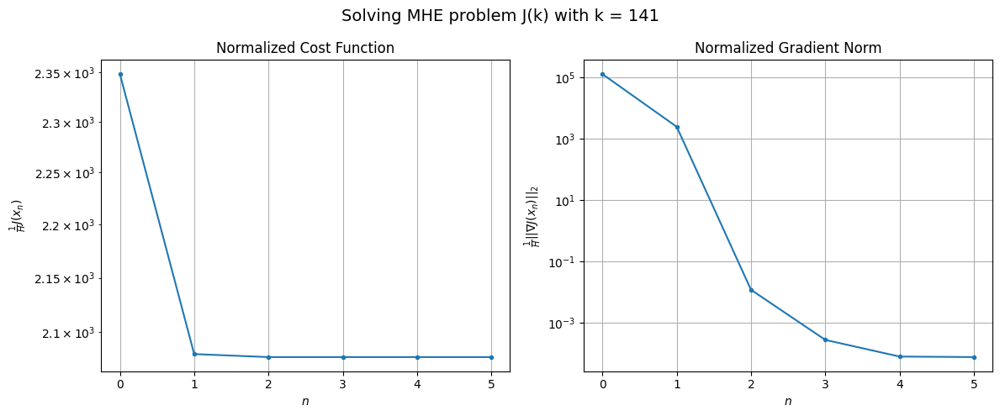

Windows:  33%|███▎      | 123/376 [10:36<17:46,  4.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 47569.844405030155
Gradient norm: 2533997.864312085
Global estimation error: 185.72687298602509
Initial conditions estimation errors: 7.377976436848282 m, 12.171058477245358 m, 41.79991180540532 m, 180.40127305237127 m
Position estimation errors: 15.687914777656339 m, 15.790657846390062 m, 44.0409778839768 m, 167.51826508529663 m

[Gauss-Newton] Iteration 1
Cost function: 42687.503208904265 (-10.26%)
Gradient norm: 140489.35421174532 (-94.46%)
Global estimation error: 265.8831361809583 (43.16%)
Initial conditions estimation errors: 10.907275765315525 m, 32.60600912515551 m, 67.00103077030396 m, 254.9951756558786 m
Position estimation errors: 11.599375771026688 m, 16.658405239946912 m, 73.34130510089223 m, 250.88413259633643 m

[Gauss-Newton] Iteration 2
Cost function: 42211.55144330106 (-1.11%)
Gradient norm: 1105.519229776829 (-99.21%)
Global estimation error: 302.1324476730869 (13.63%)
Initial conditions estimation errors: 1

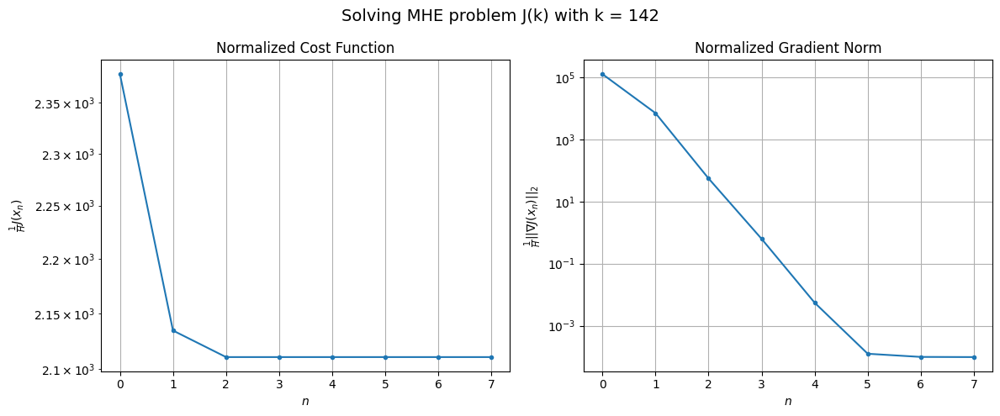

Windows:  33%|███▎      | 124/376 [10:41<18:14,  4.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 47826.27642417795
Gradient norm: 2442655.9903397714
Global estimation error: 315.8856617098341
Initial conditions estimation errors: 7.21885396832561 m, 33.142536321042755 m, 77.89729563819442 m, 304.2452542268284 m
Position estimation errors: 15.311836422592162 m, 21.01827875500425 m, 84.95209619200799 m, 282.79264165001956 m

[Gauss-Newton] Iteration 1
Cost function: 42581.9779827737 (-10.97%)
Gradient norm: 15342.924887020861 (-99.37%)
Global estimation error: 481.6254830393715 (52.47%)
Initial conditions estimation errors: 10.760305260211457 m, 50.731413765907845 m, 116.239281956335 m, 464.5018603310863 m
Position estimation errors: 11.286681380841092 m, 20.888267994055724 m, 122.07626979944199 m, 411.4182695665323 m

[Gauss-Newton] Iteration 2
Cost function: 42575.51085403988 (-0.02%)
Gradient norm: 65.20513592009176 (-99.58%)
Global estimation error: 491.22748911809515 (1.99%)
Initial conditions estimation errors: 10.760

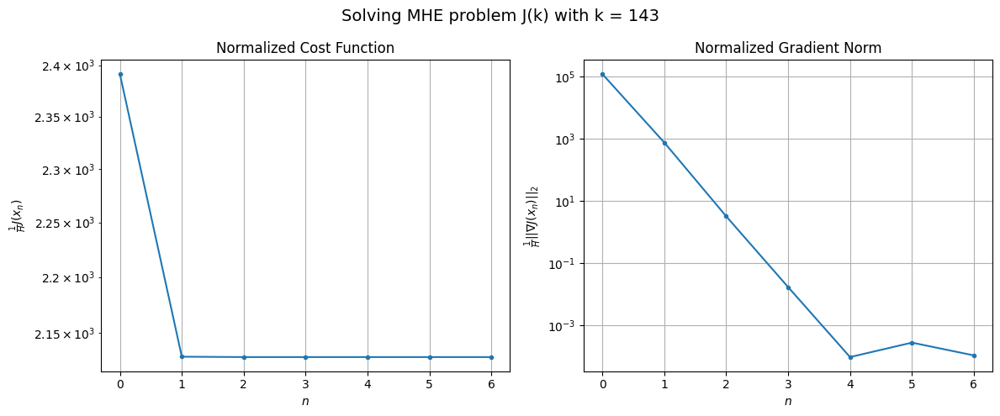

Windows:  33%|███▎      | 125/376 [10:45<17:58,  4.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 47561.63536432498
Gradient norm: 2287238.9026703862
Global estimation error: 506.43427931091503
Initial conditions estimation errors: 7.221253285983865 m, 48.89862209081916 m, 121.52685768750544 m, 489.1457837295795 m
Position estimation errors: 14.7295545205447 m, 22.222551678888824 m, 122.37652919014444 m, 399.8977946295901 m

[Gauss-Newton] Iteration 1
Cost function: 42635.898442761914 (-10.36%)
Gradient norm: 40483.77938820952 (-98.23%)
Global estimation error: 792.9039912343682 (56.57%)
Initial conditions estimation errors: 10.724179124271373 m, 75.66080447692006 m, 187.78238232800246 m, 766.5472998815734 m
Position estimation errors: 10.869180186883211 m, 27.554238072032437 m, 184.50252070641668 m, 604.2257212450364 m

[Gauss-Newton] Iteration 2
Cost function: 42586.805751549335 (-0.12%)
Gradient norm: 2112.4179189685296 (-94.78%)
Global estimation error: 850.5545651022297 (7.27%)
Initial conditions estimation errors: 10

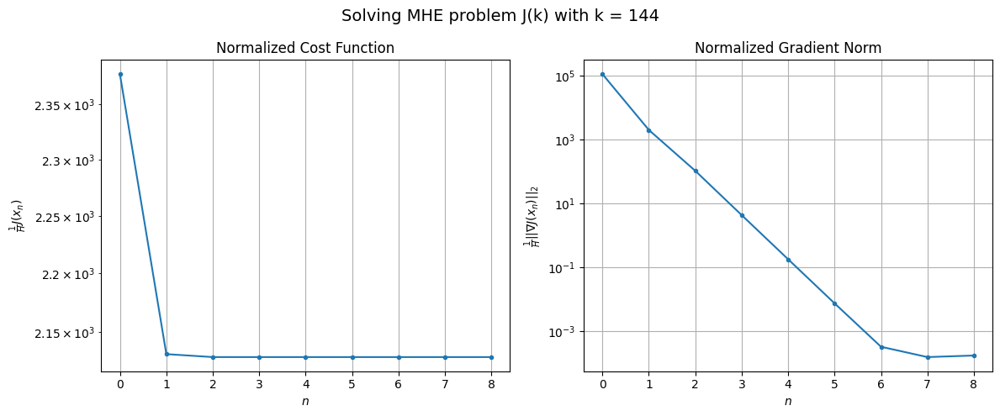

Windows:  34%|███▎      | 126/376 [10:50<19:02,  4.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 46636.73473066262
Gradient norm: 2094834.9638765864
Global estimation error: 888.8253332844968
Initial conditions estimation errors: 7.363206807390934 m, 79.1901516313416 m, 210.77051310864576 m, 859.8027565769626 m
Position estimation errors: 14.055075669122928 m, 29.42546812423005 m, 196.0042216982702 m, 627.1525498873659 m

[Gauss-Newton] Iteration 1
Cost function: 42004.71688916972 (-9.93%)
Gradient norm: 9201.023391240593 (-99.56%)
Global estimation error: 723.8220773264733 (-18.56%)
Initial conditions estimation errors: 10.804738357574653 m, 63.34071641577308 m, 174.29361562528672 m, 699.5793001879517 m
Position estimation errors: 10.420050442403474 m, 29.19812264951983 m, 167.52374222855195 m, 545.430971396868 m

[Gauss-Newton] Iteration 2
Cost function: 42001.14089510424 (-0.01%)
Gradient norm: 270.94523094606114 (-97.06%)
Global estimation error: 702.4032392396608 (-2.96%)
Initial conditions estimation errors: 10.8047

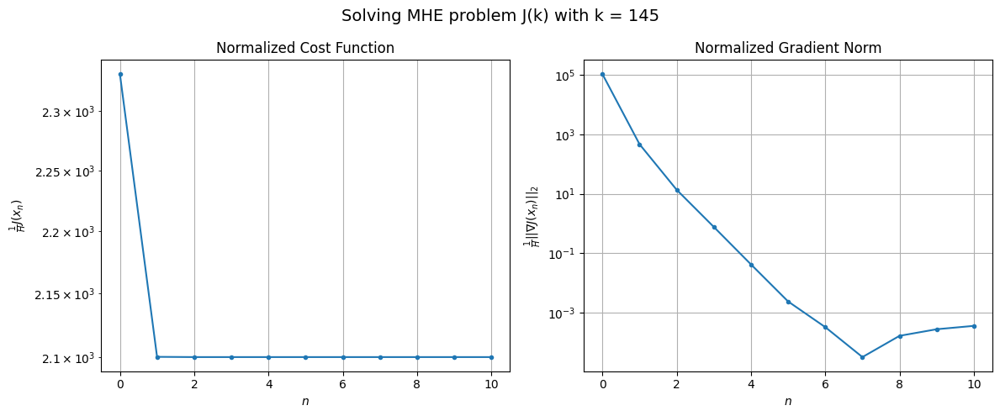

Windows:  34%|███▍      | 127/376 [10:56<21:03,  5.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 44801.781163105275
Gradient norm: 1881839.076073088
Global estimation error: 713.6629011235083
Initial conditions estimation errors: 7.5585276196999835 m, 59.415359073783875 m, 171.92976784606654 m, 690.0488877381492 m
Position estimation errors: 13.401826717337816 m, 27.473640593796777 m, 155.7161104888621 m, 488.51104375213873 m

[Gauss-Newton] Iteration 1
Cost function: 42747.69682281692 (-4.58%)
Gradient norm: 270712.78977801197 (-85.61%)
Global estimation error: 56.80692238851897 (-92.04%)
Initial conditions estimation errors: 10.957655518814102 m, 8.398698267197894 m, 9.109081215713235 m, 54.34543180557057 m
Position estimation errors: 9.974400709512311 m, 7.948729655770959 m, 12.807860687758438 m, 43.98131198659132 m

[Gauss-Newton] Iteration 2
Cost function: 40476.354375088005 (-5.31%)
Gradient norm: 20592.199548283712 (-92.39%)
Global estimation error: 253.62079224415146 (346.46%)
Initial conditions estimation errors:

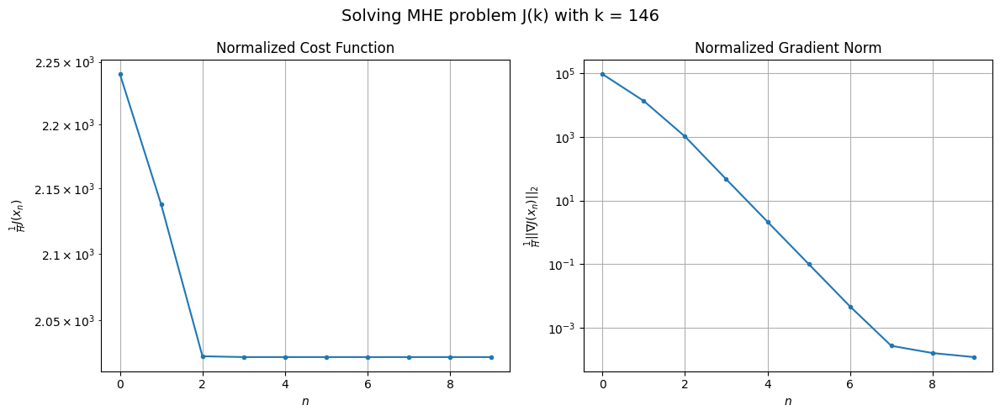

Windows:  34%|███▍      | 128/376 [11:02<21:53,  5.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 42594.10766100468
Gradient norm: 1728677.2675193378
Global estimation error: 318.86074656638294
Initial conditions estimation errors: 7.748964317982821 m, 19.497922808154865 m, 72.84511474461594 m, 309.7184276386301 m
Position estimation errors: 12.806366152487302 m, 14.513620299257555 m, 60.91201237049435 m, 218.82463700628438 m

[Gauss-Newton] Iteration 1
Cost function: 41841.346726979784 (-1.77%)
Gradient norm: 312620.43216122163 (-81.92%)
Global estimation error: 574.4412373644429 (80.15%)
Initial conditions estimation errors: 11.12333924020492 m, 53.468207884356495 m, 142.94788820772516 m, 553.6840430750129 m
Position estimation errors: 9.529836573363157 m, 8.887967598113718 m, 103.23692406048316 m, 315.7987185638983 m

[Gauss-Newton] Iteration 2
Cost function: 38453.11007201679 (-8.10%)
Gradient norm: 16613.254214858 (-94.69%)
Global estimation error: 749.706293110393 (30.51%)
Initial conditions estimation errors: 11.123

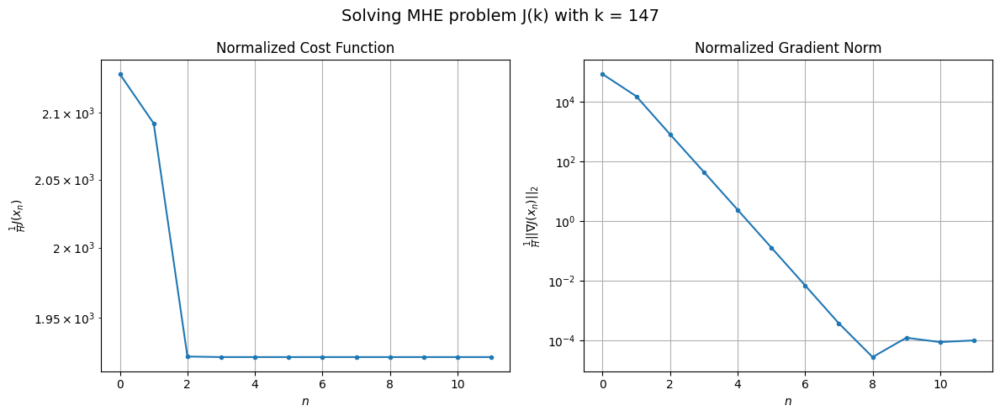

Windows:  34%|███▍      | 129/376 [11:09<23:35,  5.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 39863.420722511524
Gradient norm: 1605991.3008329067
Global estimation error: 816.8441716339822
Initial conditions estimation errors: 7.885065211807815 m, 67.6911037945664 m, 202.41130680741443 m, 788.4286439420534 m
Position estimation errors: 12.252795445829147 m, 17.051386462527823 m, 146.91476404041498 m, 459.79657830511235 m

[Gauss-Newton] Iteration 1
Cost function: 37021.1848061813 (-7.13%)
Gradient norm: 204390.51949906716 (-87.27%)
Global estimation error: 197.21792218824024 (-75.86%)
Initial conditions estimation errors: 11.221192337929075 m, 25.393835673621588 m, 51.968699301940276 m, 188.21095389473373 m
Position estimation errors: 9.105736709137242 m, 16.307869234478474 m, 15.941871459240154 m, 41.81848183829242 m

[Gauss-Newton] Iteration 2
Cost function: 35885.052207589986 (-3.07%)
Gradient norm: 320.91430910219196 (-99.84%)
Global estimation error: 170.72645381488874 (-13.43%)
Initial conditions estimation erro

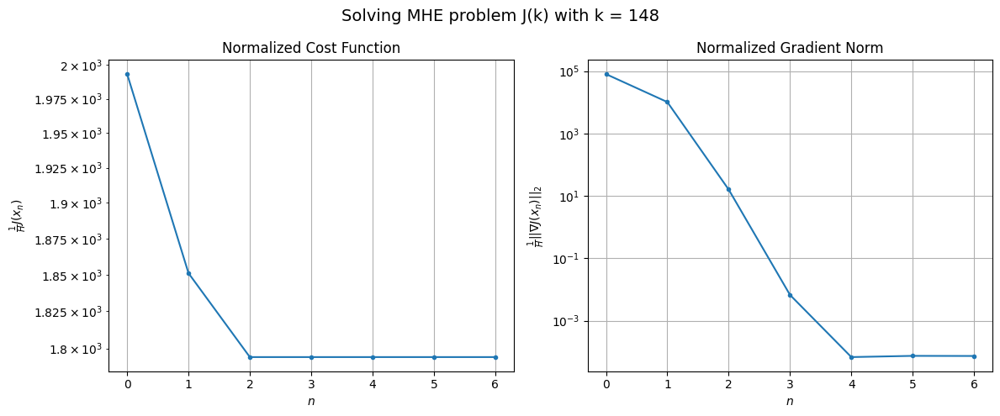

Windows:  35%|███▍      | 130/376 [11:13<21:32,  5.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 36143.605010540785
Gradient norm: 1454121.1867968852
Global estimation error: 159.4633050776497
Initial conditions estimation errors: 7.903534103535035 m, 19.57676605491373 m, 42.424675175361934 m, 152.2594278751638 m
Position estimation errors: 11.738208007935404 m, 17.62823243147218 m, 10.46498814929369 m, 68.86929798375537 m

[Gauss-Newton] Iteration 1
Cost function: 32294.269566762912 (-10.65%)
Gradient norm: 41539.903430102095 (-97.14%)
Global estimation error: 267.7393227854921 (67.90%)
Initial conditions estimation errors: 11.235539526545944 m, 24.951659139677776 m, 74.16194057633322 m, 255.8036068560356 m
Position estimation errors: 8.686070737096484 m, 16.863180401669855 m, 62.18926956653086 m, 238.14245465140516 m

[Gauss-Newton] Iteration 2
Cost function: 32267.79404777563 (-0.08%)
Gradient norm: 139.48787977923416 (-99.66%)
Global estimation error: 254.67251215965953 (-4.88%)
Initial conditions estimation errors: 1

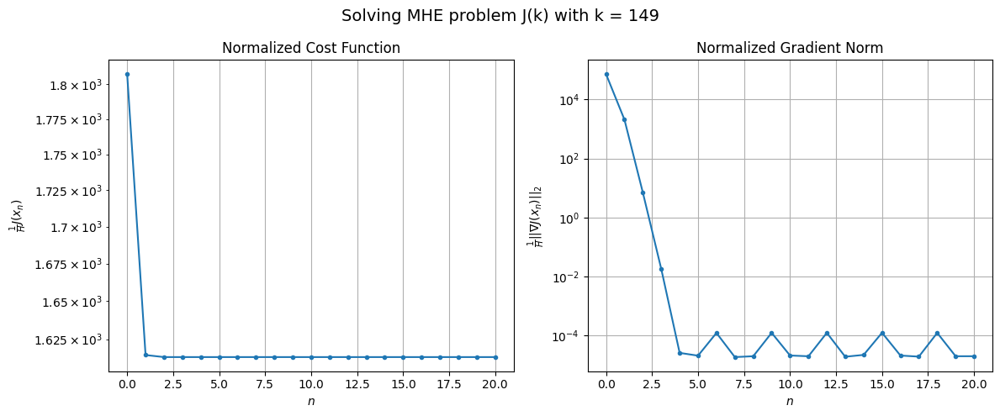

Windows:  35%|███▍      | 131/376 [11:25<29:38,  7.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 32197.99867430501
Gradient norm: 1368861.8325465182
Global estimation error: 262.0765121855116
Initial conditions estimation errors: 7.821192955697099 m, 22.15094179024163 m, 71.1453791598399 m, 251.138539163936 m
Position estimation errors: 11.232798955043668 m, 17.20923322469836 m, 57.904483182413905 m, 214.41781504080885 m

[Gauss-Newton] Iteration 1
Cost function: 37551.22906240373 (16.63%)
Gradient norm: 692854.211282916 (-49.38%)
Global estimation error: 550.976385910297 (110.23%)
Initial conditions estimation errors: 11.059912999368324 m, 25.385155539743945 m, 152.01781017781357 m, 528.8648159720456 m
Position estimation errors: 8.244648605301068 m, 92.66116077055982 m, 167.41848504965787 m, 886.1870454831242 m

[Gauss-Newton] Iteration 2
Cost function: 28794.355796194377 (-23.32%)
Gradient norm: 131518.359374801 (-81.02%)
Global estimation error: 224.41576437044625 (-59.27%)
Initial conditions estimation errors: 11.059

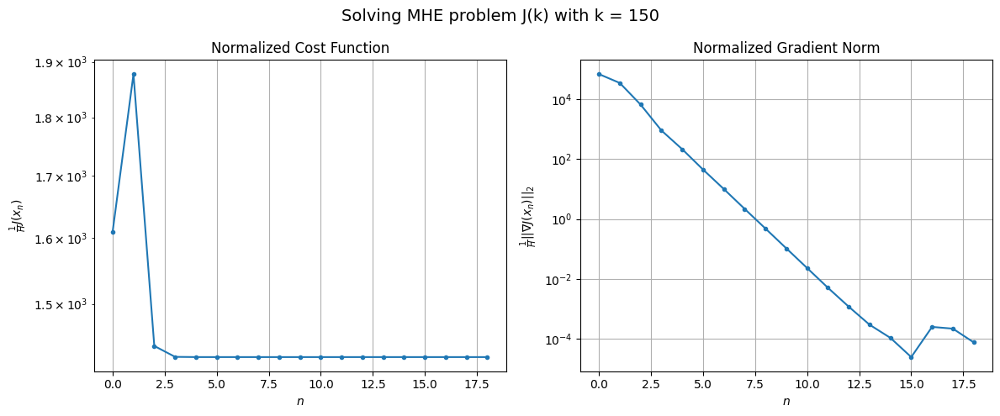

Windows:  35%|███▌      | 132/376 [11:35<33:14,  8.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28428.462481359256
Gradient norm: 1303996.9878038615
Global estimation error: 336.9713858292405
Initial conditions estimation errors: 7.568853248839264 m, 17.073896175429613 m, 88.49522492461871 m, 324.6062455578786 m
Position estimation errors: 10.706362214876679 m, 52.758996433610406 m, 88.94670531643123 m, 501.61628689708914 m

[Gauss-Newton] Iteration 1
Cost function: 26393.428366595545 (-7.16%)
Gradient norm: 267221.9421794265 (-79.51%)
Global estimation error: 884.9375485538359 (162.62%)
Initial conditions estimation errors: 10.659517845459144 m, 49.99358111034785 m, 231.41627871800023 m, 852.6116962059499 m
Position estimation errors: 7.7803256035317725 m, 116.30811534734389 m, 224.76525996877493 m, 1165.3795721030613 m

[Gauss-Newton] Iteration 2
Cost function: 24969.200400517915 (-5.40%)
Gradient norm: 22810.450033856167 (-91.46%)
Global estimation error: 741.849686359249 (-16.17%)
Initial conditions estimation errors

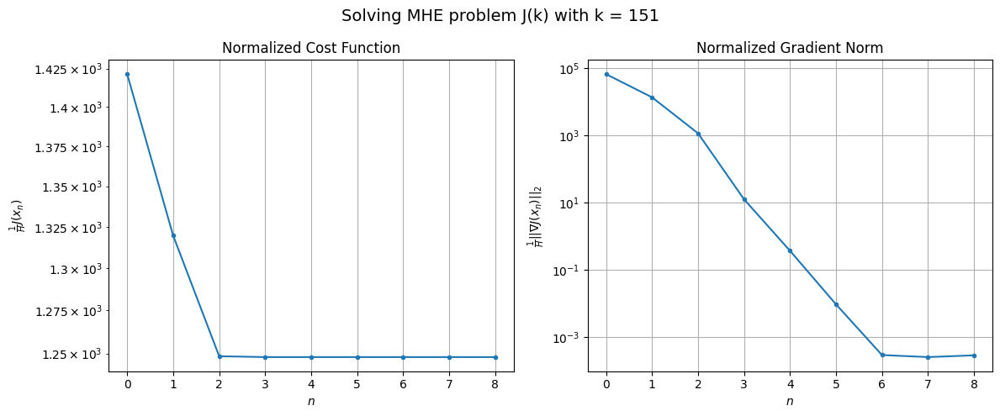

Windows:  35%|███▌      | 133/376 [11:41<29:38,  7.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 24111.798302483392
Gradient norm: 1191304.5165783486
Global estimation error: 807.7976664108695
Initial conditions estimation errors: 7.157120925790982 m, 49.923847692238056 m, 204.71284183268378 m, 779.7982392917628 m
Position estimation errors: 10.162219860228515 m, 93.61971180012185 m, 178.98962392466635 m, 947.9476073893237 m

[Gauss-Newton] Iteration 1
Cost function: 23994.6816583809 (-0.49%)
Gradient norm: 392447.1354531494 (-67.06%)
Global estimation error: 127.59035525406348 (-84.21%)
Initial conditions estimation errors: 10.144088815349873 m, 10.201526127705883 m, 28.923004009606345 m, 123.4331237724471 m
Position estimation errors: 7.337314953146421 m, 8.85728702866374 m, 25.1379571939715 m, 149.66252835356386 m

[Gauss-Newton] Iteration 2
Cost function: 20862.500843355167 (-13.05%)
Gradient norm: 1944.7660320971872 (-99.50%)
Global estimation error: 88.96168768635343 (-30.28%)
Initial conditions estimation errors: 1

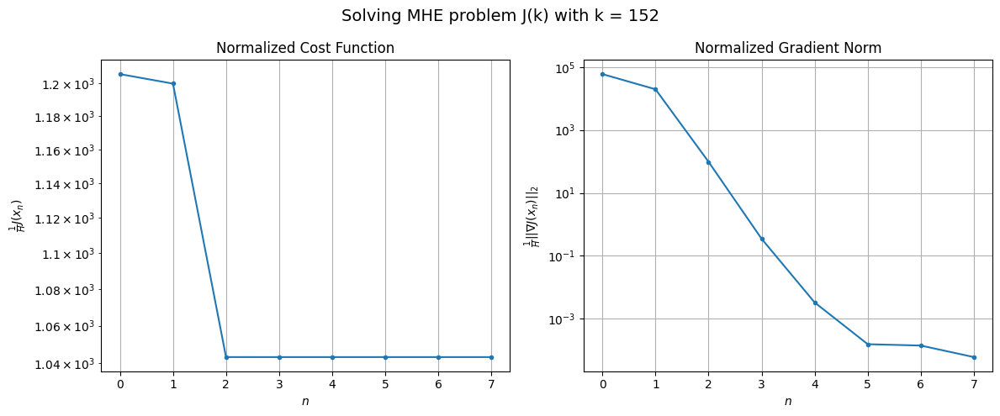

Windows:  36%|███▌      | 134/376 [11:45<26:33,  6.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20237.60034595243
Gradient norm: 1127943.933188857
Global estimation error: 97.01878987172385
Initial conditions estimation errors: 6.69928766326421 m, 7.8804780026765595 m, 20.81001046103626 m, 94.19437156505948 m
Position estimation errors: 9.654144619219878 m, 4.397489961033147 m, 13.417521433047156 m, 85.86774374198852 m

[Gauss-Newton] Iteration 1
Cost function: 17371.089420788594 (-14.16%)
Gradient norm: 15941.216401214859 (-98.59%)
Global estimation error: 29.769424839319058 (-69.32%)
Initial conditions estimation errors: 9.464681042228948 m, 7.815514054607039 m, 11.875643142689668 m, 24.38248699414012 m
Position estimation errors: 6.9627009083125815 m, 24.721962820342412 m, 15.460495954350261 m, 87.79406049253382 m

[Gauss-Newton] Iteration 2
Cost function: 17366.6197372486 (-0.03%)
Gradient norm: 21.690980936122145 (-99.86%)
Global estimation error: 27.888608050759146 (-6.32%)
Initial conditions estimation errors: 9.4

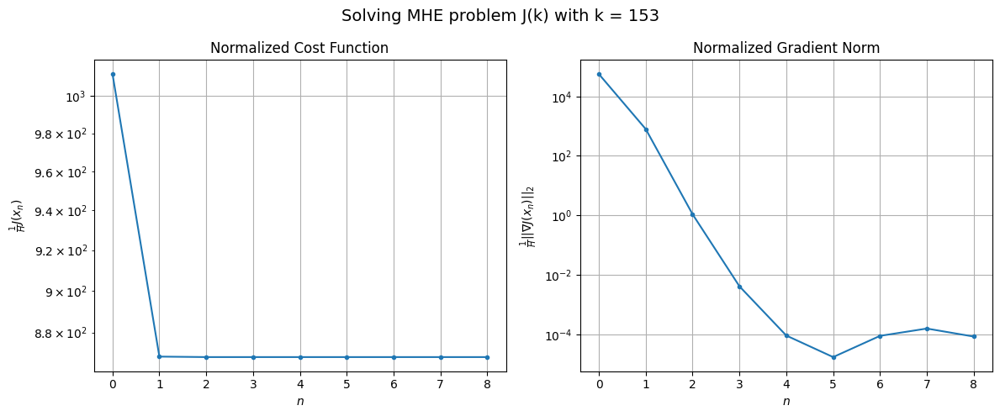

Windows:  36%|███▌      | 135/376 [11:51<24:55,  6.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 17319.40388146974
Gradient norm: 1104316.032104478
Global estimation error: 22.85906046542319
Initial conditions estimation errors: 6.1447361798260625 m, 5.070899455932717 m, 7.932270805839299 m, 19.902997895994574 m
Position estimation errors: 9.244811734566522 m, 26.91391841507241 m, 17.13484549503687 m, 85.61915268574253 m

[Gauss-Newton] Iteration 1
Cost function: 14812.581182043026 (-14.47%)
Gradient norm: 7280.063001046081 (-99.34%)
Global estimation error: 94.97426079714249 (315.48%)
Initial conditions estimation errors: 8.678713169191916 m, 9.45993580567175 m, 29.666674367019525 m, 89.30369928457735 m
Position estimation errors: 6.679047811215573 m, 38.78084390989144 m, 30.954009681973936 m, 198.53906292982336 m

[Gauss-Newton] Iteration 2
Cost function: 14811.616600707615 (-0.01%)
Gradient norm: 69.20765916227484 (-99.05%)
Global estimation error: 86.59461691831649 (-8.82%)
Initial conditions estimation errors: 8.6787

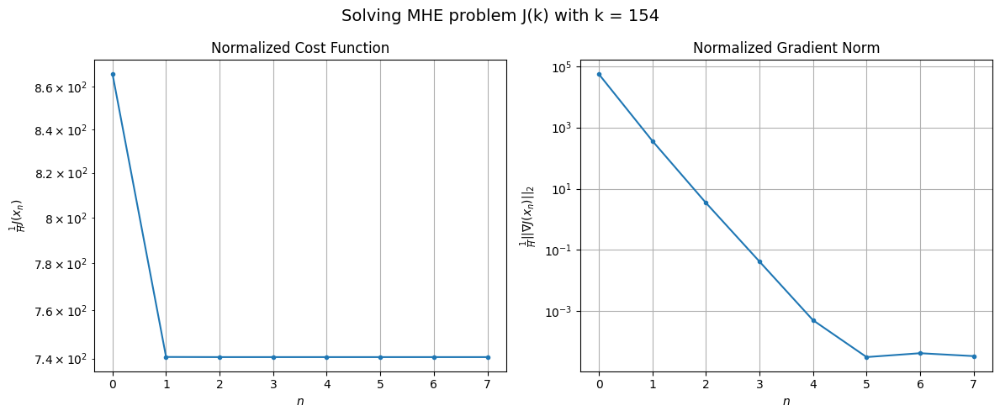

Windows:  36%|███▌      | 136/376 [11:56<23:12,  5.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15238.52367101693
Gradient norm: 1133142.5105753727
Global estimation error: 93.89900834686175
Initial conditions estimation errors: 5.54833078769652 m, 7.524275240487325 m, 26.113102393886713 m, 89.70897898408586 m
Position estimation errors: 8.95402276824464 m, 40.08661311466889 m, 30.79401815966798 m, 189.0924448308817 m

[Gauss-Newton] Iteration 1
Cost function: 13366.80910907016 (-12.28%)
Gradient norm: 151253.17743985367 (-86.65%)
Global estimation error: 519.3856836015987 (453.13%)
Initial conditions estimation errors: 7.946305022915337 m, 36.47614411531111 m, 128.97725317279068 m, 501.7293639203531 m
Position estimation errors: 6.448650076116082 m, 101.34058886701906 m, 106.24706787991428 m, 683.5913625744744 m

[Gauss-Newton] Iteration 2
Cost function: 12900.235570605664 (-3.49%)
Gradient norm: 337.1244425547248 (-99.78%)
Global estimation error: 537.9507790167221 (3.57%)
Initial conditions estimation errors: 7.946305

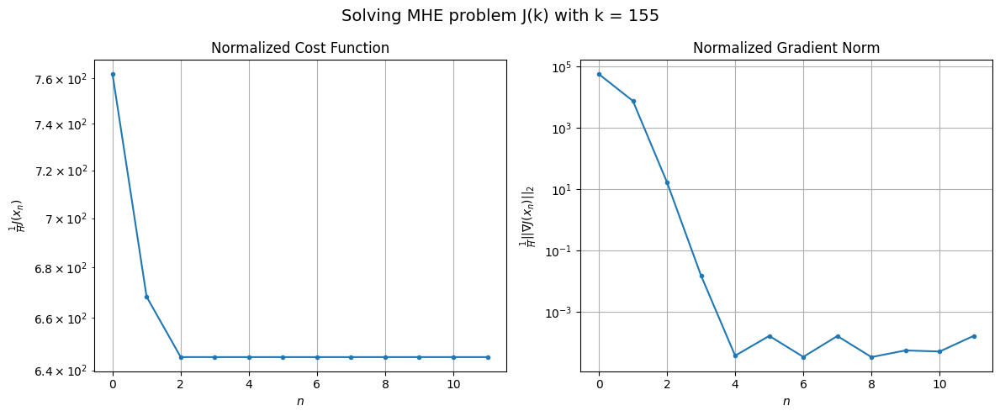

Windows:  36%|███▋      | 137/376 [12:02<24:21,  6.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13727.366926868246
Gradient norm: 1094780.9430929844
Global estimation error: 571.4275680397235
Initial conditions estimation errors: 5.03011195590435 m, 41.452196409291325 m, 134.32151142275603 m, 553.8440922814008 m
Position estimation errors: 8.719630892001367 m, 106.13006487618073 m, 106.42027254691918 m, 688.5087724617149 m

[Gauss-Newton] Iteration 1
Cost function: 11821.288624975805 (-13.89%)
Gradient norm: 44527.75371263853 (-95.93%)
Global estimation error: 351.18635816807983 (-38.54%)
Initial conditions estimation errors: 7.176150788763222 m, 25.376191557319153 m, 81.48025502293565 m, 340.58371712341767 m
Position estimation errors: 6.400912510694635 m, 67.61567421526156 m, 65.65198401062482 m, 413.052200640124 m

[Gauss-Newton] Iteration 2
Cost function: 11782.105259905346 (-0.33%)
Gradient norm: 696.3691584429783 (-98.44%)
Global estimation error: 323.1034599058709 (-8.00%)
Initial conditions estimation errors: 7.1

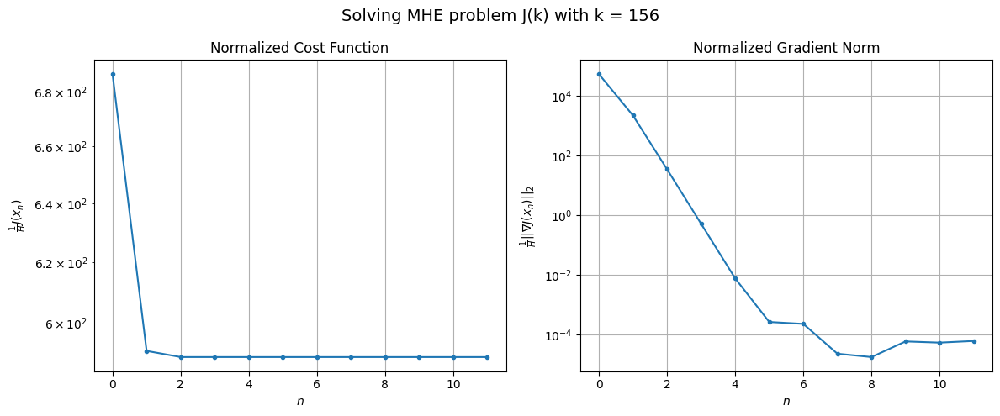

Windows:  37%|███▋      | 138/376 [12:09<24:49,  6.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13031.408002029773
Gradient norm: 1147539.1848349606
Global estimation error: 334.58796784689366
Initial conditions estimation errors: 4.526917072352384 m, 24.21818265633795 m, 73.31943380167195 m, 325.5246217170315 m
Position estimation errors: 8.692288075288221 m, 63.89866661469065 m, 59.1860787370456 m, 362.33212580478073 m

[Gauss-Newton] Iteration 1
Cost function: 11218.1149073679 (-13.91%)
Gradient norm: 18547.028149307604 (-98.38%)
Global estimation error: 177.29749517526443 (-47.01%)
Initial conditions estimation errors: 6.557495120239465 m, 13.169267832985271 m, 37.85231374490351 m, 172.58376042199112 m
Position estimation errors: 6.422893267819392 m, 38.48844677766825 m, 34.80756272126198 m, 191.94749751653197 m

[Gauss-Newton] Iteration 2
Cost function: 11210.721079909074 (-0.07%)
Gradient norm: 394.58876643080123 (-97.87%)
Global estimation error: 155.9792860125505 (-12.02%)
Initial conditions estimation errors: 6.

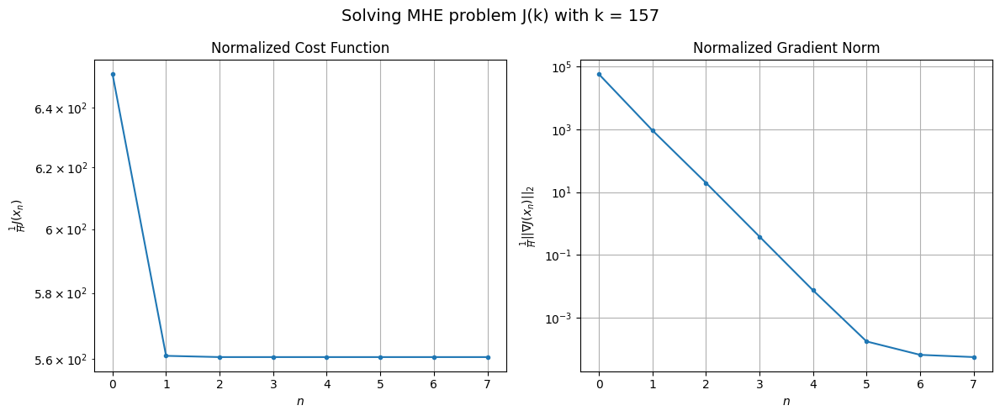

Windows:  37%|███▋      | 139/376 [12:14<22:53,  5.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13061.543260209233
Gradient norm: 1191594.8250654808
Global estimation error: 157.4852763841982
Initial conditions estimation errors: 4.200605000483365 m, 10.970908289882571 m, 30.947295690866305 m, 153.96707565055615 m
Position estimation errors: 8.767485399426239 m, 35.88714100442427 m, 31.770871038809975 m, 157.01556788791657 m

[Gauss-Newton] Iteration 1
Cost function: 11364.122554560463 (-13.00%)
Gradient norm: 4458.820728303602 (-99.63%)
Global estimation error: 210.49951636031327 (33.66%)
Initial conditions estimation errors: 6.120014453084905 m, 21.70933538013828 m, 47.98634940988387 m, 203.71198188583006 m
Position estimation errors: 6.5388274730897455 m, 43.613061228248476 m, 37.89086660351903 m, 248.75883653018178 m

[Gauss-Newton] Iteration 2
Cost function: 11363.786385292555 (-0.00%)
Gradient norm: 7.244533688807497 (-99.84%)
Global estimation error: 213.26730912383462 (1.31%)
Initial conditions estimation errors:

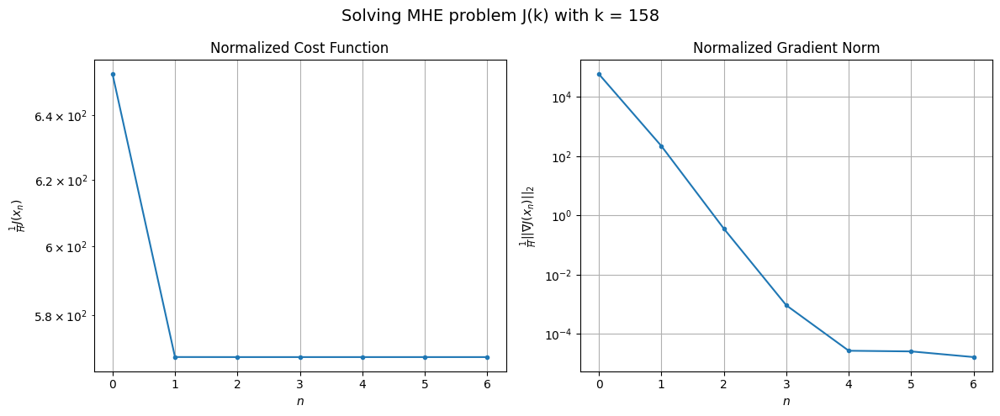

Windows:  37%|███▋      | 140/376 [12:18<21:19,  5.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13601.079174787847
Gradient norm: 1312405.0322129698
Global estimation error: 223.27684627832008
Initial conditions estimation errors: 4.071067672788017 m, 22.355450091680513 m, 47.52032070603207 m, 216.9746480423746 m
Position estimation errors: 9.032771895837787 m, 45.10899736638393 m, 38.257958248868306 m, 244.41442218144303 m

[Gauss-Newton] Iteration 1
Cost function: 11958.505377913609 (-12.08%)
Gradient norm: 19687.642538871434 (-98.50%)
Global estimation error: 359.35038320546465 (60.94%)
Initial conditions estimation errors: 5.915033320974912 m, 28.920130557422027 m, 80.8328688571445 m, 348.89434858300973 m
Position estimation errors: 6.797487563229025 m, 78.30208048731441 m, 47.79453502975916 m, 425.04356584551095 m

[Gauss-Newton] Iteration 2
Cost function: 11951.223429638238 (-0.06%)
Gradient norm: 30.817940857391193 (-99.84%)
Global estimation error: 353.6076914344658 (-1.60%)
Initial conditions estimation errors: 

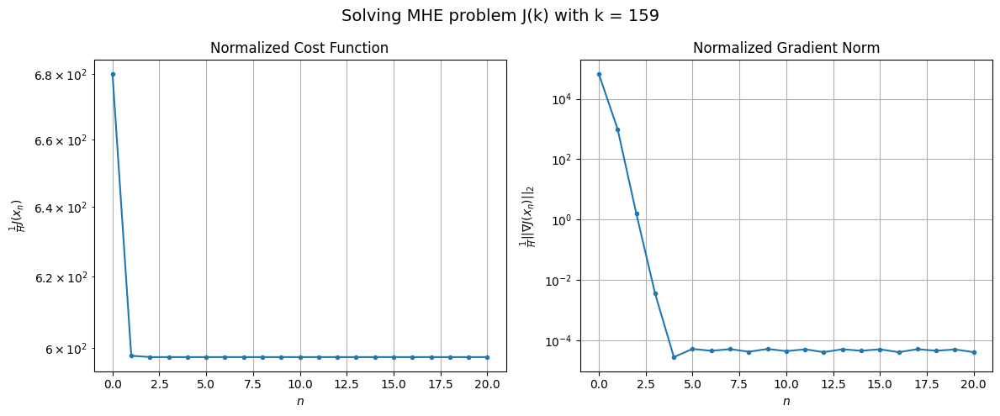

Windows:  38%|███▊      | 141/376 [12:30<29:02,  7.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14520.946572932919
Gradient norm: 1407613.6380013265
Global estimation error: 371.8922425332304
Initial conditions estimation errors: 4.120142445778028 m, 31.20861812315062 m, 77.90648939456098 m, 362.27526267794633 m
Position estimation errors: 9.559198321411777 m, 78.12790291732664 m, 46.783542224020586 m, 403.821796370782 m

[Gauss-Newton] Iteration 1
Cost function: 12820.080429657926 (-11.71%)
Gradient norm: 4249.829723593609 (-99.70%)
Global estimation error: 293.50643237899976 (-21.08%)
Initial conditions estimation errors: 5.979311463824549 m, 30.886794912329563 m, 67.41528153264929 m, 283.921457698647 m
Position estimation errors: 7.270248122443352 m, 61.63508007694534 m, 36.18783880965149 m, 326.5021395681374 m

[Gauss-Newton] Iteration 2
Cost function: 12819.64048165227 (-0.00%)
Gradient norm: 9.881051750885987 (-99.77%)
Global estimation error: 296.8431496863657 (1.14%)
Initial conditions estimation errors: 5.979311

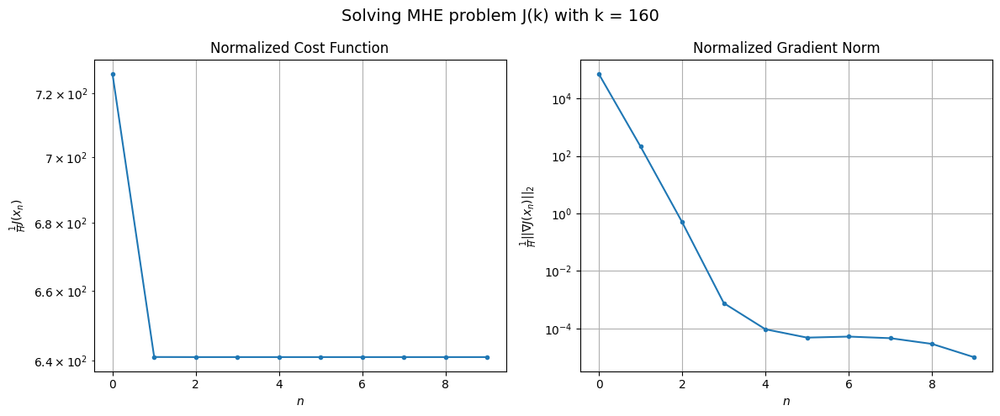

Windows:  38%|███▊      | 142/376 [12:36<27:10,  6.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16570.322868015006
Gradient norm: 1638378.145017391
Global estimation error: 310.02640801345365
Initial conditions estimation errors: 4.316972648854051 m, 32.883614921004934 m, 66.06194677703715 m, 301.0849808173108 m
Position estimation errors: 10.42114791500827 m, 62.76020011077883 m, 37.2469776858581 m, 318.10862755738606 m

[Gauss-Newton] Iteration 1
Cost function: 14631.822698827677 (-11.70%)
Gradient norm: 40.3736003570836 (-100.00%)
Global estimation error: 307.7403047867096 (-0.74%)
Initial conditions estimation errors: 6.241796629731374 m, 33.18340923032783 m, 68.19000605188036 m, 298.18461570054154 m
Position estimation errors: 7.915602445349311 m, 61.47069448159825 m, 34.4482568052989 m, 308.1452830589521 m

[Gauss-Newton] Iteration 2
Cost function: 14631.822667988807 (-0.00%)
Gradient norm: 0.013724611374535631 (-99.97%)
Global estimation error: 307.8679368009143 (0.04%)
Initial conditions estimation errors: 6.2417

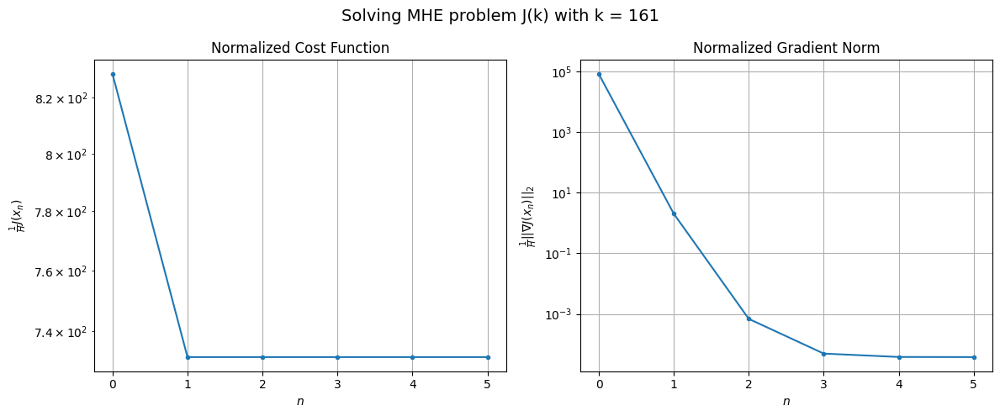

Windows:  38%|███▊      | 143/376 [12:40<23:15,  5.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 19547.878392814247
Gradient norm: 1898514.6440171336
Global estimation error: 319.58990250503365
Initial conditions estimation errors: 4.57455878567561 m, 34.95218138803465 m, 65.88776515941095 m, 310.731201001799 m
Position estimation errors: 11.496233366786985 m, 61.76099195493231 m, 35.80368198210671 m, 294.8038137972792 m

[Gauss-Newton] Iteration 1
Cost function: 17332.60250850334 (-11.33%)
Gradient norm: 81117.93976760871 (-95.73%)
Global estimation error: 37.34480188384964 (-88.31%)
Initial conditions estimation errors: 6.660186149228807 m, 12.072013342688638 m, 6.090597677883854 m, 34.167661977857115 m
Position estimation errors: 8.70348127929258 m, 12.411527931885491 m, 9.097640177096554 m, 72.74886288294186 m

[Gauss-Newton] Iteration 2
Cost function: 17205.52054546479 (-0.73%)
Gradient norm: 124.02423485088724 (-99.85%)
Global estimation error: 47.712089334401476 (27.76%)
Initial conditions estimation errors: 6.6601

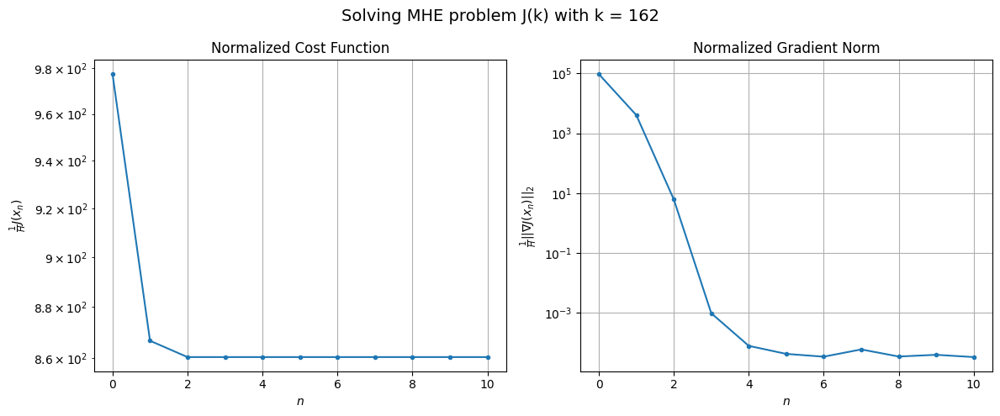

Windows:  38%|███▊      | 144/376 [12:46<23:32,  6.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22911.14223758697
Gradient norm: 2105540.847200781
Global estimation error: 40.43714438437955
Initial conditions estimation errors: 4.859519090283237 m, 10.398470799892117 m, 5.463766764801129 m, 38.386874247353724 m
Position estimation errors: 12.671317069009595 m, 14.458516052994124 m, 12.223758050974329 m, 64.82265832059797 m

[Gauss-Newton] Iteration 1
Cost function: 20353.800627076696 (-11.16%)
Gradient norm: 101847.27879584885 (-95.16%)
Global estimation error: 292.94419192977745 (624.44%)
Initial conditions estimation errors: 7.135625490504986 m, 20.859488593059712 m, 69.29936109945055 m, 283.773924289531 m
Position estimation errors: 9.620335110590602 m, 88.92211050370808 m, 38.90343731970197 m, 457.98102264240805 m

[Gauss-Newton] Iteration 2
Cost function: 20149.107065354205 (-1.01%)
Gradient norm: 94.19604572450858 (-99.91%)
Global estimation error: 283.7467884528063 (-3.14%)
Initial conditions estimation errors: 7.

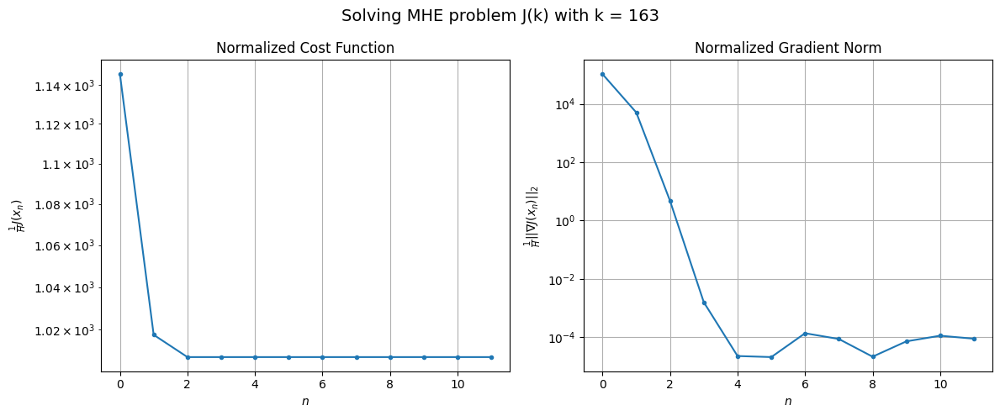

Windows:  39%|███▊      | 145/376 [12:54<24:53,  6.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27145.787817724216
Gradient norm: 2387694.5221130108
Global estimation error: 308.6993946143018
Initial conditions estimation errors: 5.127171306773065 m, 26.87007168200773 m, 65.6722455255435 m, 300.38973589717176 m
Position estimation errors: 13.89469805083453 m, 86.93062563336449 m, 41.613759821505155 m, 435.499092215104 m

[Gauss-Newton] Iteration 1
Cost function: 23781.18514539922 (-12.39%)
Gradient norm: 2708.0224463681434 (-99.89%)
Global estimation error: 341.2343300343131 (10.54%)
Initial conditions estimation errors: 7.635057489297991 m, 26.574905170694503 m, 75.9156724227873 m, 331.5311381097104 m
Position estimation errors: 10.48891375311057 m, 105.26657760003295 m, 49.59742790112629 m, 507.47269890146714 m

[Gauss-Newton] Iteration 2
Cost function: 23781.064432601244 (-0.00%)
Gradient norm: 6.447569722764023 (-99.76%)
Global estimation error: 343.38273279641186 (0.63%)
Initial conditions estimation errors: 7.63505

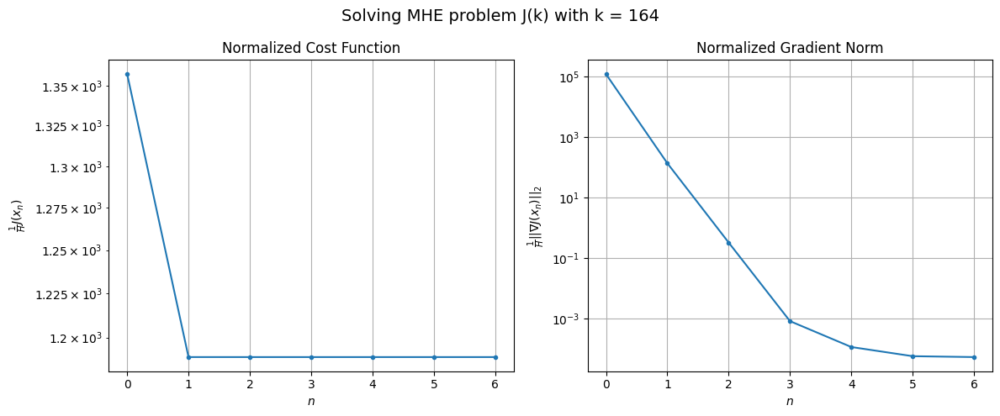

Windows:  39%|███▉      | 146/376 [12:58<22:17,  5.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 32053.14849374423
Gradient norm: 2616627.0272484194
Global estimation error: 371.1766762895878
Initial conditions estimation errors: 5.402658298971438 m, 34.23641096426836 m, 73.85596764451152 m, 362.0992421149412 m
Position estimation errors: 14.967830070873934 m, 106.76018932389879 m, 54.928923382242225 m, 498.2166689660702 m

[Gauss-Newton] Iteration 1
Cost function: 28400.203476699062 (-11.40%)
Gradient norm: 122809.42778779662 (-95.31%)
Global estimation error: 77.74859918342044 (-79.05%)
Initial conditions estimation errors: 8.100636898219154 m, 12.827677256906139 m, 7.925789742167324 m, 75.84094182684427 m
Position estimation errors: 11.264137380443096 m, 10.326011855823396 m, 15.387538642144277 m, 38.503761549220215 m

[Gauss-Newton] Iteration 2
Cost function: 28128.94933832751 (-0.96%)
Gradient norm: 1050.5803736682712 (-99.14%)
Global estimation error: 53.834554502060485 (-30.76%)
Initial conditions estimation errors

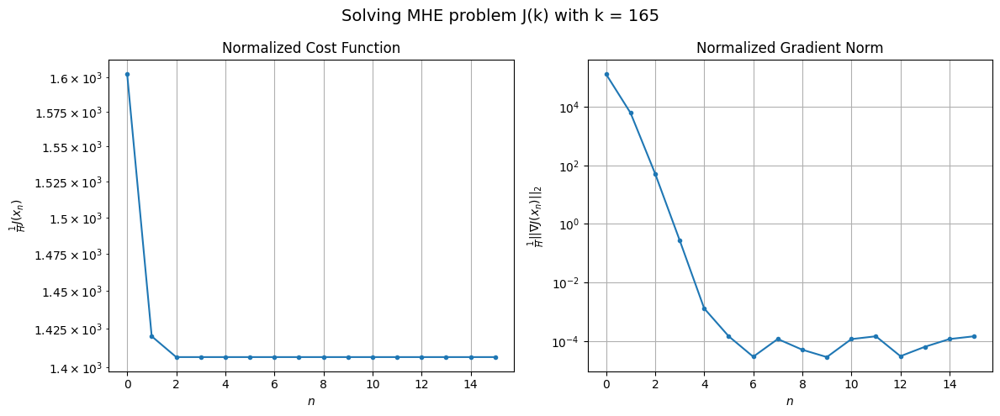

Windows:  39%|███▉      | 147/376 [13:07<26:01,  6.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 37292.84051666401
Gradient norm: 2784594.6999451434
Global estimation error: 50.02374357816849
Initial conditions estimation errors: 5.677501114230474 m, 10.733148075710876 m, 2.8279176303648055 m, 48.44519504026645 m
Position estimation errors: 15.842678898389003 m, 13.52472586224954 m, 15.554542135606072 m, 18.059865463523373 m

[Gauss-Newton] Iteration 1
Cost function: 32902.89403898538 (-11.77%)
Gradient norm: 107.87146005343568 (-100.00%)
Global estimation error: 65.48470984528987 (30.91%)
Initial conditions estimation errors: 8.537168563665924 m, 15.148959388957337 m, 7.1588283486391635 m, 62.72651163872995 m
Position estimation errors: 11.906968970654122 m, 12.63592843297199 m, 11.289600942300236 m, 22.72257311267734 m

[Gauss-Newton] Iteration 2
Cost function: 32902.89367641561 (-0.00%)
Gradient norm: 3.5841088735232565 (-96.68%)
Global estimation error: 66.73564089021782 (1.91%)
Initial conditions estimation errors: 8

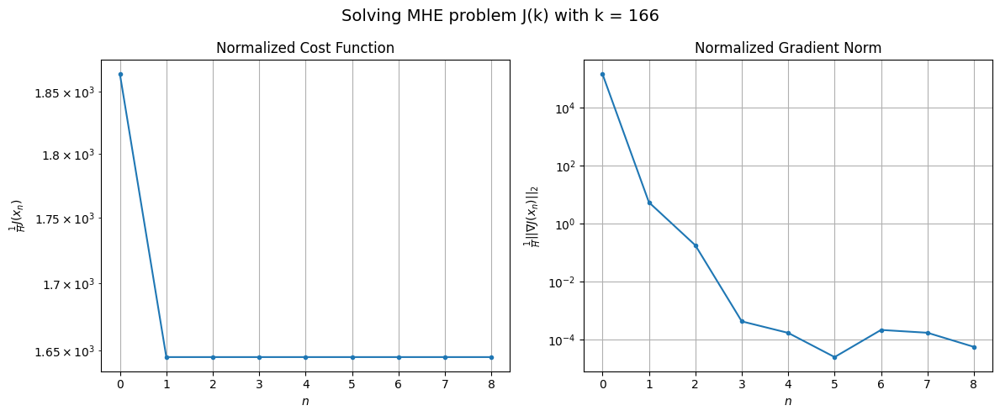

Windows:  39%|███▉      | 148/376 [13:12<24:05,  6.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 42986.68620438405
Gradient norm: 2918096.0214338447
Global estimation error: 63.63843570326217
Initial conditions estimation errors: 5.9728253140391985 m, 14.217722944148342 m, 5.930980496007731 m, 61.456063094262284 m
Position estimation errors: 16.430458258004446 m, 15.80909643172423 m, 15.34300357344729 m, 26.058493558726916 m

[Gauss-Newton] Iteration 1
Cost function: 38080.26680224557 (-11.41%)
Gradient norm: 260.4295207956829 (-99.99%)
Global estimation error: 65.92109270004347 (3.59%)
Initial conditions estimation errors: 9.005946860196568 m, 12.773962444647182 m, 6.861554015056159 m, 63.67274944777747 m
Position estimation errors: 12.259872408991505 m, 9.518453908569079 m, 11.856055389431253 m, 9.589797637337293 m

[Gauss-Newton] Iteration 2
Cost function: 38080.2656658676 (-0.00%)
Gradient norm: 0.0825071563442743 (-99.97%)
Global estimation error: 65.67460455774028 (-0.37%)
Initial conditions estimation errors: 9.005

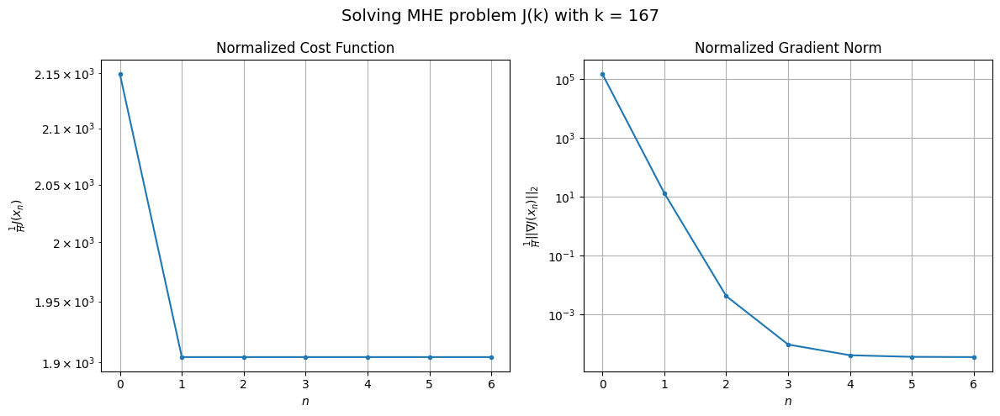

Windows:  40%|███▉      | 149/376 [13:17<21:43,  5.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 47761.489644388996
Gradient norm: 2865071.6551282215
Global estimation error: 63.668447212231634
Initial conditions estimation errors: 6.3308093290829115 m, 11.556704562055955 m, 4.887509164091238 m, 62.09781708676585 m
Position estimation errors: 16.521768781014245 m, 13.26254040089812 m, 15.335402086672465 m, 13.26435445917771 m

[Gauss-Newton] Iteration 1
Cost function: 42790.85775672774 (-10.41%)
Gradient norm: 5705.53618443374 (-99.80%)
Global estimation error: 30.811333082011316 (-51.61%)
Initial conditions estimation errors: 9.441711065314443 m, 9.044067715932481 m, 13.001257779618308 m, 24.684772587302344 m
Position estimation errors: 12.364374344930303 m, 21.257793209733414 m, 9.625731062871196 m, 108.21368224600415 m

[Gauss-Newton] Iteration 2
Cost function: 42790.30415399965 (-0.00%)
Gradient norm: 7.741134664025812 (-99.86%)
Global estimation error: 31.97226104784521 (3.77%)
Initial conditions estimation errors: 9

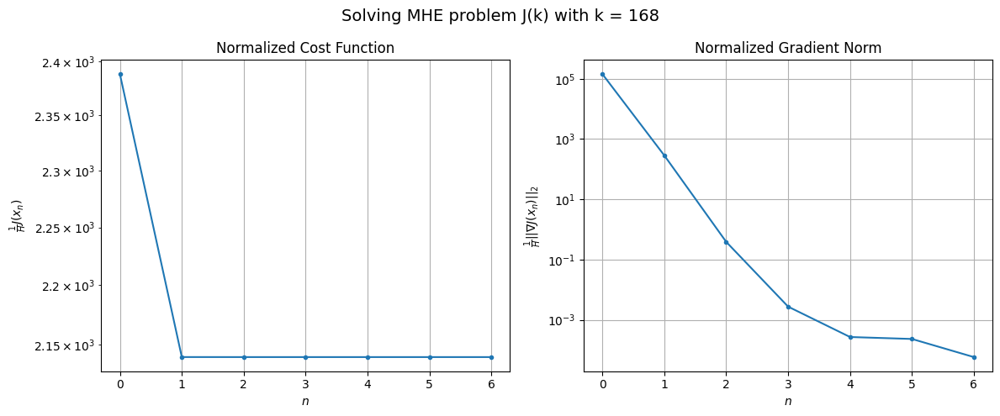

Windows:  40%|███▉      | 150/376 [13:21<20:13,  5.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 51667.48404520057
Gradient norm: 2771499.91477529
Global estimation error: 23.145511674842755
Initial conditions estimation errors: 6.6740651056461875 m, 6.316769760742342 m, 11.271808914485298 m, 18.005313448742523 m
Position estimation errors: 16.201892182815882 m, 21.153474618525465 m, 10.768254167693 m, 107.73398367649754 m

[Gauss-Newton] Iteration 1
Cost function: 46623.19641776458 (-9.76%)
Gradient norm: 27722.41969836461 (-99.00%)
Global estimation error: 118.50025519525579 (411.98%)
Initial conditions estimation errors: 9.902449538943202 m, 12.657728935786292 m, 22.688384818954386 m, 115.19221794230513 m
Position estimation errors: 12.082761795144899 m, 36.9961720069119 m, 29.414928367506736 m, 117.24505432321307 m

[Gauss-Newton] Iteration 2
Cost function: 46610.14785808718 (-0.03%)
Gradient norm: 7.559725104658422 (-99.97%)
Global estimation error: 117.3797330955271 (-0.95%)
Initial conditions estimation errors: 9.9

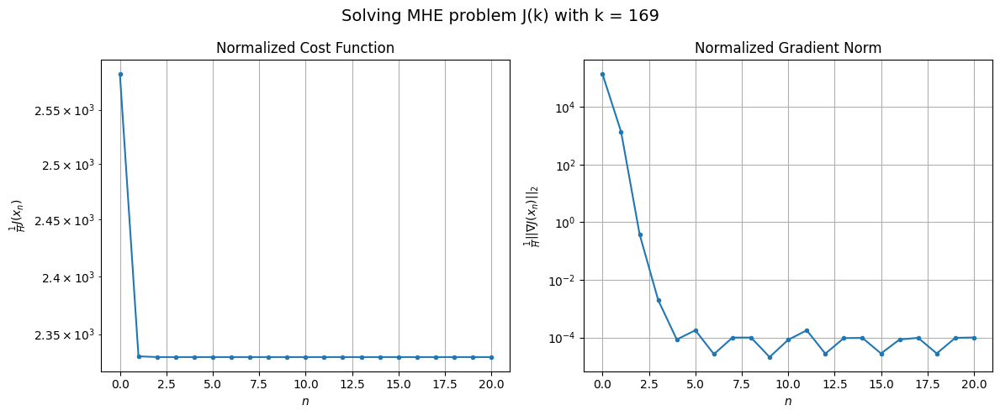

Windows:  40%|████      | 151/376 [13:33<27:53,  7.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 54150.283497515346
Gradient norm: 2553971.8872450604
Global estimation error: 121.79483589572065
Initial conditions estimation errors: 7.051650453450006 m, 13.04917231715458 m, 19.105956924055224 m, 119.36883390214066 m
Position estimation errors: 15.393408864691057 m, 38.18211105386392 m, 31.49037942956685 m, 109.04348994193802 m

[Gauss-Newton] Iteration 1
Cost function: 49342.117070335335 (-8.88%)
Gradient norm: 679.173639624076 (-99.97%)
Global estimation error: 56.4053086594216 (-53.69%)
Initial conditions estimation errors: 10.295474668689282 m, 9.36142031404497 m, 23.474202810839877 m, 49.3643979733839 m
Position estimation errors: 11.486794955330648 m, 46.76746519377949 m, 30.890689613201253 m, 161.46861674431398 m

[Gauss-Newton] Iteration 2
Cost function: 49342.07784929673 (-0.00%)
Gradient norm: 0.19679295791372894 (-99.97%)
Global estimation error: 56.89797558025173 (0.87%)
Initial conditions estimation errors: 10.

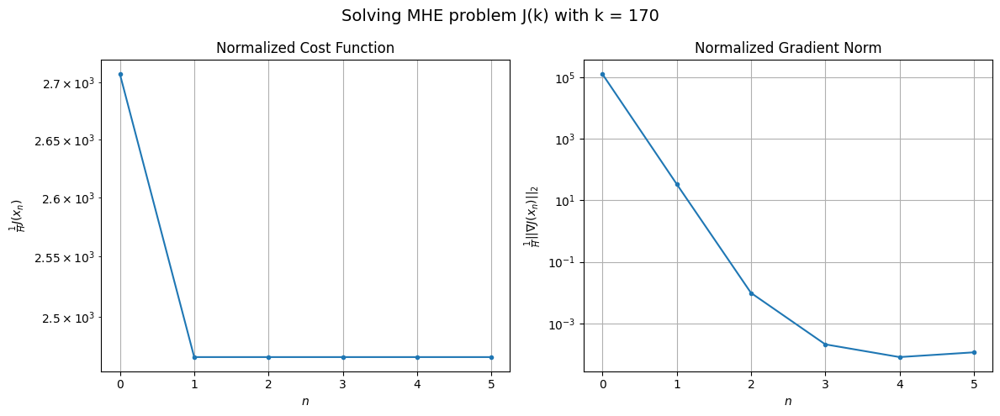

Windows:  40%|████      | 152/376 [13:37<23:27,  6.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 54242.43485410813
Gradient norm: 2218180.8377750367
Global estimation error: 63.71653522331076
Initial conditions estimation errors: 7.3664298974373885 m, 5.422293158271321 m, 19.76387806874075 m, 59.87888410801862 m
Position estimation errors: 14.264425628765325 m, 49.726088543908595 m, 33.714077252113725 m, 161.59804266199833 m

[Gauss-Newton] Iteration 1
Cost function: 49753.83108176902 (-8.28%)
Gradient norm: 67.57383431165621 (-100.00%)
Global estimation error: 58.198072660806325 (-8.66%)
Initial conditions estimation errors: 10.680333709980799 m, 8.11881628590694 m, 23.836174887635313 m, 51.3694364753973 m
Position estimation errors: 10.699895201344177 m, 50.817804551042585 m, 34.351136098579566 m, 175.29344480075795 m

[Gauss-Newton] Iteration 2
Cost function: 49753.83097344989 (-0.00%)
Gradient norm: 0.0017146858306436928 (-100.00%)
Global estimation error: 58.24951130876159 (0.09%)
Initial conditions estimation errors

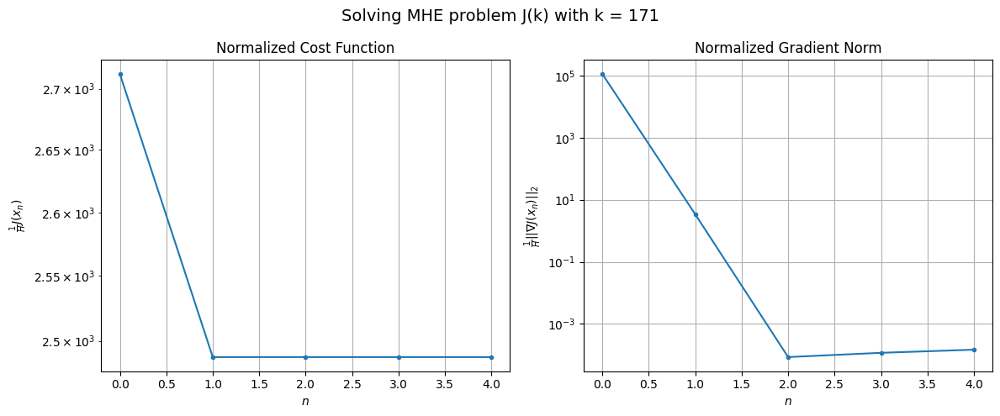

Windows:  41%|████      | 153/376 [13:40<19:58,  5.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 52451.100615082425
Gradient norm: 1826410.0590188617
Global estimation error: 65.7646605994373
Initial conditions estimation errors: 7.67080877760113 m, 4.8999366974074885 m, 20.028228131388413 m, 61.97551997314471 m
Position estimation errors: 13.010485869089878 m, 53.786204564705734 m, 36.83864298571351 m, 176.4719555838338 m

[Gauss-Newton] Iteration 1
Cost function: 48437.70630084233 (-7.65%)
Gradient norm: 12403.421321669033 (-99.32%)
Global estimation error: 46.57661800478479 (-29.18%)
Initial conditions estimation errors: 10.935211118961481 m, 16.59225846102205 m, 17.072858758701923 m, 38.50974628413567 m
Position estimation errors: 9.848985871323757 m, 16.475555169914692 m, 13.366832025796636 m, 48.136004193912065 m

[Gauss-Newton] Iteration 2
Cost function: 48434.80118225376 (-0.01%)
Gradient norm: 0.7487367705720186 (-99.99%)
Global estimation error: 46.30614522475158 (-0.58%)
Initial conditions estimation errors: 10

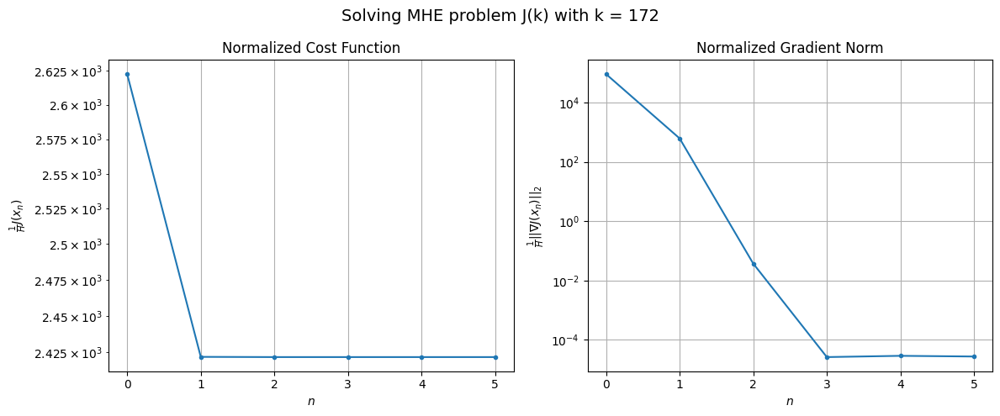

Windows:  41%|████      | 154/376 [13:44<18:12,  4.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 49457.9393027728
Gradient norm: 1461821.994583388
Global estimation error: 40.598545759665654
Initial conditions estimation errors: 7.866967738686178 m, 14.655728719204276 m, 13.597878446718413 m, 34.44771455542146 m
Position estimation errors: 11.808815193230306 m, 19.90696110221975 m, 15.719463370000549 m, 54.28244200657817 m

[Gauss-Newton] Iteration 1
Cost function: 45906.41708999536 (-7.18%)
Gradient norm: 116.28356473267883 (-99.99%)
Global estimation error: 24.11560047119792 (-40.60%)
Initial conditions estimation errors: 11.032817912066157 m, 10.48776226580164 m, 16.960444267645837 m, 7.884994076514614 m
Position estimation errors: 9.056066627422082 m, 16.141305376706278 m, 13.70774807455808 m, 49.70289738675383 m

[Gauss-Newton] Iteration 2
Cost function: 45906.415090771436 (-0.00%)
Gradient norm: 0.03199108603785085 (-99.97%)
Global estimation error: 24.074568741042846 (-0.17%)
Initial conditions estimation errors: 1

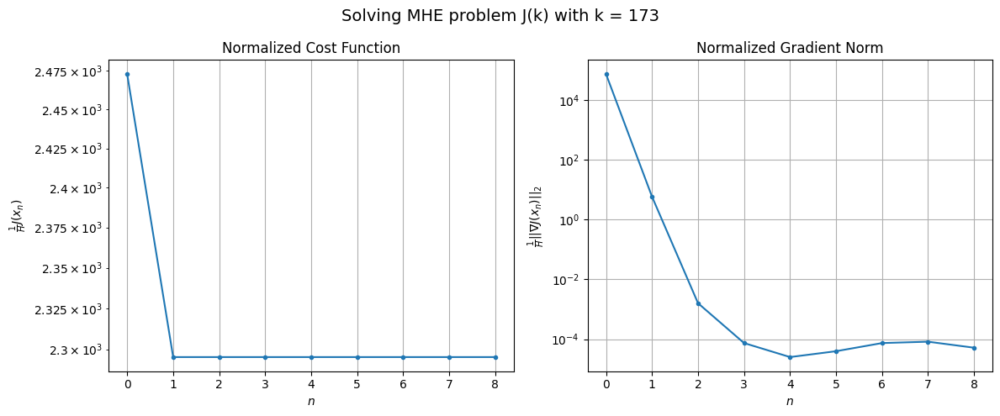

Windows:  41%|████      | 155/376 [13:49<18:19,  4.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 45803.94418972301
Gradient norm: 1140819.4399163895
Global estimation error: 18.361564267875398
Initial conditions estimation errors: 7.935006627649651 m, 7.8394093526779445 m, 13.3273239018608 m, 5.9240600611627725 m
Position estimation errors: 10.834356635697086 m, 18.546541249677635 m, 15.30446260219949 m, 51.98621034559886 m

[Gauss-Newton] Iteration 1
Cost function: 42738.17864279838 (-6.69%)
Gradient norm: 6427.722648271518 (-99.44%)
Global estimation error: 38.81700740184488 (111.40%)
Initial conditions estimation errors: 10.924362935057317 m, 7.630793440554356 m, 10.988835172830534 m, 34.76227625844745 m
Position estimation errors: 8.496113879911158 m, 21.17998913012076 m, 21.787880363818648 m, 55.70010435375194 m

[Gauss-Newton] Iteration 2
Cost function: 42737.497121942804 (-0.00%)
Gradient norm: 9.415675535658517 (-99.85%)
Global estimation error: 36.70039358723242 (-5.45%)
Initial conditions estimation errors: 10.9

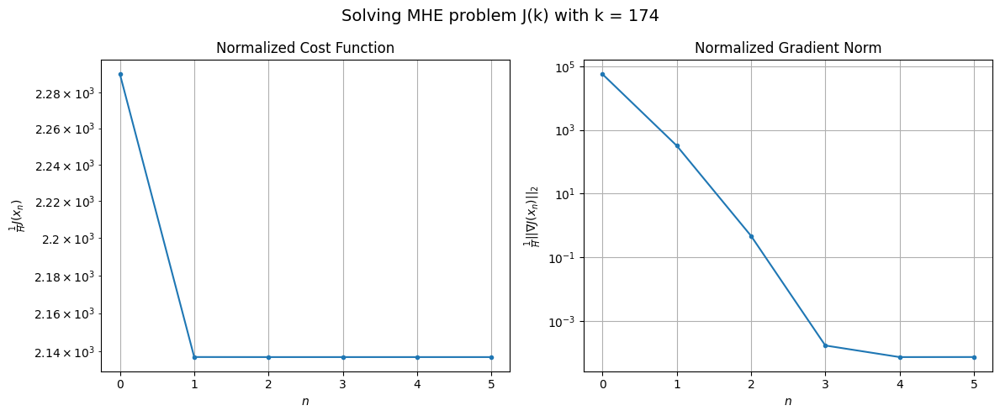

Windows:  41%|████▏     | 156/376 [13:53<16:42,  4.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 41898.11309331484
Gradient norm: 941830.3099325141
Global estimation error: 37.74458057365777
Initial conditions estimation errors: 7.84139243838483 m, 5.708410328494111 m, 9.150598380073829 m, 35.3104754038082 m
Position estimation errors: 10.297434025789782 m, 19.7424617856909 m, 23.39438665835805 m, 50.3697102148009 m

[Gauss-Newton] Iteration 1
Cost function: 39170.43140347204 (-6.51%)
Gradient norm: 115.55353174341694 (-99.99%)
Global estimation error: 42.17417734104731 (11.74%)
Initial conditions estimation errors: 10.676933623373452 m, 8.000938662335319 m, 11.684804828802879 m, 38.26346400965988 m
Position estimation errors: 8.284300068225004 m, 25.06358380950621 m, 28.13288313150149 m, 63.84996275681139 m

[Gauss-Newton] Iteration 2
Cost function: 39170.43119549436 (-0.00%)
Gradient norm: 0.014613609437073797 (-99.99%)
Global estimation error: 42.08230945561338 (-0.22%)
Initial conditions estimation errors: 10.67693361

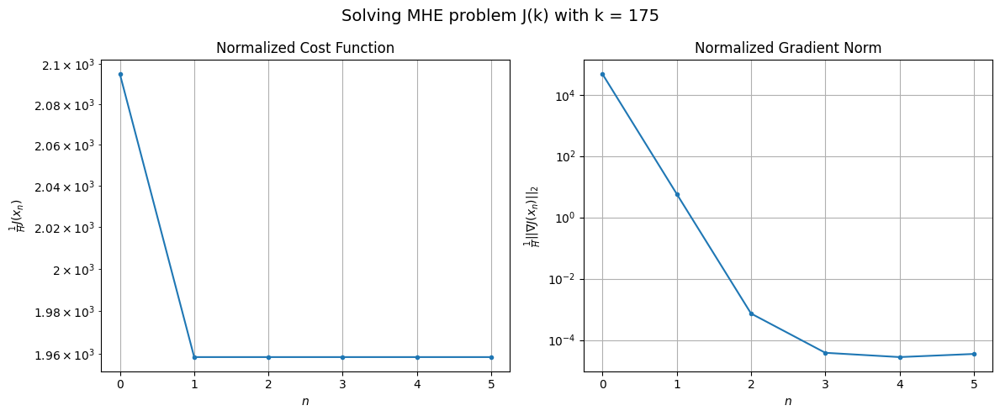

Windows:  42%|████▏     | 157/376 [13:56<15:36,  4.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 38574.16599012704
Gradient norm: 971512.54540759
Global estimation error: 44.054200870153444
Initial conditions estimation errors: 7.65681753387204 m, 6.209612437032403 m, 9.981155116251582 m, 41.760543080658664 m
Position estimation errors: 10.303588400571448 m, 24.580000600177637 m, 30.86512865028095 m, 61.61285308689895 m

[Gauss-Newton] Iteration 1
Cost function: 36114.5992820288 (-6.38%)
Gradient norm: 1479.613604084328 (-99.85%)
Global estimation error: 38.249273217651506 (-13.18%)
Initial conditions estimation errors: 10.261610677106859 m, 16.541662205146665 m, 16.391563439215158 m, 28.554769203018633 m
Position estimation errors: 8.423213738336853 m, 15.75957837756219 m, 16.295397544320323 m, 41.57738766352531 m

[Gauss-Newton] Iteration 2
Cost function: 36114.508646125825 (-0.00%)
Gradient norm: 0.002926173312123928 (-100.00%)
Global estimation error: 38.16735739173125 (-0.21%)
Initial conditions estimation errors: 10

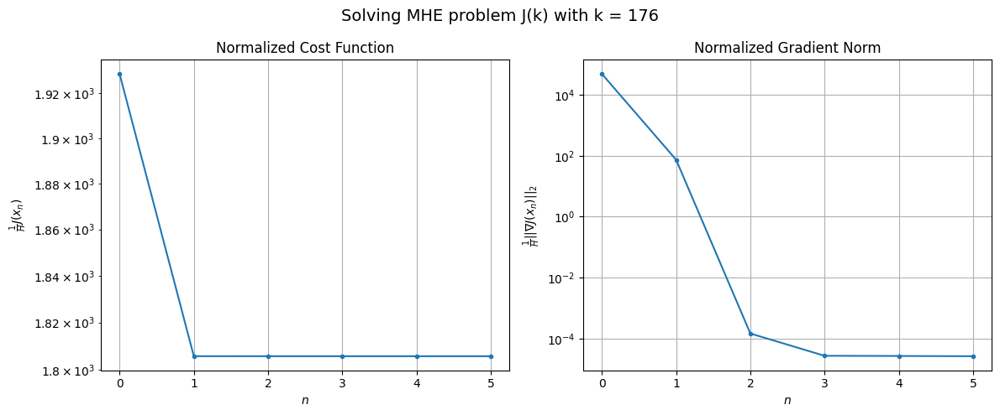

Windows:  42%|████▏     | 158/376 [14:00<14:50,  4.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 36590.138106633436
Gradient norm: 1211185.3535137328
Global estimation error: 31.497017479917254
Initial conditions estimation errors: 7.394388714456998 m, 13.23926515951253 m, 15.776596038456454 m, 22.653603791480382 m
Position estimation errors: 10.811077387648702 m, 16.634672434438055 m, 19.74572503145841 m, 43.36899270927772 m

[Gauss-Newton] Iteration 1
Cost function: 34281.31540007413 (-6.31%)
Gradient norm: 691.6578465126855 (-99.94%)
Global estimation error: 45.9682284970511 (45.94%)
Initial conditions estimation errors: 9.745206484602248 m, 18.21790710917945 m, 15.264178994303542 m, 38.120926185761675 m
Position estimation errors: 8.881744098474988 m, 9.620232798253474 m, 11.645376605807408 m, 13.895109578618792 m

[Gauss-Newton] Iteration 2
Cost function: 34281.30726274733 (-0.00%)
Gradient norm: 0.021270612828036693 (-100.00%)
Global estimation error: 46.072270013801 (0.23%)
Initial conditions estimation errors: 9.7

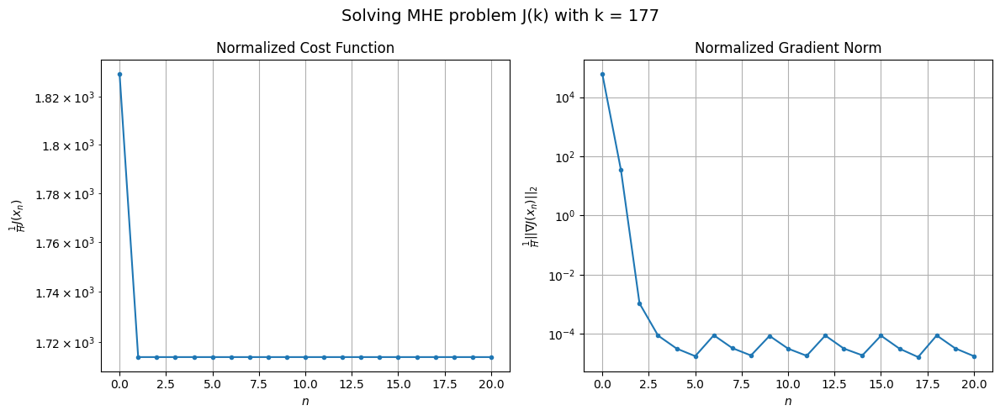

Windows:  42%|████▏     | 159/376 [14:11<22:36,  6.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 36373.956521306645
Gradient norm: 1523190.8264295117
Global estimation error: 41.25024370239826
Initial conditions estimation errors: 7.11251300706553 m, 15.553753173628046 m, 14.911056198973718 m, 34.44881115397492 m
Position estimation errors: 11.692808555244406 m, 11.158403780016544 m, 15.276577812817958 m, 16.058310434490917 m

[Gauss-Newton] Iteration 1
Cost function: 34080.950746747716 (-6.30%)
Gradient norm: 1079.2641570024932 (-99.93%)
Global estimation error: 46.67438129241326 (13.15%)
Initial conditions estimation errors: 9.230762746615007 m, 16.372835144550077 m, 16.252494302843974 m, 39.510326604113615 m
Position estimation errors: 9.550439246234948 m, 12.523281271120496 m, 9.077430546448467 m, 31.844931847803007 m

[Gauss-Newton] Iteration 2
Cost function: 34080.93176032802 (-0.00%)
Gradient norm: 0.3293972656725714 (-99.97%)
Global estimation error: 47.52534103861871 (1.82%)
Initial conditions estimation errors: 

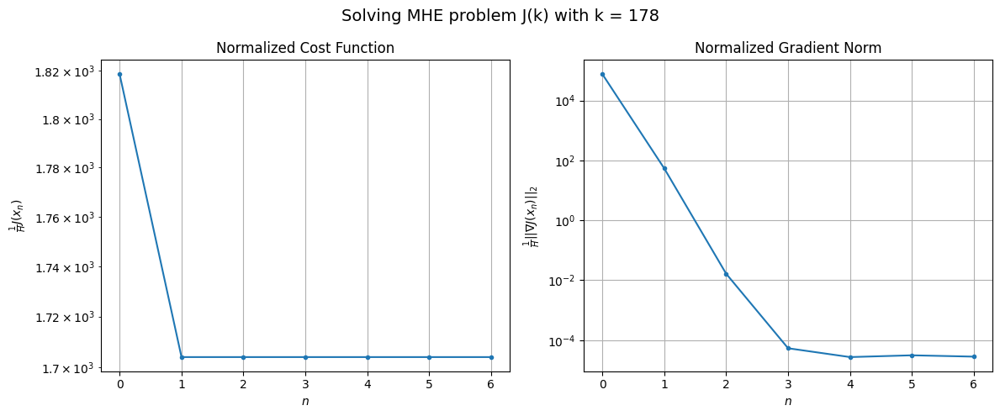

Windows:  43%|████▎     | 160/376 [14:16<20:17,  5.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 38109.56845380307
Gradient norm: 1888135.1712226865
Global estimation error: 46.28552809846391
Initial conditions estimation errors: 6.903756460609472 m, 15.143489760011942 m, 16.512531827110852 m, 39.90850562001974 m
Position estimation errors: 12.763348613127263 m, 14.522637116488973 m, 11.640076545682117 m, 32.13447875020781 m

[Gauss-Newton] Iteration 1
Cost function: 35575.65325117309 (-6.65%)
Gradient norm: 1335.8791344972756 (-99.93%)
Global estimation error: 84.37896233126608 (82.30%)
Initial conditions estimation errors: 8.913984886781753 m, 23.410254345254142 m, 19.81785414190306 m, 78.09962156343695 m
Position estimation errors: 10.26003069270892 m, 25.25455728312832 m, 19.70065332357429 m, 61.32394142172482 m

[Gauss-Newton] Iteration 2
Cost function: 35575.61671552561 (-0.00%)
Gradient norm: 0.03282101735044715 (-100.00%)
Global estimation error: 84.5959314089359 (0.26%)
Initial conditions estimation errors: 8.913

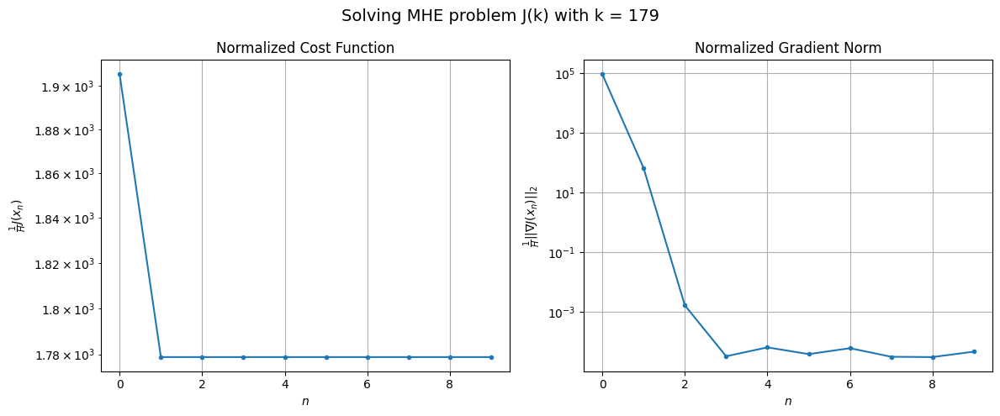

Windows:  43%|████▎     | 161/376 [14:21<20:18,  5.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 41011.47327272374
Gradient norm: 2202053.9126019627
Global estimation error: 85.141715708224
Initial conditions estimation errors: 6.870761013836581 m, 22.7210864790651 m, 20.437880793529594 m, 79.17031806183684 m
Position estimation errors: 13.791001885251811 m, 26.320457383298923 m, 19.86609780006251 m, 58.953237816989116 m

[Gauss-Newton] Iteration 1
Cost function: 38113.237343529916 (-7.07%)
Gradient norm: 257.7539706725716 (-99.99%)
Global estimation error: 69.92212980859236 (-17.88%)
Initial conditions estimation errors: 8.928935400838384 m, 14.1960585128474 m, 12.214642751094978 m, 66.77304140884398 m
Position estimation errors: 10.9096700913037 m, 35.25524272750258 m, 26.16848137615001 m, 82.66648005676053 m

[Gauss-Newton] Iteration 2
Cost function: 38113.23462060068 (-0.00%)
Gradient norm: 0.2032753889154035 (-99.92%)
Global estimation error: 69.69333679346342 (-0.33%)
Initial conditions estimation errors: 8.92893534

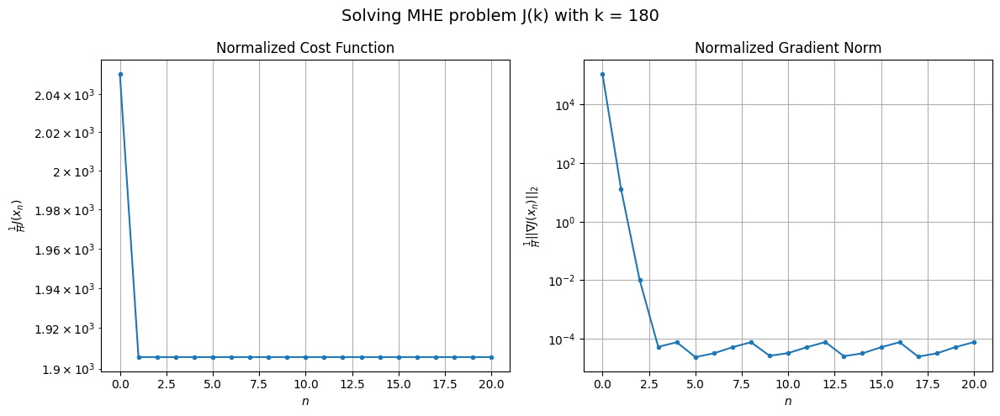

Windows:  43%|████▎     | 162/376 [14:33<26:21,  7.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 44816.15639656812
Gradient norm: 2439627.2319896524
Global estimation error: 71.8101569126092
Initial conditions estimation errors: 7.041755601261719 m, 13.686038552239417 m, 11.462174886065394 m, 69.1983446455867 m
Position estimation errors: 14.636334678404205 m, 37.16996951280813 m, 26.382905991730883 m, 82.28339009596822 m

[Gauss-Newton] Iteration 1
Cost function: 41511.90907054282 (-7.37%)
Gradient norm: 1457.4301433272224 (-99.94%)
Global estimation error: 51.81377293744585 (-27.85%)
Initial conditions estimation errors: 9.255139169180307 m, 11.017107410295552 m, 10.469869634528758 m, 48.66215465804795 m
Position estimation errors: 11.412581312741999 m, 21.16872149261939 m, 12.955720231999509 m, 40.40373845450013 m

[Gauss-Newton] Iteration 2
Cost function: 41511.87276503889 (-0.00%)
Gradient norm: 0.028852566628443186 (-100.00%)
Global estimation error: 51.798624759897855 (-0.03%)
Initial conditions estimation errors: 

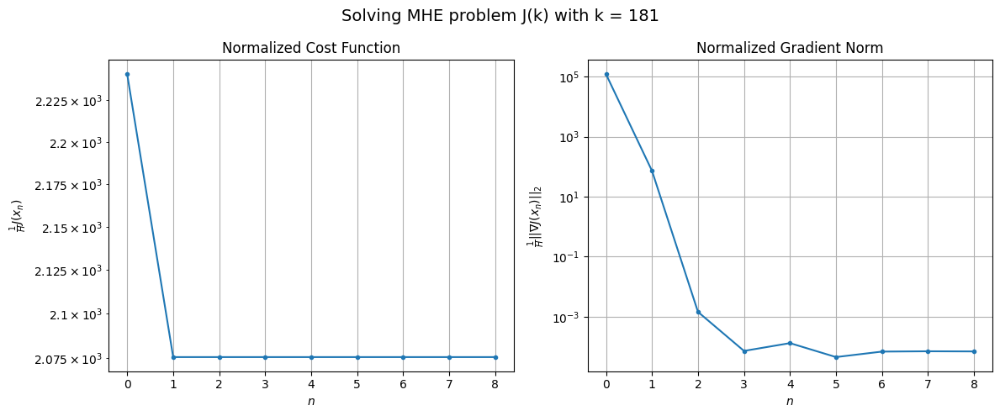

Windows:  43%|████▎     | 163/376 [14:38<23:43,  6.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 48874.31222335115
Gradient norm: 2605494.737170703
Global estimation error: 50.71601059752312
Initial conditions estimation errors: 7.316368025197101 m, 9.272124545042159 m, 8.460848546966218 m, 48.59030226956557 m
Position estimation errors: 15.197428680754525 m, 23.764218976537613 m, 14.35630018517219 m, 40.51940389468814 m

[Gauss-Newton] Iteration 1
Cost function: 45047.60189237528 (-7.83%)
Gradient norm: 1833.1268706021935 (-99.93%)
Global estimation error: 62.735803470126186 (23.70%)
Initial conditions estimation errors: 9.830211081026231 m, 15.061824496901421 m, 12.696265707844033 m, 58.745895991025954 m
Position estimation errors: 11.665248698060013 m, 9.817081034726849 m, 16.64324315635942 m, 23.61622864803022 m

[Gauss-Newton] Iteration 2
Cost function: 45047.54501540247 (-0.00%)
Gradient norm: 1.6849683311323174 (-99.91%)
Global estimation error: 64.7565238073222 (3.22%)
Initial conditions estimation errors: 9.83021

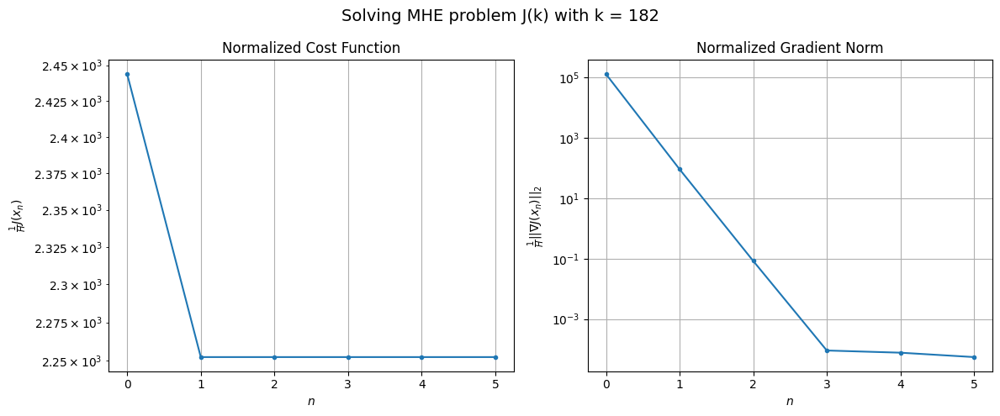

Windows:  44%|████▎     | 164/376 [14:41<20:23,  5.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 51781.335939715544
Gradient norm: 2665646.7074549138
Global estimation error: 59.446781820080325
Initial conditions estimation errors: 7.6495677562292625 m, 12.74540785284448 m, 11.032831325121792 m, 56.49089387820536 m
Position estimation errors: 15.375889783210063 m, 12.94443467413892 m, 20.513022884048034 m, 27.321654782237843 m

[Gauss-Newton] Iteration 1
Cost function: 47428.98163788776 (-8.41%)
Gradient norm: 754.9562368787207 (-99.97%)
Global estimation error: 26.818829769672362 (-54.89%)
Initial conditions estimation errors: 10.56743251219186 m, 12.188623720823632 m, 16.48056951494537 m, 13.689227746661416 m
Position estimation errors: 11.650282874116924 m, 12.24313241897955 m, 15.228627864833156 m, 25.268550048387954 m

[Gauss-Newton] Iteration 2
Cost function: 47428.90644826282 (-0.00%)
Gradient norm: 0.16315980952281733 (-99.98%)
Global estimation error: 26.710379241355774 (-0.40%)
Initial conditions estimation erro

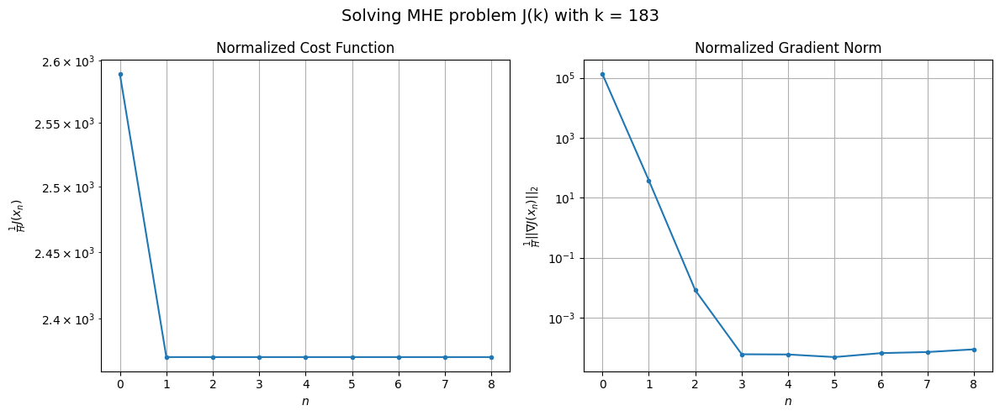

Windows:  44%|████▍     | 165/376 [14:47<19:54,  5.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 53458.56477861821
Gradient norm: 2672635.9793485096
Global estimation error: 24.357514190659558
Initial conditions estimation errors: 8.005397082852737 m, 11.724050465212066 m, 15.19372498637495 m, 12.684122924706486 m
Position estimation errors: 15.187539958726544 m, 14.539944118253283 m, 17.327207870044713 m, 25.49787699219828 m

[Gauss-Newton] Iteration 1
Cost function: 48684.098922915524 (-8.93%)
Gradient norm: 1181.0144296699516 (-99.96%)
Global estimation error: 47.80026958150549 (96.24%)
Initial conditions estimation errors: 11.246317069857636 m, 19.537463546722503 m, 23.836763187474176 m, 34.76296166087133 m
Position estimation errors: 11.328877255199782 m, 22.127822985536277 m, 24.592535920204075 m, 57.91385810308294 m

[Gauss-Newton] Iteration 2
Cost function: 48684.07196915091 (-0.00%)
Gradient norm: 0.41770277124729904 (-99.96%)
Global estimation error: 46.57426987228623 (-2.56%)
Initial conditions estimation error

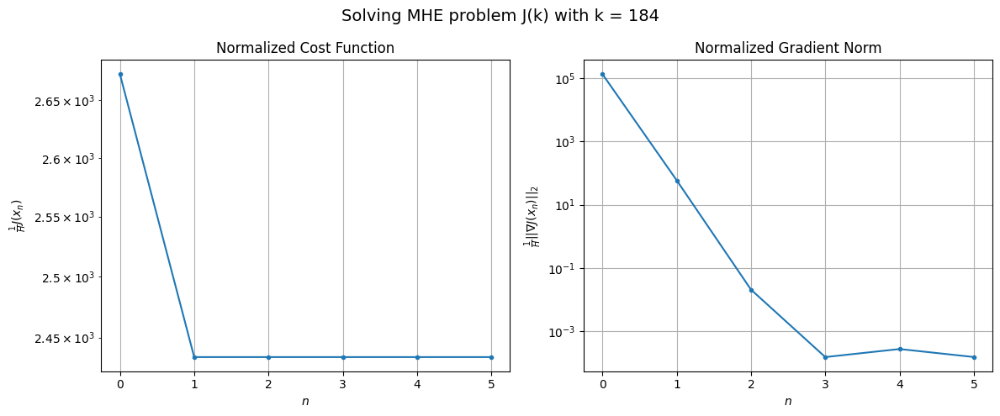

Windows:  44%|████▍     | 166/376 [14:50<17:33,  5.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 52789.80126850264
Gradient norm: 2513292.5292779054
Global estimation error: 48.06984260949462
Initial conditions estimation errors: 8.245773379125861 m, 19.752661368305205 m, 23.119347207056773 m, 36.30463716450232 m
Position estimation errors: 14.600268017876903 m, 22.609408847495306 m, 25.963742420059692 m, 56.116127889935974 m

[Gauss-Newton] Iteration 1
Cost function: 47892.17151859981 (-9.28%)
Gradient norm: 6073.5513076533025 (-99.76%)
Global estimation error: 109.02361451517768 (126.80%)
Initial conditions estimation errors: 11.742679012182691 m, 37.741889251258655 m, 41.22889147986564 m, 92.86521403322853 m
Position estimation errors: 10.816750231068351 m, 51.88675099255994 m, 59.30999335013805 m, 126.7725872971504 m

[Gauss-Newton] Iteration 2
Cost function: 47891.4836894738 (-0.00%)
Gradient norm: 0.31441172967873954 (-99.99%)
Global estimation error: 107.60311973246111 (-1.30%)
Initial conditions estimation errors:

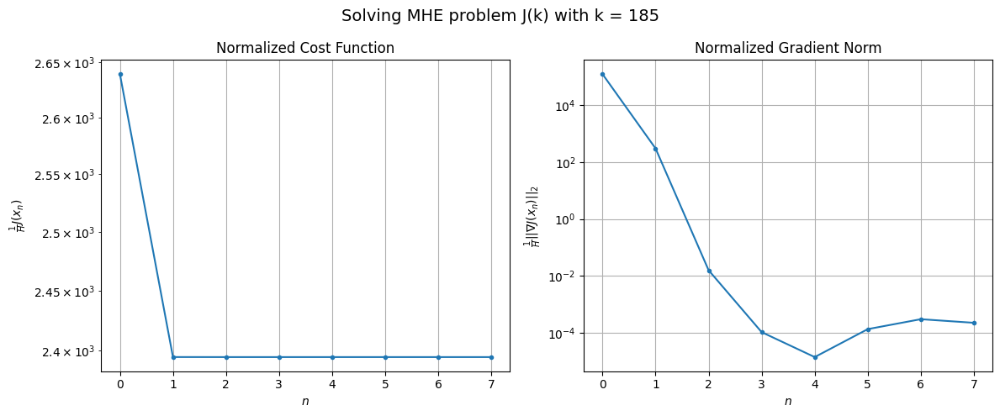

Windows:  44%|████▍     | 167/376 [14:55<16:59,  4.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 50324.110521130395
Gradient norm: 2355663.469236944
Global estimation error: 114.78148399904404
Initial conditions estimation errors: 8.321635743400886 m, 40.0669156919645 m, 42.872596241498954 m, 98.29591606349213 m
Position estimation errors: 13.77732229474883 m, 50.016386221619236 m, 59.64544057168105 m, 121.87140922534003 m

[Gauss-Newton] Iteration 1
Cost function: 45349.58840882463 (-9.88%)
Gradient norm: 945.7078915945029 (-99.96%)
Global estimation error: 180.1701770602948 (56.97%)
Initial conditions estimation errors: 11.99455990662449 m, 68.44507361524361 m, 80.73565727959138 m, 145.3080420510317 m
Position estimation errors: 10.093396746933422 m, 37.690542563540916 m, 57.798715932263555 m, 78.75209733324746 m

[Gauss-Newton] Iteration 2
Cost function: 45349.48010045366 (-0.00%)
Gradient norm: 5.297147513543623 (-99.44%)
Global estimation error: 178.8704448024999 (-0.72%)
Initial conditions estimation errors: 11.9945

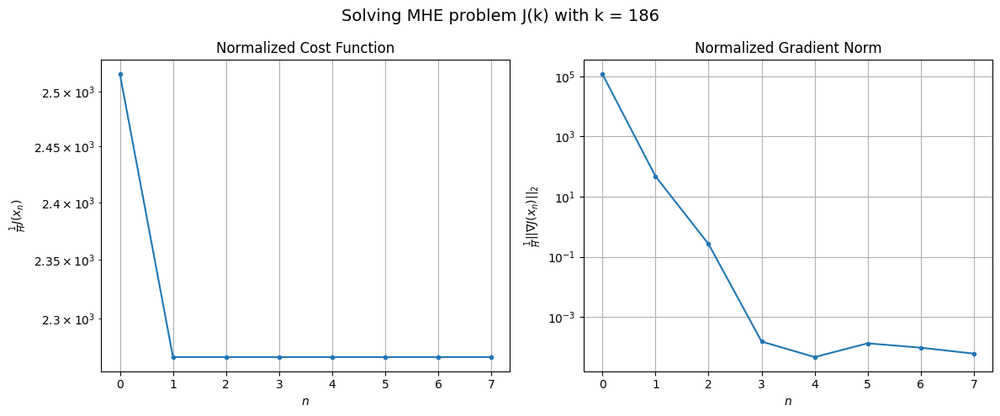

Windows:  45%|████▍     | 168/376 [14:59<16:32,  4.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 46370.81520659224
Gradient norm: 2079449.8127464051
Global estimation error: 181.65649433300445
Initial conditions estimation errors: 8.255817781989824 m, 69.64509898276538 m, 81.4094973432568 m, 146.4682871737312 m
Position estimation errors: 12.757102518019373 m, 31.84352763187934 m, 54.197912850150146 m, 66.66847769487212 m

[Gauss-Newton] Iteration 1
Cost function: 41802.84946648138 (-9.85%)
Gradient norm: 3391.665111652848 (-99.84%)
Global estimation error: 91.81515121446773 (-49.46%)
Initial conditions estimation errors: 11.870007920798503 m, 36.759322678582166 m, 49.70097712590471 m, 66.84061753228137 m
Position estimation errors: 9.344694290640012 m, 17.918568523688545 m, 22.59396884946316 m, 51.147822815246904 m

[Gauss-Newton] Iteration 2
Cost function: 41802.36281294888 (-0.00%)
Gradient norm: 3.2383988100116965 (-99.90%)
Global estimation error: 88.48440950380422 (-3.63%)
Initial conditions estimation errors: 11.87

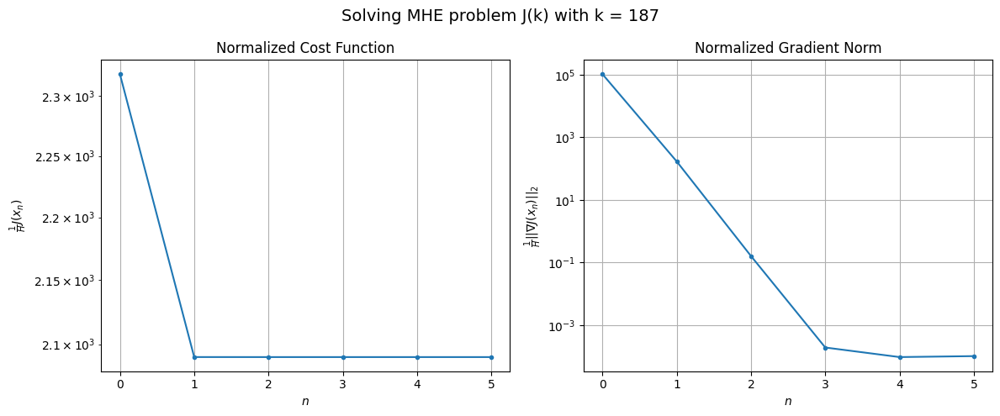

Windows:  45%|████▍     | 169/376 [15:03<15:15,  4.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 41752.80518333562
Gradient norm: 1797025.8785137145
Global estimation error: 89.5135365032976
Initial conditions estimation errors: 7.9890883318124395 m, 36.37241400970912 m, 47.44053134200596 m, 66.14584480103125 m
Position estimation errors: 11.808298890051235 m, 15.102562021264788 m, 21.288771807670376 m, 45.68856635379312 m

[Gauss-Newton] Iteration 1
Cost function: 37640.16735044683 (-9.85%)
Gradient norm: 656.1459461584631 (-99.96%)
Global estimation error: 103.31845253829044 (15.42%)
Initial conditions estimation errors: 11.484627368305194 m, 42.1188518471236 m, 48.72187098990516 m, 79.96851344158853 m
Position estimation errors: 8.712932944992822 m, 24.20381184562518 m, 42.92132951384617 m, 60.73469257590506 m

[Gauss-Newton] Iteration 2
Cost function: 37640.16076248612 (-0.00%)
Gradient norm: 0.1916217635685094 (-99.97%)
Global estimation error: 104.30314731509907 (0.95%)
Initial conditions estimation errors: 11.48462

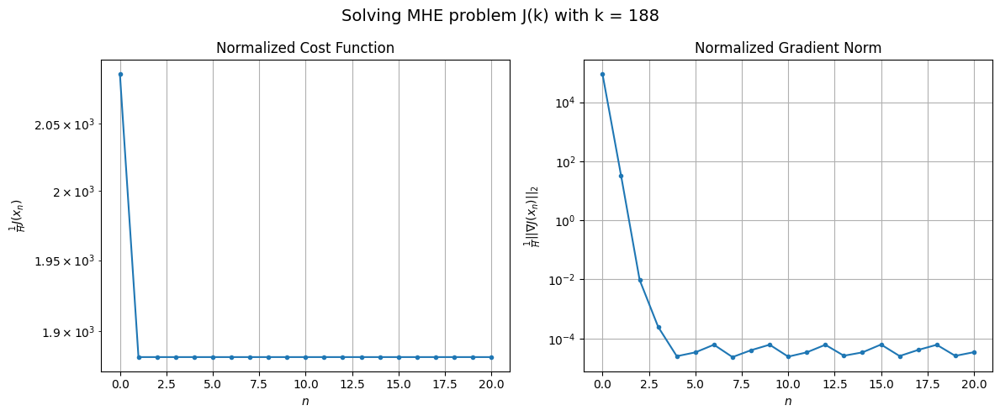

Windows:  45%|████▌     | 170/376 [15:14<21:57,  6.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 37277.431895468544
Gradient norm: 1564105.6119247505
Global estimation error: 106.72943613834329
Initial conditions estimation errors: 7.622308686373599 m, 43.58022657131932 m, 49.502206141289456 m, 83.56643487501296 m
Position estimation errors: 11.104216144068179 m, 20.435495685582694 m, 42.970563519706516 m, 54.07381730032794 m

[Gauss-Newton] Iteration 1
Cost function: 33526.23072055579 (-10.06%)
Gradient norm: 4564.947640499425 (-99.71%)
Global estimation error: 45.48278387015067 (-57.38%)
Initial conditions estimation errors: 10.97631106269412 m, 19.805285167321696 m, 32.62582318432243 m, 22.16959245679567 m
Position estimation errors: 8.250095516071351 m, 5.699768091519365 m, 4.834188914420726 m, 7.626187723397205 m

[Gauss-Newton] Iteration 2
Cost function: 33525.770571460824 (-0.00%)
Gradient norm: 28.308239259166438 (-99.38%)
Global estimation error: 52.92707137242269 (16.37%)
Initial conditions estimation errors: 10

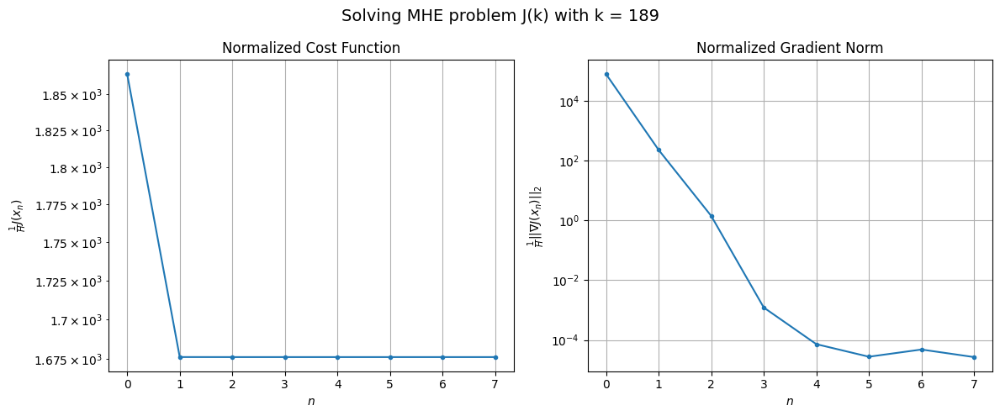

Windows:  45%|████▌     | 171/376 [15:19<19:59,  5.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 33297.4734246991
Gradient norm: 1338967.3508719096
Global estimation error: 50.95982799822343
Initial conditions estimation errors: 7.255829704510819 m, 22.631812167924167 m, 34.06357821597949 m, 29.524824888439767 m
Position estimation errors: 10.628832759819055 m, 8.275188688937819 m, 7.429784496692001 m, 7.061463914976592 m

[Gauss-Newton] Iteration 1
Cost function: 29997.723079541294 (-9.91%)
Gradient norm: 5297.906099912267 (-99.60%)
Global estimation error: 118.4241750739574 (132.39%)
Initial conditions estimation errors: 10.381972129076656 m, 48.78638177198201 m, 66.52258765571428 m, 84.3274198911867 m
Position estimation errors: 8.015891559964318 m, 23.968806656489146 m, 48.67197482288054 m, 52.85766540759391 m

[Gauss-Newton] Iteration 2
Cost function: 29997.112716324515 (-0.00%)
Gradient norm: 10.585034369529383 (-99.80%)
Global estimation error: 113.28579782446357 (-4.34%)
Initial conditions estimation errors: 10.38

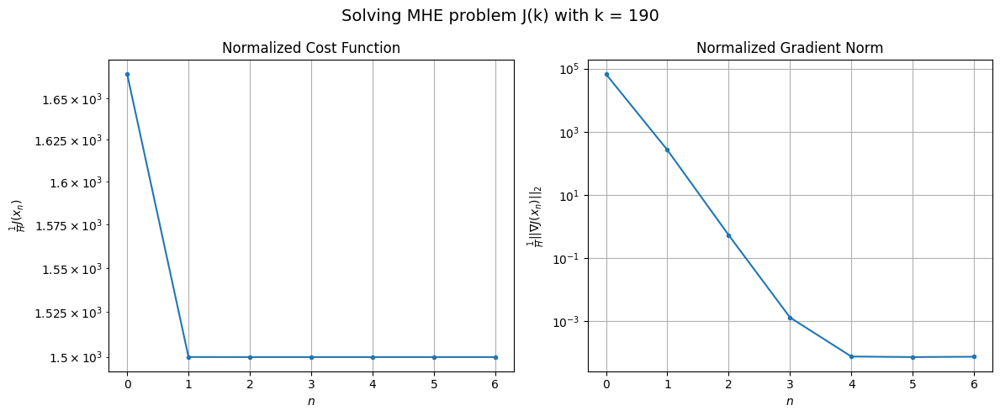

Windows:  46%|████▌     | 172/376 [15:23<18:09,  5.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30112.33964228476
Gradient norm: 1164288.2662883424
Global estimation error: 115.5271332335412
Initial conditions estimation errors: 6.892417110540251 m, 48.173282919791255 m, 65.02190060619287 m, 82.1613347164642 m
Position estimation errors: 10.360992938026417 m, 18.401696780522453 m, 46.19695362792336 m, 45.42366662445823 m

[Gauss-Newton] Iteration 1
Cost function: 27138.8643463105 (-9.87%)
Gradient norm: 7257.682933457992 (-99.38%)
Global estimation error: 57.927734013980064 (-49.86%)
Initial conditions estimation errors: 9.82368251390084 m, 25.06048508592234 m, 39.546548428486815 m, 32.66717107599079 m
Position estimation errors: 7.912598436720098 m, 19.597766136243607 m, 4.235405259771538 m, 28.721344546399646 m

[Gauss-Newton] Iteration 2
Cost function: 27137.914580208188 (-0.00%)
Gradient norm: 28.731886532293192 (-99.60%)
Global estimation error: 50.01571104572342 (-13.66%)
Initial conditions estimation errors: 9.823

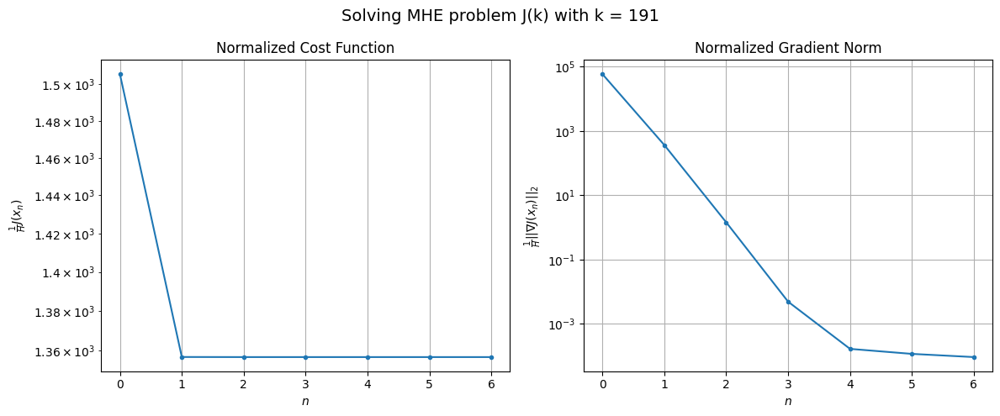

Windows:  46%|████▌     | 173/376 [15:27<16:52,  4.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27146.35380138015
Gradient norm: 1015217.1454384116
Global estimation error: 46.641224868578284
Initial conditions estimation errors: 6.604657328046513 m, 21.04406345835525 m, 33.541784038779404 m, 23.745846259114707 m
Position estimation errors: 10.179180171540478 m, 25.206667371919945 m, 5.456139785466584 m, 34.556922748369296 m

[Gauss-Newton] Iteration 1
Cost function: 24483.62380247394 (-9.81%)
Gradient norm: 2866.0088979079433 (-99.72%)
Global estimation error: 89.03481974531282 (90.89%)
Initial conditions estimation errors: 9.351099587066782 m, 36.6029490919079 m, 57.317007778304735 m, 56.69856503813868 m
Position estimation errors: 7.880957491804163 m, 3.679022367677348 m, 25.258100440147434 m, 10.444372185774986 m

[Gauss-Newton] Iteration 2
Cost function: 24483.461536940857 (-0.00%)
Gradient norm: 0.05741336073240501 (-100.00%)
Global estimation error: 88.94787384268828 (-0.10%)
Initial conditions estimation errors: 

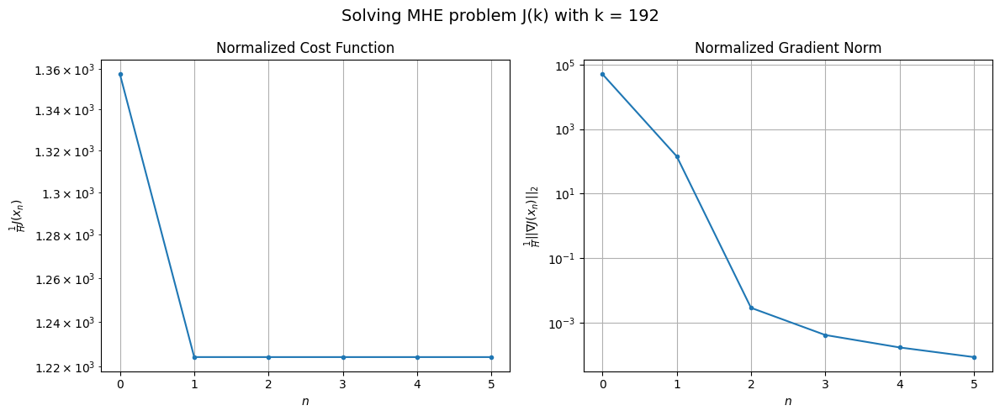

Windows:  46%|████▋     | 174/376 [15:31<15:25,  4.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25089.52854302808
Gradient norm: 966477.6495121277
Global estimation error: 88.11020377914741
Initial conditions estimation errors: 6.39763896247768 m, 36.7831430302664 m, 56.043048793709545 m, 56.82116297161548 m
Position estimation errors: 10.065359473309705 m, 5.535200895589501 m, 24.291484688986944 m, 7.329077695448133 m

[Gauss-Newton] Iteration 1
Cost function: 22567.24312832374 (-10.05%)
Gradient norm: 9323.73713549738 (-99.04%)
Global estimation error: 149.50995347900465 (69.69%)
Initial conditions estimation errors: 8.992730530584378 m, 49.49719019670731 m, 73.71224899246779 m, 119.95358319397954 m
Position estimation errors: 7.76529645529719 m, 55.40356115527945 m, 67.11816146098988 m, 92.58470031709047 m

[Gauss-Newton] Iteration 2
Cost function: 22565.656184873646 (-0.01%)
Gradient norm: 630.1090188947786 (-93.24%)
Global estimation error: 111.91426973258305 (-25.15%)
Initial conditions estimation errors: 8.9927304

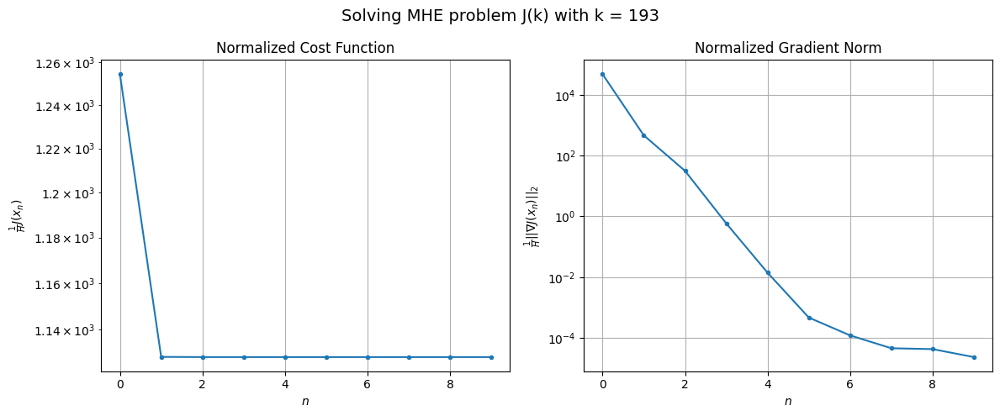

Windows:  47%|████▋     | 175/376 [15:36<16:13,  4.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23593.18133260221
Gradient norm: 922498.3792500234
Global estimation error: 110.38702161994613
Initial conditions estimation errors: 6.274201748457439 m, 35.83609092673466 m, 54.881993591145495 m, 88.59823807407254 m
Position estimation errors: 9.891101152084847 m, 45.2095840134812 m, 50.32125179521212 m, 79.02655289409624 m

[Gauss-Newton] Iteration 1
Cost function: 21343.4473491575 (-9.54%)
Gradient norm: 47452.41932104558 (-94.86%)
Global estimation error: 185.43056145130586 (67.98%)
Initial conditions estimation errors: 8.697711618643451 m, 77.96630605399638 m, 60.23031302868908 m, 156.85144605382766 m
Position estimation errors: 7.616220459185295 m, 22.38813679670485 m, 86.14269488735347 m, 18.228738283384292 m

[Gauss-Newton] Iteration 2
Cost function: 21271.4775433581 (-0.34%)
Gradient norm: 367.8361786365738 (-99.22%)
Global estimation error: 222.07100574795132 (19.76%)
Initial conditions estimation errors: 8.697711530

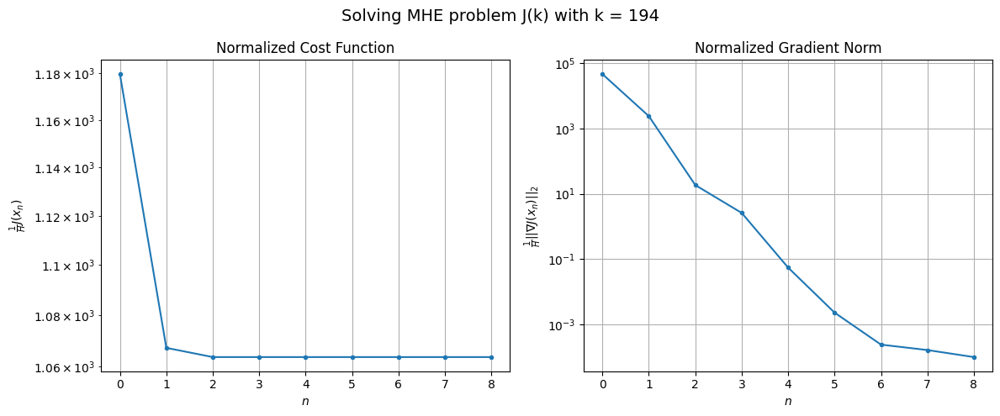

Windows:  47%|████▋     | 176/376 [15:41<16:24,  4.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22279.406058616507
Gradient norm: 899716.2202298252
Global estimation error: 231.23992405663148
Initial conditions estimation errors: 6.1778579718804005 m, 95.01737201808146 m, 88.38557193237884 m, 191.2939890386666 m
Position estimation errors: 9.721807039958565 m, 23.155024919604323 m, 94.49353842212817 m, 28.120599594661144 m

[Gauss-Newton] Iteration 1
Cost function: 20647.96021885259 (-7.32%)
Gradient norm: 128358.09191250766 (-85.73%)
Global estimation error: 292.1380556812866 (26.34%)
Initial conditions estimation errors: 8.533875967384997 m, 103.45419814720512 m, 164.22463876047118 m, 218.172596398219 m
Position estimation errors: 7.422079030703377 m, 91.42559099853091 m, 91.43333944393319 m, 132.5432428222133 m

[Gauss-Newton] Iteration 2
Cost function: 20001.97779145188 (-3.13%)
Gradient norm: 1728.2921222047005 (-98.65%)
Global estimation error: 222.6385017928934 (-23.79%)
Initial conditions estimation errors: 8.533

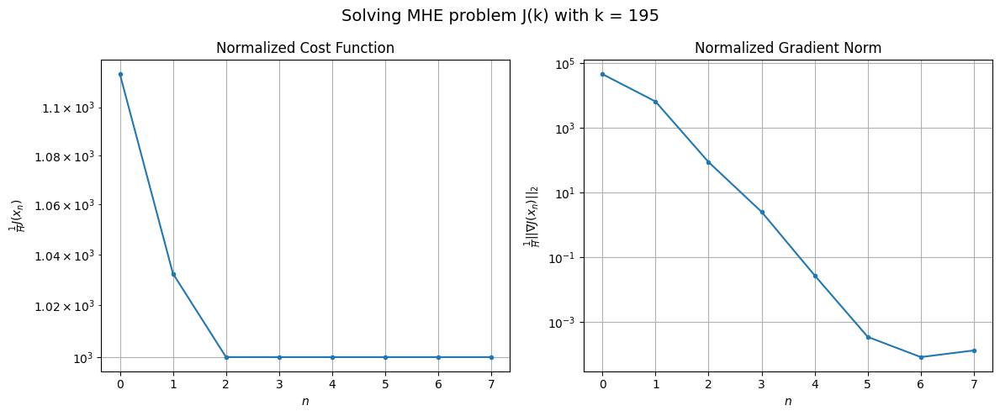

Windows:  47%|████▋     | 177/376 [15:46<16:10,  4.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 21158.30736232146
Gradient norm: 873975.4289181851
Global estimation error: 238.06314728497202
Initial conditions estimation errors: 6.154950241154885 m, 85.80674809546228 m, 135.8036201410491 m, 175.58682088720295 m
Position estimation errors: 9.535611924867414 m, 75.1284579420883 m, 71.75777139613332 m, 113.19447152521174 m

[Gauss-Newton] Iteration 1
Cost function: 19032.011624595067 (-10.05%)
Gradient norm: 2108.1997907016294 (-99.76%)
Global estimation error: 261.60853371352255 (9.89%)
Initial conditions estimation errors: 8.397280914113027 m, 91.39078040651846 m, 139.30353121128485 m, 201.52102312622287 m
Position estimation errors: 7.2537575833870305 m, 93.89264169183723 m, 108.0778358637639 m, 146.2537451973301 m

[Gauss-Newton] Iteration 2
Cost function: 19031.93498890144 (-0.00%)
Gradient norm: 62.87752182582401 (-97.02%)
Global estimation error: 252.37797196648822 (-3.53%)
Initial conditions estimation errors: 8.397

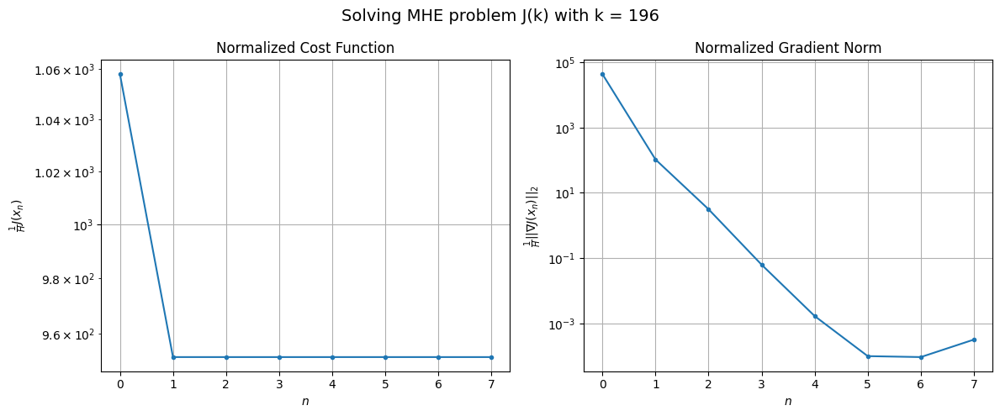

Windows:  47%|████▋     | 178/376 [15:50<15:42,  4.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20280.1766102039
Gradient norm: 879241.319618499
Global estimation error: 261.93787812063647
Initial conditions estimation errors: 6.110067211677788 m, 94.08989230134037 m, 136.74658851976596 m, 202.53777892992977 m
Position estimation errors: 9.410075794790073 m, 84.18194673768522 m, 100.57277345861014 m, 128.81193631346696 m

[Gauss-Newton] Iteration 1
Cost function: 20704.86952360493 (2.09%)
Gradient norm: 299428.58942786144 (-65.94%)
Global estimation error: 905.0680637905729 (245.53%)
Initial conditions estimation errors: 8.3403115585652 m, 352.5782852536894 m, 475.11105383612835 m, 684.8623649492804 m
Position estimation errors: 7.09060547316815 m, 278.31793834317824 m, 397.6037972937047 m, 424.91465357884726 m

[Gauss-Newton] Iteration 2
Cost function: 18150.9000820519 (-12.34%)
Gradient norm: 15509.110762713533 (-94.82%)
Global estimation error: 746.4204002521518 (-17.53%)
Initial conditions estimation errors: 8.340311

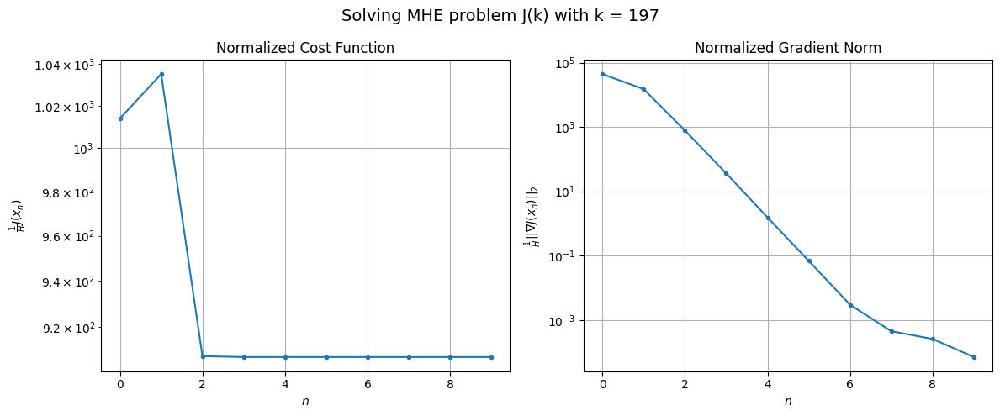

Windows:  48%|████▊     | 179/376 [15:56<16:11,  4.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 18938.603389690626
Gradient norm: 839680.9602915777
Global estimation error: 791.6621889536581
Initial conditions estimation errors: 6.055596161981889 m, 311.3526976287383 m, 418.21323518971315 m, 595.6923735360807 m
Position estimation errors: 9.296802721160308 m, 224.20680377963774 m, 329.26762023566783 m, 339.93510327936525 m

[Gauss-Newton] Iteration 1
Cost function: 18004.5719414983 (-4.93%)
Gradient norm: 190500.01325250213 (-77.31%)
Global estimation error: 259.1740138156898 (-67.26%)
Initial conditions estimation errors: 8.259783124063103 m, 94.59689038711426 m, 125.2934052426065 m, 206.0483328376882 m
Position estimation errors: 7.024751292624895 m, 68.71314006133072 m, 115.54628367784498 m, 95.32946442181354 m

[Gauss-Newton] Iteration 2
Cost function: 16892.560634169407 (-6.18%)
Gradient norm: 1162.8197552344884 (-99.39%)
Global estimation error: 284.7647987310424 (9.87%)
Initial conditions estimation errors: 8.2597

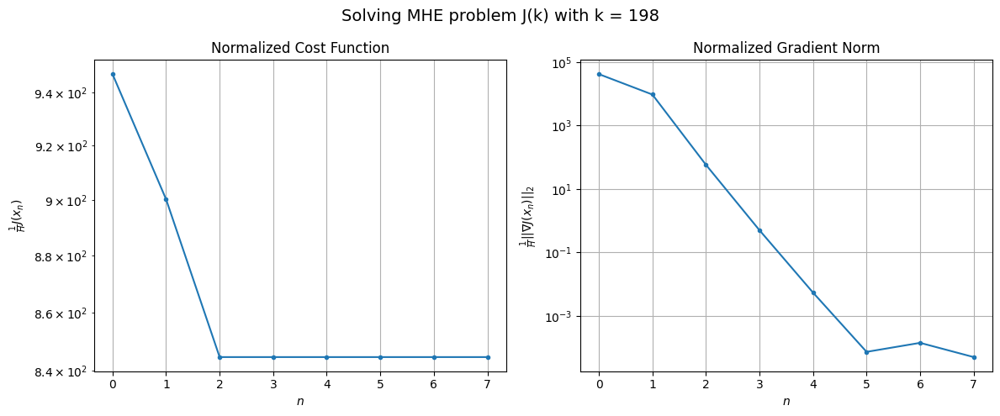

Windows:  48%|████▊     | 180/376 [16:00<15:16,  4.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 17843.17903608592
Gradient norm: 857225.0049491148
Global estimation error: 289.1039927245965
Initial conditions estimation errors: 5.914631996789708 m, 109.80570433311426 m, 142.24861048779775 m, 226.39380184402754 m
Position estimation errors: 9.280341939850077 m, 73.21423234508583 m, 130.5477945005448 m, 104.35074282439467 m

[Gauss-Newton] Iteration 1
Cost function: 15833.587237367887 (-11.26%)
Gradient norm: 52061.24878628547 (-93.93%)
Global estimation error: 100.14060503946295 (-65.36%)
Initial conditions estimation errors: 8.128246747450758 m, 24.53972447706688 m, 38.1917170072885 m, 88.88899368939623 m
Position estimation errors: 6.9866565541938055 m, 16.86007792634557 m, 8.34596103727205 m, 76.18829362761045 m

[Gauss-Newton] Iteration 2
Cost function: 15778.290999666855 (-0.35%)
Gradient norm: 29.59954272630769 (-99.94%)
Global estimation error: 92.87422786153893 (-7.26%)
Initial conditions estimation errors: 8.1282

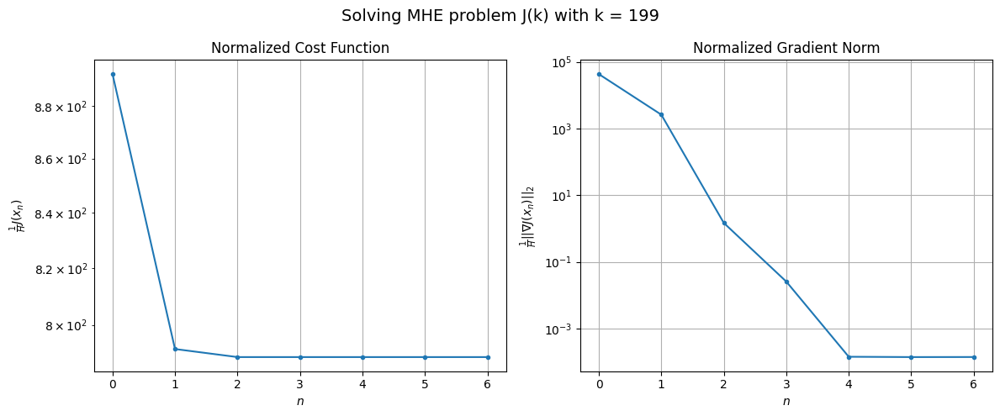

Windows:  48%|████▊     | 181/376 [16:04<14:39,  4.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16808.148489438077
Gradient norm: 864991.666361721
Global estimation error: 86.27903151892633
Initial conditions estimation errors: 5.707524600075871 m, 21.63731856536598 m, 30.871075832008565 m, 77.3969252975049 m
Position estimation errors: 9.297805149481595 m, 22.901582185551874 m, 6.700967849807765 m, 89.50131918642664 m

[Gauss-Newton] Iteration 1
Cost function: 14800.012064347895 (-11.95%)
Gradient norm: 6495.8319556890065 (-99.25%)
Global estimation error: 37.21186589933075 (-56.87%)
Initial conditions estimation errors: 7.887771841051541 m, 13.711683231181356 m, 26.128462113030487 m, 21.255033667896292 m
Position estimation errors: 7.030438888313758 m, 53.45281181627153 m, 41.76153870780223 m, 124.7899486002924 m

[Gauss-Newton] Iteration 2
Cost function: 14798.874950924735 (-0.01%)
Gradient norm: 593.4696710664143 (-90.86%)
Global estimation error: 38.72030712353057 (4.05%)
Initial conditions estimation errors: 7.8877

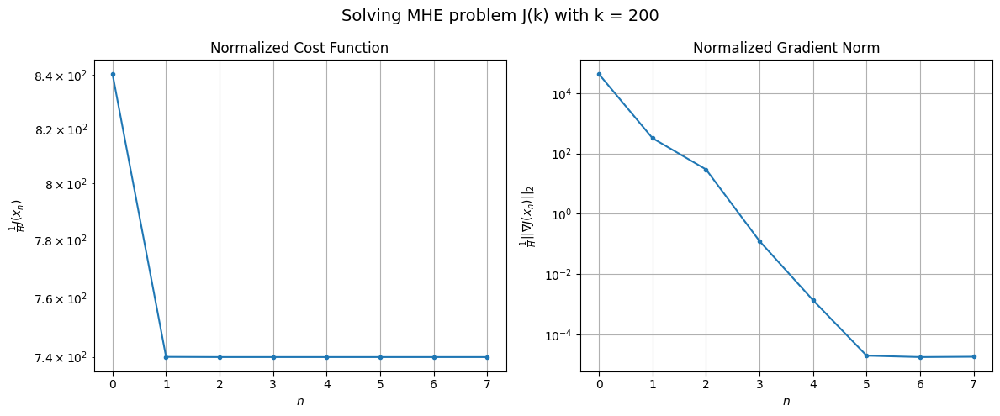

Windows:  48%|████▊     | 182/376 [16:08<14:32,  4.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16230.166274388408
Gradient norm: 912231.0675509126
Global estimation error: 34.414977276584914
Initial conditions estimation errors: 5.441740272420359 m, 4.997698421419092 m, 17.934017085614837 m, 28.42805368393641 m
Position estimation errors: 9.444998479519617 m, 47.681341304715296 m, 26.72786795803281 m, 116.00172736725767 m

[Gauss-Newton] Iteration 1
Cost function: 14263.150477243194 (-12.12%)
Gradient norm: 11796.352105485272 (-98.71%)
Global estimation error: 171.81364186241177 (399.24%)
Initial conditions estimation errors: 7.582597562326511 m, 58.76872771411392 m, 64.80612291006707 m, 147.67810194229966 m
Position estimation errors: 7.190073562104808 m, 15.327598088497515 m, 19.404619075511956 m, 65.45661640130612 m

[Gauss-Newton] Iteration 2
Cost function: 14257.328150107629 (-0.04%)
Gradient norm: 980.4698506791459 (-91.69%)
Global estimation error: 148.05062678022793 (-13.83%)
Initial conditions estimation errors

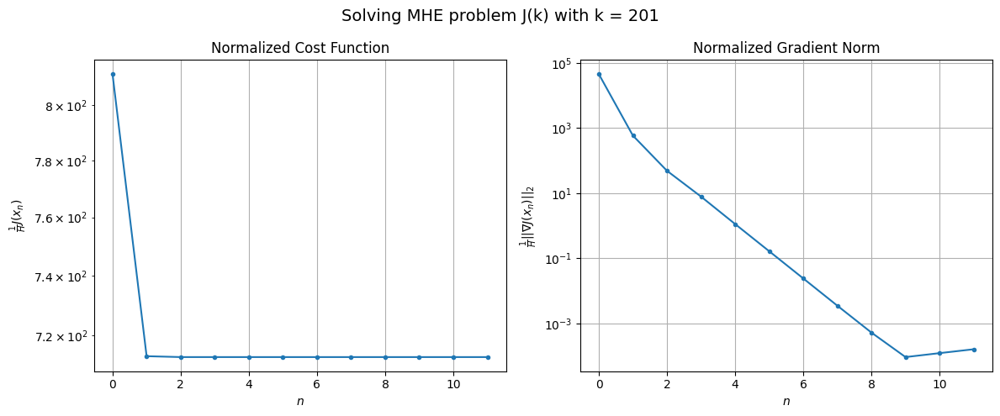

Windows:  49%|████▊     | 183/376 [16:15<16:26,  5.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16103.784527084772
Gradient norm: 978911.3693574322
Global estimation error: 148.3681186059741
Initial conditions estimation errors: 5.1919191743534565 m, 51.044865344276666 m, 49.68948217958855 m, 130.04422573138072 m
Position estimation errors: 9.769101823874747 m, 30.828400211664125 m, 12.01056494329673 m, 95.70400148664021 m

[Gauss-Newton] Iteration 1
Cost function: 14133.595615469778 (-12.23%)
Gradient norm: 3315.8069255946884 (-99.66%)
Global estimation error: 152.8532020137036 (3.02%)
Initial conditions estimation errors: 7.301422396420248 m, 59.21117704600596 m, 63.75950875317649 m, 125.45734636323905 m
Position estimation errors: 7.48693473204538 m, 5.30500554451516 m, 36.309844255227 m, 33.846994710218794 m

[Gauss-Newton] Iteration 2
Cost function: 14133.426478439837 (-0.00%)
Gradient norm: 28.100601510621058 (-99.15%)
Global estimation error: 149.63002411993085 (-2.11%)
Initial conditions estimation errors: 7.3014

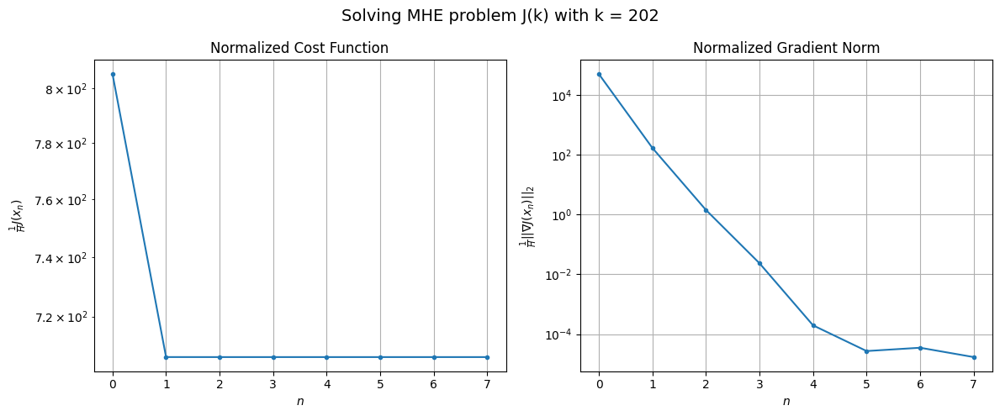

Windows:  49%|████▉     | 184/376 [16:20<15:53,  4.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16807.25441885014
Gradient norm: 1122922.3637008169
Global estimation error: 147.41002577317417
Initial conditions estimation errors: 5.034985803990885 m, 59.228428596232185 m, 59.59961767955052 m, 121.01337337410963 m
Position estimation errors: 10.274562077276428 m, 7.551693390540967 m, 32.97781026740057 m, 49.64943755071156 m

[Gauss-Newton] Iteration 1
Cost function: 14790.067215337009 (-12.00%)
Gradient norm: 28667.720261666804 (-97.45%)
Global estimation error: 42.68989483473702 (-71.04%)
Initial conditions estimation errors: 7.120597920165239 m, 4.468674269481366 m, 27.99222702829596 m, 31.11502499612883 m
Position estimation errors: 7.898075783049595 m, 77.47696299097004 m, 60.721587463311636 m, 177.8868172965025 m

[Gauss-Newton] Iteration 2
Cost function: 14773.377662286213 (-0.11%)
Gradient norm: 1059.0162801828699 (-96.31%)
Global estimation error: 48.377661113713216 (13.32%)
Initial conditions estimation errors: 7

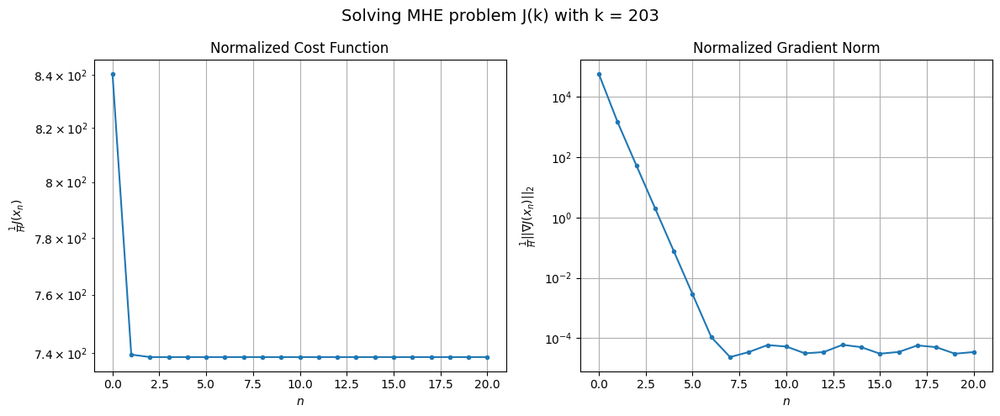

Windows:  49%|████▉     | 185/376 [16:31<21:43,  6.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 18033.594561820668
Gradient norm: 1255784.9321905929
Global estimation error: 39.99093078819346
Initial conditions estimation errors: 4.985231662333659 m, 9.711628647956791 m, 20.86153102705496 m, 32.324404731470636 m
Position estimation errors: 10.910880902233176 m, 71.00875297847129 m, 42.76675263532817 m, 163.73128589469968 m

[Gauss-Newton] Iteration 1
Cost function: 17257.452057975926 (-4.30%)
Gradient norm: 275078.89100171905 (-78.10%)
Global estimation error: 358.4140337972635 (796.24%)
Initial conditions estimation errors: 7.098746494623217 m, 151.81577770056393 m, 246.35879363921086 m, 211.35045889851634 m
Position estimation errors: 8.408637615034129 m, 283.9836403135296 m, 350.30150067400217 m, 595.2584115857036 m

[Gauss-Newton] Iteration 2
Cost function: 15872.199268279457 (-8.03%)
Gradient norm: 15084.816421277668 (-94.52%)
Global estimation error: 279.3780043533621 (-22.05%)
Initial conditions estimation errors:

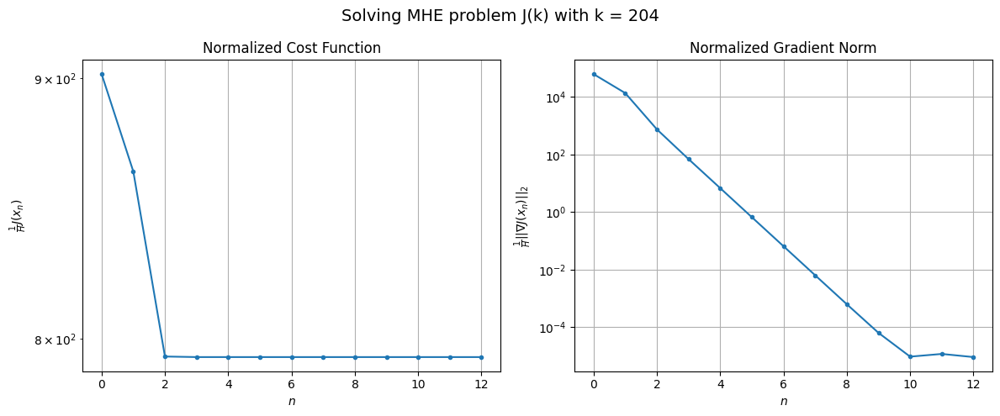

Windows:  49%|████▉     | 186/376 [16:38<21:37,  6.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20045.735321724478
Gradient norm: 1422198.2258308479
Global estimation error: 333.7447077005328
Initial conditions estimation errors: 5.044074808110038 m, 138.0967411986685 m, 224.2067273177128 m, 204.98868997587493 m
Position estimation errors: 11.65319222831152 m, 242.24642251119582 m, 286.2142519502627 m, 511.0181049420671 m

[Gauss-Newton] Iteration 1
Cost function: 18374.013304154236 (-8.34%)
Gradient norm: 205391.3285024985 (-85.56%)
Global estimation error: 621.2934876796905 (86.16%)
Initial conditions estimation errors: 7.240830416894827 m, 264.6253829753652 m, 421.9245350140689 m, 371.35568909332983 m
Position estimation errors: 8.966957270882535 m, 430.56974114899344 m, 541.6455574292387 m, 913.7411062316402 m

[Gauss-Newton] Iteration 2
Cost function: 17636.164376879664 (-4.02%)
Gradient norm: 17227.557432279275 (-91.61%)
Global estimation error: 726.6440741588974 (16.96%)
Initial conditions estimation errors: 7.240

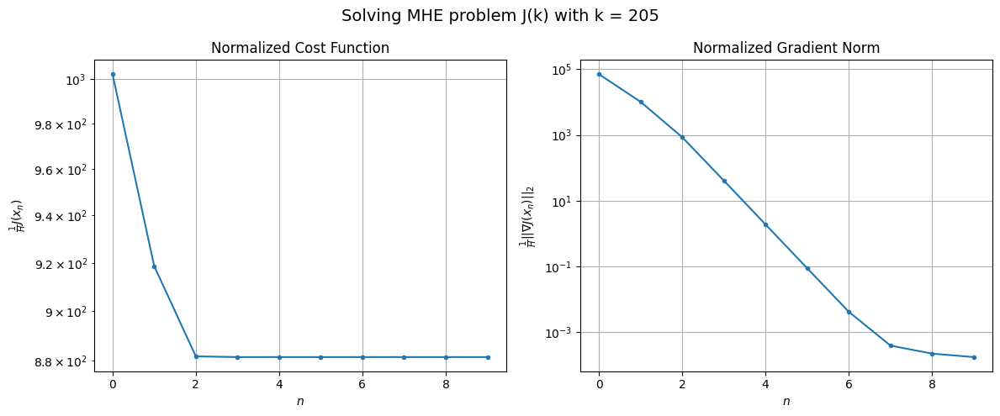

Windows:  50%|████▉     | 187/376 [16:43<20:30,  6.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22754.19118891654
Gradient norm: 1598873.3575208832
Global estimation error: 822.3576717939807
Initial conditions estimation errors: 5.191900556724017 m, 345.7176505217156 m, 540.3650089926238 m, 514.5179127844748 m
Position estimation errors: 12.469137607939269 m, 486.9512385755912 m, 604.6846462380789 m, 1044.8807625373752 m

[Gauss-Newton] Iteration 1
Cost function: 20649.441045830594 (-9.25%)
Gradient norm: 186610.07940105535 (-88.33%)
Global estimation error: 560.6737037465929 (-31.82%)
Initial conditions estimation errors: 7.497194664008728 m, 233.1192311071143 m, 347.2754341441985 m, 373.30078058092766 m
Position estimation errors: 9.575705596564271 m, 299.1164355242089 m, 364.41682720340856 m, 655.1947402953299 m

[Gauss-Newton] Iteration 2
Cost function: 20037.769263405593 (-2.96%)
Gradient norm: 6.077386206483697 (-100.00%)
Global estimation error: 561.3822571886022 (0.13%)
Initial conditions estimation errors: 7.497

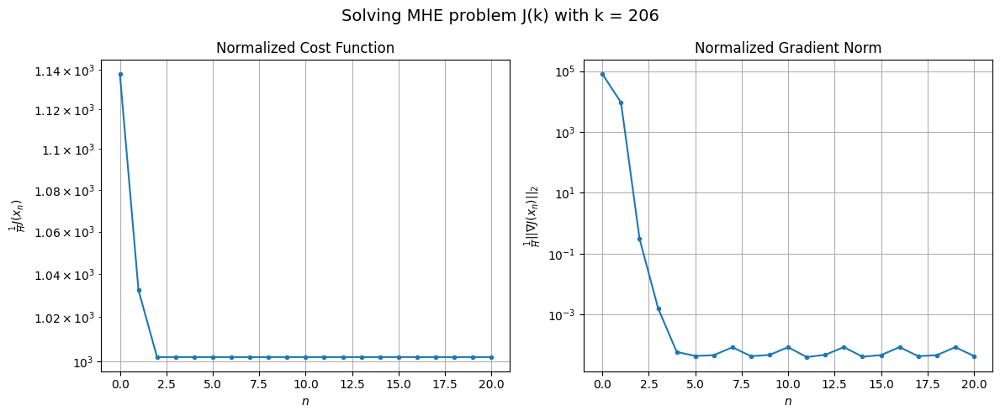

Windows:  50%|█████     | 188/376 [16:54<24:45,  7.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 26210.462277813956
Gradient norm: 1763273.7294898054
Global estimation error: 600.4018498143101
Initial conditions estimation errors: 5.419520382020892 m, 246.51047486610292 m, 366.04215580072673 m, 407.06052943982587 m
Position estimation errors: 13.390949548874975 m, 290.7472537536871 m, 343.9797983616749 m, 643.2505795569135 m

[Gauss-Newton] Iteration 1
Cost function: 23119.73112304027 (-11.79%)
Gradient norm: 16735.632012167418 (-99.05%)
Global estimation error: 435.952758373846 (-27.39%)
Initial conditions estimation errors: 7.881525186292582 m, 186.07205383717204 m, 277.4321509039947 m, 280.00160859224997 m
Position estimation errors: 10.273534188678056 m, 251.8449948164107 m, 297.48324131958475 m, 557.1470149861614 m

[Gauss-Newton] Iteration 2
Cost function: 23110.059242145093 (-0.04%)
Gradient norm: 0.2628133867016736 (-100.00%)
Global estimation error: 437.0824648436492 (0.26%)
Initial conditions estimation errors: 

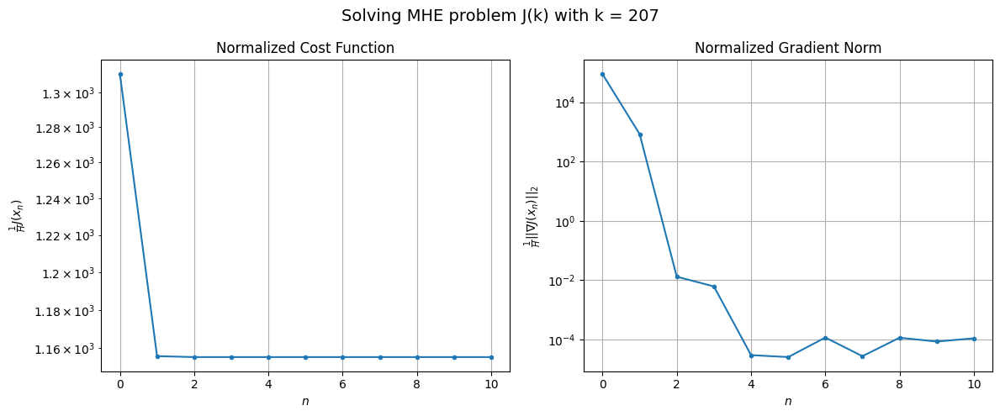

Windows:  50%|█████     | 189/376 [17:01<22:54,  7.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30442.173841915006
Gradient norm: 1919282.9905152482
Global estimation error: 470.41738999898826
Initial conditions estimation errors: 5.741787038719031 m, 197.30257669098054 m, 293.39706015831797 m, 310.2403330906511 m
Position estimation errors: 14.487607044587218 m, 247.24595894508866 m, 281.6750443757737 m, 552.5791513805516 m

[Gauss-Newton] Iteration 1
Cost function: 27233.707759314875 (-10.54%)
Gradient norm: 129835.43200557893 (-93.24%)
Global estimation error: 191.68889503717438 (-59.25%)
Initial conditions estimation errors: 8.379743008873225 m, 82.4076003623541 m, 107.6258447284254 m, 135.27757782683972 m
Position estimation errors: 11.137900809195235 m, 105.51758828566821 m, 114.74844359426179 m, 225.29131521607263 m

[Gauss-Newton] Iteration 2
Cost function: 26904.994776811865 (-1.21%)
Gradient norm: 1648.0455941369005 (-98.73%)
Global estimation error: 220.03229216338195 (14.79%)
Initial conditions estimation err

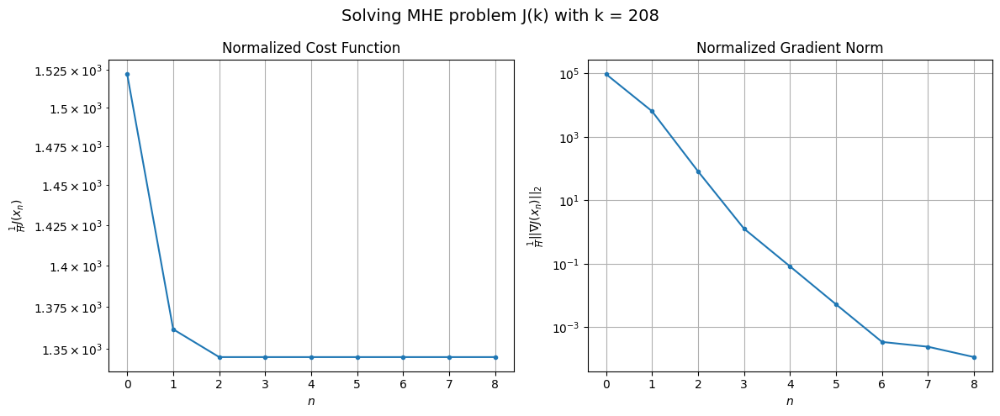

Windows:  51%|█████     | 190/376 [17:05<20:31,  6.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 35573.54044573568
Gradient norm: 2118434.906206837
Global estimation error: 232.58915714908366
Initial conditions estimation errors: 6.128865528141524 m, 97.69906571712454 m, 133.3426974030103 m, 163.50750818847075 m
Position estimation errors: 15.821067760738002 m, 119.21443337679047 m, 123.64392401894834 m, 256.99263928372136 m

[Gauss-Newton] Iteration 1
Cost function: 31390.649553027266 (-11.76%)
Gradient norm: 29944.550274334248 (-98.59%)
Global estimation error: 89.14821719635101 (-61.67%)
Initial conditions estimation errors: 9.030657248177226 m, 42.55598969869206 m, 42.649132217975016 m, 65.08361355795911 m
Position estimation errors: 12.160819543056649 m, 55.78593841174132 m, 53.93117845671547 m, 96.25516502019735 m

[Gauss-Newton] Iteration 2
Cost function: 31372.337744603847 (-0.06%)
Gradient norm: 34.79214105086308 (-99.88%)
Global estimation error: 88.99683414312571 (-0.17%)
Initial conditions estimation errors: 9

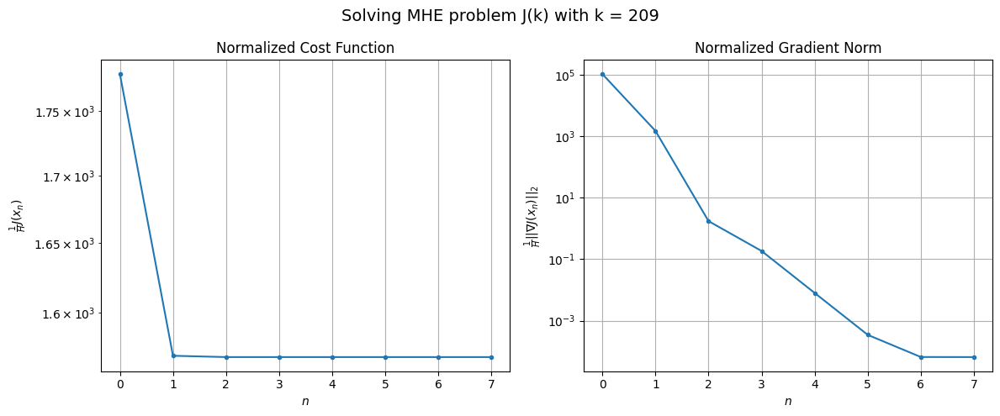

Windows:  51%|█████     | 191/376 [17:10<18:28,  5.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 42488.48890351685
Gradient norm: 2431385.054549674
Global estimation error: 93.10426818906966
Initial conditions estimation errors: 6.5979817683830255 m, 42.31247735395666 m, 46.23967632162708 m, 68.53032899371499 m
Position estimation errors: 17.319659736575467 m, 56.72961696695822 m, 47.337809830645945 m, 92.17175726058716 m

[Gauss-Newton] Iteration 1
Cost function: 37314.89825828069 (-12.18%)
Gradient norm: 16444.64070850857 (-99.32%)
Global estimation error: 55.8741639792621 (-39.99%)
Initial conditions estimation errors: 9.801238323625318 m, 24.230792498534306 m, 10.110196376486684 m, 48.3372124010658 m
Position estimation errors: 13.22019757254311 m, 13.350738336170577 m, 18.13246374811424 m, 50.490965806169235 m

[Gauss-Newton] Iteration 2
Cost function: 37310.53685557808 (-0.01%)
Gradient norm: 317.03135713530594 (-98.07%)
Global estimation error: 55.12954693009319 (-1.33%)
Initial conditions estimation errors: 9.8012

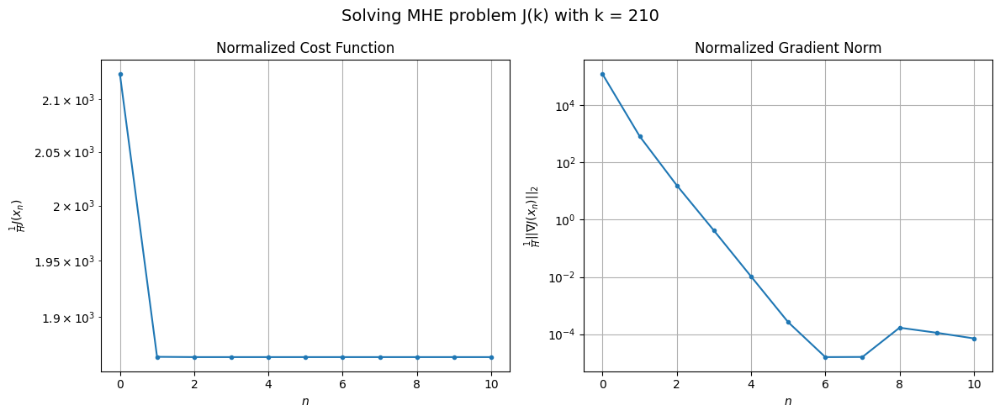

Windows:  51%|█████     | 192/376 [17:16<18:15,  5.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 49888.267997335584
Gradient norm: 2631990.468335223
Global estimation error: 44.564449101061896
Initial conditions estimation errors: 7.130429433373799 m, 16.622893597895814 m, 14.849376443517821 m, 37.92480345070783 m
Position estimation errors: 18.77693726466275 m, 20.793809129333862 m, 32.126997044969116 m, 75.24214495734316 m

[Gauss-Newton] Iteration 1
Cost function: 43812.639991314274 (-12.18%)
Gradient norm: 19827.8860320074 (-99.25%)
Global estimation error: 79.43271447447127 (78.24%)
Initial conditions estimation errors: 10.632858801170233 m, 16.155742100190608 m, 72.69558716863787 m, 25.508950478199125 m
Position estimation errors: 14.327960948418513 m, 75.58572404262478 m, 82.35444022389291 m, 240.7633712331757 m

[Gauss-Newton] Iteration 2
Cost function: 43806.476219121236 (-0.01%)
Gradient norm: 245.3516873780824 (-98.76%)
Global estimation error: 84.4882768734368 (6.36%)
Initial conditions estimation errors: 10.6

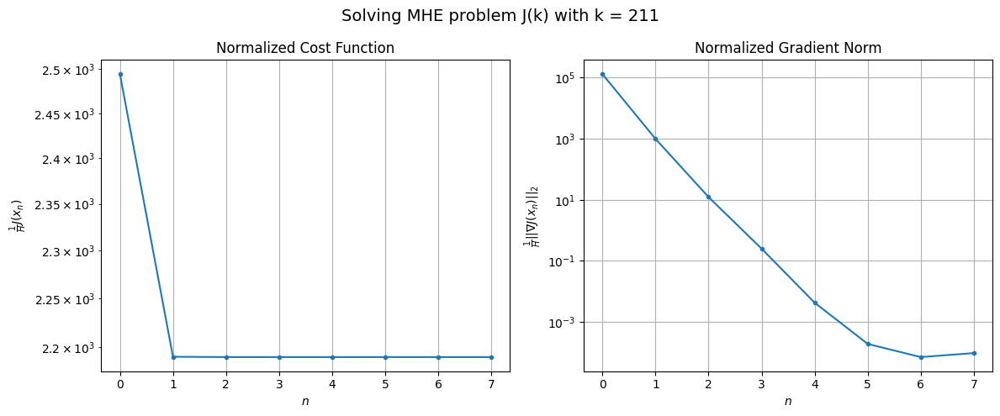

Windows:  51%|█████▏    | 193/376 [17:20<16:54,  5.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 58578.81246837277
Gradient norm: 2900298.129435409
Global estimation error: 85.80491261302039
Initial conditions estimation errors: 7.7065805165914 m, 22.97656089439285 m, 79.80737723569845 m, 20.144490026656484 m
Position estimation errors: 20.172184279578815 m, 81.41101537741008 m, 92.41678906605783 m, 264.83564853168906 m

[Gauss-Newton] Iteration 1
Cost function: 51620.47154206679 (-11.88%)
Gradient norm: 23278.398387634577 (-99.20%)
Global estimation error: 183.2349634629078 (113.55%)
Initial conditions estimation errors: 11.425789465088403 m, 67.6939035658031 m, 153.92708020906943 m, 71.89014759540866 m
Position estimation errors: 15.37075992226976 m, 140.3842504072845 m, 165.64696169853676 m, 407.3235994150075 m

[Gauss-Newton] Iteration 2
Cost function: 51610.260867054734 (-0.02%)
Gradient norm: 30.84261316149754 (-99.87%)
Global estimation error: 183.74511735247825 (0.28%)
Initial conditions estimation errors: 11.4257

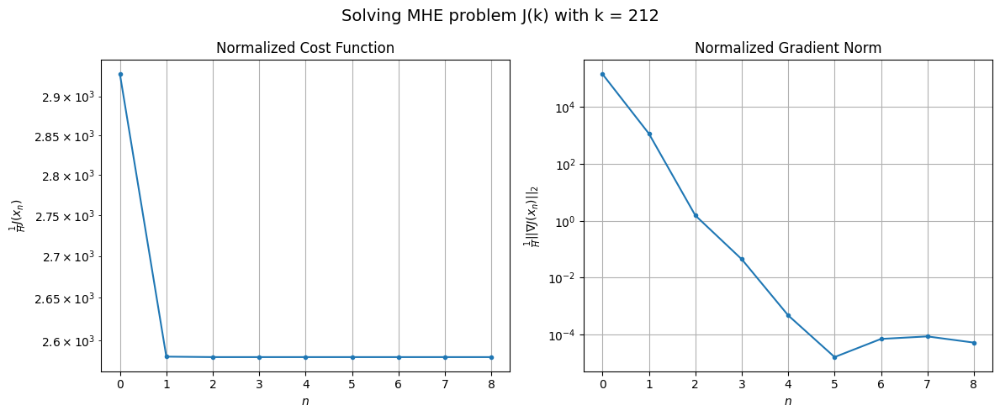

Windows:  52%|█████▏    | 194/376 [17:25<16:16,  5.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 67803.15786346816
Gradient norm: 3148540.5704678027
Global estimation error: 203.8931393618745
Initial conditions estimation errors: 8.250970861565666 m, 78.95232070970839 m, 160.21800050296736 m, 97.98346847790428 m
Position estimation errors: 21.364821628080932 m, 138.16337919284703 m, 165.7397631271821 m, 416.3383186433831 m

[Gauss-Newton] Iteration 1
Cost function: 59768.51222202524 (-11.85%)
Gradient norm: 48681.040715974734 (-98.45%)
Global estimation error: 66.18887364376523 (-67.54%)
Initial conditions estimation errors: 12.280021036242102 m, 14.228925325727683 m, 60.949513267561954 m, 17.685206255924093 m
Position estimation errors: 16.18674892308691 m, 61.504867238607446 m, 78.84470058738832 m, 186.77015837799865 m

[Gauss-Newton] Iteration 2
Cost function: 59725.862055596706 (-0.07%)
Gradient norm: 27.261981837934467 (-99.94%)
Global estimation error: 63.70110100576756 (-3.76%)
Initial conditions estimation errors:

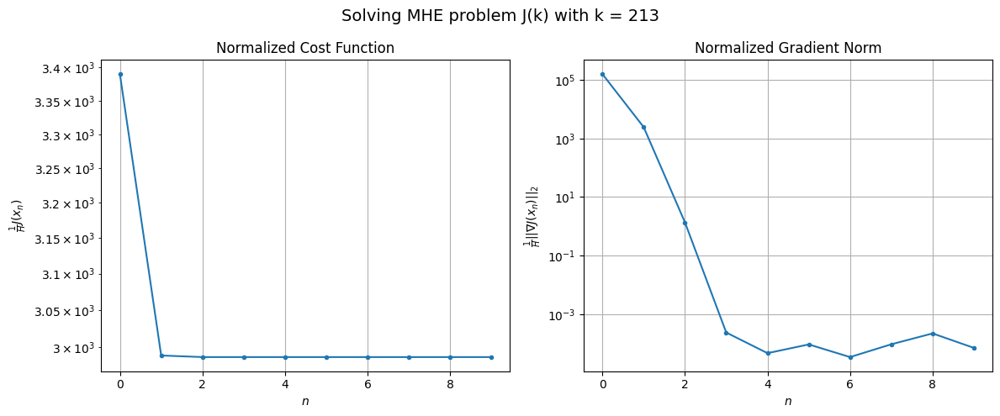

Windows:  52%|█████▏    | 195/376 [17:31<16:12,  5.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 76397.68978203507
Gradient norm: 3330278.5211856603
Global estimation error: 64.19362768185363
Initial conditions estimation errors: 8.858808907546843 m, 17.906786152200088 m, 59.00951654097747 m, 15.475088087175221 m
Position estimation errors: 22.182472485842723 m, 57.780993593755106 m, 78.64239059105884 m, 182.8708573662088 m

[Gauss-Newton] Iteration 1
Cost function: 67443.66386155167 (-11.72%)
Gradient norm: 711.1201819937736 (-99.98%)
Global estimation error: 59.59496108073778 (-7.16%)
Initial conditions estimation errors: 13.139347359463795 m, 10.526403533457191 m, 52.74941922787146 m, 22.033481669407813 m
Position estimation errors: 16.732355360712553 m, 74.88305915927819 m, 81.3279136576259 m, 230.02506187482436 m

[Gauss-Newton] Iteration 2
Cost function: 67443.6560029362 (-0.00%)
Gradient norm: 0.721802997623553 (-99.90%)
Global estimation error: 59.84531636389681 (0.42%)
Initial conditions estimation errors: 13.139

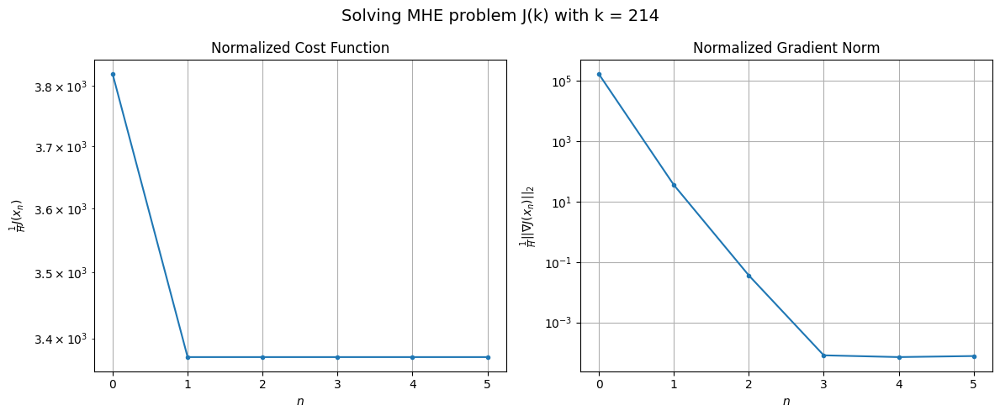

Windows:  52%|█████▏    | 196/376 [17:34<14:31,  4.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 84158.53052038742
Gradient norm: 3442733.6636682306
Global estimation error: 57.74641028078434
Initial conditions estimation errors: 9.482781180353136 m, 11.946833061032091 m, 54.07449033832353 m, 13.334750758562198 m
Position estimation errors: 22.580652343428984 m, 74.45152682270546 m, 83.72498988059958 m, 233.76928210207305 m

[Gauss-Newton] Iteration 1
Cost function: 74404.11096476724 (-11.59%)
Gradient norm: 442.40027863485915 (-99.99%)
Global estimation error: 70.57587805633649 (22.22%)
Initial conditions estimation errors: 13.999146759922953 m, 19.09178898199982 m, 61.162156141759226 m, 26.06853360605379 m
Position estimation errors: 16.902329618944492 m, 63.46998217834385 m, 73.01221231224068 m, 200.76019075399228 m

[Gauss-Newton] Iteration 2
Cost function: 74404.10763593254 (-0.00%)
Gradient norm: 0.310290341215267 (-99.93%)
Global estimation error: 70.97387007009377 (0.56%)
Initial conditions estimation errors: 13.9

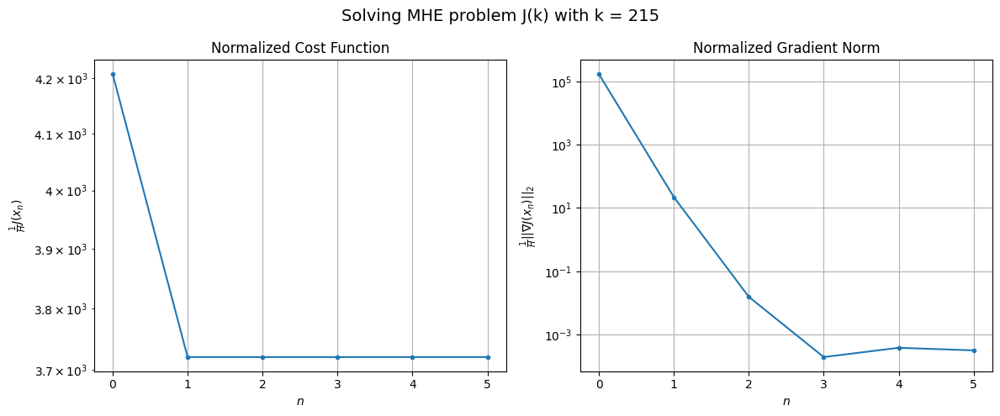

Windows:  52%|█████▏    | 197/376 [17:38<13:11,  4.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 89532.76057977806
Gradient norm: 3451748.250660911
Global estimation error: 78.17277647347323
Initial conditions estimation errors: 10.11388912416558 m, 24.62073936060964 m, 61.347859892731144 m, 40.48275355349469 m
Position estimation errors: 22.438482931352375 m, 62.234086888048196 m, 73.78194179854711 m, 201.66718463466623 m

[Gauss-Newton] Iteration 1
Cost function: 79497.14840185351 (-11.21%)
Gradient norm: 309.52987062774474 (-99.99%)
Global estimation error: 91.06239086126989 (16.49%)
Initial conditions estimation errors: 14.761528105022398 m, 25.150707329394518 m, 70.4290355770198 m, 49.815295338518666 m
Position estimation errors: 16.708239619075542 m, 55.931838755559305 m, 58.785483833191776 m, 178.44669226400882 m

[Gauss-Newton] Iteration 2
Cost function: 79497.14670396602 (-0.00%)
Gradient norm: 0.1625698295865852 (-99.95%)
Global estimation error: 91.36846522199215 (0.34%)
Initial conditions estimation errors: 14

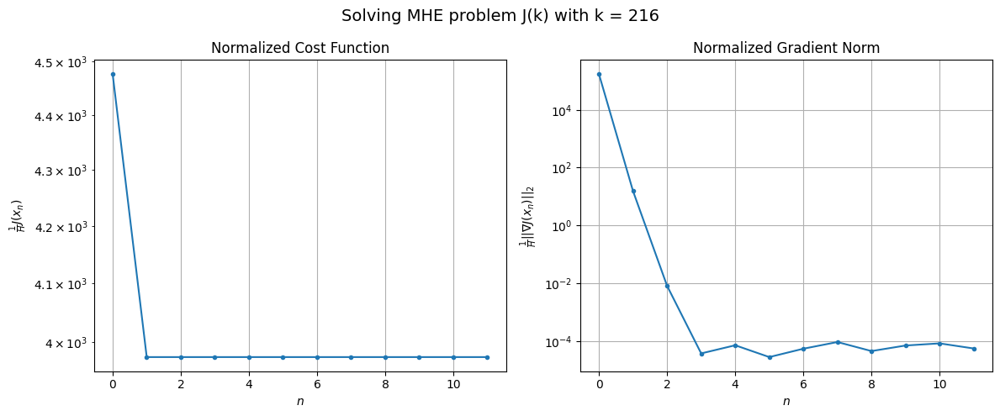

Windows:  53%|█████▎    | 198/376 [17:44<14:39,  4.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 91717.78392996968
Gradient norm: 3404122.6827011476
Global estimation error: 99.2492762049989
Initial conditions estimation errors: 10.630337180641671 m, 30.131705813946525 m, 69.22788894201621 m, 63.53672215960605 m
Position estimation errors: 21.79034340423581 m, 54.69850317666573 m, 58.004590754522546 m, 177.73005046850432 m

[Gauss-Newton] Iteration 1
Cost function: 81534.39721491263 (-11.10%)
Gradient norm: 6300.988093783453 (-99.81%)
Global estimation error: 46.66059143811505 (-52.99%)
Initial conditions estimation errors: 15.420617230290459 m, 11.523125857601002 m, 39.72266568750596 m, 15.122577089848983 m
Position estimation errors: 16.086673842710066 m, 28.760531628996986 m, 31.400655286450956 m, 96.19212138340828 m

[Gauss-Newton] Iteration 2
Cost function: 81533.62865017189 (-0.00%)
Gradient norm: 0.06372593908912474 (-100.00%)
Global estimation error: 46.487697654358975 (-0.37%)
Initial conditions estimation errors

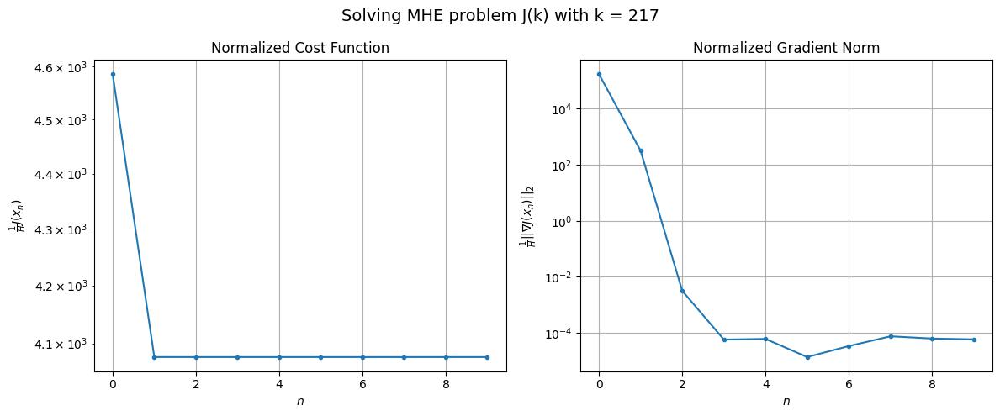

Windows:  53%|█████▎    | 199/376 [17:49<15:00,  5.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 90973.82981482151
Gradient norm: 3270447.397553409
Global estimation error: 45.07722857682233
Initial conditions estimation errors: 10.99281589101375 m, 11.667672949225663 m, 36.661038150772185 m, 20.75815930491382 m
Position estimation errors: 20.63636958603967 m, 29.737075974096737 m, 32.691665409008834 m, 96.61302904702184 m

[Gauss-Newton] Iteration 1
Cost function: 81250.76702678239 (-10.69%)
Gradient norm: 3868.3343393548403 (-99.88%)
Global estimation error: 69.73421211254673 (54.70%)
Initial conditions estimation errors: 15.751563896724143 m, 28.871551812535955 m, 9.596784360553958 m, 60.73745077173186 m
Position estimation errors: 15.114839610978228 m, 19.288780310828727 m, 20.10066598367417 m, 53.1836360560705 m

[Gauss-Newton] Iteration 2
Cost function: 81250.15190978172 (-0.00%)
Gradient norm: 0.013669141883887974 (-100.00%)
Global estimation error: 69.73333967211252 (-0.00%)
Initial conditions estimation errors: 1

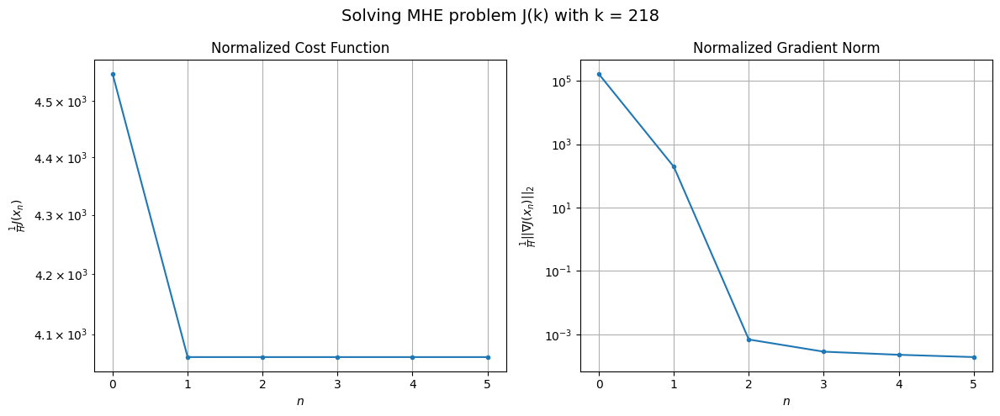

Windows:  53%|█████▎    | 200/376 [17:53<13:25,  4.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 87256.18978441022
Gradient norm: 3099857.685577505
Global estimation error: 58.4002113451714
Initial conditions estimation errors: 11.024855773015014 m, 23.103949000989022 m, 8.55813327459107 m, 51.78763996853137 m
Position estimation errors: 19.187541549952808 m, 23.220934402373405 m, 24.15482301938162 m, 58.435980795474784 m

[Gauss-Newton] Iteration 1
Cost function: 77988.5559073951 (-10.62%)
Gradient norm: 2294.28588062505 (-99.93%)
Global estimation error: 49.261846125864515 (-15.65%)
Initial conditions estimation errors: 15.788802140780824 m, 21.874186518946345 m, 13.10886385235824 m, 39.0780133463776 m
Position estimation errors: 13.901398627872009 m, 13.694156909873929 m, 15.335018597461591 m, 19.847714709937254 m

[Gauss-Newton] Iteration 2
Cost function: 77988.48137798338 (-0.00%)
Gradient norm: 1.8635805364825375 (-99.92%)
Global estimation error: 48.92358034020428 (-0.69%)
Initial conditions estimation errors: 15.7

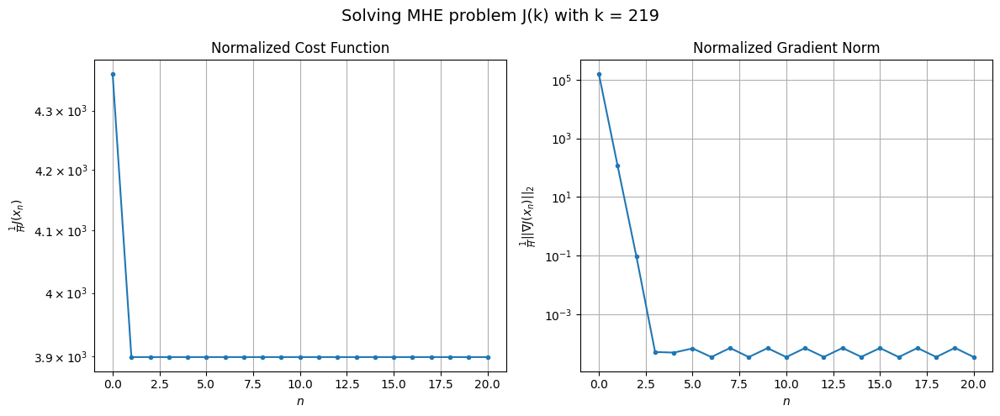

Windows:  53%|█████▎    | 201/376 [18:04<18:50,  6.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 81440.35720508512
Gradient norm: 2912238.130396418
Global estimation error: 42.10583058333619
Initial conditions estimation errors: 10.837920024073949 m, 17.242588196218712 m, 11.352007747375652 m, 35.060512796878655 m
Position estimation errors: 17.683921901325938 m, 16.95314542320057 m, 19.423208913436348 m, 18.925866966830014 m

[Gauss-Newton] Iteration 1
Cost function: 73008.99104433991 (-10.35%)
Gradient norm: 97.0199071530907 (-100.00%)
Global estimation error: 48.08472654455265 (14.20%)
Initial conditions estimation errors: 15.455364189939543 m, 20.684856819743484 m, 10.588039176334357 m, 39.157015098169566 m
Position estimation errors: 12.722586391174273 m, 9.98109744110535 m, 11.794402835219158 m, 18.85260737328189 m

[Gauss-Newton] Iteration 2
Cost function: 73008.99077848738 (-0.00%)
Gradient norm: 0.010314006238440494 (-99.99%)
Global estimation error: 47.93851614926275 (-0.30%)
Initial conditions estimation errors

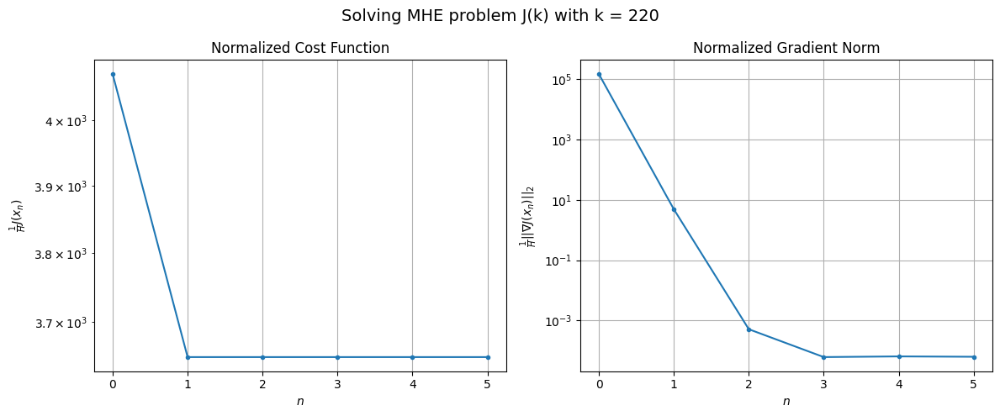

Windows:  54%|█████▎    | 202/376 [18:07<15:56,  5.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 74208.6474606487
Gradient norm: 2724869.106995068
Global estimation error: 40.931178016423885
Initial conditions estimation errors: 10.449242868823134 m, 15.859497810195442 m, 8.416077968160405 m, 35.26748240505078 m
Position estimation errors: 16.439086752902327 m, 13.785217213770226 m, 15.2085744903342 m, 19.39654279304531 m

[Gauss-Newton] Iteration 1
Cost function: 66492.5078909777 (-10.40%)
Gradient norm: 51.144849247532086 (-100.00%)
Global estimation error: 35.209573626208055 (-13.98%)
Initial conditions estimation errors: 14.950787794547956 m, 18.72757358139519 m, 12.791376484830026 m, 22.40124734877687 m
Position estimation errors: 11.793925597375729 m, 10.739326902771342 m, 12.737960020439601 m, 13.85078507696257 m

[Gauss-Newton] Iteration 2
Cost function: 66492.50749834183 (-0.00%)
Gradient norm: 0.05324940385734597 (-99.90%)
Global estimation error: 35.11188796637838 (-0.28%)
Initial conditions estimation errors: 

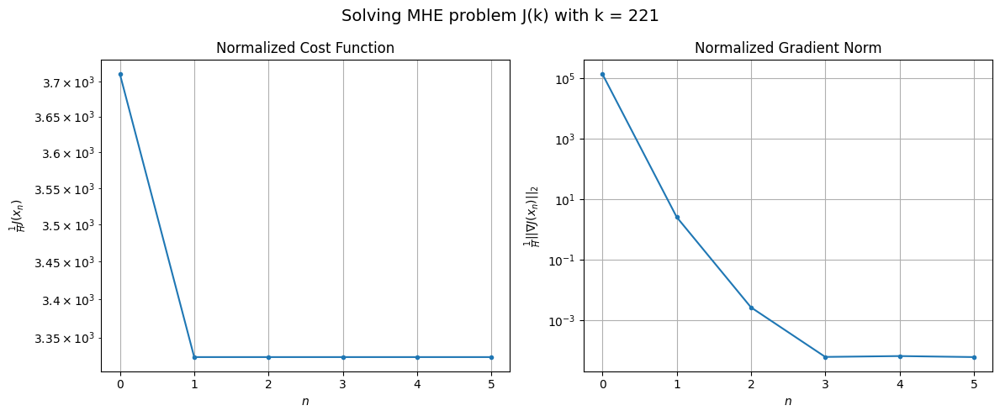

Windows:  54%|█████▍    | 203/376 [18:10<14:04,  4.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 67303.50206282736
Gradient norm: 2579241.154758627
Global estimation error: 27.06740639286973
Initial conditions estimation errors: 10.056871023778186 m, 13.678955958671102 m, 10.008061893992226 m, 18.552748908603053 m
Position estimation errors: 15.578490479152459 m, 14.738862944382024 m, 16.613262812395714 m, 14.591970645118067 m

[Gauss-Newton] Iteration 1
Cost function: 60344.62806183762 (-10.34%)
Gradient norm: 151.69438450389356 (-99.99%)
Global estimation error: 34.66661270482546 (28.08%)
Initial conditions estimation errors: 14.355517638712394 m, 19.50028628158247 m, 16.587703117100034 m, 18.44587436909075 m
Position estimation errors: 11.21538577774147 m, 14.657978126122115 m, 17.522425994672783 m, 17.165603093537232 m

[Gauss-Newton] Iteration 2
Cost function: 60344.62745578269 (-0.00%)
Gradient norm: 0.010134642045692617 (-99.99%)
Global estimation error: 34.72347443657962 (0.16%)
Initial conditions estimation error

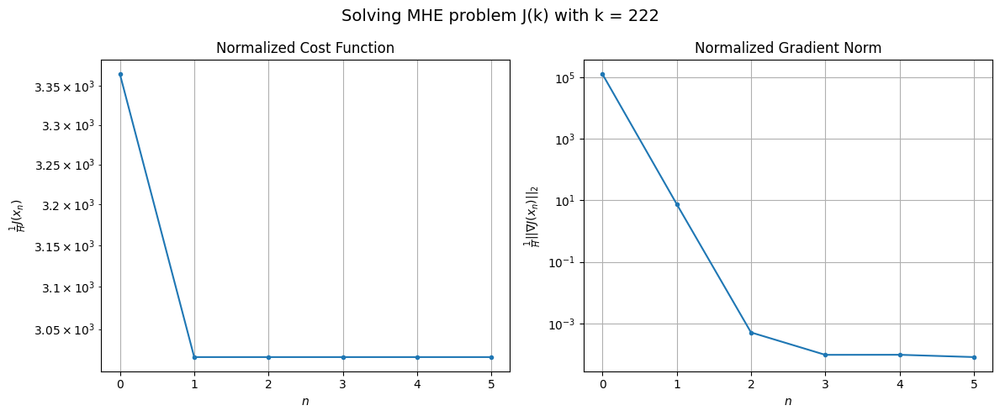

Windows:  54%|█████▍    | 204/376 [18:14<12:38,  4.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 61646.67754645637
Gradient norm: 2499195.4342826786
Global estimation error: 27.31415846774602
Initial conditions estimation errors: 9.677270406945103 m, 14.637848461281452 m, 15.324297786735183 m, 14.257970938965352 m
Position estimation errors: 15.071756531581801 m, 18.889340415519285 m, 21.502825973247273 m, 18.957646242916866 m

[Gauss-Newton] Iteration 1
Cost function: 55174.597856273744 (-10.50%)
Gradient norm: 3545.853687033929 (-99.86%)
Global estimation error: 42.33926795756974 (55.01%)
Initial conditions estimation errors: 13.823325336510203 m, 16.498084280077876 m, 14.873692528852377 m, 33.287853428675135 m
Position estimation errors: 10.904786886474158 m, 22.737274153554186 m, 13.883011252195441 m, 52.009263035982706 m

[Gauss-Newton] Iteration 2
Cost function: 55174.35156277185 (-0.00%)
Gradient norm: 0.041288615911093 (-100.00%)
Global estimation error: 42.63375008021649 (0.70%)
Initial conditions estimation erro

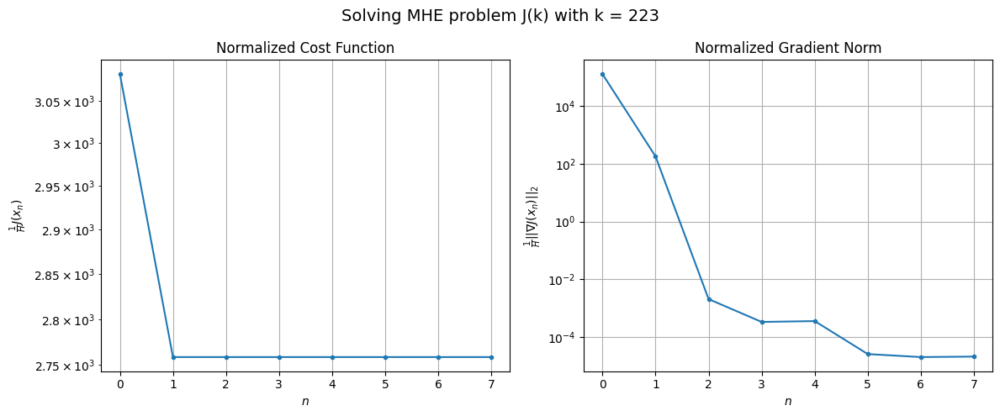

Windows:  55%|█████▍    | 205/376 [18:18<12:41,  4.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 56420.21124630938
Gradient norm: 2344639.0207312917
Global estimation error: 41.95362461499876
Initial conditions estimation errors: 9.358160700113052 m, 15.554115827804 m, 11.008211155483169 m, 36.18552191988776 m
Position estimation errors: 14.758210835326265 m, 25.55524171736365 m, 13.100025515013076 m, 53.59419485230416 m

[Gauss-Newton] Iteration 1
Cost function: 50357.63380369355 (-10.75%)
Gradient norm: 363.06846531152695 (-99.98%)
Global estimation error: 59.10138562189051 (40.87%)
Initial conditions estimation errors: 13.405549205591152 m, 20.271177074685244 m, 16.4228826203513 m, 51.308868819907005 m
Position estimation errors: 10.793281236331127 m, 21.573619718985668 m, 11.45634243258768 m, 51.456064700123385 m

[Gauss-Newton] Iteration 2
Cost function: 50357.62964527338 (-0.00%)
Gradient norm: 0.23289022806365078 (-99.94%)
Global estimation error: 59.585999203613184 (0.82%)
Initial conditions estimation errors: 13.

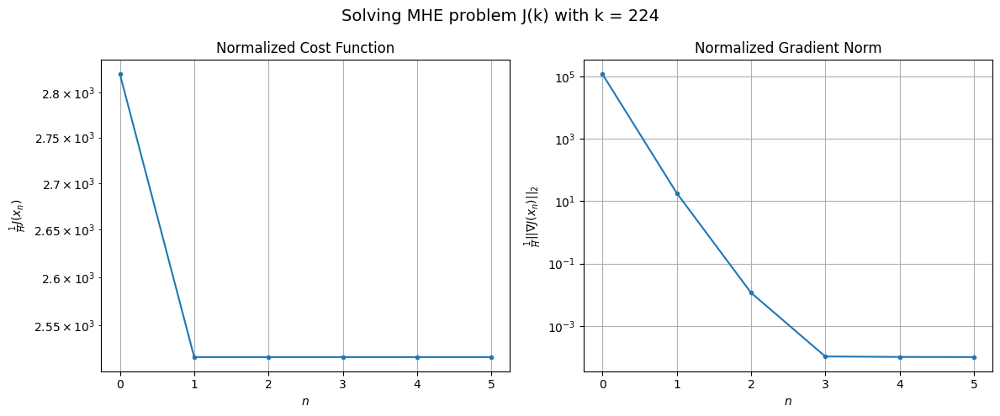

Windows:  55%|█████▍    | 206/376 [18:22<11:41,  4.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 51714.40282050816
Gradient norm: 2163642.6967713465
Global estimation error: 59.21768870242555
Initial conditions estimation errors: 9.102376563227455 m, 18.193027904652457 m, 11.622291783768862 m, 54.385565500766724 m
Position estimation errors: 14.55776723532554 m, 25.15616684821112 m, 14.973461602173005 m, 52.706087649967465 m

[Gauss-Newton] Iteration 1
Cost function: 46067.586721259504 (-10.92%)
Gradient norm: 318.38218850709296 (-99.99%)
Global estimation error: 91.037178771652 (53.73%)
Initial conditions estimation errors: 13.029323601166995 m, 27.14316088739066 m, 17.758231576464844 m, 84.05872687344116 m
Position estimation errors: 10.799590764436534 m, 15.746342910577967 m, 9.58766154318863 m, 15.18210115663657 m

[Gauss-Newton] Iteration 2
Cost function: 46067.584054374674 (-0.00%)
Gradient norm: 0.2280499770482468 (-99.93%)
Global estimation error: 91.30199930919328 (0.29%)
Initial conditions estimation errors: 13.

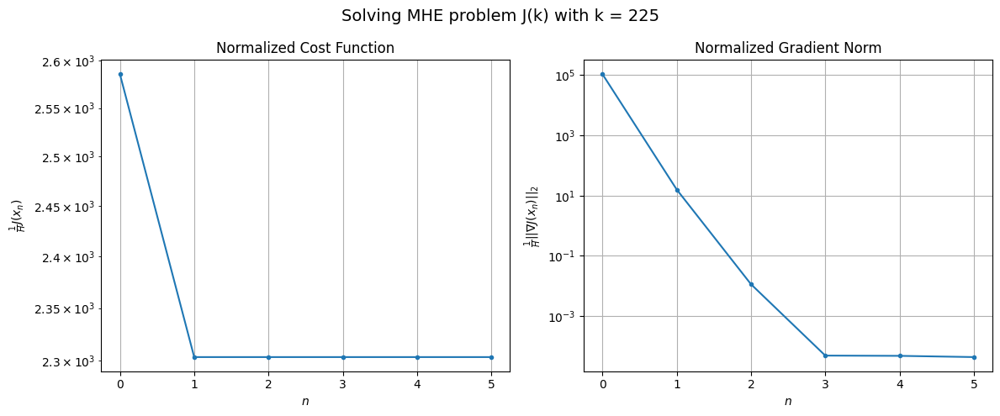

Windows:  55%|█████▌    | 207/376 [18:25<11:10,  3.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 48004.17793360488
Gradient norm: 2042532.7263875962
Global estimation error: 88.67848188601165
Initial conditions estimation errors: 8.836199942224084 m, 25.77613254358365 m, 12.6925143567035 m, 83.42817559833804 m
Position estimation errors: 14.404547069410633 m, 18.73596800566445 m, 13.293095128046533 m, 14.93031131162804 m

[Gauss-Newton] Iteration 1
Cost function: 42515.09040530743 (-11.43%)
Gradient norm: 1611.8236607108652 (-99.92%)
Global estimation error: 117.04297447860382 (31.99%)
Initial conditions estimation errors: 12.69182777632506 m, 37.378220040641125 m, 22.96558516337961 m, 107.76546833575902 m
Position estimation errors: 10.746360979450893 m, 22.01396399095028 m, 4.227561389913053 m, 61.187378542045046 m

[Gauss-Newton] Iteration 2
Cost function: 42515.045433505424 (-0.00%)
Gradient norm: 0.027898336181866667 (-100.00%)
Global estimation error: 116.86881608569443 (-0.15%)
Initial conditions estimation errors:

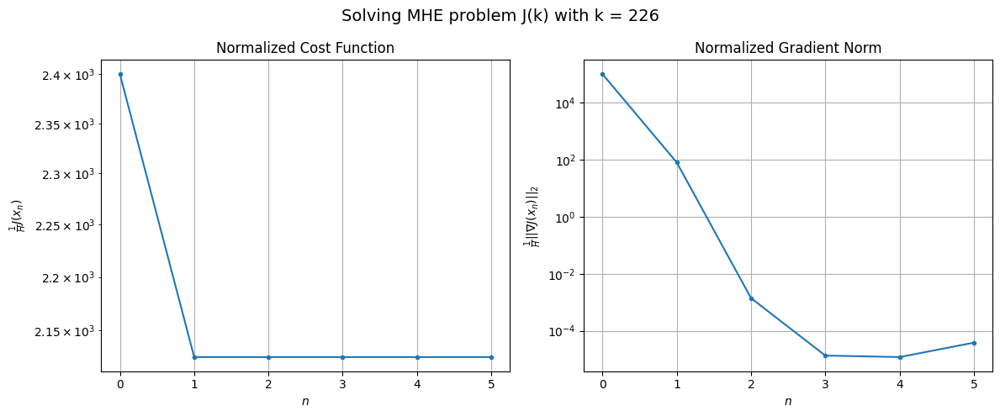

Windows:  55%|█████▌    | 208/376 [18:28<10:33,  3.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 44387.35257729741
Gradient norm: 1794803.6913087368
Global estimation error: 117.26839333198713
Initial conditions estimation errors: 8.587304848179249 m, 36.99301974767977 m, 19.668319440794313 m, 109.19149895011638 m
Position estimation errors: 14.131231387103854 m, 23.49366705719668 m, 6.759233011220707 m, 57.8180162506922 m

[Gauss-Newton] Iteration 1
Cost function: 39311.68596168655 (-11.43%)
Gradient norm: 194.80722626351178 (-99.99%)
Global estimation error: 88.17220253960957 (-24.81%)
Initial conditions estimation errors: 12.290097166374556 m, 33.42763088617311 m, 15.227461167530073 m, 79.20846235386968 m
Position estimation errors: 10.663398853450005 m, 19.25081190152328 m, 1.2248967647681754 m, 50.656733371101076 m

[Gauss-Newton] Iteration 2
Cost function: 39311.68188879837 (-0.00%)
Gradient norm: 0.002142575675615427 (-100.00%)
Global estimation error: 88.12075815745648 (-0.06%)
Initial conditions estimation errors

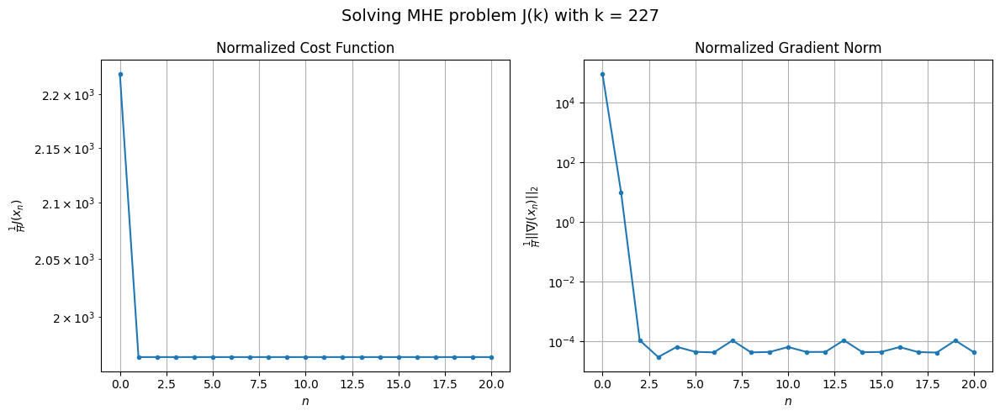

Windows:  56%|█████▌    | 209/376 [18:41<17:49,  6.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 40824.79784474798
Gradient norm: 1557782.573505284
Global estimation error: 87.55498729554833
Initial conditions estimation errors: 8.315072815216123 m, 32.505033792677125 m, 12.490427944432481 m, 79.90071816389184 m
Position estimation errors: 13.800635496554843 m, 20.803214425904613 m, 3.0583515030113935 m, 49.51685589039969 m

[Gauss-Newton] Iteration 1
Cost function: 36153.43635484046 (-11.44%)
Gradient norm: 1704.2346560036822 (-99.89%)
Global estimation error: 33.608346867162 (-61.61%)
Initial conditions estimation errors: 11.856184454636535 m, 20.0806540444439 m, 9.01039893411478 m, 22.461227029543956 m
Position estimation errors: 10.51332448466888 m, 11.764762804513891 m, 6.349043530695693 m, 12.87230554984756 m

[Gauss-Newton] Iteration 2
Cost function: 36153.32641640308 (-0.00%)
Gradient norm: 0.00801794725400047 (-100.00%)
Global estimation error: 33.69640875888015 (0.26%)
Initial conditions estimation errors: 11.85

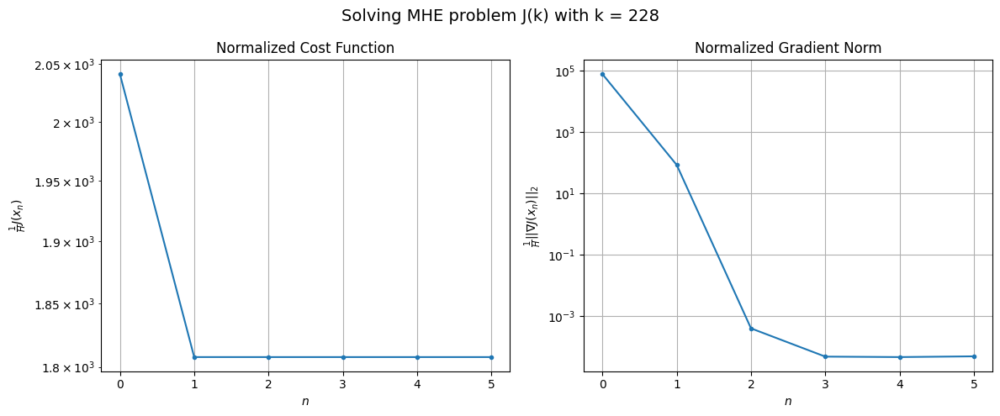

Windows:  56%|█████▌    | 210/376 [18:45<16:00,  5.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 38045.899591422974
Gradient norm: 1400349.3290801577
Global estimation error: 28.35267374923093
Initial conditions estimation errors: 8.059192433793442 m, 17.757010576039015 m, 4.954554386038337 m, 19.976106651184814 m
Position estimation errors: 13.417909848177421 m, 14.024887456330163 m, 9.410376136301236 m, 15.085447224716363 m

[Gauss-Newton] Iteration 1
Cost function: 33610.782904448875 (-11.66%)
Gradient norm: 1268.1865226597913 (-99.91%)
Global estimation error: 118.20880735112503 (316.92%)
Initial conditions estimation errors: 11.46004682288071 m, 39.97816053610195 m, 11.006673554054826 m, 110.10251344457174 m
Position estimation errors: 10.197626586910939 m, 11.543010107769986 m, 7.5974039129993445 m, 17.986756123260985 m

[Gauss-Newton] Iteration 2
Cost function: 33610.592136352476 (-0.00%)
Gradient norm: 1.0142076628838843 (-99.92%)
Global estimation error: 118.50561557939265 (0.25%)
Initial conditions estimation er

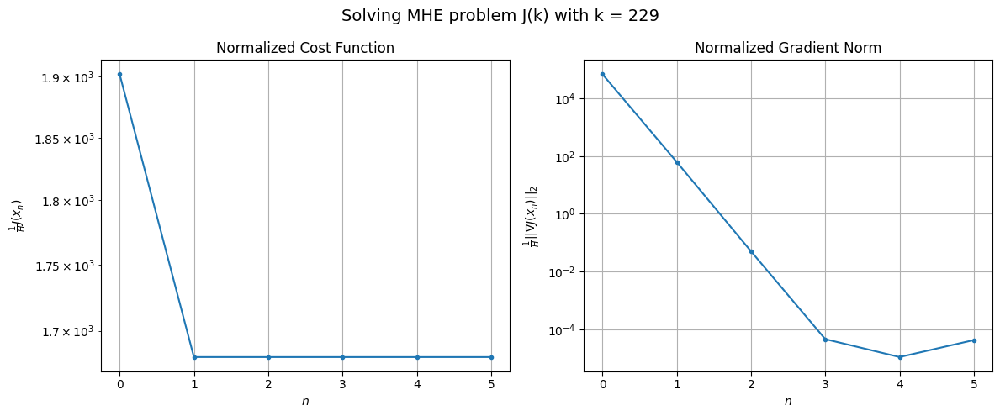

Windows:  56%|█████▌    | 211/376 [18:49<14:30,  5.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 35346.73800904297
Gradient norm: 1233364.3491672755
Global estimation error: 114.17583281762975
Initial conditions estimation errors: 7.85758930929925 m, 37.653477584964186 m, 9.553059022941042 m, 107.07620014032953 m
Position estimation errors: 12.92009728701134 m, 12.581954673898244 m, 11.30991818912137 m, 15.532300836102296 m

[Gauss-Newton] Iteration 1
Cost function: 31369.890572648867 (-11.25%)
Gradient norm: 2170.497932218529 (-99.82%)
Global estimation error: 73.901443541444 (-35.27%)
Initial conditions estimation errors: 11.044761553070845 m, 26.051033351576525 m, 10.312490572785943 m, 67.4863052922575 m
Position estimation errors: 9.86860067753282 m, 6.318132760649156 m, 17.783581603420735 m, 42.91656013355185 m

[Gauss-Newton] Iteration 2
Cost function: 31369.79267143453 (-0.00%)
Gradient norm: 0.014168981316044355 (-100.00%)
Global estimation error: 73.9494837758435 (0.07%)
Initial conditions estimation errors: 11.0

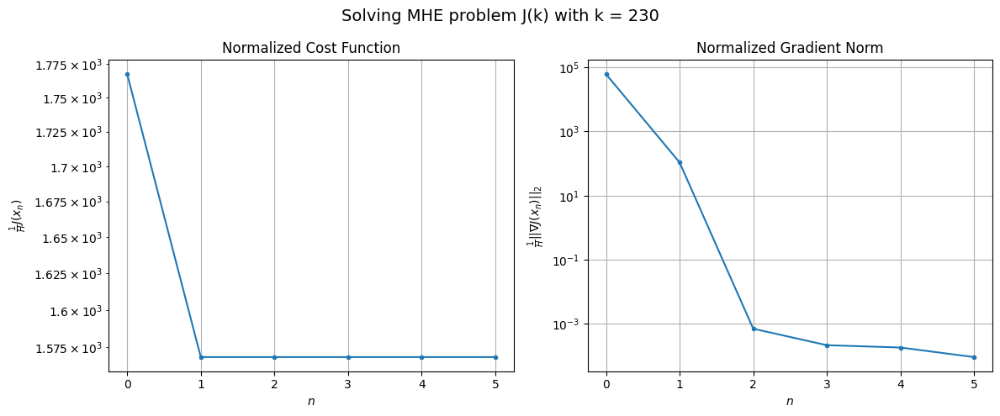

Windows:  56%|█████▋    | 212/376 [18:54<13:30,  4.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 32989.39017259172
Gradient norm: 1144787.648150491
Global estimation error: 65.34124154791627
Initial conditions estimation errors: 7.608532135048116 m, 22.537275760482864 m, 7.058044720534927 m, 60.44679392146653 m
Position estimation errors: 12.489582189589072 m, 6.105487640836231 m, 20.620525094766048 m, 45.45049751672444 m

[Gauss-Newton] Iteration 1
Cost function: 29290.200290141504 (-11.21%)
Gradient norm: 682.1261332384889 (-99.94%)
Global estimation error: 54.191608954805304 (-17.06%)
Initial conditions estimation errors: 10.657444506709885 m, 17.977596780180374 m, 18.272261617245356 m, 46.540708048914986 m
Position estimation errors: 9.5180467666631 m, 11.522650374917987 m, 20.01121573169996 m, 84.08023535553502 m

[Gauss-Newton] Iteration 2
Cost function: 29290.19164564086 (-0.00%)
Gradient norm: 0.03358707790727238 (-100.00%)
Global estimation error: 54.12304827043956 (-0.13%)
Initial conditions estimation errors: 1

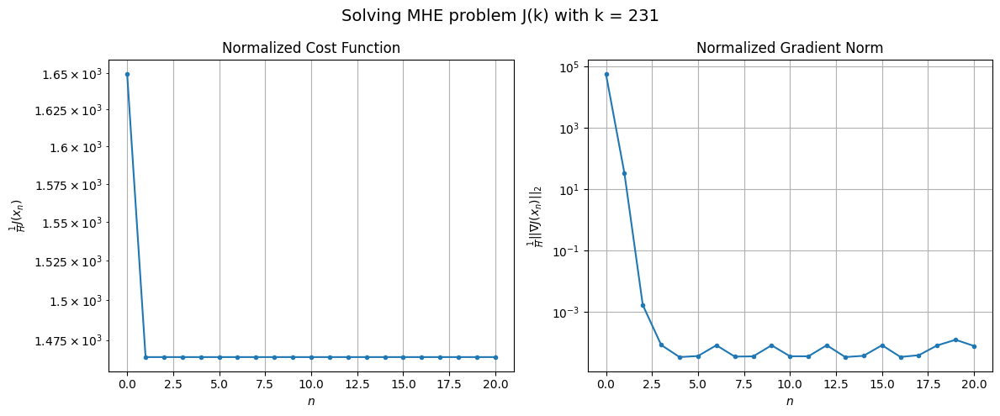

Windows:  57%|█████▋    | 213/376 [19:07<19:56,  7.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30876.178763366792
Gradient norm: 1103113.5105942306
Global estimation error: 42.512057041856664
Initial conditions estimation errors: 7.35284128948881 m, 13.436624421486083 m, 15.529879605800081 m, 36.48905568571862 m
Position estimation errors: 12.106572145069295 m, 9.969651586700595 m, 22.095639731491556 m, 85.98886771011472 m

[Gauss-Newton] Iteration 1
Cost function: 27410.974140686776 (-11.22%)
Gradient norm: 9431.240511651004 (-99.15%)
Global estimation error: 86.8201819129169 (104.22%)
Initial conditions estimation errors: 10.273697170089669 m, 30.65546449260825 m, 6.895100631382903 m, 80.28002076977214 m
Position estimation errors: 9.178034677559246 m, 13.800395859158884 m, 11.19491290101303 m, 59.94355397356329 m

[Gauss-Newton] Iteration 2
Cost function: 27409.653836487632 (-0.00%)
Gradient norm: 0.5837787096753762 (-99.99%)
Global estimation error: 86.82692815519971 (0.01%)
Initial conditions estimation errors: 10.

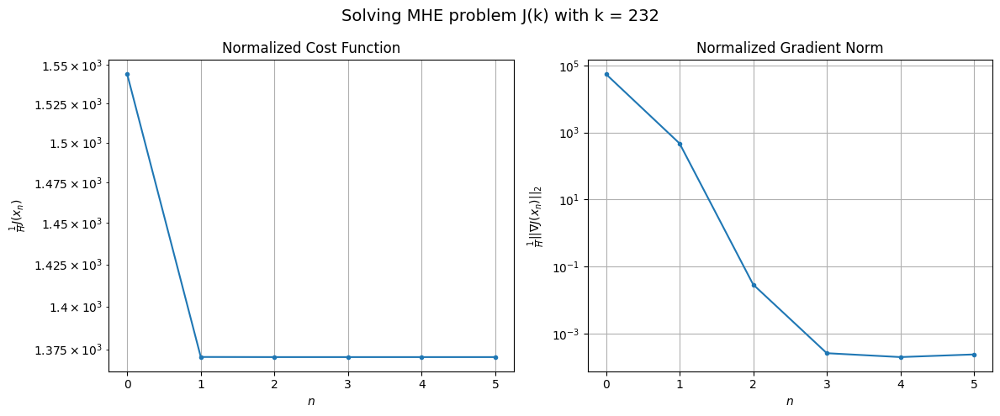

Windows:  57%|█████▋    | 214/376 [19:11<17:12,  6.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29064.281020622217
Gradient norm: 1082122.3895444807
Global estimation error: 84.82854927162884
Initial conditions estimation errors: 7.079485102697156 m, 27.89411717564913 m, 5.562180712054996 m, 79.60360522375454 m
Position estimation errors: 11.756491944898006 m, 15.251132332620637 m, 14.24605490301989 m, 60.03339178834455 m

[Gauss-Newton] Iteration 1
Cost function: 25735.800924105763 (-11.45%)
Gradient norm: 79.67906735344366 (-99.99%)
Global estimation error: 75.01389877161819 (-11.57%)
Initial conditions estimation errors: 9.926279283342256 m, 31.275783835942843 m, 2.958532944213693 m, 67.39150435153007 m
Position estimation errors: 8.855115151896692 m, 11.80040311871997 m, 9.886264697813035 m, 56.61229636191817 m

[Gauss-Newton] Iteration 2
Cost function: 25735.8003825702 (-0.00%)
Gradient norm: 1.228973054866698 (-98.46%)
Global estimation error: 75.85563467224087 (1.12%)
Initial conditions estimation errors: 9.926279

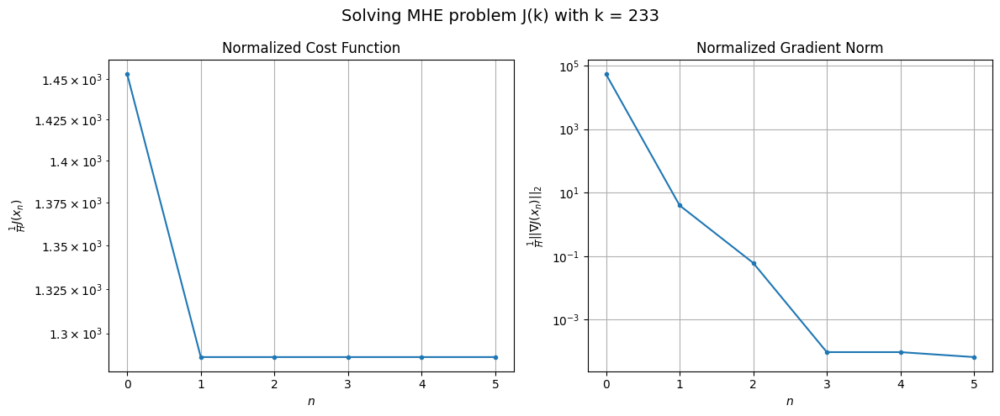

Windows:  57%|█████▋    | 215/376 [19:15<15:13,  5.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27264.394566315033
Gradient norm: 1059990.3116811272
Global estimation error: 73.70401475946781
Initial conditions estimation errors: 6.829836736007432 m, 28.42845590032061 m, 5.444096392351737 m, 67.43746014224266 m
Position estimation errors: 11.416925858597786 m, 13.259911373554383 m, 13.22308685966817 m, 57.76749717625913 m

[Gauss-Newton] Iteration 1
Cost function: 24069.926623560674 (-11.72%)
Gradient norm: 72.11598677394365 (-99.99%)
Global estimation error: 58.65530038325909 (-20.42%)
Initial conditions estimation errors: 9.611370450883097 m, 24.902620265710787 m, 3.0002949596481474 m, 52.14320624830506 m
Position estimation errors: 8.538446877519567 m, 13.066284837327586 m, 10.678939876456964 m, 49.85594891165791 m

[Gauss-Newton] Iteration 2
Cost function: 24069.926297120193 (-0.00%)
Gradient norm: 0.09868921329740223 (-99.86%)
Global estimation error: 59.03769668712728 (0.65%)
Initial conditions estimation errors: 9

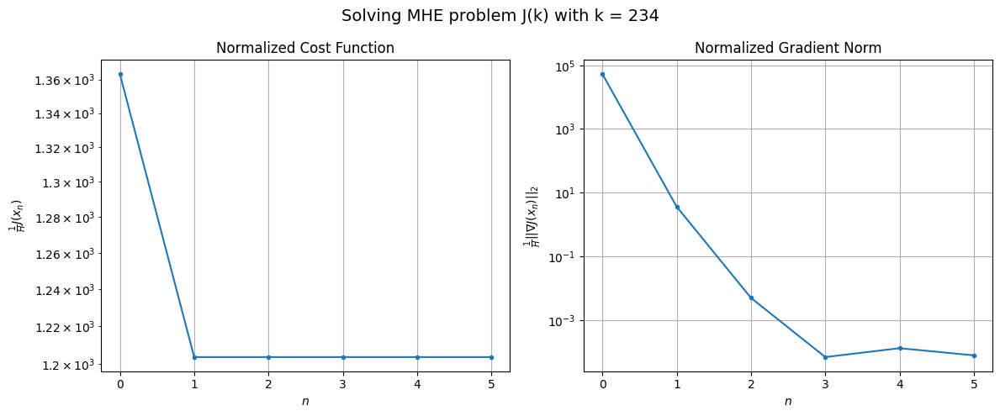

Windows:  57%|█████▋    | 216/376 [19:19<13:55,  5.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25367.61877105849
Gradient norm: 999584.8100912019
Global estimation error: 56.70494126270629
Initial conditions estimation errors: 6.626722388802327 m, 22.091328169856048 m, 5.585548503216022 m, 51.50052966296847 m
Position estimation errors: 11.049288221017074 m, 14.768741994651627 m, 13.903596696214812 m, 50.7036435632456 m

[Gauss-Newton] Iteration 1
Cost function: 22514.772558467484 (-11.25%)
Gradient norm: 9108.603550035908 (-99.09%)
Global estimation error: 49.693049542208385 (-12.37%)
Initial conditions estimation errors: 9.258445255982213 m, 4.921796562490018 m, 11.947963300151184 m, 47.081582159011134 m
Position estimation errors: 8.324591263938167 m, 11.728322698644316 m, 9.545661307572349 m, 79.02604177154248 m

[Gauss-Newton] Iteration 2
Cost function: 22513.06480611826 (-0.01%)
Gradient norm: 8.00602597963224 (-99.91%)
Global estimation error: 52.934069219421524 (6.52%)
Initial conditions estimation errors: 9.258

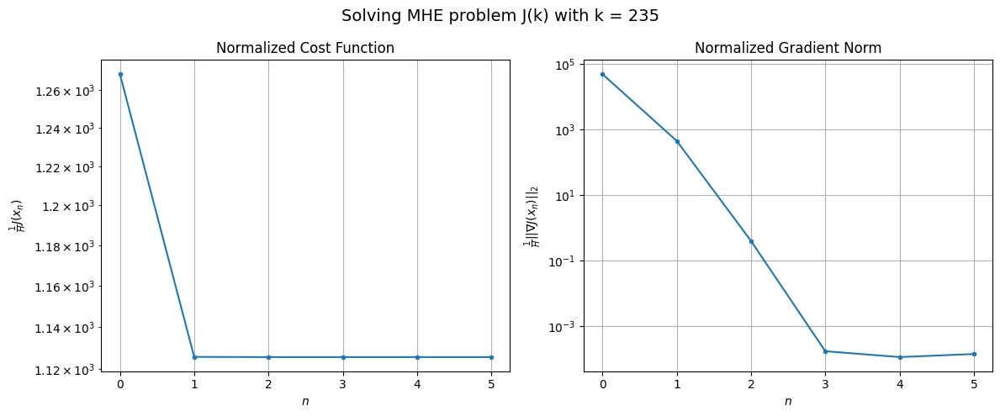

Windows:  58%|█████▊    | 217/376 [19:23<12:55,  4.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23995.509612152426
Gradient norm: 985890.286377393
Global estimation error: 59.38912570644881
Initial conditions estimation errors: 6.39502332031289 m, 2.318508013412997 m, 10.135906312575203 m, 58.120877763625494 m
Position estimation errors: 10.76590545166523 m, 10.2516328460994 m, 11.828145488468992 m, 77.98340291866303 m

[Gauss-Newton] Iteration 1
Cost function: 21278.88977165682 (-11.32%)
Gradient norm: 1019.9867009217351 (-99.90%)
Global estimation error: 73.64893349847442 (24.01%)
Initial conditions estimation errors: 8.94297617318934 m, 2.4632124221977594 m, 11.906536879816239 m, 72.08567951469685 m
Position estimation errors: 8.084190594127934 m, 3.3247306475687264 m, 9.114719752338456 m, 18.680008151696057 m

[Gauss-Newton] Iteration 2
Cost function: 21278.874672886635 (-0.00%)
Gradient norm: 0.19198390505257462 (-99.98%)
Global estimation error: 73.15305384340537 (-0.67%)
Initial conditions estimation errors: 8.942

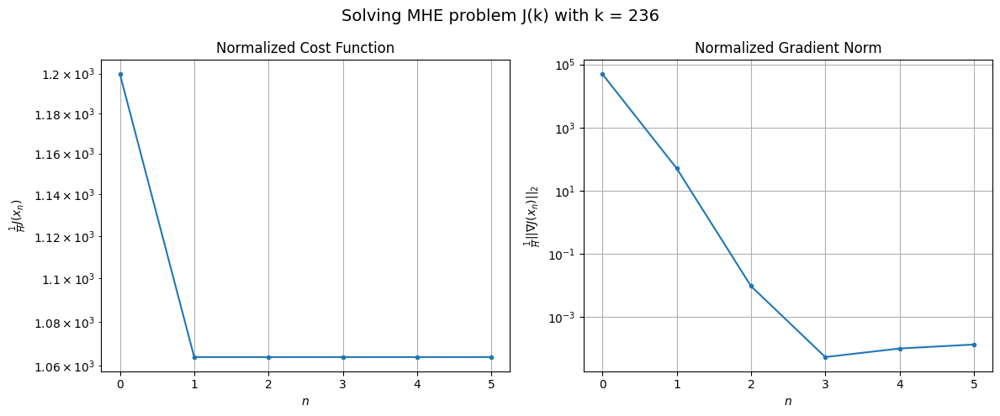

Windows:  58%|█████▊    | 218/376 [19:27<12:04,  4.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22773.70481177462
Gradient norm: 967250.2519291167
Global estimation error: 75.20545450464897
Initial conditions estimation errors: 6.198594782301879 m, 4.885550984095665 m, 9.5919612660474 m, 74.17247310290792 m
Position estimation errors: 10.431728807259335 m, 4.008939652971721 m, 11.547250405225075 m, 11.109362840293297 m

[Gauss-Newton] Iteration 1
Cost function: 20139.835524156366 (-11.57%)
Gradient norm: 1348.908985813967 (-99.86%)
Global estimation error: 27.9465634419079 (-62.84%)
Initial conditions estimation errors: 8.698289416375633 m, 9.083656124859894 m, 9.548700789038174 m, 23.057590059718052 m
Position estimation errors: 7.797519860435327 m, 5.461800594867676 m, 8.057372935370303 m, 31.315982980843046 m

[Gauss-Newton] Iteration 2
Cost function: 20139.790871468656 (-0.00%)
Gradient norm: 1.821940490281895 (-99.86%)
Global estimation error: 26.591102256069156 (-4.85%)
Initial conditions estimation errors: 8.69828

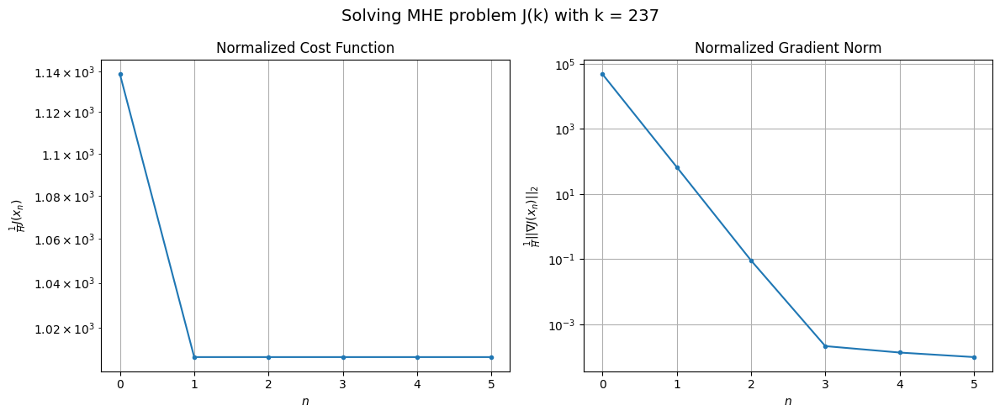

Windows:  58%|█████▊    | 219/376 [19:31<11:34,  4.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 21349.677818695767
Gradient norm: 928186.0246749427
Global estimation error: 24.1944317293955
Initial conditions estimation errors: 6.0484638317750345 m, 6.588651079184578 m, 6.772908903353942 m, 21.435907472286885 m
Position estimation errors: 10.033507555512642 m, 7.95435934766589 m, 10.317810020972436 m, 37.74815063989742 m

[Gauss-Newton] Iteration 1
Cost function: 18951.101329468816 (-11.23%)
Gradient norm: 23310.792560073023 (-97.49%)
Global estimation error: 216.2858160472855 (793.95%)
Initial conditions estimation errors: 8.433637900710872 m, 27.425516338097403 m, 27.061663852510843 m, 212.65911422768505 m
Position estimation errors: 7.5227718048336945 m, 30.20748227373727 m, 4.125142575619879 m, 157.78185894651813 m

[Gauss-Newton] Iteration 2
Cost function: 18938.032173595882 (-0.07%)
Gradient norm: 57.4318414075601 (-99.75%)
Global estimation error: 226.41783270915354 (4.68%)
Initial conditions estimation errors: 8.

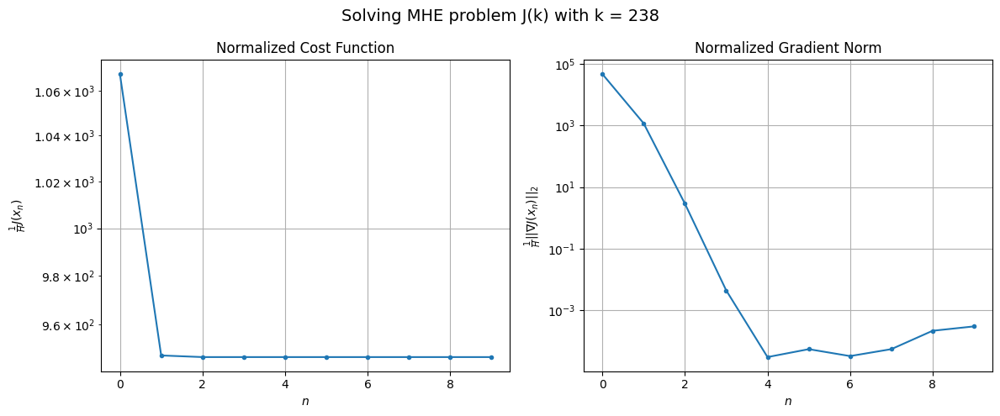

Windows:  59%|█████▊    | 220/376 [19:37<12:52,  4.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20077.486346872145
Gradient norm: 907044.6198540841
Global estimation error: 235.8621251812556
Initial conditions estimation errors: 5.862518095452033 m, 33.80316459068043 m, 25.080672861123944 m, 232.00182789093336 m
Position estimation errors: 9.667061942189545 m, 28.131973459087124 m, 6.210664623185466 m, 153.24328909715513 m

[Gauss-Newton] Iteration 1
Cost function: 17899.22888135162 (-10.85%)
Gradient norm: 12954.83627243402 (-98.57%)
Global estimation error: 416.35669981612597 (76.53%)
Initial conditions estimation errors: 8.120516115227362 m, 61.4296853276565 m, 40.11721360323526 m, 409.76077781086514 m
Position estimation errors: 7.290731086473335 m, 54.038925395556106 m, 6.756534455105168 m, 280.340551274 m

[Gauss-Newton] Iteration 2
Cost function: 17893.783183088057 (-0.03%)
Gradient norm: 4.991010833730313 (-99.96%)
Global estimation error: 419.1270039833015 (0.67%)
Initial conditions estimation errors: 8.12051613

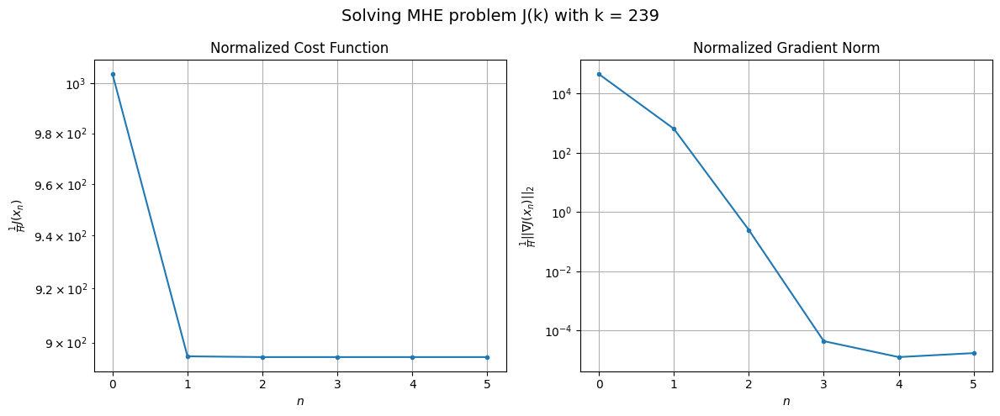

Windows:  59%|█████▉    | 221/376 [19:41<12:11,  4.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 19044.437495583046
Gradient norm: 913197.0204693218
Global estimation error: 431.8405599460315
Initial conditions estimation errors: 5.628371104952507 m, 67.10238723000826 m, 36.81503141647187 m, 424.9664256228926 m
Position estimation errors: 9.391542216894335 m, 49.113309632775426 m, 9.33472794138049 m, 258.3022988391113 m

[Gauss-Newton] Iteration 1
Cost function: 17011.443148945316 (-10.68%)
Gradient norm: 200.4252109895405 (-99.98%)
Global estimation error: 431.9552861797644 (0.03%)
Initial conditions estimation errors: 7.796973105008857 m, 65.63214601887141 m, 38.13468421649392 m, 425.16194259166355 m
Position estimation errors: 7.110162703122016 m, 56.541913337881965 m, 9.04886205917542 m, 285.44468937851553 m

[Gauss-Newton] Iteration 2
Cost function: 17011.442557211976 (-0.00%)
Gradient norm: 3.1118125259861187 (-98.45%)
Global estimation error: 429.47146985335695 (-0.58%)
Initial conditions estimation errors: 7.79697

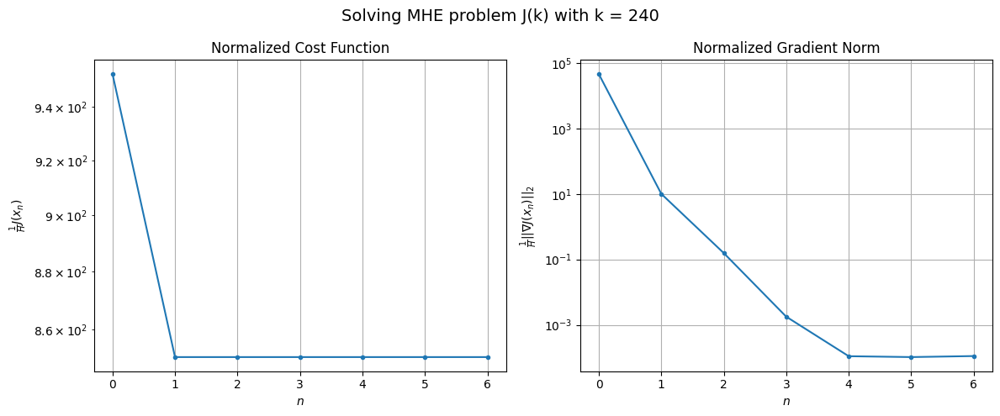

Windows:  59%|█████▉    | 222/376 [19:46<11:55,  4.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 18366.33816772388
Gradient norm: 981776.6223563157
Global estimation error: 442.13197653676957
Initial conditions estimation errors: 5.406955927652538 m, 70.31485856943209 m, 34.32883563727546 m, 435.1192395867929 m
Position estimation errors: 9.222519741181717 m, 50.762799575592375 m, 11.261654048755755 m, 257.92032637355186 m

[Gauss-Newton] Iteration 1
Cost function: 16410.381143622446 (-10.65%)
Gradient norm: 9976.888230686869 (-98.98%)
Global estimation error: 272.27790568797457 (-38.42%)
Initial conditions estimation errors: 7.506162674335489 m, 38.66254692341335 m, 23.58687389137461 m, 268.3798715161151 m
Position estimation errors: 6.974266820546006 m, 34.997793365964824 m, 7.300615601458908 m, 151.66519361671024 m

[Gauss-Newton] Iteration 2
Cost function: 16407.014281499352 (-0.02%)
Gradient norm: 213.77579578309772 (-97.86%)
Global estimation error: 251.14617490207283 (-7.76%)
Initial conditions estimation errors: 7

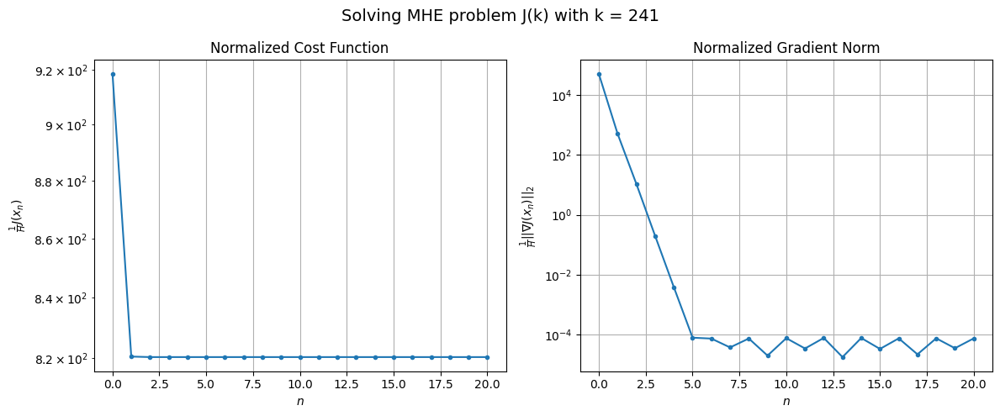

Windows:  59%|█████▉    | 223/376 [19:58<17:54,  7.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 17835.849916128893
Gradient norm: 1013672.993018207
Global estimation error: 253.74622751347448
Initial conditions estimation errors: 5.247132980001701 m, 38.12264602856359 m, 18.82936011513463 m, 250.1034146578072 m
Position estimation errors: 9.131592182929438 m, 28.118000607634904 m, 8.397900134062366 m, 114.84066478469668 m

[Gauss-Newton] Iteration 1
Cost function: 16023.858447696657 (-10.16%)
Gradient norm: 4717.6651881288 (-99.53%)
Global estimation error: 349.4627825818108 (37.72%)
Initial conditions estimation errors: 7.240735244719411 m, 55.45254511701745 m, 28.778214974200008 m, 343.75660374510437 m
Position estimation errors: 6.953175143871083 m, 38.71104156633666 m, 11.984041223812842 m, 201.39840578347702 m

[Gauss-Newton] Iteration 2
Cost function: 16023.276300434662 (-0.00%)
Gradient norm: 81.37078496117734 (-98.28%)
Global estimation error: 363.6344727445037 (4.06%)
Initial conditions estimation errors: 7.2407

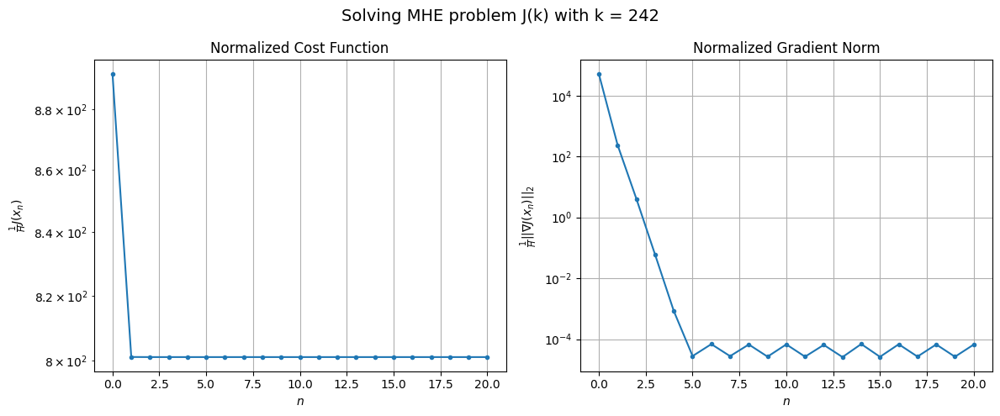

Windows:  60%|█████▉    | 224/376 [20:11<21:44,  8.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 17775.875616104047
Gradient norm: 1073530.2985340299
Global estimation error: 374.26740917851697
Initial conditions estimation errors: 5.13501352013949 m, 62.22794859670732 m, 26.39483676278002 m, 368.07702093788845 m
Position estimation errors: 9.18953918262609 m, 35.415978824623835 m, 13.594418209485061 m, 190.6752209128691 m

[Gauss-Newton] Iteration 1
Cost function: 16162.632714951793 (-9.08%)
Gradient norm: 80684.52905397597 (-92.48%)
Global estimation error: 111.12634744692141 (-70.31%)
Initial conditions estimation errors: 7.118099991799229 m, 27.41117572642207 m, 10.644852035602392 m, 106.92850097365148 m
Position estimation errors: 6.970494944330177 m, 13.493314387889994 m, 6.588867287810426 m, 120.1810122417033 m

[Gauss-Newton] Iteration 2
Cost function: 15944.938868987902 (-1.35%)
Gradient norm: 1215.4890318380913 (-98.49%)
Global estimation error: 59.142478490853286 (-46.78%)
Initial conditions estimation errors: 

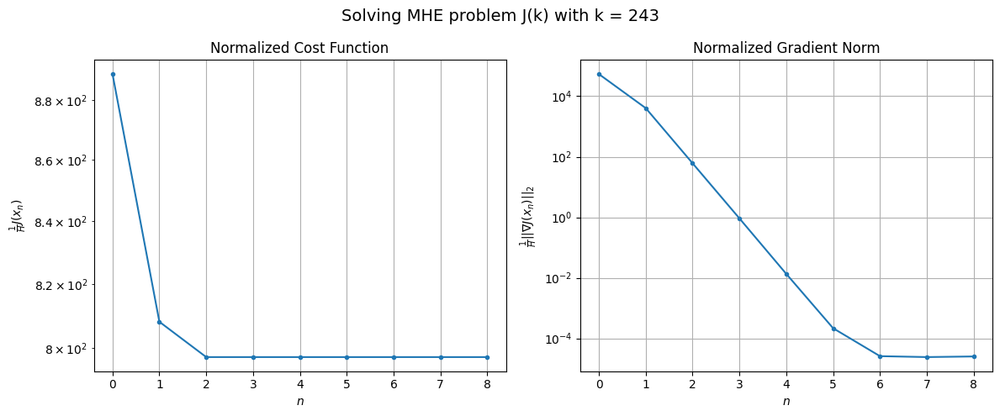

Windows:  60%|█████▉    | 225/376 [20:16<19:25,  7.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 17811.07404868653
Gradient norm: 1126112.3743805627
Global estimation error: 65.71962545448746
Initial conditions estimation errors: 5.147311615729115 m, 16.718553002501704 m, 7.739280675506863 m, 62.87418006524386 m
Position estimation errors: 9.311867276094691 m, 9.695977687677681 m, 8.098307092142292 m, 83.11276302481807 m

[Gauss-Newton] Iteration 1
Cost function: 16045.093148099724 (-9.92%)
Gradient norm: 35801.27446643919 (-96.82%)
Global estimation error: 367.7024980053522 (459.50%)
Initial conditions estimation errors: 7.099947408775034 m, 67.79642631227989 m, 22.24888840018984 m, 360.6429174598178 m
Position estimation errors: 7.073100575364946 m, 45.35462379620378 m, 13.029436249474523 m, 300.5262283783646 m

[Gauss-Newton] Iteration 2
Cost function: 16006.92764322549 (-0.24%)
Gradient norm: 65.31461812110155 (-99.82%)
Global estimation error: 356.18434739428017 (-3.13%)
Initial conditions estimation errors: 7.099947

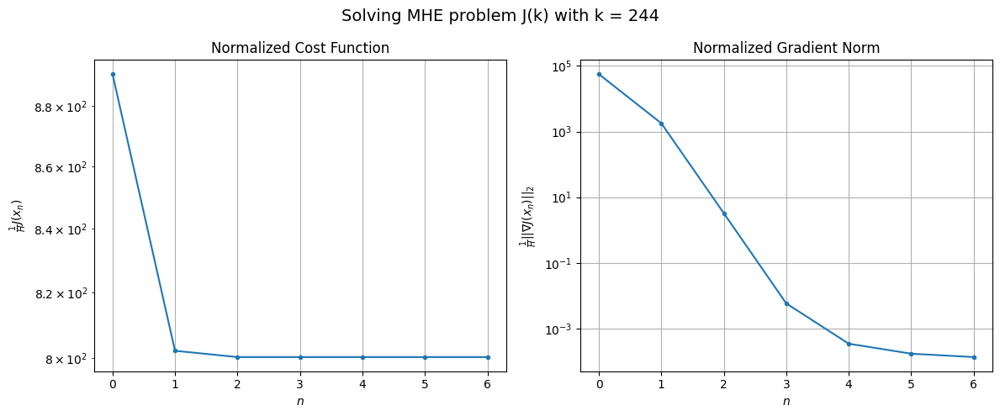

Windows:  60%|██████    | 226/376 [20:21<17:06,  6.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 18153.81831393938
Gradient norm: 1153403.607864971
Global estimation error: 365.7766443637944
Initial conditions estimation errors: 5.202446453204557 m, 65.06572117936979 m, 19.884562964414652 m, 359.3556984369214 m
Position estimation errors: 9.55219454320061 m, 42.72621844603683 m, 16.26874176858915 m, 274.9625613001803 m

[Gauss-Newton] Iteration 1
Cost function: 16306.288698488 (-10.18%)
Gradient norm: 20923.499307947248 (-98.19%)
Global estimation error: 553.3414319587393 (51.28%)
Initial conditions estimation errors: 7.181882905607008 m, 94.20995250261379 m, 32.09291901238653 m, 544.2697777965151 m
Position estimation errors: 7.261757640220188 m, 89.55278341588789 m, 16.860047878095827 m, 464.13933520968527 m

[Gauss-Newton] Iteration 2
Cost function: 16296.538753561452 (-0.06%)
Gradient norm: 1.265070249002798 (-99.99%)
Global estimation error: 555.6110272695333 (0.41%)
Initial conditions estimation errors: 7.1818828644

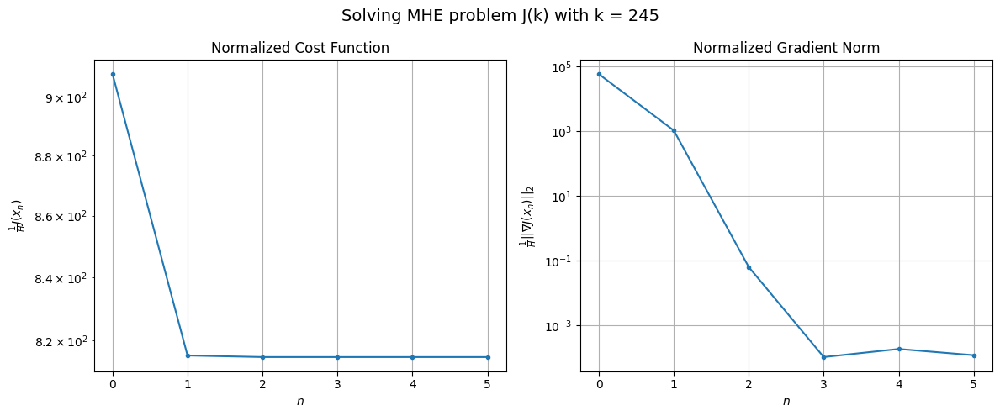

Windows:  60%|██████    | 227/376 [20:25<14:39,  5.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 18678.078479645243
Gradient norm: 1193859.82453709
Global estimation error: 572.3882988643377
Initial conditions estimation errors: 5.2647058493225165 m, 96.43337260573213 m, 28.944038255125104 m, 563.4389193384666 m
Position estimation errors: 9.90025669198757 m, 87.54644164414194 m, 20.698108029756654 m, 439.2935582186106 m

[Gauss-Newton] Iteration 1
Cost function: 16657.093214396544 (-10.82%)
Gradient norm: 3446.789966825378 (-99.71%)
Global estimation error: 395.2955630761178 (-30.94%)
Initial conditions estimation errors: 7.358711776454569 m, 59.587608095838775 m, 36.62901189400431 m, 388.9882547393283 m
Position estimation errors: 7.5117006231150185 m, 119.66079544657825 m, 30.14744601198842 m, 521.7058368354716 m

[Gauss-Newton] Iteration 2
Cost function: 16655.94809554031 (-0.01%)
Gradient norm: 64.11760898657492 (-98.14%)
Global estimation error: 383.6842733442537 (-2.94%)
Initial conditions estimation errors: 7.3587

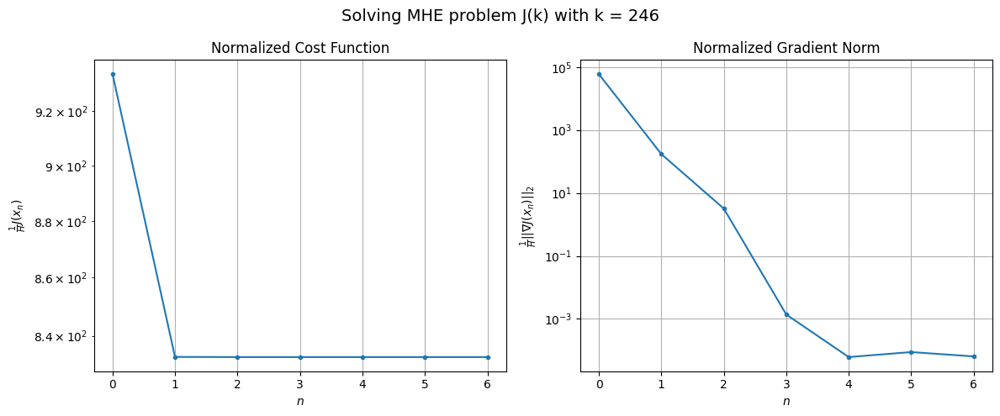

Windows:  61%|██████    | 228/376 [20:29<13:24,  5.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 19179.24592159733
Gradient norm: 1188696.8272153793
Global estimation error: 407.5663813735038
Initial conditions estimation errors: 5.348471192975272 m, 62.2429780240208 m, 30.9367772730579 m, 401.559836407442 m
Position estimation errors: 10.312935111968697 m, 119.05542113579601 m, 30.38798069997818 m, 498.3713304340574 m

[Gauss-Newton] Iteration 1
Cost function: 17083.709615451753 (-10.93%)
Gradient norm: 12957.555395827583 (-98.91%)
Global estimation error: 292.66093640798505 (-28.19%)
Initial conditions estimation errors: 7.5080042080315925 m, 43.444456589916165 m, 26.69505164735787 m, 288.08668171777623 m
Position estimation errors: 7.88279231261367 m, 86.52415080413174 m, 24.587779041150124 m, 331.4668869068033 m

[Gauss-Newton] Iteration 2
Cost function: 17080.588679071658 (-0.02%)
Gradient norm: 9.275600993289842 (-99.93%)
Global estimation error: 289.9355088317266 (-0.93%)
Initial conditions estimation errors: 7.508

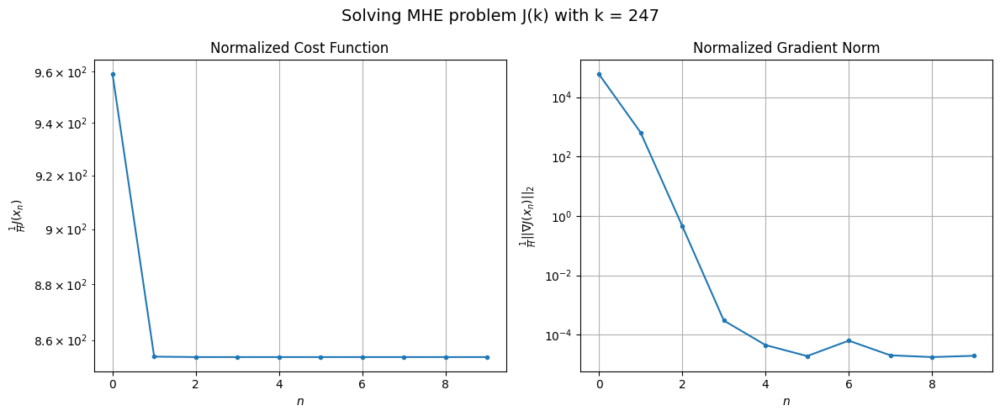

Windows:  61%|██████    | 229/376 [20:35<13:56,  5.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20254.77984415568
Gradient norm: 1226935.3260402444
Global estimation error: 303.3642253738004
Initial conditions estimation errors: 5.36670896971347 m, 45.75401469839762 m, 21.643552095946596 m, 299.0637362165317 m
Position estimation errors: 10.827925784886341 m, 87.36590821415992 m, 24.148605853876717 m, 316.52626329257254 m

[Gauss-Newton] Iteration 1
Cost function: 18023.913253686693 (-11.01%)
Gradient norm: 15291.059951906303 (-98.75%)
Global estimation error: 132.74023323390776 (-56.24%)
Initial conditions estimation errors: 7.592903207235214 m, 18.004270143093958 m, 16.458584850300078 m, 130.25844108273603 m
Position estimation errors: 8.319385213319974 m, 51.380253244123374 m, 13.861121337274612 m, 158.11229290353177 m

[Gauss-Newton] Iteration 2
Cost function: 18018.288727924883 (-0.03%)
Gradient norm: 407.05164186887225 (-97.34%)
Global estimation error: 113.01125640910492 (-14.86%)
Initial conditions estimation err

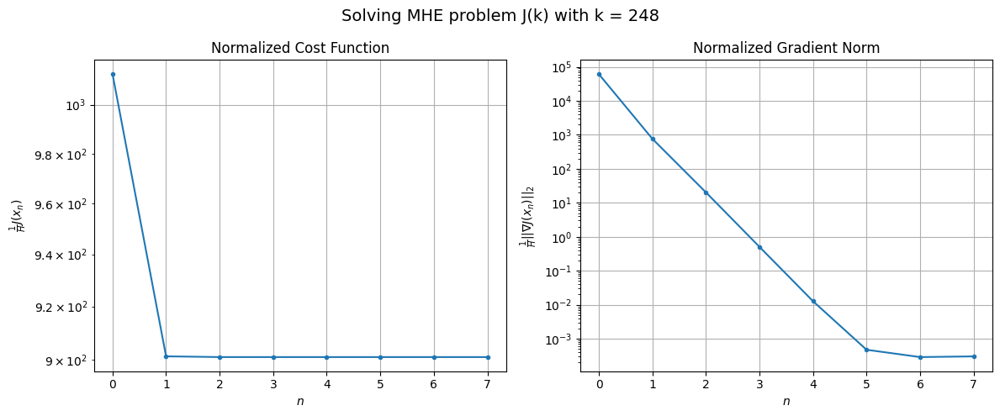

Windows:  61%|██████    | 230/376 [20:41<13:56,  5.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 21446.32276139951
Gradient norm: 1213659.322563355
Global estimation error: 112.52037563978988
Initial conditions estimation errors: 5.335203511774274 m, 14.715338049694552 m, 11.359719396016569 m, 110.84573019318593 m
Position estimation errors: 11.381427947817333 m, 47.29244691021637 m, 10.692708011387998 m, 121.3589201998558 m

[Gauss-Newton] Iteration 1
Cost function: 18979.184927427334 (-11.50%)
Gradient norm: 2965.9257615732745 (-99.76%)
Global estimation error: 161.46034658443438 (43.49%)
Initial conditions estimation errors: 7.70658910102126 m, 22.684590239015307 m, 14.710286111933534 m, 158.99384035116353 m
Position estimation errors: 8.778130639345676 m, 63.137823473915375 m, 15.214509740295167 m, 203.30197610892182 m

[Gauss-Newton] Iteration 2
Cost function: 18979.03310998665 (-0.00%)
Gradient norm: 9.614382673831882 (-99.68%)
Global estimation error: 158.30413979466584 (-1.95%)
Initial conditions estimation errors

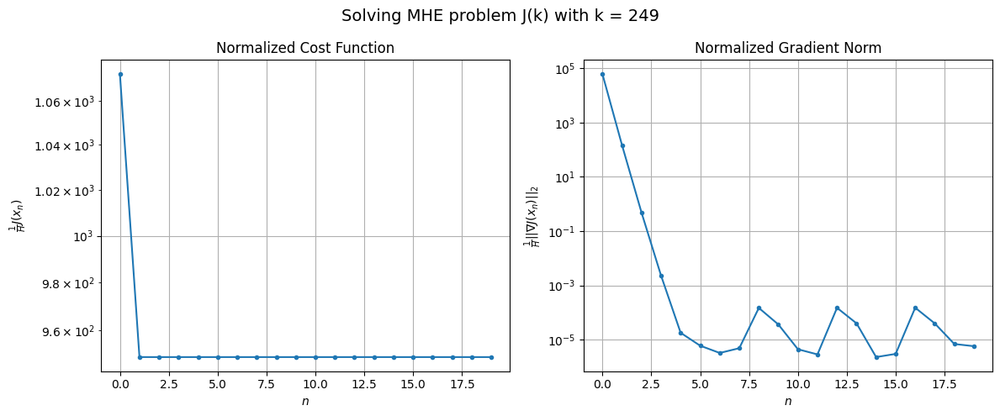

Windows:  61%|██████▏   | 231/376 [20:52<17:14,  7.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23077.796132691168
Gradient norm: 1196866.1673794226
Global estimation error: 166.14206370546844
Initial conditions estimation errors: 5.386221810052968 m, 23.788408415948705 m, 10.539798526014623 m, 164.0035811579287 m
Position estimation errors: 11.923979349884624 m, 65.19261860681958 m, 15.275152893795905 m, 195.38659964043313 m

[Gauss-Newton] Iteration 1
Cost function: 20496.792817674977 (-11.18%)
Gradient norm: 672.640359138176 (-99.94%)
Global estimation error: 226.8818813134311 (36.56%)
Initial conditions estimation errors: 7.795490517750723 m, 31.29050944445393 m, 13.281397974171812 m, 224.18542112021038 m
Position estimation errors: 9.259530795500613 m, 63.45539880437172 m, 18.302952585092008 m, 210.65387503917935 m

[Gauss-Newton] Iteration 2
Cost function: 20496.766436821523 (-0.00%)
Gradient norm: 9.858898569431702 (-98.53%)
Global estimation error: 230.46163097407018 (1.58%)
Initial conditions estimation errors: 

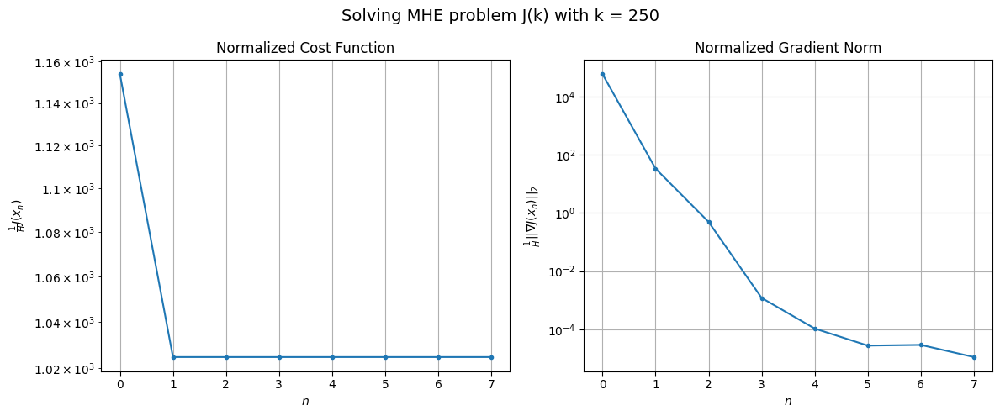

Windows:  62%|██████▏   | 232/376 [20:56<15:16,  6.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25505.226130075695
Gradient norm: 1222257.6794659651
Global estimation error: 237.74176990405707
Initial conditions estimation errors: 5.488112012052841 m, 33.320332082347385 m, 9.257709764895514 m, 235.14901490943507 m
Position estimation errors: 12.460796272790612 m, 66.7583919761986 m, 19.398012202896318 m, 206.8324015254075 m

[Gauss-Newton] Iteration 1
Cost function: 22829.270494995173 (-10.49%)
Gradient norm: 86812.15038717049 (-92.90%)
Global estimation error: 115.01515990743546 (-51.62%)
Initial conditions estimation errors: 7.986316276628692 m, 22.49877291713172 m, 8.341087114163894 m, 112.20016126491446 m
Position estimation errors: 9.673315752434252 m, 23.89912773840924 m, 19.186454538837975 m, 196.73036901405774 m

[Gauss-Newton] Iteration 2
Cost function: 22673.31587109298 (-0.68%)
Gradient norm: 2208.0380520438016 (-97.46%)
Global estimation error: 61.984963840657855 (-46.11%)
Initial conditions estimation errors

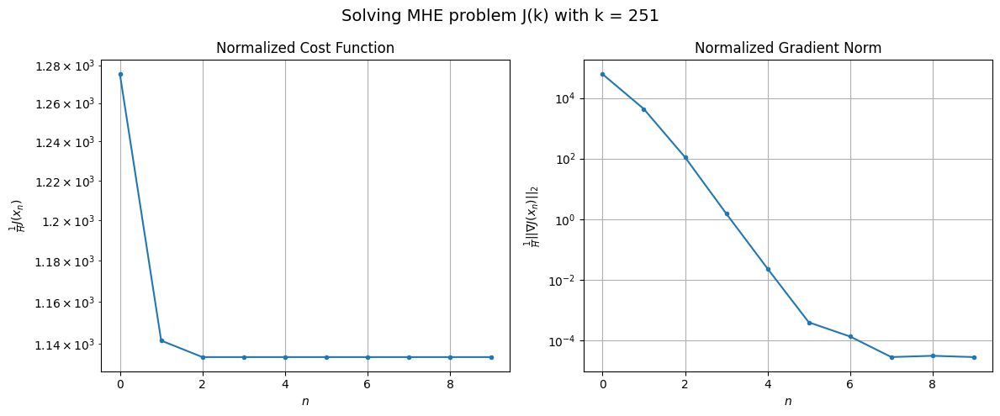

Windows:  62%|██████▏   | 233/376 [21:02<14:26,  6.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27816.200743927337
Gradient norm: 1179645.5099571492
Global estimation error: 77.08346062955798
Initial conditions estimation errors: 5.730402997363021 m, 17.003139537495937 m, 6.556385834198182 m, 74.67860845287325 m
Position estimation errors: 12.912521974155617 m, 8.043844848669934 m, 16.54728003933837 m, 133.9061061710166 m

[Gauss-Newton] Iteration 1
Cost function: 24933.392628614223 (-10.36%)
Gradient norm: 6958.983670809167 (-99.41%)
Global estimation error: 210.0123442591776 (172.45%)
Initial conditions estimation errors: 8.229520815124554 m, 34.21195142251887 m, 10.4731471642002 m, 206.7782677602711 m
Position estimation errors: 10.093173882253906 m, 36.627010507209164 m, 27.59473281458592 m, 229.48790432112952 m

[Gauss-Newton] Iteration 2
Cost function: 24931.971779744064 (-0.01%)
Gradient norm: 50.464647671518 (-99.27%)
Global estimation error: 202.04696550051838 (-3.79%)
Initial conditions estimation errors: 8.229

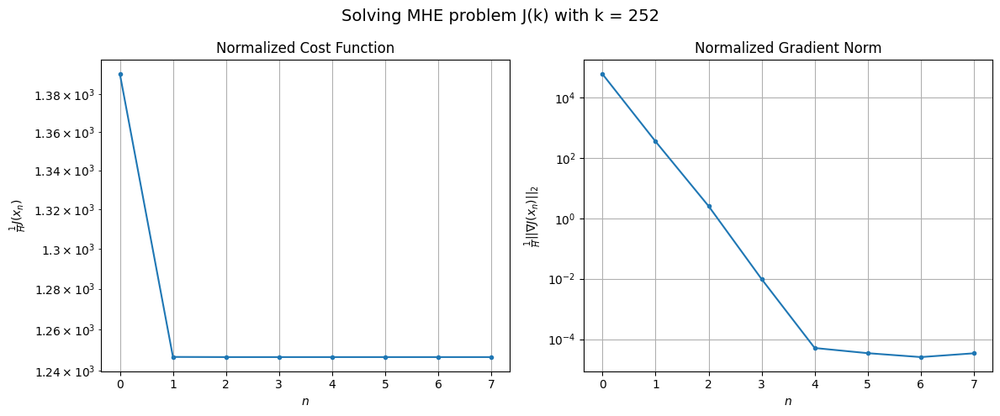

Windows:  62%|██████▏   | 234/376 [21:06<13:09,  5.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30488.53831631841
Gradient norm: 1215722.772178795
Global estimation error: 215.57253310504112
Initial conditions estimation errors: 6.04202147609123 m, 36.815770771223235 m, 9.343397284718773 m, 212.1137926474689 m
Position estimation errors: 13.35787238116301 m, 30.23165550701595 m, 29.255146739711652 m, 207.9316418942292 m

[Gauss-Newton] Iteration 1
Cost function: 27379.07688440996 (-10.20%)
Gradient norm: 39126.677407164716 (-96.78%)
Global estimation error: 479.33917213673936 (122.36%)
Initial conditions estimation errors: 8.648524600097053 m, 76.33881247323912 m, 16.09645936380994 m, 472.8682145878482 m
Position estimation errors: 10.437883455561762 m, 91.39258174054079 m, 57.521044942116845 m, 462.8361280849415 m

[Gauss-Newton] Iteration 2
Cost function: 27343.810829154172 (-0.13%)
Gradient norm: 78.97444600280426 (-99.80%)
Global estimation error: 468.47090223408014 (-2.27%)
Initial conditions estimation errors: 8.64

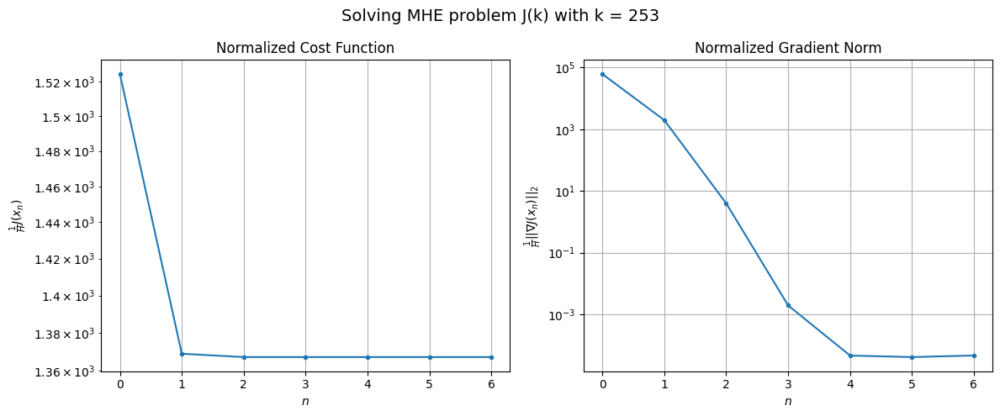

Windows:  62%|██████▎   | 235/376 [21:10<11:54,  5.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 32839.9620927784
Gradient norm: 1277099.8230820415
Global estimation error: 491.9162536118554
Initial conditions estimation errors: 6.473399350449853 m, 81.27202361051953 m, 15.355072448805672 m, 484.8697024939206 m
Position estimation errors: 13.750415678221906 m, 82.61577005131254 m, 59.04012178702888 m, 425.60097518832947 m

[Gauss-Newton] Iteration 1
Cost function: 29566.13991888531 (-9.97%)
Gradient norm: 15082.550346829175 (-98.82%)
Global estimation error: 321.92756833935465 (-34.56%)
Initial conditions estimation errors: 9.118703867936498 m, 47.25090156679585 m, 14.746177881173287 m, 317.96861563421044 m
Position estimation errors: 10.775020268069394 m, 51.13702190260927 m, 36.20816404274902 m, 272.69674604900393 m

[Gauss-Newton] Iteration 2
Cost function: 29560.886982737335 (-0.02%)
Gradient norm: 7.3987362917413275 (-99.95%)
Global estimation error: 318.5734651350509 (-1.04%)
Initial conditions estimation errors: 9.

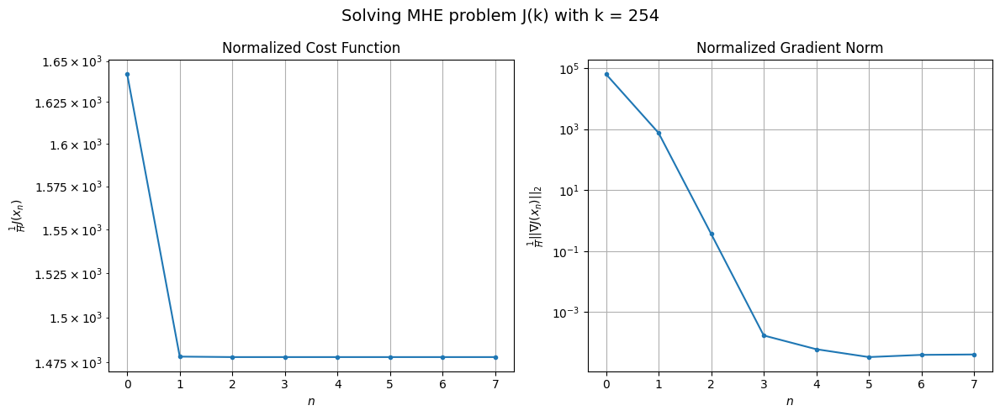

Windows:  63%|██████▎   | 236/376 [21:14<11:26,  4.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 35432.11170057972
Gradient norm: 1432187.1177815585
Global estimation error: 332.54629326894724
Initial conditions estimation errors: 6.891992583768989 m, 51.533838156920055 m, 13.451342660677872 m, 328.1810576432635 m
Position estimation errors: 14.196589621734145 m, 45.85581842073746 m, 38.48025257554069 m, 250.255172418324 m

[Gauss-Newton] Iteration 1
Cost function: 32005.70541663931 (-9.67%)
Gradient norm: 22283.67189305697 (-98.44%)
Global estimation error: 135.99613411972894 (-59.10%)
Initial conditions estimation errors: 9.561554332572635 m, 16.871751199163892 m, 11.210558232655558 m, 134.13866717021216 m
Position estimation errors: 11.130671281853544 m, 7.847353994520935 m, 11.063235828916898 m, 61.65086557429175 m

[Gauss-Newton] Iteration 2
Cost function: 31994.658431945965 (-0.03%)
Gradient norm: 68.52817298501144 (-99.69%)
Global estimation error: 126.16059912324663 (-7.23%)
Initial conditions estimation errors: 9

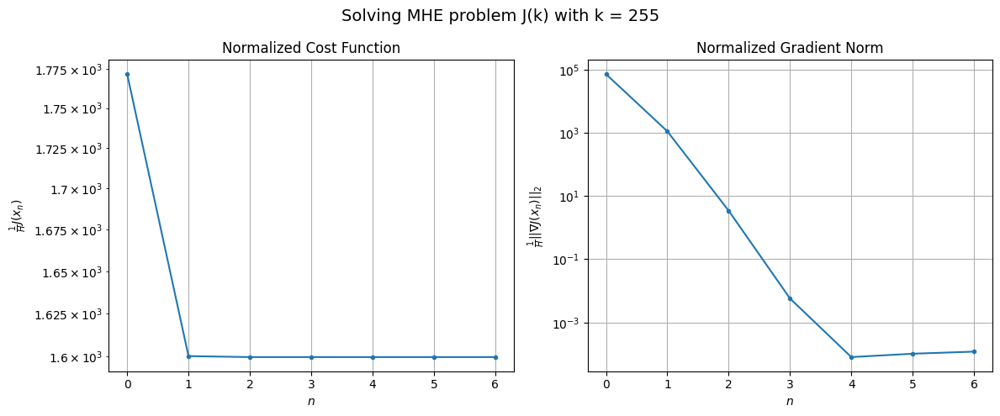

Windows:  63%|██████▎   | 237/376 [21:18<10:42,  4.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 38362.03602604241
Gradient norm: 1661394.7354876688
Global estimation error: 128.6849408040398
Initial conditions estimation errors: 7.212553275218917 m, 17.026345633623553 m, 8.346312159604807 m, 127.07567836367723 m
Position estimation errors: 14.743174550613748 m, 12.660677996070893 m, 14.531359468158687 m, 41.282566172209535 m

[Gauss-Newton] Iteration 1
Cost function: 35008.39952401357 (-8.74%)
Gradient norm: 156625.57080054836 (-90.57%)
Global estimation error: 328.09181318576276 (154.96%)
Initial conditions estimation errors: 9.993772313531366 m, 78.30109047167952 m, 5.061700562120068 m, 318.41400997248604 m
Position estimation errors: 11.47041170269358 m, 135.2824450821412 m, 92.8580350085003 m, 489.02443335538493 m

[Gauss-Newton] Iteration 2
Cost function: 34526.017412261725 (-1.38%)
Gradient norm: 2819.699985040613 (-98.20%)
Global estimation error: 391.7388686299142 (19.40%)
Initial conditions estimation errors: 9.

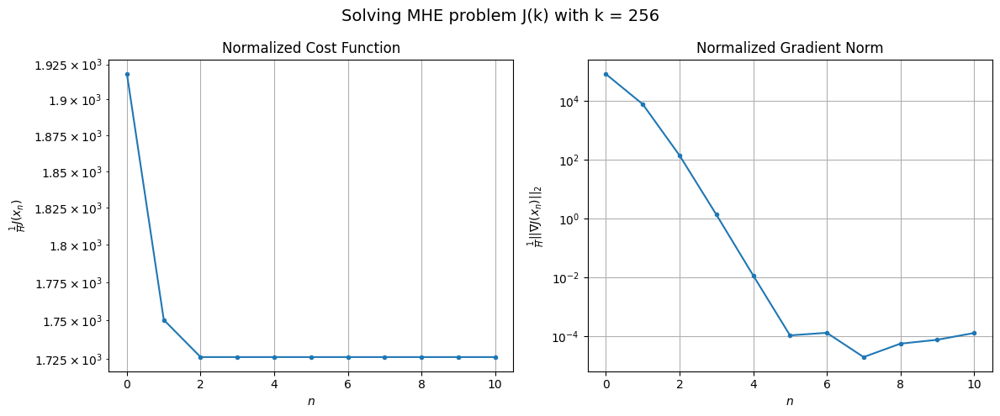

Windows:  63%|██████▎   | 238/376 [21:24<11:29,  5.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 41080.7036849932
Gradient norm: 1925932.5448954855
Global estimation error: 425.93402075496823
Initial conditions estimation errors: 7.471207134970915 m, 97.04029113572241 m, 8.544952638329482 m, 414.57677097169153 m
Position estimation errors: 15.320411309850886 m, 154.39077971852214 m, 107.15653487466398 m, 553.2933362399133 m

[Gauss-Newton] Iteration 1
Cost function: 36921.8966405598 (-10.12%)
Gradient norm: 596.6331800797452 (-99.97%)
Global estimation error: 364.3471176468294 (-14.46%)
Initial conditions estimation errors: 10.335261859742277 m, 81.31744013635935 m, 6.2106922558176105 m, 354.9516349617298 m
Position estimation errors: 11.871168763443656 m, 151.15588897947688 m, 104.74755688727166 m, 538.755909943802 m

[Gauss-Newton] Iteration 2
Cost function: 36921.87004709117 (-0.00%)
Gradient norm: 54.689375750038685 (-90.83%)
Global estimation error: 356.9380845231155 (-2.03%)
Initial conditions estimation errors: 10.

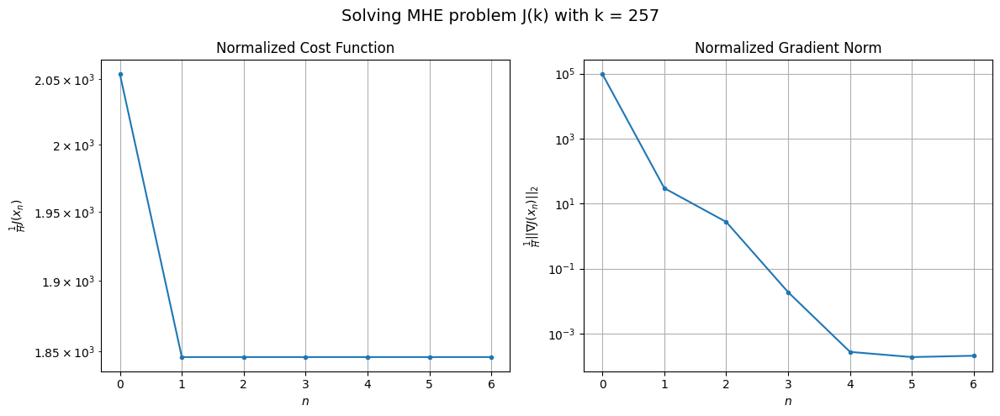

Windows:  64%|██████▎   | 239/376 [21:28<10:40,  4.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 44095.4719666778
Gradient norm: 2186827.4670399204
Global estimation error: 382.0242270025949
Initial conditions estimation errors: 7.624557732023574 m, 85.27464240081365 m, 13.948137147423381 m, 372.04549539832107 m
Position estimation errors: 15.94866270874801 m, 148.13465511124812 m, 103.12250286649636 m, 516.3132984256621 m

[Gauss-Newton] Iteration 1
Cost function: 39593.22725971998 (-10.21%)
Gradient norm: 20.130561995315208 (-100.00%)
Global estimation error: 395.2875525048167 (3.47%)
Initial conditions estimation errors: 10.558058947951736 m, 89.33687028875532 m, 14.545773933487041 m, 384.6399877270458 m
Position estimation errors: 12.300055770308385 m, 143.87702088404646 m, 100.26653720518578 m, 511.584379063014 m

[Gauss-Newton] Iteration 2
Cost function: 39593.22722433705 (-0.00%)
Gradient norm: 0.769499864228229 (-96.18%)
Global estimation error: 396.02591091749844 (0.19%)
Initial conditions estimation errors: 10.5

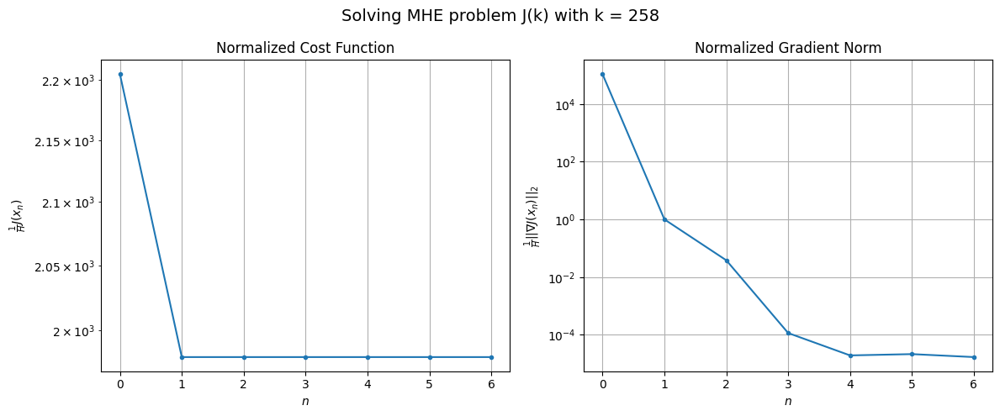

Windows:  64%|██████▍   | 240/376 [21:32<10:07,  4.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 47640.55807637393
Gradient norm: 2475634.6048294804
Global estimation error: 420.1009922225852
Initial conditions estimation errors: 7.689344041585224 m, 94.25886565649544 m, 22.892391573244243 m, 408.67681959375767 m
Position estimation errors: 16.54082547740467 m, 143.31689091931503 m, 100.40494170182866 m, 498.4652991505638 m

[Gauss-Newton] Iteration 1
Cost function: 42725.17220937966 (-10.32%)
Gradient norm: 769.160018912107 (-99.97%)
Global estimation error: 490.41614533097146 (16.74%)
Initial conditions estimation errors: 10.704953463833032 m, 106.9982138666839 m, 17.314011582468613 m, 478.16820195272976 m
Position estimation errors: 12.660744814977088 m, 146.25218147817733 m, 108.65828939369374 m, 512.9353138077875 m

[Gauss-Newton] Iteration 2
Cost function: 42725.1359140394 (-0.00%)
Gradient norm: 59.49200522309491 (-92.27%)
Global estimation error: 497.24849338788664 (1.39%)
Initial conditions estimation errors: 10.

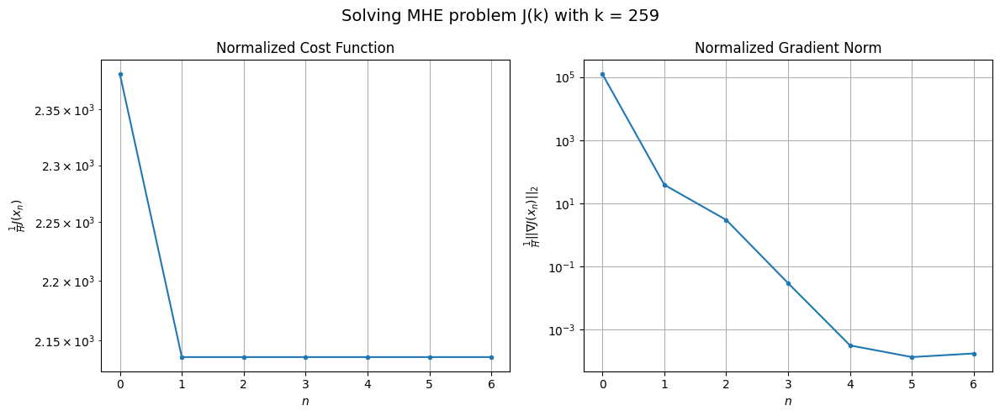

Windows:  64%|██████▍   | 241/376 [21:36<09:43,  4.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 51130.74056581337
Gradient norm: 2691410.278744104
Global estimation error: 520.6807109318198
Initial conditions estimation errors: 7.719566880540258 m, 113.0550277684703 m, 26.118539046957896 m, 507.5283559030672 m
Position estimation errors: 16.959924169904706 m, 147.2920051276855 m, 111.2435199075465 m, 503.68089830316455 m

[Gauss-Newton] Iteration 1
Cost function: 45941.992426056684 (-10.15%)
Gradient norm: 49465.861678606685 (-98.16%)
Global estimation error: 286.86991141248114 (-44.90%)
Initial conditions estimation errors: 10.81145837664008 m, 77.41323681008173 m, 18.521294761248985 m, 275.39351607320333 m
Position estimation errors: 12.90248776246042 m, 53.94031064321625 m, 41.42078302084023 m, 207.77086201852472 m

[Gauss-Newton] Iteration 2
Cost function: 45895.53762036402 (-0.10%)
Gradient norm: 10.321252828103265 (-99.98%)
Global estimation error: 283.9878002456423 (-1.00%)
Initial conditions estimation errors: 10

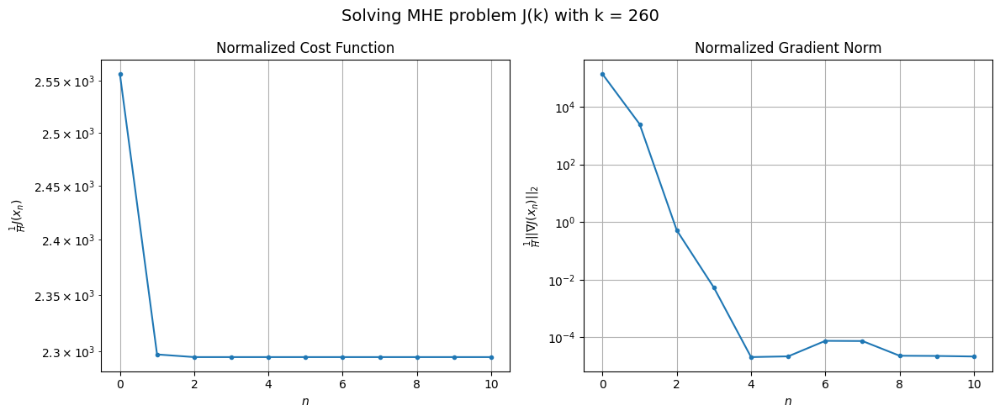

Windows:  64%|██████▍   | 242/376 [21:42<10:41,  4.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 54597.441393565445
Gradient norm: 2843705.210070698
Global estimation error: 287.92505740524496
Initial conditions estimation errors: 7.7512718266139995 m, 75.30190552757306 m, 21.879295730939063 m, 276.9325881867504 m
Position estimation errors: 17.11498791065838 m, 51.0992203770343 m, 38.928219539493384 m, 190.364970896349 m

[Gauss-Newton] Iteration 1
Cost function: 49341.80393758414 (-9.63%)
Gradient norm: 86567.05856993077 (-96.96%)
Global estimation error: 45.325684583326975 (-84.26%)
Initial conditions estimation errors: 10.863269746939226 m, 31.481740817911685 m, 19.28099997609994 m, 23.946229109500557 m
Position estimation errors: 12.939567462293583 m, 74.54489084943424 m, 67.85594398537077 m, 224.75817291972248 m

[Gauss-Newton] Iteration 2
Cost function: 49211.74225409248 (-0.26%)
Gradient norm: 83.38085371447838 (-99.90%)
Global estimation error: 48.99622697350501 (8.10%)
Initial conditions estimation errors: 10.86

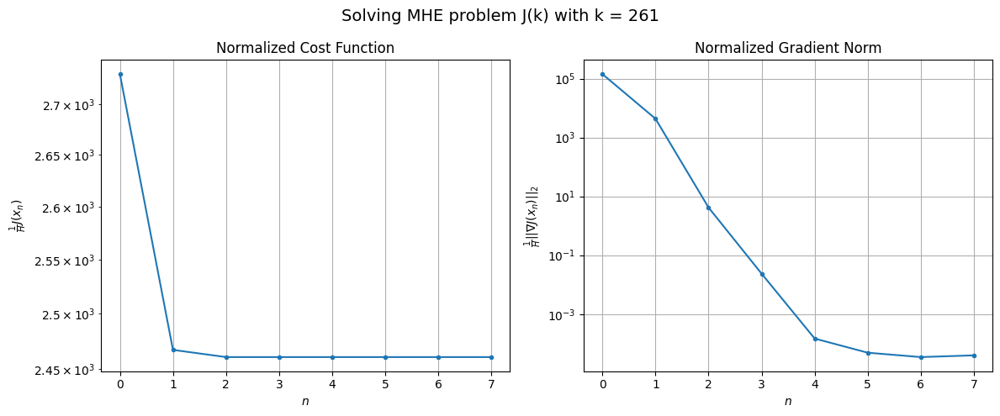

Windows:  65%|██████▍   | 243/376 [21:46<10:15,  4.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 57778.04145855612
Gradient norm: 2890740.6281841323
Global estimation error: 31.334676065238053
Initial conditions estimation errors: 7.773684577331398 m, 23.476437559115283 m, 15.068550838833724 m, 11.962949920591889 m
Position estimation errors: 16.890643406644884 m, 73.58456506558267 m, 68.78566506477787 m, 217.56930407656085 m

[Gauss-Newton] Iteration 1
Cost function: 52341.040675797005 (-9.41%)
Gradient norm: 17057.983797075485 (-99.41%)
Global estimation error: 71.77618957046177 (129.06%)
Initial conditions estimation errors: 10.938212822977068 m, 15.320502442635473 m, 20.54095127516763 m, 66.14548071774314 m
Position estimation errors: 12.669760546072569 m, 133.4103012358087 m, 123.0482468927635 m, 409.5682974240523 m

[Gauss-Newton] Iteration 2
Cost function: 52336.4142539295 (-0.01%)
Gradient norm: 306.92308400757184 (-98.20%)
Global estimation error: 82.6068445965856 (15.09%)
Initial conditions estimation errors: 10

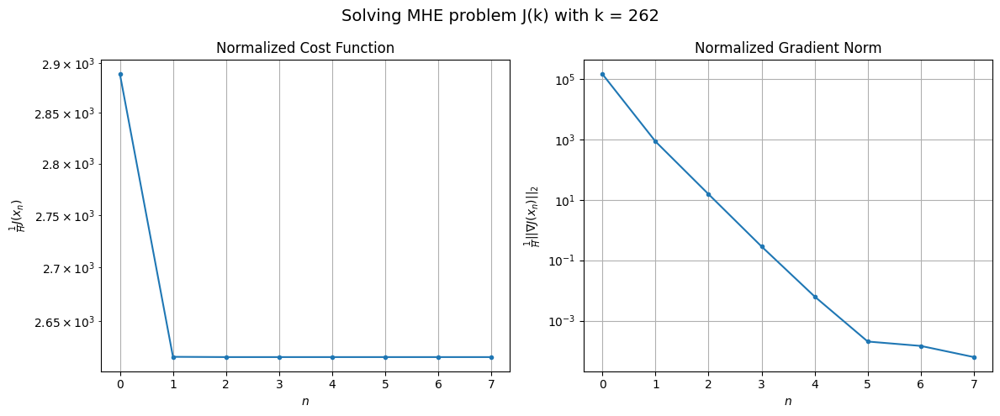

Windows:  65%|██████▍   | 244/376 [21:50<09:47,  4.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 59422.3479864869
Gradient norm: 2788542.09328643
Global estimation error: 111.84142203984611
Initial conditions estimation errors: 7.854632617484765 m, 7.752146900591181 m, 13.900958639622353 m, 110.42260312436208 m
Position estimation errors: 16.21128927965684 m, 145.26604641939753 m, 137.26735833250072 m, 440.89148120859767 m

[Gauss-Newton] Iteration 1
Cost function: 54154.885294197615 (-8.86%)
Gradient norm: 7783.252308095763 (-99.72%)
Global estimation error: 83.0358992423642 (-25.76%)
Initial conditions estimation errors: 11.093448198168673 m, 11.73018162508535 m, 11.397924114499734 m, 80.64871224634582 m
Position estimation errors: 12.119405193304608 m, 101.50566453909177 m, 92.83637905221345 m, 306.4118130163307 m

[Gauss-Newton] Iteration 2
Cost function: 54153.96163361976 (-0.00%)
Gradient norm: 35.64586383980424 (-99.54%)
Global estimation error: 81.40703798464124 (-1.96%)
Initial conditions estimation errors: 11.09

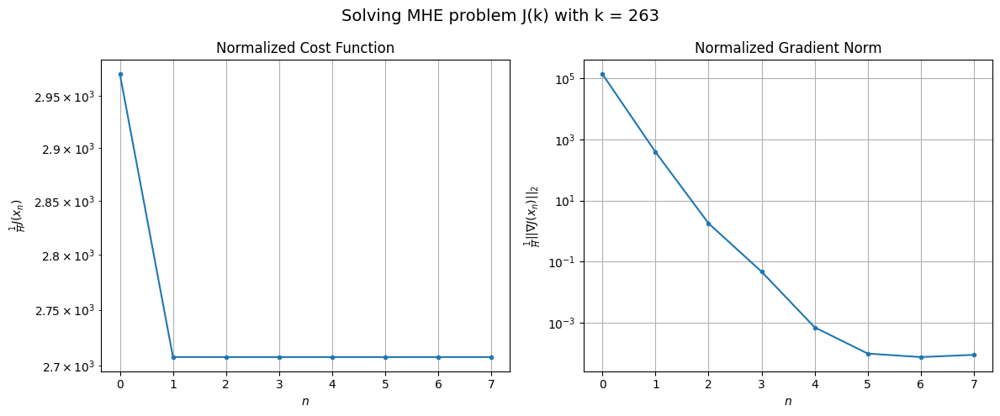

Windows:  65%|██████▌   | 245/376 [21:54<09:25,  4.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 59622.4559256723
Gradient norm: 2579033.7177778087
Global estimation error: 100.58380528374042
Initial conditions estimation errors: 8.008360589175647 m, 12.098278672634468 m, 8.32775222662887 m, 99.18214916513888 m
Position estimation errors: 15.183824459465848 m, 99.10761905459329 m, 93.2510703166878 m, 294.3961741267983 m

[Gauss-Newton] Iteration 1
Cost function: 54731.97208338793 (-8.20%)
Gradient norm: 23742.24521167051 (-99.08%)
Global estimation error: 185.60870165671056 (84.53%)
Initial conditions estimation errors: 11.265136701728535 m, 21.182711689480463 m, 13.585196300728303 m, 183.54839994700666 m
Position estimation errors: 11.325500364037834 m, 175.76441138256544 m, 164.7321534811436 m, 516.1896836038258 m

[Gauss-Newton] Iteration 2
Cost function: 54723.11019363979 (-0.02%)
Gradient norm: 197.95502441062845 (-99.17%)
Global estimation error: 189.67948615113679 (2.19%)
Initial conditions estimation errors: 11.26

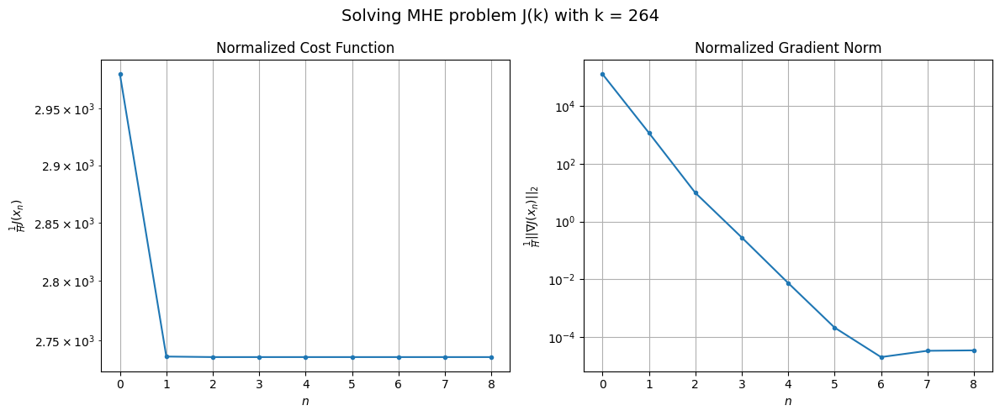

Windows:  65%|██████▌   | 246/376 [21:59<09:23,  4.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 58037.78616815254
Gradient norm: 2292297.030104621
Global estimation error: 227.00618141445608
Initial conditions estimation errors: 8.150954681824707 m, 33.452930298321725 m, 17.876733083469464 m, 223.665535159264 m
Position estimation errors: 13.89706687576572 m, 185.9013284860069 m, 178.0077972372494 m, 538.9161424100481 m

[Gauss-Newton] Iteration 1
Cost function: 53552.23120036637 (-7.73%)
Gradient norm: 13400.269052225509 (-99.42%)
Global estimation error: 42.97301359105709 (-81.07%)
Initial conditions estimation errors: 11.44280367799385 m, 23.835283979672113 m, 25.76470135424359 m, 21.987257619799877 m
Position estimation errors: 10.360175468731844 m, 153.13543580289667 m, 138.20734655709342 m, 441.83743227903227 m

[Gauss-Newton] Iteration 2
Cost function: 53545.65975192582 (-0.01%)
Gradient norm: 24.093726919179804 (-99.82%)
Global estimation error: 44.052282121898934 (2.51%)
Initial conditions estimation errors: 11.

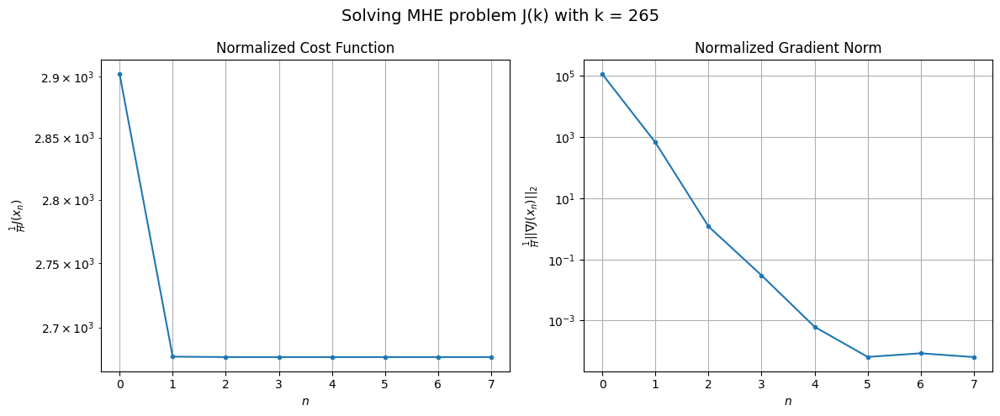

Windows:  66%|██████▌   | 247/376 [22:03<09:06,  4.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 54762.15409452211
Gradient norm: 1956849.733775061
Global estimation error: 58.89960263195066
Initial conditions estimation errors: 8.258095619984601 m, 11.93755135912814 m, 17.724982959414568 m, 54.25791517350598 m
Position estimation errors: 12.474005307730577 m, 159.8993524098637 m, 147.397117875025 m, 457.2060917205554 m

[Gauss-Newton] Iteration 1
Cost function: 50733.772957578665 (-7.36%)
Gradient norm: 80.08720633086696 (-100.00%)
Global estimation error: 86.47753529839002 (46.82%)
Initial conditions estimation errors: 11.551561074081796 m, 14.323066835860393 m, 24.623597616423876 m, 80.8277090470921 m
Position estimation errors: 9.347207202743958 m, 150.40006274015465 m, 143.54762160839596 m, 442.93671395538524 m

[Gauss-Newton] Iteration 2
Cost function: 50733.77244993118 (-0.00%)
Gradient norm: 0.16098787295602832 (-99.80%)
Global estimation error: 86.74959360872978 (0.31%)
Initial conditions estimation errors: 11.55

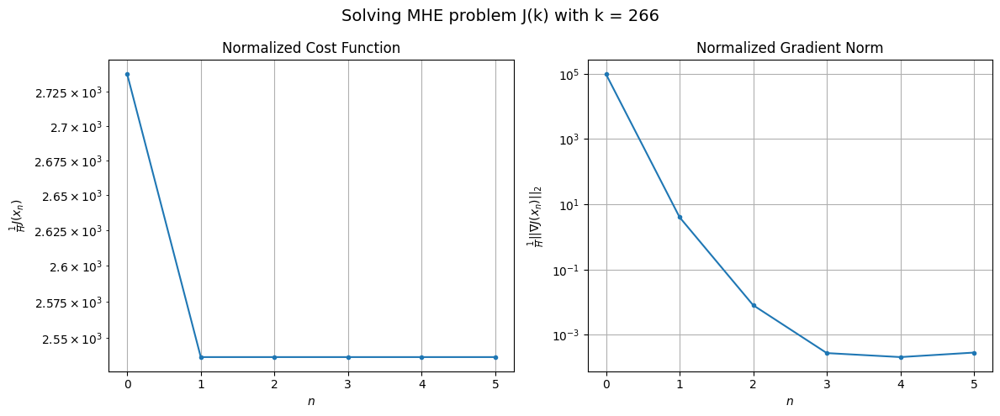

Windows:  66%|██████▌   | 248/376 [22:06<08:20,  3.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 50344.52941412048
Gradient norm: 1602631.1827248703
Global estimation error: 113.62297989072151
Initial conditions estimation errors: 8.277313907373221 m, 14.49707638124087 m, 16.256876339174326 m, 111.20654834908552 m
Position estimation errors: 11.101609320903457 m, 152.21474204336093 m, 149.0214525460339 m, 443.9104939248039 m

[Gauss-Newton] Iteration 1
Cost function: 46787.485799284885 (-7.07%)
Gradient norm: 351.2590879396492 (-99.98%)
Global estimation error: 120.80566197409293 (6.32%)
Initial conditions estimation errors: 11.510959837434497 m, 19.200347043394334 m, 31.34250459142555 m, 114.49979904947281 m
Position estimation errors: 8.42002447438846 m, 144.9489882231022 m, 138.906714226436 m, 422.3381380820903 m

[Gauss-Newton] Iteration 2
Cost function: 46787.48197852995 (-0.00%)
Gradient norm: 0.03476102739279496 (-99.99%)
Global estimation error: 120.8331797939734 (0.02%)
Initial conditions estimation errors: 11.51

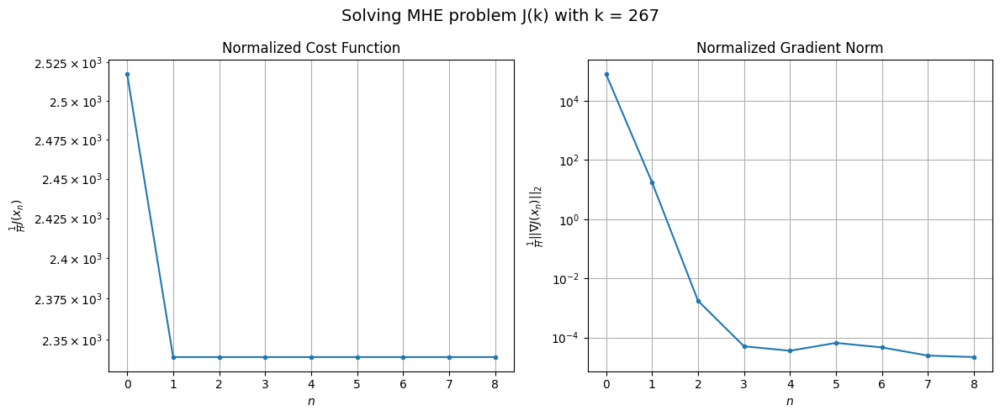

Windows:  66%|██████▌   | 249/376 [22:10<08:34,  4.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 45281.90009805989
Gradient norm: 1258567.6616865527
Global estimation error: 145.52643119072965
Initial conditions estimation errors: 8.163539254890324 m, 20.62225377952109 m, 22.310890533708886 m, 142.08435812656296 m
Position estimation errors: 9.972654088181402 m, 146.4245643555963 m, 144.8314285699024 m, 421.0844519124888 m

[Gauss-Newton] Iteration 1
Cost function: 42181.900724799256 (-6.85%)
Gradient norm: 931.8414964476226 (-99.93%)
Global estimation error: 196.93895102608138 (35.33%)
Initial conditions estimation errors: 11.276560156694405 m, 39.918720112187415 m, 25.92952778230285 m, 190.7662295454314 m
Position estimation errors: 7.727801920192315 m, 129.1336489955525 m, 128.35082925229645 m, 358.97786899107217 m

[Gauss-Newton] Iteration 2
Cost function: 42181.84481766199 (-0.00%)
Gradient norm: 36.788293009954124 (-96.05%)
Global estimation error: 198.09894246430002 (0.59%)
Initial conditions estimation errors: 11.

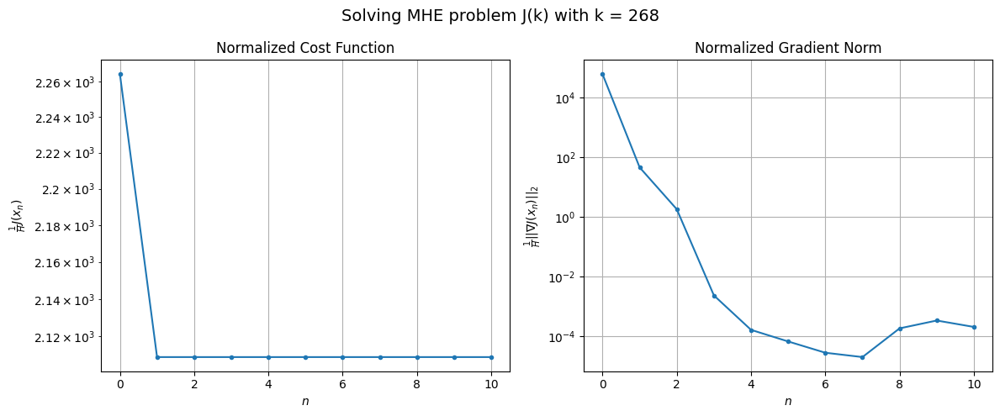

Windows:  66%|██████▋   | 250/376 [22:15<09:16,  4.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 40098.04710759238
Gradient norm: 985100.1821830801
Global estimation error: 221.41082365884205
Initial conditions estimation errors: 7.9144656761021706 m, 47.55029106731696 m, 30.24253297728702 m, 213.9726378770631 m
Position estimation errors: 9.261951270964875 m, 131.29777645598114 m, 134.7371515113424 m, 360.42592325193567 m

[Gauss-Newton] Iteration 1
Cost function: 37372.508473168324 (-6.80%)
Gradient norm: 26108.305540392874 (-97.35%)
Global estimation error: 137.44732350521085 (-37.92%)
Initial conditions estimation errors: 10.876381560206166 m, 38.798053486717414 m, 38.11433929022134 m, 125.75945781601413 m
Position estimation errors: 7.379678726061791 m, 49.00480513714875 m, 48.00956875734722 m, 132.41523820764547 m

[Gauss-Newton] Iteration 2
Cost function: 37361.54502164858 (-0.03%)
Gradient norm: 70.91628900715882 (-99.73%)
Global estimation error: 134.84219135881813 (-1.90%)
Initial conditions estimation errors: 1

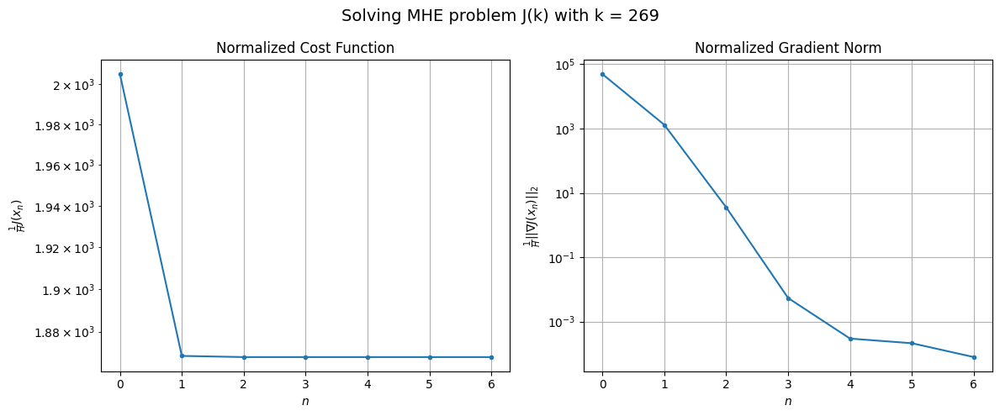

Windows:  67%|██████▋   | 251/376 [22:19<08:38,  4.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 35717.17949048876
Gradient norm: 845197.2850123064
Global estimation error: 143.29287660531153
Initial conditions estimation errors: 7.581794051695822 m, 40.19951395569105 m, 37.310491776511704 m, 132.1637392547039 m
Position estimation errors: 9.046682830899915 m, 51.43409946738353 m, 53.473356459256145 m, 138.59611920653632 m

[Gauss-Newton] Iteration 1
Cost function: 33349.905869037626 (-6.63%)
Gradient norm: 6936.149071437123 (-99.18%)
Global estimation error: 75.05722981190638 (-47.62%)
Initial conditions estimation errors: 10.285390090461975 m, 22.193528930341657 m, 25.041201312965438 m, 66.39400135728732 m
Position estimation errors: 7.367122925499873 m, 14.703063649301317 m, 10.156915021463606 m, 37.77864667311172 m

[Gauss-Newton] Iteration 2
Cost function: 33349.07470695807 (-0.00%)
Gradient norm: 0.7497528295706285 (-99.99%)
Global estimation error: 72.87796003161222 (-2.90%)
Initial conditions estimation errors: 10

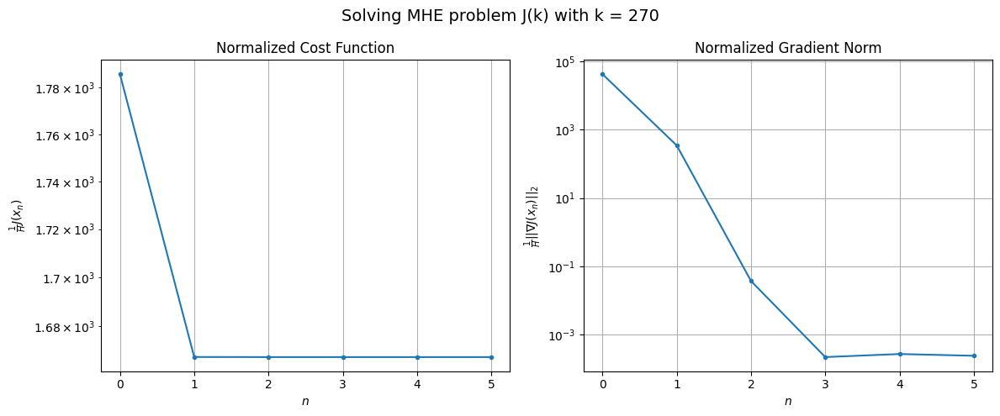

Windows:  67%|██████▋   | 252/376 [22:22<07:55,  3.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 32402.606546818482
Gradient norm: 887623.1941058692
Global estimation error: 73.1044431822058
Initial conditions estimation errors: 7.169335048587252 m, 21.334125798527865 m, 22.45370379874865 m, 65.82954746784486 m
Position estimation errors: 9.23296937534148 m, 13.397450649917406 m, 11.010257870100691 m, 32.74684415820545 m

[Gauss-Newton] Iteration 1
Cost function: 30231.096594674742 (-6.70%)
Gradient norm: 5303.118686841434 (-99.40%)
Global estimation error: 23.391462929004547 (-68.00%)
Initial conditions estimation errors: 9.639508102124953 m, 12.055440547384247 m, 10.001751990283353 m, 14.451539270182833 m
Position estimation errors: 7.541086516977361 m, 23.391226349710514 m, 41.39275670047228 m, 50.138980980502474 m

[Gauss-Newton] Iteration 2
Cost function: 30230.60496893068 (-0.00%)
Gradient norm: 0.9016808687873237 (-99.98%)
Global estimation error: 22.86274554294002 (-2.26%)
Initial conditions estimation errors: 9.6

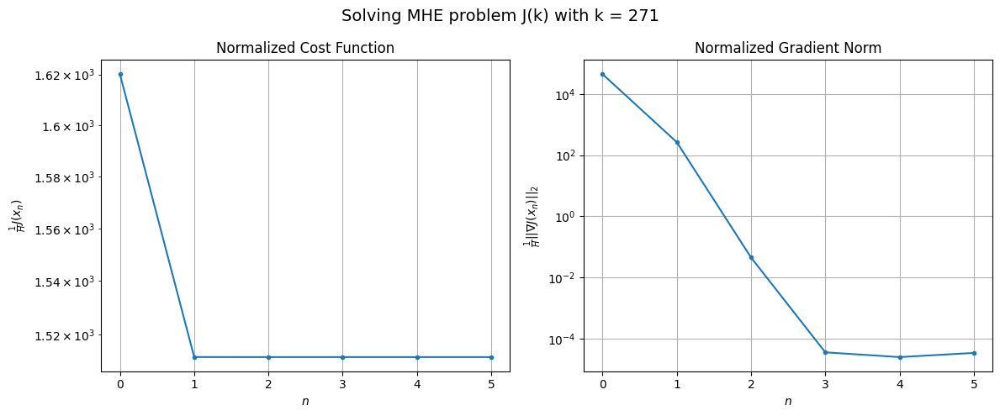

Windows:  67%|██████▋   | 253/376 [22:25<07:22,  3.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30202.381627733455
Gradient norm: 1002476.9146271859
Global estimation error: 15.485600136951977
Initial conditions estimation errors: 6.816586187487645 m, 8.649583687824876 m, 5.661726149572835 m, 9.297646670877166 m
Position estimation errors: 9.60019432088547 m, 25.765035053089033 m, 41.490495184837044 m, 53.69028085274873 m

[Gauss-Newton] Iteration 1
Cost function: 28246.90283197229 (-6.47%)
Gradient norm: 6166.307759690153 (-99.38%)
Global estimation error: 35.59231401863621 (129.84%)
Initial conditions estimation errors: 9.026566025367899 m, 13.8900571104565 m, 6.703618412574697 m, 30.779905957356046 m
Position estimation errors: 7.874335253457388 m, 67.18889490629229 m, 89.60876545102842 m, 160.80408017662026 m

[Gauss-Newton] Iteration 2
Cost function: 28246.31131304115 (-0.00%)
Gradient norm: 0.8170668842064811 (-99.99%)
Global estimation error: 34.614248305157815 (-2.75%)
Initial conditions estimation errors: 9.0265

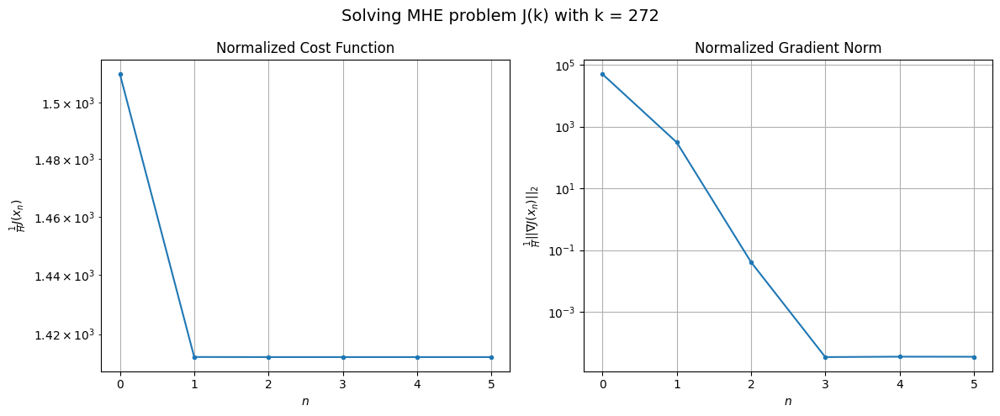

Windows:  68%|██████▊   | 254/376 [22:28<06:57,  3.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29204.60732718058
Gradient norm: 1189521.957420506
Global estimation error: 41.937341801872506
Initial conditions estimation errors: 6.53728168994115 m, 14.35033057536971 m, 10.869774150922693 m, 37.30772191066141 m
Position estimation errors: 10.117565814691911 m, 69.07578216599269 m, 89.23425867899728 m, 162.87129374106598 m

[Gauss-Newton] Iteration 1
Cost function: 27280.70474306334 (-6.59%)
Gradient norm: 1096.212506204915 (-99.91%)
Global estimation error: 23.72960639001364 (-43.42%)
Initial conditions estimation errors: 8.576822725634992 m, 7.8994434854758735 m, 8.425825789134448 m, 18.870487676425338 m
Position estimation errors: 8.22154364536008 m, 52.892237051675075 m, 63.9677599550847 m, 137.36594995993138 m

[Gauss-Newton] Iteration 2
Cost function: 27280.68298634964 (-0.00%)
Gradient norm: 0.0030364770053160715 (-100.00%)
Global estimation error: 23.764814585307523 (0.15%)
Initial conditions estimation errors: 8.5

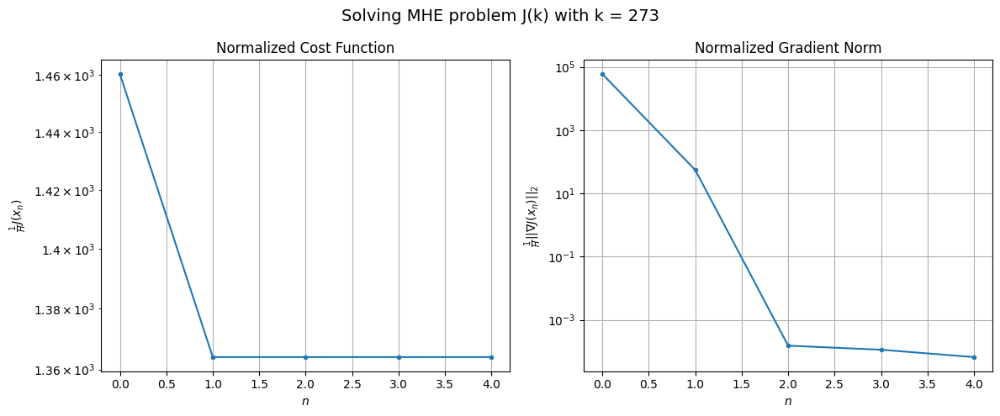

Windows:  68%|██████▊   | 255/376 [22:31<06:24,  3.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29241.17701495427
Gradient norm: 1418740.3110070957
Global estimation error: 27.756686116250442
Initial conditions estimation errors: 6.392979168689582 m, 7.059981723750106 m, 4.937765626405513 m, 25.598827883782292 m
Position estimation errors: 10.627868591816465 m, 55.72414986098425 m, 64.37311750342425 m, 140.5246602342054 m

[Gauss-Newton] Iteration 1
Cost function: 27229.38040004732 (-6.88%)
Gradient norm: 41.36562717276574 (-100.00%)
Global estimation error: 35.24347244428656 (26.97%)
Initial conditions estimation errors: 8.355249319130067 m, 13.372377549893155 m, 11.564798459950225 m, 29.320516427757635 m
Position estimation errors: 8.48537825155819 m, 52.101827755687154 m, 64.59460773606443 m, 129.5002709231945 m

[Gauss-Newton] Iteration 2
Cost function: 27229.380146588697 (-0.00%)
Gradient norm: 0.03660740774190667 (-99.91%)
Global estimation error: 35.138082760345185 (-0.30%)
Initial conditions estimation errors: 8.

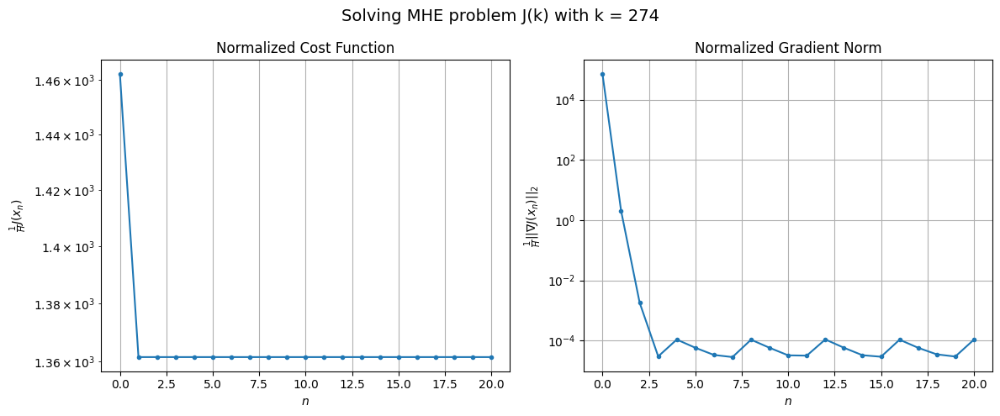

Windows:  68%|██████▊   | 256/376 [22:41<10:26,  5.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30040.116243579818
Gradient norm: 1593872.7264969079
Global estimation error: 42.14669383733409
Initial conditions estimation errors: 6.387533105155947 m, 14.303465512454705 m, 16.079016399372566 m, 35.67054324210019 m
Position estimation errors: 11.032810024384444 m, 54.04890330753728 m, 63.88345512594163 m, 131.44924335403124 m

[Gauss-Newton] Iteration 1
Cost function: 27853.523144732382 (-7.28%)
Gradient norm: 7482.701550586719 (-99.53%)
Global estimation error: 223.77491701599578 (430.94%)
Initial conditions estimation errors: 8.3889041338384 m, 72.90567209218129 m, 77.18902084117963 m, 196.80300888389286 m
Position estimation errors: 8.645047845884333 m, 76.84985488617464 m, 101.83470965172468 m, 169.50020927205338 m

[Gauss-Newton] Iteration 2
Cost function: 27850.537155386177 (-0.01%)
Gradient norm: 0.08263059871706921 (-100.00%)
Global estimation error: 223.69389166192326 (-0.04%)
Initial conditions estimation errors:

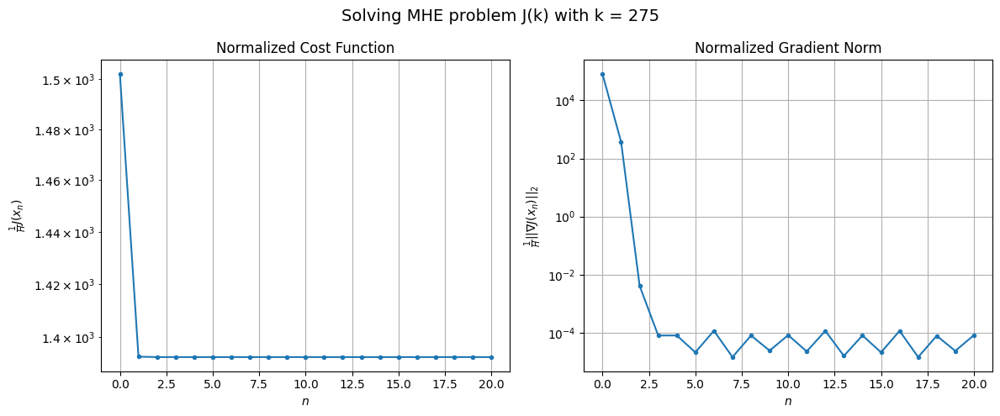

Windows:  68%|██████▊   | 257/376 [22:51<13:05,  6.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30675.51118487402
Gradient norm: 1697528.4115178913
Global estimation error: 231.76234132206307
Initial conditions estimation errors: 6.497843872332188 m, 75.24422967074449 m, 83.70993999563895 m, 202.49070277773123 m
Position estimation errors: 11.325597307450035 m, 75.27751283013016 m, 97.36594686822137 m, 161.22821771009194 m

[Gauss-Newton] Iteration 1
Cost function: 28275.912567414125 (-7.82%)
Gradient norm: 10692.57008713861 (-99.37%)
Global estimation error: 70.28624104847513 (-69.67%)
Initial conditions estimation errors: 8.664381423499492 m, 26.866426624183777 m, 34.81650568517538 m, 54.13941444093553 m
Position estimation errors: 8.75438681507412 m, 37.720125017248336 m, 51.479574970237664 m, 72.5207616298039 m

[Gauss-Newton] Iteration 2
Cost function: 28272.4021273565 (-0.01%)
Gradient norm: 0.9864699991763811 (-99.99%)
Global estimation error: 71.11626275737304 (1.18%)
Initial conditions estimation errors: 8.66438

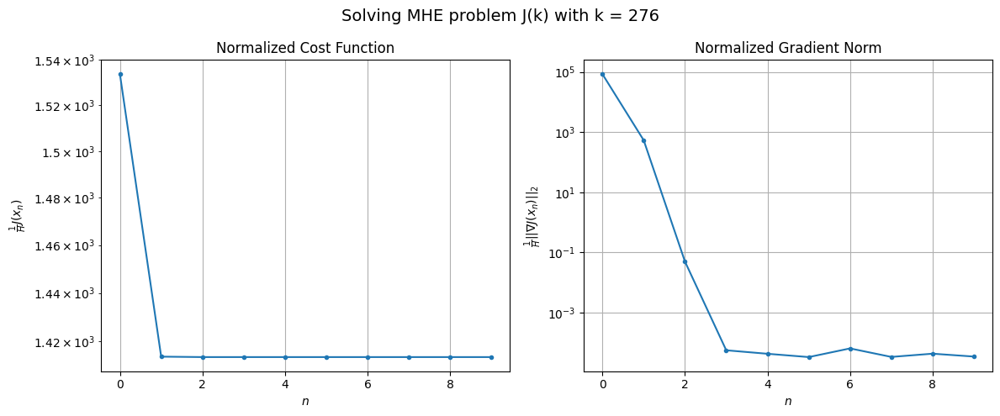

Windows:  69%|██████▊   | 258/376 [22:55<11:53,  6.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31372.602261427368
Gradient norm: 1810150.610576684
Global estimation error: 74.88092068622345
Initial conditions estimation errors: 6.683119327527655 m, 27.602222937368573 m, 39.10668330148551 m, 57.19493035207213 m
Position estimation errors: 11.576142988391718 m, 38.80404875244839 m, 49.68589342476309 m, 72.83566074568093 m

[Gauss-Newton] Iteration 1
Cost function: 28769.932511211413 (-8.30%)
Gradient norm: 58267.768447957234 (-96.78%)
Global estimation error: 253.20306556595648 (238.14%)
Initial conditions estimation errors: 9.062234972908385 m, 76.0545376133185 m, 74.80815651630279 m, 229.45389425017993 m
Position estimation errors: 8.804011488715224 m, 66.82460608453472 m, 89.46250682912387 m, 140.4897423432075 m

[Gauss-Newton] Iteration 2
Cost function: 28685.784553620444 (-0.29%)
Gradient norm: 104.78370205715963 (-99.82%)
Global estimation error: 239.98591183370058 (-5.22%)
Initial conditions estimation errors: 9.06

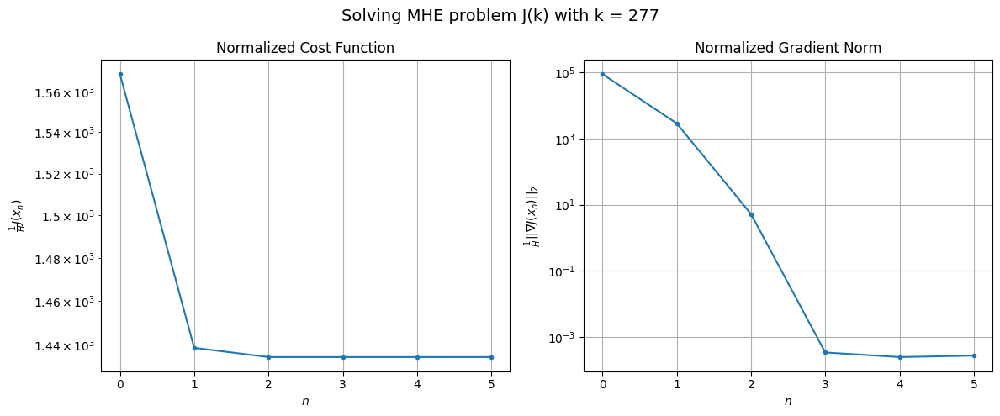

Windows:  69%|██████▉   | 259/376 [22:58<10:05,  5.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31332.989679647275
Gradient norm: 1872404.1054484767
Global estimation error: 246.60574547943557
Initial conditions estimation errors: 6.836669917452937 m, 75.33119450743276 m, 72.08884997496412 m, 223.3742223062578 m
Position estimation errors: 11.7633976184543 m, 57.21254676156743 m, 81.95048661466181 m, 117.80477145238727 m

[Gauss-Newton] Iteration 1
Cost function: 28354.640962923197 (-9.51%)
Gradient norm: 20602.112262522183 (-98.90%)
Global estimation error: 27.669500715707006 (-88.78%)
Initial conditions estimation errors: 9.480832785962999 m, 11.496990880925697 m, 17.963032760233826 m, 14.861030295090892 m
Position estimation errors: 8.84788891387404 m, 9.704486595797837 m, 14.486801999261912 m, 27.2158010102843 m

[Gauss-Newton] Iteration 2
Cost function: 28337.861655265828 (-0.06%)
Gradient norm: 4.867304346689424 (-99.98%)
Global estimation error: 29.613685944340347 (7.03%)
Initial conditions estimation errors: 9.48

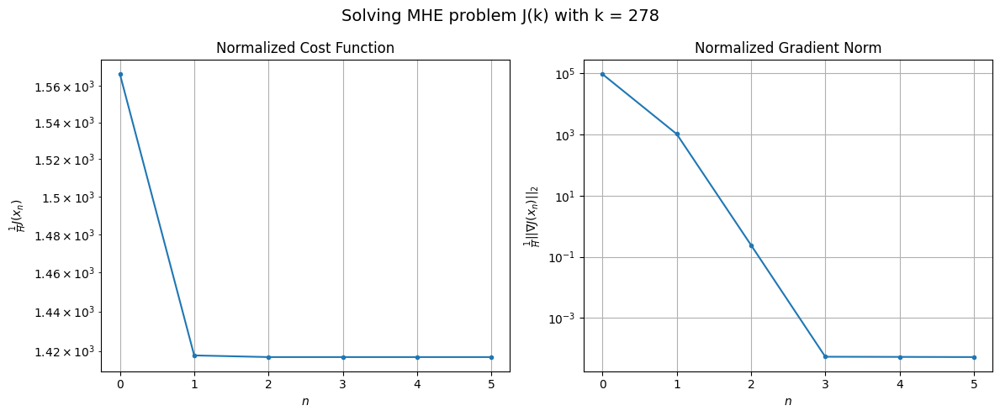

Windows:  69%|██████▉   | 260/376 [23:02<08:49,  4.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30972.4586674189
Gradient norm: 1951733.133199982
Global estimation error: 25.273372174135005
Initial conditions estimation errors: 6.897042354713211 m, 9.09135567993078 m, 18.820081611362866 m, 12.422248964389585 m
Position estimation errors: 11.925664866366263 m, 10.685635597700744 m, 17.15051365655129 m, 27.022643405633815 m

[Gauss-Newton] Iteration 1
Cost function: 27651.496637026823 (-10.72%)
Gradient norm: 7422.357803745245 (-99.62%)
Global estimation error: 92.74666546228626 (266.97%)
Initial conditions estimation errors: 9.760512242184927 m, 29.149934317235665 m, 34.32946016243005 m, 80.488685506978 m
Position estimation errors: 8.829449988897082 m, 39.215447432066064 m, 46.63365468876954 m, 68.78608693527208 m

[Gauss-Newton] Iteration 2
Cost function: 27650.528225438302 (-0.00%)
Gradient norm: 0.13260072674525547 (-100.00%)
Global estimation error: 92.87742322513327 (0.14%)
Initial conditions estimation errors: 9.76

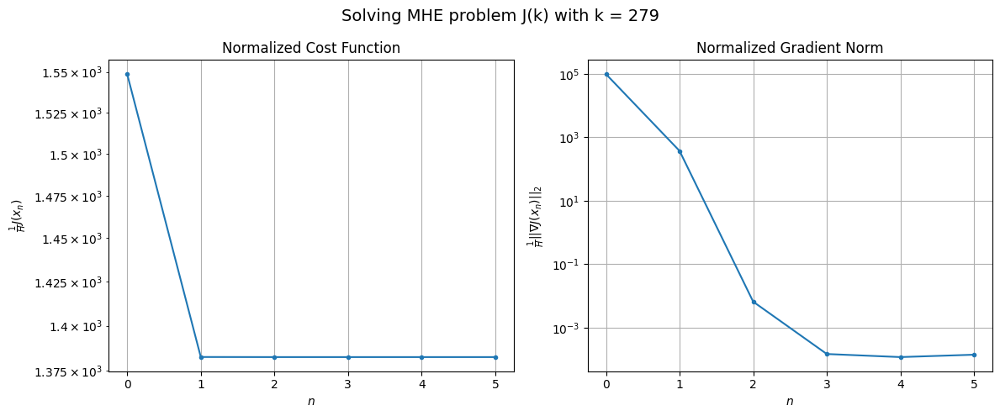

Windows:  69%|██████▉   | 261/376 [23:05<07:56,  4.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30271.083357447038
Gradient norm: 2028469.097199991
Global estimation error: 94.49512190391376
Initial conditions estimation errors: 6.822847310315926 m, 28.594812520085434 m, 38.13900853869407 m, 81.3050631453128 m
Position estimation errors: 11.973756915017498 m, 40.57150856984597 m, 45.04754869614127 m, 66.82161435456767 m

[Gauss-Newton] Iteration 1
Cost function: 26685.65872153323 (-11.84%)
Gradient norm: 3116.0978114348663 (-99.85%)
Global estimation error: 38.60509627567171 (-59.15%)
Initial conditions estimation errors: 9.84308126847753 m, 21.57575947386046 m, 24.85370089146824 m, 17.61327222126527 m
Position estimation errors: 8.743235236049639 m, 25.297966271818247 m, 23.516164338133677 m, 47.42227187166914 m

[Gauss-Newton] Iteration 2
Cost function: 26685.102578226506 (-0.00%)
Gradient norm: 0.5731012259277429 (-99.98%)
Global estimation error: 37.48324405016633 (-2.91%)
Initial conditions estimation errors: 9.8430

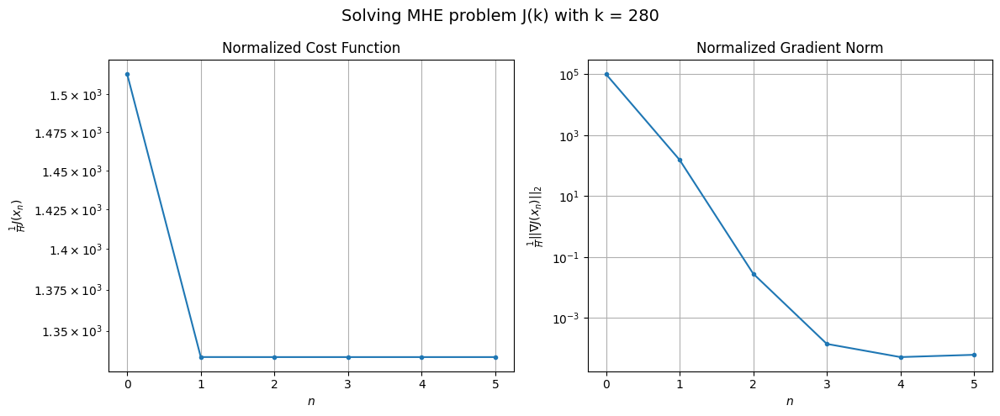

Windows:  70%|██████▉   | 262/376 [23:08<07:16,  3.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28968.23269841773
Gradient norm: 1985041.1444031117
Global estimation error: 30.58020900947525
Initial conditions estimation errors: 6.644176017352025 m, 17.957031730290417 m, 19.662028781378577 m, 13.488361555276123 m
Position estimation errors: 11.916624228625604 m, 29.538813825963075 m, 26.202670546165994 m, 50.137272515561854 m

[Gauss-Newton] Iteration 1
Cost function: 25414.87325645266 (-12.27%)
Gradient norm: 8453.782360909243 (-99.57%)
Global estimation error: 68.47098235630602 (123.91%)
Initial conditions estimation errors: 9.691497674885895 m, 22.777157012142023 m, 10.766755651218247 m, 62.92519297251171 m
Position estimation errors: 8.69819037822721 m, 71.90316190236993 m, 95.79162251363942 m, 135.96070734384324 m

[Gauss-Newton] Iteration 2
Cost function: 25413.662003277863 (-0.00%)
Gradient norm: 13.670789833209298 (-99.84%)
Global estimation error: 75.04964775505358 (9.61%)
Initial conditions estimation errors: 9

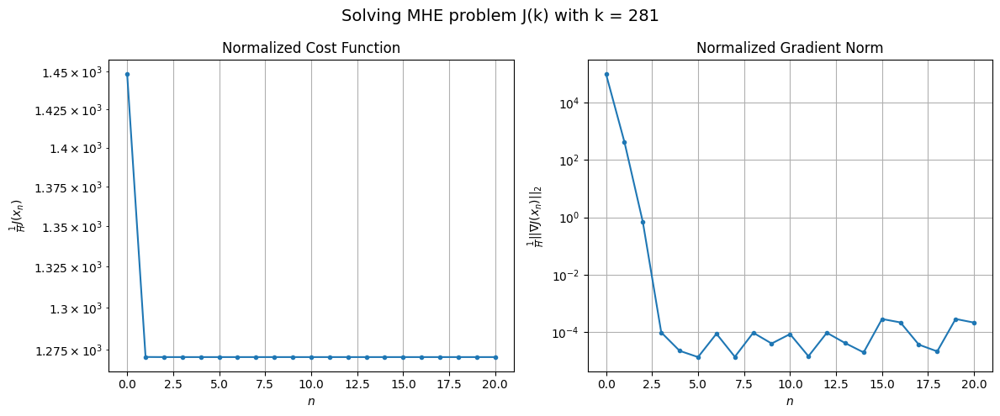

Windows:  70%|██████▉   | 263/376 [23:17<10:29,  5.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27851.863191746528
Gradient norm: 1989160.994386164
Global estimation error: 80.96633430508761
Initial conditions estimation errors: 6.380999955593375 m, 24.7122446063265 m, 21.79311515181104 m, 73.6827760036226 m
Position estimation errors: 11.88113787181055 m, 75.0130314989167 m, 98.27026900886425 m, 136.88904304615352 m

[Gauss-Newton] Iteration 1
Cost function: 24323.491700850092 (-12.67%)
Gradient norm: 396.5347060206486 (-99.98%)
Global estimation error: 94.24955002900784 (16.41%)
Initial conditions estimation errors: 9.402332375234415 m, 29.8075825360202 m, 25.71058854058561 m, 85.11750898249576 m
Position estimation errors: 8.632337302932957 m, 83.3794229374407 m, 113.72711774422787 m, 157.09324965613092 m

[Gauss-Newton] Iteration 2
Cost function: 24323.489074188874 (-0.00%)
Gradient norm: 3.208530003581794 (-99.19%)
Global estimation error: 98.0955535601508 (4.08%)
Initial conditions estimation errors: 9.402332456997

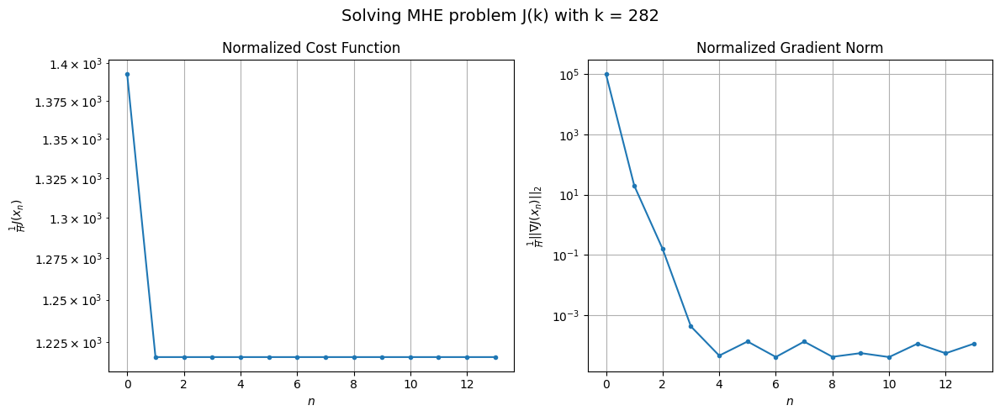

Windows:  70%|███████   | 264/376 [23:24<11:02,  5.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 26815.41239785628
Gradient norm: 1999023.9728293023
Global estimation error: 106.55748450219676
Initial conditions estimation errors: 6.106405598044292 m, 32.569904457780254 m, 36.1563162614479 m, 94.59958052846842 m
Position estimation errors: 11.763036564838698 m, 85.15112086164183 m, 114.657071752789 m, 155.60337368716313 m

[Gauss-Newton] Iteration 1
Cost function: 23384.874989636137 (-12.79%)
Gradient norm: 70893.2217088179 (-96.45%)
Global estimation error: 219.08829457175287 (105.61%)
Initial conditions estimation errors: 9.125020259127398 m, 81.73602329443221 m, 99.12606134593148 m, 177.22766374605922 m
Position estimation errors: 8.485968318009922 m, 44.083546352269785 m, 71.5263346077783 m, 64.24252444630747 m

[Gauss-Newton] Iteration 2
Cost function: 23271.403621287434 (-0.49%)
Gradient norm: 7.543963851679455 (-99.99%)
Global estimation error: 228.56688362355197 (4.33%)
Initial conditions estimation errors: 9.1250

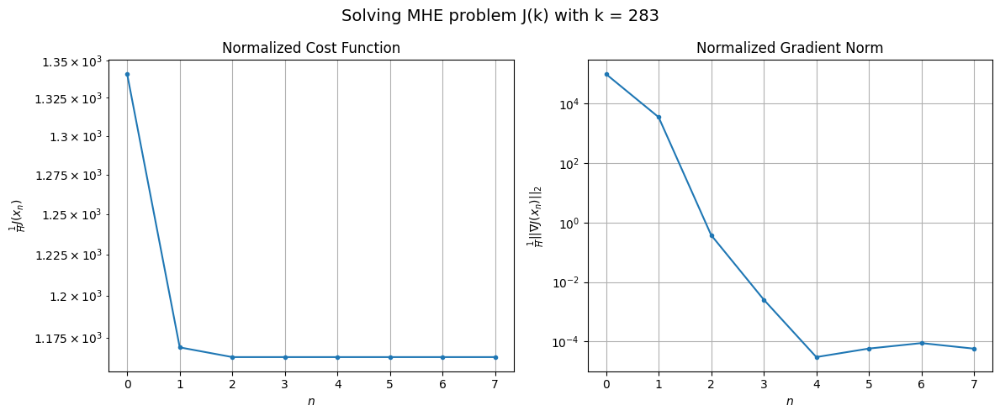

Windows:  70%|███████   | 265/376 [23:28<09:51,  5.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25622.94243146177
Gradient norm: 1969273.665661172
Global estimation error: 229.7573930095249
Initial conditions estimation errors: 5.9021921554182 m, 87.03922571299142 m, 103.63377193983895 m, 185.57431758687557 m
Position estimation errors: 11.47185192386298 m, 37.27510007088043 m, 65.78620010381923 m, 47.30776248161552 m

[Gauss-Newton] Iteration 1
Cost function: 22216.628181736312 (-13.29%)
Gradient norm: 6989.268365740115 (-99.65%)
Global estimation error: 245.2501610544917 (6.74%)
Initial conditions estimation errors: 8.852923631148915 m, 93.44133510523272 m, 119.11078365222887 m, 192.74480881326352 m
Position estimation errors: 8.22925023006013 m, 89.36763359774704 m, 135.82609349595612 m, 144.55472056705057 m

[Gauss-Newton] Iteration 2
Cost function: 22215.89084599942 (-0.00%)
Gradient norm: 5.765191554014384 (-99.92%)
Global estimation error: 250.1326916825064 (1.99%)
Initial conditions estimation errors: 8.852923691

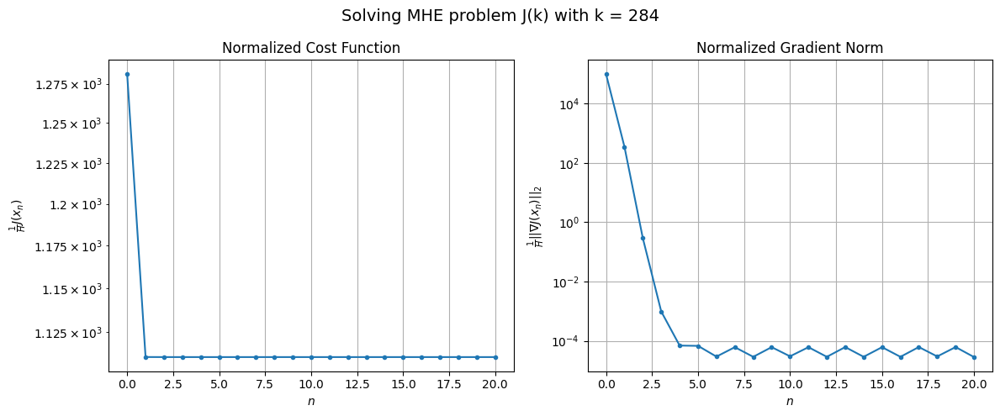

Windows:  71%|███████   | 266/376 [23:38<12:13,  6.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 24589.763312096868
Gradient norm: 1940273.0714310613
Global estimation error: 259.3225887688283
Initial conditions estimation errors: 5.738994633375366 m, 100.09506141928016 m, 126.29569064132944 m, 203.0901572630946 m
Position estimation errors: 11.036965997974267 m, 85.2564791283427 m, 131.7935041263979 m, 134.4011361660374 m

[Gauss-Newton] Iteration 1
Cost function: 21402.93874001561 (-12.96%)
Gradient norm: 4659.99503593041 (-99.76%)
Global estimation error: 154.65270319802343 (-40.36%)
Initial conditions estimation errors: 8.573882364050325 m, 57.14208501689808 m, 84.20259116204504 m, 116.14054141176274 m
Position estimation errors: 7.872183502307534 m, 65.32213368564025 m, 77.2469226954986 m, 100.77168107670055 m

[Gauss-Newton] Iteration 2
Cost function: 21402.29053309616 (-0.00%)
Gradient norm: 26.624070816785263 (-99.43%)
Global estimation error: 145.5402572487826 (-5.89%)
Initial conditions estimation errors: 8.5738

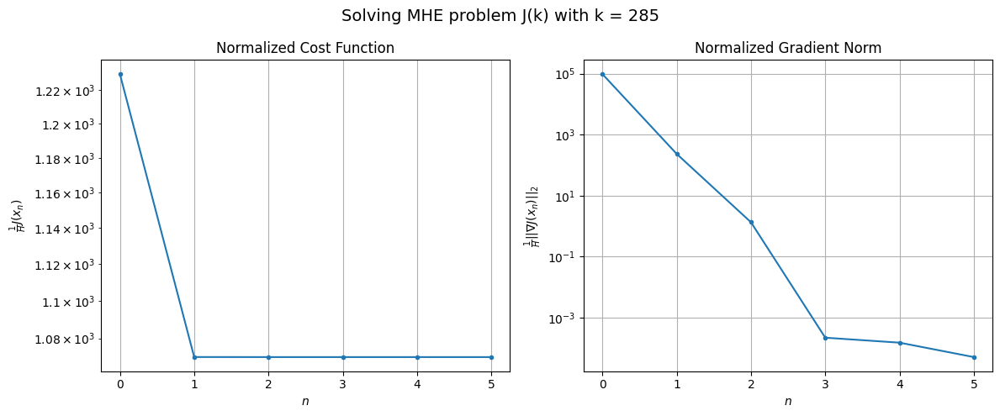

Windows:  71%|███████   | 267/376 [23:41<10:10,  5.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23246.693735431603
Gradient norm: 1857067.243727768
Global estimation error: 151.71629044381842
Initial conditions estimation errors: 5.586858606790811 m, 57.57894997081497 m, 81.63533147289523 m, 114.04795410561081 m
Position estimation errors: 10.602369286108894 m, 61.73704602528042 m, 70.38345362512258 m, 93.03835878950298 m

[Gauss-Newton] Iteration 1
Cost function: 20347.562412855015 (-12.47%)
Gradient norm: 50982.815606012424 (-97.25%)
Global estimation error: 177.00338653618948 (16.67%)
Initial conditions estimation errors: 8.354650812260244 m, 62.99384633312519 m, 99.40958854945775 m, 131.94655883987488 m
Position estimation errors: 7.5600942160091105 m, 45.177096004553135 m, 54.3658666763961 m, 77.69535481286498 m

[Gauss-Newton] Iteration 2
Cost function: 20270.248001092023 (-0.38%)
Gradient norm: 9.658112429727252 (-99.98%)
Global estimation error: 173.87848776755465 (-1.77%)
Initial conditions estimation errors: 8.

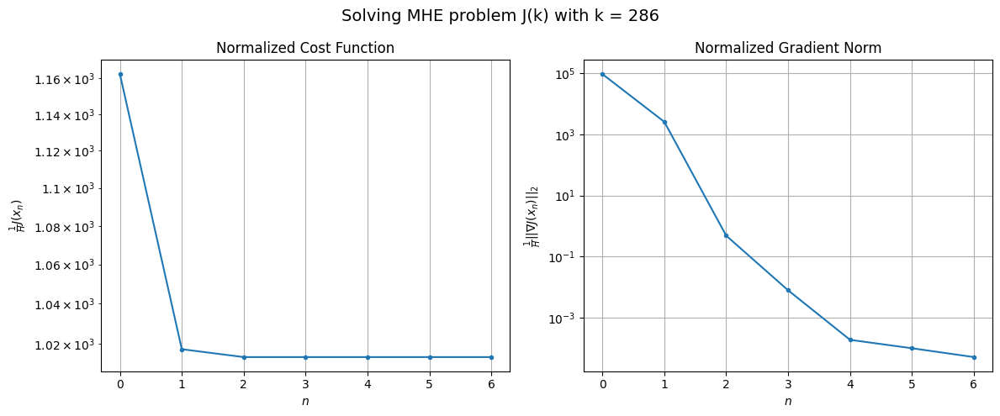

Windows:  71%|███████▏  | 268/376 [23:45<09:01,  5.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22179.68186037538
Gradient norm: 1833763.8357573845
Global estimation error: 177.1192310036841
Initial conditions estimation errors: 5.4795483927540545 m, 62.56998700074715 m, 101.0896658530944 m, 131.17569320791122 m
Position estimation errors: 10.360490425614383 m, 44.84459306878426 m, 51.9151431691304 m, 75.51042383925406 m

[Gauss-Newton] Iteration 1
Cost function: 20072.369056331983 (-9.50%)
Gradient norm: 171079.91279984507 (-90.67%)
Global estimation error: 338.07192577106747 (90.87%)
Initial conditions estimation errors: 8.151898926339221 m, 126.59115147872245 m, 145.5699426090536 m, 277.5069907193682 m
Position estimation errors: 7.401079510508004 m, 147.9469568539825 m, 241.01054655121644 m, 242.61498530190957 m

[Gauss-Newton] Iteration 2
Cost function: 19382.462093965656 (-3.44%)
Gradient norm: 154.55443471665208 (-99.91%)
Global estimation error: 341.60756018170355 (1.05%)
Initial conditions estimation errors: 8.1

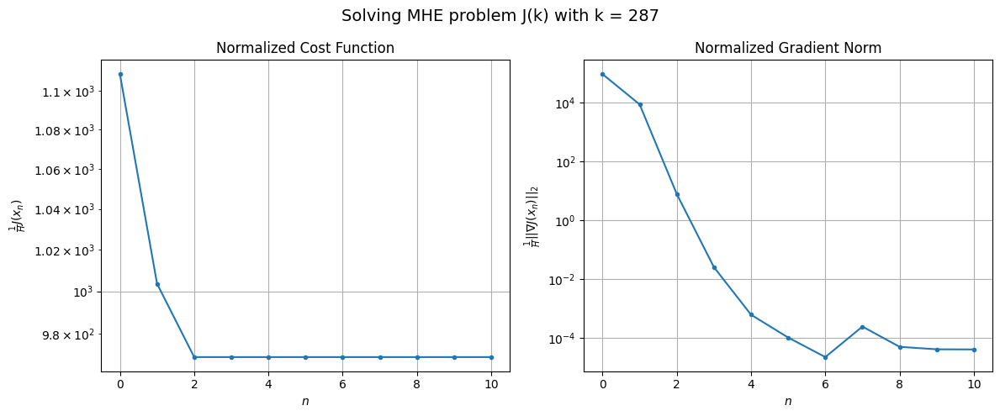

Windows:  72%|███████▏  | 269/376 [23:50<09:04,  5.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 21304.43683017823
Gradient norm: 1836820.2049862926
Global estimation error: 358.67882045725514
Initial conditions estimation errors: 5.337616926907953 m, 135.9370909889948 m, 158.1094161547265 m, 291.79520534316197 m
Position estimation errors: 10.325064716571397 m, 133.8552066299279 m, 225.29145680103844 m, 210.99850958586973 m

[Gauss-Newton] Iteration 1
Cost function: 18590.90802956535 (-12.74%)
Gradient norm: 32434.153572248953 (-98.23%)
Global estimation error: 73.9095615157696 (-79.39%)
Initial conditions estimation errors: 7.991760770535611 m, 25.30817183470697 m, 23.47031420441557 m, 64.86411801965362 m
Position estimation errors: 7.392929331943501 m, 69.55847765952231 m, 100.06777449241302 m, 116.90535295408539 m

[Gauss-Newton] Iteration 2
Cost function: 18556.265374031427 (-0.19%)
Gradient norm: 30.830336931773324 (-99.90%)
Global estimation error: 85.19149293589987 (15.26%)
Initial conditions estimation errors: 7.

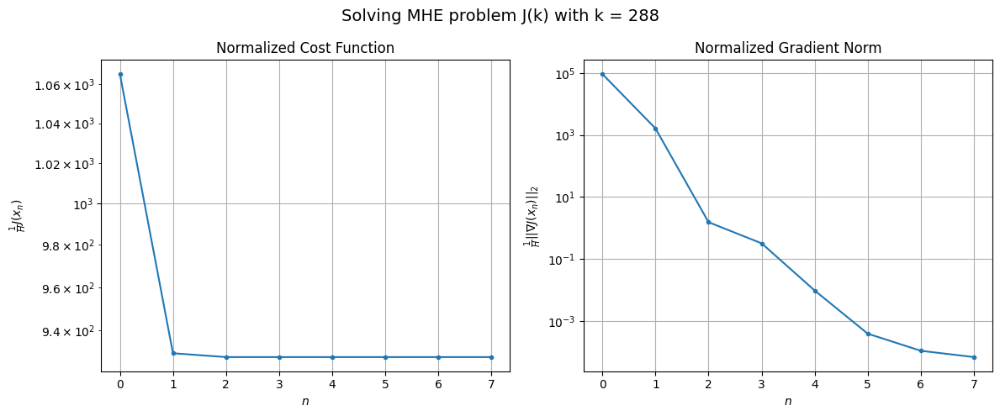

Windows:  72%|███████▏  | 270/376 [23:54<08:24,  4.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20697.50029302793
Gradient norm: 1842638.3399030585
Global estimation error: 90.31485114377128
Initial conditions estimation errors: 5.198033453743409 m, 32.95705115397902 m, 31.32891998025365 m, 77.85914921647161 m
Position estimation errors: 10.400979951566864 m, 71.13772909493896 m, 99.93434643005925 m, 116.77818485620632 m

[Gauss-Newton] Iteration 1
Cost function: 23233.08850377195 (12.25%)
Gradient norm: 363775.9360508596 (-80.26%)
Global estimation error: 1137.4180612371028 (1159.39%)
Initial conditions estimation errors: 7.814958112018001 m, 436.25955545670143 m, 581.7205861440971 m, 874.6069682193038 m
Position estimation errors: 7.489659768372952 m, 283.1867248997257 m, 460.1331649420133 m, 413.24959162374955 m

[Gauss-Newton] Iteration 2
Cost function: 18002.41675950089 (-22.51%)
Gradient norm: 799.5337449016088 (-99.78%)
Global estimation error: 1130.3102715410291 (-0.62%)
Initial conditions estimation errors: 7.81

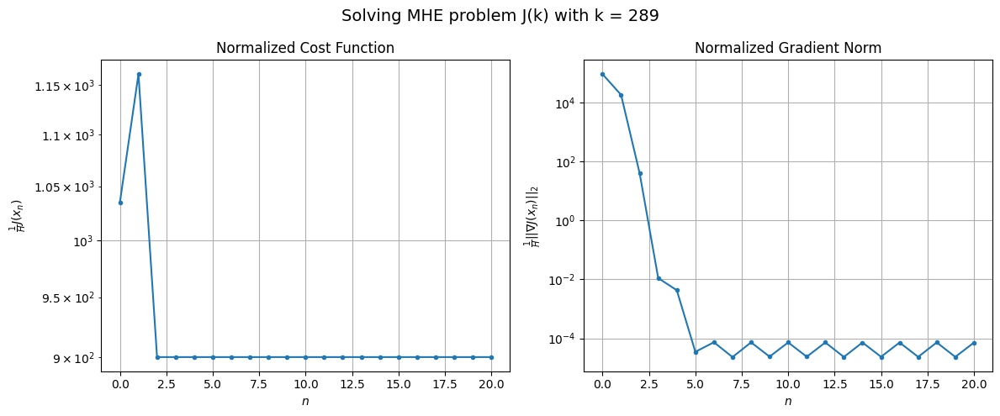

Windows:  72%|███████▏  | 271/376 [24:03<10:49,  6.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20320.67167999807
Gradient norm: 1832567.3694825745
Global estimation error: 1148.071248149786
Initial conditions estimation errors: 5.0610094640543 m, 442.2427378612218 m, 591.6835019918603 m, 878.8480334157192 m
Position estimation errors: 10.5590558197642 m, 241.27114603250058 m, 406.87374846899644 m, 327.9423941922068 m

[Gauss-Newton] Iteration 1
Cost function: 24761.992662381257 (21.86%)
Gradient norm: 447891.23999762995 (-75.56%)
Global estimation error: 2234.2463753303587 (94.61%)
Initial conditions estimation errors: 7.645544804791106 m, 861.560824986147 m, 1187.0152426699053 m, 1685.379993679039 m
Position estimation errors: 7.682200336597767 m, 511.612239278176 m, 804.1569484273136 m, 715.0554059023502 m

[Gauss-Newton] Iteration 2
Cost function: 17686.003171850392 (-28.58%)
Gradient norm: 4890.662612622933 (-98.91%)
Global estimation error: 2155.978894039422 (-3.50%)
Initial conditions estimation errors: 7.64554492

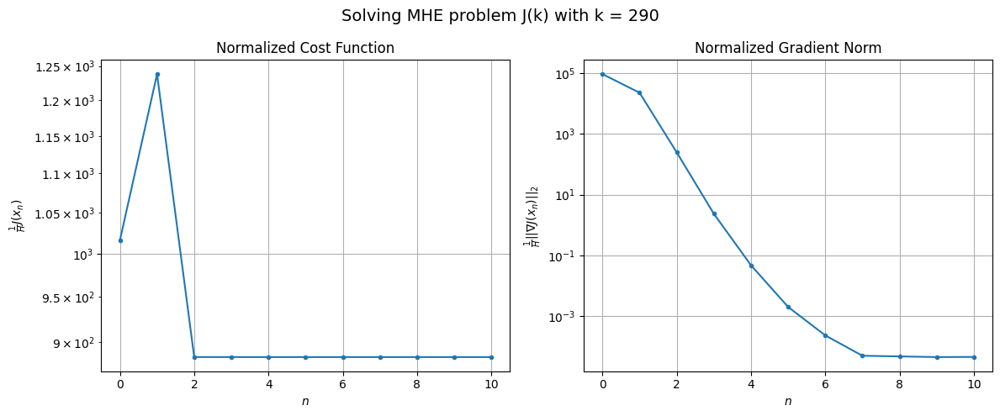

Windows:  72%|███████▏  | 272/376 [24:09<10:14,  5.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20495.68121006691
Gradient norm: 1884067.8427250544
Global estimation error: 2195.478369394829
Initial conditions estimation errors: 4.973216262974837 m, 850.7468762068112 m, 1175.3760197332049 m, 1647.671464681234 m
Position estimation errors: 10.811782987283602 m, 432.4248029607034 m, 693.7321200455599 m, 564.1329555149314 m

[Gauss-Newton] Iteration 1
Cost function: 17768.970436982738 (-13.30%)
Gradient norm: 1527.1226203990082 (-99.92%)
Global estimation error: 2235.2405175123085 (1.81%)
Initial conditions estimation errors: 7.588139614023025 m, 861.2276616093685 m, 1211.2858709489046 m, 1669.5256168250248 m
Position estimation errors: 7.877398880903359 m, 455.0025703987408 m, 694.3141858647509 m, 614.0233464614419 m

[Gauss-Newton] Iteration 2
Cost function: 17768.91195121597 (-0.00%)
Gradient norm: 11.393008991405406 (-99.25%)
Global estimation error: 2226.587398493643 (-0.39%)
Initial conditions estimation errors: 7.588

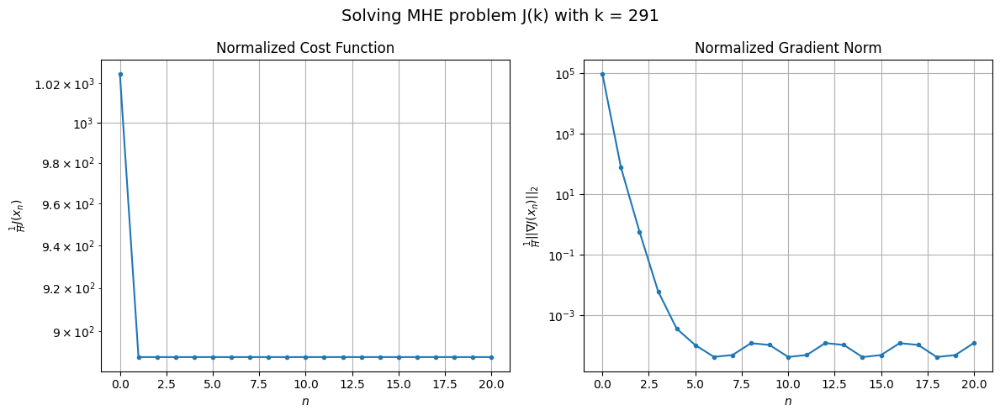

Windows:  73%|███████▎  | 273/376 [24:18<12:02,  7.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20838.095411327093
Gradient norm: 1906337.6397665166
Global estimation error: 2242.071953274117
Initial conditions estimation errors: 4.992582360513824 m, 869.178171355242 m, 1225.9795738419184 m, 1663.8404186928997 m
Position estimation errors: 11.022631343097515 m, 406.6338203751549 m, 622.0612811077075 m, 521.1093213804712 m

[Gauss-Newton] Iteration 1
Cost function: 21392.420013165018 (2.66%)
Gradient norm: 244921.44286902016 (-87.15%)
Global estimation error: 1233.1331830556246 (-45.00%)
Initial conditions estimation errors: 7.630488271227618 m, 478.1143914829936 m, 670.5019636221712 m, 917.8196342688283 m
Position estimation errors: 8.05002611372837 m, 255.36230302760364 m, 388.405599906237 m, 340.3071069570088 m

[Gauss-Newton] Iteration 2
Cost function: 18057.911287410163 (-15.59%)
Gradient norm: 17759.812837388385 (-92.75%)
Global estimation error: 1040.8199144493306 (-15.60%)
Initial conditions estimation errors: 7.6

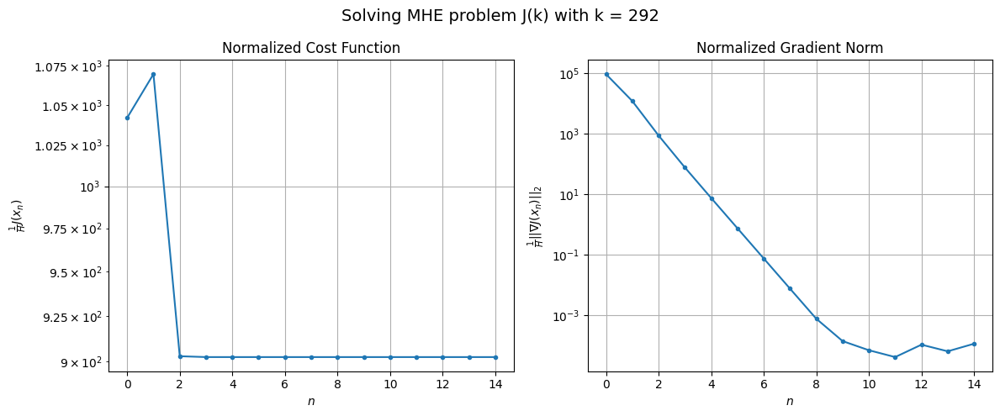

Windows:  73%|███████▎  | 274/376 [24:25<11:55,  7.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 21522.117573599124
Gradient norm: 1939996.3222877325
Global estimation error: 957.7996144345655
Initial conditions estimation errors: 5.074080001736627 m, 372.20716915511485 m, 519.3364725551327 m, 713.5164848572737 m
Position estimation errors: 11.170949168147066 m, 154.1691733283729 m, 238.07028440112924 m, 172.91005524162395 m

[Gauss-Newton] Iteration 1
Cost function: 28373.152233095214 (31.83%)
Gradient norm: 557465.80110274 (-71.26%)
Global estimation error: 172.9337697266416 (-81.94%)
Initial conditions estimation errors: 7.723564498429284 m, 70.08228659341363 m, 109.83723083367684 m, 113.4481627302503 m
Position estimation errors: 8.152424635293661 m, 161.72140844443604 m, 228.53033320005537 m, 316.4272075229031 m

[Gauss-Newton] Iteration 2
Cost function: 18672.414734677735 (-34.19%)
Gradient norm: 4185.30599562852 (-99.25%)
Global estimation error: 191.27757431209992 (10.61%)
Initial conditions estimation errors: 7.7

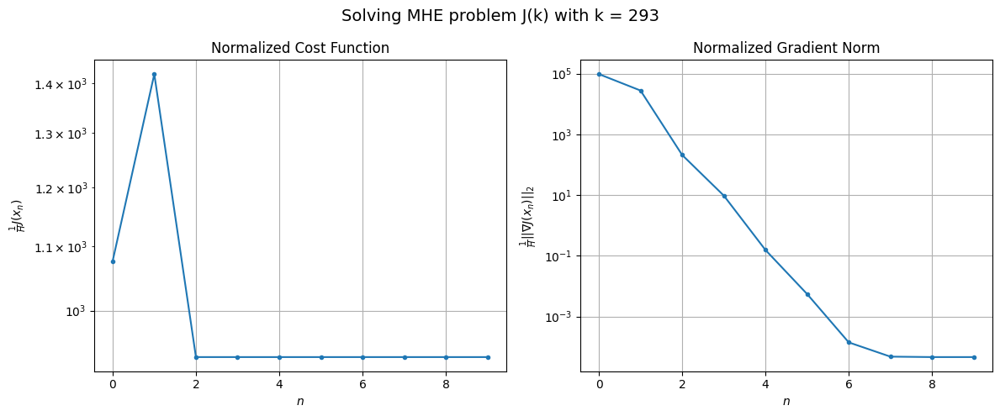

Windows:  73%|███████▎  | 275/376 [24:30<10:39,  6.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22079.69997752642
Gradient norm: 1919724.8743322813
Global estimation error: 239.88742961409525
Initial conditions estimation errors: 5.153611611916964 m, 98.11791969805732 m, 154.12311453432977 m, 155.36424871175038 m
Position estimation errors: 11.310800626472155 m, 204.88666099945377 m, 288.067625885918 m, 404.06919835326346 m

[Gauss-Newton] Iteration 1
Cost function: 19190.734696222837 (-13.08%)
Gradient norm: 28067.26444561156 (-98.54%)
Global estimation error: 487.06829107260216 (103.04%)
Initial conditions estimation errors: 7.857222387577026 m, 191.90746635118424 m, 315.1976376352576 m, 317.79759310472394 m
Position estimation errors: 8.278737380090522 m, 280.6052522254436 m, 373.5857030601431 m, 529.7398982224465 m

[Gauss-Newton] Iteration 2
Cost function: 19166.120052801696 (-0.13%)
Gradient norm: 4060.4721695121234 (-85.53%)
Global estimation error: 411.2449909013499 (-15.57%)
Initial conditions estimation errors:

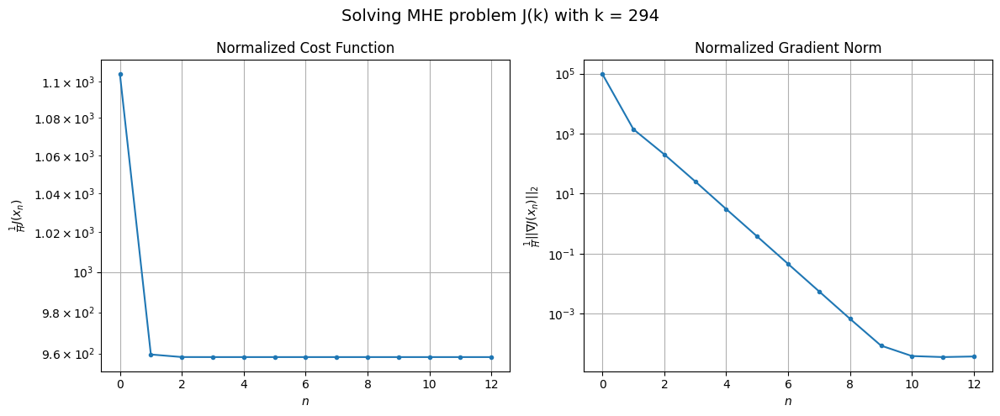

Windows:  73%|███████▎  | 276/376 [24:36<10:29,  6.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22733.75011883167
Gradient norm: 1956328.3829336765
Global estimation error: 463.9332190776692
Initial conditions estimation errors: 5.225037058342907 m, 183.09845067173077 m, 298.0636660437936 m, 304.6955589588936 m
Position estimation errors: 11.602492288294705 m, 251.9717348127303 m, 329.4727727145628 m, 482.9059558212226 m

[Gauss-Newton] Iteration 1
Cost function: 29303.532968057174 (28.90%)
Gradient norm: 642810.997079113 (-67.14%)
Global estimation error: 1406.3280622879115 (203.13%)
Initial conditions estimation errors: 7.970629471915187 m, 559.0202212460846 m, 865.0677361228206 m, 957.5215440879689 m
Position estimation errors: 8.526220691663719 m, 622.4253880336355 m, 884.3973050054267 m, 1128.5202925417707 m

[Gauss-Newton] Iteration 2
Cost function: 19717.99490665646 (-32.71%)
Gradient norm: 858.2149797333776 (-99.87%)
Global estimation error: 1327.7775306291455 (-5.59%)
Initial conditions estimation errors: 7.9706

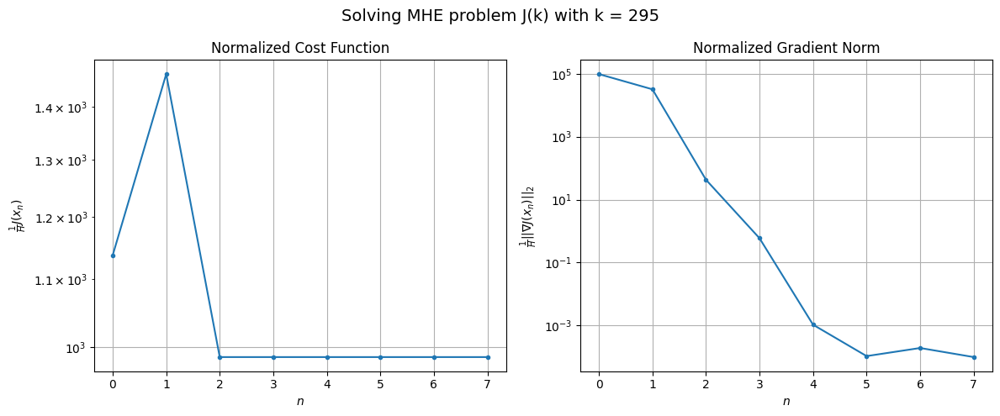

Windows:  74%|███████▎  | 277/376 [24:40<09:12,  5.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23731.80636460724
Gradient norm: 2016890.1832334292
Global estimation error: 1406.660118380008
Initial conditions estimation errors: 5.253575083888765 m, 561.0070692942417 m, 865.2545151751713 m, 956.6970147101878 m
Position estimation errors: 12.073993403153773 m, 595.1300947693001 m, 841.2190910816586 m, 1094.6100595024297 m

[Gauss-Newton] Iteration 1
Cost function: 20555.03793455213 (-13.39%)
Gradient norm: 2325.8127835557625 (-99.88%)
Global estimation error: 1260.9683591584633 (-10.36%)
Initial conditions estimation errors: 8.05268127292448 m, 499.8572089082546 m, 799.4244465199231 m, 837.28006355837 m
Position estimation errors: 8.90331908685795 m, 594.6477070181057 m, 841.3348425028139 m, 1109.639719653653 m

[Gauss-Newton] Iteration 2
Cost function: 20554.216476561876 (-0.00%)
Gradient norm: 885.2657180948634 (-61.94%)
Global estimation error: 1234.732190181241 (-2.08%)
Initial conditions estimation errors: 8.05268134

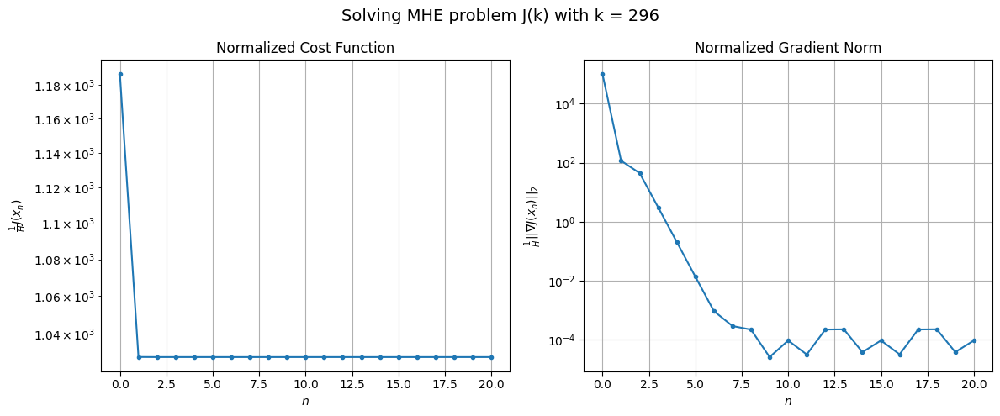

Windows:  74%|███████▍  | 278/376 [24:50<11:01,  6.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25171.193515233634
Gradient norm: 2096621.275952526
Global estimation error: 1296.1034189260968
Initial conditions estimation errors: 5.285047646032816 m, 514.0593011128902 m, 813.6970488151574 m, 868.0408178290231 m
Position estimation errors: 12.644469213723053 m, 550.7042487232318 m, 775.4842978658289 m, 1035.5347273053435 m

[Gauss-Newton] Iteration 1
Cost function: 23233.993919704284 (-7.70%)
Gradient norm: 283283.262268356 (-86.49%)
Global estimation error: 870.4051210819875 (-32.84%)
Initial conditions estimation errors: 8.138159381875436 m, 343.4680378915951 m, 533.3654722308471 m, 595.8939103656694 m
Position estimation errors: 9.35777741722175 m, 280.07438436470335 m, 376.98353383898734 m, 509.0330511861129 m

[Gauss-Newton] Iteration 2
Cost function: 21843.472510804502 (-5.98%)
Gradient norm: 48265.4892821652 (-82.96%)
Global estimation error: 658.675056723314 (-24.33%)
Initial conditions estimation errors: 8.138159

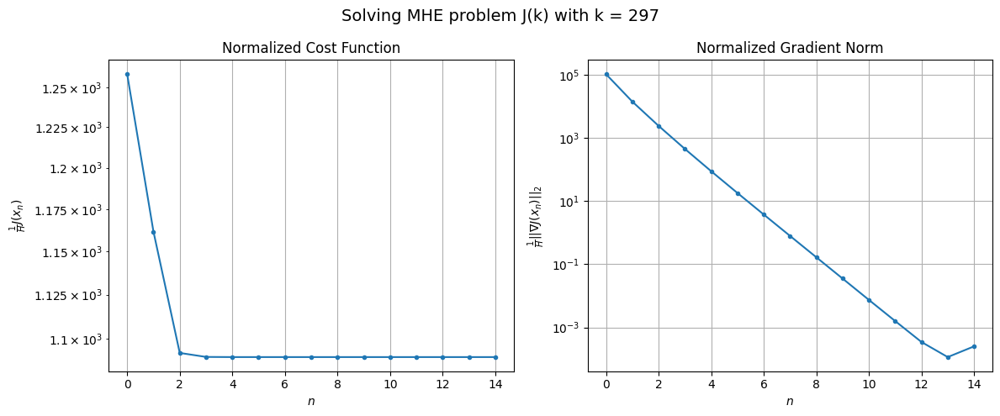

Windows:  74%|███████▍  | 279/376 [24:57<11:06,  6.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27293.86386301444
Gradient norm: 2214009.1105192695
Global estimation error: 499.36454686004885
Initial conditions estimation errors: 5.3742625916221645 m, 191.72820203718553 m, 297.15493050868093 m, 352.52701579721395 m
Position estimation errors: 13.256872774825972 m, 77.91224909039809 m, 78.50326331397069 m, 129.24464322921293 m

[Gauss-Newton] Iteration 1
Cost function: 38779.509666624326 (42.08%)
Gradient norm: 814169.9679205543 (-63.23%)
Global estimation error: 541.1239512222314 (8.36%)
Initial conditions estimation errors: 8.282917562254513 m, 229.5647957711505 m, 358.7159413808385 m, 333.71944844363423 m
Position estimation errors: 9.813306665132897 m, 336.74819969581057 m, 510.5490423277834 m, 662.8737785866955 m

[Gauss-Newton] Iteration 2
Cost function: 23705.029455813823 (-38.87%)
Gradient norm: 39602.94255347237 (-95.14%)
Global estimation error: 817.6064251353072 (51.09%)
Initial conditions estimation errors: 8.

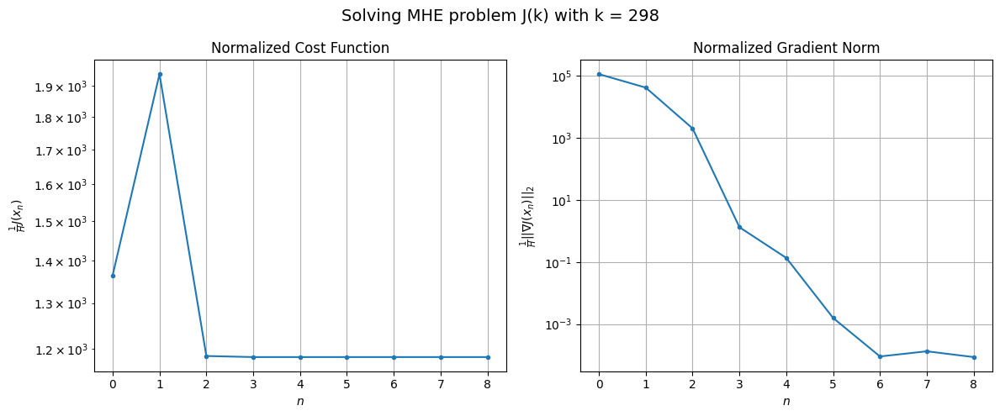

Windows:  74%|███████▍  | 280/376 [25:01<09:54,  6.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29859.674075333507
Gradient norm: 2342817.3593718116
Global estimation error: 886.0358172679055
Initial conditions estimation errors: 5.545087823920415 m, 366.2239160517288 m, 560.0026681377337 m, 580.7795600679278 m
Position estimation errors: 13.890269958859452 m, 405.95571564182256 m, 611.6902027745765 m, 792.852956251919 m

[Gauss-Newton] Iteration 1
Cost function: 25894.59473679834 (-13.28%)
Gradient norm: 4672.955301626472 (-99.80%)
Global estimation error: 798.7838999561662 (-9.85%)
Initial conditions estimation errors: 8.55803284193614 m, 326.9599035678667 m, 524.0565545432673 m, 506.40264681197135 m
Position estimation errors: 10.27790580029833 m, 367.78176476148104 m, 560.4698389809245 m, 753.4041767415389 m

[Gauss-Newton] Iteration 2
Cost function: 25894.12820563837 (-0.00%)
Gradient norm: 2114.340337311987 (-54.75%)
Global estimation error: 752.7517824352398 (-5.76%)
Initial conditions estimation errors: 8.5580329

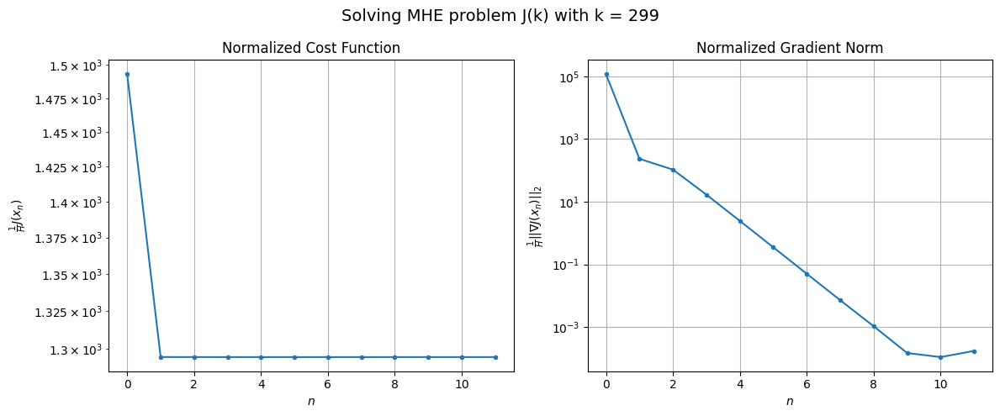

Windows:  75%|███████▍  | 281/376 [25:07<09:33,  6.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 32439.140989019277
Gradient norm: 2443887.6290457677
Global estimation error: 767.6020107556932
Initial conditions estimation errors: 5.8111589979489 m, 310.5332710073007 m, 502.22713119142537 m, 490.42380682263627 m
Position estimation errors: 14.597243662513764 m, 319.1127782934044 m, 483.2883378874779 m, 667.5850279768887 m

[Gauss-Newton] Iteration 1
Cost function: 32078.8909116463 (-1.11%)
Gradient norm: 446948.91379123135 (-81.71%)
Global estimation error: 139.89394935772958 (-81.78%)
Initial conditions estimation errors: 8.92210298094845 m, 42.7044192928067 m, 111.20103202119641 m, 72.81048646194122 m
Position estimation errors: 10.851995600649772 m, 15.066896310100773 m, 22.602637638389293 m, 31.507339540447113 m

[Gauss-Newton] Iteration 2
Cost function: 30941.148443369544 (-3.55%)
Gradient norm: 385037.83986301895 (-13.85%)
Global estimation error: 672.3189789375625 (380.59%)
Initial conditions estimation errors: 8.9

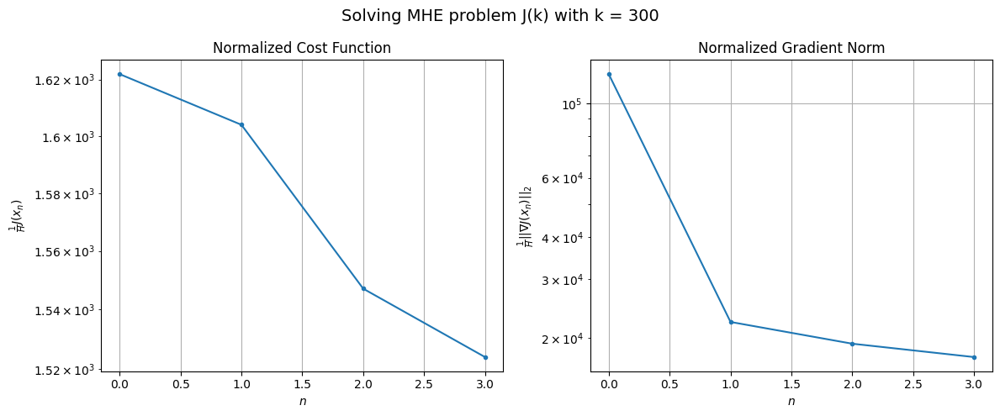

Windows:  75%|███████▌  | 282/376 [25:09<07:41,  4.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 38449.30662512593
Gradient norm: 2599154.241821103
Global estimation error: 163.66163074197377
Initial conditions estimation errors: 6.12724563219924 m, 50.860478946914895 m, 128.79444645371152 m, 87.0217337179586 m
Position estimation errors: 15.494625286036355 m, 26.706987269794624 m, 32.34289312961111 m, 53.874137969135354 m

[Gauss-Newton] Iteration 1
Cost function: 34044.02103144696 (-11.46%)
Gradient norm: 378193.6714759893 (-85.45%)
Global estimation error: 676.8355235039566 (313.56%)
Initial conditions estimation errors: 9.324105793871624 m, 275.00669155246874 m, 452.7469568301198 m, 421.20102656827333 m
Position estimation errors: 11.537668118002454 m, 318.2689157776817 m, 470.7483688460798 m, 662.9892255416937 m

[Gauss-Newton] Iteration 2
Cost function: 31498.133545864363 (-7.48%)
Gradient norm: 61225.72481768253 (-83.81%)
Global estimation error: 483.8510133836066 (-28.51%)
Initial conditions estimation errors: 9.3

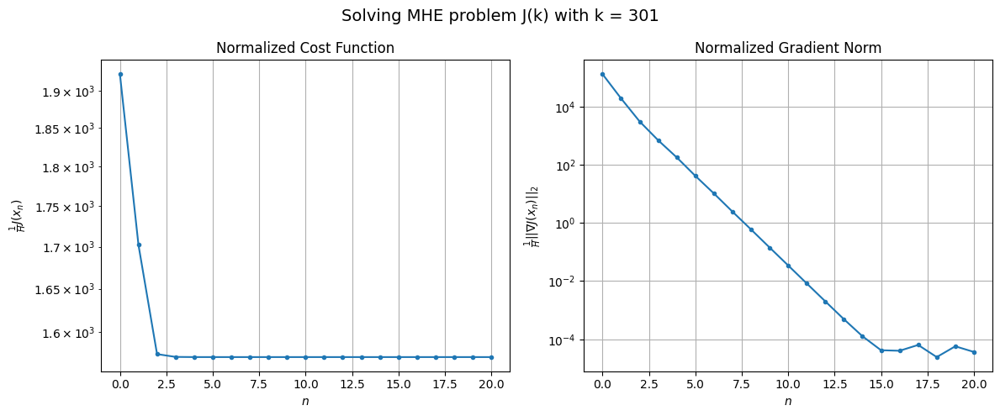

Windows:  75%|███████▌  | 283/376 [25:19<09:46,  6.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 40745.65151393933
Gradient norm: 2805552.6826530835
Global estimation error: 586.455923100492
Initial conditions estimation errors: 6.437444267170751 m, 234.52663225450135 m, 384.2153573004215 m, 375.8519399776197 m
Position estimation errors: 16.58239827444174 m, 220.58438904711952 m, 326.1268053508009 m, 466.3353350125411 m

[Gauss-Newton] Iteration 1
Cost function: 39671.25854593584 (-2.64%)
Gradient norm: 486886.4412222958 (-82.65%)
Global estimation error: 1117.9054887731256 (90.62%)
Initial conditions estimation errors: 9.805066285911378 m, 453.7407511737361 m, 748.781505953855 m, 695.0252621362225 m
Position estimation errors: 12.36297051828121 m, 573.0294984273253 m, 828.4926717334982 m, 1197.34187593473 m

[Gauss-Newton] Iteration 2
Cost function: 35502.75397398843 (-10.51%)
Gradient norm: 7647.296338728959 (-98.43%)
Global estimation error: 1034.0715842988968 (-7.50%)
Initial conditions estimation errors: 9.805066366

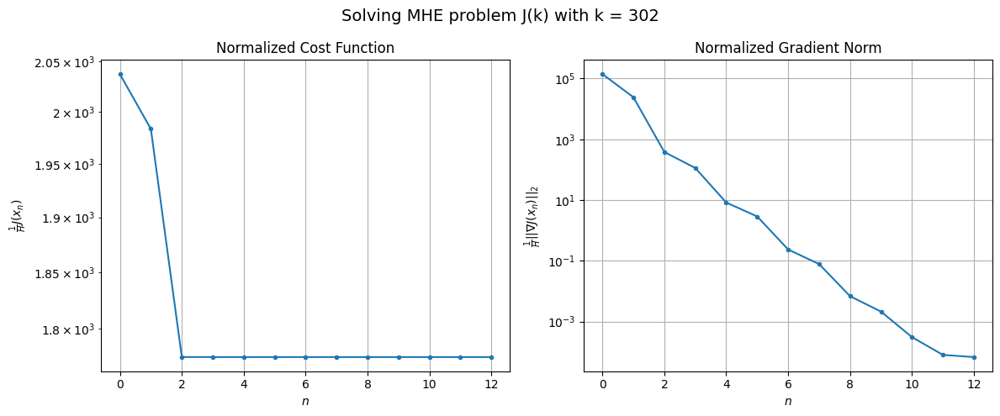

Windows:  76%|███████▌  | 284/376 [25:25<09:29,  6.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 46913.31539696199
Gradient norm: 3071511.9740492785
Global estimation error: 1137.6589396997572
Initial conditions estimation errors: 6.757286567113048 m, 454.2304542986913 m, 763.1206231389698 m, 711.0148502794764 m
Position estimation errors: 17.877285736664366 m, 537.2110994739301 m, 762.9881256317105 m, 1136.3775562315807 m

[Gauss-Newton] Iteration 1
Cost function: 42090.10833688185 (-10.28%)
Gradient norm: 212265.45373695766 (-93.09%)
Global estimation error: 522.9485315158284 (-54.03%)
Initial conditions estimation errors: 10.329817769991374 m, 202.26948114328857 m, 393.3673280711346 m, 278.7772603095045 m
Position estimation errors: 13.311057927360794 m, 355.5706598918028 m, 490.4181676041387 m, 765.404484866315 m

[Gauss-Newton] Iteration 2
Cost function: 40859.17107598289 (-2.92%)
Gradient norm: 4720.004153204177 (-97.78%)
Global estimation error: 586.3128144548151 (12.12%)
Initial conditions estimation errors: 10.32

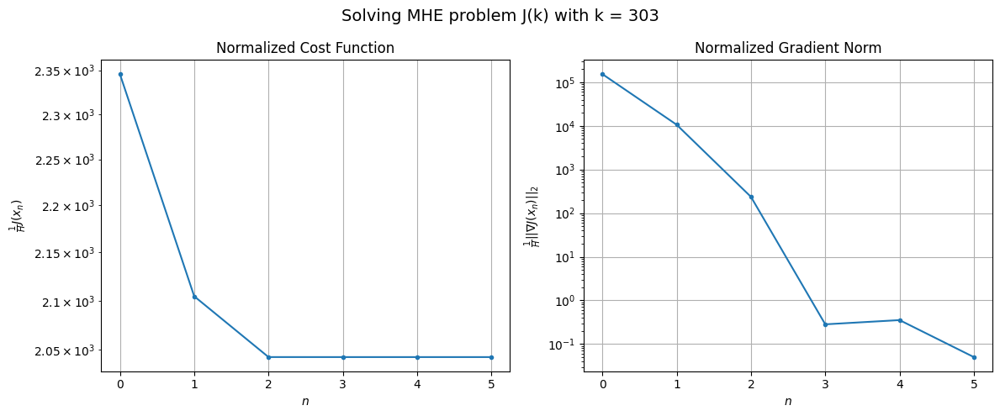

Windows:  76%|███████▌  | 285/376 [25:28<08:07,  5.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 54066.99766151603
Gradient norm: 3334849.266272959
Global estimation error: 643.3981196728039
Initial conditions estimation errors: 7.065432637209016 m, 248.4778422582094 m, 465.89482388226446 m, 367.5744697258814 m
Position estimation errors: 19.308741786212945 m, 385.30748677296793 m, 519.8324796971118 m, 838.6906486250651 m

[Gauss-Newton] Iteration 1
Cost function: 50621.62530763807 (-6.37%)
Gradient norm: 409793.81628327764 (-87.71%)
Global estimation error: 113.95683694785137 (-82.29%)
Initial conditions estimation errors: 10.92480036021738 m, 33.349295183014306 m, 39.49163195230079 m, 100.96990580579192 m
Position estimation errors: 14.35584650795321 m, 101.40236817184693 m, 119.74188888788743 m, 229.83424705021335 m

[Gauss-Newton] Iteration 2
Cost function: 46990.699459395066 (-7.17%)
Gradient norm: 2777.657153704858 (-99.32%)
Global estimation error: 94.56756171604077 (-17.01%)
Initial conditions estimation errors: 1

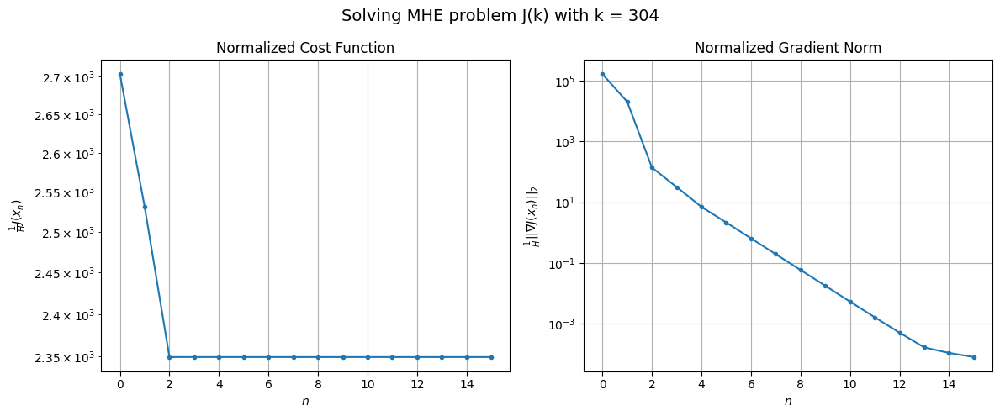

Windows:  76%|███████▌  | 286/376 [25:36<08:57,  5.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 62436.426572831915
Gradient norm: 3599740.110291145
Global estimation error: 79.30696061722303
Initial conditions estimation errors: 7.4544802608242025 m, 7.805284431130715 m, 70.0882448336837 m, 35.50565642570375 m
Position estimation errors: 20.76898116083785 m, 96.88317805523162 m, 106.48757684458806 m, 214.77422870547636 m

[Gauss-Newton] Iteration 1
Cost function: 54353.69597329911 (-12.95%)
Gradient norm: 59839.210576138306 (-98.34%)
Global estimation error: 234.2432309906799 (195.36%)
Initial conditions estimation errors: 11.575392107221376 m, 85.28728456555417 m, 193.8169853353603 m, 99.48161169785926 m
Position estimation errors: 15.42950616069213 m, 208.47144843516833 m, 270.13285465826334 m, 476.1889119472609 m

[Gauss-Newton] Iteration 2
Cost function: 54289.17123348679 (-0.12%)
Gradient norm: 168.54423182652192 (-99.72%)
Global estimation error: 239.3289807301284 (2.17%)
Initial conditions estimation errors: 11.57

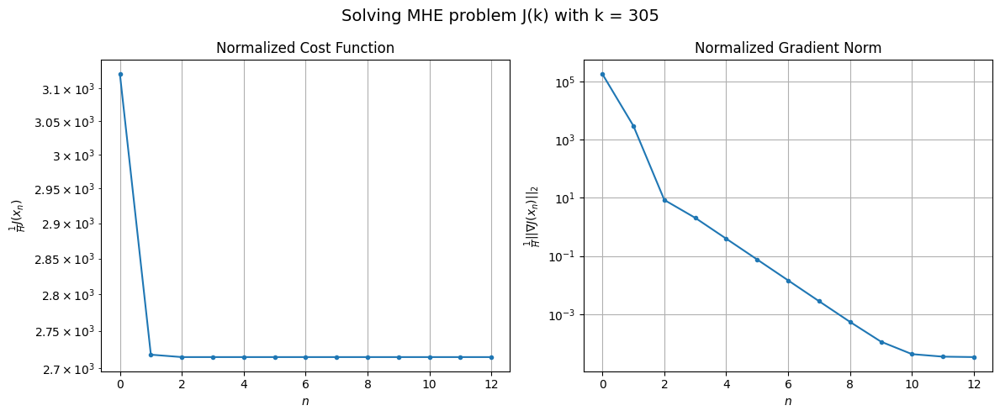

Windows:  76%|███████▋  | 287/376 [25:42<08:56,  6.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 72225.14441434869
Gradient norm: 3862998.424467357
Global estimation error: 274.4876740925179
Initial conditions estimation errors: 7.953563586638485 m, 100.48606318113983 m, 218.0800727383241 m, 132.7533839156058 m
Position estimation errors: 22.146151312260752 m, 222.15791411672944 m, 279.32052249270276 m, 511.3383944335084 m

[Gauss-Newton] Iteration 1
Cost function: 63378.09831967993 (-12.25%)
Gradient norm: 122525.19484358122 (-96.83%)
Global estimation error: 191.5558537916781 (-30.21%)
Initial conditions estimation errors: 12.286856883668754 m, 67.80160311407869 m, 48.53597031133489 m, 172.0167846582346 m
Position estimation errors: 16.430954108083597 m, 80.46187934061363 m, 96.06827496524969 m, 173.8330880693751 m

[Gauss-Newton] Iteration 2
Cost function: 63014.782125491714 (-0.57%)
Gradient norm: 10679.0959007549 (-91.28%)
Global estimation error: 145.07171391817567 (-24.27%)
Initial conditions estimation errors: 12.

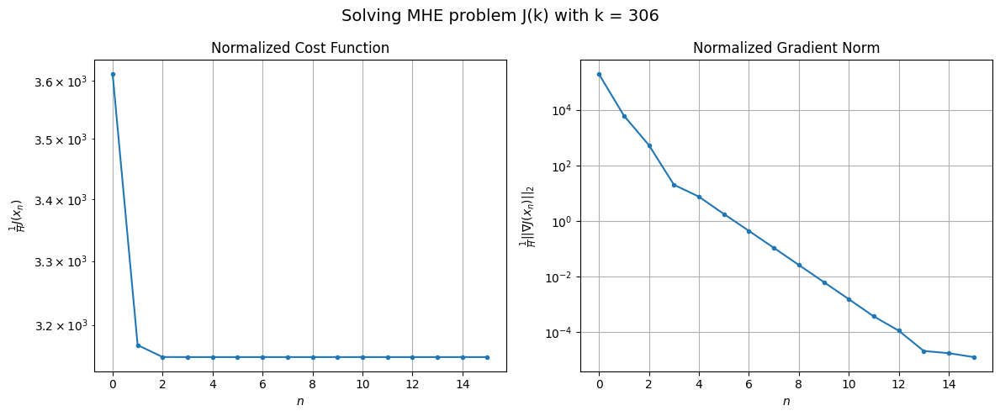

Windows:  77%|███████▋  | 288/376 [25:49<09:28,  6.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 82996.75623132117
Gradient norm: 4081471.3156263307
Global estimation error: 124.25528487744666
Initial conditions estimation errors: 8.539712606341244 m, 28.960408712779948 m, 40.52264613405817 m, 113.51365528051403 m
Position estimation errors: 23.318965204973303 m, 165.19138818603938 m, 201.8992641340873 m, 372.91506485538724 m

[Gauss-Newton] Iteration 1
Cost function: 72976.25153919638 (-12.07%)
Gradient norm: 110146.24460320816 (-97.30%)
Global estimation error: 277.7542890693428 (123.54%)
Initial conditions estimation errors: 13.080676055096648 m, 108.24568196412666 m, 112.89051193110939 m, 229.161351601407 m
Position estimation errors: 17.27909956144888 m, 18.705439278481176 m, 30.344059780742136 m, 31.326081047233888 m

[Gauss-Newton] Iteration 2
Cost function: 72777.38585231331 (-0.27%)
Gradient norm: 1722.4800481312318 (-98.44%)
Global estimation error: 265.40348136190636 (-4.45%)
Initial conditions estimation error

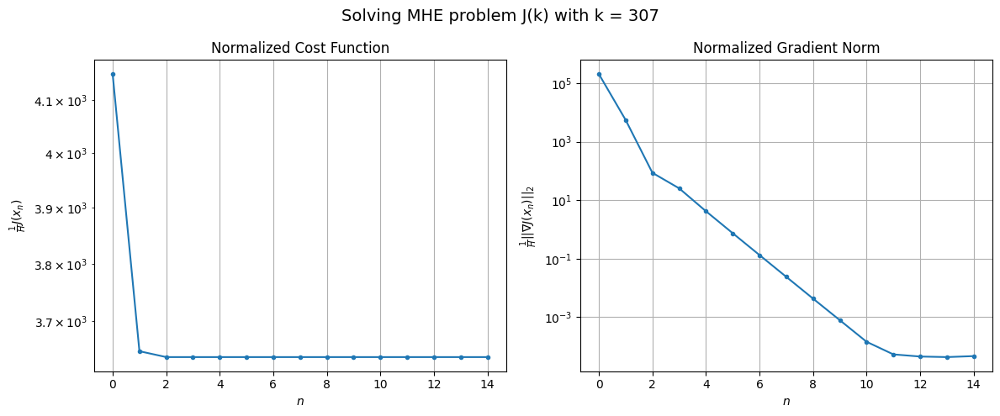

Windows:  77%|███████▋  | 289/376 [25:56<09:36,  6.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 93634.40800406944
Gradient norm: 4224545.557125326
Global estimation error: 273.18017961822216
Initial conditions estimation errors: 9.169604396169612 m, 110.60711333519266 m, 124.65456021413456 m, 216.26514168224477 m
Position estimation errors: 24.22170787291056 m, 53.7397976477604 m, 84.2616740461553 m, 127.85543283832506 m

[Gauss-Newton] Iteration 1
Cost function: 82521.8273088446 (-11.87%)
Gradient norm: 13738.351516809766 (-99.67%)
Global estimation error: 327.4182857811952 (19.85%)
Initial conditions estimation errors: 13.935847218991107 m, 135.17408097957446 m, 160.08657906658576 m, 251.2144081116283 m
Position estimation errors: 17.934116921278907 m, 110.7345622653513 m, 162.7836910904508 m, 273.74934238530926 m

[Gauss-Newton] Iteration 2
Cost function: 82518.86286230096 (-0.00%)
Gradient norm: 234.35832116979668 (-98.29%)
Global estimation error: 330.17860075953735 (0.84%)
Initial conditions estimation errors: 13.9

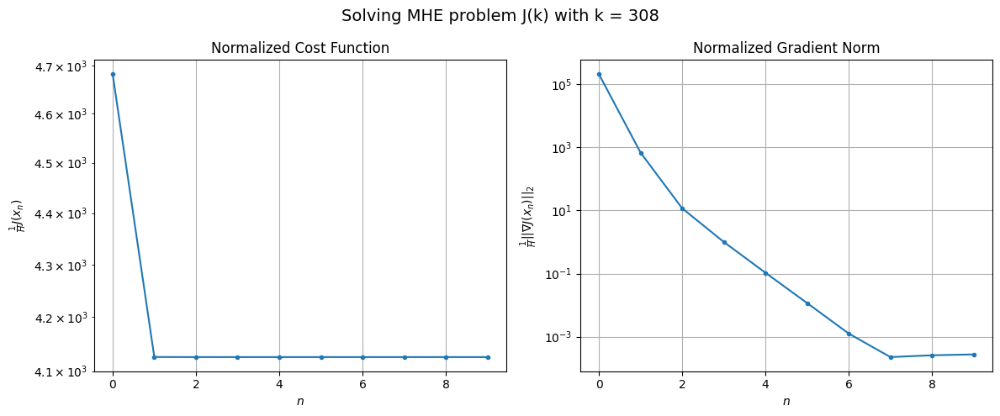

Windows:  77%|███████▋  | 290/376 [26:01<08:46,  6.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 103826.76338199186
Gradient norm: 4335378.760566935
Global estimation error: 348.53002980588127
Initial conditions estimation errors: 9.81794388588885 m, 143.16943138585086 m, 172.1515890870299 m, 266.91389273308295 m
Position estimation errors: 24.820779771127576 m, 116.6916422807102 m, 171.64019459012133 m, 293.1079170282688 m

[Gauss-Newton] Iteration 1
Cost function: 91846.55208783277 (-11.54%)
Gradient norm: 28429.00311460381 (-99.34%)
Global estimation error: 97.92514560497365 (-71.90%)
Initial conditions estimation errors: 14.814375998783898 m, 45.48997723286124 m, 46.206906698293025 m, 71.87065260014876 m
Position estimation errors: 18.31033443914631 m, 63.565632044315684 m, 93.10892536125176 m, 148.31884951926807 m

[Gauss-Newton] Iteration 2
Cost function: 91821.33452671964 (-0.03%)
Gradient norm: 15.610439910270555 (-99.95%)
Global estimation error: 85.68655900045411 (-12.50%)
Initial conditions estimation errors: 1

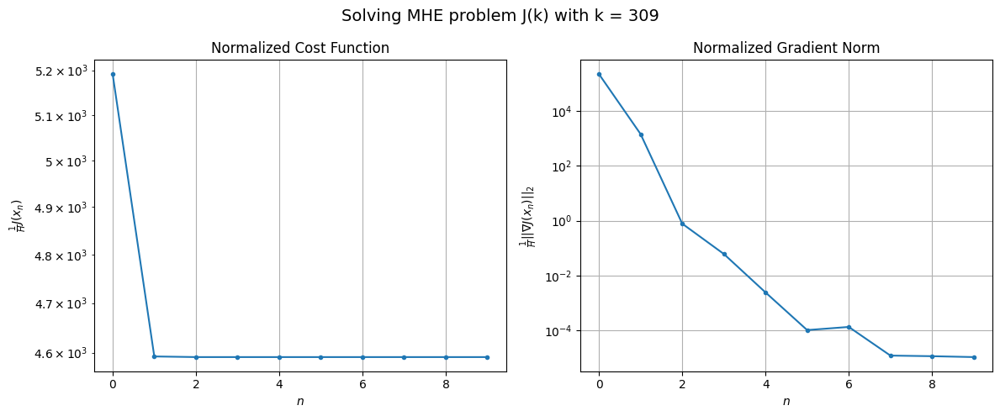

Windows:  77%|███████▋  | 291/376 [26:06<08:05,  5.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 112288.6537858723
Gradient norm: 4356454.670503428
Global estimation error: 93.81307990681856
Initial conditions estimation errors: 10.47429718255399 m, 43.925030379921 m, 44.52020944306207 m, 69.1351365647237 m
Position estimation errors: 25.02126659825714 m, 65.81262324892019 m, 95.52620644849651 m, 152.41987562412086 m

[Gauss-Newton] Iteration 1
Cost function: 99685.7396343663 (-11.22%)
Gradient norm: 30678.182388014106 (-99.30%)
Global estimation error: 68.25316260738943 (-27.25%)
Initial conditions estimation errors: 15.679873291343256 m, 21.83377498266809 m, 43.99301499008296 m, 44.72702818765488 m
Position estimation errors: 18.396461391972696 m, 33.09618965135964 m, 25.02392113276693 m, 52.22581303239039 m

[Gauss-Newton] Iteration 2
Cost function: 99668.69843462095 (-0.02%)
Gradient norm: 12.750181518954776 (-99.96%)
Global estimation error: 70.60011018249197 (3.44%)
Initial conditions estimation errors: 15.679873657

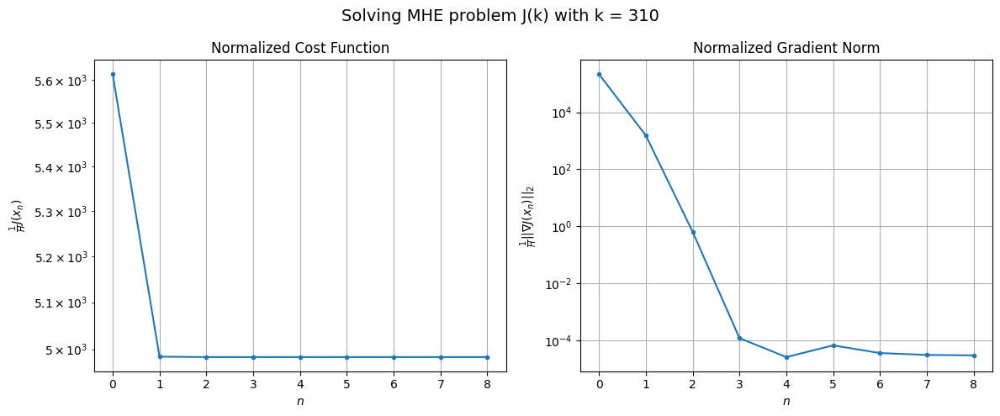

Windows:  78%|███████▊  | 292/376 [26:10<07:26,  5.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 118649.27495351955
Gradient norm: 4316025.371120095
Global estimation error: 67.87957962609624
Initial conditions estimation errors: 11.100086903476338 m, 18.74246542908703 m, 46.30103091978583 m, 44.6019565875626 m
Position estimation errors: 24.820757442836115 m, 38.81857334298545 m, 30.07043876654835 m, 57.52416735538504 m

[Gauss-Newton] Iteration 1
Cost function: 105692.85509471153 (-10.92%)
Gradient norm: 9613.485315413493 (-99.78%)
Global estimation error: 41.67764816813594 (-38.60%)
Initial conditions estimation errors: 16.472994111705543 m, 21.795785309506975 m, 14.055623256371888 m, 28.1603713536427 m
Position estimation errors: 18.181046916444394 m, 30.65947792370276 m, 50.01040791391086 m, 68.6983787275226 m

[Gauss-Newton] Iteration 2
Cost function: 105691.25420615874 (-0.00%)
Gradient norm: 0.6896894469470495 (-99.99%)
Global estimation error: 41.642692203153864 (-0.08%)
Initial conditions estimation errors: 16.4

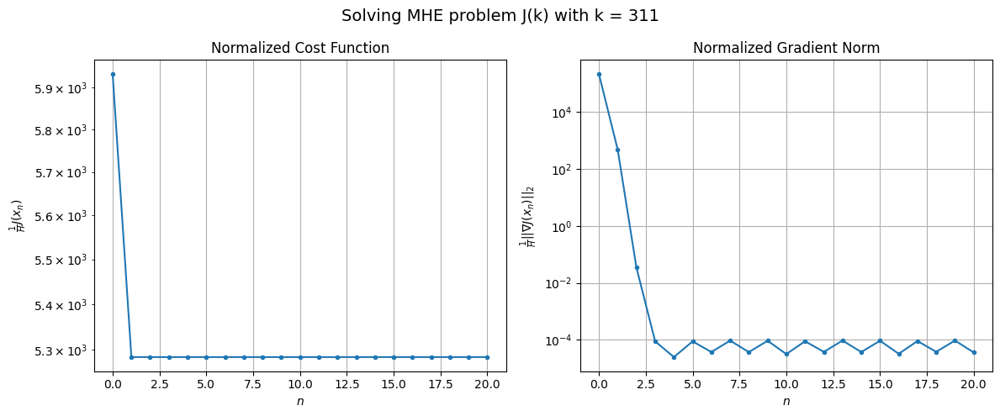

Windows:  78%|███████▊  | 293/376 [26:20<09:09,  6.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 121257.97074418231
Gradient norm: 4169252.6781658162
Global estimation error: 34.083552054359295
Initial conditions estimation errors: 11.603455659585602 m, 20.231322543826792 m, 10.98773805837639 m, 22.29286288482903 m
Position estimation errors: 24.248239646513646 m, 34.9182195804134 m, 52.54394198775375 m, 75.00865581787271 m

[Gauss-Newton] Iteration 1
Cost function: 108158.73722830818 (-10.80%)
Gradient norm: 5813.220967054586 (-99.86%)
Global estimation error: 47.244750970969385 (38.61%)
Initial conditions estimation errors: 17.165498298788343 m, 23.16804403032529 m, 21.596540090079984 m, 30.56475661998891 m
Position estimation errors: 17.69061691400363 m, 29.131174259022888 m, 17.61702436752897 m, 41.14890247091114 m

[Gauss-Newton] Iteration 2
Cost function: 108158.20122287302 (-0.00%)
Gradient norm: 2.2939528463212193 (-99.96%)
Global estimation error: 47.2216121706476 (-0.05%)
Initial conditions estimation errors: 17

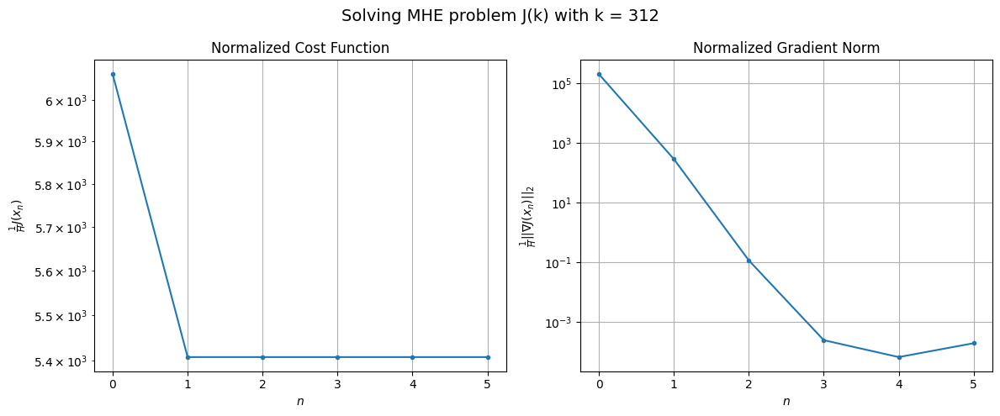

Windows:  78%|███████▊  | 294/376 [26:23<07:37,  5.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 120835.39207586877
Gradient norm: 4013021.325719195
Global estimation error: 37.77179710277006
Initial conditions estimation errors: 11.983250363825952 m, 17.675762994653088 m, 19.184977008587015 m, 24.5475150012398 m
Position estimation errors: 23.364870792237372 m, 33.9144494071105 m, 21.890667994304078 m, 44.368055795675424 m

[Gauss-Newton] Iteration 1
Cost function: 107936.67450546226 (-10.67%)
Gradient norm: 58493.5729627058 (-98.54%)
Global estimation error: 301.31698136699646 (697.73%)
Initial conditions estimation errors: 17.644662523204122 m, 105.83794598747274 m, 154.9256296796197 m, 235.11030345922728 m
Position estimation errors: 16.95737748341229 m, 102.86746336832316 m, 122.89741455801968 m, 290.2550176340131 m

[Gauss-Newton] Iteration 2
Cost function: 107859.31161129395 (-0.07%)
Gradient norm: 68.56911892340234 (-99.88%)
Global estimation error: 311.38058959802083 (3.34%)
Initial conditions estimation errors: 

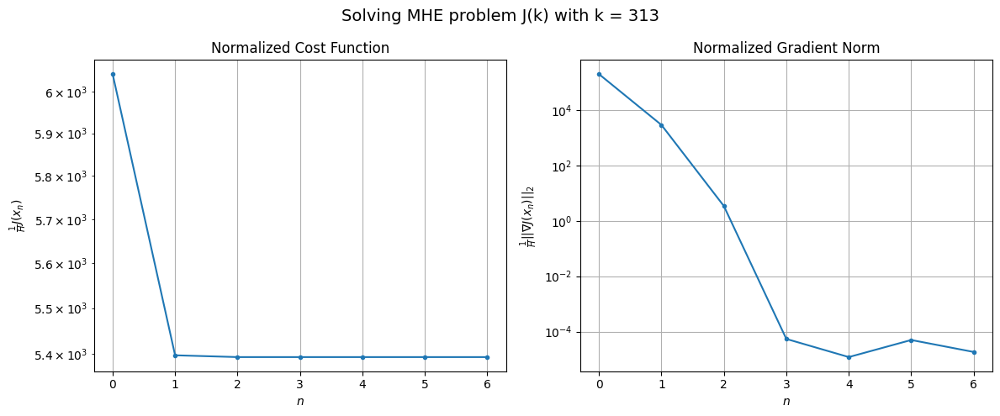

Windows:  78%|███████▊  | 295/376 [26:27<06:39,  4.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 116803.58254046483
Gradient norm: 3766246.751208461
Global estimation error: 325.2439016686289
Initial conditions estimation errors: 12.198564092000801 m, 112.48878719210654 m, 165.52542162353 m, 256.09041068846653 m
Position estimation errors: 22.24943793832126 m, 100.84562608142636 m, 120.57287401710228 m, 287.3064739069046 m

[Gauss-Newton] Iteration 1
Cost function: 104379.26262545354 (-10.64%)
Gradient norm: 2410.961394698143 (-99.94%)
Global estimation error: 236.57458457733688 (-27.26%)
Initial conditions estimation errors: 17.875107649567035 m, 85.36473917809356 m, 121.1729869250558 m, 183.5153486834236 m
Position estimation errors: 16.103694689890087 m, 87.56795735767041 m, 112.36924406766563 m, 244.29180177787504 m

[Gauss-Newton] Iteration 2
Cost function: 104378.99842413419 (-0.00%)
Gradient norm: 0.023768463814003066 (-100.00%)
Global estimation error: 237.1013989832485 (0.22%)
Initial conditions estimation errors

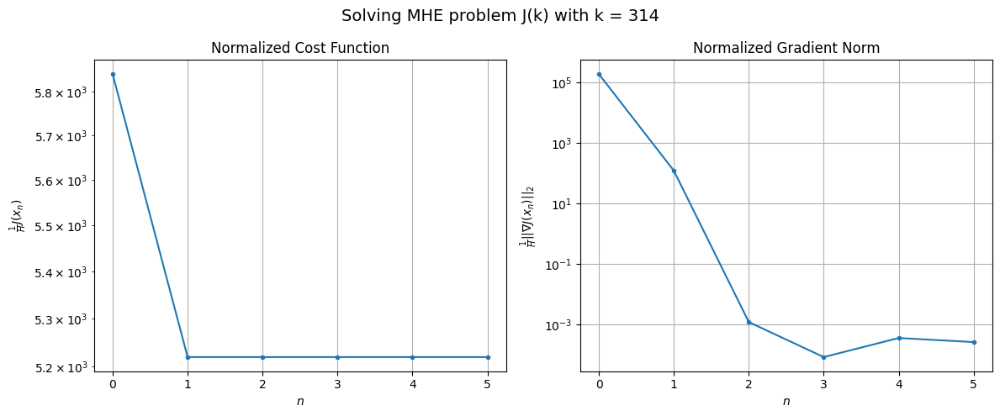

Windows:  79%|███████▊  | 296/376 [26:30<05:49,  4.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 110410.38367319574
Gradient norm: 3565851.886555192
Global estimation error: 248.43742168230915
Initial conditions estimation errors: 12.281432333302238 m, 87.56895031526939 m, 125.93268302471891 m, 195.0458219288344 m
Position estimation errors: 21.044472237938084 m, 83.95895604573813 m, 108.93872509321088 m, 235.36277062628452 m

[Gauss-Newton] Iteration 1
Cost function: 98356.00232396551 (-10.92%)
Gradient norm: 7696.932417948747 (-99.78%)
Global estimation error: 71.48560448017346 (-71.23%)
Initial conditions estimation errors: 17.98240134361399 m, 30.729273396397737 m, 42.709881984888604 m, 44.92558353888649 m
Position estimation errors: 15.101169505320673 m, 67.42192857473852 m, 92.12727936017669 m, 180.58160966519813 m

[Gauss-Newton] Iteration 2
Cost function: 98352.29244456887 (-0.00%)
Gradient norm: 0.6868900464000252 (-99.99%)
Global estimation error: 73.64350195641507 (3.02%)
Initial conditions estimation errors: 1

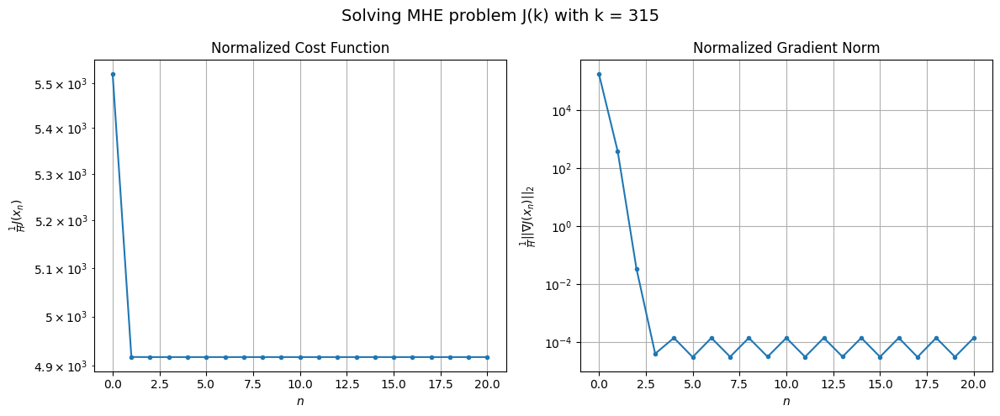

Windows:  79%|███████▉  | 297/376 [26:39<07:49,  5.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 101900.9297089229
Gradient norm: 3309657.9101632773
Global estimation error: 78.80790817596454
Initial conditions estimation errors: 12.3187831193528 m, 30.333795876507494 m, 45.97813941601748 m, 54.99746909733138 m
Position estimation errors: 19.71649681663492 m, 67.58964864190551 m, 93.6665084684615 m, 180.0481142753947 m

[Gauss-Newton] Iteration 1
Cost function: 90707.02614735388 (-10.99%)
Gradient norm: 4304.5888083624795 (-99.87%)
Global estimation error: 105.18601926382425 (33.47%)
Initial conditions estimation errors: 17.895758321847 m, 43.6676283764323 m, 70.31096203965306 m, 62.395431627178844 m
Position estimation errors: 14.08126037989156 m, 98.19042634792672 m, 132.43411979996037 m, 272.3646445956498 m

[Gauss-Newton] Iteration 2
Cost function: 90706.73821895114 (-0.00%)
Gradient norm: 1.602727452485897 (-99.96%)
Global estimation error: 103.2762151050294 (-1.82%)
Initial conditions estimation errors: 17.895758781

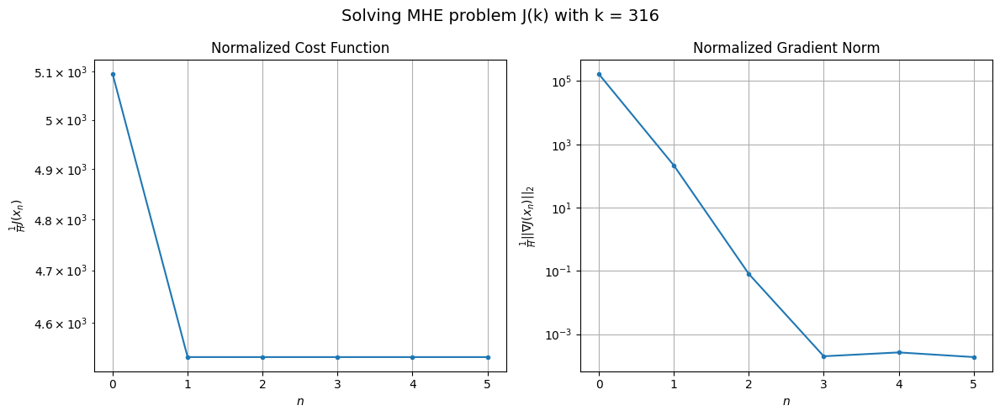

Windows:  79%|███████▉  | 298/376 [26:42<06:36,  5.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 91707.37353527371
Gradient norm: 3048060.4715791107
Global estimation error: 116.3434160484617
Initial conditions estimation errors: 12.190145226561148 m, 44.99022398906103 m, 74.44662415311124 m, 76.2930241337428 m
Position estimation errors: 18.387912429819888 m, 97.33172889711187 m, 132.74733615604052 m, 271.4006595016179 m

[Gauss-Newton] Iteration 1
Cost function: 81366.84161130487 (-11.28%)
Gradient norm: 7983.576023115975 (-99.74%)
Global estimation error: 41.61104230165921 (-64.23%)
Initial conditions estimation errors: 17.63861346590328 m, 19.574613709019772 m, 26.214521847878572 m, 18.705225443422524 m
Position estimation errors: 13.071252214462268 m, 61.614159355322975 m, 97.49437502540349 m, 174.8191132077315 m

[Gauss-Newton] Iteration 2
Cost function: 81365.19554030288 (-0.00%)
Gradient norm: 9.477810784986746 (-99.88%)
Global estimation error: 41.131742310344556 (-1.15%)
Initial conditions estimation errors: 17.

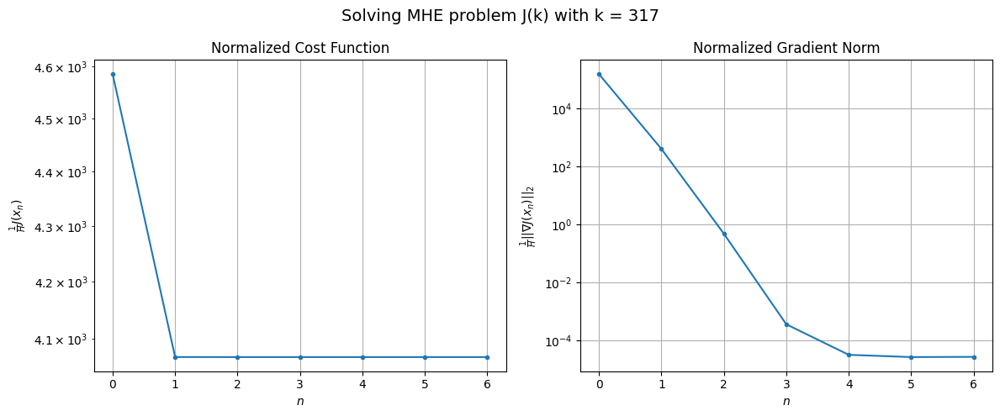

Windows:  80%|███████▉  | 299/376 [26:46<05:55,  4.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 80448.15830787132
Gradient norm: 2790645.357255998
Global estimation error: 32.23043201651312
Initial conditions estimation errors: 11.897337972303092 m, 15.004367941231447 m, 23.50863695259526 m, 10.925539187928612 m
Position estimation errors: 17.04616739061337 m, 63.599465320620375 m, 102.31997260976303 m, 180.50209456842697 m

[Gauss-Newton] Iteration 1
Cost function: 70944.96371086549 (-11.81%)
Gradient norm: 3106.8315574965372 (-99.89%)
Global estimation error: 46.11655932000875 (43.08%)
Initial conditions estimation errors: 17.18263787642676 m, 19.58379216660221 m, 24.807798282342524 m, 28.852471973600494 m
Position estimation errors: 12.03073822411943 m, 37.98222345456802 m, 63.0066942736446 m, 120.81826041926885 m

[Gauss-Newton] Iteration 2
Cost function: 70944.78578530156 (-0.00%)
Gradient norm: 0.3757049605402666 (-99.99%)
Global estimation error: 45.130260965990466 (-2.14%)
Initial conditions estimation errors: 17

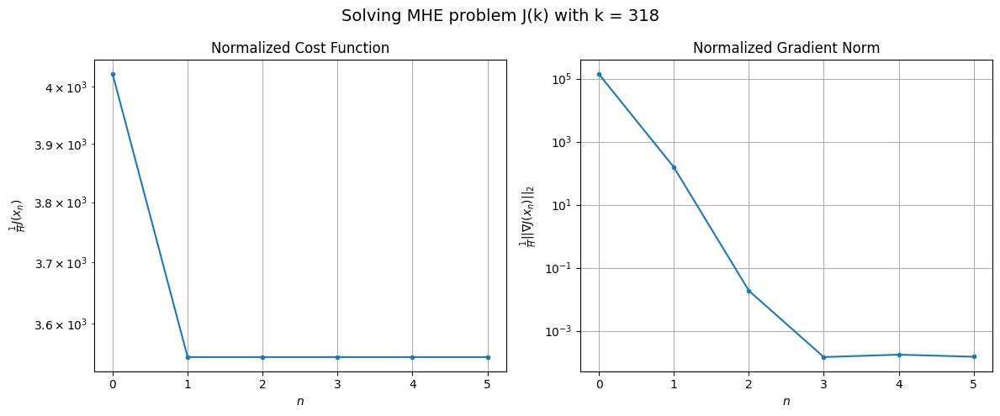

Windows:  80%|███████▉  | 300/376 [26:49<05:15,  4.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 68598.30094548872
Gradient norm: 2534170.5840837145
Global estimation error: 29.537052215836212
Initial conditions estimation errors: 11.433272708650392 m, 13.078416543269967 m, 16.69630688307934 m, 17.08319501499989 m
Position estimation errors: 15.626167183410825 m, 39.447896921702885 m, 67.35638108120192 m, 124.0471795820137 m

[Gauss-Newton] Iteration 1
Cost function: 60240.24749699343 (-12.18%)
Gradient norm: 63331.016402844085 (-97.50%)
Global estimation error: 341.6816979493095 (1056.79%)
Initial conditions estimation errors: 16.45597539689882 m, 119.52354104163047 m, 147.94294672422157 m, 283.3770273308049 m
Position estimation errors: 10.964788024818063 m, 44.008743089484284 m, 31.043625189653717 m, 166.80616329439513 m

[Gauss-Newton] Iteration 2
Cost function: 60144.966228081976 (-0.16%)
Gradient norm: 64.5564342916986 (-99.90%)
Global estimation error: 329.5220447407135 (-3.56%)
Initial conditions estimation errors

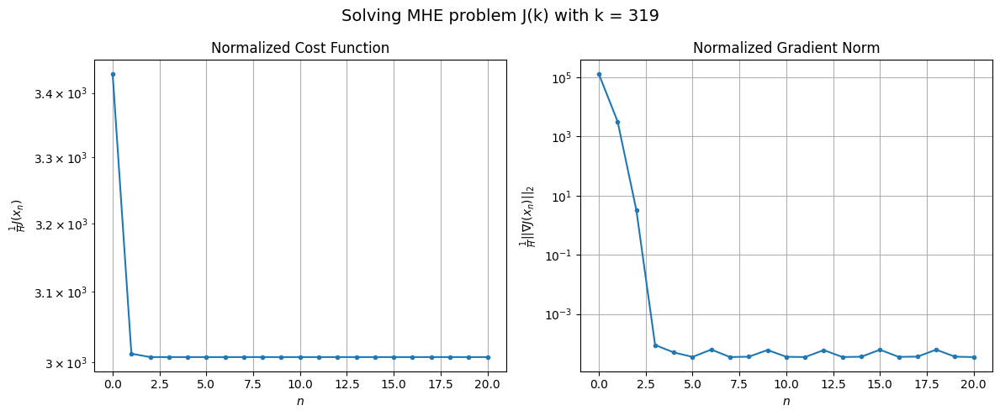

Windows:  80%|████████  | 301/376 [26:59<07:11,  5.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 56607.88139081957
Gradient norm: 2274656.824259636
Global estimation error: 331.3449629685184
Initial conditions estimation errors: 10.755701472117288 m, 114.63740429583017 m, 141.0573924692145 m, 276.82997896930885 m
Position estimation errors: 14.135852647658286 m, 36.42714973169585 m, 20.44206956220495 m, 143.97653569953678 m

[Gauss-Newton] Iteration 1
Cost function: 49104.463428266376 (-13.26%)
Gradient norm: 14939.461906262928 (-99.34%)
Global estimation error: 408.8021599302838 (23.38%)
Initial conditions estimation errors: 15.51759577221247 m, 141.29535423211917 m, 172.39567603656633 m, 342.33560158992555 m
Position estimation errors: 9.792969473127394 m, 89.47029628068519 m, 72.0176170383177 m, 321.2998457360083 m

[Gauss-Newton] Iteration 2
Cost function: 49100.94252648273 (-0.01%)
Gradient norm: 0.11528143888240298 (-100.00%)
Global estimation error: 408.4251284413174 (-0.09%)
Initial conditions estimation errors: 1

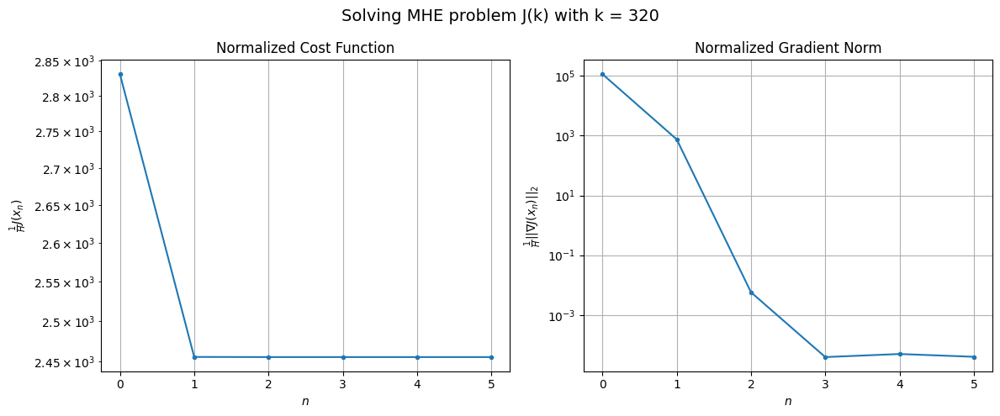

Windows:  80%|████████  | 302/376 [27:02<06:07,  4.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 44845.4993738615
Gradient norm: 1953272.1366901086
Global estimation error: 420.3953358623292
Initial conditions estimation errors: 9.944357986835968 m, 142.9139734615753 m, 173.32880094730243 m, 355.1985271240756 m
Position estimation errors: 12.481127758463826 m, 82.84879024923987 m, 60.807027956735176 m, 305.82782826764173 m

[Gauss-Newton] Iteration 1
Cost function: 38598.95788532597 (-13.93%)
Gradient norm: 735.7418954105476 (-99.96%)
Global estimation error: 338.9528412348547 (-19.37%)
Initial conditions estimation errors: 14.308085053467288 m, 119.62287712253887 m, 152.29963711723462 m, 277.8117440669163 m
Position estimation errors: 8.580382125009047 m, 100.95523612665072 m, 85.74839190632092 m, 353.9441391602676 m

[Gauss-Newton] Iteration 2
Cost function: 38598.90635059213 (-0.00%)
Gradient norm: 2.3065072518448066 (-99.69%)
Global estimation error: 339.1734720957867 (0.07%)
Initial conditions estimation errors: 14.3

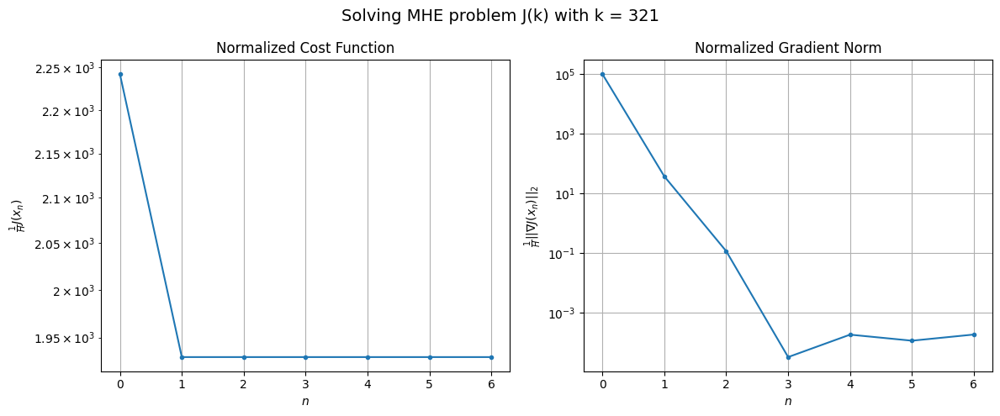

Windows:  81%|████████  | 303/376 [27:05<05:36,  4.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 34421.08313477542
Gradient norm: 1639357.3725261167
Global estimation error: 355.2066428939918
Initial conditions estimation errors: 8.964736168816671 m, 122.64168627346926 m, 155.59290000716422 m, 294.68822805373304 m
Position estimation errors: 10.720040207947111 m, 96.41785176829869 m, 76.57161187248244 m, 345.3730772392511 m

[Gauss-Newton] Iteration 1
Cost function: 29502.732736858885 (-14.29%)
Gradient norm: 39178.30021246127 (-97.61%)
Global estimation error: 109.76082857076837 (-69.10%)
Initial conditions estimation errors: 12.851388856634555 m, 45.260049985201434 m, 58.07867209968585 m, 80.37809771644913 m
Position estimation errors: 7.291092283848895 m, 30.190190460189662 m, 19.70764936574603 m, 96.94914376572456 m

[Gauss-Newton] Iteration 2
Cost function: 29467.57205466821 (-0.12%)
Gradient norm: 81.28717810876212 (-99.79%)
Global estimation error: 97.77806977380207 (-10.92%)
Initial conditions estimation errors: 1

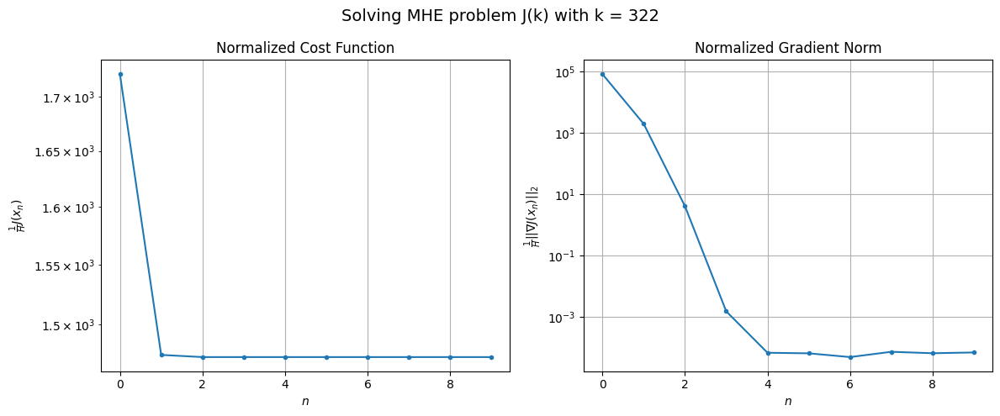

Windows:  81%|████████  | 304/376 [27:10<05:34,  4.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25217.077563867104
Gradient norm: 1295511.9947429143
Global estimation error: 98.6472653673611
Initial conditions estimation errors: 7.864366123165822 m, 40.49458909678335 m, 54.04254736081338 m, 71.4772640454844 m
Position estimation errors: 8.830015307009097 m, 25.986147551501407 m, 12.835687495709852 m, 84.50862401951105 m

[Gauss-Newton] Iteration 1
Cost function: 21560.428389822577 (-14.50%)
Gradient norm: 5318.93844214834 (-99.59%)
Global estimation error: 34.443915807316735 (-65.08%)
Initial conditions estimation errors: 11.226549874708835 m, 20.692347628531845 m, 21.098800938747722 m, 13.674181853558707 m
Position estimation errors: 5.981977453018931 m, 4.0596217695723915 m, 3.9530747932946046 m, 18.65617061755534 m

[Gauss-Newton] Iteration 2
Cost function: 21559.847086756006 (-0.00%)
Gradient norm: 2.638064808734415 (-99.95%)
Global estimation error: 33.58301325277409 (-2.50%)
Initial conditions estimation errors: 11

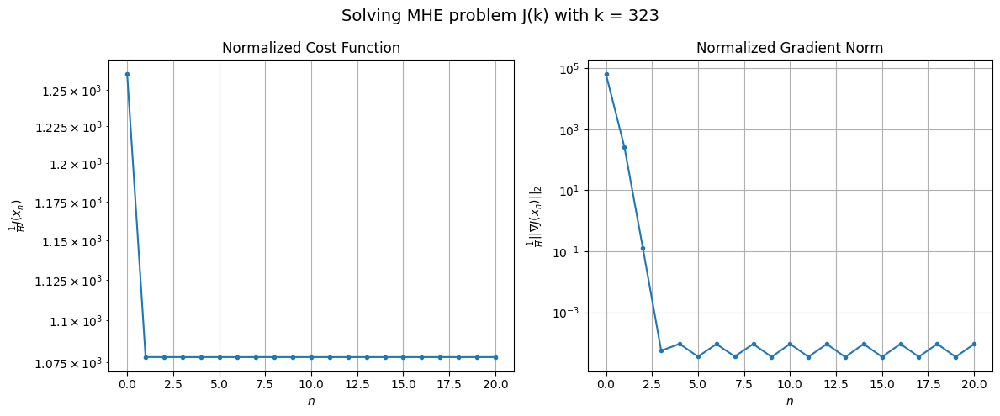

Windows:  81%|████████  | 305/376 [27:20<07:14,  6.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 17515.660932789106
Gradient norm: 957765.0978532279
Global estimation error: 29.061948419035808
Initial conditions estimation errors: 6.701313420351667 m, 17.011317632771753 m, 20.410170789782754 m, 9.680207456055076 m
Position estimation errors: 6.929270390334461 m, 5.090423361894843 m, 6.35953084693848 m, 20.304863139711927 m

[Gauss-Newton] Iteration 1
Cost function: 14927.343712353108 (-14.78%)
Gradient norm: 13641.21928684891 (-98.58%)
Global estimation error: 141.64287379615817 (387.38%)
Initial conditions estimation errors: 9.563592916127813 m, 27.65447450507497 m, 41.74118152618359 m, 132.15176055456274 m
Position estimation errors: 4.64228879799362 m, 49.89706402526987 m, 41.50177046900114 m, 164.22305326412862 m

[Gauss-Newton] Iteration 2
Cost function: 14923.04130534691 (-0.03%)
Gradient norm: 10.567934985408197 (-99.92%)
Global estimation error: 147.0576074610097 (3.82%)
Initial conditions estimation errors: 9.563

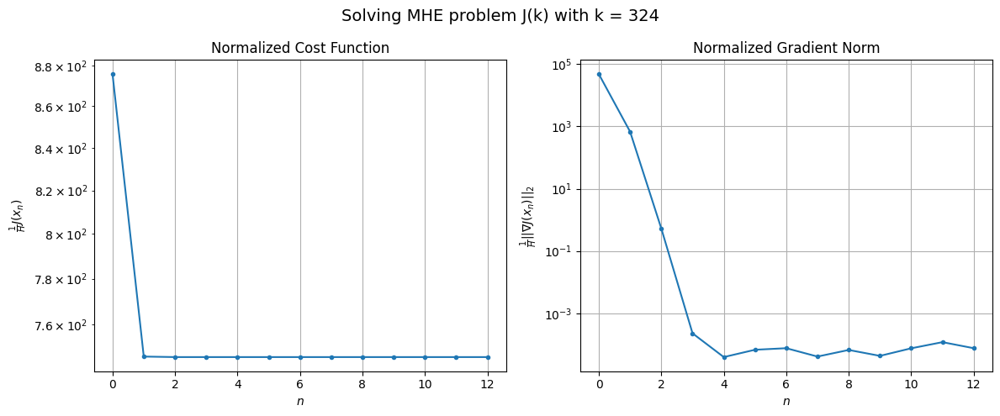

Windows:  81%|████████▏ | 306/376 [27:26<07:07,  6.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11751.827623772062
Gradient norm: 679124.6928517595
Global estimation error: 156.3631257244069
Initial conditions estimation errors: 5.572404111685876 m, 32.74191580830119 m, 43.5435650361843 m, 146.4590550916761 m
Position estimation errors: 5.060816653008084 m, 49.09880270586497 m, 40.79529465985356 m, 160.91382965800145 m

[Gauss-Newton] Iteration 1
Cost function: 10029.41157731123 (-14.66%)
Gradient norm: 6284.521069834599 (-99.07%)
Global estimation error: 225.57167083042455 (44.26%)
Initial conditions estimation errors: 7.923951678389197 m, 51.65505629236621 m, 65.37441845626182 m, 209.46987311023818 m
Position estimation errors: 3.284579330186035 m, 78.82255976026372 m, 63.85908691957372 m, 278.87822228463546 m

[Gauss-Newton] Iteration 2
Cost function: 10028.73508646297 (-0.01%)
Gradient norm: 0.2899946947236339 (-100.00%)
Global estimation error: 224.95515914544268 (-0.27%)
Initial conditions estimation errors: 7.9239

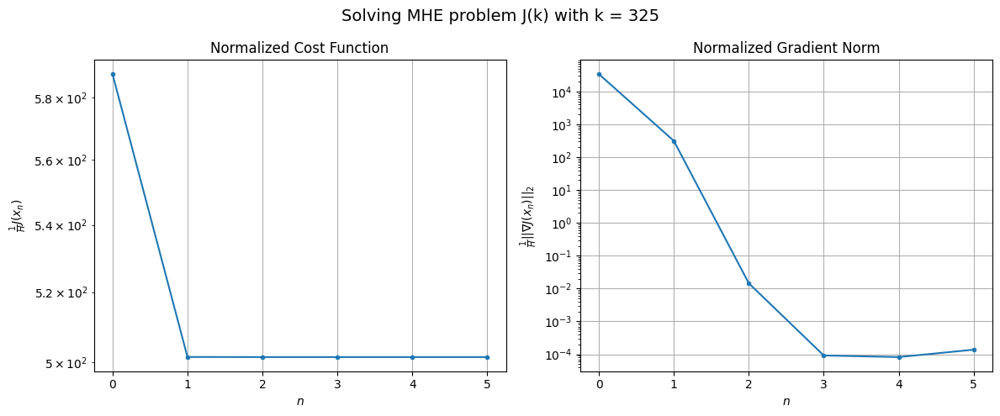

Windows:  82%|████████▏ | 307/376 [27:29<06:06,  5.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7474.75578951328
Gradient norm: 393078.1544356579
Global estimation error: 240.78831932538031
Initial conditions estimation errors: 4.497506521304305 m, 56.86726673973535 m, 66.20595643697322 m, 224.36931093555668 m
Position estimation errors: 3.2695031020249363 m, 76.12410834245323 m, 61.064697526648736 m, 268.65844258681204 m

[Gauss-Newton] Iteration 1
Cost function: 6512.089569179248 (-12.88%)
Gradient norm: 44400.61767483748 (-88.70%)
Global estimation error: 556.9883443964245 (131.32%)
Initial conditions estimation errors: 6.336462876867689 m, 152.41903195629288 m, 181.9424135433092 m, 503.8462463560587 m
Position estimation errors: 2.074128319691793 m, 143.811990484728 m, 117.51785544800454 m, 510.9071823018001 m

[Gauss-Newton] Iteration 2
Cost function: 6456.378434361565 (-0.86%)
Gradient norm: 14.290231372948417 (-99.97%)
Global estimation error: 561.6291371653281 (0.83%)
Initial conditions estimation errors: 6.33646

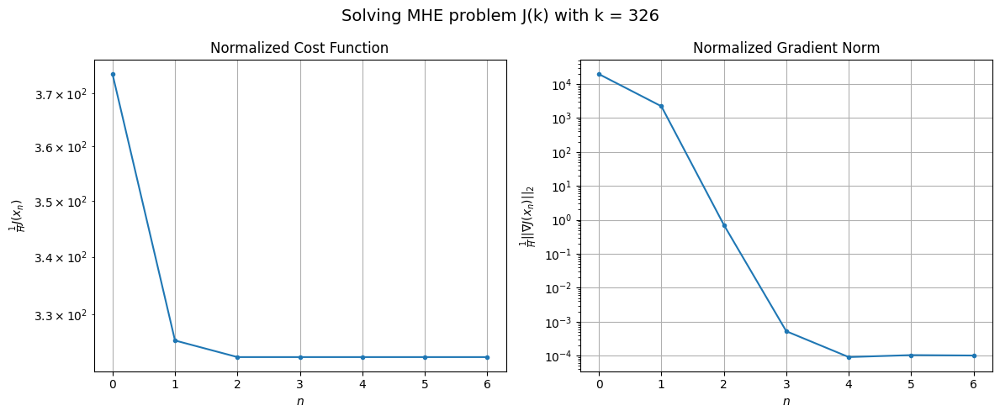

Windows:  82%|████████▏ | 308/376 [27:33<05:29,  4.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4671.932859151068
Gradient norm: 204247.40339683503
Global estimation error: 586.7644213496868
Initial conditions estimation errors: 3.484422798089658 m, 161.4443078147806 m, 185.59242218713945 m, 532.701935215783 m
Position estimation errors: 1.8065586717542004 m, 136.76573908140765 m, 108.60020978342502 m, 490.28269094846496 m

[Gauss-Newton] Iteration 1
Cost function: 4117.154773591369 (-11.87%)
Gradient norm: 4630.512822445315 (-97.73%)
Global estimation error: 670.2262508322611 (14.22%)
Initial conditions estimation errors: 4.863303099174048 m, 182.0134683452705 m, 205.51304431537673 m, 611.4039640861799 m
Position estimation errors: 1.1742841158909227 m, 161.6036146271236 m, 129.95000554853218 m, 579.6224977438636 m

[Gauss-Newton] Iteration 2
Cost function: 4116.695220884635 (-0.01%)
Gradient norm: 0.3670952431666822 (-99.99%)
Global estimation error: 669.4938341612897 (-0.11%)
Initial conditions estimation errors: 4.86

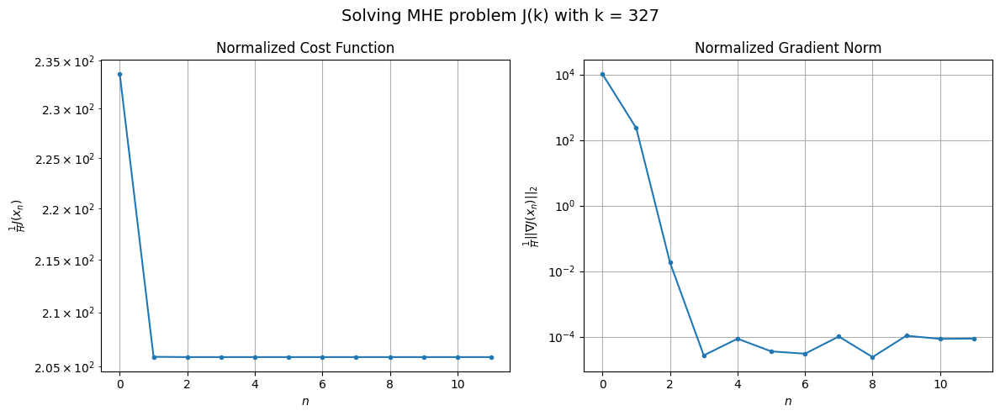

Windows:  82%|████████▏ | 309/376 [27:39<05:40,  5.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3020.9012707514703
Gradient norm: 137319.20142212635
Global estimation error: 696.7942497460027
Initial conditions estimation errors: 2.58750779907232 m, 189.8322244769028 m, 207.92528235970113 m, 637.3744069944473 m
Position estimation errors: 1.285161014603377 m, 151.61457648443226 m, 118.3290943023836 m, 547.6938281624899 m

[Gauss-Newton] Iteration 1
Cost function: 2771.7437069385437 (-8.25%)
Gradient norm: 27237.400266446 (-80.16%)
Global estimation error: 441.96176776222694 (-36.57%)
Initial conditions estimation errors: 3.537087593927046 m, 122.69571731027261 m, 150.60960531005145 m, 396.9636076627438 m
Position estimation errors: 1.2164859131142323 m, 104.03172203118724 m, 76.32914884250219 m, 352.6470785020684 m

[Gauss-Newton] Iteration 2
Cost function: 2751.342121046807 (-0.74%)
Gradient norm: 1.1029072707547918 (-100.00%)
Global estimation error: 442.7884382227238 (0.19%)
Initial conditions estimation errors: 3.537

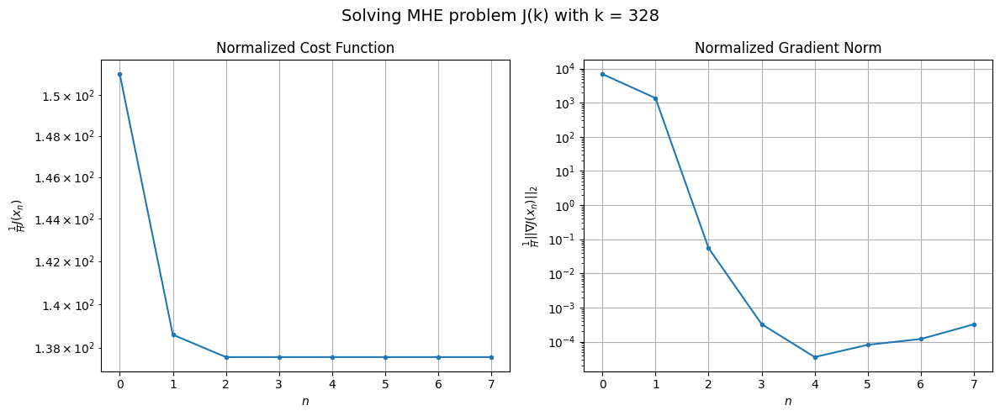

Windows:  82%|████████▏ | 310/376 [27:43<05:19,  4.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2319.9092645762394
Gradient norm: 263713.314627047
Global estimation error: 458.8684641257181
Initial conditions estimation errors: 1.8283359586699675 m, 128.07780128163867 m, 151.36846005633433 m, 413.8121772789959 m
Position estimation errors: 2.078028608312333 m, 97.81765372110402 m, 67.89918779983469 m, 333.5580730459177 m

[Gauss-Newton] Iteration 1
Cost function: 2262.5937567995293 (-2.47%)
Gradient norm: 52817.354449963204 (-79.97%)
Global estimation error: 78.84910492944284 (-82.82%)
Initial conditions estimation errors: 2.4163180483572333 m, 24.00533749529349 m, 37.231716868294896 m, 65.18340864415629 m
Position estimation errors: 1.8816373492845886 m, 31.004783809534384 m, 26.09893747610129 m, 68.4245587936211 m

[Gauss-Newton] Iteration 2
Cost function: 2175.533852758988 (-3.85%)
Gradient norm: 111.74248008536014 (-99.79%)
Global estimation error: 59.14738346510829 (-24.99%)
Initial conditions estimation errors: 2.4

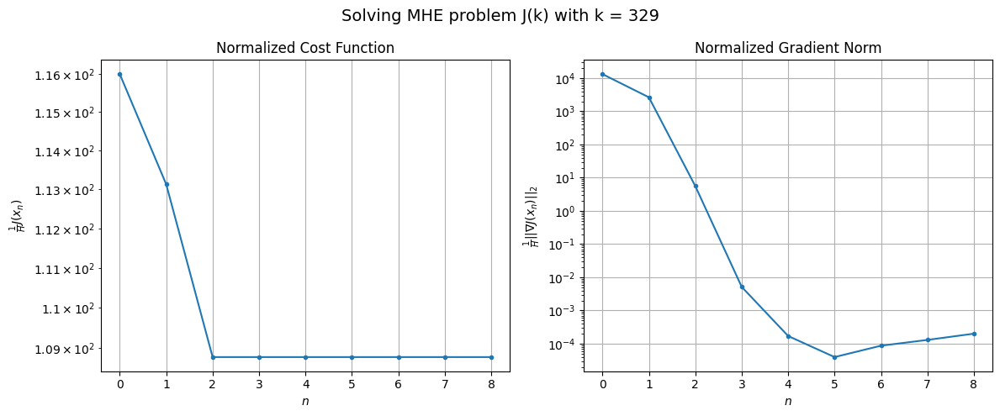

Windows:  83%|████████▎ | 311/376 [27:48<05:14,  4.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2399.1706469461765
Gradient norm: 390898.7197058166
Global estimation error: 62.10291283181225
Initial conditions estimation errors: 1.2083805772958638 m, 20.397817882143684 m, 31.530029344403182 m, 49.44787550301597 m
Position estimation errors: 3.052606983856708 m, 27.537358728233226 m, 23.059136773264463 m, 54.96628480645905 m

[Gauss-Newton] Iteration 1
Cost function: 2286.0295897254437 (-4.72%)
Gradient norm: 8000.283840863856 (-97.95%)
Global estimation error: 179.86073218692445 (189.62%)
Initial conditions estimation errors: 1.4728106713143903 m, 49.98863142619355 m, 32.813806198416984 m, 169.62338472656305 m
Position estimation errors: 2.567572855256681 m, 27.69247173005335 m, 28.25482727197481 m, 6.231803373854723 m

[Gauss-Newton] Iteration 2
Cost function: 2280.855016004318 (-0.23%)
Gradient norm: 169.58414728737418 (-97.88%)
Global estimation error: 152.8049095408571 (-15.04%)
Initial conditions estimation errors: 

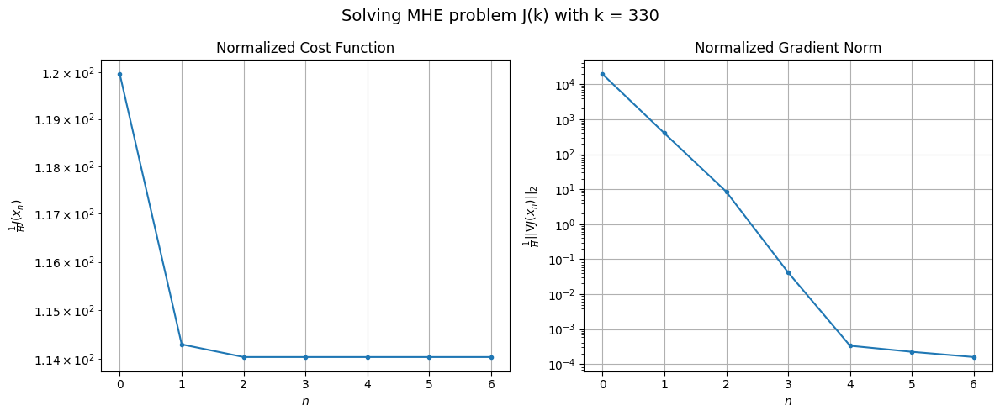

Windows:  83%|████████▎ | 312/376 [27:52<04:50,  4.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2946.7982450582276
Gradient norm: 437283.68315884296
Global estimation error: 148.51283304030426
Initial conditions estimation errors: 0.6533486059608455 m, 39.46225337406765 m, 23.80217825443947 m, 141.18005630277312 m
Position estimation errors: 3.892808057400918 m, 32.91604187247522 m, 31.689627229148755 m, 25.902996800731124 m

[Gauss-Newton] Iteration 1
Cost function: 2809.012309650938 (-4.68%)
Gradient norm: 8416.114545840986 (-98.08%)
Global estimation error: 198.79662453302194 (33.86%)
Initial conditions estimation errors: 0.6926413318590504 m, 53.90914741198121 m, 41.191196009700036 m, 186.86011143394143 m
Position estimation errors: 3.2299817773940185 m, 7.671428646085397 m, 5.592269006384255 m, 124.50354006861556 m

[Gauss-Newton] Iteration 2
Cost function: 2807.9270220170206 (-0.04%)
Gradient norm: 102.93828640181327 (-98.78%)
Global estimation error: 217.20164331445963 (9.26%)
Initial conditions estimation errors:

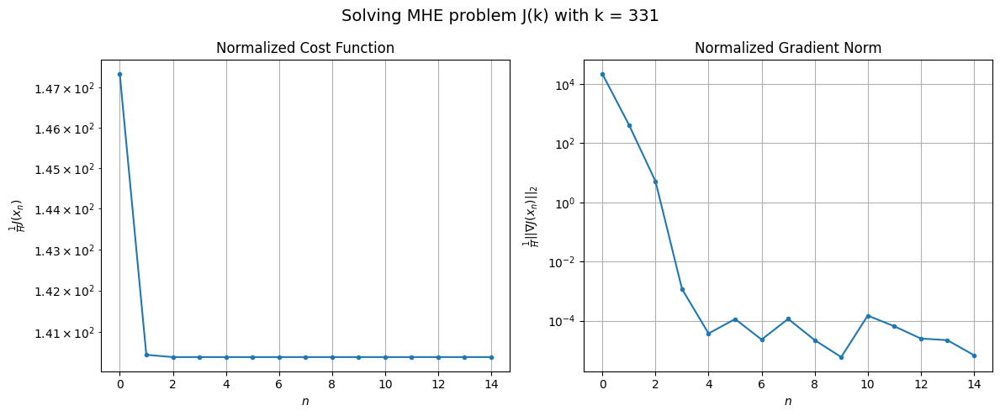

Windows:  83%|████████▎ | 313/376 [27:58<05:30,  5.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3862.384201122989
Gradient norm: 476536.8273135254
Global estimation error: 221.02349459682816
Initial conditions estimation errors: 0.24129437939026688 m, 57.97600699142865 m, 45.47918092184744 m, 208.37885736931054 m
Position estimation errors: 4.667991661370825 m, 7.248417938880339 m, 5.059779644712869 m, 125.1628893290129 m

[Gauss-Newton] Iteration 1
Cost function: 4036.2502496476473 (4.50%)
Gradient norm: 92340.19428235499 (-80.62%)
Global estimation error: 844.05247095284 (281.88%)
Initial conditions estimation errors: 0.34757922754580395 m, 226.13042817551917 m, 200.02957394255466 m, 788.2116505177569 m
Position estimation errors: 3.8542403904314573 m, 63.68693055145427 m, 36.90757872536246 m, 424.5976965187007 m

[Gauss-Newton] Iteration 2
Cost function: 3666.6751932756956 (-9.16%)
Gradient norm: 3007.967000853223 (-96.74%)
Global estimation error: 754.7240770772363 (-10.58%)
Initial conditions estimation errors: 0.34

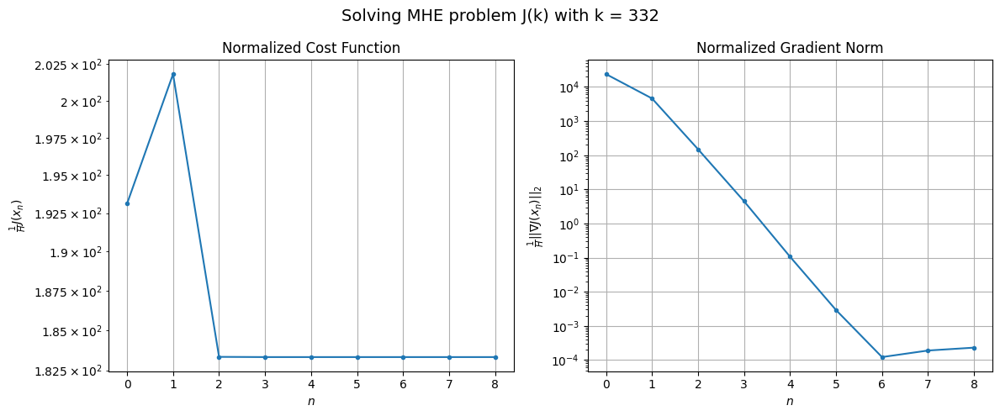

Windows:  84%|████████▎ | 314/376 [28:03<05:15,  5.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5097.376220253039
Gradient norm: 509373.13797963585
Global estimation error: 776.3915648254391
Initial conditions estimation errors: 0.6212671223265527 m, 205.4484205455478 m, 179.47612446216928 m, 726.8856335609644 m
Position estimation errors: 5.4000631401279815 m, 38.40588669120154 m, 18.172930765044633 m, 325.26842528552737 m

[Gauss-Newton] Iteration 1
Cost function: 4873.389215641564 (-4.39%)
Gradient norm: 52924.57039284137 (-89.61%)
Global estimation error: 1034.4591568635005 (33.24%)
Initial conditions estimation errors: 0.9915943563747162 m, 265.3149808377399 m, 237.62776923750013 m, 971.2083132880098 m
Position estimation errors: 4.414830715925663 m, 124.43512651139382 m, 70.97082144765207 m, 663.3568770727362 m

[Gauss-Newton] Iteration 2
Cost function: 4819.326658127374 (-1.11%)
Gradient norm: 361.499496104445 (-99.32%)
Global estimation error: 1001.5690548843972 (-3.18%)
Initial conditions estimation errors: 0.99

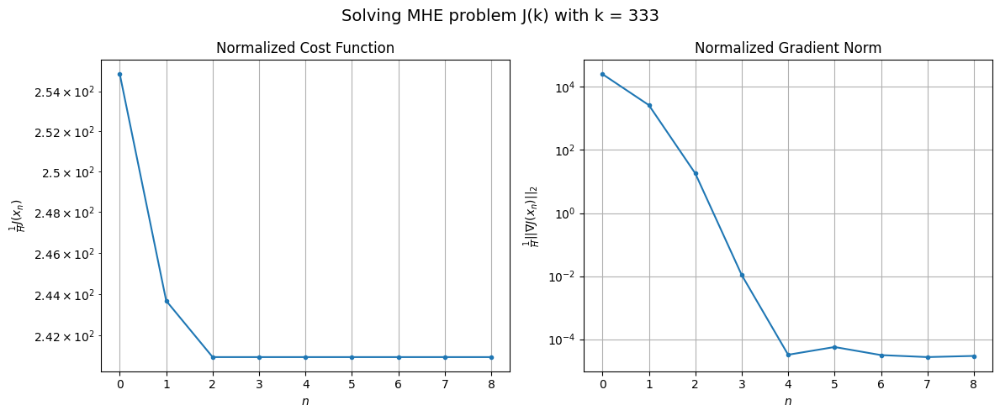

Windows:  84%|████████▍ | 315/376 [28:08<04:56,  4.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6694.681170201035
Gradient norm: 570967.2358704377
Global estimation error: 1022.9672017293482
Initial conditions estimation errors: 1.2831275737873595 m, 259.2513158531092 m, 229.09250557539826 m, 962.6866111641629 m
Position estimation errors: 6.109299404621383 m, 104.7463373390874 m, 53.66656833242997 m, 589.9382533775731 m

[Gauss-Newton] Iteration 1
Cost function: 6331.122208973536 (-5.43%)
Gradient norm: 24829.12289254031 (-95.65%)
Global estimation error: 695.2590084014065 (-32.04%)
Initial conditions estimation errors: 1.8624385955310534 m, 179.11040352723384 m, 162.53623524695334 m, 651.8304862611578 m
Position estimation errors: 4.9673461610398135 m, 70.52543442510382 m, 32.53814437037159 m, 434.24412609141615 m

[Gauss-Newton] Iteration 2
Cost function: 6304.576207036873 (-0.42%)
Gradient norm: 61.75965857738302 (-99.75%)
Global estimation error: 682.7044136336415 (-1.81%)
Initial conditions estimation errors: 1.862

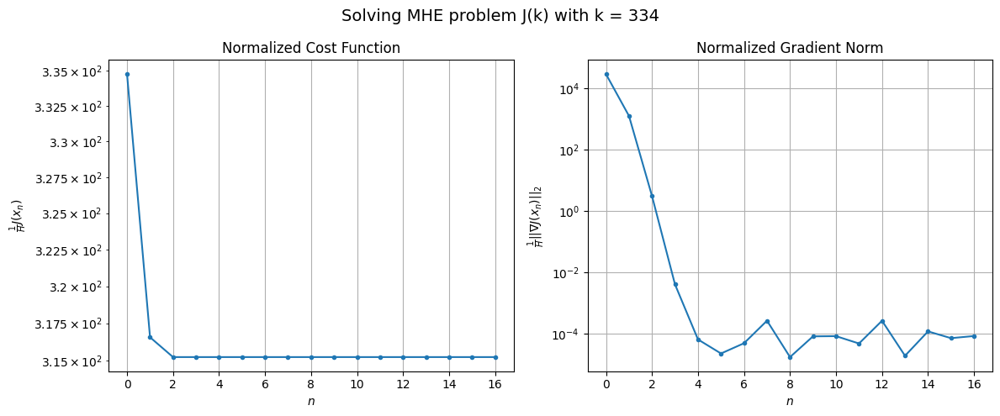

Windows:  84%|████████▍ | 316/376 [28:15<05:46,  5.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8614.437389503448
Gradient norm: 653559.2206192947
Global estimation error: 694.8532278110816
Initial conditions estimation errors: 2.0078022962520365 m, 176.29272910466716 m, 158.001543400907 m, 653.2788953721928 m
Position estimation errors: 6.897649859980972 m, 58.551328862600066 m, 20.89930809266969 m, 389.3453983802881 m

[Gauss-Newton] Iteration 1
Cost function: 8060.710149080569 (-6.43%)
Gradient norm: 6925.80641006181 (-98.94%)
Global estimation error: 795.4604714503325 (14.48%)
Initial conditions estimation errors: 2.795395813423997 m, 198.7378678001088 m, 171.36701280158425 m, 750.9234672017852 m
Position estimation errors: 5.580006901021182 m, 87.80675654438527 m, 44.585726942204836 m, 507.13452082295635 m

[Gauss-Newton] Iteration 2
Cost function: 8059.755423781147 (-0.01%)
Gradient norm: 19.28744638803509 (-99.72%)
Global estimation error: 788.0612036547651 (-0.93%)
Initial conditions estimation errors: 2.79539582

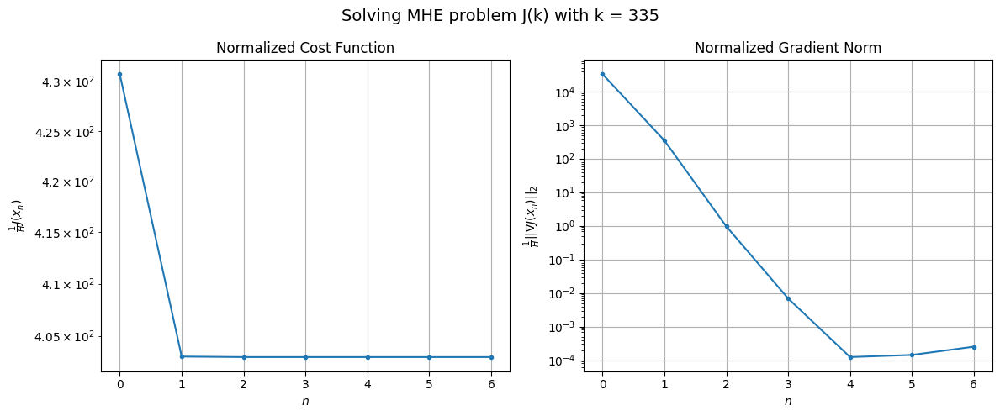

Windows:  84%|████████▍ | 317/376 [28:19<05:09,  5.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10725.43167858814
Gradient norm: 783710.8466903995
Global estimation error: 804.4949248628793
Initial conditions estimation errors: 2.7212889106619733 m, 198.1240571115336 m, 168.77775808145338 m, 761.2263378614967 m
Position estimation errors: 7.827693049766814 m, 76.18916841010568 m, 33.161384835617476 m, 461.77549256253945 m

[Gauss-Newton] Iteration 1
Cost function: 12959.475098285355 (20.83%)
Gradient norm: 343171.9631257675 (-56.21%)
Global estimation error: 86.4182585296656 (-89.26%)
Initial conditions estimation errors: 3.6780446703093954 m, 18.967994306416152 m, 20.47162854557735 m, 81.70416993625504 m
Position estimation errors: 6.354473232923004 m, 102.59801587744262 m, 73.4716466592861 m, 318.1481178029073 m

[Gauss-Newton] Iteration 2
Cost function: 10005.788468688757 (-22.79%)
Gradient norm: 4029.002014598647 (-98.83%)
Global estimation error: 151.34808433005253 (75.13%)
Initial conditions estimation errors: 3.67

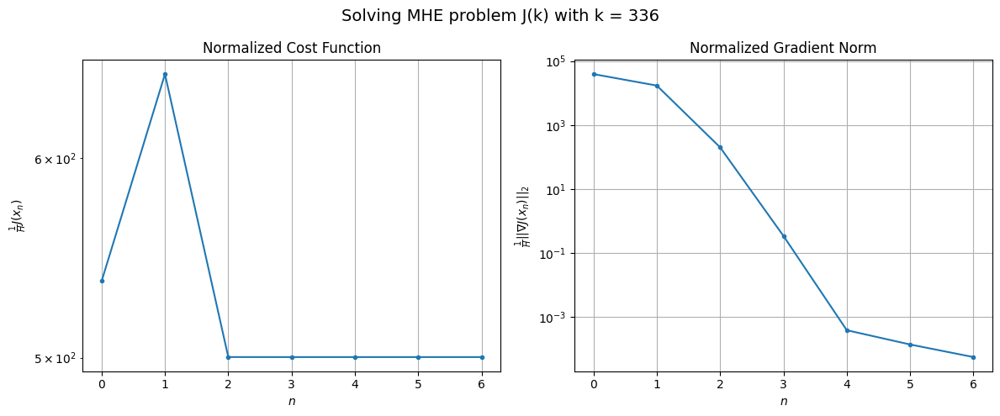

Windows:  85%|████████▍ | 318/376 [28:23<04:34,  4.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13262.770718472191
Gradient norm: 965899.799649053
Global estimation error: 181.33734844216403
Initial conditions estimation errors: 3.3472040192287404 m, 43.32154607455978 m, 35.564172331750484 m, 172.42463113078534 m
Position estimation errors: 8.942882965197516 m, 125.21636692102612 m, 92.41881017774661 m, 412.93686047597856 m

[Gauss-Newton] Iteration 1
Cost function: 17590.91858967271 (32.63%)
Gradient norm: 465914.8851426616 (-51.76%)
Global estimation error: 826.7545174522269 (355.92%)
Initial conditions estimation errors: 4.476039408259621 m, 191.2935273366619 m, 165.03988742088853 m, 787.1921783052686 m
Position estimation errors: 7.273661285570669 m, 104.05073495305325 m, 41.50585504260037 m, 509.1043490975118 m

[Gauss-Newton] Iteration 2
Cost function: 12317.029671673712 (-29.98%)
Gradient norm: 1482.8839675899771 (-99.68%)
Global estimation error: 936.9592891491122 (13.33%)
Initial conditions estimation errors: 4.

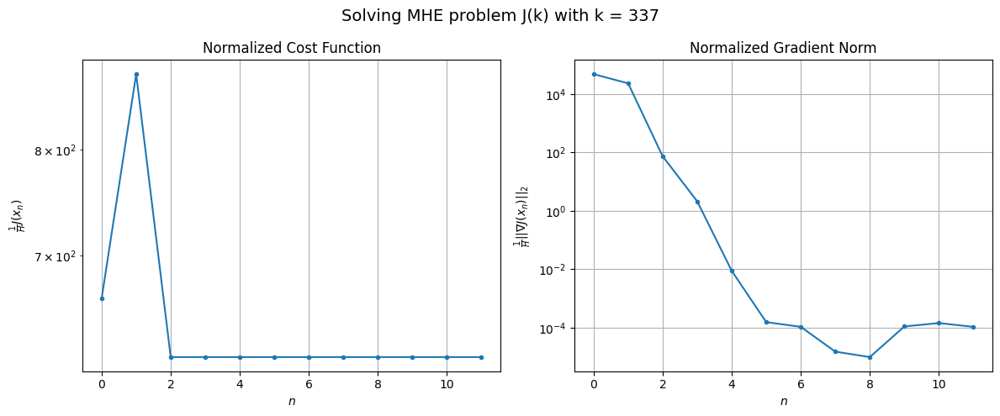

Windows:  85%|████████▍ | 319/376 [28:29<04:49,  5.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16734.685544565407
Gradient norm: 1285050.3147533203
Global estimation error: 938.9566444356132
Initial conditions estimation errors: 3.881186825746582 m, 218.05760560875478 m, 186.21450115770352 m, 894.0914408356817 m
Position estimation errors: 10.22142262397016 m, 92.83866006224511 m, 29.409841194445363 m, 472.49161222089873 m

[Gauss-Newton] Iteration 1
Cost function: 71237.46109055789 (325.69%)
Gradient norm: 1337356.3353454093 (4.07%)
Global estimation error: 1123.4850272041294 (19.65%)
Initial conditions estimation errors: 5.186150733986155 m, 278.2196882920652 m, 200.49170944829 m, 1069.8542325070282 m
Position estimation errors: 8.21214295486105 m, 210.6564469079025 m, 178.01545450064384 m, 908.6709626705361 m

[Gauss-Newton] Iteration 2
Cost function: 15524.721569396646 (-78.21%)
Gradient norm: 87509.88571011894 (-93.46%)
Global estimation error: 1401.817861638377 (24.77%)
Initial conditions estimation errors: 5.1861

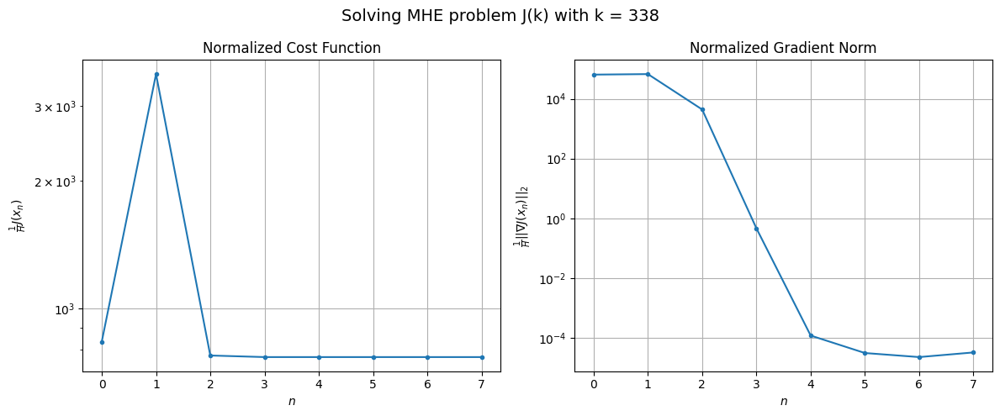

Windows:  85%|████████▌ | 320/376 [28:33<04:32,  4.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20637.42908668986
Gradient norm: 1592581.520964649
Global estimation error: 1457.7766127533844
Initial conditions estimation errors: 4.3466123890262525 m, 351.3395198982755 m, 248.00899223554916 m, 1392.89076447131 m
Position estimation errors: 11.506169047610147 m, 310.32740469342565 m, 261.79444494851975 m, 1304.3672339821483 m

[Gauss-Newton] Iteration 1
Cost function: 19198.453079777046 (-6.97%)
Gradient norm: 101495.62316488981 (-93.63%)
Global estimation error: 975.4328781796012 (-33.09%)
Initial conditions estimation errors: 5.792393065851744 m, 228.7019071276374 m, 170.8858892975997 m, 932.6996555283395 m
Position estimation errors: 9.211750227363266 m, 220.58787107132017 m, 182.13454881163068 m, 883.2140275869709 m

[Gauss-Newton] Iteration 2
Cost function: 18948.03656532128 (-1.30%)
Gradient norm: 751.3947742396422 (-99.26%)
Global estimation error: 925.3358856249375 (-5.14%)
Initial conditions estimation errors: 5.7

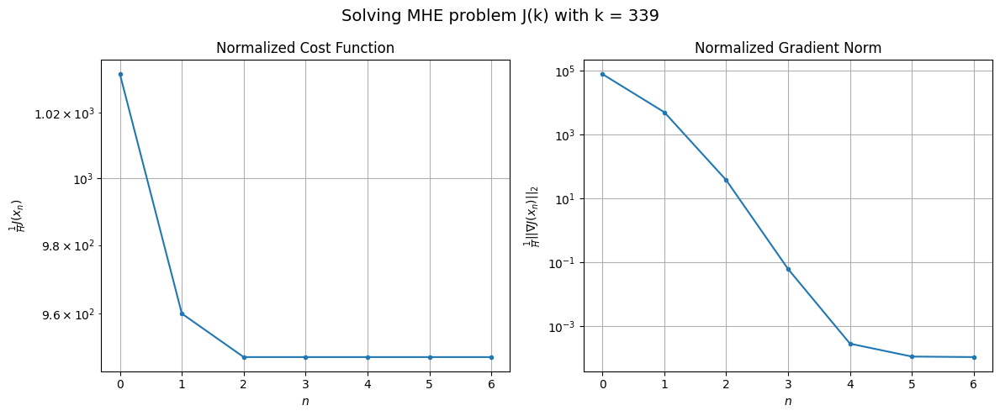

Windows:  85%|████████▌ | 321/376 [28:37<04:06,  4.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25355.822894454934
Gradient norm: 1889004.3562440393
Global estimation error: 963.8949642645938
Initial conditions estimation errors: 4.736399089167484 m, 226.63242400561867 m, 168.2349775874158 m, 921.6319109206763 m
Position estimation errors: 12.84548617972766 m, 200.36286843707524 m, 172.34616128899677 m, 803.2554554648559 m

[Gauss-Newton] Iteration 1
Cost function: 25341.653893836385 (-0.06%)
Gradient norm: 296625.1172377338 (-84.30%)
Global estimation error: 142.19797513211128 (-85.25%)
Initial conditions estimation errors: 6.371243861649419 m, 49.12166283724548 m, 30.597490274039398 m, 129.73249731325643 m
Position estimation errors: 10.193494135653003 m, 17.825875048819462 m, 42.77416133033973 m, 80.37074545783767 m

[Gauss-Newton] Iteration 2
Cost function: 23179.959537640527 (-8.53%)
Gradient norm: 2320.0302743245697 (-99.22%)
Global estimation error: 161.73246537762665 (13.74%)
Initial conditions estimation errors:

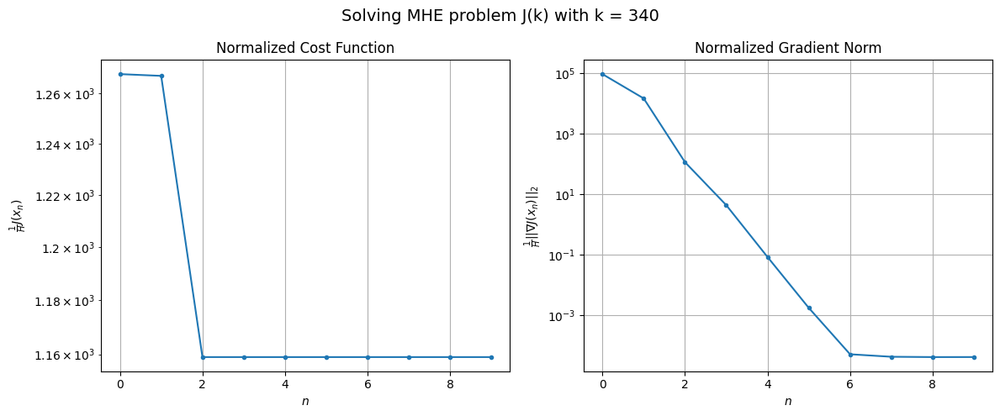

Windows:  86%|████████▌ | 322/376 [28:42<04:08,  4.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31207.565621177004
Gradient norm: 2234581.566575583
Global estimation error: 158.65549368158742
Initial conditions estimation errors: 5.1131500358485065 m, 51.37794843131326 m, 31.37249062083456 m, 146.70198411659214 m
Position estimation errors: 14.133380411159544 m, 32.68493904832921 m, 61.81883912776302 m, 144.35947244961628 m

[Gauss-Newton] Iteration 1
Cost function: 28771.892702007026 (-7.80%)
Gradient norm: 114419.14900370504 (-94.88%)
Global estimation error: 306.58804761405463 (93.24%)
Initial conditions estimation errors: 6.908710690369091 m, 54.93031333522526 m, 41.711778844599365 m, 298.648978029752 m
Position estimation errors: 11.070315112055264 m, 93.20863388610175 m, 31.590328582626462 m, 330.3131376018613 m

[Gauss-Newton] Iteration 2
Cost function: 28488.165980483463 (-0.99%)
Gradient norm: 10197.812141952269 (-91.09%)
Global estimation error: 187.84928665755385 (-38.73%)
Initial conditions estimation errors:

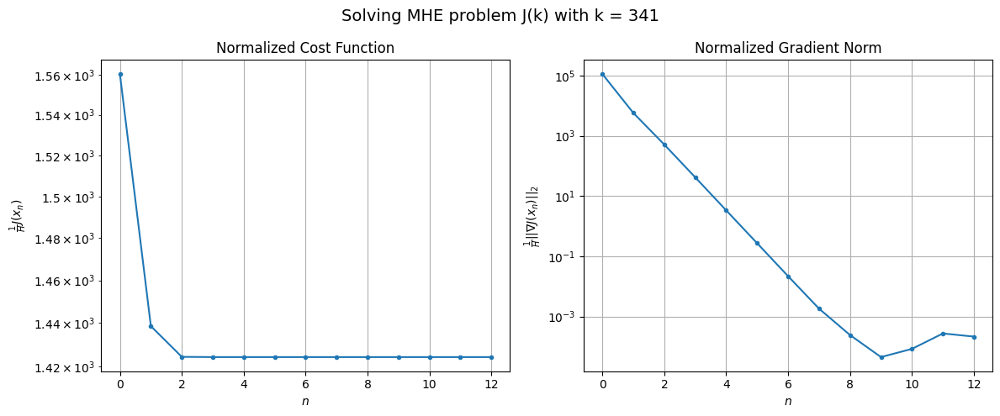

Windows:  86%|████████▌ | 323/376 [28:48<04:27,  5.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 37604.34172000479
Gradient norm: 2482324.1556262937
Global estimation error: 227.8429778468077
Initial conditions estimation errors: 5.46897449442587 m, 37.978671740686096 m, 28.917854295751162 m, 222.7192564731358 m
Position estimation errors: 15.210202403954668 m, 63.853412805456735 m, 15.145807819681734 m, 203.10975858596996 m

[Gauss-Newton] Iteration 1
Cost function: 34491.30382333991 (-8.28%)
Gradient norm: 110631.63015881732 (-95.54%)
Global estimation error: 586.7837948364316 (157.54%)
Initial conditions estimation errors: 7.558636191688633 m, 110.92100562837767 m, 74.94012708759422 m, 571.2601752721049 m
Position estimation errors: 11.787353815065888 m, 190.54109338132642 m, 109.3456104891878 m, 711.0614217328578 m

[Gauss-Newton] Iteration 2
Cost function: 34276.15966610497 (-0.62%)
Gradient norm: 19984.68963450463 (-81.94%)
Global estimation error: 415.8232376945326 (-29.14%)
Initial conditions estimation errors: 7.

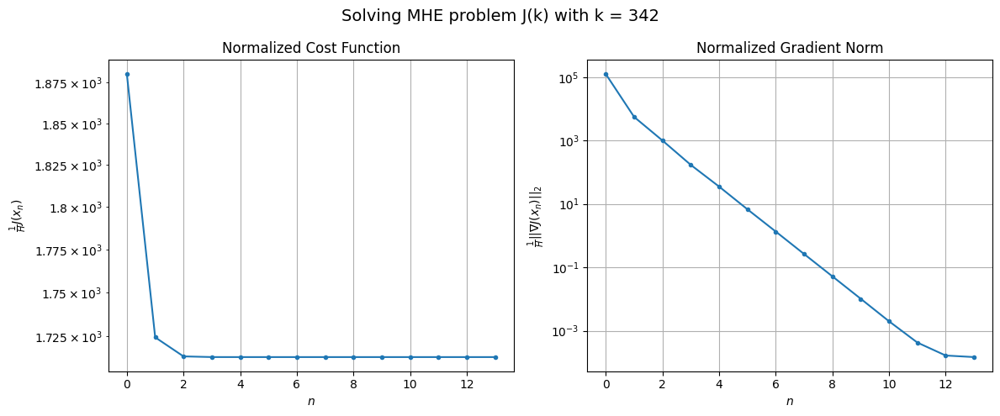

Windows:  86%|████████▌ | 324/376 [28:55<04:48,  5.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 44286.19283758431
Gradient norm: 2634121.464301284
Global estimation error: 496.68278291366045
Initial conditions estimation errors: 5.925440408414355 m, 92.2764850220153 m, 61.1862760566409 m, 484.1484806182503 m
Position estimation errors: 16.008893545901614 m, 150.1802288059682 m, 75.83085389026009 m, 540.5382346387532 m

[Gauss-Newton] Iteration 1
Cost function: 40631.65459675031 (-8.25%)
Gradient norm: 103618.49402497198 (-96.07%)
Global estimation error: 131.76183917452636 (-73.47%)
Initial conditions estimation errors: 8.27041091241487 m, 15.096190574446984 m, 8.323683870346757 m, 130.36717330782713 m
Position estimation errors: 12.306297038155279 m, 20.4402507383826 m, 22.418401191524534 m, 51.20353989457881 m

[Gauss-Newton] Iteration 2
Cost function: 40557.26409726765 (-0.18%)
Gradient norm: 82304.91495828456 (-20.57%)
Global estimation error: 462.2350081400292 (250.81%)
Initial conditions estimation errors: 8.270410

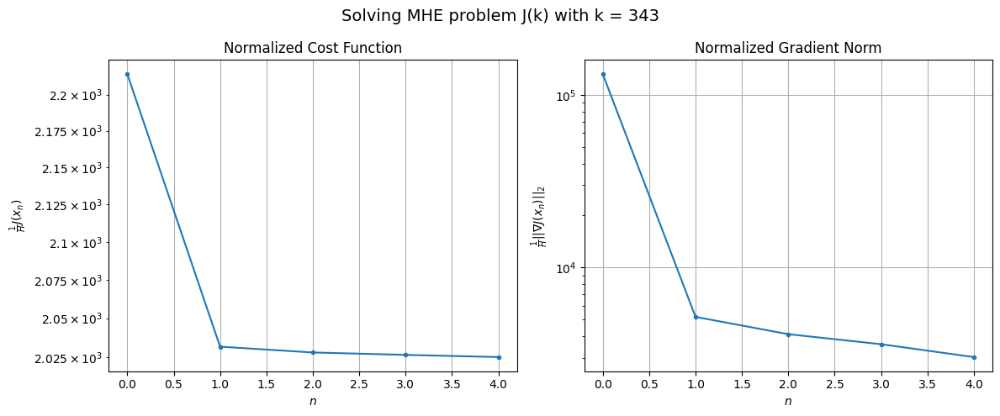

Windows:  86%|████████▋ | 325/376 [28:57<03:59,  4.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 50583.70657432619
Gradient norm: 2695623.2976520457
Global estimation error: 459.0201461767402
Initial conditions estimation errors: 6.414497830859804 m, 87.99729258378325 m, 54.09284382725663 m, 447.20093339812274 m
Position estimation errors: 16.478805651586143 m, 120.39879155276681 m, 67.43012454942915 m, 424.7923567199699 m

[Gauss-Newton] Iteration 1
Cost function: 70291.4718386581 (38.96%)
Gradient norm: 1123530.4330085893 (-58.32%)
Global estimation error: 1698.8596056765516 (270.11%)
Initial conditions estimation errors: 9.03332457642238 m, 374.4396346026819 m, 232.5123693501625 m, 1640.6620537275123 m
Position estimation errors: 12.592995728077788 m, 535.7403108305629 m, 418.7430169601437 m, 1999.9401990469948 m

[Gauss-Newton] Iteration 2
Cost function: 49680.03352394765 (-29.32%)
Gradient norm: 424468.62269564305 (-62.22%)
Global estimation error: 929.7330686289203 (-45.27%)
Initial conditions estimation errors: 9.0

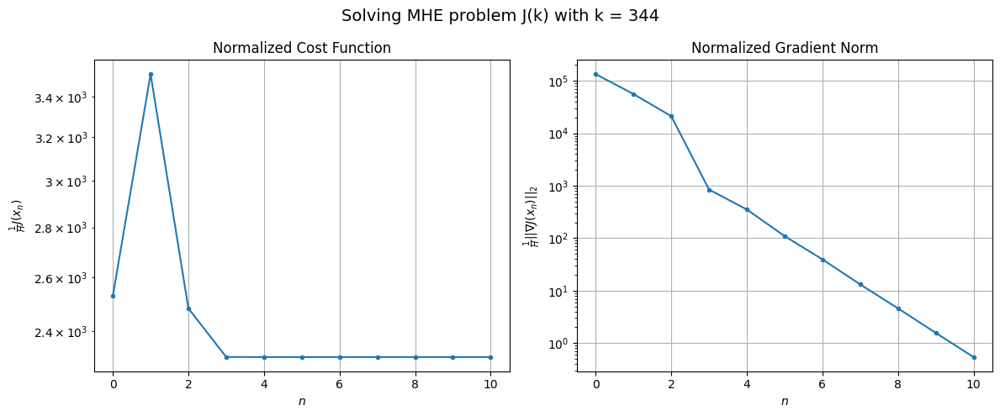

Windows:  87%|████████▋ | 326/376 [29:03<04:06,  4.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 55783.424222076064
Gradient norm: 2730110.481325415
Global estimation error: 1117.3965242254328
Initial conditions estimation errors: 6.914475805455757 m, 247.10195426690794 m, 152.77268497278558 m, 1078.9474066442424 m
Position estimation errors: 16.615306107669348 m, 288.89155960234615 m, 214.96351026845764 m, 1075.9155430768976 m

[Gauss-Newton] Iteration 1
Cost function: 63953.31346509454 (14.65%)
Gradient norm: 824492.6103538513 (-69.80%)
Global estimation error: 69.38190181784985 (-93.79%)
Initial conditions estimation errors: 9.877670399250523 m, 13.545923632373821 m, 4.972915612426251 m, 67.14085440636228 m
Position estimation errors: 12.564444650803626 m, 81.38422858994707 m, 88.42174831723737 m, 278.86984627308584 m

[Gauss-Newton] Iteration 2
Cost function: 50936.65197849966 (-20.35%)
Gradient norm: 2867.4695571885945 (-99.65%)
Global estimation error: 82.81021081529597 (19.35%)
Initial conditions estimation errors:

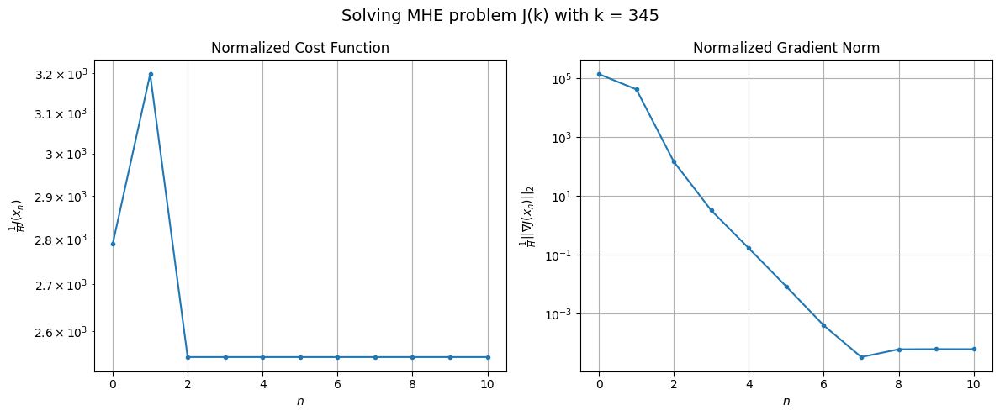

Windows:  87%|████████▋ | 327/376 [29:08<04:08,  5.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 59342.23455177047
Gradient norm: 2626286.588181191
Global estimation error: 48.894402426204614
Initial conditions estimation errors: 7.457919165076425 m, 7.034799975266836 m, 7.774696852813361 m, 47.167799831552685 m
Position estimation errors: 16.35743087847986 m, 117.67215404365118 m, 122.71110227976108 m, 404.3468341244939 m

[Gauss-Newton] Iteration 1
Cost function: 54367.63245859496 (-8.38%)
Gradient norm: 50321.9253427483 (-98.08%)
Global estimation error: 310.8095847277669 (535.68%)
Initial conditions estimation errors: 10.623410090894248 m, 79.47921125786331 m, 35.179307439902665 m, 298.2199542815855 m
Position estimation errors: 12.320159194568996 m, 30.44052004267802 m, 41.23139889455539 m, 81.97593831451056 m

[Gauss-Newton] Iteration 2
Cost function: 54321.19114135843 (-0.09%)
Gradient norm: 12708.943812354753 (-74.74%)
Global estimation error: 436.7636691720939 (40.52%)
Initial conditions estimation errors: 10.623

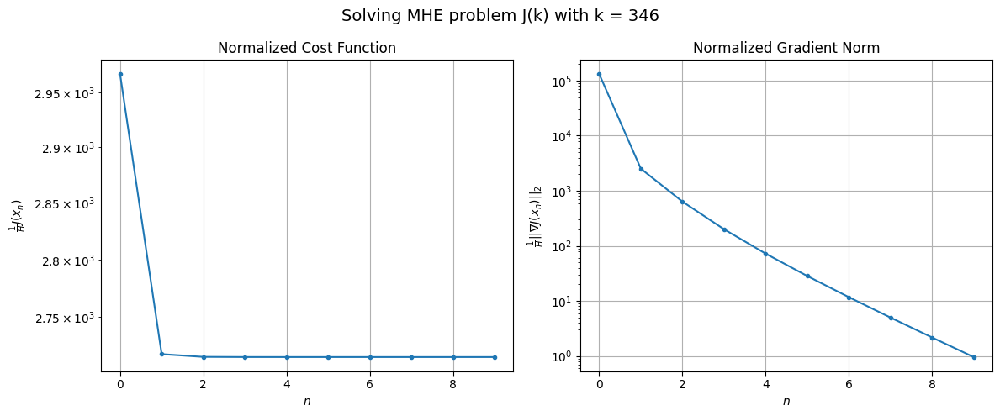

Windows:  87%|████████▋ | 328/376 [29:13<04:02,  5.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 60710.67840215797
Gradient norm: 2417737.0821676273
Global estimation error: 626.6002668375904
Initial conditions estimation errors: 7.912763321905962 m, 149.57330409106302 m, 84.39282185418557 m, 602.5536793250958 m
Position estimation errors: 15.82364050914974 m, 79.47559433362458 m, 67.07327441780004 m, 293.5032602225548 m

[Gauss-Newton] Iteration 1
Cost function: 80674.18067923533 (32.88%)
Gradient norm: 1070844.149487784 (-55.71%)
Global estimation error: 807.5818445318881 (28.88%)
Initial conditions estimation errors: 11.26037219314775 m, 169.0637433259179 m, 135.52088518187261 m, 777.889345332685 m
Position estimation errors: 11.928433139235086 m, 316.390749532718 m, 276.03091200200504 m, 1146.835263108896 m

[Gauss-Newton] Iteration 2
Cost function: 55660.90906196096 (-31.01%)
Gradient norm: 3225.1705367965383 (-99.70%)
Global estimation error: 785.3758463893795 (-2.75%)
Initial conditions estimation errors: 11.260372

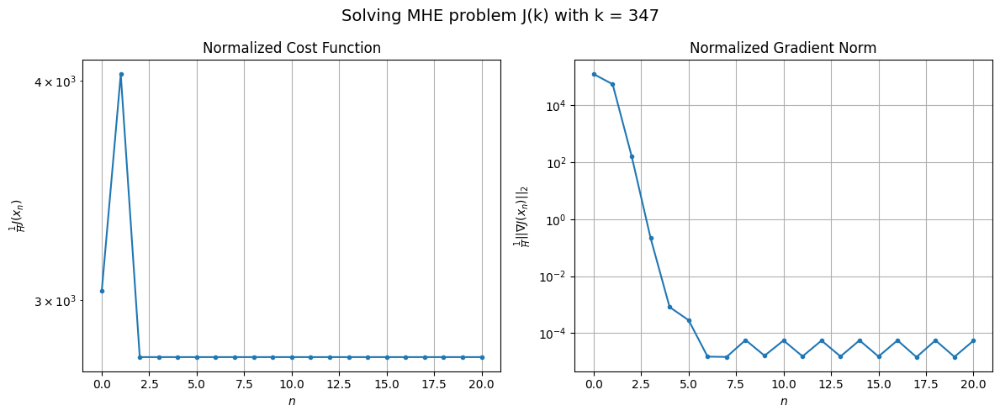

Windows:  88%|████████▊ | 329/376 [29:23<05:01,  6.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 60489.87396164122
Gradient norm: 2186214.230370451
Global estimation error: 860.169306546179
Initial conditions estimation errors: 8.29956282979513 m, 184.75834135914974 m, 145.461976597631 m, 827.3608533218755 m
Position estimation errors: 15.103851939340366 m, 343.5813210265787 m, 304.0509989618528 m, 1225.9271123897274 m

[Gauss-Newton] Iteration 1
Cost function: 55618.13237135337 (-8.05%)
Gradient norm: 15865.132696359822 (-99.27%)
Global estimation error: 933.186335025719 (8.49%)
Initial conditions estimation errors: 11.71331137503069 m, 190.56562369854845 m, 176.0975735582295 m, 896.3100633721069 m
Position estimation errors: 11.421847824962976 m, 411.4811415411269 m, 357.33625114983573 m, 1436.756193649883 m

[Gauss-Newton] Iteration 2
Cost function: 55614.160290861706 (-0.01%)
Gradient norm: 1.2562277959655117 (-99.99%)
Global estimation error: 934.5432283320912 (0.15%)
Initial conditions estimation errors: 11.71331152

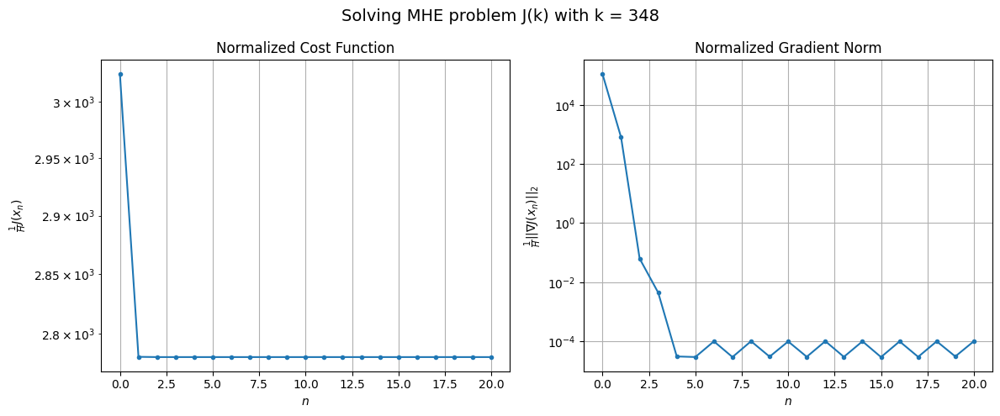

Windows:  88%|████████▊ | 330/376 [29:32<05:41,  7.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 58969.48710023286
Gradient norm: 1938709.3141697734
Global estimation error: 1019.4210865907942
Initial conditions estimation errors: 8.56041460179296 m, 217.04293787689213 m, 194.85515009921124 m, 976.764009473893 m
Position estimation errors: 14.248820435235734 m, 404.8709130583533 m, 352.54229832234535 m, 1400.2307587829441 m

[Gauss-Newton] Iteration 1
Cost function: 54339.107707313866 (-7.85%)
Gradient norm: 64976.38396917524 (-96.65%)
Global estimation error: 618.4499842557415 (-39.33%)
Initial conditions estimation errors: 12.027293182515228 m, 119.90269110984137 m, 120.61436936277211 m, 594.4829099758795 m
Position estimation errors: 10.780283983493867 m, 314.8688747641205 m, 274.1881540365093 m, 1070.11825267219 m

[Gauss-Newton] Iteration 2
Cost function: 54232.79777354468 (-0.20%)
Gradient norm: 212.1274676056106 (-99.67%)
Global estimation error: 598.0764606726309 (-3.29%)
Initial conditions estimation errors: 12.0

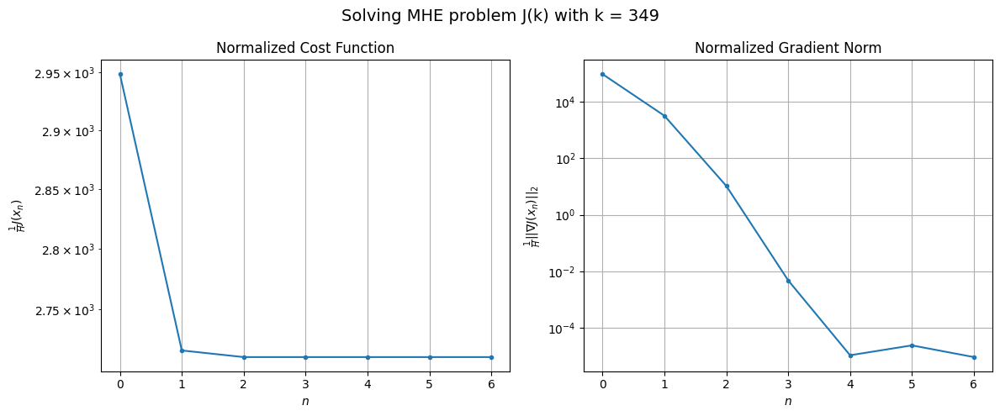

Windows:  88%|████████▊ | 331/376 [29:36<04:41,  6.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 55879.6753060276
Gradient norm: 1606826.9320443538
Global estimation error: 661.8291378805404
Initial conditions estimation errors: 8.741629591205598 m, 134.57367965678057 m, 130.97101124074217 m, 634.5681543693246 m
Position estimation errors: 13.253256862559319 m, 306.2933529074126 m, 266.40547208159734 m, 1030.134449587096 m

[Gauss-Newton] Iteration 1
Cost function: 51622.28187373081 (-7.62%)
Gradient norm: 4935.805952790147 (-99.69%)
Global estimation error: 657.2430800566709 (-0.69%)
Initial conditions estimation errors: 12.12001098728033 m, 121.8836888419442 m, 103.57766744566233 m, 637.3665163665843 m
Position estimation errors: 10.153785122527363 m, 354.66983754362565 m, 330.4970435319657 m, 1138.149888954098 m

[Gauss-Newton] Iteration 2
Cost function: 51621.934366617694 (-0.00%)
Gradient norm: 11.293162532875545 (-99.77%)
Global estimation error: 656.2032406093327 (-0.16%)
Initial conditions estimation errors: 12.12

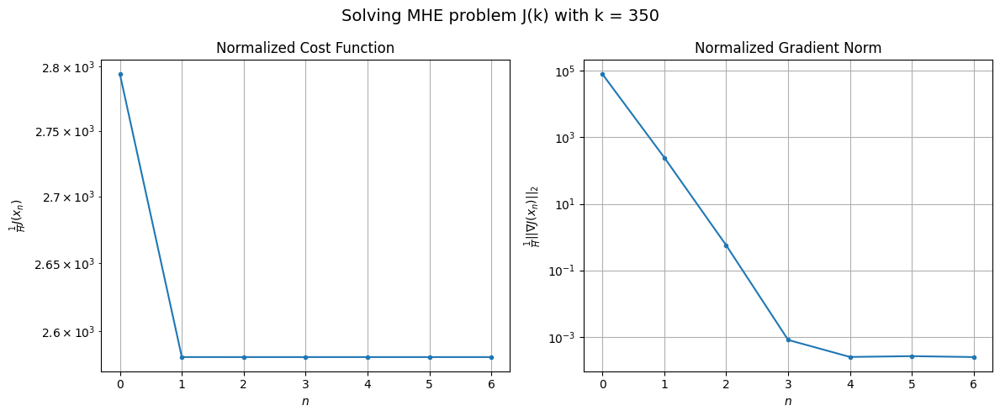

Windows:  88%|████████▊ | 332/376 [29:40<03:59,  5.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 51800.05312637703
Gradient norm: 1336992.521696245
Global estimation error: 725.5784169479336
Initial conditions estimation errors: 8.772063158622696 m, 144.6455668090446 m, 123.05013043259802 m, 700.2299847688797 m
Position estimation errors: 12.30232383594473 m, 350.373467569142 m, 328.3467773194759 m, 1110.131439774753 m

[Gauss-Newton] Iteration 1
Cost function: 48081.48752054151 (-7.18%)
Gradient norm: 113855.62826090465 (-91.48%)
Global estimation error: 296.22359060885833 (-59.17%)
Initial conditions estimation errors: 12.102959361251198 m, 60.241802045110354 m, 79.65050145987281 m, 278.6182117494731 m
Position estimation errors: 9.512442728223094 m, 210.7516072515412 m, 202.21408810312752 m, 626.907714562778 m

[Gauss-Newton] Iteration 2
Cost function: 47818.58409131957 (-0.55%)
Gradient norm: 343.2050847663567 (-99.70%)
Global estimation error: 275.4761234254596 (-7.00%)
Initial conditions estimation errors: 12.102959

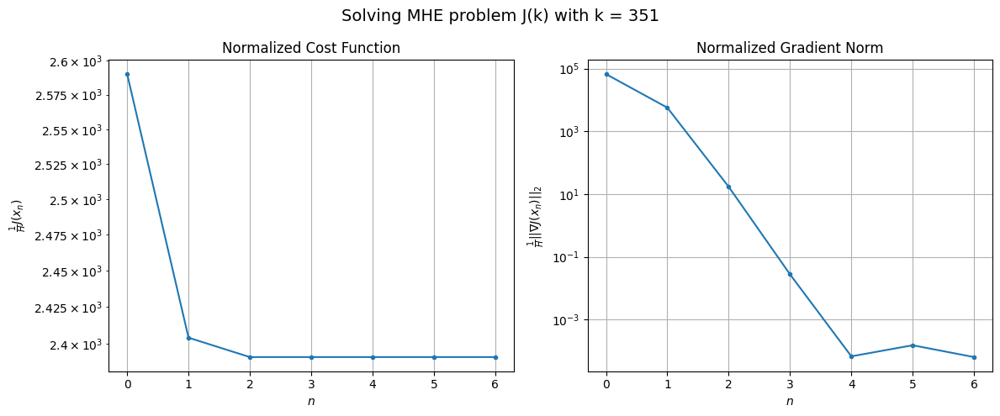

Windows:  89%|████████▊ | 333/376 [29:43<03:28,  4.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 46963.25590370722
Gradient norm: 1097126.4797652245
Global estimation error: 314.22236851884566
Initial conditions estimation errors: 8.7562433958056 m, 68.03764203539507 m, 87.77562687034872 m, 293.8109393985416 m
Position estimation errors: 11.408302273370564 m, 202.1516864642236 m, 193.08209990557663 m, 594.7045900812268 m

[Gauss-Newton] Iteration 1
Cost function: 43782.65091727817 (-6.77%)
Gradient norm: 146798.966795841 (-86.62%)
Global estimation error: 138.46300800624263 (-55.93%)
Initial conditions estimation errors: 11.902317358108622 m, 40.88314709988691 m, 90.20533783986548 m, 96.03058423192232 m
Position estimation errors: 8.96808052808676 m, 16.63319118722251 m, 17.448710982084563 m, 54.64837078005433 m

[Gauss-Newton] Iteration 2
Cost function: 43459.118658526364 (-0.74%)
Gradient norm: 20460.13108786176 (-86.06%)
Global estimation error: 95.65257496520552 (-30.92%)
Initial conditions estimation errors: 11.90231

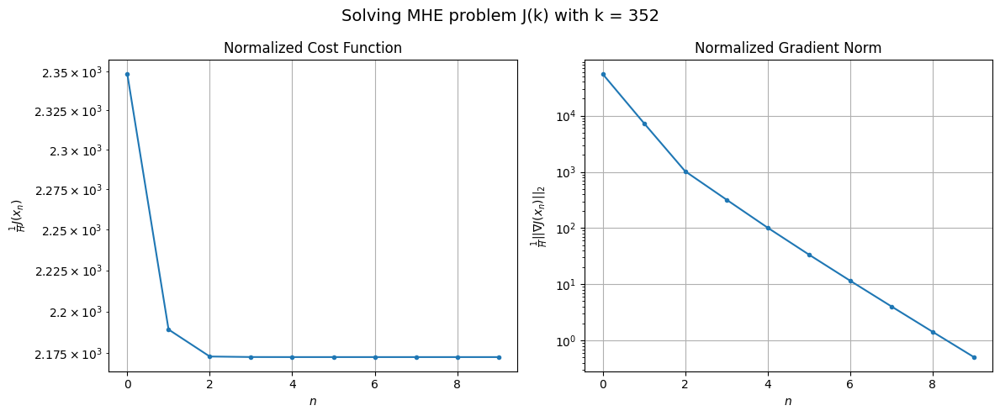

Windows:  89%|████████▉ | 334/376 [29:48<03:25,  4.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 42088.81328148282
Gradient norm: 1022120.293252908
Global estimation error: 216.49117038828362
Initial conditions estimation errors: 8.612927253724179 m, 29.283733316090935 m, 66.49846966166287 m, 203.75039540153924 m
Position estimation errors: 10.72873909797967 m, 179.15586367328726 m, 199.14099103074608 m, 561.4751027451963 m

[Gauss-Newton] Iteration 1
Cost function: 39060.38327531724 (-7.20%)
Gradient norm: 11924.627588755726 (-98.83%)
Global estimation error: 317.7879806764341 (46.79%)
Initial conditions estimation errors: 11.50766121204406 m, 41.790209540422744 m, 66.79255552118767 m, 307.6498130276736 m
Position estimation errors: 8.604805732391991 m, 237.9986240336999 m, 260.82821775658545 m, 722.613399410769 m

[Gauss-Newton] Iteration 2
Cost function: 39058.089150658794 (-0.01%)
Gradient norm: 2905.9535921832025 (-75.63%)
Global estimation error: 357.033391570966 (12.35%)
Initial conditions estimation errors: 11.507

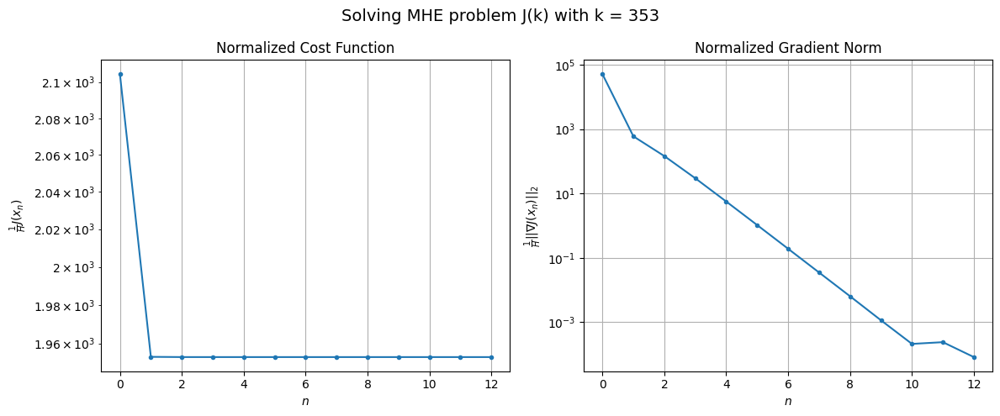

Windows:  89%|████████▉ | 335/376 [29:54<03:35,  5.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 38083.20388047328
Gradient norm: 1162140.4853452852
Global estimation error: 436.64492872485516
Initial conditions estimation errors: 8.301922112251427 m, 68.91339683906571 m, 43.392681950352305 m, 428.9019947705876 m
Position estimation errors: 10.399605455337275 m, 292.80570776082834 m, 325.00954389842514 m, 867.5446696430909 m

[Gauss-Newton] Iteration 1
Cost function: 35642.036575783364 (-6.41%)
Gradient norm: 98948.11997758449 (-91.49%)
Global estimation error: 102.04028143366463 (-76.63%)
Initial conditions estimation errors: 10.869340461895705 m, 15.333948832872998 m, 58.60628879937955 m, 81.38774270014001 m
Position estimation errors: 8.414841853285994 m, 150.589614916804 m, 162.1952605741972 m, 415.4574601927291 m

[Gauss-Newton] Iteration 2
Cost function: 35476.92818337878 (-0.46%)
Gradient norm: 31319.860470107622 (-68.35%)
Global estimation error: 55.19536013455363 (-45.91%)
Initial conditions estimation errors: 10

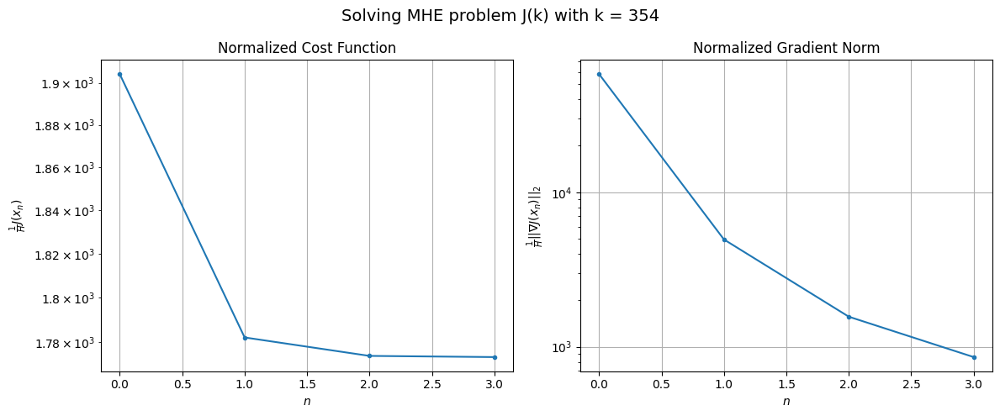

Windows:  89%|████████▉ | 336/376 [29:56<02:53,  4.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 35039.48288915118
Gradient norm: 1347964.9793924731
Global estimation error: 114.02577418624473
Initial conditions estimation errors: 7.801942488715126 m, 34.27929461855457 m, 43.638264082557235 m, 99.30567107904781 m
Position estimation errors: 10.379258864233918 m, 20.902773099998036 m, 28.02403993347906 m, 80.19009477739034 m

[Gauss-Newton] Iteration 1
Cost function: 32689.485352653825 (-6.71%)
Gradient norm: 17447.5069944404 (-98.71%)
Global estimation error: 40.09832834019144 (-64.83%)
Initial conditions estimation errors: 10.08703975027476 m, 12.90018322524671 m, 14.572132744869661 m, 33.5758382496944 m
Position estimation errors: 8.416904022829907 m, 49.33837422427764 m, 44.902568611463074 m, 97.88902326110005 m

[Gauss-Newton] Iteration 2
Cost function: 32683.945356188873 (-0.02%)
Gradient norm: 4943.755715034843 (-71.66%)
Global estimation error: 26.39257966389417 (-34.18%)
Initial conditions estimation errors: 10.08

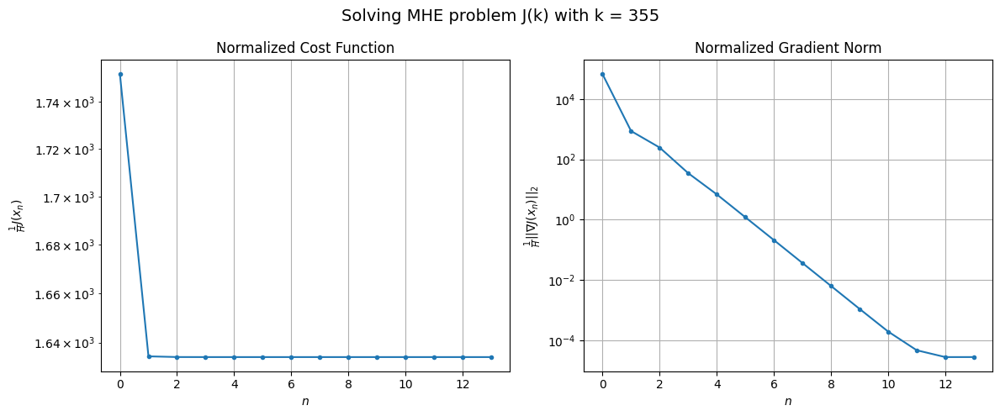

Windows:  90%|████████▉ | 337/376 [30:03<03:13,  4.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 33457.19256231798
Gradient norm: 1533044.5487734354
Global estimation error: 48.46309036080131
Initial conditions estimation errors: 7.235917809778294 m, 7.96735910010118 m, 14.846052394613128 m, 44.85981745579836 m
Position estimation errors: 10.640333346435634 m, 17.195970019708334 m, 34.20012116789467 m, 87.61810488209952 m

[Gauss-Newton] Iteration 1
Cost function: 35908.28759924724 (7.33%)
Gradient norm: 533934.3365057695 (-65.17%)
Global estimation error: 502.7454101636139 (937.38%)
Initial conditions estimation errors: 9.212849870206972 m, 114.30989250469587 m, 71.9446313651192 m, 484.17341431085515 m
Position estimation errors: 8.623776474445986 m, 375.39627860070124 m, 413.7412182355844 m, 1032.7376284706088 m

[Gauss-Newton] Iteration 2
Cost function: 31347.824844265124 (-12.70%)
Gradient norm: 13622.764796520862 (-97.45%)
Global estimation error: 582.8339533854303 (15.93%)
Initial conditions estimation errors: 9.212

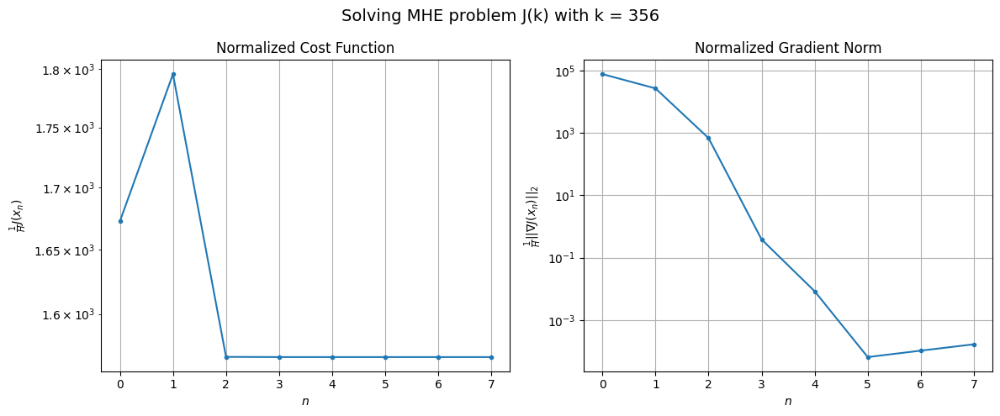

Windows:  90%|████████▉ | 338/376 [30:07<02:56,  4.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 33104.19293139543
Gradient norm: 1647254.2611716662
Global estimation error: 661.1367150827346
Initial conditions estimation errors: 6.639609264015277 m, 154.09571947332796 m, 107.38529267850309 m, 633.8601882938673 m
Position estimation errors: 11.09722153471497 m, 445.0736706616298 m, 491.2271334052759 m, 1205.8761269382176 m

[Gauss-Newton] Iteration 1
Cost function: 31466.748157542712 (-4.95%)
Gradient norm: 115594.91181572671 (-92.98%)
Global estimation error: 94.76350641105213 (-85.67%)
Initial conditions estimation errors: 8.452032443240451 m, 9.427636485031849 m, 31.901842532078177 m, 88.32293823512092 m
Position estimation errors: 8.960352444581966 m, 317.65495203940674 m, 362.51432407205806 m, 809.7655352591377 m

[Gauss-Newton] Iteration 2
Cost function: 31088.553758055965 (-1.20%)
Gradient norm: 1222.3651184000896 (-98.94%)
Global estimation error: 127.9037957995446 (34.97%)
Initial conditions estimation errors: 8.

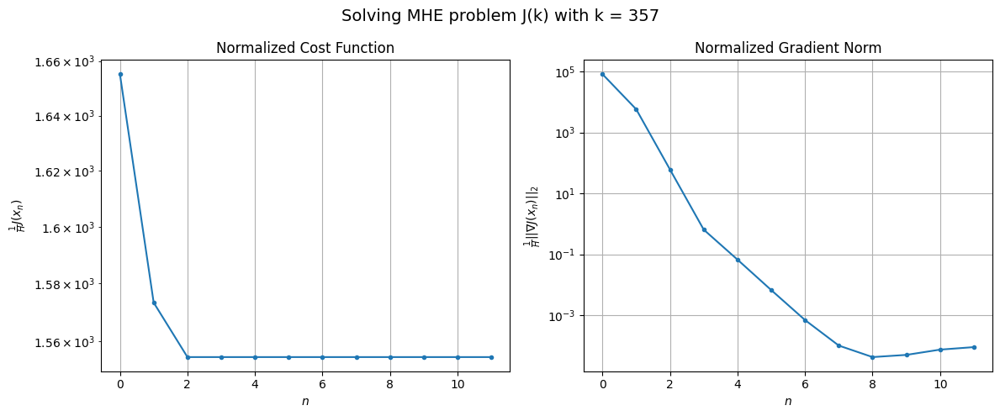

Windows:  90%|█████████ | 339/376 [30:12<03:02,  4.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 34342.28566198457
Gradient norm: 1701647.2703026056
Global estimation error: 183.58634402530808
Initial conditions estimation errors: 6.19659464977948 m, 30.383040238421703 m, 6.757406497385408 m, 180.81898005852935 m
Position estimation errors: 11.6315256563681 m, 346.90644309991853 m, 392.7675860905861 m, 878.1107158617524 m

[Gauss-Newton] Iteration 1
Cost function: 32233.238746116112 (-6.14%)
Gradient norm: 59.91207999426252 (-100.00%)
Global estimation error: 205.15459769698984 (11.75%)
Initial conditions estimation errors: 7.989781802312928 m, 32.07027442446445 m, 7.362930707352141 m, 202.3378818629571 m
Position estimation errors: 9.282615448591343 m, 343.4315950651227 m, 389.2422014553535 m, 880.5774253582879 m

[Gauss-Newton] Iteration 2
Cost function: 32233.23822369199 (-0.00%)
Gradient norm: 10.01638986022059 (-83.28%)
Global estimation error: 205.4487381875617 (0.14%)
Initial conditions estimation errors: 7.9897818

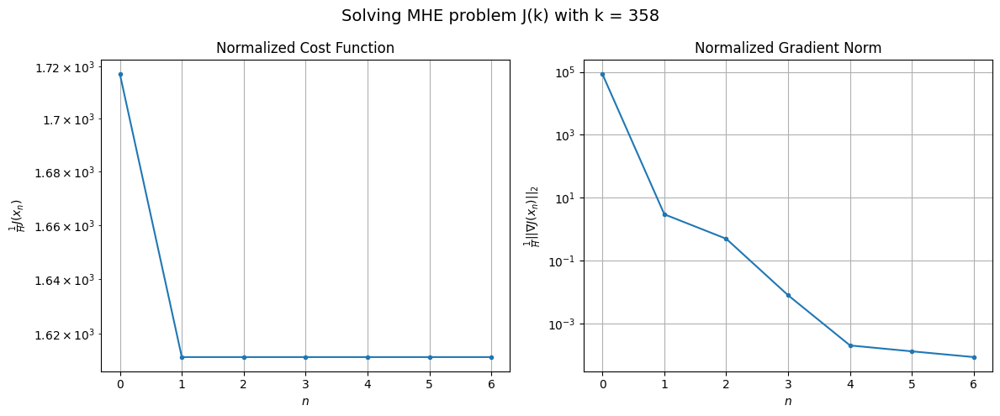

Windows:  90%|█████████ | 340/376 [30:16<02:41,  4.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 36252.47419850189
Gradient norm: 1655816.0972233093
Global estimation error: 264.81326102686535
Initial conditions estimation errors: 6.010779553190528 m, 53.588835920506085 m, 25.735813896650253 m, 257.98181033649513 m
Position estimation errors: 12.078770856017682 m, 353.0670318801959 m, 397.1517695169114 m, 892.7563365878235 m

[Gauss-Newton] Iteration 1
Cost function: 34113.41812950649 (-5.90%)
Gradient norm: 51803.13286659066 (-96.87%)
Global estimation error: 69.6013795777119 (-73.72%)
Initial conditions estimation errors: 7.933012364057325 m, 31.57261397262866 m, 48.667219307815614 m, 37.621707668159154 m
Position estimation errors: 9.647947014042911 m, 248.98846442182975 m, 275.964639557397 m, 604.1256299293499 m

[Gauss-Newton] Iteration 2
Cost function: 34055.898436293355 (-0.17%)
Gradient norm: 110.77972961627671 (-99.79%)
Global estimation error: 56.09753952738738 (-19.40%)
Initial conditions estimation errors: 7.9

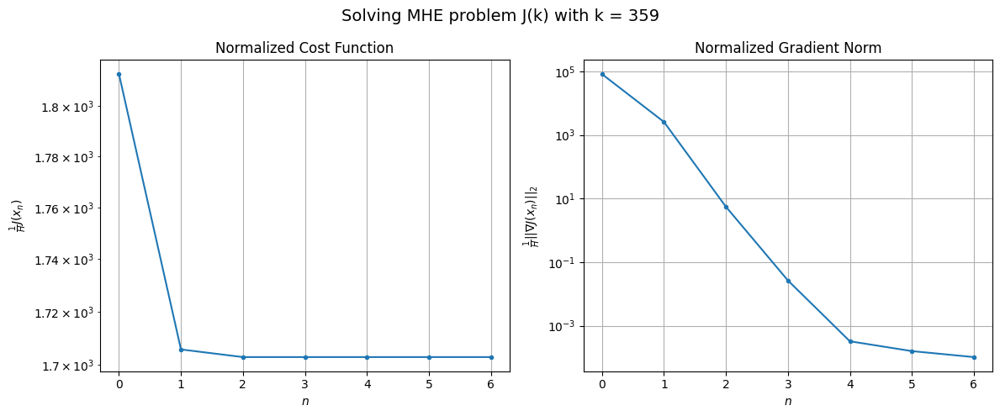

Windows:  91%|█████████ | 341/376 [30:19<02:26,  4.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 38427.58416638709
Gradient norm: 1572352.7300521452
Global estimation error: 42.111960193782934
Initial conditions estimation errors: 6.096706569349671 m, 10.20087462179605 m, 21.188285389476704 m, 34.38807162005879 m
Position estimation errors: 12.50981209782185 m, 261.5006774568824 m, 285.12755648463724 m, 628.7001920883073 m

[Gauss-Newton] Iteration 1
Cost function: 36074.469364112905 (-6.12%)
Gradient norm: 96947.76011400367 (-93.83%)
Global estimation error: 270.923003151859 (543.34%)
Initial conditions estimation errors: 8.315281228749996 m, 82.03636329110877 m, 99.20848424237145 m, 238.23876432643416 m
Position estimation errors: 9.942181896754715 m, 86.58274208420015 m, 83.64431223323855 m, 197.60077514243824 m

[Gauss-Newton] Iteration 2
Cost function: 35913.70349733792 (-0.45%)
Gradient norm: 7.615395135440603 (-99.99%)
Global estimation error: 260.5070734281636 (-3.84%)
Initial conditions estimation errors: 8.31528

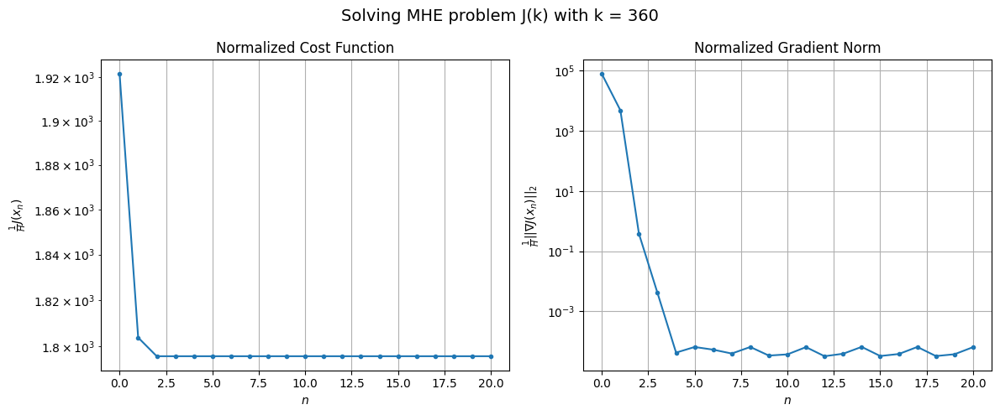

Windows:  91%|█████████ | 342/376 [30:29<03:18,  5.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 40655.94947551831
Gradient norm: 1463551.8602989987
Global estimation error: 239.18402111834538
Initial conditions estimation errors: 6.454304513383112 m, 71.72607880681778 m, 86.05906594786016 m, 211.2259573969458 m
Position estimation errors: 12.795098043038223 m, 95.74415958983084 m, 88.0931303299844 m, 218.07082471678612 m

[Gauss-Newton] Iteration 1
Cost function: 37925.085072384114 (-6.72%)
Gradient norm: 4635.444957448639 (-99.68%)
Global estimation error: 36.175680100896905 (-84.88%)
Initial conditions estimation errors: 8.870931039010692 m, 14.614228748437641 m, 6.770514484812469 m, 31.152438704601604 m
Position estimation errors: 10.135963379537813 m, 103.31299520106455 m, 96.75813362620666 m, 220.31280145405293 m

[Gauss-Newton] Iteration 2
Cost function: 37922.48635423664 (-0.01%)
Gradient norm: 277.5842498556143 (-94.01%)
Global estimation error: 39.32275103518691 (8.70%)
Initial conditions estimation errors: 8.87

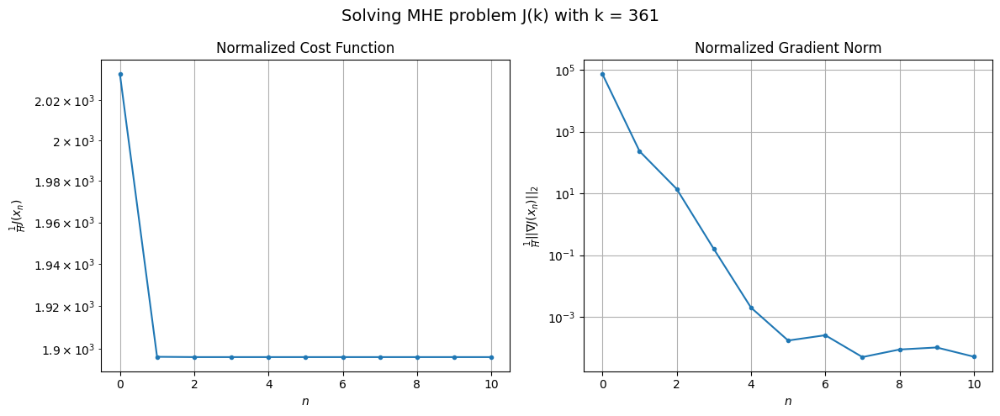

Windows:  91%|█████████ | 343/376 [30:34<03:07,  5.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 42313.99171391589
Gradient norm: 1332534.7119883941
Global estimation error: 28.31375695297063
Initial conditions estimation errors: 6.8691945305923445 m, 11.888033084253188 m, 10.733023022483124 m, 22.313358781475447 m
Position estimation errors: 12.931978292401462 m, 96.34730994677572 m, 80.2669650234892 m, 198.97758429059485 m

[Gauss-Newton] Iteration 1
Cost function: 39358.633084822846 (-6.98%)
Gradient norm: 47163.07634356857 (-96.46%)
Global estimation error: 273.77441553119354 (866.93%)
Initial conditions estimation errors: 9.52172501078395 m, 71.0060482878211 m, 71.40499522710047 m, 254.40366220700452 m
Position estimation errors: 10.218795234809306 m, 24.681440643091516 m, 50.95016682250362 m, 78.9208431574371 m

[Gauss-Newton] Iteration 2
Cost function: 39314.84830079182 (-0.11%)
Gradient norm: 46.46456100504774 (-99.90%)
Global estimation error: 264.5043197407852 (-3.39%)
Initial conditions estimation errors: 9.521

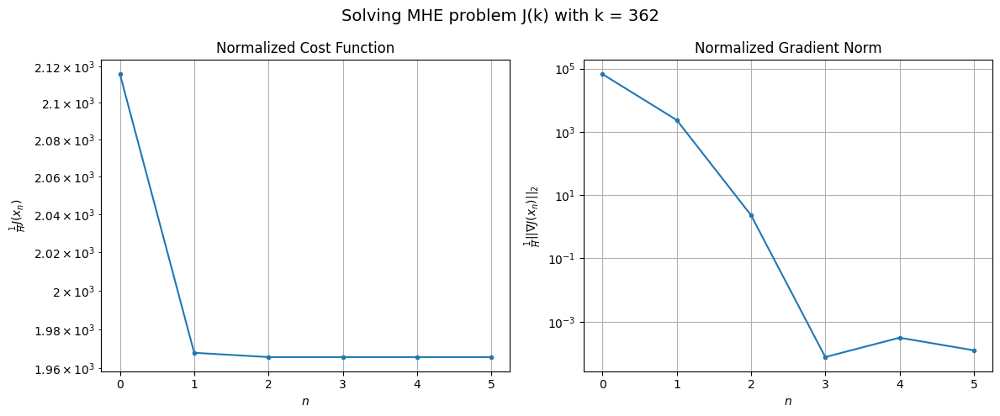

Windows:  91%|█████████▏| 344/376 [30:37<02:38,  4.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 42961.21685218733
Gradient norm: 1229228.7990098582
Global estimation error: 265.03777090592604
Initial conditions estimation errors: 7.30286175334346 m, 69.18856298474924 m, 68.57998069085221 m, 246.3765559870095 m
Position estimation errors: 12.951480546585803 m, 17.576603338621826 m, 46.256263863177075 m, 52.21158914717344 m

[Gauss-Newton] Iteration 1
Cost function: 39726.92984483972 (-7.53%)
Gradient norm: 1484.9990267735895 (-99.88%)
Global estimation error: 172.25385853967498 (-35.01%)
Initial conditions estimation errors: 10.11350605043956 m, 37.34529871471481 m, 47.665914367590034 m, 160.94211082905943 m
Position estimation errors: 10.18302429946327 m, 54.43564073146522 m, 79.02679506085407 m, 134.57755696110058 m

[Gauss-Newton] Iteration 2
Cost function: 39726.86669088106 (-0.00%)
Gradient norm: 0.34022364758665363 (-99.98%)
Global estimation error: 174.14530385232302 (1.10%)
Initial conditions estimation errors: 10

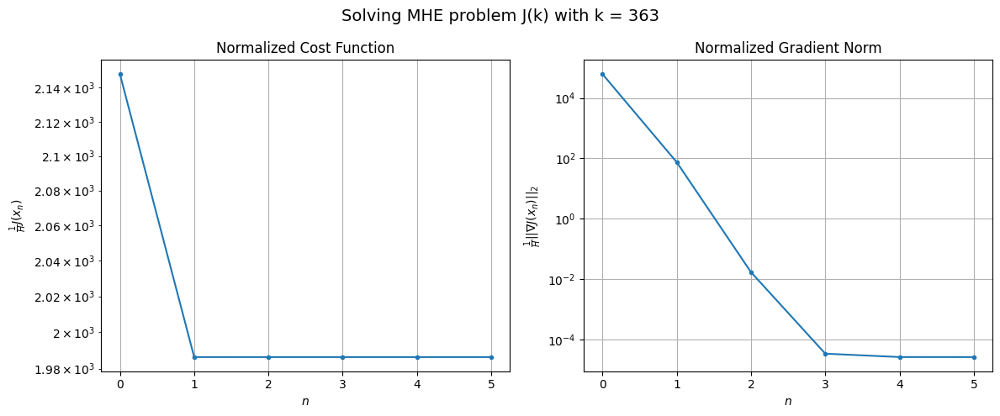

Windows:  92%|█████████▏| 345/376 [30:41<02:16,  4.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 42826.33260252412
Gradient norm: 1185824.1112288558
Global estimation error: 182.27260472547405
Initial conditions estimation errors: 7.647305014190381 m, 41.993838500137855 m, 50.74611595995253 m, 169.78262483097143 m
Position estimation errors: 12.859691878779365 m, 50.424362563694096 m, 80.12898240720006 m, 123.1731623689228 m

[Gauss-Newton] Iteration 1
Cost function: 39354.05822490927 (-8.11%)
Gradient norm: 2159.1057967617985 (-99.82%)
Global estimation error: 61.13119423817337 (-66.46%)
Initial conditions estimation errors: 10.581021027831197 m, 9.176618278389943 m, 15.316788515448136 m, 57.4997068017873 m
Position estimation errors: 10.021979584108385 m, 41.512824461362676 m, 67.36272950277487 m, 97.5986845383466 m

[Gauss-Newton] Iteration 2
Cost function: 39353.75308907584 (-0.00%)
Gradient norm: 0.364826022661948 (-99.98%)
Global estimation error: 58.76364929443571 (-3.87%)
Initial conditions estimation errors: 10.5

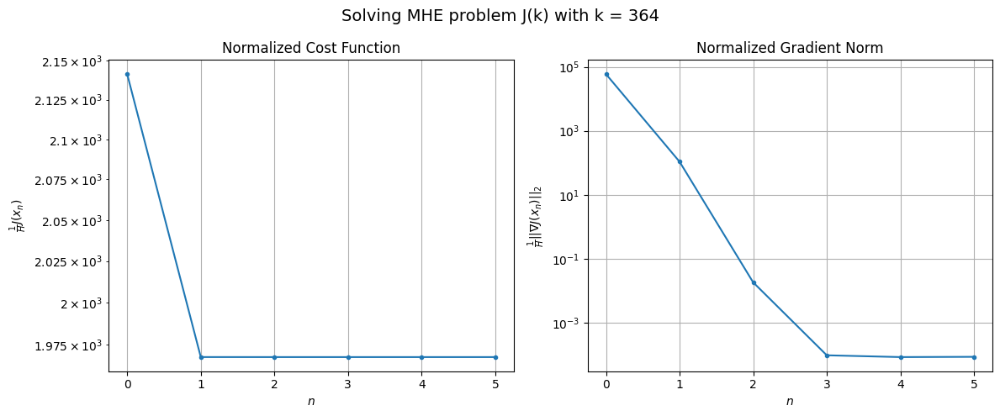

Windows:  92%|█████████▏| 346/376 [30:44<02:01,  4.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 41602.199880356
Gradient norm: 1153659.1323852155
Global estimation error: 65.70853460960076
Initial conditions estimation errors: 7.881412121430191 m, 8.695821138526844 m, 16.440300213713314 m, 62.526481677322785 m
Position estimation errors: 12.637218672676507 m, 40.068489653240256 m, 71.03235574638002 m, 93.6402712540024 m

[Gauss-Newton] Iteration 1
Cost function: 38055.4817485607 (-8.53%)
Gradient norm: 14303.62436288376 (-98.76%)
Global estimation error: 153.73384552341147 (133.96%)
Initial conditions estimation errors: 10.859823000262097 m, 61.20301808490396 m, 50.92667849668009 m, 131.06032059820393 m
Position estimation errors: 9.793891980253383 m, 12.402737811122307 m, 5.779658508439015 m, 23.29346087051643 m

[Gauss-Newton] Iteration 2
Cost function: 38049.31259728445 (-0.02%)
Gradient norm: 3.2273576197308724 (-99.98%)
Global estimation error: 158.50974027778813 (3.11%)
Initial conditions estimation errors: 10.8598

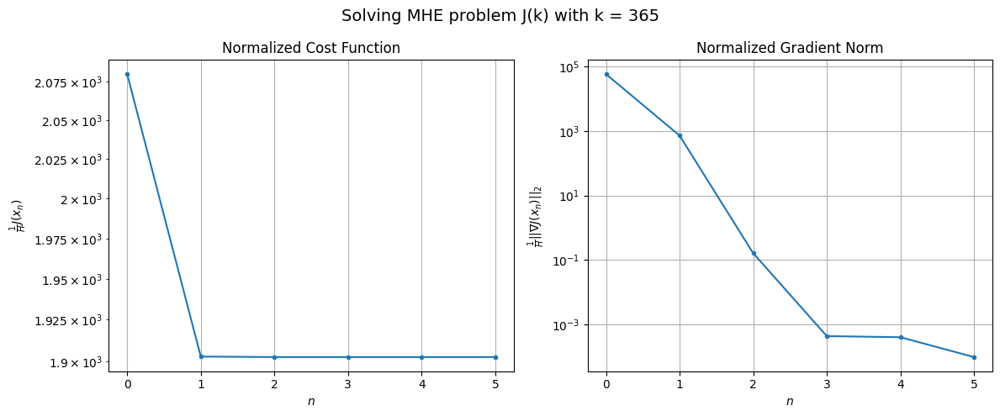

Windows:  92%|█████████▏| 347/376 [30:47<01:49,  3.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 39775.71184373887
Gradient norm: 1165005.5296299162
Global estimation error: 153.76250118782656
Initial conditions estimation errors: 7.99413970520479 m, 59.34952843061742 m, 53.746562289743295 m, 131.026426351094 m
Position estimation errors: 12.323626827541696 m, 11.933670245116621 m, 11.571258001293534 m, 18.640902683640746 m

[Gauss-Newton] Iteration 1
Cost function: 36301.42975416879 (-8.73%)
Gradient norm: 44589.809205154066 (-96.17%)
Global estimation error: 471.59030300750044 (206.70%)
Initial conditions estimation errors: 10.932164385571001 m, 151.9794435056634 m, 134.5864857342916 m, 425.5192042248402 m
Position estimation errors: 9.49172360982099 m, 104.2932277542724 m, 125.60865752116457 m, 245.89206872512264 m

[Gauss-Newton] Iteration 2
Cost function: 36254.45360788364 (-0.13%)
Gradient norm: 134.7962365278734 (-99.70%)
Global estimation error: 490.00734720646295 (3.91%)
Initial conditions estimation errors: 10.9

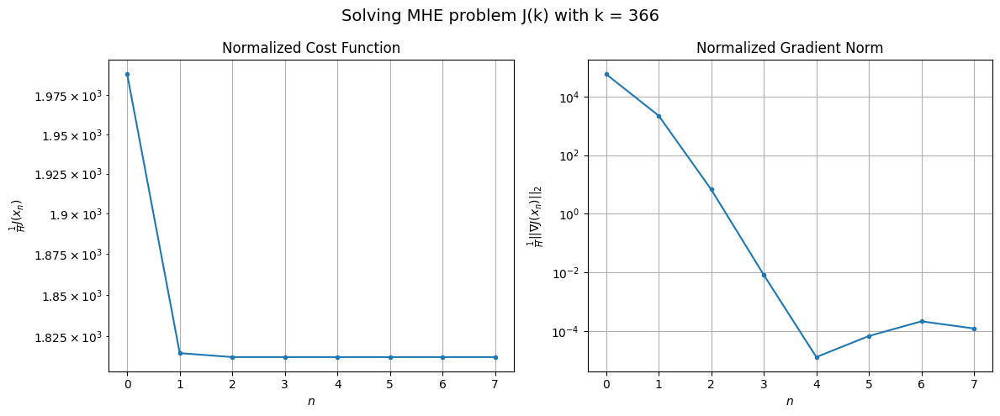

Windows:  93%|█████████▎| 348/376 [30:51<01:47,  3.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 37492.0239164737
Gradient norm: 1178868.029867893
Global estimation error: 497.3843247613347
Initial conditions estimation errors: 7.993806354501517 m, 159.1117726391898 m, 150.11183789416174 m, 446.62861102175304 m
Position estimation errors: 11.893974278807123 m, 103.61341400654419 m, 123.45670535083389 m, 235.12811605813297 m

[Gauss-Newton] Iteration 1
Cost function: 34151.84690747802 (-8.91%)
Gradient norm: 19948.10733420065 (-98.31%)
Global estimation error: 343.19253338539573 (-31.00%)
Initial conditions estimation errors: 10.835237765770897 m, 117.73089742219452 m, 110.04238882481351 m, 302.809840290913 m
Position estimation errors: 9.135426310550638 m, 26.20875037824478 m, 26.484598705447333 m, 55.56402013352113 m

[Gauss-Newton] Iteration 2
Cost function: 34144.42206736644 (-0.02%)
Gradient norm: 0.7078495386558565 (-100.00%)
Global estimation error: 342.22313405828953 (-0.28%)
Initial conditions estimation errors: 1

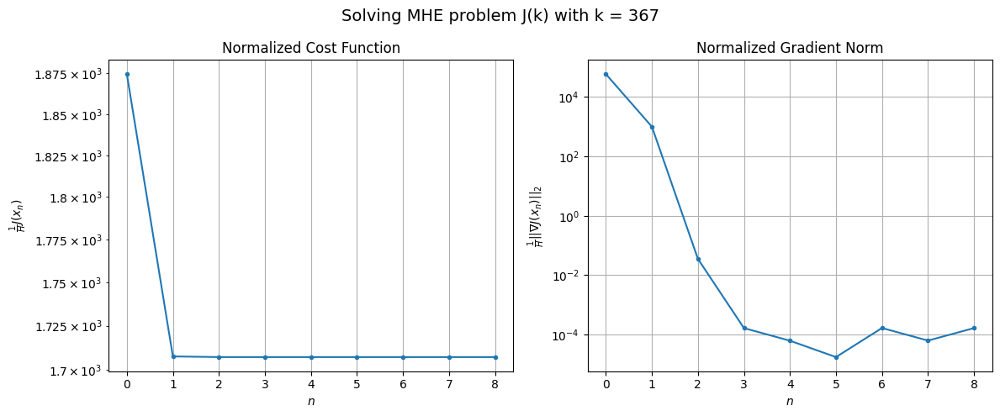

Windows:  93%|█████████▎| 349/376 [30:55<01:48,  4.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 34815.84875838506
Gradient norm: 1218590.7340730673
Global estimation error: 335.978329776387
Initial conditions estimation errors: 7.895272077092993 m, 113.60190340681515 m, 111.47286033971683 m, 295.7828374443103 m
Position estimation errors: 11.390303978932405 m, 20.805572000585094 m, 17.480198830265067 m, 37.1911182791064 m

[Gauss-Newton] Iteration 1
Cost function: 31698.72472149152 (-8.95%)
Gradient norm: 21701.840460447955 (-98.22%)
Global estimation error: 318.3808399661828 (-5.24%)
Initial conditions estimation errors: 10.614057849142002 m, 122.06411622855879 m, 125.40708307673145 m, 265.7572550911369 m
Position estimation errors: 8.704635395093296 m, 82.47992847774874 m, 107.19402701101674 m, 199.1808859672187 m

[Gauss-Newton] Iteration 2
Cost function: 31691.446830264656 (-0.02%)
Gradient norm: 79.41686204012592 (-99.63%)
Global estimation error: 306.86594444155776 (-3.62%)
Initial conditions estimation errors: 10.

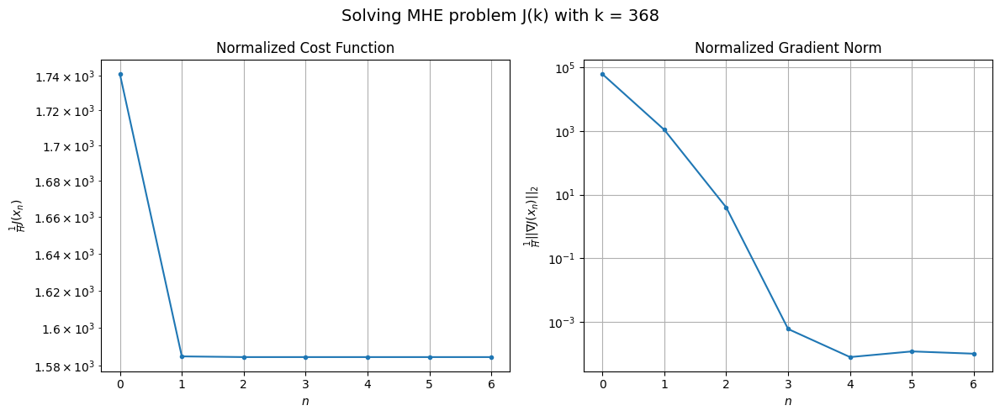

Windows:  93%|█████████▎| 350/376 [30:59<01:40,  3.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 32010.511767141477
Gradient norm: 1282945.054772905
Global estimation error: 279.65237899750355
Initial conditions estimation errors: 7.710502185886637 m, 106.66761799548549 m, 112.8480790780296 m, 232.45023062855577 m
Position estimation errors: 10.806713760236635 m, 95.07395736411144 m, 125.83097258008915 m, 229.31420429681793 m

[Gauss-Newton] Iteration 1
Cost function: 29110.296072223035 (-9.06%)
Gradient norm: 606.1550962790476 (-99.95%)
Global estimation error: 387.97086241626687 (38.73%)
Initial conditions estimation errors: 10.318825284733183 m, 146.97833936399613 m, 158.64409032695352 m, 321.93791569216313 m
Position estimation errors: 8.174909156153154 m, 110.01254958722245 m, 146.7695762998277 m, 262.97809085328 m

[Gauss-Newton] Iteration 2
Cost function: 29110.199729330463 (-0.00%)
Gradient norm: 1.1373881159118189 (-99.81%)
Global estimation error: 383.72120758648214 (-1.10%)
Initial conditions estimation errors:

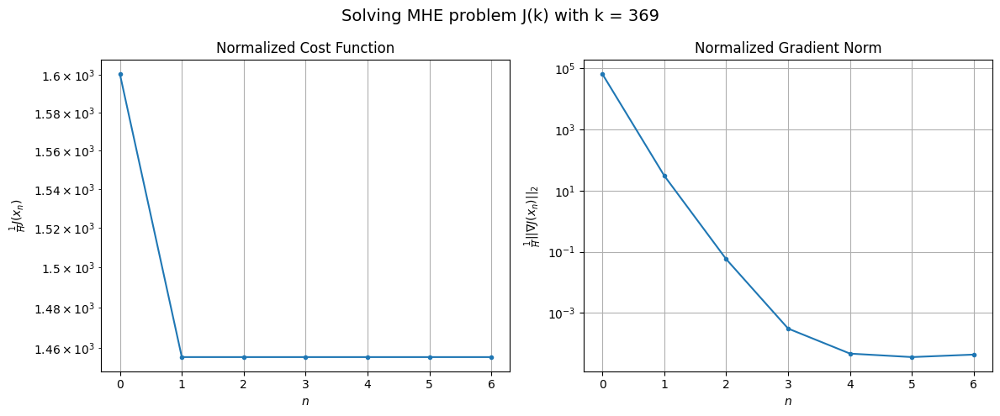

Windows:  93%|█████████▎| 351/376 [31:02<01:34,  3.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28572.59691007747
Gradient norm: 1278851.2121024805
Global estimation error: 350.195889761485
Initial conditions estimation errors: 7.4596308067118215 m, 131.62449989847633 m, 145.65623480099134 m, 289.897281815646 m
Position estimation errors: 10.13710758491555 m, 120.20378575549574 m, 161.96980845000607 m, 287.7546574089749 m

[Gauss-Newton] Iteration 1
Cost function: 25941.84216980248 (-9.21%)
Gradient norm: 1076.8922185773044 (-99.92%)
Global estimation error: 328.514561644011 (-6.19%)
Initial conditions estimation errors: 9.971661942962603 m, 127.01419025463306 m, 125.72120246456299 m, 275.4699870716999 m
Position estimation errors: 7.636474943172319 m, 102.1829465706222 m, 129.62630309137657 m, 230.0173925092285 m

[Gauss-Newton] Iteration 2
Cost function: 25941.821859466563 (-0.00%)
Gradient norm: 0.8681672226893034 (-99.92%)
Global estimation error: 327.45935157319343 (-0.32%)
Initial conditions estimation errors: 9.97

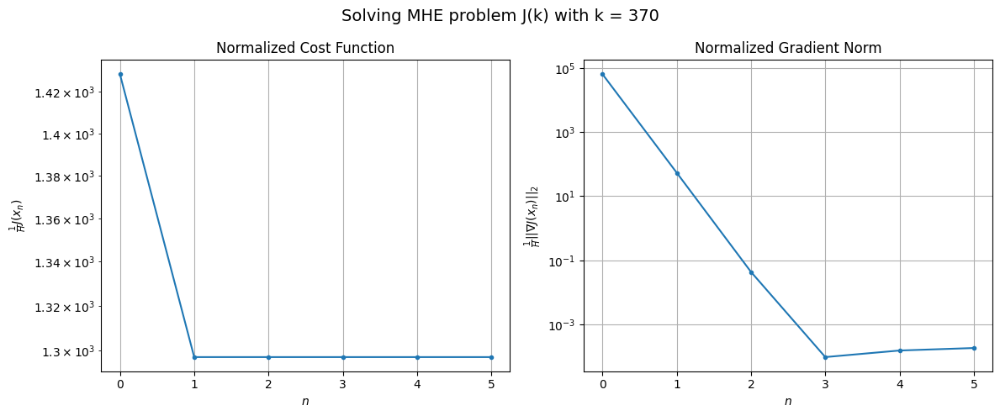

Windows:  94%|█████████▎| 352/376 [31:06<01:25,  3.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25277.93311959559
Gradient norm: 1302629.6978230446
Global estimation error: 297.6118141719467
Initial conditions estimation errors: 7.121467754417652 m, 113.83208705061037 m, 116.16504141635824 m, 249.13801804739055 m
Position estimation errors: 9.492242183506505 m, 111.98850146861209 m, 143.2072390786257 m, 252.98008038708755 m

[Gauss-Newton] Iteration 1
Cost function: 22836.66858845597 (-9.66%)
Gradient norm: 29711.34089180143 (-97.72%)
Global estimation error: 664.0242711984747 (123.12%)
Initial conditions estimation errors: 9.595516293442788 m, 247.07705600068707 m, 280.58452641235095 m, 548.6904227566172 m
Position estimation errors: 7.0443472996807 m, 52.961907218277894 m, 41.013835642485226 m, 149.52765907052847 m

[Gauss-Newton] Iteration 2
Cost function: 22797.901108955688 (-0.17%)
Gradient norm: 10.892212446755648 (-99.96%)
Global estimation error: 659.4873634405772 (-0.68%)
Initial conditions estimation errors: 9.

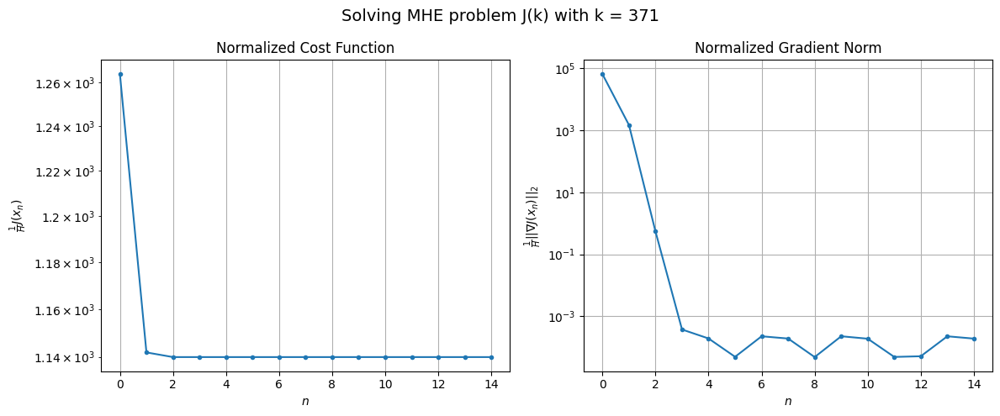

Windows:  94%|█████████▍| 353/376 [31:13<01:45,  4.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22212.874385805684
Gradient norm: 1344661.0901934193
Global estimation error: 630.3756377568195
Initial conditions estimation errors: 6.7234073613208665 m, 233.37829870440157 m, 272.05758629432245 m, 518.5047788698278 m
Position estimation errors: 8.831698851586317 m, 71.3158098787215 m, 64.74534325550482 m, 192.41242909017663 m

[Gauss-Newton] Iteration 1
Cost function: 19903.217074764816 (-10.40%)
Gradient norm: 10355.259041082785 (-99.23%)
Global estimation error: 211.92534651472752 (-66.38%)
Initial conditions estimation errors: 9.155104387147588 m, 76.36397131622627 m, 54.968208955992736 m, 189.67218071485388 m
Position estimation errors: 6.423698359797743 m, 21.220569281490704 m, 8.738659665622999 m, 35.04045710820951 m

[Gauss-Newton] Iteration 2
Cost function: 19876.37002048408 (-0.13%)
Gradient norm: 635.8481625044544 (-93.86%)
Global estimation error: 188.8140553540428 (-10.91%)
Initial conditions estimation errors: 

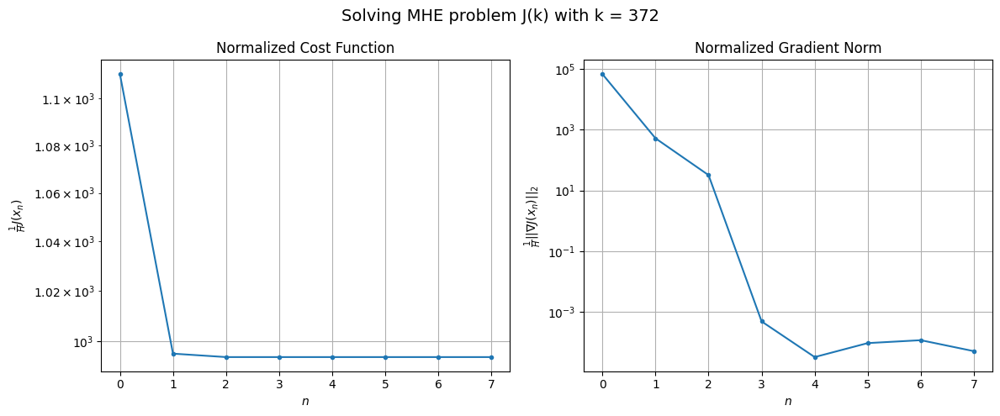

Windows:  94%|█████████▍| 354/376 [31:16<01:37,  4.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 18954.603867849208
Gradient norm: 1272741.4678694475
Global estimation error: 176.25364000443273
Initial conditions estimation errors: 6.235557254357909 m, 62.05478067168365 m, 44.82798191983964 m, 158.63815928637788 m
Position estimation errors: 8.171344937915006 m, 38.6013492451496 m, 34.459935822633994 m, 75.64446213853809 m

[Gauss-Newton] Iteration 1
Cost function: 16825.05535805625 (-11.23%)
Gradient norm: 17508.808943820735 (-98.62%)
Global estimation error: 87.53488720358443 (-50.34%)
Initial conditions estimation errors: 8.641901084571588 m, 25.388965728900697 m, 70.2043499255164 m, 44.881359603530655 m
Position estimation errors: 5.886536973688534 m, 90.84145929193734 m, 113.63786058224564 m, 181.29553988495772 m

[Gauss-Newton] Iteration 2
Cost function: 16814.382546019897 (-0.06%)
Gradient norm: 2.525608715027358 (-99.99%)
Global estimation error: 83.31992076985092 (-4.82%)
Initial conditions estimation errors: 8.6

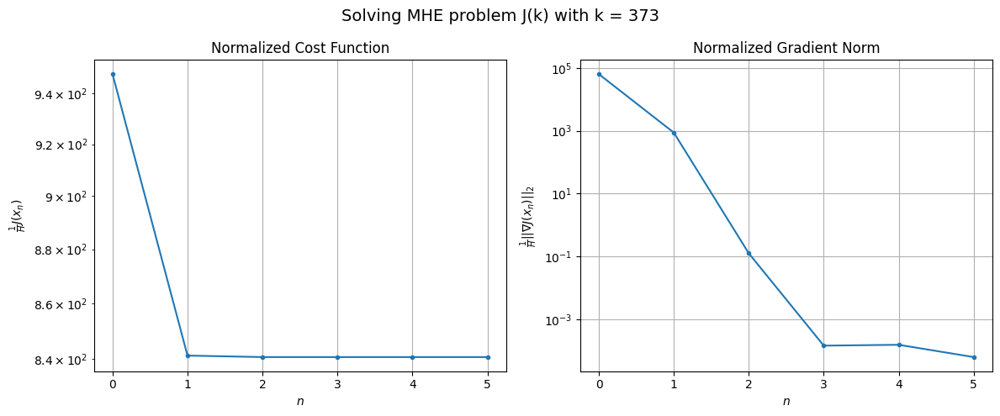

Windows:  94%|█████████▍| 355/376 [31:20<01:24,  4.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16264.126448324752
Gradient norm: 1251207.9651684496
Global estimation error: 95.60082288337173
Initial conditions estimation errors: 5.677560660678414 m, 30.786836006397845 m, 71.44524844612837 m, 55.2715917526878 m
Position estimation errors: 7.616061530831127 m, 89.90669984890387 m, 111.88818328714164 m, 180.75173484170753 m

[Gauss-Newton] Iteration 1
Cost function: 14311.100565702665 (-12.01%)
Gradient norm: 6889.299811245925 (-99.45%)
Global estimation error: 206.84192195652645 (116.36%)
Initial conditions estimation errors: 8.00758616185657 m, 68.84653998244605 m, 103.65477651877205 m, 165.03081379786693 m
Position estimation errors: 5.403244966343729 m, 127.59326805842264 m, 179.37955975789296 m, 261.02674660263943 m

[Gauss-Newton] Iteration 2
Cost function: 14310.011158307843 (-0.01%)
Gradient norm: 3.6068404134397447 (-99.95%)
Global estimation error: 201.08619815264476 (-2.78%)
Initial conditions estimation errors:

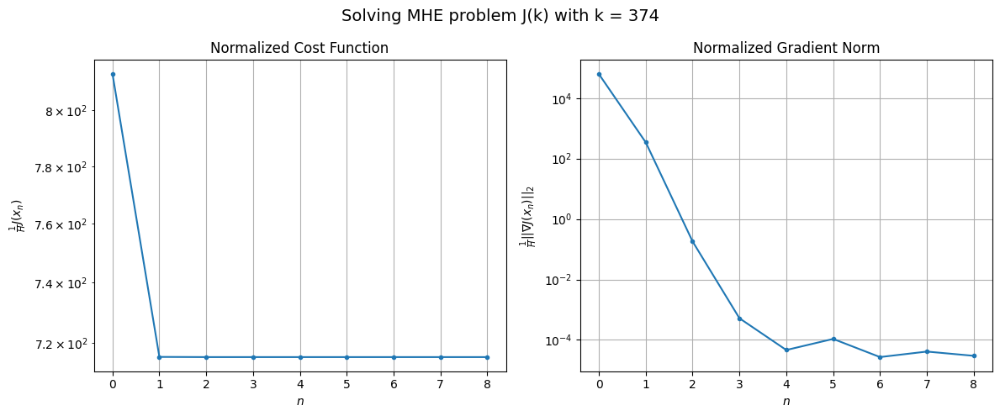

Windows:  95%|█████████▍| 356/376 [31:24<01:22,  4.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13707.1695424081
Gradient norm: 1187048.92874014
Global estimation error: 221.3718924078435
Initial conditions estimation errors: 5.0736079606057585 m, 76.11169436419256 m, 108.5938792700335 m, 177.183621617831 m
Position estimation errors: 7.106163490366956 m, 124.19342627535595 m, 176.33516209811472 m, 253.98379225347983 m

[Gauss-Newton] Iteration 1
Cost function: 11939.319593582366 (-12.90%)
Gradient norm: 602.9020953414288 (-99.95%)
Global estimation error: 172.70163634361788 (-21.99%)
Initial conditions estimation errors: 7.3317212281464 m, 59.639376323529355 m, 72.22587540252691 m, 144.90855675065464 m
Position estimation errors: 4.98967223737337 m, 142.25110348492908 m, 212.1234162920091 m, 295.24927493753336 m

[Gauss-Newton] Iteration 2
Cost function: 11939.307871577097 (-0.00%)
Gradient norm: 1.1470915295684208 (-99.81%)
Global estimation error: 175.79770025611268 (1.79%)
Initial conditions estimation errors: 7.3317

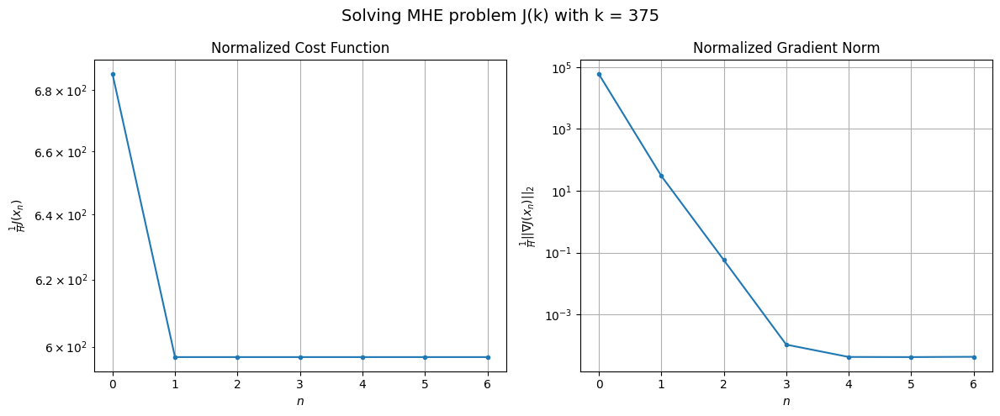

Windows:  95%|█████████▍| 357/376 [31:28<01:15,  3.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11437.569030524919
Gradient norm: 1102049.3299231464
Global estimation error: 199.5167172348831
Initial conditions estimation errors: 4.533752435373511 m, 71.01979773263447 m, 84.3390525317655 m, 166.22068503749614 m
Position estimation errors: 6.657039564602267 m, 139.9036250549701 m, 212.46186789720662 m, 290.0539040560617 m

[Gauss-Newton] Iteration 1
Cost function: 9914.908251202982 (-13.31%)
Gradient norm: 16931.471284071577 (-98.46%)
Global estimation error: 622.1564847250512 (211.83%)
Initial conditions estimation errors: 6.676384096857607 m, 225.70230867103828 m, 310.40989300726847 m, 489.63069526312387 m
Position estimation errors: 4.666611255965729 m, 149.58449495083835 m, 227.6593508125574 m, 267.8736763650579 m

[Gauss-Newton] Iteration 2
Cost function: 9877.100589209216 (-0.38%)
Gradient norm: 41.22139424413193 (-99.76%)
Global estimation error: 600.4142521655323 (-3.49%)
Initial conditions estimation errors: 6.67

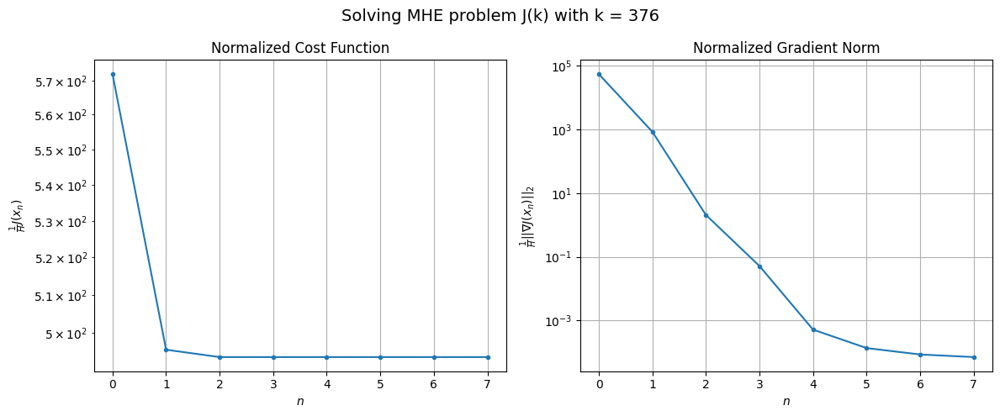

Windows:  95%|█████████▌| 358/376 [31:31<01:11,  3.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9618.186124188825
Gradient norm: 1027937.760148919
Global estimation error: 617.4701346879613
Initial conditions estimation errors: 4.088115257065723 m, 225.79264076608723 m, 308.223895781602 m, 485.0446524549775 m
Position estimation errors: 6.333152894378661 m, 142.1416526412849 m, 220.1447941512206 m, 251.6788773345666 m

[Gauss-Newton] Iteration 1
Cost function: 8291.604782319966 (-13.79%)
Gradient norm: 4487.032640816489 (-99.56%)
Global estimation error: 775.8321830990524 (25.65%)
Initial conditions estimation errors: 6.056074280522673 m, 282.8021891098899 m, 384.47266709782247 m, 611.6229063301356 m
Position estimation errors: 4.48307995129272 m, 82.48720741888765 m, 143.799342687187 m, 121.29516079970323 m

[Gauss-Newton] Iteration 2
Cost function: 8290.940511326975 (-0.01%)
Gradient norm: 39.313239442999475 (-99.12%)
Global estimation error: 769.4620224702832 (-0.82%)
Initial conditions estimation errors: 6.0560743237

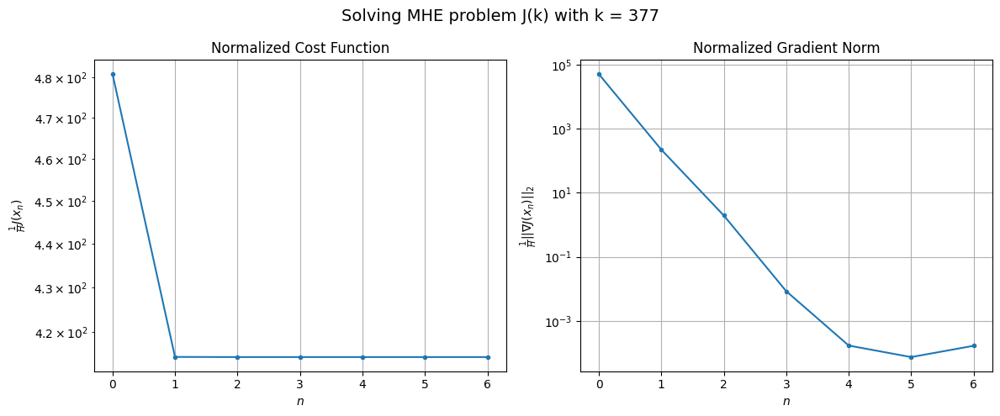

Windows:  95%|█████████▌| 359/376 [31:35<01:04,  3.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8421.503088911619
Gradient norm: 1002566.2383466903
Global estimation error: 767.9435642037448
Initial conditions estimation errors: 3.694124066529833 m, 281.5239377497337 m, 381.81360504868826 m, 603.8926233596372 m
Position estimation errors: 6.224880167306823 m, 68.96711386378799 m, 128.6186778558605 m, 91.3874747262692 m

[Gauss-Newton] Iteration 1
Cost function: 7211.236993600312 (-14.37%)
Gradient norm: 507.8037333145749 (-99.95%)
Global estimation error: 838.137137981458 (9.14%)
Initial conditions estimation errors: 5.543732338784927 m, 307.2723892689594 m, 422.8840378117232 m, 655.1304162688838 m
Position estimation errors: 4.413544574677992 m, 51.01964088865132 m, 97.69847548297227 m, 52.88939046979185 m

[Gauss-Newton] Iteration 2
Cost function: 7211.217308546234 (-0.00%)
Gradient norm: 0.34581588046591755 (-99.93%)
Global estimation error: 835.6555122836909 (-0.30%)
Initial conditions estimation errors: 5.5437323598

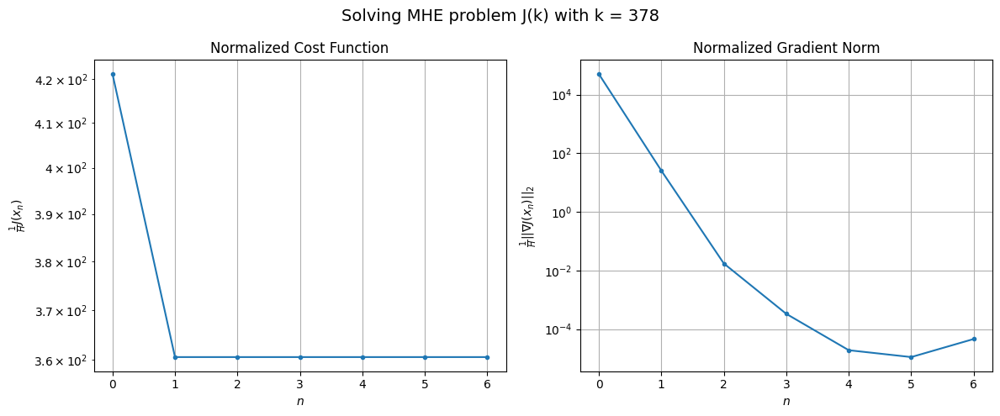

Windows:  96%|█████████▌| 360/376 [31:38<00:59,  3.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7714.664688358378
Gradient norm: 1004844.0428990589
Global estimation error: 824.106745143655
Initial conditions estimation errors: 3.3945132474846456 m, 303.8021221928922 m, 417.2490248353646 m, 642.4545645855233 m
Position estimation errors: 6.298602454245784 m, 30.129821445658184 m, 73.86341006945946 m, 18.425621277561017 m

[Gauss-Newton] Iteration 1
Cost function: 6581.6303323565035 (-14.69%)
Gradient norm: 1495.002958011341 (-99.85%)
Global estimation error: 974.3660115598473 (18.23%)
Initial conditions estimation errors: 5.148530427128334 m, 364.7580968972312 m, 489.2419355751217 m, 759.5764099015709 m
Position estimation errors: 4.509973132701016 m, 6.77095843785574 m, 60.87193168726047 m, 78.7589756019988 m

[Gauss-Newton] Iteration 2
Cost function: 6581.273224866326 (-0.01%)
Gradient norm: 92.14627004563569 (-93.84%)
Global estimation error: 944.5150815063117 (-3.06%)
Initial conditions estimation errors: 5.148530460

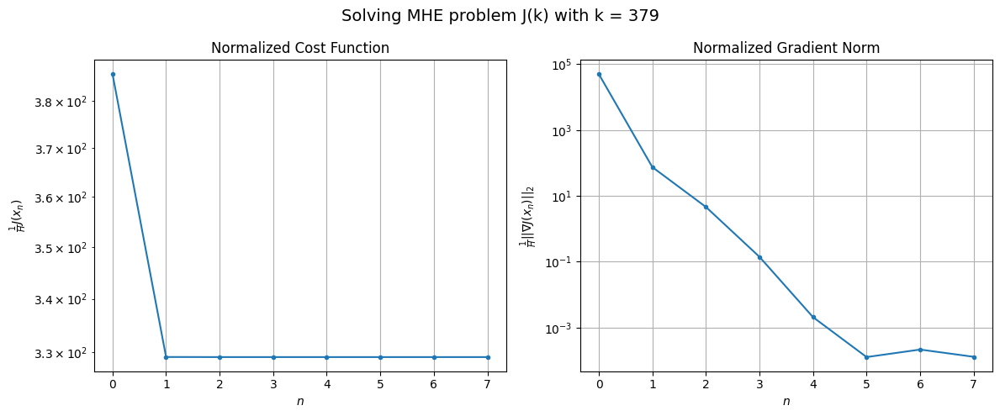

Windows:  96%|█████████▌| 361/376 [31:42<00:56,  3.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7370.477293036825
Gradient norm: 1005471.5055191411
Global estimation error: 924.5739721072288
Initial conditions estimation errors: 3.1996848065720505 m, 347.36175919285273 m, 467.5466778445295 m, 718.0295970300128 m
Position estimation errors: 6.574168672516285 m, 29.473765792398588 m, 39.16965974902156 m, 129.1156009059121 m

[Gauss-Newton] Iteration 1
Cost function: 6550.773553587771 (-11.12%)
Gradient norm: 62056.74959955825 (-93.83%)
Global estimation error: 1547.6799340828588 (67.39%)
Initial conditions estimation errors: 4.871430507043228 m, 580.6767963553038 m, 808.7540158888503 m, 1184.9137460106388 m
Position estimation errors: 4.807151483459501 m, 42.60415640884529 m, 141.91961348965341 m, 65.32751286960699 m

[Gauss-Newton] Iteration 2
Cost function: 6297.934554226388 (-3.86%)
Gradient norm: 86.54993917724336 (-99.86%)
Global estimation error: 1532.4887528014488 (-0.98%)
Initial conditions estimation errors: 4.871

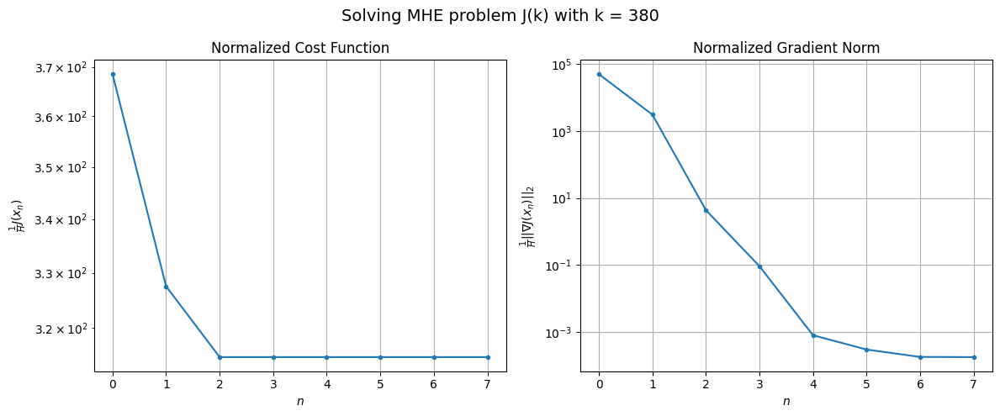

Windows:  96%|█████████▋| 362/376 [31:47<00:54,  3.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7845.629405538006
Gradient norm: 1093170.9689889778
Global estimation error: 1502.8763610915205
Initial conditions estimation errors: 3.1035197121975426 m, 565.9607527635814 m, 791.6475680544681 m, 1145.2553814789533 m
Position estimation errors: 7.0649483595713995 m, 7.873859646783322 m, 93.76976488777348 m, 140.6259590409119 m

[Gauss-Newton] Iteration 1
Cost function: 8612.326301739593 (9.77%)
Gradient norm: 163490.2639953673 (-85.04%)
Global estimation error: 460.5821777837523 (-69.35%)
Initial conditions estimation errors: 4.74730887020792 m, 175.45854121213475 m, 203.91666156409815 m, 373.82545676764465 m
Position estimation errors: 5.19045268229811 m, 115.77884394179445 m, 104.44561490648535 m, 230.63126299277064 m

[Gauss-Newton] Iteration 2
Cost function: 6701.631736531194 (-22.19%)
Gradient norm: 4196.637564198559 (-97.43%)
Global estimation error: 595.1704768767262 (29.22%)
Initial conditions estimation errors: 4.74

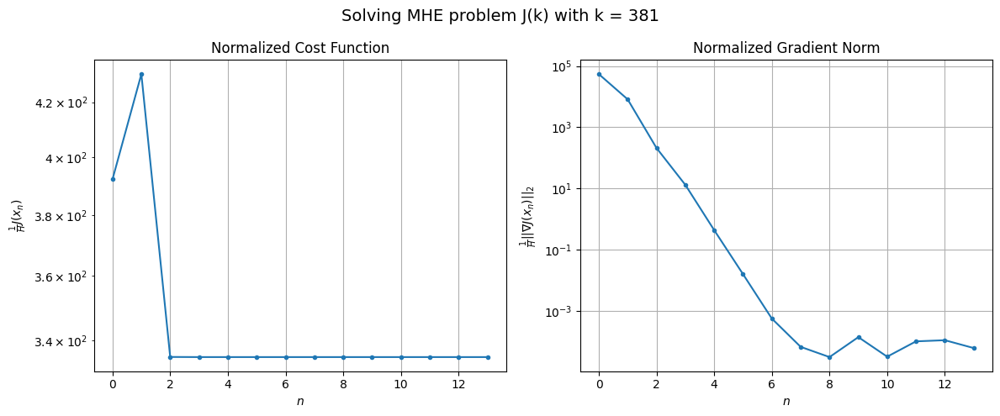

Windows:  97%|█████████▋| 363/376 [31:53<01:01,  4.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8470.161365680702
Gradient norm: 1146109.907905628
Global estimation error: 536.1953037883142
Initial conditions estimation errors: 3.0946851985615518 m, 204.2296526316975 m, 245.4420358694338 m, 430.74821451210903 m
Position estimation errors: 7.6594701099616715 m, 116.23608611735499 m, 85.93867207412194 m, 245.04696245287204 m

[Gauss-Newton] Iteration 1
Cost function: 7285.222725088268 (-13.99%)
Gradient norm: 44582.79107212386 (-96.11%)
Global estimation error: 589.5179019773294 (9.94%)
Initial conditions estimation errors: 4.778809765184218 m, 225.64534573915137 m, 287.1014913087289 m, 462.78008948981494 m
Position estimation errors: 5.719738778584678 m, 33.50602696791918 m, 138.86532960221237 m, 37.5440067651441 m

[Gauss-Newton] Iteration 2
Cost function: 7254.989938599144 (-0.41%)
Gradient norm: 249.13880343069576 (-99.44%)
Global estimation error: 622.9036811121636 (5.66%)
Initial conditions estimation errors: 4.77880

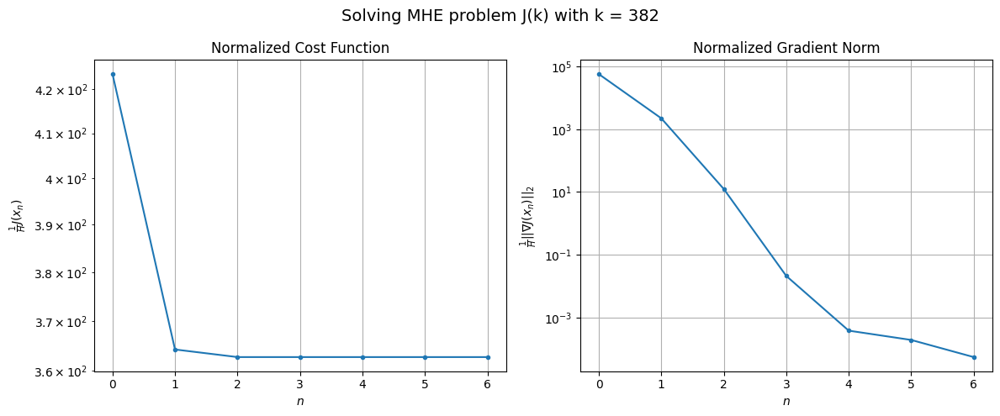

Windows:  97%|█████████▋| 364/376 [31:57<00:53,  4.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9855.061216189024
Gradient norm: 1286187.0075576364
Global estimation error: 615.2834311085793
Initial conditions estimation errors: 3.160631069392609 m, 235.80536734129083 m, 306.3060916973107 m, 478.6816139451712 m
Position estimation errors: 8.42437528807144 m, 21.23690590385194 m, 133.64552796010406 m, 24.86904612651434 m

[Gauss-Newton] Iteration 1
Cost function: 8437.609522224313 (-14.38%)
Gradient norm: 673.067253082343 (-99.95%)
Global estimation error: 627.7800471154767 (2.03%)
Initial conditions estimation errors: 4.926175573117721 m, 230.04677290110516 m, 344.290539949497 m, 471.8326115375593 m
Position estimation errors: 6.2953990174684265 m, 56.10058495490194 m, 121.97947637875808 m, 57.319134256078954 m

[Gauss-Newton] Iteration 2
Cost function: 8437.600547030186 (-0.00%)
Gradient norm: 120.4618432522398 (-82.10%)
Global estimation error: 651.6037306474011 (3.79%)
Initial conditions estimation errors: 4.926175574

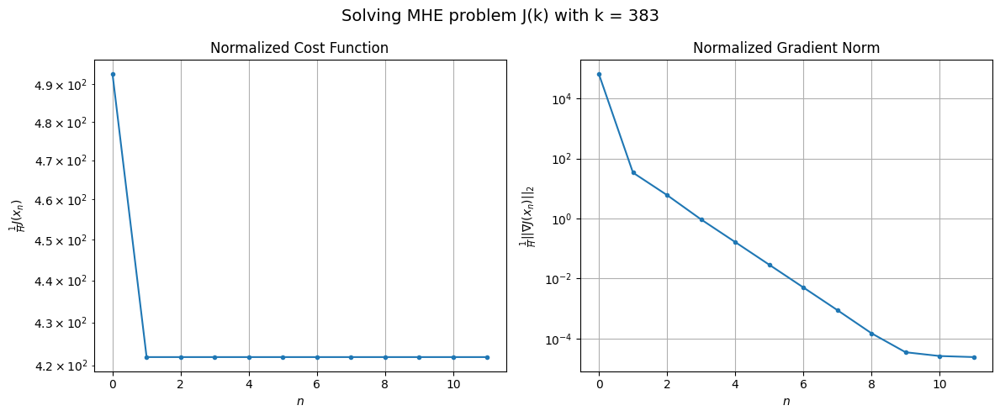

Windows:  97%|█████████▋| 365/376 [32:03<00:53,  4.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11362.483258648685
Gradient norm: 1320423.6158591346
Global estimation error: 660.9708895037286
Initial conditions estimation errors: 3.3003495554295696 m, 244.21651031930682 m, 365.4359564796558 m, 493.64608774131284 m
Position estimation errors: 9.229358016878107 m, 45.72863827800346 m, 113.71272162488692 m, 38.16701704240659 m

[Gauss-Newton] Iteration 1
Cost function: 22579.430127413754 (98.72%)
Gradient norm: 597429.4148361788 (-54.75%)
Global estimation error: 790.8837958322481 (19.65%)
Initial conditions estimation errors: 5.126016391065474 m, 315.553669736599 m, 443.3649481961002 m, 573.8676016102522 m
Position estimation errors: 7.005807446801857 m, 275.13952358282245 m, 443.92878478888656 m, 462.98626685803214 m

[Gauss-Newton] Iteration 2
Cost function: 9830.840739483974 (-56.46%)
Gradient norm: 6462.813617861545 (-98.92%)
Global estimation error: 824.8573164286757 (4.30%)
Initial conditions estimation errors: 5.126

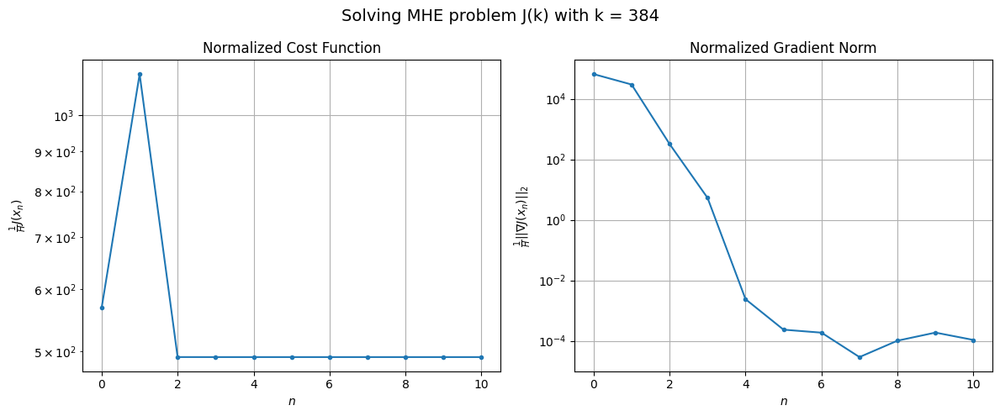

Windows:  97%|█████████▋| 366/376 [32:08<00:50,  5.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13625.00756362891
Gradient norm: 1452785.9128413298
Global estimation error: 881.0867502474283
Initial conditions estimation errors: 3.5126225924388996 m, 351.7388508281879 m, 503.9920126455156 m, 631.3263569558196 m
Position estimation errors: 10.151717330514833 m, 317.16116147920724 m, 507.56448561784265 m, 541.2776660567448 m

[Gauss-Newton] Iteration 1
Cost function: 30014.943574673973 (120.29%)
Gradient norm: 708715.9078171455 (-51.22%)
Global estimation error: 2458.835994567303 (179.07%)
Initial conditions estimation errors: 5.421497624391442 m, 952.687388850573 m, 1425.9429439323494 m, 1762.0775557628463 m
Position estimation errors: 7.737084781593273 m, 709.814364353426 m, 1048.0778370374237 m, 1127.7764928362787 m

[Gauss-Newton] Iteration 2
Cost function: 11861.857447677705 (-60.48%)
Gradient norm: 2778.2926292713664 (-99.61%)
Global estimation error: 2272.222959006467 (-7.59%)
Initial conditions estimation errors: 5

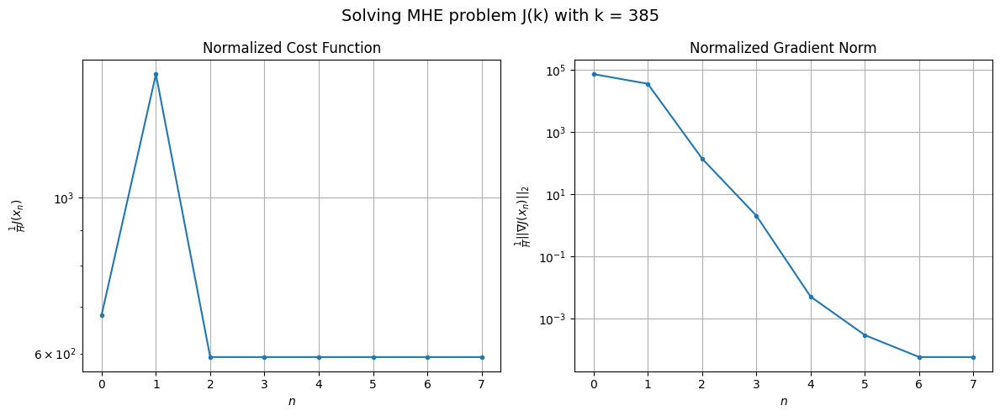

Windows:  98%|█████████▊| 367/376 [32:12<00:42,  4.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16492.622477814515
Gradient norm: 1622002.852278116
Global estimation error: 2331.5202093707194
Initial conditions estimation errors: 3.826033151665001 m, 907.8428875492613 m, 1366.1786768194604 m, 1656.909159279442 m
Position estimation errors: 11.06224318855723 m, 664.134180850464 m, 960.5388151244008 m, 1059.9524558474386 m

[Gauss-Newton] Iteration 1
Cost function: 14412.57964241798 (-12.61%)
Gradient norm: 11028.761264402487 (-99.32%)
Global estimation error: 2480.422634635119 (6.39%)
Initial conditions estimation errors: 5.8631499772280735 m, 970.2778286661731 m, 1428.3700237410555 m, 1780.6686578479546 m
Position estimation errors: 8.418955817234739 m, 701.2709154320548 m, 1080.3638643632662 m, 1115.2095360536903 m

[Gauss-Newton] Iteration 2
Cost function: 14409.785614717292 (-0.02%)
Gradient norm: 6.635321478555553 (-99.94%)
Global estimation error: 2483.7164530829705 (0.13%)
Initial conditions estimation errors: 5.86

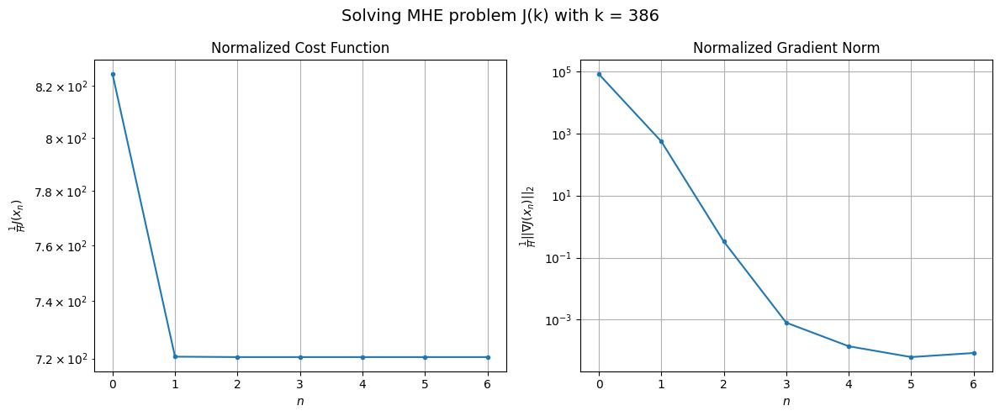

Windows:  98%|█████████▊| 368/376 [32:16<00:35,  4.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 19964.94870251334
Gradient norm: 1766461.708598698
Global estimation error: 2542.0734337983713
Initial conditions estimation errors: 4.238370279957131 m, 996.533914931814 m, 1471.710799283007 m, 1817.4449097056547 m
Position estimation errors: 11.890654728006554 m, 648.89952414717 m, 1004.9633077909409 m, 1015.5230181954403 m

[Gauss-Newton] Iteration 1
Cost function: 17486.953663783344 (-12.41%)
Gradient norm: 11838.720921429041 (-99.33%)
Global estimation error: 2465.3199342761354 (-3.02%)
Initial conditions estimation errors: 6.445256604378246 m, 969.5909572656365 m, 1437.0469808384655 m, 1752.8687161008681 m
Position estimation errors: 9.001327948855938 m, 733.4434091331841 m, 1116.2679360424167 m, 1196.6641129808079 m

[Gauss-Newton] Iteration 2
Cost function: 17484.715198854687 (-0.01%)
Gradient norm: 227.32313877796625 (-98.08%)
Global estimation error: 2480.9249624603326 (0.63%)
Initial conditions estimation errors: 6.

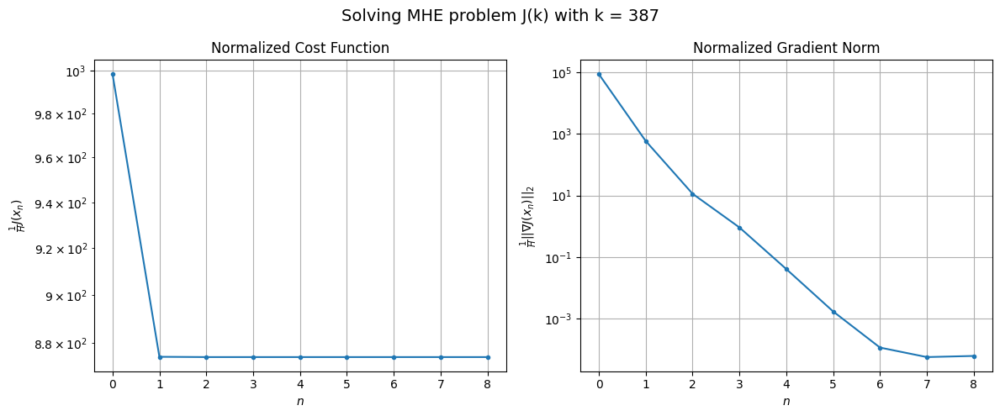

Windows:  98%|█████████▊| 369/376 [32:21<00:31,  4.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23482.637889129757
Gradient norm: 1855599.3551736672
Global estimation error: 2552.759482433411
Initial conditions estimation errors: 4.717284020618716 m, 1005.1606489723387 m, 1496.2547715014664 m, 1807.6037562840713 m
Position estimation errors: 12.596142472571982 m, 696.0858862719164 m, 1050.315603035216 m, 1125.6199165066262 m

[Gauss-Newton] Iteration 1
Cost function: 48546.23594227896 (106.73%)
Gradient norm: 1082003.0516951296 (-41.69%)
Global estimation error: 1105.2079618270823 (-56.71%)
Initial conditions estimation errors: 7.118818763386329 m, 434.00809989511157 m, 627.5826116809933 m, 799.5067132488205 m
Position estimation errors: 9.512169625923555 m, 162.69110495575586 m, 190.21094762018234 m, 222.7520916230973 m

[Gauss-Newton] Iteration 2
Cost function: 33741.15280438395 (-30.50%)
Gradient norm: 664623.9991586918 (-38.57%)
Global estimation error: 252.28540402454257 (-77.17%)
Initial conditions estimation error

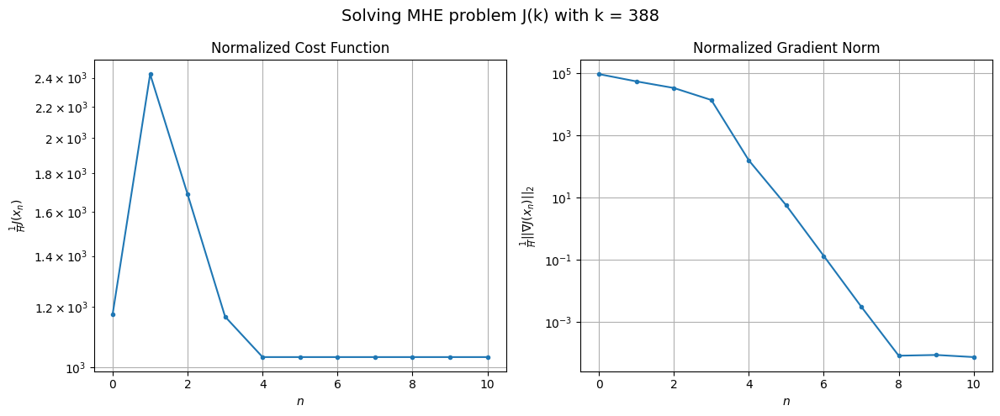

Windows:  98%|█████████▊| 370/376 [32:26<00:28,  4.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 26581.674397507486
Gradient norm: 1910163.2646662877
Global estimation error: 1440.1112976910254
Initial conditions estimation errors: 5.217235944984492 m, 561.494998389042 m, 871.3415473018024 m, 999.6899066158816 m
Position estimation errors: 13.23867312057704 m, 435.39144542007887 m, 773.6507310562292 m, 722.459359883166 m

[Gauss-Newton] Iteration 1
Cost function: 55237.213947021686 (107.80%)
Gradient norm: 931985.1113199192 (-51.21%)
Global estimation error: 378.7452306886991 (-73.70%)
Initial conditions estimation errors: 7.771765168375047 m, 139.89549027134353 m, 220.95690065494162 m, 273.8516896604072 m
Position estimation errors: 10.042557520340468 m, 17.06329442848644 m, 136.46560299576478 m, 76.85183064479698 m

[Gauss-Newton] Iteration 2
Cost function: 23549.71863921552 (-57.37%)
Gradient norm: 49582.170145625605 (-94.68%)
Global estimation error: 55.964883471889415 (-85.22%)
Initial conditions estimation errors: 7

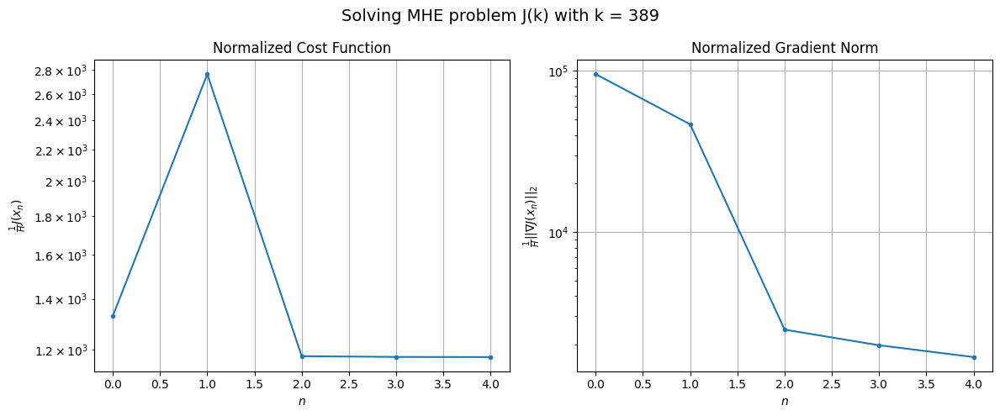

Windows:  99%|█████████▊| 371/376 [32:29<00:20,  4.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30419.75806024958
Gradient norm: 2061968.6987288122
Global estimation error: 56.90491419179549
Initial conditions estimation errors: 5.659110406432158 m, 29.78025611263543 m, 36.225638687394074 m, 31.7303942839269 m
Position estimation errors: 13.96835901377891 m, 97.22918886807201 m, 277.1935170883039 m, 204.52479355759237 m

[Gauss-Newton] Iteration 1
Cost function: 26881.293167862186 (-11.63%)
Gradient norm: 59757.588299390096 (-97.10%)
Global estimation error: 410.88690025835825 (622.06%)
Initial conditions estimation errors: 8.407245608616174 m, 165.04725933019608 m, 261.7542471907489 m, 270.1871002627353 m
Position estimation errors: 10.536170461242143 m, 241.25455373217554 m, 457.04846487120443 m, 416.85633801988706 m

[Gauss-Newton] Iteration 2
Cost function: 26805.39013234531 (-0.28%)
Gradient norm: 25039.475954757967 (-58.10%)
Global estimation error: 192.17952476685358 (-53.23%)
Initial conditions estimation errors:

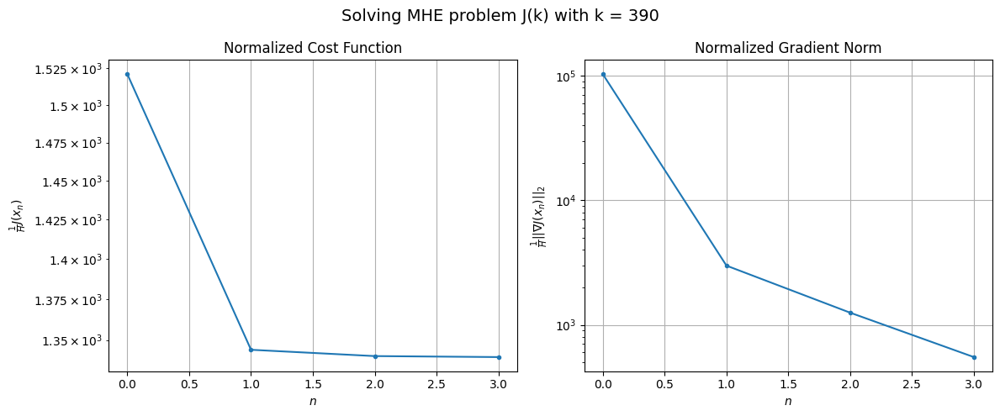

Windows:  99%|█████████▉| 372/376 [32:31<00:14,  3.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 34108.10814145592
Gradient norm: 2204099.727610539
Global estimation error: 373.77135623248773
Initial conditions estimation errors: 6.068901944455225 m, 150.37292724001335 m, 239.3050373543269 m, 244.51782729285895 m
Position estimation errors: 14.751106928423516 m, 205.37226070358335 m, 409.1992159710215 m, 356.9313105456513 m

[Gauss-Newton] Iteration 1
Cost function: 31908.160917358102 (-6.45%)
Gradient norm: 329688.55212422885 (-85.04%)
Global estimation error: 97.21181659458094 (-73.99%)
Initial conditions estimation errors: 9.00340989486679 m, 47.00968818137242 m, 70.73325096873012 m, 46.431043113566695 m
Position estimation errors: 11.116145407183335 m, 146.13235871877674 m, 131.2562599587857 m, 287.6336060391367 m

[Gauss-Newton] Iteration 2
Cost function: 30062.31350911607 (-5.78%)
Gradient norm: 22800.509408551345 (-93.08%)
Global estimation error: 253.28812029890432 (160.55%)
Initial conditions estimation errors: 9

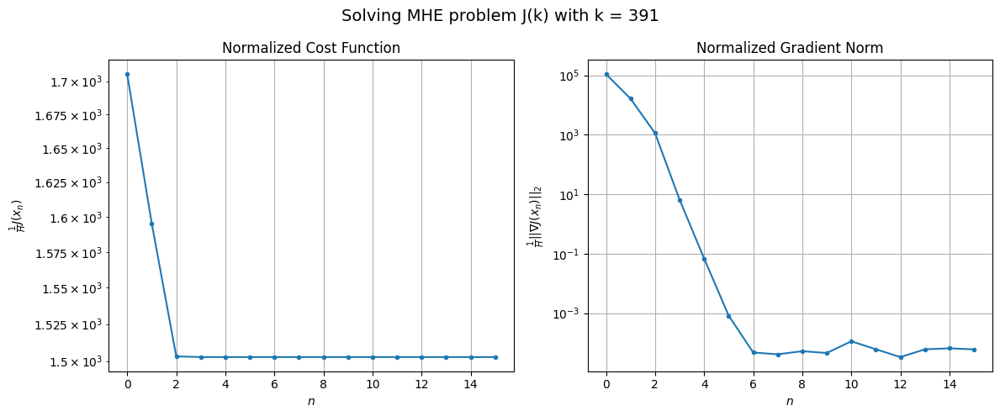

Windows:  99%|█████████▉| 373/376 [32:39<00:14,  4.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 38236.501827180255
Gradient norm: 2399861.085301479
Global estimation error: 296.8447446597681
Initial conditions estimation errors: 6.455706679295882 m, 128.49241538837794 m, 198.20124244728967 m, 179.66853801051784 m
Position estimation errors: 15.696962272014938 m, 237.9114021496116 m, 263.9421043241748 m, 459.9557645106728 m

[Gauss-Newton] Iteration 1
Cost function: 54674.169509148145 (42.99%)
Gradient norm: 1018528.7976401884 (-57.56%)
Global estimation error: 866.7506408999936 (191.99%)
Initial conditions estimation errors: 9.603938487061102 m, 339.2762969870946 m, 552.8008855209097 m, 574.8623159899926 m
Position estimation errors: 11.80944040354886 m, 324.01072160913736 m, 591.4567096883209 m, 560.3294743486081 m

[Gauss-Newton] Iteration 2
Cost function: 33927.35053203688 (-37.95%)
Gradient norm: 131647.17466136982 (-87.07%)
Global estimation error: 506.75979595658447 (-41.53%)
Initial conditions estimation errors: 9

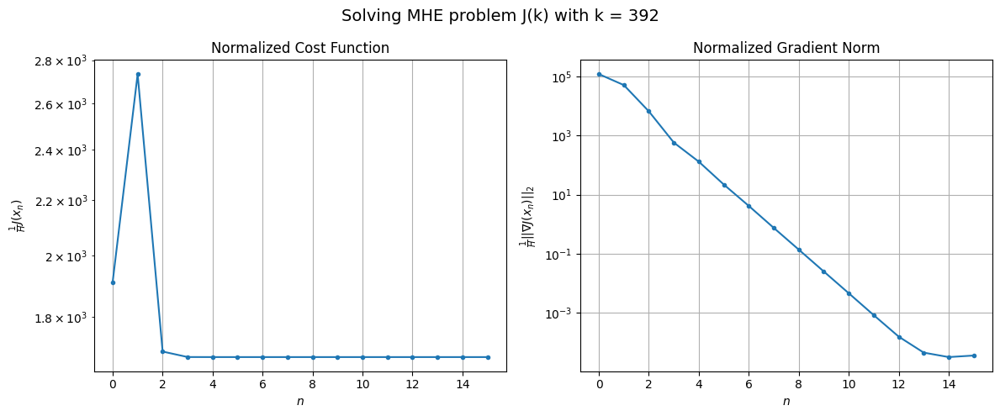

Windows:  99%|█████████▉| 374/376 [32:46<00:11,  5.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 42952.95896299712
Gradient norm: 2611352.1887097345
Global estimation error: 624.6280641888466
Initial conditions estimation errors: 6.8556901343775145 m, 240.95750992150388 m, 393.44820215560264 m, 421.0120432737288 m
Position estimation errors: 16.800974414253773 m, 135.70283775351237 m, 309.7429530769683 m, 205.35079629472867 m

[Gauss-Newton] Iteration 1
Cost function: 106511.26711641229 (147.97%)
Gradient norm: 1800217.4536268306 (-31.06%)
Global estimation error: 1016.6632360862349 (62.76%)
Initial conditions estimation errors: 10.234964307053936 m, 411.6292293962681 m, 643.6923928668973 m, 670.6109378209388 m
Position estimation errors: 12.616641190769553 m, 578.1774389098437 m, 833.2329801913262 m, 1085.8244158927114 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 118800.33571178708 (11.54%)
Gradient norm = 2081635.850475021 (15.63%)
Global estimation error = 449.45157498012 (-55.79%)
Fi

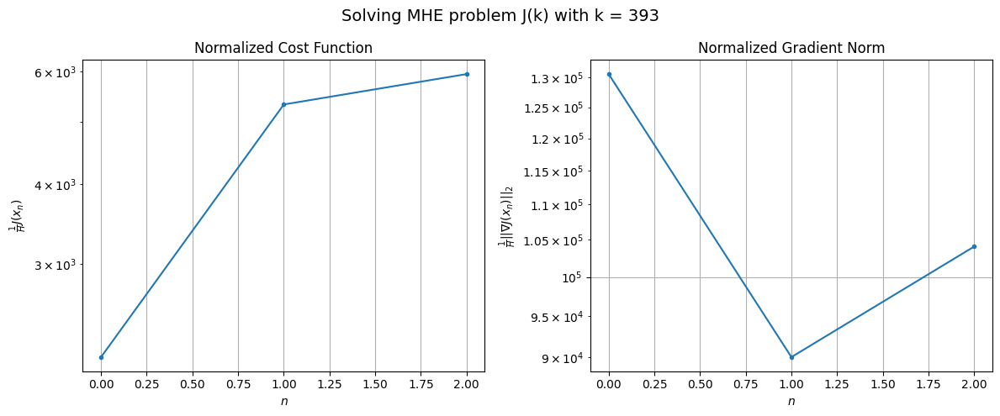

Windows: 100%|█████████▉| 375/376 [32:48<00:04,  4.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 132718.30790381943
Gradient norm: 3420770.1543076662
Global estimation error: 485.94866668838756
Initial conditions estimation errors: 7.274517759083597 m, 197.5089337148501 m, 323.1797581041031 m, 304.36469504255433 m
Position estimation errors: 18.03410335038181 m, 236.61536508483508 m, 415.39898887589266 m, 459.09451884417746 m

[Gauss-Newton] Iteration 1
Cost function: 119064.33820617963 (-10.29%)
Gradient norm: 2016341.261819806 (-41.06%)
Global estimation error: 966.4361347749722 (98.88%)
Initial conditions estimation errors: 10.893294997997865 m, 390.41860673940687 m, 632.9337834467266 m, 617.1275846551164 m
Position estimation errors: 13.487878537565587 m, 571.6230012468455 m, 807.0784422380231 m, 1085.2372992951914 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 87703.65208600293 (-26.34%)
Gradient norm = 1567646.7472533025 (-22.25%)
Global estimation error = 263.97394618278065 (-72.69%

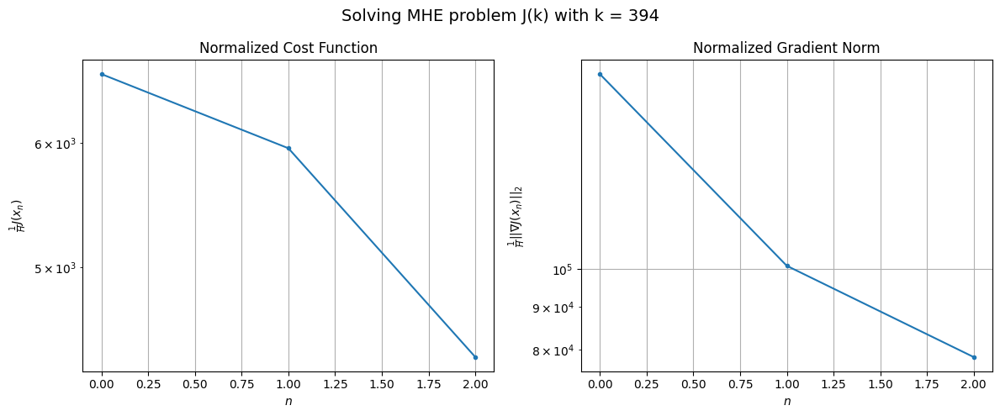

This Monte Carlo run RMSE for 376 timestamps:
RMSE_1 = 10.496719792515282
RMSE_2 = 139.89569491109074
RMSE_3 = 191.93407087734212
RMSE_4 = 347.54070552519926
CentralizedNewton applied to J(H - 1) converged with [] iterations.
CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with nan iterations on average.


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [7]:
first_round_stop_iteration = []
K_minus_H_next_rounds_stop_iteration = []

# Cold-start
x_init = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))

# Apply the algorithm
X_est = np.zeros((n, 1, K))
for k in tqdm(range(H - 1, K), desc="Windows", leave=False):
    centralized_newton.cost_values, centralized_newton.gradient_norm_values = [], []
    x_init, x_est = centralized_newton.solve_MHE_problem(k, dt, Y, x_init, X_true[:, :, k - H + 1],  X_true[:, :, k])
    X_est[:, :, k] = x_est
    
    plots(k, centralized_newton)

    # Warm-start
    x_init = dyn.f(dt, x_init)

# After each Monte Carlo Run compute the RMSE_m for each K - H + 1 timestamps
position_estimation_error_1, position_estimation_error_2, position_estimation_error_3, position_estimation_error_4 = [], [], [], []
for k in range(H - 1, K):
    position_estimation_error_1.append(np.linalg.norm(X_est[:n_p, :, k] - X_true[:n_p, :, k]))
    position_estimation_error_2.append(np.linalg.norm(X_est[n_x:n_x + n_p, :, k] - X_true[n_x:n_x + n_p, :, k]))
    position_estimation_error_3.append(np.linalg.norm(X_est[2*n_x:2*n_x + n_p, :, k] - X_true[2*n_x:2*n_x + n_p, :, k]))
    position_estimation_error_4.append(np.linalg.norm(X_est[3*n_x:3*n_x + n_p, :, k] - X_true[3*n_x:3*n_x + n_p, :, k]))
rmse_1 = np.sqrt(np.mean(np.array(position_estimation_error_1) ** 2))
rmse_2 = np.sqrt(np.mean(np.array(position_estimation_error_2) ** 2))
rmse_3 = np.sqrt(np.mean(np.array(position_estimation_error_3) ** 2))
rmse_4 = np.sqrt(np.mean(np.array(position_estimation_error_4) ** 2))
print(f'This Monte Carlo run RMSE for {K - H + 1} timestamps:')
print(f'RMSE_1 = {np.mean(rmse_1)}\nRMSE_2 = {np.mean(rmse_2)}\nRMSE_3 = {np.mean(rmse_3)}\nRMSE_4 = {np.mean(rmse_4)}')
print(f'CentralizedNewton applied to J(H - 1) converged with {first_round_stop_iteration} iterations.')
print(f'CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with {np.mean(K_minus_H_next_rounds_stop_iteration)} iterations on average.')

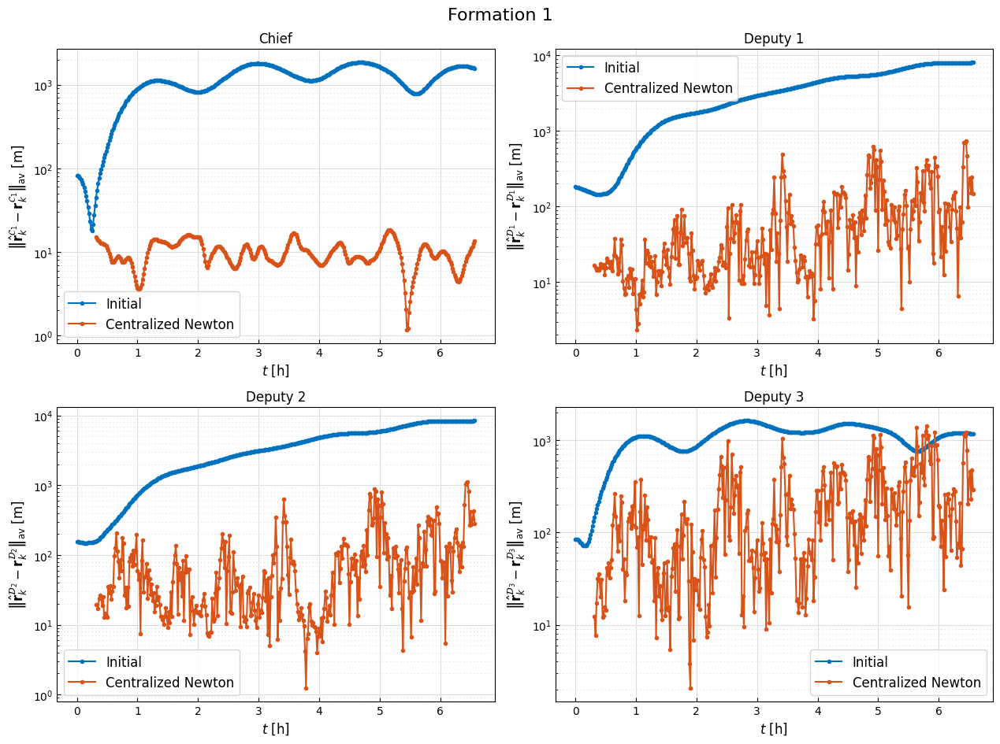

In [8]:
# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, K) / dt
algorithm = "Centralized Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, position_estimation_error_1_initial, ".-", label="Initial")
axs[0, 0].plot(time[H - 1:], position_estimation_error_1, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, position_estimation_error_2_initial, ".-", label="Initial")
axs[0, 1].plot(time[H - 1:], position_estimation_error_2, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, position_estimation_error_3_initial, ".-", label="Initial")
axs[1, 0].plot(time[H - 1:], position_estimation_error_3, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, position_estimation_error_4_initial, ".-", label="Initial")
axs[1, 1].plot(time[H - 1:], position_estimation_error_4, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [9]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["H"] = H
data["true"] = X_true
data[0] = X_est

# Save to pickle file
with open(f'gauss_newton_H{H}_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl', "wb") as file:
    pickle.dump(data, file)